In [27]:
import math
import pandas as pd
import tensorflow as tf
# import keras_tuner.tuners as kt
import matplotlib.pyplot as plt
from tensorflow.keras import Model
from tensorflow.keras import Sequential
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.layers import Dense, Dropout
from sklearn.model_selection import train_test_split
from tensorflow.keras.losses import MeanSquaredLogarithmicError
import numpy as np
import pickle
np.random.seed(0)
from keras.wrappers.scikit_learn import KerasRegressor
from sklearn.model_selection import GridSearchCV

from keras.optimizers import Adam, SGD, Adadelta
# from sklearn.datasets import fetch_california_housing

# https://www.analyticsvidhya.com/blog/2021/06/dimensionality-reduction-using-autoencoders-in-python/#:~:text=AutoEncoder%20is%20an%20unsupervised%20Artificial,representation%20of%20the%20input%20data.


# Sequencing data

In [28]:
# hundred = pd.read_csv('hundred_patients.csv')
hundred = pd.read_csv('data/cd_df.csv')
hundred = hundred.set_index("Gene_Symbol")
hundred

,1_CD_plain,2_CD_plain,3_CD_plain,4_CD_plain,5_CD_plain,6_CD_deep_ulcer,7_CD_plain,8_CD_plain,9_CD_plain,12_CD_plain,...,88_control,89_control,90_control,117_control,118_control,121_control,180_control,139_CD_deep_ulcer,237_CD_plain,257_CD_deep_ulcer
Gene_Symbol,,,,,,,,,,,,,,,,,,,,,
AADAC,-0.881250,-8.38590,-3.476500,0.476000,-6.86090,-3.75730,-4.744800,-0.044202,-2.506500,0.006241,...,-1.031600,1.162300,0.199200,0.239030,1.361500,-0.934720,-0.248440,-5.22890,-0.680680,-1.489900
APOA1,-3.046500,-9.36170,-2.636300,0.934930,-6.47840,-5.87150,-9.417700,-0.653090,-4.268600,-0.835050,...,-0.569040,0.744860,0.200140,-0.159320,1.051600,-1.207500,-1.068500,-7.45590,0.396090,-2.945300
APOA4,-0.918130,-7.16960,-2.648600,0.198870,-7.48180,-3.04140,-7.560500,-0.947140,-1.662300,-0.893450,...,-0.829470,0.546240,0.532340,-0.298980,0.265380,-0.071699,-1.206200,-6.29720,0.225200,-1.919800
APOB,-1.312800,-7.41580,-2.541200,1.910800,-7.06560,-3.72960,-6.837700,0.335400,-3.110900,-0.016976,...,-0.000025,1.025300,0.417150,0.146180,1.016900,0.075990,-0.442670,-5.48050,-0.043606,-2.899300
APOC3,-1.277500,-8.08800,-2.169100,0.806470,-7.22960,-3.86730,-8.254200,-0.466340,-1.608800,-0.302970,...,-0.581970,0.590720,0.047763,-0.392290,0.535160,-0.996560,-1.302900,-7.37030,0.002768,-1.891600
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
NXF4,0.000000,0.00000,0.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000
RNF125,0.036178,-1.05370,-1.042600,0.655620,-1.14610,-0.40546,-0.451810,-0.036859,-0.524930,0.149420,...,0.144470,-0.243720,-0.147110,0.032388,-0.016056,0.454520,0.362160,-1.37830,0.401290,-0.769910
DARS,0.251650,0.96182,0.912390,0.184770,1.08290,0.27937,0.587110,0.062312,0.522130,0.287320,...,0.201260,-0.206160,-0.112790,-0.072244,-0.394420,0.385770,0.516300,0.38748,0.109890,0.321880


In [29]:
hundred = hundred.T
hundred

Gene_Symbol,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,HDLBP,PIAS4,ADH1B,LOC100507531,FAM83A,NXF4,RNF125,DARS,DNAI1,MBTPS1
1_CD_plain,-0.88125,-3.04650,-0.918130,-1.312800,-1.277500,6.32150,-3.50560,5.42790,3.30580,-1.70320,...,0.983070,-0.272040,0.350700,0.0,3.63770,0.0,0.036178,0.25165,0.086807,0.064012
2_CD_plain,-8.38590,-9.36170,-7.169600,-7.415800,-8.088000,9.67970,-5.17740,-0.42569,8.04170,-5.07250,...,0.773170,0.067824,-5.445900,0.0,-2.25380,0.0,-1.053700,0.96182,0.000000,0.731380
3_CD_plain,-3.47650,-2.63630,-2.648600,-2.541200,-2.169100,7.92790,-4.07780,7.18170,5.55740,-4.25090,...,0.461300,-0.198550,0.144910,0.0,4.13370,0.0,-1.042600,0.91239,0.099549,0.151430
4_CD_plain,0.47600,0.93493,0.198870,1.910800,0.806470,0.22229,-0.52026,-2.39740,-2.62100,0.84513,...,0.746300,0.128920,-0.452060,0.0,1.35940,0.0,0.655620,0.18477,0.000000,0.063029
5_CD_plain,-6.86090,-6.47840,-7.481800,-7.065600,-7.229600,9.27050,-5.17740,0.88511,7.74180,-5.39240,...,0.259880,-0.106700,-0.942920,0.0,1.05530,0.0,-1.146100,1.08290,0.000000,0.395560
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
121_control,-0.93472,-1.20750,-0.071699,0.075990,-0.996560,4.89670,1.88000,1.25710,-0.30353,0.07381,...,-0.136000,-0.061846,-0.819640,0.0,-0.12627,0.0,0.454520,0.38577,0.000000,-0.071099
180_control,-0.24844,-1.06850,-1.206200,-0.442670,-1.302900,0.72500,-2.27430,-2.21660,1.06760,-0.13725,...,-0.636050,-0.031460,0.471960,0.0,-0.18677,0.0,0.362160,0.51630,1.318100,-0.055849
139_CD_deep_ulcer,-5.22890,-7.45590,-6.297200,-5.480500,-7.370300,9.03570,-3.91130,1.55580,7.39930,-4.61280,...,0.468810,0.031069,0.043711,0.0,2.99030,0.0,-1.378300,0.38748,0.000000,0.170050
237_CD_plain,-0.68068,0.39609,0.225200,-0.043606,0.002768,5.92230,-0.31168,2.62370,1.93600,-0.93539,...,0.017036,-0.284880,-0.157340,0.0,2.26510,0.0,0.401290,0.10989,0.000000,-0.127930


## Data pre-processing

In [30]:
shuffled_df = hundred.sample(frac=1)
# shuffled_df.drop(columns=shuffled_df.columns[-1], 
#         axis=1, 
#         inplace=True)
shuffled_df

Gene_Symbol,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,HDLBP,PIAS4,ADH1B,LOC100507531,FAM83A,NXF4,RNF125,DARS,DNAI1,MBTPS1
55_control,-1.54050,0.33354,-1.22470,-1.234700,0.55181,1.4302,2.953400,3.16100,0.8389,-1.76750,...,-0.583270,-0.980810,-0.031129,3.1051,2.62680,1.760200,0.026392,0.727020,4.23530,-0.413520
168_CD_plain,-0.92136,-2.54660,-2.48800,-2.419100,-2.00960,4.8755,-2.640900,1.40780,2.9396,-3.14160,...,-1.282800,-1.475100,1.736000,0.0000,2.20840,0.035623,-0.853440,0.631390,0.00000,-0.326210
72_control,-0.47416,-0.31107,-0.96473,-0.925070,0.89119,3.1870,0.094616,-0.43266,-1.1968,-1.21560,...,-0.169350,-0.890060,-0.100050,0.0000,0.64611,0.000000,-1.334000,-0.926270,1.10200,-0.251510
120_control,-1.48090,-1.67250,-2.15810,-0.826770,-1.36390,6.3541,-0.465450,1.36980,5.3490,-0.60178,...,0.087866,-0.219910,0.299030,0.0000,1.44860,0.000000,-0.290860,0.099916,0.00000,-0.226550
258_CD_plain,-1.56310,-1.67960,-1.38710,-0.013321,-1.14760,3.4411,-2.164800,1.30790,1.6726,-0.25756,...,-0.215950,-0.069321,-0.100100,0.0000,0.63825,0.000000,0.430990,0.180470,0.00000,0.023835
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107_CD_plain,-1.11610,-1.74270,-0.53816,-1.745400,-1.30290,1.3587,-3.166600,4.08550,2.9676,-1.82800,...,-0.036159,0.033359,0.777170,0.0000,-0.39978,0.000000,-0.504530,0.802970,0.00000,0.059246
279_CD_plain,-7.68410,-8.46800,-8.22400,-8.402600,-8.83370,7.2140,-5.177400,11.71480,4.5251,-5.26600,...,0.573210,-0.029407,-2.150500,0.0000,4.27190,0.000000,-1.251800,0.824030,0.00000,0.297800
179_CD_plain,-1.26450,-0.73212,-0.60830,-0.691130,-0.87280,3.0501,-1.596200,2.46790,2.9987,-0.73609,...,-0.337870,0.063446,0.669520,0.0000,0.50411,0.000000,0.002969,0.491400,0.00000,-0.037786
70_CD_deep_ulcer,-4.27330,-4.14290,-3.11200,-4.005200,-2.91910,4.9455,-1.944200,3.96700,4.7686,-3.55790,...,-0.108750,-0.232600,1.906200,0.0000,0.92918,0.000000,-0.869340,0.340690,0.00000,-0.094957


In [31]:
# train:val:test 70:30

split_pt = int(0.7*len(shuffled_df))
# split_pt_test = int(0.7*len(shuffled_df))

x_train = shuffled_df[:split_pt]
# x_val = shuffled_df[split_pt_train:split_pt_test]
x_test = shuffled_df[split_pt:]

# print("train set:",x_train.shape)
# print("val set:",x_val.shape)
# print("test set:",x_test.shape)

# Feature scaling

In [32]:
from sklearn.preprocessing import MinMaxScaler
# link to california housing dataset autoecncoder tutorial

def scale_datasets(x_train, x_test):
  """
  Standard Scale test and train data
  """
  standard_scaler = MinMaxScaler()
  x_train_scaled = pd.DataFrame(
      standard_scaler.fit_transform(x_train),
      index = x_train.index,
      columns=x_train.columns
  )
#   x_val_scaled = pd.DataFrame(
#       standard_scaler.transform(x_val),
#       index = x_val.index,
#       columns = x_val.columns
#   )
  x_test_scaled = pd.DataFrame(
      standard_scaler.transform(x_test),
      index = x_test.index,
      columns = x_test.columns
  )
  return x_train_scaled, x_test_scaled
  
x_train_scaled, x_test_scaled = scale_datasets(x_train, x_test)

In [33]:
x_train_scaled

Gene_Symbol,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,HDLBP,PIAS4,ADH1B,LOC100507531,FAM83A,NXF4,RNF125,DARS,DNAI1,MBTPS1
55_control,0.702813,0.799052,0.719665,0.729547,0.794953,0.256451,1.000000,0.363133,0.374212,0.611161,...,0.308725,0.235825,0.566757,0.982782,0.707526,1.000000,0.410887,0.671068,1.000000,0.438527
168_CD_plain,0.751408,0.603707,0.622768,0.627712,0.606860,0.520576,0.311962,0.251356,0.553554,0.441131,...,0.000000,0.000000,0.861588,0.000000,0.640911,0.020238,0.220356,0.632252,0.000000,0.488578
72_control,0.786508,0.755331,0.739605,0.756170,0.819875,0.391132,0.648401,0.134017,0.200420,0.679453,...,0.491401,0.279122,0.555258,0.000000,0.392175,0.000000,0.116289,0.000000,0.260194,0.531400
120_control,0.707491,0.662993,0.648072,0.764621,0.654276,0.633929,0.579519,0.248934,0.759250,0.755407,...,0.604918,0.598850,0.621841,0.000000,0.519941,0.000000,0.342185,0.416527,0.000000,0.545708
258_CD_plain,0.701039,0.662511,0.707208,0.834562,0.670160,0.410612,0.370517,0.244987,0.445387,0.798000,...,0.470835,0.670696,0.555250,0.000000,0.390923,0.000000,0.498504,0.449224,0.000000,0.689242
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15_CD_plain,0.382762,0.384030,0.377332,0.360165,0.300915,0.340090,0.077348,0.890965,0.261140,0.205779,...,0.669319,0.770253,0.702931,0.000000,0.451846,0.000000,0.319644,0.549587,0.000000,0.935108
182_CD_plain,0.679910,0.584723,0.722426,0.643867,0.740014,0.650358,0.468650,0.295686,0.649939,0.609862,...,0.747236,0.742399,0.730485,0.000000,0.680460,0.000000,0.280413,0.529434,0.000000,0.606330
164_CD_plain,0.754656,0.556562,0.694062,0.748334,0.535534,0.133869,0.319071,0.154562,0.440487,0.824013,...,0.422981,0.769213,0.625325,0.000000,0.374319,0.000000,0.396084,0.590976,0.238307,0.753111
53_CD_plain,0.591140,0.585802,0.750282,0.753309,0.603372,0.469634,0.213239,0.348800,0.485094,0.722492,...,0.618164,0.707833,0.842618,0.000000,0.441203,0.000000,0.355054,0.430549,0.000000,0.706947


In [34]:
x_train_scaled.isnull().values.any()

False

In [35]:
x_test_scaled.isnull().values.any()

False

In [36]:
x_train_scaled.to_csv('data/260_sample_train_scaled.csv', index_label = "Patient_ID")
x_test_scaled.to_csv('data/260_sample_test_scaled.csv', index_label = "Patient_ID")

# Autoencoder model

In [37]:
from tensorflow.keras import Input
from tensorflow.keras.layers import Conv1D, Conv2D, LeakyReLU, MaxPool1D, AveragePooling1D, UpSampling1D, Flatten, Dense, Reshape, BatchNormalization
# https://towardsdatascience.com/improve-your-model-performance-with-auto-encoders-d4ee543b4154
from tensorflow.keras import initializers

# n_inputs = 120
# bottleneck_features = 32

class AutoEncoder(Model):

    def __init__(self, n_inputs, init_fn, n_bottleneck=32):

        super().__init__()

        self.encoder = Sequential(
            [

                Input(shape=(n_inputs,)),
                # encoder level 1
#                 Dense(n_inputs*2, kernel_initializer=init_fn,
#     bias_initializer=initializers.Ones()),
                Dense(n_inputs*2, kernel_initializer=init_fn, bias_initializer=initializers.Zeros()),
                BatchNormalization(),
                LeakyReLU(),
                # encoder level 2
                Dense(n_inputs, kernel_initializer=init_fn, bias_initializer=initializers.Zeros()),
                BatchNormalization(),
                LeakyReLU(),
                # bottleneck
                Dense(n_bottleneck, kernel_initializer=init_fn, bias_initializer=initializers.Zeros())
            ]
        )

        self.decoder = Sequential(
            [
                
                # define decoder, level 1
                Dense(n_inputs, kernel_initializer=init_fn, bias_initializer=initializers.Zeros()),
                BatchNormalization(),
                LeakyReLU(),
                # decoder level 2,
                Dense(n_inputs*2, kernel_initializer=init_fn, bias_initializer=initializers.Zeros()),
                BatchNormalization(),
                LeakyReLU(),
                # output layer
                Dense(n_inputs, activation='linear', kernel_initializer=init_fn, bias_initializer=initializers.Zeros())
            ]
        )

    def call(self, inputs):

        encoded = self.encoder(inputs)
        decoded = self.decoder(encoded)
        return decoded
    



## Hyperparameter grid search

In [38]:
# initialisation functions

# https://stackoverflow.com/questions/49433936/how-do-i-initialize-weights-in-pytorch

        
def get_init(init_fn):
    if init_fn == 'init_xavier_uniform':
        initializer = tf.keras.initializers.GlorotUniform()
    elif init_fn == 'init_xavier_normal':
        initializer = tf.keras.initializers.GlorotNormal()
    elif init_fn == 'zeros':
        initializer = tf.keras.initializers.Zeros()
    elif init_fn == 'ones':
        initializer = tf.keras.initializers.Ones()
    elif init_fn == 'he_uniform':
        initializer = tf.keras.initializers.heUniform()
    elif init_fn == 'he_normal':
        initializer = tf.keras.initializers.heNormal()
        
    return initializer

In [37]:
x_train_scaled

Gene_Symbol,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,HDLBP,PIAS4,ADH1B,LOC100507531,FAM83A,NXF4,RNF125,DARS,DNAI1,MBTPS1
55_control,0.702813,0.799052,0.719665,0.729547,0.794953,0.256451,1.000000,0.363133,0.374212,0.611161,...,0.308725,0.235825,0.566757,0.982782,0.707526,1.000000,0.410887,0.671068,1.000000,0.438527
168_CD_plain,0.751408,0.603707,0.622768,0.627712,0.606860,0.520576,0.311962,0.251356,0.553554,0.441131,...,0.000000,0.000000,0.861588,0.000000,0.640911,0.020238,0.220356,0.632252,0.000000,0.488578
72_control,0.786508,0.755331,0.739605,0.756170,0.819875,0.391132,0.648401,0.134017,0.200420,0.679453,...,0.491401,0.279122,0.555258,0.000000,0.392175,0.000000,0.116289,0.000000,0.260194,0.531400
120_control,0.707491,0.662993,0.648072,0.764621,0.654276,0.633929,0.579519,0.248934,0.759250,0.755407,...,0.604918,0.598850,0.621841,0.000000,0.519941,0.000000,0.342185,0.416527,0.000000,0.545708
258_CD_plain,0.701039,0.662511,0.707208,0.834562,0.670160,0.410612,0.370517,0.244987,0.445387,0.798000,...,0.470835,0.670696,0.555250,0.000000,0.390923,0.000000,0.498504,0.449224,0.000000,0.689242
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15_CD_plain,0.382762,0.384030,0.377332,0.360165,0.300915,0.340090,0.077348,0.890965,0.261140,0.205779,...,0.669319,0.770253,0.702931,0.000000,0.451846,0.000000,0.319644,0.549587,0.000000,0.935108
182_CD_plain,0.679910,0.584723,0.722426,0.643867,0.740014,0.650358,0.468650,0.295686,0.649939,0.609862,...,0.747236,0.742399,0.730485,0.000000,0.680460,0.000000,0.280413,0.529434,0.000000,0.606330
164_CD_plain,0.754656,0.556562,0.694062,0.748334,0.535534,0.133869,0.319071,0.154562,0.440487,0.824013,...,0.422981,0.769213,0.625325,0.000000,0.374319,0.000000,0.396084,0.590976,0.238307,0.753111
53_CD_plain,0.591140,0.585802,0.750282,0.753309,0.603372,0.469634,0.213239,0.348800,0.485094,0.722492,...,0.618164,0.707833,0.842618,0.000000,0.441203,0.000000,0.355054,0.430549,0.000000,0.706947


In [38]:



def create_model(optimizer, learn_rate, init):
#     <return a compiled but untrained keras model>
    n_bottleneck = 32 ####
    init_fn = get_init(init)
    
    if optimizer=="Adam":
        opt = Adam(learning_rate=learn_rate)
    elif optimizer=="SGD":
        opt = SGD(learning_rate=learn_rate)
    else:
        opt = Adadelta(learning_rate=lrn_rate) # need some default 
    auto_encoder = AutoEncoder(len(x_train_scaled.columns), init_fn, n_bottleneck)
    auto_encoder.compile(optimizer=opt, loss='mse', metrics=['mse'])
    return auto_encoder

model = KerasRegressor(build_fn = create_model)
learn_rate = [0.001, 0.01, 0.1, 0.2]
init = ['init_xavier_uniform', 'init_xavier_normal', 'zeros', 'ones', 'he_uniform', 'he_normal']
batch_size = [16, 32, 60, 100, 182]


param_grid = {'optimizer':['SGD', 'Adam'], 'epochs':[80,100, 150], 'batch_size':batch_size, 'learn_rate':learn_rate, 'init':init}
grid = GridSearchCV(estimator=model, scoring='neg_mean_squared_error', param_grid=param_grid)
result = grid.fit(x_train_scaled, x_train_scaled)
print(result)

Epoch 1/80


C:\Users\shard\AppData\Local\Temp\ipykernel_31440\1039620486.py:16: DeprecationWarning: KerasRegressor is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  model = KerasRegressor(build_fn = create_model)


10/10 [==============================] - 1s 3ms/step - loss: 0.9995 - mse: 0.9995
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9961 - mse: 0.9961
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9830 - mse: 0.9830
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9768 - mse: 0.9768
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9727 - mse: 0.9727
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9643 - mse: 0.9643
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9619 - mse: 0.9619
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9459 - mse: 0.9459
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9436 - mse: 0.9436
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9358 - mse: 0.9358
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9244 

10/10 [==============================] - 0s 2ms/step - loss: 1.0119 - mse: 1.0119
Epoch 14/80
10/10 [==============================] - 0s 2ms/step - loss: 1.0102 - mse: 1.0102
Epoch 15/80
10/10 [==============================] - 0s 2ms/step - loss: 1.0022 - mse: 1.0022
Epoch 16/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9887 - mse: 0.9887
Epoch 17/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9833 - mse: 0.9833
Epoch 18/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9684 - mse: 0.9684
Epoch 19/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9726 - mse: 0.9726
Epoch 20/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9587 - mse: 0.9587
Epoch 21/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9539 - mse: 0.9539
Epoch 22/80
10/10 [==============================] - 0s 2ms/step - loss: 0.9515 - mse: 0.9515
Epoch 23/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 4ms/step - loss: 0.8618 - mse: 0.8618
Epoch 26/80
10/10 [==============================] - 0s 4ms/step - loss: 0.8523 - mse: 0.8523
Epoch 27/80
10/10 [==============================] - 0s 3ms/step - loss: 0.8534 - mse: 0.8534
Epoch 28/80
10/10 [==============================] - 0s 5ms/step - loss: 0.8436 - mse: 0.8436
Epoch 29/80
10/10 [==============================] - 0s 4ms/step - loss: 0.8366 - mse: 0.8366
Epoch 30/80
10/10 [==============================] - 0s 4ms/step - loss: 0.8387 - mse: 0.8387
Epoch 31/80
10/10 [==============================] - 0s 3ms/step - loss: 0.8253 - mse: 0.8253
Epoch 32/80
10/10 [==============================] - 0s 2ms/step - loss: 0.8126 - mse: 0.8126
Epoch 33/80
10/10 [==============================] - 0s 2ms/step - loss: 0.8173 - mse: 0.8173
Epoch 34/80
10/10 [==============================] - 0s 3ms/step - loss: 0.8104 - mse: 0.8104
Epoch 35/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 4ms/step - loss: 0.0189 - mse: 0.0189
Epoch 24/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0171 - mse: 0.0171
Epoch 25/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0180 - mse: 0.0180
Epoch 26/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0191 - mse: 0.0191
Epoch 27/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0190 - mse: 0.0190
Epoch 28/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0178 - mse: 0.0178
Epoch 29/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0184 - mse: 0.0184
Epoch 30/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 31/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0159 - mse: 0.0159
Epoch 32/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0165 - mse: 0.0165
Epoch 33/80
10/10 [==============================] - 0s 4ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0279 - mse: 0.0279
Epoch 36/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0280 - mse: 0.0280
Epoch 37/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0243 - mse: 0.0243
Epoch 38/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0260 - mse: 0.0260
Epoch 39/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0238 - mse: 0.0238
Epoch 40/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0203 - mse: 0.0203
Epoch 41/80
10/10 [==============================] - 0s 6ms/step - loss: 0.0194 - mse: 0.0194
Epoch 42/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0198 - mse: 0.0198
Epoch 43/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0204 - mse: 0.0204
Epoch 44/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0214 - mse: 0.0214
Epoch 45/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.1209 - mse: 0.1209
Epoch 48/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1146 - mse: 0.1146
Epoch 49/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1148 - mse: 0.1148
Epoch 50/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1116 - mse: 0.1116
Epoch 51/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1063 - mse: 0.1063
Epoch 52/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1062 - mse: 0.1062
Epoch 53/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1021 - mse: 0.1021
Epoch 54/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1040 - mse: 0.1040
Epoch 55/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0999 - mse: 0.0999
Epoch 56/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0933 - mse: 0.0933
Epoch 57/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0942 - mse: 0.0942
Epoch 60/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0892 - mse: 0.0892
Epoch 61/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0909 - mse: 0.0909
Epoch 62/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0857 - mse: 0.0857
Epoch 63/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0843 - mse: 0.0843
Epoch 64/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0858 - mse: 0.0858
Epoch 65/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0823 - mse: 0.0823
Epoch 66/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0804 - mse: 0.0804
Epoch 67/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0831 - mse: 0.0831
Epoch 68/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0845 - mse: 0.0845
Epoch 69/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0755 - mse: 0.0755
Epoch 72/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0703 - mse: 0.0703
Epoch 73/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0734 - mse: 0.0734
Epoch 74/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0723 - mse: 0.0723
Epoch 75/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0712 - mse: 0.0712
Epoch 76/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0702 - mse: 0.0702
Epoch 77/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0718 - mse: 0.0718
Epoch 78/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0674 - mse: 0.0674
Epoch 79/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0680 - mse: 0.0680
Epoch 80/80
3/3 [==============================] - 0s 2ms/step
Epoch 1/80
10/10 [==============================] - 1s 3ms/step - loss: 0.5064 - mse: 0.5064
Epoch 2/80

10/10 [==============================] - 0s 3ms/step - loss: 0.1129 - mse: 0.1129
Epoch 4/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0864 - mse: 0.0864
Epoch 5/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0659 - mse: 0.0659
Epoch 6/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0545 - mse: 0.0545
Epoch 7/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0574 - mse: 0.0574
Epoch 8/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0454 - mse: 0.0454
Epoch 9/80
10/10 [==============================] - 0s 6ms/step - loss: 0.0348 - mse: 0.0348
Epoch 10/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0316 - mse: 0.0316
Epoch 11/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0322 - mse: 0.0322
Epoch 12/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0415 - mse: 0.0415
Epoch 13/80
10/10 [==============================] - 0s 3ms/step - loss: 0.032

10/10 [==============================] - 0s 3ms/step - loss: 0.0350 - mse: 0.0350
Epoch 16/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0324 - mse: 0.0324
Epoch 17/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0358 - mse: 0.0358
Epoch 18/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0338 - mse: 0.0338
Epoch 19/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0480 - mse: 0.0480
Epoch 20/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0478 - mse: 0.0478
Epoch 21/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0340 - mse: 0.0340
Epoch 22/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0284 - mse: 0.0284
Epoch 23/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0298 - mse: 0.0298
Epoch 24/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0306 - mse: 0.0306
Epoch 25/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0331 - mse: 0.0331
Epoch 28/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0311 - mse: 0.0311
Epoch 29/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0295 - mse: 0.0295
Epoch 30/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0324 - mse: 0.0324
Epoch 31/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0295 - mse: 0.0295
Epoch 32/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0283 - mse: 0.0283
Epoch 33/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0279 - mse: 0.0279
Epoch 34/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0282 - mse: 0.0282
Epoch 35/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0274 - mse: 0.0274
Epoch 36/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0334 - mse: 0.0334
Epoch 37/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0277 - mse: 0.0277
Epoch 40/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0242 - mse: 0.0242
Epoch 41/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0265 - mse: 0.0265
Epoch 42/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0266 - mse: 0.0266
Epoch 43/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0242 - mse: 0.0242
Epoch 44/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0285 - mse: 0.0285
Epoch 45/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0272 - mse: 0.0272
Epoch 46/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0237 - mse: 0.0237
Epoch 47/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0242 - mse: 0.0242
Epoch 48/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0331 - mse: 0.0331
Epoch 49/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0266 - mse: 0.0266
Epoch 52/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0288 - mse: 0.0288
Epoch 53/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0335 - mse: 0.0335
Epoch 54/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0279 - mse: 0.0279
Epoch 55/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0366 - mse: 0.0366
Epoch 56/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0309 - mse: 0.0309
Epoch 57/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0347 - mse: 0.0347
Epoch 58/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0434 - mse: 0.0434
Epoch 59/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0402 - mse: 0.0402
Epoch 60/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0365 - mse: 0.0365
Epoch 61/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0238 - mse: 0.0238
Epoch 64/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0206 - mse: 0.0206
Epoch 65/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0222 - mse: 0.0222
Epoch 66/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0247 - mse: 0.0247
Epoch 67/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0263 - mse: 0.0263
Epoch 68/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0277 - mse: 0.0277
Epoch 69/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0217 - mse: 0.0217
Epoch 70/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0246 - mse: 0.0246
Epoch 71/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0237 - mse: 0.0237
Epoch 72/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0262 - mse: 0.0262
Epoch 73/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0283 - mse: 0.0283
Epoch 76/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0272 - mse: 0.0272
Epoch 77/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0260 - mse: 0.0260
Epoch 78/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0253 - mse: 0.0253
Epoch 79/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0301 - mse: 0.0301
Epoch 80/80
3/3 [==============================] - 0s 2ms/step
Epoch 1/80
10/10 [==============================] - 1s 2ms/step - loss: 0.6297 - mse: 0.6297
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2121 - mse: 0.2121
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1048 - mse: 0.1048
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0695 - mse: 0.0695
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0569 - mse: 0.0569
Epoch 6/80
10/

10/10 [==============================] - 0s 2ms/step - loss: 0.0417 - mse: 0.0417
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0485 - mse: 0.0485
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0381 - mse: 0.0381
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0381 - mse: 0.0381
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0451 - mse: 0.0451
Epoch 12/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0439 - mse: 0.0439
Epoch 13/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0376 - mse: 0.0376
Epoch 14/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0497 - mse: 0.0497
Epoch 15/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0510 - mse: 0.0510
Epoch 16/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0379 - mse: 0.0379
Epoch 17/80
10/10 [==============================] - 0s 2ms/step - loss: 0

10/10 [==============================] - 0s 2ms/step - loss: 0.0364 - mse: 0.0364
Epoch 20/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0384 - mse: 0.0384
Epoch 21/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0364 - mse: 0.0364
Epoch 22/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0322 - mse: 0.0322
Epoch 23/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0316 - mse: 0.0316
Epoch 24/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0288 - mse: 0.0288
Epoch 25/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0293 - mse: 0.0293
Epoch 26/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0289 - mse: 0.0289
Epoch 27/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0293 - mse: 0.0293
Epoch 28/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0285 - mse: 0.0285
Epoch 29/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.1283 - mse: 0.1283
Epoch 32/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0930 - mse: 0.0930
Epoch 33/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0789 - mse: 0.0789
Epoch 34/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0849 - mse: 0.0849
Epoch 35/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1380 - mse: 0.1380
Epoch 36/80
10/10 [==============================] - 0s 3ms/step - loss: 0.2044 - mse: 0.2044
Epoch 37/80
10/10 [==============================] - 0s 3ms/step - loss: 0.2761 - mse: 0.2761
Epoch 38/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0850 - mse: 0.0850
Epoch 39/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0683 - mse: 0.0683
Epoch 40/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1086 - mse: 0.1086
Epoch 41/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0495 - mse: 0.0495
Epoch 44/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0748 - mse: 0.0748
Epoch 45/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0730 - mse: 0.0730
Epoch 46/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0697 - mse: 0.0697
Epoch 47/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0735 - mse: 0.0735
Epoch 48/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0738 - mse: 0.0738
Epoch 49/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0433 - mse: 0.0433
Epoch 50/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0416 - mse: 0.0416
Epoch 51/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0451 - mse: 0.0451
Epoch 52/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0488 - mse: 0.0488
Epoch 53/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.7228 - mse: 0.7228
Epoch 56/80
10/10 [==============================] - 0s 2ms/step - loss: 0.7200 - mse: 0.7200
Epoch 57/80
10/10 [==============================] - 0s 2ms/step - loss: 0.7164 - mse: 0.7164
Epoch 58/80
10/10 [==============================] - 0s 2ms/step - loss: 0.7131 - mse: 0.7131
Epoch 59/80
10/10 [==============================] - 0s 3ms/step - loss: 0.7131 - mse: 0.7131
Epoch 60/80
10/10 [==============================] - 0s 2ms/step - loss: 0.7006 - mse: 0.7006
Epoch 61/80
10/10 [==============================] - 0s 2ms/step - loss: 0.7015 - mse: 0.7015
Epoch 62/80
10/10 [==============================] - 0s 2ms/step - loss: 0.6968 - mse: 0.6968
Epoch 63/80
10/10 [==============================] - 0s 2ms/step - loss: 0.6857 - mse: 0.6857
Epoch 64/80
10/10 [==============================] - 0s 2ms/step - loss: 0.6904 - mse: 0.6904
Epoch 65/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.6150 - mse: 0.6150
Epoch 68/80
10/10 [==============================] - 0s 2ms/step - loss: 0.6080 - mse: 0.6080
Epoch 69/80
10/10 [==============================] - 0s 2ms/step - loss: 0.6090 - mse: 0.6090
Epoch 70/80
10/10 [==============================] - 0s 2ms/step - loss: 0.6012 - mse: 0.6012
Epoch 71/80
10/10 [==============================] - 0s 2ms/step - loss: 0.6028 - mse: 0.6028
Epoch 72/80
10/10 [==============================] - 0s 4ms/step - loss: 0.5930 - mse: 0.5930
Epoch 73/80
10/10 [==============================] - 0s 3ms/step - loss: 0.5862 - mse: 0.5862
Epoch 74/80
10/10 [==============================] - 0s 3ms/step - loss: 0.5847 - mse: 0.5847
Epoch 75/80
10/10 [==============================] - 0s 3ms/step - loss: 0.5839 - mse: 0.5839
Epoch 76/80
10/10 [==============================] - 0s 3ms/step - loss: 0.5753 - mse: 0.5753
Epoch 77/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.5842 - mse: 0.5842
Epoch 80/80
3/3 [==============================] - 0s 3ms/step
Epoch 1/80
10/10 [==============================] - 1s 3ms/step - loss: 0.4618 - mse: 0.4618
Epoch 2/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1096 - mse: 0.1096
Epoch 3/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0613 - mse: 0.0613
Epoch 4/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 5/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0345 - mse: 0.0345
Epoch 6/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0316 - mse: 0.0316
Epoch 7/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0286 - mse: 0.0286
Epoch 8/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0256 - mse: 0.0256
Epoch 9/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0248 - mse: 0.0248
Epoch 10/80
10/10 

10/10 [==============================] - 0s 3ms/step - loss: 0.0372 - mse: 0.0372
Epoch 12/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0289 - mse: 0.0289
Epoch 13/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0293 - mse: 0.0293
Epoch 14/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0263 - mse: 0.0263
Epoch 15/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0219 - mse: 0.0219
Epoch 16/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0208 - mse: 0.0208
Epoch 17/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0247 - mse: 0.0247
Epoch 18/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0256 - mse: 0.0256
Epoch 19/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0266 - mse: 0.0266
Epoch 20/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0274 - mse: 0.0274
Epoch 21/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0245 - mse: 0.0245
Epoch 24/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 25/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 26/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0205 - mse: 0.0205
Epoch 27/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0202 - mse: 0.0202
Epoch 28/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0240 - mse: 0.0240
Epoch 29/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0275 - mse: 0.0275
Epoch 30/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0255 - mse: 0.0255
Epoch 31/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0238 - mse: 0.0238
Epoch 32/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0229 - mse: 0.0229
Epoch 33/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.1662 - mse: 0.1662
Epoch 36/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1629 - mse: 0.1629
Epoch 37/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1650 - mse: 0.1650
Epoch 38/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1526 - mse: 0.1526
Epoch 39/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1438 - mse: 0.1438
Epoch 40/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1443 - mse: 0.1443
Epoch 41/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1370 - mse: 0.1370
Epoch 42/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1313 - mse: 0.1313
Epoch 43/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1282 - mse: 0.1282
Epoch 44/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1254 - mse: 0.1254
Epoch 45/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.1113 - mse: 0.1113
Epoch 48/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1033 - mse: 0.1033
Epoch 49/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1072 - mse: 0.1072
Epoch 50/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1006 - mse: 0.1006
Epoch 51/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1043 - mse: 0.1043
Epoch 52/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1003 - mse: 0.1003
Epoch 53/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0961 - mse: 0.0961
Epoch 54/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0973 - mse: 0.0973
Epoch 55/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0929 - mse: 0.0929
Epoch 56/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0898 - mse: 0.0898
Epoch 57/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0149 - mse: 0.0149
Epoch 60/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0156 - mse: 0.0156
Epoch 61/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0131 - mse: 0.0131
Epoch 62/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0143 - mse: 0.0143
Epoch 63/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0135 - mse: 0.0135
Epoch 64/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 65/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0147 - mse: 0.0147
Epoch 66/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0176 - mse: 0.0176
Epoch 67/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0130 - mse: 0.0130
Epoch 68/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0157 - mse: 0.0157
Epoch 69/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0161 - mse: 0.0161
Epoch 72/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0160 - mse: 0.0160
Epoch 73/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0175 - mse: 0.0175
Epoch 74/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0165 - mse: 0.0165
Epoch 75/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0171 - mse: 0.0171
Epoch 76/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0160 - mse: 0.0160
Epoch 77/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0171 - mse: 0.0171
Epoch 78/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0200 - mse: 0.0200
Epoch 79/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0176 - mse: 0.0176
Epoch 80/80
3/3 [==============================] - 0s 2ms/step
Epoch 1/80
10/10 [==============================] - 1s 3ms/step - loss: 0.5270 - mse: 0.5270
Epoch 2/80

10/10 [==============================] - 0s 2ms/step - loss: 0.2750 - mse: 0.2750
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1820 - mse: 0.1820
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1342 - mse: 0.1342
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1051 - mse: 0.1051
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0906 - mse: 0.0906
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0769 - mse: 0.0769
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0644 - mse: 0.0644
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0602 - mse: 0.0602
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0530 - mse: 0.0530
Epoch 12/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0546 - mse: 0.0546
Epoch 13/80
10/10 [==============================] - 0s 2ms/step - loss: 0.046

10/10 [==============================] - 0s 2ms/step - loss: 0.0393 - mse: 0.0393
Epoch 16/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0409 - mse: 0.0409
Epoch 17/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0365 - mse: 0.0365
Epoch 18/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0431 - mse: 0.0431
Epoch 19/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0360 - mse: 0.0360
Epoch 20/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0312 - mse: 0.0312
Epoch 21/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0336 - mse: 0.0336
Epoch 22/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0373 - mse: 0.0373
Epoch 23/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0310 - mse: 0.0310
Epoch 24/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0299 - mse: 0.0299
Epoch 25/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0394 - mse: 0.0394
Epoch 28/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 29/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0375 - mse: 0.0375
Epoch 30/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0384 - mse: 0.0384
Epoch 31/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0362 - mse: 0.0362
Epoch 32/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0365 - mse: 0.0365
Epoch 33/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0349 - mse: 0.0349
Epoch 34/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0377 - mse: 0.0377
Epoch 35/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0346 - mse: 0.0346
Epoch 36/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0303 - mse: 0.0303
Epoch 37/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0352 - mse: 0.0352
Epoch 40/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0330 - mse: 0.0330
Epoch 41/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0323 - mse: 0.0323
Epoch 42/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0334 - mse: 0.0334
Epoch 43/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0363 - mse: 0.0363
Epoch 44/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0325 - mse: 0.0325
Epoch 45/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0308 - mse: 0.0308
Epoch 46/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0349 - mse: 0.0349
Epoch 47/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0405 - mse: 0.0405
Epoch 48/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0388 - mse: 0.0388
Epoch 49/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0298 - mse: 0.0298
Epoch 52/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0294 - mse: 0.0294
Epoch 53/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0326 - mse: 0.0326
Epoch 54/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0305 - mse: 0.0305
Epoch 55/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0295 - mse: 0.0295
Epoch 56/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0388 - mse: 0.0388
Epoch 57/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0304 - mse: 0.0304
Epoch 58/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0280 - mse: 0.0280
Epoch 59/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0266 - mse: 0.0266
Epoch 60/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0263 - mse: 0.0263
Epoch 61/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0196 - mse: 0.0196
Epoch 64/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0194 - mse: 0.0194
Epoch 65/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0174 - mse: 0.0174
Epoch 66/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0197 - mse: 0.0197
Epoch 67/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0187 - mse: 0.0187
Epoch 68/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0208 - mse: 0.0208
Epoch 69/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0193 - mse: 0.0193
Epoch 70/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0187 - mse: 0.0187
Epoch 71/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0174 - mse: 0.0174
Epoch 72/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0203 - mse: 0.0203
Epoch 73/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0280 - mse: 0.0280
Epoch 76/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0247 - mse: 0.0247
Epoch 77/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0263 - mse: 0.0263
Epoch 78/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0247 - mse: 0.0247
Epoch 79/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0278 - mse: 0.0278
Epoch 80/80
3/3 [==============================] - 0s 2ms/step
Epoch 1/80
10/10 [==============================] - 1s 2ms/step - loss: 0.6706 - mse: 0.6706
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2552 - mse: 0.2552
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1249 - mse: 0.1249
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1078 - mse: 0.1078
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0897 - mse: 0.0897
Epoch 6/80
10/

10/10 [==============================] - 0s 4ms/step - loss: 0.1807 - mse: 0.1807
Epoch 8/80
10/10 [==============================] - 0s 4ms/step - loss: 0.1360 - mse: 0.1360
Epoch 9/80
10/10 [==============================] - 0s 5ms/step - loss: 0.1151 - mse: 0.1151
Epoch 10/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0887 - mse: 0.0887
Epoch 11/80
10/10 [==============================] - 0s 5ms/step - loss: 0.0841 - mse: 0.0841
Epoch 12/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0536 - mse: 0.0536
Epoch 13/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0859 - mse: 0.0859
Epoch 14/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1110 - mse: 0.1110
Epoch 15/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0747 - mse: 0.0747
Epoch 16/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0900 - mse: 0.0900
Epoch 17/80
10/10 [==============================] - 0s 3ms/step - loss: 0

10/10 [==============================] - 0s 3ms/step - loss: 0.0504 - mse: 0.0504
Epoch 20/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0561 - mse: 0.0561
Epoch 21/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0529 - mse: 0.0529
Epoch 22/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0439 - mse: 0.0439
Epoch 23/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0440 - mse: 0.0440
Epoch 24/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0418 - mse: 0.0418
Epoch 25/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0665 - mse: 0.0665
Epoch 26/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0630 - mse: 0.0630
Epoch 27/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0544 - mse: 0.0544
Epoch 28/80
10/10 [==============================] - 0s 5ms/step - loss: 0.0513 - mse: 0.0513
Epoch 29/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0921 - mse: 0.0921
Epoch 32/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0566 - mse: 0.0566
Epoch 33/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0592 - mse: 0.0592
Epoch 34/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0579 - mse: 0.0579
Epoch 35/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0485 - mse: 0.0485
Epoch 36/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0753 - mse: 0.0753
Epoch 37/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0784 - mse: 0.0784
Epoch 38/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0841 - mse: 0.0841
Epoch 39/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0806 - mse: 0.0806
Epoch 40/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1132 - mse: 0.1132
Epoch 41/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.3065 - mse: 0.3065
Epoch 44/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3065 - mse: 0.3065
Epoch 45/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3064 - mse: 0.3064
Epoch 46/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3064 - mse: 0.3064
Epoch 47/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3063 - mse: 0.3063
Epoch 48/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3063 - mse: 0.3063
Epoch 49/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3062 - mse: 0.3062
Epoch 50/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3062 - mse: 0.3062
Epoch 51/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3061 - mse: 0.3061
Epoch 52/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3061 - mse: 0.3061
Epoch 53/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.3065 - mse: 0.3065
Epoch 56/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3065 - mse: 0.3065
Epoch 57/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3064 - mse: 0.3064
Epoch 58/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3064 - mse: 0.3064
Epoch 59/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3063 - mse: 0.3063
Epoch 60/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3063 - mse: 0.3063
Epoch 61/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3062 - mse: 0.3062
Epoch 62/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3062 - mse: 0.3062
Epoch 63/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3061 - mse: 0.3061
Epoch 64/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3061 - mse: 0.3061
Epoch 65/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 4ms/step - loss: 0.0556 - mse: 0.0556
Epoch 68/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0549 - mse: 0.0549
Epoch 69/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0542 - mse: 0.0542
Epoch 70/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0536 - mse: 0.0536
Epoch 71/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0530 - mse: 0.0530
Epoch 72/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0524 - mse: 0.0524
Epoch 73/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0519 - mse: 0.0519
Epoch 74/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0513 - mse: 0.0513
Epoch 75/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0509 - mse: 0.0509
Epoch 76/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0504 - mse: 0.0504
Epoch 77/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0480 - mse: 0.0480
Epoch 80/80
3/3 [==============================] - 0s 2ms/step
Epoch 1/80
10/10 [==============================] - 1s 3ms/step - loss: 0.3052 - mse: 0.3052
Epoch 2/80
10/10 [==============================] - 0s 3ms/step - loss: 0.2958 - mse: 0.2958
Epoch 3/80
10/10 [==============================] - 0s 4ms/step - loss: 0.2866 - mse: 0.2866
Epoch 4/80
10/10 [==============================] - 0s 3ms/step - loss: 0.2776 - mse: 0.2776
Epoch 5/80
10/10 [==============================] - 0s 4ms/step - loss: 0.2689 - mse: 0.2689
Epoch 6/80
10/10 [==============================] - 0s 4ms/step - loss: 0.2604 - mse: 0.2604
Epoch 7/80
10/10 [==============================] - 0s 3ms/step - loss: 0.2523 - mse: 0.2523
Epoch 8/80
10/10 [==============================] - 0s 3ms/step - loss: 0.2444 - mse: 0.2444
Epoch 9/80
10/10 [==============================] - 0s 3ms/step - loss: 0.2367 - mse: 0.2367
Epoch 10/80
10/10 

10/10 [==============================] - 0s 2ms/step - loss: 0.3046 - mse: 0.3046
Epoch 12/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3041 - mse: 0.3041
Epoch 13/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3036 - mse: 0.3036
Epoch 14/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3032 - mse: 0.3032
Epoch 15/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3027 - mse: 0.3027
Epoch 16/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3022 - mse: 0.3022
Epoch 17/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3017 - mse: 0.3017
Epoch 18/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3013 - mse: 0.3013
Epoch 19/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3008 - mse: 0.3008
Epoch 20/80
10/10 [==============================] - 0s 2ms/step - loss: 0.3003 - mse: 0.3003
Epoch 21/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.2969 - mse: 0.2969
Epoch 24/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2965 - mse: 0.2965
Epoch 25/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2960 - mse: 0.2960
Epoch 26/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2955 - mse: 0.2955
Epoch 27/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2951 - mse: 0.2951
Epoch 28/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2946 - mse: 0.2946
Epoch 29/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2942 - mse: 0.2942
Epoch 30/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2937 - mse: 0.2937
Epoch 31/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2933 - mse: 0.2933
Epoch 32/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2928 - mse: 0.2928
Epoch 33/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.2924 - mse: 0.2924
Epoch 36/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2920 - mse: 0.2920
Epoch 37/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2915 - mse: 0.2915
Epoch 38/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2911 - mse: 0.2911
Epoch 39/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2906 - mse: 0.2906
Epoch 40/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2902 - mse: 0.2902
Epoch 41/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2897 - mse: 0.2897
Epoch 42/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2893 - mse: 0.2893
Epoch 43/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2888 - mse: 0.2888
Epoch 44/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2884 - mse: 0.2884
Epoch 45/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 4ms/step - loss: 0.0439 - mse: 0.0439
Epoch 48/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0438 - mse: 0.0438
Epoch 49/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 50/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0438 - mse: 0.0438
Epoch 51/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0438 - mse: 0.0438
Epoch 52/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0437 - mse: 0.0437
Epoch 53/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0437 - mse: 0.0437
Epoch 54/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0437 - mse: 0.0437
Epoch 55/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0439 - mse: 0.0439
Epoch 56/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0438 - mse: 0.0438
Epoch 57/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 60/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 61/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0426 - mse: 0.0426
Epoch 62/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 63/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0425 - mse: 0.0425
Epoch 64/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 65/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 66/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 67/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 68/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 69/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.1170 - mse: 0.1170
Epoch 72/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1157 - mse: 0.1157
Epoch 73/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1144 - mse: 0.1144
Epoch 74/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1131 - mse: 0.1131
Epoch 75/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1119 - mse: 0.1119
Epoch 76/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1106 - mse: 0.1106
Epoch 77/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1095 - mse: 0.1095
Epoch 78/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1083 - mse: 0.1083
Epoch 79/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1071 - mse: 0.1071
Epoch 80/80
3/3 [==============================] - 0s 2ms/step
Epoch 1/80
10/10 [==============================] - 1s 2ms/step - loss: 0.3066 - mse: 0.3066
Epoch 2/80

10/10 [==============================] - 0s 2ms/step - loss: 0.2977 - mse: 0.2977
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2931 - mse: 0.2931
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2886 - mse: 0.2886
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2842 - mse: 0.2842
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2798 - mse: 0.2798
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2755 - mse: 0.2755
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2713 - mse: 0.2713
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2672 - mse: 0.2672
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2632 - mse: 0.2632
Epoch 12/80
10/10 [==============================] - 0s 2ms/step - loss: 0.2592 - mse: 0.2592
Epoch 13/80
10/10 [==============================] - 0s 2ms/step - loss: 0.255

10/10 [==============================] - 0s 4ms/step - loss: 0.0451 - mse: 0.0451
Epoch 16/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0463 - mse: 0.0463
Epoch 17/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0511 - mse: 0.0511
Epoch 18/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0501 - mse: 0.0501
Epoch 19/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0480 - mse: 0.0480
Epoch 20/80
10/10 [==============================] - 0s 5ms/step - loss: 0.0456 - mse: 0.0456
Epoch 21/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0453 - mse: 0.0453
Epoch 22/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0490 - mse: 0.0490
Epoch 23/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0462 - mse: 0.0462
Epoch 24/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0468 - mse: 0.0468
Epoch 25/80
10/10 [==============================] - 0s 4ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0474 - mse: 0.0474
Epoch 28/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 29/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 30/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0460 - mse: 0.0460
Epoch 31/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0458 - mse: 0.0458
Epoch 32/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0440 - mse: 0.0440
Epoch 33/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0448 - mse: 0.0448
Epoch 34/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0486 - mse: 0.0486
Epoch 35/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0451 - mse: 0.0451
Epoch 36/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0469 - mse: 0.0469
Epoch 37/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0442 - mse: 0.0442
Epoch 40/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0455 - mse: 0.0455
Epoch 41/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0459 - mse: 0.0459
Epoch 42/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0476 - mse: 0.0476
Epoch 43/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0457 - mse: 0.0457
Epoch 44/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0451 - mse: 0.0451
Epoch 45/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0450 - mse: 0.0450
Epoch 46/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0448 - mse: 0.0448
Epoch 47/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0442 - mse: 0.0442
Epoch 48/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0453 - mse: 0.0453
Epoch 49/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0858 - mse: 0.0858
Epoch 52/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0843 - mse: 0.0843
Epoch 53/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0829 - mse: 0.0829
Epoch 54/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0815 - mse: 0.0815
Epoch 55/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0802 - mse: 0.0802
Epoch 56/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0789 - mse: 0.0789
Epoch 57/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0776 - mse: 0.0776
Epoch 58/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0764 - mse: 0.0764
Epoch 59/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0752 - mse: 0.0752
Epoch 60/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0741 - mse: 0.0741
Epoch 61/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0699 - mse: 0.0699
Epoch 64/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0689 - mse: 0.0689
Epoch 65/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0679 - mse: 0.0679
Epoch 66/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0670 - mse: 0.0670
Epoch 67/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0661 - mse: 0.0661
Epoch 68/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0652 - mse: 0.0652
Epoch 69/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0644 - mse: 0.0644
Epoch 70/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0636 - mse: 0.0636
Epoch 71/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0629 - mse: 0.0629
Epoch 72/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0621 - mse: 0.0621
Epoch 73/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.0470 - mse: 0.0470
Epoch 76/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0488 - mse: 0.0488
Epoch 77/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0468 - mse: 0.0468
Epoch 78/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0473 - mse: 0.0473
Epoch 79/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0467 - mse: 0.0467
Epoch 80/80
3/3 [==============================] - 0s 2ms/step
Epoch 1/80
10/10 [==============================] - 1s 3ms/step - loss: 0.1117 - mse: 0.1117
Epoch 2/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0599 - mse: 0.0599
Epoch 3/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0514 - mse: 0.0514
Epoch 4/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0529 - mse: 0.0529
Epoch 5/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0477 - mse: 0.0477
Epoch 6/80
10/

10/10 [==============================] - 0s 3ms/step - loss: 0.0454 - mse: 0.0454
Epoch 8/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0465 - mse: 0.0465
Epoch 9/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0448 - mse: 0.0448
Epoch 10/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0445 - mse: 0.0445
Epoch 11/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0457 - mse: 0.0457
Epoch 12/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0491 - mse: 0.0491
Epoch 13/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0504 - mse: 0.0504
Epoch 14/80
10/10 [==============================] - 0s 4ms/step - loss: 0.0457 - mse: 0.0457
Epoch 15/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0445 - mse: 0.0445
Epoch 16/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0443 - mse: 0.0443
Epoch 17/80
10/10 [==============================] - 0s 3ms/step - loss: 0

10/10 [==============================] - 0s 2ms/step - loss: 0.0724 - mse: 0.0724
Epoch 20/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0722 - mse: 0.0722
Epoch 21/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0721 - mse: 0.0721
Epoch 22/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0721 - mse: 0.0721
Epoch 23/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0722 - mse: 0.0722
Epoch 24/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0720 - mse: 0.0720
Epoch 25/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0723 - mse: 0.0723
Epoch 26/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0739 - mse: 0.0739
Epoch 27/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0720 - mse: 0.0720
Epoch 28/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0721 - mse: 0.0721
Epoch 29/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0710 - mse: 0.0710
Epoch 32/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0711 - mse: 0.0711
Epoch 33/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0712 - mse: 0.0712
Epoch 34/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0711 - mse: 0.0711
Epoch 35/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0710 - mse: 0.0710
Epoch 36/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0710 - mse: 0.0710
Epoch 37/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0709 - mse: 0.0709
Epoch 38/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0711 - mse: 0.0711
Epoch 39/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0711 - mse: 0.0711
Epoch 40/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0711 - mse: 0.0711
Epoch 41/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0709 - mse: 0.0709
Epoch 44/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0706 - mse: 0.0706
Epoch 45/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0708 - mse: 0.0708
Epoch 46/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0706 - mse: 0.0706
Epoch 47/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0706 - mse: 0.0706
Epoch 48/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0707 - mse: 0.0707
Epoch 49/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0706 - mse: 0.0706
Epoch 50/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0706 - mse: 0.0706
Epoch 51/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0706 - mse: 0.0706
Epoch 52/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0712 - mse: 0.0712
Epoch 53/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 17800.9707 - mse: 17800.9707
Epoch 46/80
10/10 [==============================] - 0s 3ms/step - loss: 16672.2656 - mse: 16672.2656
Epoch 47/80
10/10 [==============================] - 0s 3ms/step - loss: 16177.1191 - mse: 16177.1191
Epoch 48/80
10/10 [==============================] - 0s 3ms/step - loss: 15310.3428 - mse: 15310.3428
Epoch 49/80
10/10 [==============================] - 0s 3ms/step - loss: 15191.8359 - mse: 15191.8359
Epoch 50/80
10/10 [==============================] - 0s 3ms/step - loss: 14657.2500 - mse: 14657.2500
Epoch 51/80
10/10 [==============================] - 0s 3ms/step - loss: 14559.0723 - mse: 14559.0723
Epoch 52/80
10/10 [==============================] - 0s 3ms/step - loss: 13427.0762 - mse: 13427.0762
Epoch 53/80
10/10 [==============================] - 0s 3ms/step - loss: 13253.8350 - mse: 13253.8350
Epoch 54/80
10/10 [==============================] - 0s 3ms/step - loss: 12720.7178 - mse: 127

10/10 [==============================] - 0s 3ms/step - loss: 16858.0625 - mse: 16858.0625
Epoch 46/80
10/10 [==============================] - 0s 3ms/step - loss: 15800.4482 - mse: 15800.4482
Epoch 47/80
10/10 [==============================] - 0s 3ms/step - loss: 15712.2930 - mse: 15712.2930
Epoch 48/80
10/10 [==============================] - 0s 3ms/step - loss: 15086.3164 - mse: 15086.3164
Epoch 49/80
10/10 [==============================] - 0s 3ms/step - loss: 13947.9482 - mse: 13947.9482
Epoch 50/80
10/10 [==============================] - 0s 3ms/step - loss: 8436.6904 - mse: 8436.6904
Epoch 51/80
10/10 [==============================] - 0s 3ms/step - loss: 5239.2192 - mse: 5239.2192
Epoch 52/80
10/10 [==============================] - 0s 3ms/step - loss: 5085.5806 - mse: 5085.5806
Epoch 53/80
10/10 [==============================] - 0s 3ms/step - loss: 4937.8853 - mse: 4937.8853
Epoch 54/80
10/10 [==============================] - 0s 3ms/step - loss: 4989.3267 - mse: 4989.3267
Ep

10/10 [==============================] - 0s 2ms/step - loss: 0.0556 - mse: 0.0556
Epoch 49/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0553 - mse: 0.0553
Epoch 50/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0552 - mse: 0.0552
Epoch 51/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0552 - mse: 0.0552
Epoch 52/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0561 - mse: 0.0561
Epoch 53/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0554 - mse: 0.0554
Epoch 54/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0553 - mse: 0.0553
Epoch 55/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0553 - mse: 0.0553
Epoch 56/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0557 - mse: 0.0557
Epoch 57/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0555 - mse: 0.0555
Epoch 58/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.0683 - mse: 0.0683
Epoch 60/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0682 - mse: 0.0682
Epoch 61/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0683 - mse: 0.0683
Epoch 62/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0683 - mse: 0.0683
Epoch 63/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0681 - mse: 0.0681
Epoch 64/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0680 - mse: 0.0680
Epoch 65/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0680 - mse: 0.0680
Epoch 66/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0681 - mse: 0.0681
Epoch 67/80
10/10 [==============================] - 0s 3ms/step - loss: 0.0679 - mse: 0.0679
Epoch 68/80
10/10 [==============================] - 0s 2ms/step - loss: 0.0680 - mse: 0.0680
Epoch 69/80
10/10 [==============================] - 0s 2ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.1356 - mse: 0.1356
Epoch 72/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1264 - mse: 0.1264
Epoch 73/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1594 - mse: 0.1594
Epoch 74/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1380 - mse: 0.1380
Epoch 75/80
10/10 [==============================] - 0s 4ms/step - loss: 0.1198 - mse: 0.1198
Epoch 76/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1483 - mse: 0.1483
Epoch 77/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1397 - mse: 0.1397
Epoch 78/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1376 - mse: 0.1376
Epoch 79/80
10/10 [==============================] - 0s 2ms/step - loss: 0.1365 - mse: 0.1365
Epoch 80/80
3/3 [==============================] - 0s 3ms/step
Epoch 1/80
10/10 [==============================] - 1s 3ms/step - loss: 126780.8516 - mse: 126780.8516


10/10 [==============================] - 0s 3ms/step - loss: 90.8522 - mse: 90.8522
Epoch 75/80
10/10 [==============================] - 0s 3ms/step - loss: 87.6465 - mse: 87.6465
Epoch 76/80
10/10 [==============================] - 0s 3ms/step - loss: 84.9336 - mse: 84.9336
Epoch 77/80
10/10 [==============================] - 0s 3ms/step - loss: 84.2374 - mse: 84.2374
Epoch 78/80
10/10 [==============================] - 0s 3ms/step - loss: 78.9637 - mse: 78.9637
Epoch 79/80
10/10 [==============================] - 0s 3ms/step - loss: 76.3003 - mse: 76.3003
Epoch 80/80
3/3 [==============================] - 0s 2ms/step
Epoch 1/80
10/10 [==============================] - 1s 3ms/step - loss: 124249.1562 - mse: 124249.1562
Epoch 2/80
10/10 [==============================] - 0s 3ms/step - loss: 72094.8281 - mse: 72094.8281
Epoch 3/80
10/10 [==============================] - 0s 3ms/step - loss: 42437.4805 - mse: 42437.4805
Epoch 4/80
10/10 [==============================] - 0s 3ms/step - lo

Epoch 77/80
10/10 [==============================] - 0s 3ms/step - loss: 71.3439 - mse: 71.3439
Epoch 78/80
10/10 [==============================] - 0s 3ms/step - loss: 69.8798 - mse: 69.8798
Epoch 79/80
10/10 [==============================] - 0s 3ms/step - loss: 66.1809 - mse: 66.1809
Epoch 80/80
3/3 [==============================] - 0s 2ms/step
Epoch 1/80
10/10 [==============================] - 1s 3ms/step - loss: 127147.7969 - mse: 127147.7969
Epoch 2/80
10/10 [==============================] - 0s 3ms/step - loss: 70861.4844 - mse: 70861.4844
Epoch 3/80
10/10 [==============================] - 0s 3ms/step - loss: 40095.0703 - mse: 40095.0703
Epoch 4/80
10/10 [==============================] - 0s 3ms/step - loss: 23688.3535 - mse: 23688.3535
Epoch 5/80
10/10 [==============================] - 0s 3ms/step - loss: 13879.9541 - mse: 13879.9541
Epoch 6/80
10/10 [==============================] - 0s 3ms/step - loss: 8455.4131 - mse: 8455.4131
Epoch 7/80
10/10 [=========================

10/10 [==============================] - 0s 3ms/step - loss: 38746.3164 - mse: 38746.3164
Epoch 4/80
10/10 [==============================] - 0s 5ms/step - loss: 22361.7129 - mse: 22361.7129
Epoch 5/80
10/10 [==============================] - 0s 5ms/step - loss: 14036.5957 - mse: 14036.5957
Epoch 6/80
10/10 [==============================] - 0s 4ms/step - loss: 8315.9658 - mse: 8315.9658
Epoch 7/80
10/10 [==============================] - 0s 3ms/step - loss: 5679.9712 - mse: 5679.9712
Epoch 8/80
10/10 [==============================] - 0s 3ms/step - loss: 4151.8857 - mse: 4151.8857
Epoch 9/80
10/10 [==============================] - 0s 3ms/step - loss: 3489.7087 - mse: 3489.7087
Epoch 10/80
10/10 [==============================] - 0s 3ms/step - loss: 2968.3652 - mse: 2968.3652
Epoch 11/80
10/10 [==============================] - 0s 3ms/step - loss: 2693.9094 - mse: 2693.9094
Epoch 12/80
10/10 [==============================] - 0s 3ms/step - loss: 2512.8953 - mse: 2512.8953
Epoch 13/80


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
10/10 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
10/10 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
10/10 [=====================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
10/10 [=====================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
10/10 [=====================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
10/10 [=====================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 3ms/step - loss: 39583.9258 - mse: 39583.9258
Epoch 2/80
10/10 [==============================] - 0s 3ms/step - loss: 342.9898 - mse: 342.9898
Epoch 3/80
10/10 [==============================] - 0s 3ms/step - loss: 45.8695 - mse: 45.8695
Epoch 4/80
10/10 [==============================] - 0s 3ms/step - loss: 200.9391 - mse: 200.9391
Epoch 5/80
10/10 [==============================] - 0s 3ms/step - loss: 157.6651 - mse: 157.6651
Epoch 6/80
10/10 [==============================] - 0s 3ms/step - loss: 47.3603 - mse: 47.3603
Epoch 7/80
10/10 [==============================] - 0s 3ms/step - loss: 3.6275 - mse: 3.6275
Epoch 8/80
10/10 [==============================] - 0s 3ms/step - loss: 1.4336 - mse: 1.4336
Epoch 9/80
10/10 [==============================] - 0s 3ms/step - loss: 2.4207 - mse: 2.4207
Epoch 10/80
10/10 [==============================] - 0s 3ms/step - loss: 0.9340 - mse: 0.9340
Epoch 11/80
10/10 [==============================] - 0s 

10/10 [==============================] - 0s 3ms/step - loss: 0.1406 - mse: 0.1406
Epoch 14/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1121 - mse: 0.1121
Epoch 15/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1147 - mse: 0.1147
Epoch 16/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1110 - mse: 0.1110
Epoch 17/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1108 - mse: 0.1108
Epoch 18/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1110 - mse: 0.1110
Epoch 19/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1097 - mse: 0.1097
Epoch 20/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1097 - mse: 0.1097
Epoch 21/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1100 - mse: 0.1100
Epoch 22/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1092 - mse: 0.1092
Epoch 23/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.1241 - mse: 0.1241
Epoch 26/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1255 - mse: 0.1255
Epoch 27/80
10/10 [==============================] - 0s 4ms/step - loss: 0.1247 - mse: 0.1247
Epoch 28/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1232 - mse: 0.1232
Epoch 29/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1233 - mse: 0.1233
Epoch 30/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1232 - mse: 0.1232
Epoch 31/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1219 - mse: 0.1219
Epoch 32/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1218 - mse: 0.1218
Epoch 33/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1210 - mse: 0.1210
Epoch 34/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1207 - mse: 0.1207
Epoch 35/80
10/10 [==============================] - 0s 3ms/step - loss:

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
10/10 [=====================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
10/10 [=====================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
10/10 [=====================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
10/10 [=====================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

Epoch 1/80
10/10 [==============================] - 1s 3ms/step - loss: 23766.6934 - mse: 23766.6934
Epoch 2/80
10/10 [==============================] - 0s 3ms/step - loss: 2155.4434 - mse: 2155.4434
Epoch 3/80
10/10 [==============================] - 0s 3ms/step - loss: 1548.5522 - mse: 1548.5522
Epoch 4/80
10/10 [==============================] - 0s 3ms/step - loss: 194.0087 - mse: 194.0087
Epoch 5/80
10/10 [==============================] - 0s 3ms/step - loss: 225.2262 - mse: 225.2262
Epoch 6/80
10/10 [==============================] - 0s 3ms/step - loss: 28.6565 - mse: 28.6565
Epoch 7/80
10/10 [==============================] - 0s 3ms/step - loss: 31.7171 - mse: 31.7171
Epoch 8/80
10/10 [==============================] - 0s 3ms/step - loss: 7.9911 - mse: 7.9911
Epoch 9/80
10/10 [==============================] - 0s 3ms/step - loss: 6.1433 - mse: 6.1433
Epoch 10/80
10/10 [==============================] - 0s 3ms/step - loss: 4.8219 - mse: 4.8219
Epoch 11/80
10/10 [==================

10/10 [==============================] - 0s 3ms/step - loss: 25.7150 - mse: 25.7150
Epoch 8/80
10/10 [==============================] - 0s 3ms/step - loss: 9.7547 - mse: 9.7547
Epoch 9/80
10/10 [==============================] - 0s 2ms/step - loss: 4.7687 - mse: 4.7687
Epoch 10/80
10/10 [==============================] - 0s 2ms/step - loss: 4.6462 - mse: 4.6462
Epoch 11/80
10/10 [==============================] - 0s 2ms/step - loss: 3.1583 - mse: 3.1583
Epoch 12/80
10/10 [==============================] - 0s 3ms/step - loss: 3.0908 - mse: 3.0908
Epoch 13/80
10/10 [==============================] - 0s 2ms/step - loss: 3.0504 - mse: 3.0504
Epoch 14/80
10/10 [==============================] - 0s 3ms/step - loss: 2.7452 - mse: 2.7452
Epoch 15/80
10/10 [==============================] - 0s 3ms/step - loss: 2.7003 - mse: 2.7003
Epoch 16/80
10/10 [==============================] - 0s 3ms/step - loss: 2.5386 - mse: 2.5386
Epoch 17/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 3ms/step - loss: 0.7300 - mse: 0.7300
Epoch 20/80
10/10 [==============================] - 0s 3ms/step - loss: 0.5872 - mse: 0.5872
Epoch 21/80
10/10 [==============================] - 0s 3ms/step - loss: 0.4364 - mse: 0.4364
Epoch 22/80
10/10 [==============================] - 0s 3ms/step - loss: 0.3706 - mse: 0.3706
Epoch 23/80
10/10 [==============================] - 0s 3ms/step - loss: 0.2881 - mse: 0.2881
Epoch 24/80
10/10 [==============================] - 0s 3ms/step - loss: 0.2383 - mse: 0.2383
Epoch 25/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1828 - mse: 0.1828
Epoch 26/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1496 - mse: 0.1496
Epoch 27/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1283 - mse: 0.1283
Epoch 28/80
10/10 [==============================] - 0s 3ms/step - loss: 0.1098 - mse: 0.1098
Epoch 29/80
10/10 [==============================] - 0s 3ms/step - loss:

10/10 [==============================] - 0s 2ms/step - loss: 0.8749 - mse: 0.8749
Epoch 32/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8736 - mse: 0.8736
Epoch 33/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8617 - mse: 0.8617
Epoch 34/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8613 - mse: 0.8613
Epoch 35/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8514 - mse: 0.8514
Epoch 36/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8468 - mse: 0.8468
Epoch 37/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8435 - mse: 0.8435
Epoch 38/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8419 - mse: 0.8419
Epoch 39/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8298 - mse: 0.8298
Epoch 40/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8225 - mse: 0.8225
Epoch 41/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 1s 2ms/step - loss: 1.0272 - mse: 1.0272
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: 1.0280 - mse: 1.0280
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: 1.0198 - mse: 1.0198
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: 1.0098 - mse: 1.0098
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: 0.9980 - mse: 0.9980
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: 0.9865 - mse: 0.9865
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: 0.9823 - mse: 0.9823
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: 0.9798 - mse: 0.9798
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: 0.9653 - mse: 0.9653
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: 0.9563 - mse: 0.9563
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - los

10/10 [==============================] - 0s 2ms/step - loss: 0.5965 - mse: 0.5965
Epoch 73/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5958 - mse: 0.5958
Epoch 74/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5934 - mse: 0.5934
Epoch 75/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5900 - mse: 0.5900
Epoch 76/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5876 - mse: 0.5876
Epoch 77/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5860 - mse: 0.5860
Epoch 78/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5743 - mse: 0.5743
Epoch 79/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5698 - mse: 0.5698
Epoch 80/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5725 - mse: 0.5725
Epoch 81/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5627 - mse: 0.5627
Epoch 82/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0153 - mse: 0.0153
Epoch 43/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0143 - mse: 0.0143
Epoch 44/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0156 - mse: 0.0156
Epoch 45/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0156 - mse: 0.0156
Epoch 46/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0153 - mse: 0.0153
Epoch 47/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0145 - mse: 0.0145
Epoch 48/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0155 - mse: 0.0155
Epoch 49/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0142 - mse: 0.0142
Epoch 50/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0145 - mse: 0.0145
Epoch 51/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0144 - mse: 0.0144
Epoch 52/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0227 - mse: 0.0227
Epoch 13/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0269 - mse: 0.0269
Epoch 14/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0224 - mse: 0.0224
Epoch 15/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0218 - mse: 0.0218
Epoch 16/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0246 - mse: 0.0246
Epoch 17/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0217 - mse: 0.0217
Epoch 18/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0223 - mse: 0.0223
Epoch 19/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0214 - mse: 0.0214
Epoch 20/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0219 - mse: 0.0219
Epoch 21/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0236 - mse: 0.0236
Epoch 22/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0188 - mse: 0.0188
Epoch 84/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0270 - mse: 0.0270
Epoch 85/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0277 - mse: 0.0277
Epoch 86/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0255 - mse: 0.0255
Epoch 87/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0254 - mse: 0.0254
Epoch 88/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0238 - mse: 0.0238
Epoch 89/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0222 - mse: 0.0222
Epoch 90/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0225 - mse: 0.0225
Epoch 91/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0246 - mse: 0.0246
Epoch 92/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0227 - mse: 0.0227
Epoch 93/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1079 - mse: 0.1079
Epoch 54/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1001 - mse: 0.1001
Epoch 55/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1007 - mse: 0.1007
Epoch 56/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0982 - mse: 0.0982
Epoch 57/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1035 - mse: 0.1035
Epoch 58/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0999 - mse: 0.0999
Epoch 59/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0956 - mse: 0.0956
Epoch 60/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0948 - mse: 0.0948
Epoch 61/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0886 - mse: 0.0886
Epoch 62/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0876 - mse: 0.0876
Epoch 63/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.2363 - mse: 0.2363
Epoch 24/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2201 - mse: 0.2201
Epoch 25/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2121 - mse: 0.2121
Epoch 26/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2020 - mse: 0.2020
Epoch 27/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1937 - mse: 0.1937
Epoch 28/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1806 - mse: 0.1806
Epoch 29/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1778 - mse: 0.1778
Epoch 30/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1642 - mse: 0.1642
Epoch 31/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1662 - mse: 0.1662
Epoch 32/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1603 - mse: 0.1603
Epoch 33/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0533 - mse: 0.0533
Epoch 95/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0500 - mse: 0.0500
Epoch 96/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0567 - mse: 0.0567
Epoch 97/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0488 - mse: 0.0488
Epoch 98/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0483 - mse: 0.0483
Epoch 99/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0541 - mse: 0.0541
Epoch 100/100
3/3 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 1s 2ms/step - loss: 0.9667 - mse: 0.9667
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8975 - mse: 0.8975
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8351 - mse: 0.8351
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: 0.7785 - mse: 0.7785
Ep

10/10 [==============================] - 0s 3ms/step - loss: 0.0150 - mse: 0.0150
Epoch 65/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0159 - mse: 0.0159
Epoch 66/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0149 - mse: 0.0149
Epoch 67/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0142 - mse: 0.0142
Epoch 68/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0143 - mse: 0.0143
Epoch 69/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0134 - mse: 0.0134
Epoch 70/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0158 - mse: 0.0158
Epoch 71/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0149 - mse: 0.0149
Epoch 72/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0144 - mse: 0.0144
Epoch 73/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0142 - mse: 0.0142
Epoch 74/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0209 - mse: 0.0209
Epoch 35/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0202 - mse: 0.0202
Epoch 36/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0188 - mse: 0.0188
Epoch 37/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0198 - mse: 0.0198
Epoch 38/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0209 - mse: 0.0209
Epoch 39/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0229 - mse: 0.0229
Epoch 40/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0205 - mse: 0.0205
Epoch 41/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0230 - mse: 0.0230
Epoch 42/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0210 - mse: 0.0210
Epoch 43/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 44/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0728 - mse: 0.0728
Epoch 5/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0808 - mse: 0.0808
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0473 - mse: 0.0473
Epoch 7/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0384 - mse: 0.0384
Epoch 8/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 9/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0330 - mse: 0.0330
Epoch 10/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0333 - mse: 0.0333
Epoch 11/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0301 - mse: 0.0301
Epoch 12/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0360 - mse: 0.0360
Epoch 13/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0301 - mse: 0.0301
Epoch 14/100
10/10 [==============================] - 0s 3ms/step - 

10/10 [==============================] - 0s 2ms/step - loss: 0.0207 - mse: 0.0207
Epoch 76/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0223 - mse: 0.0223
Epoch 77/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0187 - mse: 0.0187
Epoch 78/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0221 - mse: 0.0221
Epoch 79/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0205 - mse: 0.0205
Epoch 80/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0215 - mse: 0.0215
Epoch 81/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0210 - mse: 0.0210
Epoch 82/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0217 - mse: 0.0217
Epoch 83/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0198 - mse: 0.0198
Epoch 84/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0205 - mse: 0.0205
Epoch 85/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0259 - mse: 0.0259
Epoch 46/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0290 - mse: 0.0290
Epoch 47/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0381 - mse: 0.0381
Epoch 48/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0324 - mse: 0.0324
Epoch 49/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0333 - mse: 0.0333
Epoch 50/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0338 - mse: 0.0338
Epoch 51/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0328 - mse: 0.0328
Epoch 52/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0275 - mse: 0.0275
Epoch 53/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0276 - mse: 0.0276
Epoch 54/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0296 - mse: 0.0296
Epoch 55/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0406 - mse: 0.0406
Epoch 16/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0414 - mse: 0.0414
Epoch 17/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0424 - mse: 0.0424
Epoch 18/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0370 - mse: 0.0370
Epoch 19/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0416 - mse: 0.0416
Epoch 20/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0403 - mse: 0.0403
Epoch 21/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0357 - mse: 0.0357
Epoch 22/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0365 - mse: 0.0365
Epoch 23/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0326 - mse: 0.0326
Epoch 24/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0326 - mse: 0.0326
Epoch 25/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0233 - mse: 0.0233
Epoch 87/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0223 - mse: 0.0223
Epoch 88/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0204 - mse: 0.0204
Epoch 89/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0212 - mse: 0.0212
Epoch 90/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0218 - mse: 0.0218
Epoch 91/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0205 - mse: 0.0205
Epoch 92/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0206 - mse: 0.0206
Epoch 93/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0274 - mse: 0.0274
Epoch 94/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0212 - mse: 0.0212
Epoch 95/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0239 - mse: 0.0239
Epoch 96/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0289 - mse: 0.0289
Epoch 57/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0278 - mse: 0.0278
Epoch 58/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0283 - mse: 0.0283
Epoch 59/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0254 - mse: 0.0254
Epoch 60/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0231 - mse: 0.0231
Epoch 61/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0244 - mse: 0.0244
Epoch 62/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0256 - mse: 0.0256
Epoch 63/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0240 - mse: 0.0240
Epoch 64/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0260 - mse: 0.0260
Epoch 65/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0269 - mse: 0.0269
Epoch 66/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0648 - mse: 0.0648
Epoch 27/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0464 - mse: 0.0464
Epoch 28/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0413 - mse: 0.0413
Epoch 29/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0502 - mse: 0.0502
Epoch 30/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0547 - mse: 0.0547
Epoch 31/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0374 - mse: 0.0374
Epoch 32/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0373 - mse: 0.0373
Epoch 33/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0355 - mse: 0.0355
Epoch 34/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0418 - mse: 0.0418
Epoch 35/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0419 - mse: 0.0419
Epoch 36/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0174 - mse: 0.0174
Epoch 98/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0165 - mse: 0.0165
Epoch 99/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0167 - mse: 0.0167
Epoch 100/100
3/3 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 1s 2ms/step - loss: 0.6091 - mse: 0.6091
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2222 - mse: 0.2222
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1231 - mse: 0.1231
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0793 - mse: 0.0793
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0686 - mse: 0.0686
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0592 - mse: 0.0592
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0495 - mse: 0.0495
Epoch

10/10 [==============================] - 0s 2ms/step - loss: 0.0212 - mse: 0.0212
Epoch 68/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0261 - mse: 0.0261
Epoch 69/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0209 - mse: 0.0209
Epoch 70/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0243 - mse: 0.0243
Epoch 71/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0181 - mse: 0.0181
Epoch 72/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0206 - mse: 0.0206
Epoch 73/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0183 - mse: 0.0183
Epoch 74/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0208 - mse: 0.0208
Epoch 75/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0202 - mse: 0.0202
Epoch 76/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0191 - mse: 0.0191
Epoch 77/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0290 - mse: 0.0290
Epoch 38/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0283 - mse: 0.0283
Epoch 39/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0284 - mse: 0.0284
Epoch 40/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0281 - mse: 0.0281
Epoch 41/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0291 - mse: 0.0291
Epoch 42/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0293 - mse: 0.0293
Epoch 43/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0289 - mse: 0.0289
Epoch 44/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0249 - mse: 0.0249
Epoch 45/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0260 - mse: 0.0260
Epoch 46/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0236 - mse: 0.0236
Epoch 47/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.2097 - mse: 0.2097
Epoch 8/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0994 - mse: 0.0994
Epoch 9/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0639 - mse: 0.0639
Epoch 10/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0541 - mse: 0.0541
Epoch 11/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0819 - mse: 0.0819
Epoch 12/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0561 - mse: 0.0561
Epoch 13/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1099 - mse: 0.1099
Epoch 14/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0931 - mse: 0.0931
Epoch 15/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0587 - mse: 0.0587
Epoch 16/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0785 - mse: 0.0785
Epoch 17/100
10/10 [==============================] - 0s 3ms/step

10/10 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 79/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0299 - mse: 0.0299
Epoch 80/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0335 - mse: 0.0335
Epoch 81/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0312 - mse: 0.0312
Epoch 82/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0311 - mse: 0.0311
Epoch 83/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0275 - mse: 0.0275
Epoch 84/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0313 - mse: 0.0313
Epoch 85/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0374 - mse: 0.0374
Epoch 86/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0546 - mse: 0.0546
Epoch 87/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0456 - mse: 0.0456
Epoch 88/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0561 - mse: 0.0561
Epoch 49/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0531 - mse: 0.0531
Epoch 50/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0499 - mse: 0.0499
Epoch 51/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0711 - mse: 0.0711
Epoch 52/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0476 - mse: 0.0476
Epoch 53/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0402 - mse: 0.0402
Epoch 54/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0349 - mse: 0.0349
Epoch 55/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0425 - mse: 0.0425
Epoch 56/100
10/10 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 57/100
10/10 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 58/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.8688 - mse: 0.8688
Epoch 19/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8604 - mse: 0.8604
Epoch 20/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8523 - mse: 0.8523
Epoch 21/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8456 - mse: 0.8456
Epoch 22/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8339 - mse: 0.8339
Epoch 23/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8349 - mse: 0.8349
Epoch 24/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8250 - mse: 0.8250
Epoch 25/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8256 - mse: 0.8256
Epoch 26/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8182 - mse: 0.8182
Epoch 27/100
10/10 [==============================] - 0s 2ms/step - loss: 0.8109 - mse: 0.8109
Epoch 28/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.5422 - mse: 0.5422
Epoch 90/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5360 - mse: 0.5360
Epoch 91/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5402 - mse: 0.5402
Epoch 92/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5384 - mse: 0.5384
Epoch 93/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5291 - mse: 0.5291
Epoch 94/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5279 - mse: 0.5279
Epoch 95/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5178 - mse: 0.5178
Epoch 96/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5187 - mse: 0.5187
Epoch 97/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5179 - mse: 0.5179
Epoch 98/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5110 - mse: 0.5110
Epoch 99/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.6692 - mse: 0.6692
Epoch 60/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6684 - mse: 0.6684
Epoch 61/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6599 - mse: 0.6599
Epoch 62/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6579 - mse: 0.6579
Epoch 63/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6495 - mse: 0.6495
Epoch 64/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6468 - mse: 0.6468
Epoch 65/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6421 - mse: 0.6421
Epoch 66/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6352 - mse: 0.6352
Epoch 67/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6306 - mse: 0.6306
Epoch 68/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6262 - mse: 0.6262
Epoch 69/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 30/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0150 - mse: 0.0150
Epoch 31/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0178 - mse: 0.0178
Epoch 32/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0172 - mse: 0.0172
Epoch 33/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0155 - mse: 0.0155
Epoch 34/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0169 - mse: 0.0169
Epoch 35/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0146 - mse: 0.0146
Epoch 36/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0162 - mse: 0.0162
Epoch 37/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0159 - mse: 0.0159
Epoch 38/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0178 - mse: 0.0178
Epoch 39/100
10/10 [==============================] - 0s 3ms/st

3/3 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 1s 3ms/step - loss: 0.4559 - mse: 0.4559
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1138 - mse: 0.1138
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0646 - mse: 0.0646
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0510 - mse: 0.0510
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0348 - mse: 0.0348
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0368 - mse: 0.0368
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0317 - mse: 0.0317
Epoch 8/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0281 - mse: 0.0281
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0251 - mse: 0.0251
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0230 - mse: 0.0230
Epoch 11

10/10 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 71/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0190 - mse: 0.0190
Epoch 72/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0167 - mse: 0.0167
Epoch 73/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0184 - mse: 0.0184
Epoch 74/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 75/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0161 - mse: 0.0161
Epoch 76/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 77/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0157 - mse: 0.0157
Epoch 78/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0190 - mse: 0.0190
Epoch 79/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0166 - mse: 0.0166
Epoch 80/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1493 - mse: 0.1493
Epoch 41/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1516 - mse: 0.1516
Epoch 42/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1426 - mse: 0.1426
Epoch 43/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1426 - mse: 0.1426
Epoch 44/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1362 - mse: 0.1362
Epoch 45/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1306 - mse: 0.1306
Epoch 46/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1307 - mse: 0.1307
Epoch 47/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1286 - mse: 0.1286
Epoch 48/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1205 - mse: 0.1205
Epoch 49/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1186 - mse: 0.1186
Epoch 50/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.5616 - mse: 0.5616
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: 0.5143 - mse: 0.5143
Epoch 12/100
10/10 [==============================] - 0s 2ms/step - loss: 0.4793 - mse: 0.4793
Epoch 13/100
10/10 [==============================] - 0s 2ms/step - loss: 0.4613 - mse: 0.4613
Epoch 14/100
10/10 [==============================] - 0s 2ms/step - loss: 0.4358 - mse: 0.4358
Epoch 15/100
10/10 [==============================] - 0s 2ms/step - loss: 0.4135 - mse: 0.4135
Epoch 16/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3861 - mse: 0.3861
Epoch 17/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3616 - mse: 0.3616
Epoch 18/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3412 - mse: 0.3412
Epoch 19/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3338 - mse: 0.3338
Epoch 20/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0574 - mse: 0.0574
Epoch 82/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0572 - mse: 0.0572
Epoch 83/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0530 - mse: 0.0530
Epoch 84/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0538 - mse: 0.0538
Epoch 85/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0549 - mse: 0.0549
Epoch 86/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0576 - mse: 0.0576
Epoch 87/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0493 - mse: 0.0493
Epoch 88/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0582 - mse: 0.0582
Epoch 89/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0520 - mse: 0.0520
Epoch 90/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0507 - mse: 0.0507
Epoch 91/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0173 - mse: 0.0173
Epoch 52/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 53/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 54/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0176 - mse: 0.0176
Epoch 55/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0162 - mse: 0.0162
Epoch 56/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0176 - mse: 0.0176
Epoch 57/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0166 - mse: 0.0166
Epoch 58/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0162 - mse: 0.0162
Epoch 59/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0160 - mse: 0.0160
Epoch 60/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0169 - mse: 0.0169
Epoch 61/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0265 - mse: 0.0265
Epoch 22/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0269 - mse: 0.0269
Epoch 23/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0276 - mse: 0.0276
Epoch 24/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0301 - mse: 0.0301
Epoch 25/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0353 - mse: 0.0353
Epoch 26/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0303 - mse: 0.0303
Epoch 27/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0254 - mse: 0.0254
Epoch 28/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0234 - mse: 0.0234
Epoch 29/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0253 - mse: 0.0253
Epoch 30/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0259 - mse: 0.0259
Epoch 31/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 93/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0157 - mse: 0.0157
Epoch 94/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0188 - mse: 0.0188
Epoch 95/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 96/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 97/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0158 - mse: 0.0158
Epoch 98/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0150 - mse: 0.0150
Epoch 99/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0159 - mse: 0.0159
Epoch 100/100
3/3 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 1s 2ms/step - loss: 0.7835 - mse: 0.7835
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: 0.4191 - mse: 0.4191


10/10 [==============================] - 0s 2ms/step - loss: 0.0221 - mse: 0.0221
Epoch 63/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0211 - mse: 0.0211
Epoch 64/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0220 - mse: 0.0220
Epoch 65/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0214 - mse: 0.0214
Epoch 66/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0196 - mse: 0.0196
Epoch 67/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0293 - mse: 0.0293
Epoch 68/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0220 - mse: 0.0220
Epoch 69/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0242 - mse: 0.0242
Epoch 70/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0277 - mse: 0.0277
Epoch 71/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0221 - mse: 0.0221
Epoch 72/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0373 - mse: 0.0373
Epoch 33/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0362 - mse: 0.0362
Epoch 34/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0315 - mse: 0.0315
Epoch 35/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0372 - mse: 0.0372
Epoch 36/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0346 - mse: 0.0346
Epoch 37/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0302 - mse: 0.0302
Epoch 38/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0293 - mse: 0.0293
Epoch 39/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0282 - mse: 0.0282
Epoch 40/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0274 - mse: 0.0274
Epoch 41/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0286 - mse: 0.0286
Epoch 42/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 2.3294 - mse: 2.3294
Epoch 3/100
10/10 [==============================] - 0s 3ms/step - loss: 0.6697 - mse: 0.6697
Epoch 4/100
10/10 [==============================] - 0s 3ms/step - loss: 0.2663 - mse: 0.2663
Epoch 5/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1238 - mse: 0.1238
Epoch 6/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0621 - mse: 0.0621
Epoch 7/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0535 - mse: 0.0535
Epoch 8/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0408 - mse: 0.0408
Epoch 9/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 10/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0579 - mse: 0.0579
Epoch 11/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0514 - mse: 0.0514
Epoch 12/100
10/10 [==============================] - 0s 3ms/step - lo

10/10 [==============================] - 0s 3ms/step - loss: 0.0212 - mse: 0.0212
Epoch 74/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0226 - mse: 0.0226
Epoch 75/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0276 - mse: 0.0276
Epoch 76/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0223 - mse: 0.0223
Epoch 77/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0269 - mse: 0.0269
Epoch 78/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0266 - mse: 0.0266
Epoch 79/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0259 - mse: 0.0259
Epoch 80/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0227 - mse: 0.0227
Epoch 81/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0236 - mse: 0.0236
Epoch 82/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0257 - mse: 0.0257
Epoch 83/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0364 - mse: 0.0364
Epoch 44/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0450 - mse: 0.0450
Epoch 45/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 46/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0499 - mse: 0.0499
Epoch 47/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0546 - mse: 0.0546
Epoch 48/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0418 - mse: 0.0418
Epoch 49/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0353 - mse: 0.0353
Epoch 50/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0373 - mse: 0.0373
Epoch 51/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0327 - mse: 0.0327
Epoch 52/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0327 - mse: 0.0327
Epoch 53/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0367 - mse: 0.0367
Epoch 14/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0358 - mse: 0.0358
Epoch 15/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0333 - mse: 0.0333
Epoch 16/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0343 - mse: 0.0343
Epoch 17/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0305 - mse: 0.0305
Epoch 18/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0313 - mse: 0.0313
Epoch 19/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0292 - mse: 0.0292
Epoch 20/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0270 - mse: 0.0270
Epoch 21/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0304 - mse: 0.0304
Epoch 22/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0258 - mse: 0.0258
Epoch 23/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0177 - mse: 0.0177
Epoch 85/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0165 - mse: 0.0165
Epoch 86/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0160 - mse: 0.0160
Epoch 87/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0179 - mse: 0.0179
Epoch 88/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0165 - mse: 0.0165
Epoch 89/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0181 - mse: 0.0181
Epoch 90/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0187 - mse: 0.0187
Epoch 91/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0183 - mse: 0.0183
Epoch 92/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0187 - mse: 0.0187
Epoch 93/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0187 - mse: 0.0187
Epoch 94/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0283 - mse: 0.0283
Epoch 55/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0239 - mse: 0.0239
Epoch 56/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0229 - mse: 0.0229
Epoch 57/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0227 - mse: 0.0227
Epoch 58/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0214 - mse: 0.0214
Epoch 59/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0230 - mse: 0.0230
Epoch 60/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0204 - mse: 0.0204
Epoch 61/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0288 - mse: 0.0288
Epoch 62/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0297 - mse: 0.0297
Epoch 63/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0319 - mse: 0.0319
Epoch 64/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0628 - mse: 0.0628
Epoch 25/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0593 - mse: 0.0593
Epoch 26/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0674 - mse: 0.0674
Epoch 27/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0712 - mse: 0.0712
Epoch 28/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0633 - mse: 0.0633
Epoch 29/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1013 - mse: 0.1013
Epoch 30/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0929 - mse: 0.0929
Epoch 31/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1068 - mse: 0.1068
Epoch 32/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0776 - mse: 0.0776
Epoch 33/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1128 - mse: 0.1128
Epoch 34/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0267 - mse: 0.0267
Epoch 96/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0341 - mse: 0.0341
Epoch 97/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0320 - mse: 0.0320
Epoch 98/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0287 - mse: 0.0287
Epoch 99/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0348 - mse: 0.0348
Epoch 100/100
3/3 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 1s 3ms/step - loss: 87.2460 - mse: 87.2460
Epoch 2/100
10/10 [==============================] - 0s 3ms/step - loss: 19.1915 - mse: 19.1915
Epoch 3/100
10/10 [==============================] - 0s 3ms/step - loss: 8.0529 - mse: 8.0529
Epoch 4/100
10/10 [==============================] - 0s 3ms/step - loss: 4.6892 - mse: 4.6892
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: 3.2046 - mse: 3.2046

10/10 [==============================] - 0s 3ms/step - loss: 0.0351 - mse: 0.0351
Epoch 66/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0335 - mse: 0.0335
Epoch 67/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0362 - mse: 0.0362
Epoch 68/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0279 - mse: 0.0279
Epoch 69/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0319 - mse: 0.0319
Epoch 70/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0338 - mse: 0.0338
Epoch 71/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0414 - mse: 0.0414
Epoch 72/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0383 - mse: 0.0383
Epoch 73/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0311 - mse: 0.0311
Epoch 74/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0286 - mse: 0.0286
Epoch 75/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.3079 - mse: 0.3079
Epoch 36/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3079 - mse: 0.3079
Epoch 37/100
10/10 [==============================] - 0s 3ms/step - loss: 0.3078 - mse: 0.3078
Epoch 38/100
10/10 [==============================] - 0s 3ms/step - loss: 0.3078 - mse: 0.3078
Epoch 39/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3077 - mse: 0.3077
Epoch 40/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3077 - mse: 0.3077
Epoch 41/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3076 - mse: 0.3076
Epoch 42/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3076 - mse: 0.3076
Epoch 43/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3075 - mse: 0.3075
Epoch 44/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3075 - mse: 0.3075
Epoch 45/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.3073 - mse: 0.3073
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3072 - mse: 0.3072
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3072 - mse: 0.3072
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3071 - mse: 0.3071
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3071 - mse: 0.3071
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3070 - mse: 0.3070
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3070 - mse: 0.3070
Epoch 12/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3069 - mse: 0.3069
Epoch 13/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3069 - mse: 0.3069
Epoch 14/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3068 - mse: 0.3068
Epoch 15/100
10/10 [==============================] - 0s 2ms/step -

10/10 [==============================] - 0s 2ms/step - loss: 0.3055 - mse: 0.3055
Epoch 77/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3055 - mse: 0.3055
Epoch 78/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3054 - mse: 0.3054
Epoch 79/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3054 - mse: 0.3054
Epoch 80/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3053 - mse: 0.3053
Epoch 81/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3053 - mse: 0.3053
Epoch 82/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3052 - mse: 0.3052
Epoch 83/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3052 - mse: 0.3052
Epoch 84/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3051 - mse: 0.3051
Epoch 85/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3051 - mse: 0.3051
Epoch 86/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0807 - mse: 0.0807
Epoch 47/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0788 - mse: 0.0788
Epoch 48/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0770 - mse: 0.0770
Epoch 49/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0753 - mse: 0.0753
Epoch 50/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0737 - mse: 0.0737
Epoch 51/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0722 - mse: 0.0722
Epoch 52/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0707 - mse: 0.0707
Epoch 53/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0693 - mse: 0.0693
Epoch 54/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0679 - mse: 0.0679
Epoch 55/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0667 - mse: 0.0667
Epoch 56/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1877 - mse: 0.1877
Epoch 17/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1818 - mse: 0.1818
Epoch 18/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1761 - mse: 0.1761
Epoch 19/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1706 - mse: 0.1706
Epoch 20/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1653 - mse: 0.1653
Epoch 21/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1602 - mse: 0.1602
Epoch 22/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1552 - mse: 0.1552
Epoch 23/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1504 - mse: 0.1504
Epoch 24/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1458 - mse: 0.1458
Epoch 25/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1414 - mse: 0.1414
Epoch 26/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0460 - mse: 0.0460
Epoch 88/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0458 - mse: 0.0458
Epoch 89/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0456 - mse: 0.0456
Epoch 90/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0454 - mse: 0.0454
Epoch 91/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0452 - mse: 0.0452
Epoch 92/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0450 - mse: 0.0450
Epoch 93/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0448 - mse: 0.0448
Epoch 94/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0447 - mse: 0.0447
Epoch 95/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0445 - mse: 0.0445
Epoch 96/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0444 - mse: 0.0444
Epoch 97/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.2835 - mse: 0.2835
Epoch 58/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2831 - mse: 0.2831
Epoch 59/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2827 - mse: 0.2827
Epoch 60/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2822 - mse: 0.2822
Epoch 61/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2818 - mse: 0.2818
Epoch 62/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2814 - mse: 0.2814
Epoch 63/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2810 - mse: 0.2810
Epoch 64/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2805 - mse: 0.2805
Epoch 65/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2801 - mse: 0.2801
Epoch 66/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2797 - mse: 0.2797
Epoch 67/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.2951 - mse: 0.2951
Epoch 28/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2946 - mse: 0.2946
Epoch 29/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2941 - mse: 0.2941
Epoch 30/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2937 - mse: 0.2937
Epoch 31/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2932 - mse: 0.2932
Epoch 32/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2928 - mse: 0.2928
Epoch 33/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2923 - mse: 0.2923
Epoch 34/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2919 - mse: 0.2919
Epoch 35/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2914 - mse: 0.2914
Epoch 36/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2910 - mse: 0.2910
Epoch 37/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.2658 - mse: 0.2658
Epoch 99/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2654 - mse: 0.2654
Epoch 100/100
3/3 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 1s 2ms/step - loss: 0.3083 - mse: 0.3083
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3079 - mse: 0.3079
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3074 - mse: 0.3074
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3069 - mse: 0.3069
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3064 - mse: 0.3064
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3059 - mse: 0.3059
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3055 - mse: 0.3055
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3050 - mse: 0.3050
Epoch 

10/10 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 69/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0435 - mse: 0.0435
Epoch 70/100
10/10 [==============================] - 0s 4ms/step - loss: 0.0435 - mse: 0.0435
Epoch 71/100
10/10 [==============================] - 0s 4ms/step - loss: 0.0435 - mse: 0.0435
Epoch 72/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0435 - mse: 0.0435
Epoch 73/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0435 - mse: 0.0435
Epoch 74/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0434 - mse: 0.0434
Epoch 75/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0434 - mse: 0.0434
Epoch 76/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0433 - mse: 0.0433
Epoch 77/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0433 - mse: 0.0433
Epoch 78/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 39/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 40/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 41/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0422 - mse: 0.0422
Epoch 42/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 43/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 44/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 45/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 46/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 47/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 48/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0465 - mse: 0.0465
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0445 - mse: 0.0445
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0437 - mse: 0.0437
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0433 - mse: 0.0433
Epoch 12/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0432 - mse: 0.0432
Epoch 13/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0431 - mse: 0.0431
Epoch 14/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0431 - mse: 0.0431
Epoch 15/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0431 - mse: 0.0431
Epoch 16/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 17/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0431 - mse: 0.0431
Epoch 18/100
10/10 [==============================] - 0s 2ms/ste

10/10 [==============================] - 0s 2ms/step - loss: 0.1072 - mse: 0.1072
Epoch 80/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1060 - mse: 0.1060
Epoch 81/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1049 - mse: 0.1049
Epoch 82/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1037 - mse: 0.1037
Epoch 83/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1027 - mse: 0.1027
Epoch 84/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1016 - mse: 0.1016
Epoch 85/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1006 - mse: 0.1006
Epoch 86/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0995 - mse: 0.0995
Epoch 87/100
10/10 [==============================] - 0s 4ms/step - loss: 0.0985 - mse: 0.0985
Epoch 88/100
10/10 [==============================] - 0s 4ms/step - loss: 0.0975 - mse: 0.0975
Epoch 89/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1523 - mse: 0.1523
Epoch 50/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1503 - mse: 0.1503
Epoch 51/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1483 - mse: 0.1483
Epoch 52/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1464 - mse: 0.1464
Epoch 53/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1445 - mse: 0.1445
Epoch 54/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1427 - mse: 0.1427
Epoch 55/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1409 - mse: 0.1409
Epoch 56/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1391 - mse: 0.1391
Epoch 57/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1373 - mse: 0.1373
Epoch 58/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1356 - mse: 0.1356
Epoch 59/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.2329 - mse: 0.2329
Epoch 20/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2295 - mse: 0.2295
Epoch 21/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2262 - mse: 0.2262
Epoch 22/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2229 - mse: 0.2229
Epoch 23/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2196 - mse: 0.2196
Epoch 24/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2164 - mse: 0.2164
Epoch 25/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2133 - mse: 0.2133
Epoch 26/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2102 - mse: 0.2102
Epoch 27/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2072 - mse: 0.2072
Epoch 28/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2042 - mse: 0.2042
Epoch 29/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0447 - mse: 0.0447
Epoch 91/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0444 - mse: 0.0444
Epoch 92/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0445 - mse: 0.0445
Epoch 93/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0444 - mse: 0.0444
Epoch 94/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0454 - mse: 0.0454
Epoch 95/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0460 - mse: 0.0460
Epoch 96/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0465 - mse: 0.0465
Epoch 97/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0463 - mse: 0.0463
Epoch 98/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0478 - mse: 0.0478
Epoch 99/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0490 - mse: 0.0490
Epoch 100/100
3/3 [==============================] - 0s 2ms/ste

10/10 [==============================] - 0s 3ms/step - loss: 0.0444 - mse: 0.0444
Epoch 61/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0461 - mse: 0.0461
Epoch 62/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0439 - mse: 0.0439
Epoch 63/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0445 - mse: 0.0445
Epoch 64/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0468 - mse: 0.0468
Epoch 65/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0446 - mse: 0.0446
Epoch 66/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 67/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0439 - mse: 0.0439
Epoch 68/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0453 - mse: 0.0453
Epoch 69/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0445 - mse: 0.0445
Epoch 70/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0453 - mse: 0.0453
Epoch 31/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0447 - mse: 0.0447
Epoch 32/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0447 - mse: 0.0447
Epoch 33/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0448 - mse: 0.0448
Epoch 34/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0463 - mse: 0.0463
Epoch 35/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0455 - mse: 0.0455
Epoch 36/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0445 - mse: 0.0445
Epoch 37/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0472 - mse: 0.0472
Epoch 38/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0446 - mse: 0.0446
Epoch 39/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0445 - mse: 0.0445
Epoch 40/100
10/10 [==============================] - 0s 3ms/st

3/3 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 1s 2ms/step - loss: 0.3047 - mse: 0.3047
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2954 - mse: 0.2954
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2863 - mse: 0.2863
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2778 - mse: 0.2778
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2694 - mse: 0.2694
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2614 - mse: 0.2614
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2536 - mse: 0.2536
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2461 - mse: 0.2461
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2389 - mse: 0.2389
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: 0.2319 - mse: 0.2319
Epoch 11

10/10 [==============================] - 0s 2ms/step - loss: 0.0627 - mse: 0.0627
Epoch 72/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0619 - mse: 0.0619
Epoch 73/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0612 - mse: 0.0612
Epoch 74/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0605 - mse: 0.0605
Epoch 75/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0599 - mse: 0.0599
Epoch 76/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0593 - mse: 0.0593
Epoch 77/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0587 - mse: 0.0587
Epoch 78/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0581 - mse: 0.0581
Epoch 79/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0575 - mse: 0.0575
Epoch 80/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0570 - mse: 0.0570
Epoch 81/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1040 - mse: 0.1040
Epoch 42/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1018 - mse: 0.1018
Epoch 43/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0997 - mse: 0.0997
Epoch 44/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0977 - mse: 0.0977
Epoch 45/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0957 - mse: 0.0957
Epoch 46/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0938 - mse: 0.0938
Epoch 47/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0920 - mse: 0.0920
Epoch 48/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0903 - mse: 0.0903
Epoch 49/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0886 - mse: 0.0886
Epoch 50/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0870 - mse: 0.0870
Epoch 51/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0480 - mse: 0.0480
Epoch 12/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0465 - mse: 0.0465
Epoch 13/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0490 - mse: 0.0490
Epoch 14/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0563 - mse: 0.0563
Epoch 15/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0535 - mse: 0.0535
Epoch 16/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0483 - mse: 0.0483
Epoch 17/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0473 - mse: 0.0473
Epoch 18/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0471 - mse: 0.0471
Epoch 19/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0486 - mse: 0.0486
Epoch 20/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0475 - mse: 0.0475
Epoch 21/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0444 - mse: 0.0444
Epoch 83/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0450 - mse: 0.0450
Epoch 84/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0449 - mse: 0.0449
Epoch 85/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0451 - mse: 0.0451
Epoch 86/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0445 - mse: 0.0445
Epoch 87/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0474 - mse: 0.0474
Epoch 88/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0464 - mse: 0.0464
Epoch 89/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0466 - mse: 0.0466
Epoch 90/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0444 - mse: 0.0444
Epoch 91/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0457 - mse: 0.0457
Epoch 92/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0474 - mse: 0.0474
Epoch 53/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0461 - mse: 0.0461
Epoch 54/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0458 - mse: 0.0458
Epoch 55/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0466 - mse: 0.0466
Epoch 56/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0463 - mse: 0.0463
Epoch 57/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0462 - mse: 0.0462
Epoch 58/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0480 - mse: 0.0480
Epoch 59/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0502 - mse: 0.0502
Epoch 60/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0470 - mse: 0.0470
Epoch 61/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0501 - mse: 0.0501
Epoch 62/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0721 - mse: 0.0721
Epoch 23/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0721 - mse: 0.0721
Epoch 24/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0722 - mse: 0.0722
Epoch 25/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0725 - mse: 0.0725
Epoch 26/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0725 - mse: 0.0725
Epoch 27/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 28/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0720 - mse: 0.0720
Epoch 29/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0718 - mse: 0.0718
Epoch 30/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0718 - mse: 0.0718
Epoch 31/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 32/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0706 - mse: 0.0706
Epoch 94/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0706 - mse: 0.0706
Epoch 95/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0707 - mse: 0.0707
Epoch 96/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0706 - mse: 0.0706
Epoch 97/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0705 - mse: 0.0705
Epoch 98/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0706 - mse: 0.0706
Epoch 99/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0708 - mse: 0.0708
Epoch 100/100
3/3 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 1s 2ms/step - loss: 18845.4375 - mse: 18845.4375
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: 359.2325 - mse: 359.2325
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: 69.7621 - 

10/10 [==============================] - 0s 2ms/step - loss: 0.0705 - mse: 0.0705
Epoch 64/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0704 - mse: 0.0704
Epoch 65/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0704 - mse: 0.0704
Epoch 66/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0706 - mse: 0.0706
Epoch 67/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0704 - mse: 0.0704
Epoch 68/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0706 - mse: 0.0706
Epoch 69/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0705 - mse: 0.0705
Epoch 70/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0705 - mse: 0.0705
Epoch 71/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0706 - mse: 0.0706
Epoch 72/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0704 - mse: 0.0704
Epoch 73/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 17716.3145 - mse: 17716.3145
Epoch 46/100
10/10 [==============================] - 0s 3ms/step - loss: 17458.3887 - mse: 17458.3887
Epoch 47/100
10/10 [==============================] - 0s 3ms/step - loss: 16945.7324 - mse: 16945.7324
Epoch 48/100
10/10 [==============================] - 0s 3ms/step - loss: 15187.4883 - mse: 15187.4883
Epoch 49/100
10/10 [==============================] - 0s 3ms/step - loss: 10859.1045 - mse: 10859.1045
Epoch 50/100
10/10 [==============================] - 0s 3ms/step - loss: 13039.6689 - mse: 13039.6689
Epoch 51/100
10/10 [==============================] - 0s 3ms/step - loss: 11575.3125 - mse: 11575.3125
Epoch 52/100
10/10 [==============================] - 0s 3ms/step - loss: 9928.2686 - mse: 9928.2686
Epoch 53/100
10/10 [==============================] - 0s 3ms/step - loss: 9961.0518 - mse: 9961.0518
Epoch 54/100
10/10 [==============================] - 0s 3ms/step - loss: 9645.8857 - mse:

10/10 [==============================] - 0s 3ms/step - loss: 45599.1602 - mse: 45599.1602
Epoch 26/100
10/10 [==============================] - 0s 3ms/step - loss: 46310.8398 - mse: 46310.8398
Epoch 27/100
10/10 [==============================] - 0s 3ms/step - loss: 44128.4297 - mse: 44128.4297
Epoch 28/100
10/10 [==============================] - 0s 3ms/step - loss: 39552.8672 - mse: 39552.8672
Epoch 29/100
10/10 [==============================] - 0s 3ms/step - loss: 40330.4844 - mse: 40330.4844
Epoch 30/100
10/10 [==============================] - 0s 3ms/step - loss: 37523.8711 - mse: 37523.8711
Epoch 31/100
10/10 [==============================] - 0s 3ms/step - loss: 35969.1914 - mse: 35969.1914
Epoch 32/100
10/10 [==============================] - 0s 3ms/step - loss: 34457.7422 - mse: 34457.7422
Epoch 33/100
10/10 [==============================] - 0s 3ms/step - loss: 31595.3594 - mse: 31595.3594
Epoch 34/100
10/10 [==============================] - 0s 3ms/step - loss: 31864.5312 -

10/10 [==============================] - 0s 3ms/step - loss: 120993.2188 - mse: 120993.2188
Epoch 6/100
10/10 [==============================] - 0s 3ms/step - loss: 118149.0000 - mse: 118149.0000
Epoch 7/100
10/10 [==============================] - 0s 3ms/step - loss: 107680.3594 - mse: 107680.3594
Epoch 8/100
10/10 [==============================] - 0s 3ms/step - loss: 104865.0781 - mse: 104865.0781
Epoch 9/100
10/10 [==============================] - 0s 3ms/step - loss: 98897.6406 - mse: 98897.6406
Epoch 10/100
10/10 [==============================] - 0s 3ms/step - loss: 92526.0000 - mse: 92526.0000
Epoch 11/100
10/10 [==============================] - 0s 3ms/step - loss: 88511.6250 - mse: 88511.6250
Epoch 12/100
10/10 [==============================] - 0s 3ms/step - loss: 81804.5625 - mse: 81804.5625
Epoch 13/100
10/10 [==============================] - 0s 3ms/step - loss: 78006.3594 - mse: 78006.3594
Epoch 14/100
10/10 [==============================] - 0s 3ms/step - loss: 76070.16

10/10 [==============================] - 0s 3ms/step - loss: 3469.7686 - mse: 3469.7686
Epoch 65/100
10/10 [==============================] - 0s 3ms/step - loss: 3345.4790 - mse: 3345.4790
Epoch 66/100
10/10 [==============================] - 0s 3ms/step - loss: 3370.3440 - mse: 3370.3440
Epoch 67/100
10/10 [==============================] - 0s 3ms/step - loss: 3306.7217 - mse: 3306.7217
Epoch 68/100
10/10 [==============================] - 0s 3ms/step - loss: 3434.7419 - mse: 3434.7419
Epoch 69/100
10/10 [==============================] - 0s 3ms/step - loss: 3264.4355 - mse: 3264.4355
Epoch 70/100
10/10 [==============================] - 0s 3ms/step - loss: 3274.1108 - mse: 3274.1108
Epoch 71/100
10/10 [==============================] - 0s 4ms/step - loss: 3176.5603 - mse: 3176.5603
Epoch 72/100
10/10 [==============================] - 0s 3ms/step - loss: 3232.5183 - mse: 3232.5183
Epoch 73/100
10/10 [==============================] - 0s 3ms/step - loss: 3109.9294 - mse: 3109.9294
Epo

Epoch 25/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0704 - mse: 0.0704
Epoch 26/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0702 - mse: 0.0702
Epoch 27/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0704 - mse: 0.0704
Epoch 28/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0702 - mse: 0.0702
Epoch 29/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0701 - mse: 0.0701
Epoch 30/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0701 - mse: 0.0701
Epoch 31/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0700 - mse: 0.0700
Epoch 32/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0701 - mse: 0.0701
Epoch 33/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0706 - mse: 0.0706
Epoch 34/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0701 - mse: 0.0701
Epoch 35/100
10/10 [==============================

10/10 [==============================] - 0s 2ms/step - loss: 0.0686 - mse: 0.0686
Epoch 97/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0686 - mse: 0.0686
Epoch 98/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0680 - mse: 0.0680
Epoch 99/100
10/10 [==============================] - 0s 2ms/step - loss: 0.0675 - mse: 0.0675
Epoch 100/100
3/3 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 1s 2ms/step - loss: 105829.9453 - mse: 105829.9453
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: 8.0356 - mse: 8.0356
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: 0.3645 - mse: 0.3645
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: 0.6749 - mse: 0.6749
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: 1.7281 - mse: 1.7281
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: 1.9170 - mse: 1

10/10 [==============================] - 0s 2ms/step - loss: 0.1486 - mse: 0.1486
Epoch 67/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1488 - mse: 0.1488
Epoch 68/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1499 - mse: 0.1499
Epoch 69/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1557 - mse: 0.1557
Epoch 70/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1502 - mse: 0.1502
Epoch 71/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1500 - mse: 0.1500
Epoch 72/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1489 - mse: 0.1489
Epoch 73/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1563 - mse: 0.1563
Epoch 74/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1505 - mse: 0.1505
Epoch 75/100
10/10 [==============================] - 0s 2ms/step - loss: 0.1496 - mse: 0.1496
Epoch 76/100
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 552.8284 - mse: 552.8284
Epoch 35/100
10/10 [==============================] - 0s 3ms/step - loss: 583.7492 - mse: 583.7492
Epoch 36/100
10/10 [==============================] - 0s 3ms/step - loss: 540.3164 - mse: 540.3164
Epoch 37/100
10/10 [==============================] - 0s 3ms/step - loss: 543.3463 - mse: 543.3463
Epoch 38/100
10/10 [==============================] - 0s 3ms/step - loss: 484.8364 - mse: 484.8364
Epoch 39/100
10/10 [==============================] - 0s 3ms/step - loss: 479.0554 - mse: 479.0554
Epoch 40/100
10/10 [==============================] - 0s 3ms/step - loss: 451.4541 - mse: 451.4541
Epoch 41/100
10/10 [==============================] - 0s 3ms/step - loss: 399.6520 - mse: 399.6520
Epoch 42/100
10/10 [==============================] - 0s 3ms/step - loss: 372.8376 - mse: 372.8376
Epoch 43/100
10/10 [==============================] - 0s 3ms/step - loss: 346.6511 - mse: 346.6511
Epoch 44/100
10/10 [===

10/10 [==============================] - 0s 3ms/step - loss: 34.7603 - mse: 34.7603
Epoch 100/100
3/3 [==============================] - 0s 2ms/step
Epoch 1/100
10/10 [==============================] - 1s 3ms/step - loss: 123579.9609 - mse: 123579.9609
Epoch 2/100
10/10 [==============================] - 0s 3ms/step - loss: 69062.3906 - mse: 69062.3906
Epoch 3/100
10/10 [==============================] - 0s 3ms/step - loss: 39697.6016 - mse: 39697.6016
Epoch 4/100
10/10 [==============================] - 0s 3ms/step - loss: 21994.0215 - mse: 21994.0215
Epoch 5/100
10/10 [==============================] - 0s 3ms/step - loss: 13606.7354 - mse: 13606.7354
Epoch 6/100
10/10 [==============================] - 0s 3ms/step - loss: 8821.3164 - mse: 8821.3164
Epoch 7/100
10/10 [==============================] - 0s 3ms/step - loss: 6254.6162 - mse: 6254.6162
Epoch 8/100
10/10 [==============================] - 0s 3ms/step - loss: 4243.8193 - mse: 4243.8193
Epoch 9/100
10/10 [====================

10/10 [==============================] - 0s 3ms/step - loss: 34.4988 - mse: 34.4988
Epoch 64/100
10/10 [==============================] - 0s 3ms/step - loss: 31.5125 - mse: 31.5125
Epoch 65/100
10/10 [==============================] - 0s 3ms/step - loss: 26.6096 - mse: 26.6096
Epoch 66/100
10/10 [==============================] - 0s 3ms/step - loss: 24.0310 - mse: 24.0310
Epoch 67/100
10/10 [==============================] - 0s 3ms/step - loss: 20.5389 - mse: 20.5389
Epoch 68/100
10/10 [==============================] - 0s 3ms/step - loss: 18.1481 - mse: 18.1481
Epoch 69/100
10/10 [==============================] - 0s 3ms/step - loss: 16.3388 - mse: 16.3388
Epoch 70/100
10/10 [==============================] - 0s 3ms/step - loss: 14.5149 - mse: 14.5149
Epoch 71/100
10/10 [==============================] - 0s 3ms/step - loss: 12.6059 - mse: 12.6059
Epoch 72/100
10/10 [==============================] - 0s 3ms/step - loss: 10.5865 - mse: 10.5865
Epoch 73/100
10/10 [=======================

10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 34/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 35/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 36/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 37/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 38/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 39/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 40/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 41/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 42/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 43/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 44/100
10/10 [==============

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 3ms/step - loss: 37162.6836 - mse: 37162.6836
Epoch 2/100
10/10 [==============================] - 0s 3ms/step - loss: 273.3112 - mse: 273.3112
Epoch 3/100
10/10 [==============================] - 0s 3ms/step - loss: 75.8839 - mse: 75.8839
Epoch 4/100
10/10 [==============================] - 0s 3ms/step - loss: 249.3797 - mse: 249.3797
Epoch 5/100
10/10 [==============================] - 0s 3ms/step - loss: 170.6815 - mse: 170.6815
Epoch 6/100
10/10 [==============================] - 0s 3ms/step - loss: 43.0050 - mse: 43.0050
Epoch 7/100
10/10 [==============================] - 0s 3ms/step - loss: 2.1082 - mse: 2.1082
Epoch 8/100
10/10 [==============================] - 0s 3ms/step - loss: 2.6105 - mse: 2.6105
Epoch 9/100
10/10 [==============================] - 0s 3ms/step - loss: 2.8743 - mse: 2.8743
Epoch 10/100
10/10 [==============================] - 0s 3ms/step - loss: 0.8435 - mse: 0.8435
Epoch 11/100
10/10 [===========================

10/10 [==============================] - 0s 3ms/step - loss: 0.1150 - mse: 0.1150
Epoch 73/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1161 - mse: 0.1161
Epoch 74/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1156 - mse: 0.1156
Epoch 75/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1141 - mse: 0.1141
Epoch 76/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1135 - mse: 0.1135
Epoch 77/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1131 - mse: 0.1131
Epoch 78/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1125 - mse: 0.1125
Epoch 79/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1105 - mse: 0.1105
Epoch 80/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1106 - mse: 0.1106
Epoch 81/100
10/10 [==============================] - 0s 3ms/step - loss: 0.1095 - mse: 0.1095
Epoch 82/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0958 - mse: 0.0958
Epoch 43/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0994 - mse: 0.0994
Epoch 44/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0952 - mse: 0.0952
Epoch 45/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0945 - mse: 0.0945
Epoch 46/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0943 - mse: 0.0943
Epoch 47/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0936 - mse: 0.0936
Epoch 48/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0942 - mse: 0.0942
Epoch 49/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0929 - mse: 0.0929
Epoch 50/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0924 - mse: 0.0924
Epoch 51/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0925 - mse: 0.0925
Epoch 52/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 14/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 15/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 16/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 17/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 18/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 19/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 20/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 21/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 22/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 23/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 24/100
10/10 [==============

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

Epoch 1/100
10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
10/10

10/10 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 94/100
10/10 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 95/100
10/10 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 97/100
10/10 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 99/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 100/100
3/3 [==============================] - 0s 2ms/step
Epoch 1/100


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 3ms/step - loss: 24741.2109 - mse: 24741.2109
Epoch 2/100
10/10 [==============================] - 0s 3ms/step - loss: 1940.4285 - mse: 1940.4285
Epoch 3/100
10/10 [==============================] - 0s 4ms/step - loss: 1600.2574 - mse: 1600.2574
Epoch 4/100
10/10 [==============================] - 0s 3ms/step - loss: 123.2231 - mse: 123.2231
Epoch 5/100
10/10 [==============================] - 0s 3ms/step - loss: 237.3028 - mse: 237.3028
Epoch 6/100
10/10 [==============================] - 0s 3ms/step - loss: 16.4990 - mse: 16.4990
Epoch 7/100
10/10 [==============================] - 0s 3ms/step - loss: 34.8702 - mse: 34.8702
Epoch 8/100
10/10 [==============================] - 0s 3ms/step - loss: 5.6468 - mse: 5.6468
Epoch 9/100
10/10 [==============================] - 0s 3ms/step - loss: 7.1757 - mse: 7.1757
Epoch 10/100
10/10 [==============================] - 0s 3ms/step - loss: 3.8908 - mse: 3.8908
Epoch 11/100
10/10 [===================

10/10 [==============================] - 0s 3ms/step - loss: 0.0261 - mse: 0.0261
Epoch 88/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0247 - mse: 0.0247
Epoch 89/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0280 - mse: 0.0280
Epoch 90/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0277 - mse: 0.0277
Epoch 91/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0266 - mse: 0.0266
Epoch 92/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0273 - mse: 0.0273
Epoch 93/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0281 - mse: 0.0281
Epoch 94/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0260 - mse: 0.0260
Epoch 95/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0270 - mse: 0.0270
Epoch 96/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0262 - mse: 0.0262
Epoch 97/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0305 - mse: 0.0305
Epoch 58/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0318 - mse: 0.0318
Epoch 59/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0289 - mse: 0.0289
Epoch 60/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0292 - mse: 0.0292
Epoch 61/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0294 - mse: 0.0294
Epoch 62/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0307 - mse: 0.0307
Epoch 63/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0341 - mse: 0.0341
Epoch 64/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0329 - mse: 0.0329
Epoch 65/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0322 - mse: 0.0322
Epoch 66/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0291 - mse: 0.0291
Epoch 67/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0262 - mse: 0.0262
Epoch 28/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0251 - mse: 0.0251
Epoch 29/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0278 - mse: 0.0278
Epoch 30/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0239 - mse: 0.0239
Epoch 31/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0247 - mse: 0.0247
Epoch 32/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0256 - mse: 0.0256
Epoch 33/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0249 - mse: 0.0249
Epoch 34/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0256 - mse: 0.0256
Epoch 35/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0235 - mse: 0.0235
Epoch 36/100
10/10 [==============================] - 0s 3ms/step - loss: 0.0264 - mse: 0.0264
Epoch 37/100
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.5728 - mse: 0.5728
Epoch 99/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5613 - mse: 0.5613
Epoch 100/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5658 - mse: 0.5658
Epoch 101/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5605 - mse: 0.5605
Epoch 102/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5492 - mse: 0.5492
Epoch 103/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5447 - mse: 0.5447
Epoch 104/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5455 - mse: 0.5455
Epoch 105/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5442 - mse: 0.5442
Epoch 106/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5383 - mse: 0.5383
Epoch 107/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5333 - mse: 0.5333
Epoch 108/150
10/10 [==============================] - 

10/10 [==============================] - 0s 2ms/step - loss: 0.4711 - mse: 0.4711
Epoch 120/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4692 - mse: 0.4692
Epoch 121/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4627 - mse: 0.4627
Epoch 122/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4636 - mse: 0.4636
Epoch 123/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4592 - mse: 0.4592
Epoch 124/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4688 - mse: 0.4688
Epoch 125/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4560 - mse: 0.4560
Epoch 126/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4494 - mse: 0.4494
Epoch 127/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4486 - mse: 0.4486
Epoch 128/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4490 - mse: 0.4490
Epoch 129/150
10/10 [==============================] -

Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4011 - mse: 0.4011
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3973 - mse: 0.3973
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4014 - mse: 0.4014
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3856 - mse: 0.3856
Epoch 144/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3880 - mse: 0.3880
Epoch 145/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3846 - mse: 0.3846
Epoch 146/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3788 - mse: 0.3788
Epoch 147/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3756 - mse: 0.3756
Epoch 148/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3859 - mse: 0.3859
Epoch 149/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3806 - mse: 0.3806
Epoch 150/150
3/3 [=====================

10/10 [==============================] - 0s 2ms/step - loss: 0.9946 - mse: 0.9946
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9872 - mse: 0.9872
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9807 - mse: 0.9807
Epoch 13/150
10/10 [==============================] - 0s 3ms/step - loss: 0.9737 - mse: 0.9737
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9671 - mse: 0.9671
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9560 - mse: 0.9560
Epoch 16/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9472 - mse: 0.9472
Epoch 17/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9430 - mse: 0.9430
Epoch 18/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9387 - mse: 0.9387
Epoch 19/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9338 - mse: 0.9338
Epoch 20/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 32/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0198 - mse: 0.0198
Epoch 33/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0175 - mse: 0.0175
Epoch 34/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0153 - mse: 0.0153
Epoch 35/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0169 - mse: 0.0169
Epoch 36/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0155 - mse: 0.0155
Epoch 37/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0157 - mse: 0.0157
Epoch 38/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0133 - mse: 0.0133
Epoch 39/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0148 - mse: 0.0148
Epoch 40/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0149 - mse: 0.0149
Epoch 41/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0163 - mse: 0.0163
Epoch 53/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0145 - mse: 0.0145
Epoch 54/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0129 - mse: 0.0129
Epoch 55/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0127 - mse: 0.0127
Epoch 56/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0156 - mse: 0.0156
Epoch 57/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 58/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0153 - mse: 0.0153
Epoch 59/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0127 - mse: 0.0127
Epoch 60/150
10/10 [==============================] - 0s 6ms/step - loss: 0.0133 - mse: 0.0133
Epoch 61/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0150 - mse: 0.0150
Epoch 62/150
10/10 [==============================] - 0s 3ms/st

Epoch 138/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0114 - mse: 0.0114
Epoch 139/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0107 - mse: 0.0107
Epoch 140/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0107 - mse: 0.0107
Epoch 141/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0109 - mse: 0.0109
Epoch 142/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0115 - mse: 0.0115
Epoch 143/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0134 - mse: 0.0134
Epoch 144/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0160 - mse: 0.0160
Epoch 145/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0147 - mse: 0.0147
Epoch 146/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0119 - mse: 0.0119
Epoch 147/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0101 - mse: 0.0101
Epoch 148/150
10/10 [===================

10/10 [==============================] - 0s 3ms/step - loss: 0.0317 - mse: 0.0317
Epoch 9/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0324 - mse: 0.0324
Epoch 10/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0280 - mse: 0.0280
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0312 - mse: 0.0312
Epoch 12/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0338 - mse: 0.0338
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0296 - mse: 0.0296
Epoch 14/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0275 - mse: 0.0275
Epoch 15/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0324 - mse: 0.0324
Epoch 16/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0302 - mse: 0.0302
Epoch 17/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0243 - mse: 0.0243
Epoch 18/150
10/10 [==============================] - 0s 3ms/ste

10/10 [==============================] - 0s 3ms/step - loss: 0.0189 - mse: 0.0189
Epoch 30/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0189 - mse: 0.0189
Epoch 31/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0198 - mse: 0.0198
Epoch 32/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0211 - mse: 0.0211
Epoch 33/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0211 - mse: 0.0211
Epoch 34/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0205 - mse: 0.0205
Epoch 35/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0182 - mse: 0.0182
Epoch 36/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0183 - mse: 0.0183
Epoch 37/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0224 - mse: 0.0224
Epoch 38/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0214 - mse: 0.0214
Epoch 39/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1148 - mse: 0.1148
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1056 - mse: 0.1056
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1103 - mse: 0.1103
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1020 - mse: 0.1020
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1018 - mse: 0.1018
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0981 - mse: 0.0981
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0926 - mse: 0.0926
Epoch 57/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0977 - mse: 0.0977
Epoch 58/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0942 - mse: 0.0942
Epoch 59/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0923 - mse: 0.0923
Epoch 60/150
10/10 [==============================] - 0s 2ms/st

Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0388 - mse: 0.0388
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0424 - mse: 0.0424
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0466 - mse: 0.0466
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0444 - mse: 0.0444
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0419 - mse: 0.0419
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0382 - mse: 0.0382
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0409 - mse: 0.0409
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0387 - mse: 0.0387
Epoch 144/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0397 - mse: 0.0397
Epoch 145/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0388 - mse: 0.0388
Epoch 146/150
10/10 [===================

10/10 [==============================] - 0s 2ms/step - loss: 0.7049 - mse: 0.7049
Epoch 7/150
10/10 [==============================] - 0s 3ms/step - loss: 0.6638 - mse: 0.6638
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6072 - mse: 0.6072
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5837 - mse: 0.5837
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5487 - mse: 0.5487
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5114 - mse: 0.5114
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4818 - mse: 0.4818
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4508 - mse: 0.4508
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4271 - mse: 0.4271
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4028 - mse: 0.4028
Epoch 16/150
10/10 [==============================] - 0s 2ms/step 

10/10 [==============================] - 0s 2ms/step - loss: 0.2063 - mse: 0.2063
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2050 - mse: 0.2050
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1919 - mse: 0.1919
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1826 - mse: 0.1826
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1756 - mse: 0.1756
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1710 - mse: 0.1710
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1625 - mse: 0.1625
Epoch 34/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1609 - mse: 0.1609
Epoch 35/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1536 - mse: 0.1536
Epoch 36/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1430 - mse: 0.1430
Epoch 37/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0957 - mse: 0.0957
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0996 - mse: 0.0996
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0980 - mse: 0.0980
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0927 - mse: 0.0927
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0922 - mse: 0.0922
Epoch 53/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0882 - mse: 0.0882
Epoch 54/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0813 - mse: 0.0813
Epoch 55/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0876 - mse: 0.0876
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0880 - mse: 0.0880
Epoch 57/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0794 - mse: 0.0794
Epoch 58/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0455 - mse: 0.0455
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0397 - mse: 0.0397
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0378 - mse: 0.0378
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0398 - mse: 0.0398
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0433 - mse: 0.0433
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0412 - mse: 0.0412
Epoch 140/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0432 - mse: 0.0432
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0427 - mse: 0.0427
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0373 - mse: 0.0373
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0377 - mse: 0.0377
Epoch 144/150
10/10 [==============================] -

10/10 [==============================] - 0s 3ms/step - loss: 0.0599 - mse: 0.0599
Epoch 5/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0513 - mse: 0.0513
Epoch 6/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 7/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0392 - mse: 0.0392
Epoch 8/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0366 - mse: 0.0366
Epoch 9/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0320 - mse: 0.0320
Epoch 10/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0293 - mse: 0.0293
Epoch 11/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0277 - mse: 0.0277
Epoch 12/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0299 - mse: 0.0299
Epoch 13/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0293 - mse: 0.0293
Epoch 14/150
10/10 [==============================] - 0s 3ms/step - 

10/10 [==============================] - 0s 3ms/step - loss: 0.0320 - mse: 0.0320
Epoch 26/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0306 - mse: 0.0306
Epoch 27/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0305 - mse: 0.0305
Epoch 28/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0285 - mse: 0.0285
Epoch 29/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0293 - mse: 0.0293
Epoch 30/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0281 - mse: 0.0281
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0291 - mse: 0.0291
Epoch 32/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0298 - mse: 0.0298
Epoch 33/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0251 - mse: 0.0251
Epoch 34/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0258 - mse: 0.0258
Epoch 35/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 47/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0181 - mse: 0.0181
Epoch 48/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0232 - mse: 0.0232
Epoch 49/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0220 - mse: 0.0220
Epoch 50/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 51/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0210 - mse: 0.0210
Epoch 52/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0202 - mse: 0.0202
Epoch 53/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0220 - mse: 0.0220
Epoch 54/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0183 - mse: 0.0183
Epoch 55/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0191 - mse: 0.0191
Epoch 56/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0151 - mse: 0.0151
Epoch 133/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0133 - mse: 0.0133
Epoch 134/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0158 - mse: 0.0158
Epoch 135/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0133 - mse: 0.0133
Epoch 136/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0130 - mse: 0.0130
Epoch 137/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0142 - mse: 0.0142
Epoch 138/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0146 - mse: 0.0146
Epoch 139/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0148 - mse: 0.0148
Epoch 140/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0149 - mse: 0.0149
Epoch 141/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0149 - mse: 0.0149
Epoch 142/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.4100 - mse: 0.4100
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2484 - mse: 0.2484
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1665 - mse: 0.1665
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1222 - mse: 0.1222
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0984 - mse: 0.0984
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0750 - mse: 0.0750
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0696 - mse: 0.0696
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0559 - mse: 0.0559
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0567 - mse: 0.0567
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0531 - mse: 0.0531
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - lo

10/10 [==============================] - 0s 2ms/step - loss: 0.0320 - mse: 0.0320
Epoch 24/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0335 - mse: 0.0335
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0334 - mse: 0.0334
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0314 - mse: 0.0314
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0333 - mse: 0.0333
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0299 - mse: 0.0299
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0279 - mse: 0.0279
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0290 - mse: 0.0290
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0292 - mse: 0.0292
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0262 - mse: 0.0262
Epoch 33/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0276 - mse: 0.0276
Epoch 45/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0270 - mse: 0.0270
Epoch 46/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0265 - mse: 0.0265
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0273 - mse: 0.0273
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0286 - mse: 0.0286
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0292 - mse: 0.0292
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0274 - mse: 0.0274
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0289 - mse: 0.0289
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0276 - mse: 0.0276
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0285 - mse: 0.0285
Epoch 54/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0239 - mse: 0.0239
Epoch 131/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0218 - mse: 0.0218
Epoch 132/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0249 - mse: 0.0249
Epoch 133/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0229 - mse: 0.0229
Epoch 134/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0206 - mse: 0.0206
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0216 - mse: 0.0216
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0209 - mse: 0.0209
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0214 - mse: 0.0214
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0212 - mse: 0.0212
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0204 - mse: 0.0204
Epoch 140/150
10/10 [==============================] -

3/3 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 1s 2ms/step - loss: 0.8134 - mse: 0.8134
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4991 - mse: 0.4991
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2766 - mse: 0.2766
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1649 - mse: 0.1649
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1070 - mse: 0.1070
Epoch 6/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0823 - mse: 0.0823
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0683 - mse: 0.0683
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0559 - mse: 0.0559
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0509 - mse: 0.0509
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0484 - mse: 0.0484
Epoch 11

10/10 [==============================] - 0s 3ms/step - loss: 0.0265 - mse: 0.0265
Epoch 21/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0271 - mse: 0.0271
Epoch 22/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0290 - mse: 0.0290
Epoch 23/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0233 - mse: 0.0233
Epoch 24/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0318 - mse: 0.0318
Epoch 25/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0289 - mse: 0.0289
Epoch 26/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0319 - mse: 0.0319
Epoch 27/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0292 - mse: 0.0292
Epoch 28/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0267 - mse: 0.0267
Epoch 29/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0313 - mse: 0.0313
Epoch 30/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0317 - mse: 0.0317
Epoch 42/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0244 - mse: 0.0244
Epoch 43/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0346 - mse: 0.0346
Epoch 44/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0297 - mse: 0.0297
Epoch 45/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0237 - mse: 0.0237
Epoch 46/150
10/10 [==============================] - 0s 5ms/step - loss: 0.0269 - mse: 0.0269
Epoch 47/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0270 - mse: 0.0270
Epoch 48/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0236 - mse: 0.0236
Epoch 49/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0221 - mse: 0.0221
Epoch 50/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0222 - mse: 0.0222
Epoch 51/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0202 - mse: 0.0202
Epoch 128/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0218 - mse: 0.0218
Epoch 129/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0208 - mse: 0.0208
Epoch 130/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0211 - mse: 0.0211
Epoch 131/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0198 - mse: 0.0198
Epoch 132/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0182 - mse: 0.0182
Epoch 133/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0233 - mse: 0.0233
Epoch 134/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0239 - mse: 0.0239
Epoch 135/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 136/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0290 - mse: 0.0290
Epoch 137/150
10/10 [==============================] -

10/10 [==============================] - 0s 3ms/step - loss: 0.0209 - mse: 0.0209
Epoch 148/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0191 - mse: 0.0191
Epoch 149/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0192 - mse: 0.0192
Epoch 150/150
3/3 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 1s 3ms/step - loss: 11.7085 - mse: 11.7085
Epoch 2/150
10/10 [==============================] - 0s 3ms/step - loss: 2.6605 - mse: 2.6605
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4640 - mse: 0.4640
Epoch 4/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2329 - mse: 0.2329
Epoch 5/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0811 - mse: 0.0811
Epoch 6/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0505 - mse: 0.0505
Epoch 7/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0443 - mse: 0.0443
E

10/10 [==============================] - 0s 3ms/step - loss: 0.0283 - mse: 0.0283
Epoch 18/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0376 - mse: 0.0376
Epoch 19/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0479 - mse: 0.0479
Epoch 20/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0356 - mse: 0.0356
Epoch 21/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0335 - mse: 0.0335
Epoch 22/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0329 - mse: 0.0329
Epoch 23/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0331 - mse: 0.0331
Epoch 24/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0317 - mse: 0.0317
Epoch 25/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0573 - mse: 0.0573
Epoch 26/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0499 - mse: 0.0499
Epoch 27/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0215 - mse: 0.0215
Epoch 39/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0216 - mse: 0.0216
Epoch 40/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0233 - mse: 0.0233
Epoch 41/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0219 - mse: 0.0219
Epoch 42/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0223 - mse: 0.0223
Epoch 43/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0216 - mse: 0.0216
Epoch 44/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0216 - mse: 0.0216
Epoch 45/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0214 - mse: 0.0214
Epoch 46/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0225 - mse: 0.0225
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0250 - mse: 0.0250
Epoch 48/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0170 - mse: 0.0170
Epoch 125/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0163 - mse: 0.0163
Epoch 126/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0184 - mse: 0.0184
Epoch 127/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0158 - mse: 0.0158
Epoch 128/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0162 - mse: 0.0162
Epoch 129/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0153 - mse: 0.0153
Epoch 130/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0142 - mse: 0.0142
Epoch 131/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0166 - mse: 0.0166
Epoch 132/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0150 - mse: 0.0150
Epoch 133/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0160 - mse: 0.0160
Epoch 134/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.0151 - mse: 0.0151
Epoch 145/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0163 - mse: 0.0163
Epoch 146/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0142 - mse: 0.0142
Epoch 147/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0151 - mse: 0.0151
Epoch 148/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0155 - mse: 0.0155
Epoch 149/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0161 - mse: 0.0161
Epoch 150/150
3/3 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 1s 2ms/step - loss: 0.6194 - mse: 0.6194
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2406 - mse: 0.2406
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1367 - mse: 0.1367
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1084 - mse: 0.10

10/10 [==============================] - 0s 2ms/step - loss: 0.0292 - mse: 0.0292
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0311 - mse: 0.0311
Epoch 16/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0279 - mse: 0.0279
Epoch 17/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0304 - mse: 0.0304
Epoch 18/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0267 - mse: 0.0267
Epoch 19/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0363 - mse: 0.0363
Epoch 20/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0342 - mse: 0.0342
Epoch 21/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0302 - mse: 0.0302
Epoch 22/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0287 - mse: 0.0287
Epoch 23/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0290 - mse: 0.0290
Epoch 24/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0268 - mse: 0.0268
Epoch 36/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0238 - mse: 0.0238
Epoch 37/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0254 - mse: 0.0254
Epoch 38/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0254 - mse: 0.0254
Epoch 39/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0240 - mse: 0.0240
Epoch 40/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0244 - mse: 0.0244
Epoch 41/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0265 - mse: 0.0265
Epoch 42/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0270 - mse: 0.0270
Epoch 43/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0235 - mse: 0.0235
Epoch 44/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0211 - mse: 0.0211
Epoch 45/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0686 - mse: 0.0686
Epoch 57/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0601 - mse: 0.0601
Epoch 58/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0467 - mse: 0.0467
Epoch 59/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0420 - mse: 0.0420
Epoch 60/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 61/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0410 - mse: 0.0410
Epoch 62/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0477 - mse: 0.0477
Epoch 63/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0334 - mse: 0.0334
Epoch 64/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0376 - mse: 0.0376
Epoch 65/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0425 - mse: 0.0425
Epoch 66/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0566 - mse: 0.0566
Epoch 77/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0466 - mse: 0.0466
Epoch 78/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0431 - mse: 0.0431
Epoch 79/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0392 - mse: 0.0392
Epoch 80/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0414 - mse: 0.0414
Epoch 81/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0320 - mse: 0.0320
Epoch 82/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0384 - mse: 0.0384
Epoch 83/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0383 - mse: 0.0383
Epoch 84/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0370 - mse: 0.0370
Epoch 85/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0543 - mse: 0.0543
Epoch 86/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0521 - mse: 0.0521
Epoch 98/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 99/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0386 - mse: 0.0386
Epoch 100/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0318 - mse: 0.0318
Epoch 101/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0457 - mse: 0.0457
Epoch 102/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0439 - mse: 0.0439
Epoch 103/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0336 - mse: 0.0336
Epoch 104/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0284 - mse: 0.0284
Epoch 105/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0350 - mse: 0.0350
Epoch 106/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0390 - mse: 0.0390
Epoch 107/150
10/10 [==============================] - 0

10/10 [==============================] - 0s 3ms/step - loss: 0.0241 - mse: 0.0241
Epoch 119/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0345 - mse: 0.0345
Epoch 120/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0334 - mse: 0.0334
Epoch 121/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0454 - mse: 0.0454
Epoch 122/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0402 - mse: 0.0402
Epoch 123/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0322 - mse: 0.0322
Epoch 124/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0319 - mse: 0.0319
Epoch 125/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0300 - mse: 0.0300
Epoch 126/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0302 - mse: 0.0302
Epoch 127/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0251 - mse: 0.0251
Epoch 128/150
10/10 [==============================] -

Epoch 139/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0241 - mse: 0.0241
Epoch 140/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0264 - mse: 0.0264
Epoch 141/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0321 - mse: 0.0321
Epoch 142/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0326 - mse: 0.0326
Epoch 143/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0291 - mse: 0.0291
Epoch 144/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0279 - mse: 0.0279
Epoch 145/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0244 - mse: 0.0244
Epoch 146/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0256 - mse: 0.0256
Epoch 147/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0360 - mse: 0.0360
Epoch 148/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0307 - mse: 0.0307
Epoch 149/150
10/10 [===================

10/10 [==============================] - 0s 2ms/step - loss: 0.9790 - mse: 0.9790
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9729 - mse: 0.9729
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9660 - mse: 0.9660
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9608 - mse: 0.9608
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9507 - mse: 0.9507
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9370 - mse: 0.9370
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9316 - mse: 0.9316
Epoch 16/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9212 - mse: 0.9212
Epoch 17/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9209 - mse: 0.9209
Epoch 18/150
10/10 [==============================] - 0s 2ms/step - loss: 0.9229 - mse: 0.9229
Epoch 19/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.8682 - mse: 0.8682
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8582 - mse: 0.8582
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8526 - mse: 0.8526
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8524 - mse: 0.8524
Epoch 34/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8396 - mse: 0.8396
Epoch 35/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8307 - mse: 0.8307
Epoch 36/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8292 - mse: 0.8292
Epoch 37/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8249 - mse: 0.8249
Epoch 38/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8184 - mse: 0.8184
Epoch 39/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8190 - mse: 0.8190
Epoch 40/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.7305 - mse: 0.7305
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.7212 - mse: 0.7212
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.7240 - mse: 0.7240
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 0.7188 - mse: 0.7188
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.7179 - mse: 0.7179
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.7075 - mse: 0.7075
Epoch 57/150
10/10 [==============================] - 0s 2ms/step - loss: 0.7070 - mse: 0.7070
Epoch 58/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6977 - mse: 0.6977
Epoch 59/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6916 - mse: 0.6916
Epoch 60/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6870 - mse: 0.6870
Epoch 61/150
10/10 [==============================] - 0s 2ms/st

Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4331 - mse: 0.4331
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4245 - mse: 0.4245
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4241 - mse: 0.4241
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4171 - mse: 0.4171
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4198 - mse: 0.4198
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4159 - mse: 0.4159
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4161 - mse: 0.4161
Epoch 144/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4127 - mse: 0.4127
Epoch 145/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4010 - mse: 0.4010
Epoch 146/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4113 - mse: 0.4113
Epoch 147/150
10/10 [===================

10/10 [==============================] - 0s 3ms/step - loss: 0.0263 - mse: 0.0263
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0285 - mse: 0.0285
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0253 - mse: 0.0253
Epoch 10/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0254 - mse: 0.0254
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0229 - mse: 0.0229
Epoch 12/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0235 - mse: 0.0235
Epoch 13/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0241 - mse: 0.0241
Epoch 14/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0214 - mse: 0.0214
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0217 - mse: 0.0217
Epoch 16/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0203 - mse: 0.0203
Epoch 17/150
10/10 [==============================] - 0s 3ms/step

10/10 [==============================] - 0s 3ms/step - loss: 0.0164 - mse: 0.0164
Epoch 29/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0147 - mse: 0.0147
Epoch 30/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0198 - mse: 0.0198
Epoch 31/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 32/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 33/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0160 - mse: 0.0160
Epoch 34/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0159 - mse: 0.0159
Epoch 35/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 36/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0161 - mse: 0.0161
Epoch 37/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0154 - mse: 0.0154
Epoch 38/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0266 - mse: 0.0266
Epoch 50/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0219 - mse: 0.0219
Epoch 51/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0207 - mse: 0.0207
Epoch 52/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 53/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0202 - mse: 0.0202
Epoch 54/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0226 - mse: 0.0226
Epoch 55/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0211 - mse: 0.0211
Epoch 56/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0217 - mse: 0.0217
Epoch 57/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0261 - mse: 0.0261
Epoch 58/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0253 - mse: 0.0253
Epoch 59/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 136/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0211 - mse: 0.0211
Epoch 137/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0186 - mse: 0.0186
Epoch 138/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0192 - mse: 0.0192
Epoch 139/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0167 - mse: 0.0167
Epoch 140/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0181 - mse: 0.0181
Epoch 141/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0196 - mse: 0.0196
Epoch 142/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0216 - mse: 0.0216
Epoch 143/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0190 - mse: 0.0190
Epoch 144/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0183 - mse: 0.0183
Epoch 145/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.0412 - mse: 0.0412
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0363 - mse: 0.0363
Epoch 7/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0300 - mse: 0.0300
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0283 - mse: 0.0283
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0309 - mse: 0.0309
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0257 - mse: 0.0257
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0269 - mse: 0.0269
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0239 - mse: 0.0239
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0231 - mse: 0.0231
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0248 - mse: 0.0248
Epoch 15/150
10/10 [==============================] - 0s 2ms/step -

10/10 [==============================] - 0s 2ms/step - loss: 0.2586 - mse: 0.2586
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2483 - mse: 0.2483
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2443 - mse: 0.2443
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2326 - mse: 0.2326
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2196 - mse: 0.2196
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2112 - mse: 0.2112
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2018 - mse: 0.2018
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1926 - mse: 0.1926
Epoch 34/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1841 - mse: 0.1841
Epoch 35/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1812 - mse: 0.1812
Epoch 36/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1175 - mse: 0.1175
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1139 - mse: 0.1139
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1179 - mse: 0.1179
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1094 - mse: 0.1094
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1115 - mse: 0.1115
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1078 - mse: 0.1078
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1087 - mse: 0.1087
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1023 - mse: 0.1023
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0996 - mse: 0.0996
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0976 - mse: 0.0976
Epoch 57/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0473 - mse: 0.0473
Epoch 134/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0484 - mse: 0.0484
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0423 - mse: 0.0423
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0425 - mse: 0.0425
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0449 - mse: 0.0449
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0442 - mse: 0.0442
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0441 - mse: 0.0441
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0478 - mse: 0.0478
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0474 - mse: 0.0474
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0443 - mse: 0.0443
Epoch 143/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.8697 - mse: 0.8697
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 0.8095 - mse: 0.8095
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 0.7566 - mse: 0.7566
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6952 - mse: 0.6952
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6634 - mse: 0.6634
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.6360 - mse: 0.6360
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5860 - mse: 0.5860
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5539 - mse: 0.5539
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5316 - mse: 0.5316
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4980 - mse: 0.4980
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - l

10/10 [==============================] - 0s 2ms/step - loss: 0.2386 - mse: 0.2386
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2300 - mse: 0.2300
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2185 - mse: 0.2185
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2142 - mse: 0.2142
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2056 - mse: 0.2056
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1988 - mse: 0.1988
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1847 - mse: 0.1847
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1830 - mse: 0.1830
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1750 - mse: 0.1750
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1612 - mse: 0.1612
Epoch 34/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0175 - mse: 0.0175
Epoch 46/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0210 - mse: 0.0210
Epoch 47/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0153 - mse: 0.0153
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0197 - mse: 0.0197
Epoch 49/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0192 - mse: 0.0192
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0197 - mse: 0.0197
Epoch 51/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0260 - mse: 0.0260
Epoch 52/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0217 - mse: 0.0217
Epoch 53/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0212 - mse: 0.0212
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0188 - mse: 0.0188
Epoch 55/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0125 - mse: 0.0125
Epoch 132/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0110 - mse: 0.0110
Epoch 133/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0125 - mse: 0.0125
Epoch 134/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0101 - mse: 0.0101
Epoch 135/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0097 - mse: 0.0097
Epoch 136/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0087 - mse: 0.0087
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0116 - mse: 0.0116
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0101 - mse: 0.0101
Epoch 139/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0119 - mse: 0.0119
Epoch 140/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0118 - mse: 0.0118
Epoch 141/150
10/10 [==============================] -

10/10 [==============================] - 1s 2ms/step - loss: 0.5544 - mse: 0.5544
Epoch 2/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1637 - mse: 0.1637
Epoch 3/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0989 - mse: 0.0989
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0730 - mse: 0.0730
Epoch 5/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0461 - mse: 0.0461
Epoch 6/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0372 - mse: 0.0372
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0619 - mse: 0.0619
Epoch 8/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0429 - mse: 0.0429
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0407 - mse: 0.0407
Epoch 10/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0429 - mse: 0.0429
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - los

10/10 [==============================] - 0s 3ms/step - loss: 0.0456 - mse: 0.0456
Epoch 23/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0331 - mse: 0.0331
Epoch 24/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0321 - mse: 0.0321
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0322 - mse: 0.0322
Epoch 26/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0295 - mse: 0.0295
Epoch 27/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0321 - mse: 0.0321
Epoch 28/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0259 - mse: 0.0259
Epoch 29/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0282 - mse: 0.0282
Epoch 30/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0250 - mse: 0.0250
Epoch 31/150
10/10 [==============================] - 0s 5ms/step - loss: 0.0250 - mse: 0.0250
Epoch 32/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0209 - mse: 0.0209
Epoch 44/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0209 - mse: 0.0209
Epoch 45/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0183 - mse: 0.0183
Epoch 46/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0196 - mse: 0.0196
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0209 - mse: 0.0209
Epoch 48/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0190 - mse: 0.0190
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0193 - mse: 0.0193
Epoch 50/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0221 - mse: 0.0221
Epoch 51/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0218 - mse: 0.0218
Epoch 52/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0217 - mse: 0.0217
Epoch 53/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0148 - mse: 0.0148
Epoch 130/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 131/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0160 - mse: 0.0160
Epoch 132/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0143 - mse: 0.0143
Epoch 133/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0144 - mse: 0.0144
Epoch 134/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0132 - mse: 0.0132
Epoch 135/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0145 - mse: 0.0145
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0126 - mse: 0.0126
Epoch 137/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0127 - mse: 0.0127
Epoch 138/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0138 - mse: 0.0138
Epoch 139/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.0204 - mse: 0.0204
Epoch 150/150
3/3 [==============================] - 0s 1ms/step
Epoch 1/150
10/10 [==============================] - 1s 2ms/step - loss: 0.8104 - mse: 0.8104
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 0.4491 - mse: 0.4491
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2733 - mse: 0.2733
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1812 - mse: 0.1812
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1332 - mse: 0.1332
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1018 - mse: 0.1018
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0893 - mse: 0.0893
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0798 - mse: 0.0798
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0649 - mse: 0.0649
Epoch 1

10/10 [==============================] - 0s 2ms/step - loss: 0.0347 - mse: 0.0347
Epoch 20/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0362 - mse: 0.0362
Epoch 21/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0434 - mse: 0.0434
Epoch 22/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0348 - mse: 0.0348
Epoch 23/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0368 - mse: 0.0368
Epoch 24/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0342 - mse: 0.0342
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0295 - mse: 0.0295
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0297 - mse: 0.0297
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0301 - mse: 0.0301
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0316 - mse: 0.0316
Epoch 29/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0274 - mse: 0.0274
Epoch 41/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0271 - mse: 0.0271
Epoch 42/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0265 - mse: 0.0265
Epoch 43/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0245 - mse: 0.0245
Epoch 44/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0310 - mse: 0.0310
Epoch 45/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0241 - mse: 0.0241
Epoch 46/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0253 - mse: 0.0253
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0263 - mse: 0.0263
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0267 - mse: 0.0267
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0282 - mse: 0.0282
Epoch 50/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0271 - mse: 0.0271
Epoch 127/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0228 - mse: 0.0228
Epoch 128/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0288 - mse: 0.0288
Epoch 129/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0271 - mse: 0.0271
Epoch 130/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0259 - mse: 0.0259
Epoch 131/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0252 - mse: 0.0252
Epoch 132/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0246 - mse: 0.0246
Epoch 133/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0224 - mse: 0.0224
Epoch 134/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0228 - mse: 0.0228
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0236 - mse: 0.0236
Epoch 136/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.0230 - mse: 0.0230
Epoch 147/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0217 - mse: 0.0217
Epoch 148/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0216 - mse: 0.0216
Epoch 149/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0218 - mse: 0.0218
Epoch 150/150
3/3 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 1s 2ms/step - loss: 11.5160 - mse: 11.5160
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 2.9607 - mse: 2.9607
Epoch 3/150
10/10 [==============================] - 0s 3ms/step - loss: 0.5131 - mse: 0.5131
Epoch 4/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2065 - mse: 0.2065
Epoch 5/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0954 - mse: 0.0954
Epoch 6/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0490 - mse: 0.0490

10/10 [==============================] - 0s 2ms/step - loss: 0.0371 - mse: 0.0371
Epoch 17/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0350 - mse: 0.0350
Epoch 18/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0293 - mse: 0.0293
Epoch 19/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0284 - mse: 0.0284
Epoch 20/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0355 - mse: 0.0355
Epoch 21/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0298 - mse: 0.0298
Epoch 22/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0349 - mse: 0.0349
Epoch 23/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0510 - mse: 0.0510
Epoch 24/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0502 - mse: 0.0502
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0617 - mse: 0.0617
Epoch 26/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0306 - mse: 0.0306
Epoch 38/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0290 - mse: 0.0290
Epoch 39/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0297 - mse: 0.0297
Epoch 40/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0328 - mse: 0.0328
Epoch 41/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0287 - mse: 0.0287
Epoch 42/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0340 - mse: 0.0340
Epoch 43/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0440 - mse: 0.0440
Epoch 44/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0328 - mse: 0.0328
Epoch 45/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0315 - mse: 0.0315
Epoch 46/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0285 - mse: 0.0285
Epoch 47/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0212 - mse: 0.0212
Epoch 124/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0214 - mse: 0.0214
Epoch 125/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0201 - mse: 0.0201
Epoch 126/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0233 - mse: 0.0233
Epoch 127/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0239 - mse: 0.0239
Epoch 128/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0204 - mse: 0.0204
Epoch 129/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0199 - mse: 0.0199
Epoch 130/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0227 - mse: 0.0227
Epoch 131/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0223 - mse: 0.0223
Epoch 132/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0242 - mse: 0.0242
Epoch 133/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.0224 - mse: 0.0224
Epoch 144/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0214 - mse: 0.0214
Epoch 145/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0206 - mse: 0.0206
Epoch 146/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0186 - mse: 0.0186
Epoch 147/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0229 - mse: 0.0229
Epoch 148/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0223 - mse: 0.0223
Epoch 149/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0263 - mse: 0.0263
Epoch 150/150
3/3 [==============================] - 0s 1ms/step
Epoch 1/150
10/10 [==============================] - 1s 2ms/step - loss: 10.8410 - mse: 10.8410
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 2.3846 - mse: 2.3846
Epoch 3/150
10/10 [==============================] - 0s 3ms/step - loss: 0.6144 - mse: 

10/10 [==============================] - 0s 3ms/step - loss: 0.0354 - mse: 0.0354
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0346 - mse: 0.0346
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0298 - mse: 0.0298
Epoch 16/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0306 - mse: 0.0306
Epoch 17/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0280 - mse: 0.0280
Epoch 18/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0313 - mse: 0.0313
Epoch 19/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0301 - mse: 0.0301
Epoch 20/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0278 - mse: 0.0278
Epoch 21/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0281 - mse: 0.0281
Epoch 22/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0265 - mse: 0.0265
Epoch 23/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0238 - mse: 0.0238
Epoch 35/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0238 - mse: 0.0238
Epoch 36/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0212 - mse: 0.0212
Epoch 37/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0213 - mse: 0.0213
Epoch 38/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0233 - mse: 0.0233
Epoch 39/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0227 - mse: 0.0227
Epoch 40/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0199 - mse: 0.0199
Epoch 41/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0228 - mse: 0.0228
Epoch 42/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0214 - mse: 0.0214
Epoch 43/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0244 - mse: 0.0244
Epoch 44/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0254 - mse: 0.0254
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0230 - mse: 0.0230
Epoch 57/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0203 - mse: 0.0203
Epoch 58/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0258 - mse: 0.0258
Epoch 59/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0325 - mse: 0.0325
Epoch 60/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0295 - mse: 0.0295
Epoch 61/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0245 - mse: 0.0245
Epoch 62/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0304 - mse: 0.0304
Epoch 63/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0217 - mse: 0.0217
Epoch 64/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0232 - mse: 0.0232
Epoch 65/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0248 - mse: 0.0248
Epoch 76/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0256 - mse: 0.0256
Epoch 77/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0272 - mse: 0.0272
Epoch 78/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0244 - mse: 0.0244
Epoch 79/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0231 - mse: 0.0231
Epoch 80/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0210 - mse: 0.0210
Epoch 81/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0274 - mse: 0.0274
Epoch 82/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0283 - mse: 0.0283
Epoch 83/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0241 - mse: 0.0241
Epoch 84/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0283 - mse: 0.0283
Epoch 85/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0231 - mse: 0.0231
Epoch 97/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0228 - mse: 0.0228
Epoch 98/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0220 - mse: 0.0220
Epoch 99/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0273 - mse: 0.0273
Epoch 100/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0221 - mse: 0.0221
Epoch 101/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0238 - mse: 0.0238
Epoch 102/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0218 - mse: 0.0218
Epoch 103/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0219 - mse: 0.0219
Epoch 104/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0224 - mse: 0.0224
Epoch 105/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0197 - mse: 0.0197
Epoch 106/150
10/10 [==============================] - 0s

10/10 [==============================] - 0s 2ms/step - loss: 0.0297 - mse: 0.0297
Epoch 118/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0254 - mse: 0.0254
Epoch 119/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0272 - mse: 0.0272
Epoch 120/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0259 - mse: 0.0259
Epoch 121/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0441 - mse: 0.0441
Epoch 122/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0297 - mse: 0.0297
Epoch 123/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0270 - mse: 0.0270
Epoch 124/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0237 - mse: 0.0237
Epoch 125/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0289 - mse: 0.0289
Epoch 126/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0264 - mse: 0.0264
Epoch 127/150
10/10 [==============================] -

Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0265 - mse: 0.0265
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0293 - mse: 0.0293
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0321 - mse: 0.0321
Epoch 141/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0309 - mse: 0.0309
Epoch 142/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0365 - mse: 0.0365
Epoch 143/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0309 - mse: 0.0309
Epoch 144/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0295 - mse: 0.0295
Epoch 145/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0282 - mse: 0.0282
Epoch 146/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0277 - mse: 0.0277
Epoch 147/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0351 - mse: 0.0351
Epoch 148/150
10/10 [===================

10/10 [==============================] - 0s 3ms/step - loss: 0.1497 - mse: 0.1497
Epoch 9/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0900 - mse: 0.0900
Epoch 10/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0592 - mse: 0.0592
Epoch 11/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0482 - mse: 0.0482
Epoch 12/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0452 - mse: 0.0452
Epoch 13/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0447 - mse: 0.0447
Epoch 14/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0322 - mse: 0.0322
Epoch 15/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0316 - mse: 0.0316
Epoch 16/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0374 - mse: 0.0374
Epoch 17/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0371 - mse: 0.0371
Epoch 18/150
10/10 [==============================] - 0s 3ms/ste

10/10 [==============================] - 0s 3ms/step - loss: 0.0518 - mse: 0.0518
Epoch 30/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0569 - mse: 0.0569
Epoch 31/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0530 - mse: 0.0530
Epoch 32/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0461 - mse: 0.0461
Epoch 33/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0463 - mse: 0.0463
Epoch 34/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0414 - mse: 0.0414
Epoch 35/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1170 - mse: 0.1170
Epoch 36/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0778 - mse: 0.0778
Epoch 37/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0545 - mse: 0.0545
Epoch 38/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0471 - mse: 0.0471
Epoch 39/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.3072 - mse: 0.3072
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3071 - mse: 0.3071
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3071 - mse: 0.3071
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3070 - mse: 0.3070
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3070 - mse: 0.3070
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3069 - mse: 0.3069
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3069 - mse: 0.3069
Epoch 57/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3068 - mse: 0.3068
Epoch 58/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3068 - mse: 0.3068
Epoch 59/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3067 - mse: 0.3067
Epoch 60/150
10/10 [==============================] - 0s 2ms/st

Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3031 - mse: 0.3031
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3030 - mse: 0.3030
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3030 - mse: 0.3030
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3029 - mse: 0.3029
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3029 - mse: 0.3029
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3028 - mse: 0.3028
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3028 - mse: 0.3028
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3027 - mse: 0.3027
Epoch 144/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3027 - mse: 0.3027
Epoch 145/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3027 - mse: 0.3027
Epoch 146/150
10/10 [===================

10/10 [==============================] - 0s 2ms/step - loss: 0.3072 - mse: 0.3072
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3072 - mse: 0.3072
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3071 - mse: 0.3071
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3071 - mse: 0.3071
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3070 - mse: 0.3070
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3070 - mse: 0.3070
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3069 - mse: 0.3069
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3069 - mse: 0.3069
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3068 - mse: 0.3068
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3068 - mse: 0.3068
Epoch 16/150
10/10 [==============================] - 0s 2ms/step 

10/10 [==============================] - 0s 2ms/step - loss: 0.3079 - mse: 0.3079
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3078 - mse: 0.3078
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3078 - mse: 0.3078
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3077 - mse: 0.3077
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3077 - mse: 0.3077
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3076 - mse: 0.3076
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3076 - mse: 0.3076
Epoch 34/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3075 - mse: 0.3075
Epoch 35/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3075 - mse: 0.3075
Epoch 36/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3074 - mse: 0.3074
Epoch 37/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.3063 - mse: 0.3063
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3062 - mse: 0.3062
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3062 - mse: 0.3062
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3061 - mse: 0.3061
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3061 - mse: 0.3061
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3060 - mse: 0.3060
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3060 - mse: 0.3060
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3059 - mse: 0.3059
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3059 - mse: 0.3059
Epoch 57/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3058 - mse: 0.3058
Epoch 58/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.3022 - mse: 0.3022
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3021 - mse: 0.3021
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3021 - mse: 0.3021
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3020 - mse: 0.3020
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3020 - mse: 0.3020
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3019 - mse: 0.3019
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3019 - mse: 0.3019
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3018 - mse: 0.3018
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3018 - mse: 0.3018
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3018 - mse: 0.3018
Epoch 144/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.2770 - mse: 0.2770
Epoch 5/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2683 - mse: 0.2683
Epoch 6/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2599 - mse: 0.2599
Epoch 7/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2517 - mse: 0.2517
Epoch 8/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2438 - mse: 0.2438
Epoch 9/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2362 - mse: 0.2362
Epoch 10/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2287 - mse: 0.2287
Epoch 11/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2215 - mse: 0.2215
Epoch 12/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2145 - mse: 0.2145
Epoch 13/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2078 - mse: 0.2078
Epoch 14/150
10/10 [==============================] - 0s 3ms/step - 

10/10 [==============================] - 0s 3ms/step - loss: 0.1415 - mse: 0.1415
Epoch 26/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1372 - mse: 0.1372
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1331 - mse: 0.1331
Epoch 28/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1291 - mse: 0.1291
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1253 - mse: 0.1253
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1216 - mse: 0.1216
Epoch 31/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1180 - mse: 0.1180
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1146 - mse: 0.1146
Epoch 33/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1113 - mse: 0.1113
Epoch 34/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1081 - mse: 0.1081
Epoch 35/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0799 - mse: 0.0799
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0781 - mse: 0.0781
Epoch 48/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0763 - mse: 0.0763
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0746 - mse: 0.0746
Epoch 50/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0730 - mse: 0.0730
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0715 - mse: 0.0715
Epoch 52/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0700 - mse: 0.0700
Epoch 53/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0686 - mse: 0.0686
Epoch 54/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0673 - mse: 0.0673
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0660 - mse: 0.0660
Epoch 56/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0425 - mse: 0.0425
Epoch 133/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0425 - mse: 0.0425
Epoch 134/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0425 - mse: 0.0425
Epoch 135/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 136/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 137/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 138/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 139/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 140/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 141/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 142/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.3089 - mse: 0.3089
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3084 - mse: 0.3084
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3079 - mse: 0.3079
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3074 - mse: 0.3074
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3070 - mse: 0.3070
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3065 - mse: 0.3065
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3060 - mse: 0.3060
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3055 - mse: 0.3055
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3051 - mse: 0.3051
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3046 - mse: 0.3046
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - lo

10/10 [==============================] - 0s 2ms/step - loss: 0.2980 - mse: 0.2980
Epoch 24/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2975 - mse: 0.2975
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2971 - mse: 0.2971
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2966 - mse: 0.2966
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2962 - mse: 0.2962
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2957 - mse: 0.2957
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2953 - mse: 0.2953
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2948 - mse: 0.2948
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2943 - mse: 0.2943
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2939 - mse: 0.2939
Epoch 33/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.2874 - mse: 0.2874
Epoch 45/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2869 - mse: 0.2869
Epoch 46/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2865 - mse: 0.2865
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2860 - mse: 0.2860
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2856 - mse: 0.2856
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2851 - mse: 0.2851
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2847 - mse: 0.2847
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2842 - mse: 0.2842
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2838 - mse: 0.2838
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2834 - mse: 0.2834
Epoch 54/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.2519 - mse: 0.2519
Epoch 131/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2515 - mse: 0.2515
Epoch 132/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2511 - mse: 0.2511
Epoch 133/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2507 - mse: 0.2507
Epoch 134/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2503 - mse: 0.2503
Epoch 135/150
10/10 [==============================] - 0s 5ms/step - loss: 0.2500 - mse: 0.2500
Epoch 136/150
10/10 [==============================] - 0s 4ms/step - loss: 0.2496 - mse: 0.2496
Epoch 137/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2492 - mse: 0.2492
Epoch 138/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2488 - mse: 0.2488
Epoch 139/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2484 - mse: 0.2484
Epoch 140/150
10/10 [==============================] -

3/3 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 1s 2ms/step - loss: 0.3083 - mse: 0.3083
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3079 - mse: 0.3079
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3074 - mse: 0.3074
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3069 - mse: 0.3069
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3064 - mse: 0.3064
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3059 - mse: 0.3059
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3055 - mse: 0.3055
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3050 - mse: 0.3050
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3045 - mse: 0.3045
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3040 - mse: 0.3040
Epoch 11

10/10 [==============================] - 0s 3ms/step - loss: 0.0434 - mse: 0.0434
Epoch 21/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0434 - mse: 0.0434
Epoch 22/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0435 - mse: 0.0435
Epoch 23/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0434 - mse: 0.0434
Epoch 24/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0434 - mse: 0.0434
Epoch 25/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0434 - mse: 0.0434
Epoch 26/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 27/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 28/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0435 - mse: 0.0435
Epoch 29/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0433 - mse: 0.0433
Epoch 30/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0437 - mse: 0.0437
Epoch 42/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0437 - mse: 0.0437
Epoch 43/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0437 - mse: 0.0437
Epoch 44/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0437 - mse: 0.0437
Epoch 45/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0437 - mse: 0.0437
Epoch 46/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0437 - mse: 0.0437
Epoch 47/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0438 - mse: 0.0438
Epoch 48/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0441 - mse: 0.0441
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0439 - mse: 0.0439
Epoch 50/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0439 - mse: 0.0439
Epoch 51/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0444 - mse: 0.0444
Epoch 128/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0440 - mse: 0.0440
Epoch 129/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0438 - mse: 0.0438
Epoch 130/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0437 - mse: 0.0437
Epoch 131/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0438 - mse: 0.0438
Epoch 132/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0439 - mse: 0.0439
Epoch 133/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0442 - mse: 0.0442
Epoch 134/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0438 - mse: 0.0438
Epoch 135/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0440 - mse: 0.0440
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0442 - mse: 0.0442
Epoch 137/150
10/10 [==============================] -

10/10 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 148/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 149/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0425 - mse: 0.0425
Epoch 150/150
3/3 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 1s 3ms/step - loss: 0.2722 - mse: 0.2722
Epoch 2/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1938 - mse: 0.1938
Epoch 3/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1366 - mse: 0.1366
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0974 - mse: 0.0974
Epoch 5/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0729 - mse: 0.0729
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0584 - mse: 0.0584
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0505 - mse: 0.0505
Epo

10/10 [==============================] - 0s 2ms/step - loss: 0.0430 - mse: 0.0430
Epoch 18/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0431 - mse: 0.0431
Epoch 19/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 20/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0431 - mse: 0.0431
Epoch 21/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 22/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 23/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0431 - mse: 0.0431
Epoch 24/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0431 - mse: 0.0431
Epoch 25/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 26/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0431 - mse: 0.0431
Epoch 27/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1781 - mse: 0.1781
Epoch 39/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1757 - mse: 0.1757
Epoch 40/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1733 - mse: 0.1733
Epoch 41/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1709 - mse: 0.1709
Epoch 42/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1686 - mse: 0.1686
Epoch 43/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1663 - mse: 0.1663
Epoch 44/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1641 - mse: 0.1641
Epoch 45/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1619 - mse: 0.1619
Epoch 46/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1598 - mse: 0.1598
Epoch 47/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1577 - mse: 0.1577
Epoch 48/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0714 - mse: 0.0714
Epoch 125/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0709 - mse: 0.0709
Epoch 126/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0704 - mse: 0.0704
Epoch 127/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0699 - mse: 0.0699
Epoch 128/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0694 - mse: 0.0694
Epoch 129/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0689 - mse: 0.0689
Epoch 130/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0684 - mse: 0.0684
Epoch 131/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0680 - mse: 0.0680
Epoch 132/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0676 - mse: 0.0676
Epoch 133/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0671 - mse: 0.0671
Epoch 134/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.0630 - mse: 0.0630
Epoch 145/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0626 - mse: 0.0626
Epoch 146/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0623 - mse: 0.0623
Epoch 147/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0620 - mse: 0.0620
Epoch 148/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0616 - mse: 0.0616
Epoch 149/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0613 - mse: 0.0613
Epoch 150/150
3/3 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 1s 3ms/step - loss: 0.3055 - mse: 0.3055
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 0.3008 - mse: 0.3008
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2961 - mse: 0.2961
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2916 - mse: 0.29

10/10 [==============================] - 0s 2ms/step - loss: 0.2514 - mse: 0.2514
Epoch 15/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2476 - mse: 0.2476
Epoch 16/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2439 - mse: 0.2439
Epoch 17/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2403 - mse: 0.2403
Epoch 18/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2367 - mse: 0.2367
Epoch 19/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2332 - mse: 0.2332
Epoch 20/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2297 - mse: 0.2297
Epoch 21/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2263 - mse: 0.2263
Epoch 22/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2230 - mse: 0.2230
Epoch 23/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2197 - mse: 0.2197
Epoch 24/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1848 - mse: 0.1848
Epoch 36/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1823 - mse: 0.1823
Epoch 37/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1798 - mse: 0.1798
Epoch 38/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1773 - mse: 0.1773
Epoch 39/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1749 - mse: 0.1749
Epoch 40/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1725 - mse: 0.1725
Epoch 41/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1701 - mse: 0.1701
Epoch 42/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1678 - mse: 0.1678
Epoch 43/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1656 - mse: 0.1656
Epoch 44/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1634 - mse: 0.1634
Epoch 45/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0459 - mse: 0.0459
Epoch 57/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0462 - mse: 0.0462
Epoch 58/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0455 - mse: 0.0455
Epoch 59/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0455 - mse: 0.0455
Epoch 60/150
10/10 [==============================] - 0s 6ms/step - loss: 0.0511 - mse: 0.0511
Epoch 61/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0480 - mse: 0.0480
Epoch 62/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0483 - mse: 0.0483
Epoch 63/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0482 - mse: 0.0482
Epoch 64/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0480 - mse: 0.0480
Epoch 65/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0469 - mse: 0.0469
Epoch 66/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0449 - mse: 0.0449
Epoch 77/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0454 - mse: 0.0454
Epoch 78/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0457 - mse: 0.0457
Epoch 79/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0466 - mse: 0.0466
Epoch 80/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0466 - mse: 0.0466
Epoch 81/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0470 - mse: 0.0470
Epoch 82/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0458 - mse: 0.0458
Epoch 83/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0461 - mse: 0.0461
Epoch 84/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0449 - mse: 0.0449
Epoch 85/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0472 - mse: 0.0472
Epoch 86/150
10/10 [==============================] - 0s 4ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0450 - mse: 0.0450
Epoch 98/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0464 - mse: 0.0464
Epoch 99/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0449 - mse: 0.0449
Epoch 100/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0479 - mse: 0.0479
Epoch 101/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0454 - mse: 0.0454
Epoch 102/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0449 - mse: 0.0449
Epoch 103/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0437 - mse: 0.0437
Epoch 104/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0434 - mse: 0.0434
Epoch 105/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0435 - mse: 0.0435
Epoch 106/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0459 - mse: 0.0459
Epoch 107/150
10/10 [==============================] - 0

10/10 [==============================] - 0s 3ms/step - loss: 0.0446 - mse: 0.0446
Epoch 119/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0459 - mse: 0.0459
Epoch 120/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0449 - mse: 0.0449
Epoch 121/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0441 - mse: 0.0441
Epoch 122/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0445 - mse: 0.0445
Epoch 123/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0444 - mse: 0.0444
Epoch 124/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0446 - mse: 0.0446
Epoch 125/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0446 - mse: 0.0446
Epoch 126/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0438 - mse: 0.0438
Epoch 127/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0442 - mse: 0.0442
Epoch 128/150
10/10 [==============================] -

Epoch 139/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0446 - mse: 0.0446
Epoch 140/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0441 - mse: 0.0441
Epoch 141/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0449 - mse: 0.0449
Epoch 142/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0453 - mse: 0.0453
Epoch 143/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0460 - mse: 0.0460
Epoch 144/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0448 - mse: 0.0448
Epoch 145/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0455 - mse: 0.0455
Epoch 146/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0455 - mse: 0.0455
Epoch 147/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0449 - mse: 0.0449
Epoch 148/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0480 - mse: 0.0480
Epoch 149/150
10/10 [===================

10/10 [==============================] - 0s 2ms/step - loss: 0.2389 - mse: 0.2389
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2320 - mse: 0.2320
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2252 - mse: 0.2252
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2187 - mse: 0.2187
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2124 - mse: 0.2124
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2064 - mse: 0.2064
Epoch 15/150
10/10 [==============================] - 0s 2ms/step - loss: 0.2005 - mse: 0.2005
Epoch 16/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1949 - mse: 0.1949
Epoch 17/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1895 - mse: 0.1895
Epoch 18/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1842 - mse: 0.1842
Epoch 19/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.1330 - mse: 0.1330
Epoch 31/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1298 - mse: 0.1298
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1267 - mse: 0.1267
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1236 - mse: 0.1236
Epoch 34/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1207 - mse: 0.1207
Epoch 35/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1179 - mse: 0.1179
Epoch 36/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1152 - mse: 0.1152
Epoch 37/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1125 - mse: 0.1125
Epoch 38/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1100 - mse: 0.1100
Epoch 39/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1076 - mse: 0.1076
Epoch 40/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0847 - mse: 0.0847
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0832 - mse: 0.0832
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0817 - mse: 0.0817
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0803 - mse: 0.0803
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0790 - mse: 0.0790
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0777 - mse: 0.0777
Epoch 57/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0764 - mse: 0.0764
Epoch 58/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0752 - mse: 0.0752
Epoch 59/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0741 - mse: 0.0741
Epoch 60/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0729 - mse: 0.0729
Epoch 61/150
10/10 [==============================] - 0s 2ms/st

Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0441 - mse: 0.0441
Epoch 138/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0441 - mse: 0.0441
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0440 - mse: 0.0440
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0440 - mse: 0.0440
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0439 - mse: 0.0439
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0438 - mse: 0.0438
Epoch 143/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0438 - mse: 0.0438
Epoch 144/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0437 - mse: 0.0437
Epoch 145/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0437 - mse: 0.0437
Epoch 146/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 147/150
10/10 [===================

10/10 [==============================] - 0s 3ms/step - loss: 0.0484 - mse: 0.0484
Epoch 8/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0471 - mse: 0.0471
Epoch 9/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0468 - mse: 0.0468
Epoch 10/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0467 - mse: 0.0467
Epoch 11/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0502 - mse: 0.0502
Epoch 12/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0459 - mse: 0.0459
Epoch 13/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0488 - mse: 0.0488
Epoch 14/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0466 - mse: 0.0466
Epoch 15/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0468 - mse: 0.0468
Epoch 16/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0457 - mse: 0.0457
Epoch 17/150
10/10 [==============================] - 0s 3ms/step

10/10 [==============================] - 0s 3ms/step - loss: 0.0509 - mse: 0.0509
Epoch 29/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0478 - mse: 0.0478
Epoch 30/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0468 - mse: 0.0468
Epoch 31/150
10/10 [==============================] - 0s 5ms/step - loss: 0.0470 - mse: 0.0470
Epoch 32/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0490 - mse: 0.0490
Epoch 33/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0465 - mse: 0.0465
Epoch 34/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0463 - mse: 0.0463
Epoch 35/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0473 - mse: 0.0473
Epoch 36/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0460 - mse: 0.0460
Epoch 37/150
10/10 [==============================] - 0s 8ms/step - loss: 0.0468 - mse: 0.0468
Epoch 38/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0457 - mse: 0.0457
Epoch 50/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0442 - mse: 0.0442
Epoch 51/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0446 - mse: 0.0446
Epoch 52/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0465 - mse: 0.0465
Epoch 53/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0500 - mse: 0.0500
Epoch 54/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0449 - mse: 0.0449
Epoch 55/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0471 - mse: 0.0471
Epoch 56/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0469 - mse: 0.0469
Epoch 57/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0471 - mse: 0.0471
Epoch 58/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0453 - mse: 0.0453
Epoch 59/150
10/10 [==============================] - 0s 4ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0450 - mse: 0.0450
Epoch 136/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0470 - mse: 0.0470
Epoch 137/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0488 - mse: 0.0488
Epoch 138/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0490 - mse: 0.0490
Epoch 139/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0471 - mse: 0.0471
Epoch 140/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0449 - mse: 0.0449
Epoch 141/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0463 - mse: 0.0463
Epoch 142/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0526 - mse: 0.0526
Epoch 143/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0526 - mse: 0.0526
Epoch 144/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0461 - mse: 0.0461
Epoch 145/150
10/10 [==============================] -

10/10 [==============================] - 0s 3ms/step - loss: 0.0466 - mse: 0.0466
Epoch 6/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0449 - mse: 0.0449
Epoch 7/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0449 - mse: 0.0449
Epoch 8/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0487 - mse: 0.0487
Epoch 9/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0468 - mse: 0.0468
Epoch 10/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0453 - mse: 0.0453
Epoch 11/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0452 - mse: 0.0452
Epoch 12/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0459 - mse: 0.0459
Epoch 13/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0515 - mse: 0.0515
Epoch 14/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0541 - mse: 0.0541
Epoch 15/150
10/10 [==============================] - 0s 3ms/step -

10/10 [==============================] - 0s 2ms/step - loss: 0.0723 - mse: 0.0723
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0722 - mse: 0.0722
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0723 - mse: 0.0723
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0721 - mse: 0.0721
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0723 - mse: 0.0723
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0723 - mse: 0.0723
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0721 - mse: 0.0721
Epoch 34/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0726 - mse: 0.0726
Epoch 35/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0723 - mse: 0.0723
Epoch 36/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0718 - mse: 0.0718
Epoch 48/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 49/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0717 - mse: 0.0717
Epoch 50/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0717 - mse: 0.0717
Epoch 51/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 52/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0717 - mse: 0.0717
Epoch 53/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0720 - mse: 0.0720
Epoch 54/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0721 - mse: 0.0721
Epoch 55/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0718 - mse: 0.0718
Epoch 56/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0718 - mse: 0.0718
Epoch 57/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 2ms/step - loss: 0.0713 - mse: 0.0713
Epoch 134/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0714 - mse: 0.0714
Epoch 135/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0714 - mse: 0.0714
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0713 - mse: 0.0713
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0715 - mse: 0.0715
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0712 - mse: 0.0712
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0715 - mse: 0.0715
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0714 - mse: 0.0714
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0713 - mse: 0.0713
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0715 - mse: 0.0715
Epoch 143/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 62.6827 - mse: 62.6827
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: 12.2591 - mse: 12.2591
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: 2.4500 - mse: 2.4500
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.5223 - mse: 0.5223
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0784 - mse: 0.0784
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0721 - mse: 0.0721
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0720 - mse: 0.0720
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0721 - mse: 0.0721
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0727 - mse: 0.0727
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0721 - mse: 0.0721
Epoch 13/150
10/10 [==============================] - 0s 2ms/step

10/10 [==============================] - 0s 2ms/step - loss: 0.0708 - mse: 0.0708
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0707 - mse: 0.0707
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0707 - mse: 0.0707
Epoch 27/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0707 - mse: 0.0707
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0710 - mse: 0.0710
Epoch 29/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0706 - mse: 0.0706
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0706 - mse: 0.0706
Epoch 31/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0706 - mse: 0.0706
Epoch 32/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0706 - mse: 0.0706
Epoch 33/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0709 - mse: 0.0709
Epoch 34/150
10/10 [==============================] - 0s 2ms/st

10/10 [==============================] - 0s 3ms/step - loss: 23024.3535 - mse: 23024.3535
Epoch 42/150
10/10 [==============================] - 0s 3ms/step - loss: 21748.4805 - mse: 21748.4805
Epoch 43/150
10/10 [==============================] - 0s 3ms/step - loss: 20638.5879 - mse: 20638.5879
Epoch 44/150
10/10 [==============================] - 0s 3ms/step - loss: 19485.0664 - mse: 19485.0664
Epoch 45/150
10/10 [==============================] - 0s 3ms/step - loss: 18711.1406 - mse: 18711.1406
Epoch 46/150
10/10 [==============================] - 0s 3ms/step - loss: 17035.0840 - mse: 17035.0840
Epoch 47/150
10/10 [==============================] - 0s 3ms/step - loss: 17225.8887 - mse: 17225.8887
Epoch 48/150
10/10 [==============================] - 0s 3ms/step - loss: 15904.6934 - mse: 15904.6934
Epoch 49/150
10/10 [==============================] - 0s 3ms/step - loss: 14634.8535 - mse: 14634.8535
Epoch 50/150
10/10 [==============================] - 0s 3ms/step - loss: 11270.0361 -

10/10 [==============================] - 0s 3ms/step - loss: 14364.1895 - mse: 14364.1895
Epoch 51/150
10/10 [==============================] - 0s 3ms/step - loss: 13585.2832 - mse: 13585.2832
Epoch 52/150
10/10 [==============================] - 0s 3ms/step - loss: 12630.2812 - mse: 12630.2812
Epoch 53/150
10/10 [==============================] - 0s 4ms/step - loss: 12805.6484 - mse: 12805.6484
Epoch 54/150
10/10 [==============================] - 0s 3ms/step - loss: 12346.3477 - mse: 12346.3477
Epoch 55/150
10/10 [==============================] - 0s 3ms/step - loss: 11939.8057 - mse: 11939.8057
Epoch 56/150
10/10 [==============================] - 0s 3ms/step - loss: 11310.0371 - mse: 11310.0371
Epoch 57/150
10/10 [==============================] - 0s 3ms/step - loss: 11210.7490 - mse: 11210.7490
Epoch 58/150
10/10 [==============================] - 0s 3ms/step - loss: 10933.5664 - mse: 10933.5664
Epoch 59/150
10/10 [==============================] - 0s 3ms/step - loss: 6512.8135 - 

10/10 [==============================] - 0s 3ms/step - loss: 3961.3403 - mse: 3961.3403
Epoch 60/150
10/10 [==============================] - 0s 3ms/step - loss: 3785.7556 - mse: 3785.7556
Epoch 61/150
10/10 [==============================] - 0s 3ms/step - loss: 4063.6362 - mse: 4063.6362
Epoch 62/150
10/10 [==============================] - 0s 3ms/step - loss: 3935.9272 - mse: 3935.9272
Epoch 63/150
10/10 [==============================] - 0s 3ms/step - loss: 3771.7842 - mse: 3771.7842
Epoch 64/150
10/10 [==============================] - 0s 3ms/step - loss: 3618.4297 - mse: 3618.4297
Epoch 65/150
10/10 [==============================] - 0s 3ms/step - loss: 3653.4937 - mse: 3653.4937
Epoch 66/150
10/10 [==============================] - 0s 4ms/step - loss: 3577.3186 - mse: 3577.3186
Epoch 67/150
10/10 [==============================] - 0s 3ms/step - loss: 3549.4182 - mse: 3549.4182
Epoch 68/150
10/10 [==============================] - 0s 4ms/step - loss: 3585.1951 - mse: 3585.1951
Epo

10/10 [==============================] - 0s 3ms/step - loss: 2850.6255 - mse: 2850.6255
Epoch 69/150
10/10 [==============================] - 0s 3ms/step - loss: 3253.8669 - mse: 3253.8669
Epoch 70/150
10/10 [==============================] - 0s 3ms/step - loss: 2942.5461 - mse: 2942.5461
Epoch 71/150
10/10 [==============================] - 0s 3ms/step - loss: 2772.8135 - mse: 2772.8135
Epoch 72/150
10/10 [==============================] - 0s 4ms/step - loss: 2567.8350 - mse: 2567.8350
Epoch 73/150
10/10 [==============================] - 0s 3ms/step - loss: 2578.8464 - mse: 2578.8464
Epoch 74/150
10/10 [==============================] - 0s 4ms/step - loss: 2556.6318 - mse: 2556.6318
Epoch 75/150
10/10 [==============================] - 0s 3ms/step - loss: 2563.7266 - mse: 2563.7266
Epoch 76/150
10/10 [==============================] - 0s 4ms/step - loss: 2512.4580 - mse: 2512.4580
Epoch 77/150
10/10 [==============================] - 0s 4ms/step - loss: 2436.0435 - mse: 2436.0435
Epo

10/10 [==============================] - 0s 3ms/step - loss: 3566.4050 - mse: 3566.4050
Epoch 78/150
10/10 [==============================] - 0s 3ms/step - loss: 4124.3379 - mse: 4124.3379
Epoch 79/150
10/10 [==============================] - 0s 4ms/step - loss: 4096.6411 - mse: 4096.6411
Epoch 80/150
10/10 [==============================] - 0s 3ms/step - loss: 5127.6665 - mse: 5127.6665
Epoch 81/150
10/10 [==============================] - 0s 3ms/step - loss: 3542.1248 - mse: 3542.1248
Epoch 82/150
10/10 [==============================] - 0s 3ms/step - loss: 3453.0603 - mse: 3453.0603
Epoch 83/150
10/10 [==============================] - 0s 3ms/step - loss: 3877.9238 - mse: 3877.9238
Epoch 84/150
10/10 [==============================] - 0s 3ms/step - loss: 4121.1558 - mse: 4121.1558
Epoch 85/150
10/10 [==============================] - 0s 3ms/step - loss: 3379.5137 - mse: 3379.5137
Epoch 86/150
10/10 [==============================] - 0s 3ms/step - loss: 3299.2747 - mse: 3299.2747
Epo

10/10 [==============================] - 0s 2ms/step - loss: 0.0675 - mse: 0.0675
Epoch 94/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0676 - mse: 0.0676
Epoch 95/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0675 - mse: 0.0675
Epoch 96/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0675 - mse: 0.0675
Epoch 97/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0673 - mse: 0.0673
Epoch 98/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0673 - mse: 0.0673
Epoch 99/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0673 - mse: 0.0673
Epoch 100/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0672 - mse: 0.0672
Epoch 101/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0683 - mse: 0.0683
Epoch 102/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0670 - mse: 0.0670
Epoch 103/150
10/10 [==============================] - 0s 2m

10/10 [==============================] - 0s 3ms/step - loss: 0.0660 - mse: 0.0660
Epoch 115/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0661 - mse: 0.0661
Epoch 116/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0663 - mse: 0.0663
Epoch 117/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0661 - mse: 0.0661
Epoch 118/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0661 - mse: 0.0661
Epoch 119/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0659 - mse: 0.0659
Epoch 120/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0659 - mse: 0.0659
Epoch 121/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0658 - mse: 0.0658
Epoch 122/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0658 - mse: 0.0658
Epoch 123/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0657 - mse: 0.0657
Epoch 124/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.0645 - mse: 0.0645
Epoch 136/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0641 - mse: 0.0641
Epoch 137/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0643 - mse: 0.0643
Epoch 138/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0643 - mse: 0.0643
Epoch 139/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0642 - mse: 0.0642
Epoch 140/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0641 - mse: 0.0641
Epoch 141/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0639 - mse: 0.0639
Epoch 142/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0640 - mse: 0.0640
Epoch 143/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0639 - mse: 0.0639
Epoch 144/150
10/10 [==============================] - 0s 2ms/step - loss: 0.0639 - mse: 0.0639
Epoch 145/150
10/10 [==============================] -

10/10 [==============================] - 0s 2ms/step - loss: 0.1223 - mse: 0.1223
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1308 - mse: 0.1308
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1116 - mse: 0.1116
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1218 - mse: 0.1218
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1238 - mse: 0.1238
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1212 - mse: 0.1212
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1109 - mse: 0.1109
Epoch 12/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1263 - mse: 0.1263
Epoch 13/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1182 - mse: 0.1182
Epoch 14/150
10/10 [==============================] - 0s 2ms/step - loss: 0.1281 - mse: 0.1281
Epoch 15/150
10/10 [==============================] - 0s 2ms/step -

10/10 [==============================] - 0s 3ms/step - loss: 1083.5336 - mse: 1083.5336
Epoch 25/150
10/10 [==============================] - 0s 3ms/step - loss: 1010.1904 - mse: 1010.1904
Epoch 26/150
10/10 [==============================] - 0s 3ms/step - loss: 952.2802 - mse: 952.2802
Epoch 27/150
10/10 [==============================] - 0s 4ms/step - loss: 900.6036 - mse: 900.6036
Epoch 28/150
10/10 [==============================] - 0s 3ms/step - loss: 870.2253 - mse: 870.2253
Epoch 29/150
10/10 [==============================] - 0s 3ms/step - loss: 803.0762 - mse: 803.0762
Epoch 30/150
10/10 [==============================] - 0s 3ms/step - loss: 754.4586 - mse: 754.4586
Epoch 31/150
10/10 [==============================] - 0s 4ms/step - loss: 688.7656 - mse: 688.7656
Epoch 32/150
10/10 [==============================] - 0s 3ms/step - loss: 657.4779 - mse: 657.4779
Epoch 33/150
10/10 [==============================] - 0s 3ms/step - loss: 634.8367 - mse: 634.8367
Epoch 34/150
10/10 

10/10 [==============================] - 0s 3ms/step - loss: 331.2544 - mse: 331.2544
Epoch 42/150
10/10 [==============================] - 0s 3ms/step - loss: 315.3773 - mse: 315.3773
Epoch 43/150
10/10 [==============================] - 0s 3ms/step - loss: 298.6377 - mse: 298.6377
Epoch 44/150
10/10 [==============================] - 0s 3ms/step - loss: 284.0851 - mse: 284.0851
Epoch 45/150
10/10 [==============================] - 0s 3ms/step - loss: 267.5972 - mse: 267.5972
Epoch 46/150
10/10 [==============================] - 0s 3ms/step - loss: 256.1783 - mse: 256.1783
Epoch 47/150
10/10 [==============================] - 0s 3ms/step - loss: 242.2771 - mse: 242.2771
Epoch 48/150
10/10 [==============================] - 0s 3ms/step - loss: 230.6926 - mse: 230.6926
Epoch 49/150
10/10 [==============================] - 0s 3ms/step - loss: 218.3239 - mse: 218.3239
Epoch 50/150
10/10 [==============================] - 0s 3ms/step - loss: 207.9296 - mse: 207.9296
Epoch 51/150
10/10 [===

10/10 [==============================] - 0s 3ms/step - loss: 153.4678 - mse: 153.4678
Epoch 57/150
10/10 [==============================] - 0s 3ms/step - loss: 147.3713 - mse: 147.3713
Epoch 58/150
10/10 [==============================] - 0s 3ms/step - loss: 139.9486 - mse: 139.9486
Epoch 59/150
10/10 [==============================] - 0s 4ms/step - loss: 133.3767 - mse: 133.3767
Epoch 60/150
10/10 [==============================] - 0s 4ms/step - loss: 127.8528 - mse: 127.8528
Epoch 61/150
10/10 [==============================] - 0s 3ms/step - loss: 122.7347 - mse: 122.7347
Epoch 62/150
10/10 [==============================] - 0s 3ms/step - loss: 115.8845 - mse: 115.8845
Epoch 63/150
10/10 [==============================] - 0s 3ms/step - loss: 110.7786 - mse: 110.7786
Epoch 64/150
10/10 [==============================] - 0s 4ms/step - loss: 106.1979 - mse: 106.1979
Epoch 65/150
10/10 [==============================] - 0s 3ms/step - loss: 101.9006 - mse: 101.9006
Epoch 66/150
10/10 [===

10/10 [==============================] - 0s 4ms/step - loss: 70.1346 - mse: 70.1346
Epoch 73/150
10/10 [==============================] - 0s 3ms/step - loss: 65.0114 - mse: 65.0114
Epoch 74/150
10/10 [==============================] - 0s 3ms/step - loss: 62.4650 - mse: 62.4650
Epoch 75/150
10/10 [==============================] - 0s 3ms/step - loss: 61.0343 - mse: 61.0343
Epoch 76/150
10/10 [==============================] - 0s 3ms/step - loss: 56.5196 - mse: 56.5196
Epoch 77/150
10/10 [==============================] - 0s 3ms/step - loss: 56.8709 - mse: 56.8709
Epoch 78/150
10/10 [==============================] - 0s 4ms/step - loss: 52.9013 - mse: 52.9013
Epoch 79/150
10/10 [==============================] - 0s 3ms/step - loss: 51.4513 - mse: 51.4513
Epoch 80/150
10/10 [==============================] - 0s 3ms/step - loss: 48.4445 - mse: 48.4445
Epoch 81/150
10/10 [==============================] - 0s 4ms/step - loss: 45.8213 - mse: 45.8213
Epoch 82/150
10/10 [=======================

10/10 [==============================] - 0s 3ms/step - loss: 6.8995 - mse: 6.8995
Epoch 89/150
10/10 [==============================] - 0s 4ms/step - loss: 5.9666 - mse: 5.9666
Epoch 90/150
10/10 [==============================] - 0s 3ms/step - loss: 5.2639 - mse: 5.2639
Epoch 91/150
10/10 [==============================] - 0s 3ms/step - loss: 4.8611 - mse: 4.8611
Epoch 92/150
10/10 [==============================] - 0s 4ms/step - loss: 4.3337 - mse: 4.3337
Epoch 93/150
10/10 [==============================] - 0s 3ms/step - loss: 3.8112 - mse: 3.8112
Epoch 94/150
10/10 [==============================] - 0s 3ms/step - loss: 3.3698 - mse: 3.3698
Epoch 95/150
10/10 [==============================] - 0s 3ms/step - loss: 2.9919 - mse: 2.9919
Epoch 96/150
10/10 [==============================] - 0s 3ms/step - loss: 2.6478 - mse: 2.6478
Epoch 97/150
10/10 [==============================] - 0s 3ms/step - loss: 2.5251 - mse: 2.5251
Epoch 98/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 117/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 118/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 119/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 120/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 121/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 122/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 123/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 124/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 125/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 126/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 127/150
10/10 [===

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 3ms/step - loss: 36787.6328 - mse: 36787.6328
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: 319.2454 - mse: 319.2454
Epoch 3/150
10/10 [==============================] - 0s 3ms/step - loss: 53.7810 - mse: 53.7810
Epoch 4/150
10/10 [==============================] - 0s 3ms/step - loss: 212.1651 - mse: 212.1651
Epoch 5/150
10/10 [==============================] - 0s 3ms/step - loss: 154.7780 - mse: 154.7780
Epoch 6/150
10/10 [==============================] - 0s 3ms/step - loss: 40.8708 - mse: 40.8708
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: 2.1269 - mse: 2.1269
Epoch 8/150
10/10 [==============================] - 0s 3ms/step - loss: 2.2362 - mse: 2.2362
Epoch 9/150
10/10 [==============================] - 0s 3ms/step - loss: 2.5811 - mse: 2.5811
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: 0.7344 - mse: 0.7344
Epoch 11/150
10/10 [===========================

10/10 [==============================] - 0s 3ms/step - loss: 0.1114 - mse: 0.1114
Epoch 23/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1102 - mse: 0.1102
Epoch 24/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1105 - mse: 0.1105
Epoch 25/150
10/10 [==============================] - 0s 4ms/step - loss: 0.1084 - mse: 0.1084
Epoch 26/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1102 - mse: 0.1102
Epoch 27/150
10/10 [==============================] - 0s 5ms/step - loss: 0.1097 - mse: 0.1097
Epoch 28/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1095 - mse: 0.1095
Epoch 29/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1090 - mse: 0.1090
Epoch 30/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1087 - mse: 0.1087
Epoch 31/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1080 - mse: 0.1080
Epoch 32/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0936 - mse: 0.0936
Epoch 44/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0929 - mse: 0.0929
Epoch 45/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0924 - mse: 0.0924
Epoch 46/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0918 - mse: 0.0918
Epoch 47/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0918 - mse: 0.0918
Epoch 48/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0919 - mse: 0.0919
Epoch 49/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0917 - mse: 0.0917
Epoch 50/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0912 - mse: 0.0912
Epoch 51/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0909 - mse: 0.0909
Epoch 52/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0904 - mse: 0.0904
Epoch 53/150
10/10 [==============================] - 0s 4ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0645 - mse: 0.0645
Epoch 130/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0647 - mse: 0.0647
Epoch 131/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0641 - mse: 0.0641
Epoch 132/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0634 - mse: 0.0634
Epoch 133/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0631 - mse: 0.0631
Epoch 134/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0624 - mse: 0.0624
Epoch 135/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0627 - mse: 0.0627
Epoch 136/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0619 - mse: 0.0619
Epoch 137/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0618 - mse: 0.0618
Epoch 138/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0610 - mse: 0.0610
Epoch 139/150
10/10 [==============================] -

10/10 [==============================] - 0s 4ms/step - loss: 0.0619 - mse: 0.0619
Epoch 150/150
3/3 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 1s 3ms/step - loss: 36442.1992 - mse: 36442.1992
Epoch 2/150
10/10 [==============================] - 0s 3ms/step - loss: 292.8732 - mse: 292.8732
Epoch 3/150
10/10 [==============================] - 0s 3ms/step - loss: 56.3083 - mse: 56.3083
Epoch 4/150
10/10 [==============================] - 0s 3ms/step - loss: 211.1776 - mse: 211.1776
Epoch 5/150
10/10 [==============================] - 0s 3ms/step - loss: 155.4491 - mse: 155.4491
Epoch 6/150
10/10 [==============================] - 0s 3ms/step - loss: 43.4900 - mse: 43.4900
Epoch 7/150
10/10 [==============================] - 0s 3ms/step - loss: 2.7857 - mse: 2.7857
Epoch 8/150
10/10 [==============================] - 0s 3ms/step - loss: 1.7667 - mse: 1.7667
Epoch 9/150
10/10 [==============================] - 0s 3ms/step - loss: 2.49

10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 21/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 22/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 23/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 24/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 25/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 26/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 27/150
10/10 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 28/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 29/150
10/10 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 30/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 31/150
10/10 [==============

10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 113/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 114/150
10/10 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 115/150
10/10 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 116/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 117/150
10/10 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 118/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 119/150
10/10 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 120/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 121/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 122/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 123/150
10/10 [===

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
10/10 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
10/10 [==========

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

10/10 [==============================] - 1s 3ms/step - loss: 24505.3574 - mse: 24505.3574
Epoch 2/150
10/10 [==============================] - 0s 3ms/step - loss: 2644.7417 - mse: 2644.7417
Epoch 3/150
10/10 [==============================] - 0s 3ms/step - loss: 1772.7363 - mse: 1772.7363
Epoch 4/150
10/10 [==============================] - 0s 3ms/step - loss: 193.4113 - mse: 193.4113
Epoch 5/150
10/10 [==============================] - 0s 3ms/step - loss: 267.9196 - mse: 267.9196
Epoch 6/150
10/10 [==============================] - 0s 3ms/step - loss: 28.4619 - mse: 28.4619
Epoch 7/150
10/10 [==============================] - 0s 3ms/step - loss: 43.6597 - mse: 43.6597
Epoch 8/150
10/10 [==============================] - 0s 3ms/step - loss: 10.0193 - mse: 10.0193
Epoch 9/150
10/10 [==============================] - 0s 3ms/step - loss: 9.4379 - mse: 9.4379
Epoch 10/150
10/10 [==============================] - 0s 3ms/step - loss: 5.4678 - mse: 5.4678
Epoch 11/150
10/10 [=================

10/10 [==============================] - 0s 3ms/step - loss: 0.0406 - mse: 0.0406
Epoch 88/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0456 - mse: 0.0456
Epoch 89/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0446 - mse: 0.0446
Epoch 90/150
10/10 [==============================] - 0s 9ms/step - loss: 0.0435 - mse: 0.0435
Epoch 91/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 92/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 93/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0411 - mse: 0.0411
Epoch 94/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0439 - mse: 0.0439
Epoch 95/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0478 - mse: 0.0478
Epoch 96/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0470 - mse: 0.0470
Epoch 97/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 1.9382 - mse: 1.9382
Epoch 23/150
10/10 [==============================] - 0s 3ms/step - loss: 1.8369 - mse: 1.8369
Epoch 24/150
10/10 [==============================] - 0s 3ms/step - loss: 1.7592 - mse: 1.7592
Epoch 25/150
10/10 [==============================] - 0s 3ms/step - loss: 1.5759 - mse: 1.5759
Epoch 26/150
10/10 [==============================] - 0s 3ms/step - loss: 1.5059 - mse: 1.5059
Epoch 27/150
10/10 [==============================] - 0s 3ms/step - loss: 1.3700 - mse: 1.3700
Epoch 28/150
10/10 [==============================] - 0s 3ms/step - loss: 1.3285 - mse: 1.3285
Epoch 29/150
10/10 [==============================] - 0s 3ms/step - loss: 1.2254 - mse: 1.2254
Epoch 30/150
10/10 [==============================] - 0s 3ms/step - loss: 1.1568 - mse: 1.1568
Epoch 31/150
10/10 [==============================] - 0s 3ms/step - loss: 1.0564 - mse: 1.0564
Epoch 32/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.3636 - mse: 0.3636
Epoch 44/150
10/10 [==============================] - 0s 3ms/step - loss: 0.3349 - mse: 0.3349
Epoch 45/150
10/10 [==============================] - 0s 4ms/step - loss: 0.3083 - mse: 0.3083
Epoch 46/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2826 - mse: 0.2826
Epoch 47/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2610 - mse: 0.2610
Epoch 48/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2372 - mse: 0.2372
Epoch 49/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2181 - mse: 0.2181
Epoch 50/150
10/10 [==============================] - 0s 3ms/step - loss: 0.2013 - mse: 0.2013
Epoch 51/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1856 - mse: 0.1856
Epoch 52/150
10/10 [==============================] - 0s 3ms/step - loss: 0.1720 - mse: 0.1720
Epoch 53/150
10/10 [==============================] - 0s 3ms/st

10/10 [==============================] - 0s 3ms/step - loss: 0.0282 - mse: 0.0282
Epoch 130/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0253 - mse: 0.0253
Epoch 131/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0282 - mse: 0.0282
Epoch 132/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0250 - mse: 0.0250
Epoch 133/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0277 - mse: 0.0277
Epoch 134/150
10/10 [==============================] - 0s 4ms/step - loss: 0.0295 - mse: 0.0295
Epoch 135/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0298 - mse: 0.0298
Epoch 136/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0357 - mse: 0.0357
Epoch 137/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0297 - mse: 0.0297
Epoch 138/150
10/10 [==============================] - 0s 3ms/step - loss: 0.0293 - mse: 0.0293
Epoch 139/150
10/10 [==============================] -

10/10 [==============================] - 0s 3ms/step - loss: 0.0403 - mse: 0.0403
Epoch 150/150
3/3 [==============================] - 0s 2ms/step
Epoch 1/150
10/10 [==============================] - 1s 3ms/step - loss: 23163.3184 - mse: 23163.3184
Epoch 2/150
10/10 [==============================] - 0s 3ms/step - loss: 1924.2164 - mse: 1924.2164
Epoch 3/150
10/10 [==============================] - 0s 3ms/step - loss: 1461.3025 - mse: 1461.3025
Epoch 4/150
10/10 [==============================] - 0s 3ms/step - loss: 178.6591 - mse: 178.6591
Epoch 5/150
10/10 [==============================] - 0s 4ms/step - loss: 209.1897 - mse: 209.1897
Epoch 6/150
10/10 [==============================] - 0s 3ms/step - loss: 27.6716 - mse: 27.6716
Epoch 7/150
10/10 [==============================] - 0s 3ms/step - loss: 27.1452 - mse: 27.1452
Epoch 8/150
10/10 [==============================] - 0s 3ms/step - loss: 8.1008 - mse: 8.1008
Epoch 9/150
10/10 [==============================] - 0s 3ms/step - lo

Epoch 20/80
5/5 [==============================] - 0s 3ms/step - loss: 0.9679 - mse: 0.9679
Epoch 21/80
5/5 [==============================] - 0s 3ms/step - loss: 0.9616 - mse: 0.9616
Epoch 22/80
5/5 [==============================] - 0s 3ms/step - loss: 0.9559 - mse: 0.9559
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 0.9553 - mse: 0.9553
Epoch 24/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9455 - mse: 0.9455
Epoch 25/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9490 - mse: 0.9490
Epoch 26/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9431 - mse: 0.9431
Epoch 27/80
5/5 [==============================] - 0s 3ms/step - loss: 0.9367 - mse: 0.9367
Epoch 28/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9294 - mse: 0.9294
Epoch 29/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9286 - mse: 0.9286
Epoch 30/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9257 - 

5/5 [==============================] - 0s 3ms/step - loss: 0.8837 - mse: 0.8837
Epoch 37/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8802 - mse: 0.8802
Epoch 38/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8742 - mse: 0.8742
Epoch 39/80
5/5 [==============================] - 0s 3ms/step - loss: 0.8712 - mse: 0.8712
Epoch 40/80
5/5 [==============================] - 0s 3ms/step - loss: 0.8632 - mse: 0.8632
Epoch 41/80
5/5 [==============================] - 0s 4ms/step - loss: 0.8597 - mse: 0.8597
Epoch 42/80
5/5 [==============================] - 0s 3ms/step - loss: 0.8562 - mse: 0.8562
Epoch 43/80
5/5 [==============================] - 0s 3ms/step - loss: 0.8550 - mse: 0.8550
Epoch 44/80
5/5 [==============================] - 0s 4ms/step - loss: 0.8527 - mse: 0.8527
Epoch 45/80
5/5 [==============================] - 0s 3ms/step - loss: 0.8456 - mse: 0.8456
Epoch 46/80
5/5 [==============================] - 0s 4ms/step - loss: 0.8472 - mse: 0.8472


5/5 [==============================] - 0s 3ms/step - loss: 0.8389 - mse: 0.8389
Epoch 53/80
5/5 [==============================] - 0s 3ms/step - loss: 0.8351 - mse: 0.8351
Epoch 54/80
5/5 [==============================] - 0s 3ms/step - loss: 0.8309 - mse: 0.8309
Epoch 55/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8312 - mse: 0.8312
Epoch 56/80
5/5 [==============================] - 0s 3ms/step - loss: 0.8233 - mse: 0.8233
Epoch 57/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8209 - mse: 0.8209
Epoch 58/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8196 - mse: 0.8196
Epoch 59/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8199 - mse: 0.8199
Epoch 60/80
5/5 [==============================] - 0s 3ms/step - loss: 0.8188 - mse: 0.8188
Epoch 61/80
5/5 [==============================] - 0s 3ms/step - loss: 0.8090 - mse: 0.8090
Epoch 62/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8073 - mse: 0.8073


5/5 [==============================] - 0s 4ms/step - loss: 0.0106 - mse: 0.0106
Epoch 69/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0108 - mse: 0.0108
Epoch 70/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0121 - mse: 0.0121
Epoch 71/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0134 - mse: 0.0134
Epoch 72/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0130 - mse: 0.0130
Epoch 73/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0128 - mse: 0.0128
Epoch 74/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0129 - mse: 0.0129
Epoch 75/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0115 - mse: 0.0115
Epoch 76/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0103 - mse: 0.0103
Epoch 77/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0114 - mse: 0.0114
Epoch 78/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0129 - mse: 0.0129


5/5 [==============================] - 0s 3ms/step - loss: 0.0768 - mse: 0.0768
Epoch 5/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0541 - mse: 0.0541
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0388 - mse: 0.0388
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0318 - mse: 0.0318
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0269 - mse: 0.0269
Epoch 9/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0263 - mse: 0.0263
Epoch 10/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0233 - mse: 0.0233
Epoch 11/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0194 - mse: 0.0194
Epoch 12/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0198 - mse: 0.0198
Epoch 13/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0192 - mse: 0.0192
Epoch 14/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0188 - mse: 0.0188
Epoch

5/5 [==============================] - 0s 2ms/step - loss: 0.5055 - mse: 0.5055
Epoch 21/80
5/5 [==============================] - 0s 3ms/step - loss: 0.4883 - mse: 0.4883
Epoch 22/80
5/5 [==============================] - 0s 2ms/step - loss: 0.4776 - mse: 0.4776
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 0.4561 - mse: 0.4561
Epoch 24/80
5/5 [==============================] - 0s 3ms/step - loss: 0.4430 - mse: 0.4430
Epoch 25/80
5/5 [==============================] - 0s 2ms/step - loss: 0.4319 - mse: 0.4319
Epoch 26/80
5/5 [==============================] - 0s 2ms/step - loss: 0.4151 - mse: 0.4151
Epoch 27/80
5/5 [==============================] - 0s 2ms/step - loss: 0.4037 - mse: 0.4037
Epoch 28/80
5/5 [==============================] - 0s 3ms/step - loss: 0.3973 - mse: 0.3973
Epoch 29/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3800 - mse: 0.3800
Epoch 30/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3738 - mse: 0.3738


5/5 [==============================] - 0s 2ms/step - loss: 0.3036 - mse: 0.3036
Epoch 37/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2998 - mse: 0.2998
Epoch 38/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2885 - mse: 0.2885
Epoch 39/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2813 - mse: 0.2813
Epoch 40/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2724 - mse: 0.2724
Epoch 41/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2697 - mse: 0.2697
Epoch 42/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2573 - mse: 0.2573
Epoch 43/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2503 - mse: 0.2503
Epoch 44/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2488 - mse: 0.2488
Epoch 45/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2421 - mse: 0.2421
Epoch 46/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2332 - mse: 0.2332


5/5 [==============================] - 0s 3ms/step - loss: 0.0146 - mse: 0.0146
Epoch 53/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0149 - mse: 0.0149
Epoch 54/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0132 - mse: 0.0132
Epoch 55/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 56/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 57/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0145 - mse: 0.0145
Epoch 58/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0135 - mse: 0.0135
Epoch 59/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0136 - mse: 0.0136
Epoch 60/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0142 - mse: 0.0142
Epoch 61/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0143 - mse: 0.0143
Epoch 62/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0135 - mse: 0.0135


5/5 [==============================] - 0s 3ms/step - loss: 0.0138 - mse: 0.0138
Epoch 69/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0146 - mse: 0.0146
Epoch 70/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0131 - mse: 0.0131
Epoch 71/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0152 - mse: 0.0152
Epoch 72/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0134 - mse: 0.0134
Epoch 73/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0129 - mse: 0.0129
Epoch 74/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0137 - mse: 0.0137
Epoch 75/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0133 - mse: 0.0133
Epoch 76/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0143 - mse: 0.0143
Epoch 77/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0136 - mse: 0.0136
Epoch 78/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0132 - mse: 0.0132


5/5 [==============================] - 0s 3ms/step - loss: 0.3363 - mse: 0.3363
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2535 - mse: 0.2535
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1973 - mse: 0.1973
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1566 - mse: 0.1566
Epoch 8/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1328 - mse: 0.1328
Epoch 9/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1118 - mse: 0.1118
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0993 - mse: 0.0993
Epoch 11/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0843 - mse: 0.0843
Epoch 12/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0727 - mse: 0.0727
Epoch 13/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0668 - mse: 0.0668
Epoch 14/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0624 - mse: 0.0624
Epoch

5/5 [==============================] - 0s 2ms/step - loss: 0.0466 - mse: 0.0466
Epoch 21/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0437 - mse: 0.0437
Epoch 22/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0422 - mse: 0.0422
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0408 - mse: 0.0408
Epoch 24/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0423 - mse: 0.0423
Epoch 25/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0395 - mse: 0.0395
Epoch 26/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0422 - mse: 0.0422
Epoch 27/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0365 - mse: 0.0365
Epoch 28/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0378 - mse: 0.0378
Epoch 29/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0345 - mse: 0.0345
Epoch 30/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0368 - mse: 0.0368


5/5 [==============================] - 0s 2ms/step - loss: 0.0313 - mse: 0.0313
Epoch 37/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0277 - mse: 0.0277
Epoch 38/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0284 - mse: 0.0284
Epoch 39/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0303 - mse: 0.0303
Epoch 40/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0281 - mse: 0.0281
Epoch 41/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0278 - mse: 0.0278
Epoch 42/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0262 - mse: 0.0262
Epoch 43/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0293 - mse: 0.0293
Epoch 44/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0287 - mse: 0.0287
Epoch 45/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0264 - mse: 0.0264
Epoch 46/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0267 - mse: 0.0267


5/5 [==============================] - 0s 3ms/step - loss: 0.0215 - mse: 0.0215
Epoch 53/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0234 - mse: 0.0234
Epoch 54/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0221 - mse: 0.0221
Epoch 55/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0224 - mse: 0.0224
Epoch 56/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0216 - mse: 0.0216
Epoch 57/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0241 - mse: 0.0241
Epoch 58/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0241 - mse: 0.0241
Epoch 59/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0244 - mse: 0.0244
Epoch 60/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0244 - mse: 0.0244
Epoch 61/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0240 - mse: 0.0240
Epoch 62/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0252 - mse: 0.0252


5/5 [==============================] - 0s 3ms/step - loss: 0.0277 - mse: 0.0277
Epoch 69/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0232 - mse: 0.0232
Epoch 70/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0220 - mse: 0.0220
Epoch 71/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0228 - mse: 0.0228
Epoch 72/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0238 - mse: 0.0238
Epoch 73/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0243 - mse: 0.0243
Epoch 74/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0235 - mse: 0.0235
Epoch 75/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0229 - mse: 0.0229
Epoch 76/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0237 - mse: 0.0237
Epoch 77/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0243 - mse: 0.0243
Epoch 78/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0240 - mse: 0.0240


5/5 [==============================] - 0s 2ms/step - loss: 0.1558 - mse: 0.1558
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1186 - mse: 0.1186
Epoch 6/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0896 - mse: 0.0896
Epoch 7/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0774 - mse: 0.0774
Epoch 8/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0668 - mse: 0.0668
Epoch 9/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0615 - mse: 0.0615
Epoch 10/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0559 - mse: 0.0559
Epoch 11/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0489 - mse: 0.0489
Epoch 12/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0457 - mse: 0.0457
Epoch 13/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0438 - mse: 0.0438
Epoch 14/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0441 - mse: 0.0441
Epoch

5/5 [==============================] - 0s 2ms/step - loss: 0.0278 - mse: 0.0278
Epoch 21/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0268 - mse: 0.0268
Epoch 22/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0296 - mse: 0.0296
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0258 - mse: 0.0258
Epoch 24/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0280 - mse: 0.0280
Epoch 25/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0253 - mse: 0.0253
Epoch 26/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0247 - mse: 0.0247
Epoch 27/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0244 - mse: 0.0244
Epoch 28/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0254 - mse: 0.0254
Epoch 29/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0225 - mse: 0.0225
Epoch 30/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0251 - mse: 0.0251


5/5 [==============================] - 0s 3ms/step - loss: 0.0309 - mse: 0.0309
Epoch 37/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0334 - mse: 0.0334
Epoch 38/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0361 - mse: 0.0361
Epoch 39/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0341 - mse: 0.0341
Epoch 40/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0322 - mse: 0.0322
Epoch 41/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0347 - mse: 0.0347
Epoch 42/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0332 - mse: 0.0332
Epoch 43/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0312 - mse: 0.0312
Epoch 44/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0337 - mse: 0.0337
Epoch 45/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0327 - mse: 0.0327
Epoch 46/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0295 - mse: 0.0295


5/5 [==============================] - 0s 3ms/step - loss: 0.0292 - mse: 0.0292
Epoch 53/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0270 - mse: 0.0270
Epoch 54/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0292 - mse: 0.0292
Epoch 55/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0300 - mse: 0.0300
Epoch 56/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0306 - mse: 0.0306
Epoch 57/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0368 - mse: 0.0368
Epoch 58/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0304 - mse: 0.0304
Epoch 59/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0345 - mse: 0.0345
Epoch 60/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0338 - mse: 0.0338
Epoch 61/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0322 - mse: 0.0322
Epoch 62/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0301 - mse: 0.0301


5/5 [==============================] - 0s 3ms/step - loss: 0.0235 - mse: 0.0235
Epoch 69/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0248 - mse: 0.0248
Epoch 70/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0255 - mse: 0.0255
Epoch 71/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0225 - mse: 0.0225
Epoch 72/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0238 - mse: 0.0238
Epoch 73/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0227 - mse: 0.0227
Epoch 74/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0238 - mse: 0.0238
Epoch 75/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0236 - mse: 0.0236
Epoch 76/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0215 - mse: 0.0215
Epoch 77/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0215 - mse: 0.0215
Epoch 78/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0223 - mse: 0.0223


5/5 [==============================] - 0s 3ms/step - loss: 0.9756 - mse: 0.9756
Epoch 5/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9726 - mse: 0.9726
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: 0.9654 - mse: 0.9654
Epoch 7/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9636 - mse: 0.9636
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: 0.9593 - mse: 0.9593
Epoch 9/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9593 - mse: 0.9593
Epoch 10/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9553 - mse: 0.9553
Epoch 11/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9486 - mse: 0.9486
Epoch 12/80
5/5 [==============================] - 0s 3ms/step - loss: 0.9465 - mse: 0.9465
Epoch 13/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9369 - mse: 0.9369
Epoch 14/80
5/5 [==============================] - 0s 3ms/step - loss: 0.9342 - mse: 0.9342
Epoch

5/5 [==============================] - 0s 3ms/step - loss: 0.9681 - mse: 0.9681
Epoch 21/80
5/5 [==============================] - 0s 3ms/step - loss: 0.9632 - mse: 0.9632
Epoch 22/80
5/5 [==============================] - 0s 3ms/step - loss: 0.9565 - mse: 0.9565
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 0.9522 - mse: 0.9522
Epoch 24/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9508 - mse: 0.9508
Epoch 25/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9489 - mse: 0.9489
Epoch 26/80
5/5 [==============================] - 0s 3ms/step - loss: 0.9442 - mse: 0.9442
Epoch 27/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9408 - mse: 0.9408
Epoch 28/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9340 - mse: 0.9340
Epoch 29/80
5/5 [==============================] - 0s 3ms/step - loss: 0.9297 - mse: 0.9297
Epoch 30/80
5/5 [==============================] - 0s 2ms/step - loss: 0.9278 - mse: 0.9278


5/5 [==============================] - 0s 3ms/step - loss: 0.0162 - mse: 0.0162
Epoch 37/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0163 - mse: 0.0163
Epoch 38/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0182 - mse: 0.0182
Epoch 39/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0163 - mse: 0.0163
Epoch 40/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0136 - mse: 0.0136
Epoch 41/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0140 - mse: 0.0140
Epoch 42/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0136 - mse: 0.0136
Epoch 43/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0128 - mse: 0.0128
Epoch 44/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0145 - mse: 0.0145
Epoch 45/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0157 - mse: 0.0157
Epoch 46/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0135 - mse: 0.0135


5/5 [==============================] - 0s 3ms/step - loss: 0.0144 - mse: 0.0144
Epoch 53/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0127 - mse: 0.0127
Epoch 54/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0131 - mse: 0.0131
Epoch 55/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0142 - mse: 0.0142
Epoch 56/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0159 - mse: 0.0159
Epoch 57/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 58/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0140 - mse: 0.0140
Epoch 59/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0128 - mse: 0.0128
Epoch 60/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0119 - mse: 0.0119
Epoch 61/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0124 - mse: 0.0124
Epoch 62/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0122 - mse: 0.0122


5/5 [==============================] - 0s 2ms/step - loss: 0.1513 - mse: 0.1513
Epoch 69/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1434 - mse: 0.1434
Epoch 70/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1409 - mse: 0.1409
Epoch 71/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1354 - mse: 0.1354
Epoch 72/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1317 - mse: 0.1317
Epoch 73/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1337 - mse: 0.1337
Epoch 74/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1296 - mse: 0.1296
Epoch 75/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1279 - mse: 0.1279
Epoch 76/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1295 - mse: 0.1295
Epoch 77/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1259 - mse: 0.1259
Epoch 78/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1200 - mse: 0.1200


5/5 [==============================] - 0s 3ms/step - loss: 0.8806 - mse: 0.8806
Epoch 5/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8419 - mse: 0.8419
Epoch 6/80
5/5 [==============================] - 0s 2ms/step - loss: 0.8086 - mse: 0.8086
Epoch 7/80
5/5 [==============================] - 0s 2ms/step - loss: 0.7788 - mse: 0.7788
Epoch 8/80
5/5 [==============================] - 0s 2ms/step - loss: 0.7452 - mse: 0.7452
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: 0.7213 - mse: 0.7213
Epoch 10/80
5/5 [==============================] - 0s 2ms/step - loss: 0.6920 - mse: 0.6920
Epoch 11/80
5/5 [==============================] - 0s 2ms/step - loss: 0.6672 - mse: 0.6672
Epoch 12/80
5/5 [==============================] - 0s 2ms/step - loss: 0.6464 - mse: 0.6464
Epoch 13/80
5/5 [==============================] - 0s 2ms/step - loss: 0.6215 - mse: 0.6215
Epoch 14/80
5/5 [==============================] - 0s 3ms/step - loss: 0.6063 - mse: 0.6063
Epoch

5/5 [==============================] - 0s 3ms/step - loss: 0.0294 - mse: 0.0294
Epoch 21/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0232 - mse: 0.0232
Epoch 22/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0224 - mse: 0.0224
Epoch 23/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0261 - mse: 0.0261
Epoch 24/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0239 - mse: 0.0239
Epoch 25/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0226 - mse: 0.0226
Epoch 26/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0235 - mse: 0.0235
Epoch 27/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0261 - mse: 0.0261
Epoch 28/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0213 - mse: 0.0213
Epoch 29/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0233 - mse: 0.0233
Epoch 30/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0220 - mse: 0.0220


5/5 [==============================] - 0s 3ms/step - loss: 0.0222 - mse: 0.0222
Epoch 37/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0194 - mse: 0.0194
Epoch 38/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0195 - mse: 0.0195
Epoch 39/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0199 - mse: 0.0199
Epoch 40/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0194 - mse: 0.0194
Epoch 41/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0175 - mse: 0.0175
Epoch 42/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0184 - mse: 0.0184
Epoch 43/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0163 - mse: 0.0163
Epoch 44/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0168 - mse: 0.0168
Epoch 45/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0167 - mse: 0.0167
Epoch 46/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0166 - mse: 0.0166


5/5 [==============================] - 0s 3ms/step - loss: 0.0200 - mse: 0.0200
Epoch 53/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0206 - mse: 0.0206
Epoch 54/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0197 - mse: 0.0197
Epoch 55/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0212 - mse: 0.0212
Epoch 56/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 57/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0163 - mse: 0.0163
Epoch 58/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0164 - mse: 0.0164
Epoch 59/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0179 - mse: 0.0179
Epoch 60/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0156 - mse: 0.0156
Epoch 61/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0142 - mse: 0.0142
Epoch 62/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0152 - mse: 0.0152


5/5 [==============================] - 0s 3ms/step - loss: 0.0210 - mse: 0.0210
Epoch 69/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0218 - mse: 0.0218
Epoch 70/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0214 - mse: 0.0214
Epoch 71/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0228 - mse: 0.0228
Epoch 72/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0221 - mse: 0.0221
Epoch 73/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0218 - mse: 0.0218
Epoch 74/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0203 - mse: 0.0203
Epoch 75/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0210 - mse: 0.0210
Epoch 76/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0210 - mse: 0.0210
Epoch 77/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0208 - mse: 0.0208
Epoch 78/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0216 - mse: 0.0216


5/5 [==============================] - 0s 2ms/step - loss: 0.3373 - mse: 0.3373
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2584 - mse: 0.2584
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2043 - mse: 0.2043
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1652 - mse: 0.1652
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1393 - mse: 0.1393
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1209 - mse: 0.1209
Epoch 10/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1103 - mse: 0.1103
Epoch 11/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0970 - mse: 0.0970
Epoch 12/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0839 - mse: 0.0839
Epoch 13/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0733 - mse: 0.0733
Epoch 14/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0667 - mse: 0.0667
Epoch

5/5 [==============================] - 0s 3ms/step - loss: 0.0246 - mse: 0.0246
Epoch 21/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0234 - mse: 0.0234
Epoch 22/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0230 - mse: 0.0230
Epoch 23/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0218 - mse: 0.0218
Epoch 24/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0229 - mse: 0.0229
Epoch 25/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0260 - mse: 0.0260
Epoch 26/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0234 - mse: 0.0234
Epoch 27/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0243 - mse: 0.0243
Epoch 28/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0222 - mse: 0.0222
Epoch 29/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0231 - mse: 0.0231
Epoch 30/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0236 - mse: 0.0236


5/5 [==============================] - 0s 4ms/step - loss: 0.0225 - mse: 0.0225
Epoch 37/80
5/5 [==============================] - 0s 5ms/step - loss: 0.0228 - mse: 0.0228
Epoch 38/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0221 - mse: 0.0221
Epoch 39/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0217 - mse: 0.0217
Epoch 40/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0220 - mse: 0.0220
Epoch 41/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0212 - mse: 0.0212
Epoch 42/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0214 - mse: 0.0214
Epoch 43/80
5/5 [==============================] - 0s 5ms/step - loss: 0.0221 - mse: 0.0221
Epoch 44/80
5/5 [==============================] - 0s 8ms/step - loss: 0.0216 - mse: 0.0216
Epoch 45/80
5/5 [==============================] - 0s 11ms/step - loss: 0.0224 - mse: 0.0224
Epoch 46/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0229 - mse: 0.0229

5/5 [==============================] - 0s 2ms/step - loss: 0.0175 - mse: 0.0175
Epoch 53/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0193 - mse: 0.0193
Epoch 54/80
5/5 [==============================] - 0s 5ms/step - loss: 0.0184 - mse: 0.0184
Epoch 55/80
5/5 [==============================] - 0s 6ms/step - loss: 0.0189 - mse: 0.0189
Epoch 56/80
5/5 [==============================] - 0s 7ms/step - loss: 0.0178 - mse: 0.0178
Epoch 57/80
5/5 [==============================] - 0s 6ms/step - loss: 0.0207 - mse: 0.0207
Epoch 58/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0213 - mse: 0.0213
Epoch 59/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0183 - mse: 0.0183
Epoch 60/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0236 - mse: 0.0236
Epoch 61/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0185 - mse: 0.0185
Epoch 62/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0201 - mse: 0.0201


5/5 [==============================] - 0s 3ms/step - loss: 0.0169 - mse: 0.0169
Epoch 69/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0179 - mse: 0.0179
Epoch 70/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0169 - mse: 0.0169
Epoch 71/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0180 - mse: 0.0180
Epoch 72/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0157 - mse: 0.0157
Epoch 73/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0151 - mse: 0.0151
Epoch 74/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 75/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0171 - mse: 0.0171
Epoch 76/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0159 - mse: 0.0159
Epoch 77/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0167 - mse: 0.0167
Epoch 78/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0186 - mse: 0.0186


5/5 [==============================] - 0s 3ms/step - loss: 3.8218 - mse: 3.8218
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: 2.6016 - mse: 2.6016
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: 1.5597 - mse: 1.5597
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: 1.0056 - mse: 1.0056
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: 0.6973 - mse: 0.6973
Epoch 9/80
5/5 [==============================] - 0s 4ms/step - loss: 1.4933 - mse: 1.4933
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: 0.8875 - mse: 0.8875
Epoch 11/80
5/5 [==============================] - 0s 4ms/step - loss: 0.6248 - mse: 0.6248
Epoch 12/80
5/5 [==============================] - 0s 3ms/step - loss: 0.4292 - mse: 0.4292
Epoch 13/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2656 - mse: 0.2656
Epoch 14/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1824 - mse: 0.1824
Epoch

5/5 [==============================] - 0s 4ms/step - loss: 0.0314 - mse: 0.0314
Epoch 21/80
5/5 [==============================] - 0s 5ms/step - loss: 0.0313 - mse: 0.0313
Epoch 22/80
5/5 [==============================] - 0s 5ms/step - loss: 0.0257 - mse: 0.0257
Epoch 23/80
5/5 [==============================] - 0s 5ms/step - loss: 0.0293 - mse: 0.0293
Epoch 24/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0356 - mse: 0.0356
Epoch 25/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0359 - mse: 0.0359
Epoch 26/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0371 - mse: 0.0371
Epoch 27/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0325 - mse: 0.0325
Epoch 28/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0355 - mse: 0.0355
Epoch 29/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0360 - mse: 0.0360
Epoch 30/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412


5/5 [==============================] - 0s 4ms/step - loss: 0.0414 - mse: 0.0414
Epoch 37/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0310 - mse: 0.0310
Epoch 38/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0351 - mse: 0.0351
Epoch 39/80
5/5 [==============================] - 0s 5ms/step - loss: 0.0279 - mse: 0.0279
Epoch 40/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0287 - mse: 0.0287
Epoch 41/80
5/5 [==============================] - 0s 5ms/step - loss: 0.0329 - mse: 0.0329
Epoch 42/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0311 - mse: 0.0311
Epoch 43/80
5/5 [==============================] - 0s 5ms/step - loss: 0.0370 - mse: 0.0370
Epoch 44/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0301 - mse: 0.0301
Epoch 45/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0367 - mse: 0.0367
Epoch 46/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0390 - mse: 0.0390


5/5 [==============================] - 0s 3ms/step - loss: 0.3073 - mse: 0.3073
Epoch 53/80
5/5 [==============================] - 0s 4ms/step - loss: 0.3073 - mse: 0.3073
Epoch 54/80
5/5 [==============================] - 0s 3ms/step - loss: 0.3073 - mse: 0.3073
Epoch 55/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3072 - mse: 0.3072
Epoch 56/80
5/5 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 57/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3072 - mse: 0.3072
Epoch 58/80
5/5 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 59/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3071 - mse: 0.3071
Epoch 60/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3071 - mse: 0.3071
Epoch 61/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3071 - mse: 0.3071
Epoch 62/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3071 - mse: 0.3071


5/5 [==============================] - 0s 2ms/step - loss: 0.3075 - mse: 0.3075
Epoch 69/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3075 - mse: 0.3075
Epoch 70/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3075 - mse: 0.3075
Epoch 71/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3075 - mse: 0.3075
Epoch 72/80
5/5 [==============================] - 0s 3ms/step - loss: 0.3074 - mse: 0.3074
Epoch 73/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3074 - mse: 0.3074
Epoch 74/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3074 - mse: 0.3074
Epoch 75/80
5/5 [==============================] - 0s 3ms/step - loss: 0.3074 - mse: 0.3074
Epoch 76/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3073 - mse: 0.3073
Epoch 77/80
5/5 [==============================] - 0s 3ms/step - loss: 0.3073 - mse: 0.3073
Epoch 78/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3073 - mse: 0.3073


5/5 [==============================] - 0s 3ms/step - loss: 0.2926 - mse: 0.2926
Epoch 5/80
5/5 [==============================] - 0s 4ms/step - loss: 0.2880 - mse: 0.2880
Epoch 6/80
5/5 [==============================] - 0s 4ms/step - loss: 0.2834 - mse: 0.2834
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2789 - mse: 0.2789
Epoch 8/80
5/5 [==============================] - 0s 4ms/step - loss: 0.2745 - mse: 0.2745
Epoch 9/80
5/5 [==============================] - 0s 4ms/step - loss: 0.2701 - mse: 0.2701
Epoch 10/80
5/5 [==============================] - 0s 4ms/step - loss: 0.2658 - mse: 0.2658
Epoch 11/80
5/5 [==============================] - 0s 4ms/step - loss: 0.2615 - mse: 0.2615
Epoch 12/80
5/5 [==============================] - 0s 4ms/step - loss: 0.2573 - mse: 0.2573
Epoch 13/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2532 - mse: 0.2532
Epoch 14/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2492 - mse: 0.2492
Epoch

5/5 [==============================] - 0s 3ms/step - loss: 0.2267 - mse: 0.2267
Epoch 21/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2231 - mse: 0.2231
Epoch 22/80
5/5 [==============================] - 0s 4ms/step - loss: 0.2195 - mse: 0.2195
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2160 - mse: 0.2160
Epoch 24/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2125 - mse: 0.2125
Epoch 25/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2091 - mse: 0.2091
Epoch 26/80
5/5 [==============================] - 0s 4ms/step - loss: 0.2058 - mse: 0.2058
Epoch 27/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2025 - mse: 0.2025
Epoch 28/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1993 - mse: 0.1993
Epoch 29/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1961 - mse: 0.1961
Epoch 30/80
5/5 [==============================] - 0s 4ms/step - loss: 0.1930 - mse: 0.1930


5/5 [==============================] - 0s 3ms/step - loss: 0.3011 - mse: 0.3011
Epoch 37/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3009 - mse: 0.3009
Epoch 38/80
5/5 [==============================] - 0s 3ms/step - loss: 0.3007 - mse: 0.3007
Epoch 39/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3004 - mse: 0.3004
Epoch 40/80
5/5 [==============================] - 0s 2ms/step - loss: 0.3002 - mse: 0.3002
Epoch 41/80
5/5 [==============================] - 0s 3ms/step - loss: 0.3000 - mse: 0.3000
Epoch 42/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2997 - mse: 0.2997
Epoch 43/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2995 - mse: 0.2995
Epoch 44/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2993 - mse: 0.2993
Epoch 45/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2990 - mse: 0.2990
Epoch 46/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2988 - mse: 0.2988


5/5 [==============================] - 0s 3ms/step - loss: 0.2954 - mse: 0.2954
Epoch 53/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2952 - mse: 0.2952
Epoch 54/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2949 - mse: 0.2949
Epoch 55/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2947 - mse: 0.2947
Epoch 56/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2945 - mse: 0.2945
Epoch 57/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2942 - mse: 0.2942
Epoch 58/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2940 - mse: 0.2940
Epoch 59/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2938 - mse: 0.2938
Epoch 60/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2936 - mse: 0.2936
Epoch 61/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2933 - mse: 0.2933
Epoch 62/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2931 - mse: 0.2931


5/5 [==============================] - 0s 3ms/step - loss: 0.2928 - mse: 0.2928
Epoch 69/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2925 - mse: 0.2925
Epoch 70/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2923 - mse: 0.2923
Epoch 71/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2921 - mse: 0.2921
Epoch 72/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2919 - mse: 0.2919
Epoch 73/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2916 - mse: 0.2916
Epoch 74/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2914 - mse: 0.2914
Epoch 75/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2912 - mse: 0.2912
Epoch 76/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2910 - mse: 0.2910
Epoch 77/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2907 - mse: 0.2907
Epoch 78/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2905 - mse: 0.2905


5/5 [==============================] - 0s 3ms/step - loss: 0.1740 - mse: 0.1740
Epoch 5/80
5/5 [==============================] - 0s 4ms/step - loss: 0.1452 - mse: 0.1452
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1219 - mse: 0.1219
Epoch 7/80
5/5 [==============================] - 0s 4ms/step - loss: 0.1026 - mse: 0.1026
Epoch 8/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0874 - mse: 0.0874
Epoch 9/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0756 - mse: 0.0756
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0665 - mse: 0.0665
Epoch 11/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0596 - mse: 0.0596
Epoch 12/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0545 - mse: 0.0545
Epoch 13/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0509 - mse: 0.0509
Epoch 14/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0482 - mse: 0.0482
Epoch

5/5 [==============================] - 0s 3ms/step - loss: 0.0435 - mse: 0.0435
Epoch 21/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0433 - mse: 0.0433
Epoch 22/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 23/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0431 - mse: 0.0431
Epoch 24/80
5/5 [==============================] - 0s 6ms/step - loss: 0.0431 - mse: 0.0431
Epoch 25/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0431 - mse: 0.0431
Epoch 26/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 27/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 28/80
5/5 [==============================] - 0s 8ms/step - loss: 0.0430 - mse: 0.0430
Epoch 29/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 30/80
5/5 [==============================] - 0s 5ms/step - loss: 0.0430 - mse: 0.0430


5/5 [==============================] - 0s 3ms/step - loss: 0.2357 - mse: 0.2357
Epoch 37/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2339 - mse: 0.2339
Epoch 38/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2322 - mse: 0.2322
Epoch 39/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2305 - mse: 0.2305
Epoch 40/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2288 - mse: 0.2288
Epoch 41/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2271 - mse: 0.2271
Epoch 42/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2255 - mse: 0.2255
Epoch 43/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2238 - mse: 0.2238
Epoch 44/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2222 - mse: 0.2222
Epoch 45/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2206 - mse: 0.2206
Epoch 46/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2190 - mse: 0.2190


5/5 [==============================] - 0s 2ms/step - loss: 0.2095 - mse: 0.2095
Epoch 53/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2080 - mse: 0.2080
Epoch 54/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2065 - mse: 0.2065
Epoch 55/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2051 - mse: 0.2051
Epoch 56/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2036 - mse: 0.2036
Epoch 57/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2021 - mse: 0.2021
Epoch 58/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2007 - mse: 0.2007
Epoch 59/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1992 - mse: 0.1992
Epoch 60/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1978 - mse: 0.1978
Epoch 61/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1964 - mse: 0.1964
Epoch 62/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1950 - mse: 0.1950


5/5 [==============================] - 0s 4ms/step - loss: 0.0443 - mse: 0.0443
Epoch 69/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0441 - mse: 0.0441
Epoch 70/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0437 - mse: 0.0437
Epoch 71/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0439 - mse: 0.0439
Epoch 72/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0435 - mse: 0.0435
Epoch 73/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0441 - mse: 0.0441
Epoch 74/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0435 - mse: 0.0435
Epoch 75/80
5/5 [==============================] - 0s 5ms/step - loss: 0.0442 - mse: 0.0442
Epoch 76/80
5/5 [==============================] - 0s 5ms/step - loss: 0.0436 - mse: 0.0436
Epoch 77/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0443 - mse: 0.0443
Epoch 78/80
5/5 [==============================] - 0s 5ms/step - loss: 0.0437 - mse: 0.0437


5/5 [==============================] - 0s 3ms/step - loss: 0.0563 - mse: 0.0563
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0470 - mse: 0.0470
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0478 - mse: 0.0478
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0453 - mse: 0.0453
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0438 - mse: 0.0438
Epoch 9/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0437 - mse: 0.0437
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0428 - mse: 0.0428
Epoch 12/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0426 - mse: 0.0426
Epoch 13/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0426 - mse: 0.0426
Epoch 14/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0426 - mse: 0.0426
Epoch

5/5 [==============================] - 0s 2ms/step - loss: 0.2305 - mse: 0.2305
Epoch 21/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2271 - mse: 0.2271
Epoch 22/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2238 - mse: 0.2238
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2206 - mse: 0.2206
Epoch 24/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2174 - mse: 0.2174
Epoch 25/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2142 - mse: 0.2142
Epoch 26/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2111 - mse: 0.2111
Epoch 27/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2081 - mse: 0.2081
Epoch 28/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2052 - mse: 0.2052
Epoch 29/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2022 - mse: 0.2022
Epoch 30/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1994 - mse: 0.1994


5/5 [==============================] - 0s 2ms/step - loss: 0.1816 - mse: 0.1816
Epoch 37/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1791 - mse: 0.1791
Epoch 38/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1767 - mse: 0.1767
Epoch 39/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1743 - mse: 0.1743
Epoch 40/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1719 - mse: 0.1719
Epoch 41/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1696 - mse: 0.1696
Epoch 42/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1673 - mse: 0.1673
Epoch 43/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1650 - mse: 0.1650
Epoch 44/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1628 - mse: 0.1628
Epoch 45/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1606 - mse: 0.1606
Epoch 46/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1585 - mse: 0.1585


5/5 [==============================] - 0s 3ms/step - loss: 0.1473 - mse: 0.1473
Epoch 53/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1454 - mse: 0.1454
Epoch 54/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1436 - mse: 0.1436
Epoch 55/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1417 - mse: 0.1417
Epoch 56/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1400 - mse: 0.1400
Epoch 57/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1382 - mse: 0.1382
Epoch 58/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1365 - mse: 0.1365
Epoch 59/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1348 - mse: 0.1348
Epoch 60/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1331 - mse: 0.1331
Epoch 61/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1315 - mse: 0.1315
Epoch 62/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1299 - mse: 0.1299


5/5 [==============================] - 0s 4ms/step - loss: 0.0448 - mse: 0.0448
Epoch 69/80
5/5 [==============================] - 0s 5ms/step - loss: 0.0448 - mse: 0.0448
Epoch 70/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0446 - mse: 0.0446
Epoch 71/80
5/5 [==============================] - 0s 7ms/step - loss: 0.0445 - mse: 0.0445
Epoch 72/80
5/5 [==============================] - 0s 5ms/step - loss: 0.0447 - mse: 0.0447
Epoch 73/80
5/5 [==============================] - 0s 5ms/step - loss: 0.0450 - mse: 0.0450
Epoch 74/80
5/5 [==============================] - 0s 5ms/step - loss: 0.0441 - mse: 0.0441
Epoch 75/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0444 - mse: 0.0444
Epoch 76/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0444 - mse: 0.0444
Epoch 77/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0442 - mse: 0.0442
Epoch 78/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0444 - mse: 0.0444


5/5 [==============================] - 0s 3ms/step - loss: 0.0595 - mse: 0.0595
Epoch 5/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0497 - mse: 0.0497
Epoch 6/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0493 - mse: 0.0493
Epoch 7/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0458 - mse: 0.0458
Epoch 8/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0456 - mse: 0.0456
Epoch 9/80
5/5 [==============================] - 0s 6ms/step - loss: 0.0443 - mse: 0.0443
Epoch 10/80
5/5 [==============================] - 0s 4ms/step - loss: 0.0443 - mse: 0.0443
Epoch 11/80
5/5 [==============================] - 0s 8ms/step - loss: 0.0448 - mse: 0.0448
Epoch 12/80
5/5 [==============================] - 0s 5ms/step - loss: 0.0444 - mse: 0.0444
Epoch 13/80
5/5 [==============================] - 0s 7ms/step - loss: 0.0442 - mse: 0.0442
Epoch 14/80
5/5 [==============================] - 0s 5ms/step - loss: 0.0438 - mse: 0.0438
Epoch

5/5 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 21/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 22/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 24/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 25/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 26/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 27/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 28/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0718 - mse: 0.0718
Epoch 29/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0721 - mse: 0.0721
Epoch 30/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719


5/5 [==============================] - 0s 2ms/step - loss: 0.0720 - mse: 0.0720
Epoch 37/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0720 - mse: 0.0720
Epoch 38/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0720 - mse: 0.0720
Epoch 39/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 40/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 41/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0720 - mse: 0.0720
Epoch 42/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 43/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 44/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 45/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 46/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720


5/5 [==============================] - 0s 4ms/step - loss: 46010.9844 - mse: 46010.9844
Epoch 49/80
5/5 [==============================] - 0s 4ms/step - loss: 45279.2266 - mse: 45279.2266
Epoch 50/80
5/5 [==============================] - 0s 5ms/step - loss: 44082.3828 - mse: 44082.3828
Epoch 51/80
5/5 [==============================] - 0s 5ms/step - loss: 43284.0469 - mse: 43284.0469
Epoch 52/80
5/5 [==============================] - 0s 5ms/step - loss: 42073.4805 - mse: 42073.4805
Epoch 53/80
5/5 [==============================] - 0s 4ms/step - loss: 40018.0781 - mse: 40018.0781
Epoch 54/80
5/5 [==============================] - 0s 5ms/step - loss: 40242.1602 - mse: 40242.1602
Epoch 55/80
5/5 [==============================] - 0s 4ms/step - loss: 38873.3359 - mse: 38873.3359
Epoch 56/80
5/5 [==============================] - 0s 5ms/step - loss: 37428.0430 - mse: 37428.0430
Epoch 57/80
5/5 [==============================] - 0s 5ms/step - loss: 36200.9531 - mse: 36200.9531
Epoch 58/80


5/5 [==============================] - 0s 4ms/step - loss: 44551.9180 - mse: 44551.9180
Epoch 51/80
5/5 [==============================] - 0s 3ms/step - loss: 43210.2070 - mse: 43210.2070
Epoch 52/80
5/5 [==============================] - 0s 4ms/step - loss: 41383.0430 - mse: 41383.0430
Epoch 53/80
5/5 [==============================] - 0s 4ms/step - loss: 40595.6328 - mse: 40595.6328
Epoch 54/80
5/5 [==============================] - 0s 4ms/step - loss: 40404.1523 - mse: 40404.1523
Epoch 55/80
5/5 [==============================] - 0s 3ms/step - loss: 38501.5156 - mse: 38501.5156
Epoch 56/80
5/5 [==============================] - 0s 4ms/step - loss: 38940.9297 - mse: 38940.9297
Epoch 57/80
5/5 [==============================] - 0s 3ms/step - loss: 37490.8438 - mse: 37490.8438
Epoch 58/80
5/5 [==============================] - 0s 4ms/step - loss: 36232.7500 - mse: 36232.7500
Epoch 59/80
5/5 [==============================] - 0s 3ms/step - loss: 35860.0547 - mse: 35860.0547
Epoch 60/80


5/5 [==============================] - 0s 4ms/step - loss: 41796.7930 - mse: 41796.7930
Epoch 53/80
5/5 [==============================] - 0s 4ms/step - loss: 39627.4570 - mse: 39627.4570
Epoch 54/80
5/5 [==============================] - 0s 4ms/step - loss: 40063.6367 - mse: 40063.6367
Epoch 55/80
5/5 [==============================] - 0s 4ms/step - loss: 37902.8984 - mse: 37902.8984
Epoch 56/80
5/5 [==============================] - 0s 4ms/step - loss: 37658.4492 - mse: 37658.4492
Epoch 57/80
5/5 [==============================] - 0s 4ms/step - loss: 36493.5195 - mse: 36493.5195
Epoch 58/80
5/5 [==============================] - 0s 4ms/step - loss: 35365.6523 - mse: 35365.6523
Epoch 59/80
5/5 [==============================] - 0s 6ms/step - loss: 33764.5117 - mse: 33764.5117
Epoch 60/80
5/5 [==============================] - 0s 4ms/step - loss: 34044.6562 - mse: 34044.6562
Epoch 61/80
5/5 [==============================] - 0s 3ms/step - loss: 33138.5586 - mse: 33138.5586
Epoch 62/80


5/5 [==============================] - 0s 3ms/step - loss: 0.3303 - mse: 0.3303
Epoch 59/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1990 - mse: 0.1990
Epoch 60/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2422 - mse: 0.2422
Epoch 61/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2762 - mse: 0.2762
Epoch 62/80
5/5 [==============================] - 0s 3ms/step - loss: 0.2824 - mse: 0.2824
Epoch 63/80
5/5 [==============================] - 0s 2ms/step - loss: 0.2006 - mse: 0.2006
Epoch 64/80
5/5 [==============================] - 0s 2ms/step - loss: 0.1365 - mse: 0.1365
Epoch 65/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0762 - mse: 0.0762
Epoch 66/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0858 - mse: 0.0858
Epoch 67/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0737 - mse: 0.0737
Epoch 68/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0705 - mse: 0.0705


5/5 [==============================] - 0s 3ms/step - loss: 0.0486 - mse: 0.0486
Epoch 67/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0483 - mse: 0.0483
Epoch 68/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0489 - mse: 0.0489
Epoch 69/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0484 - mse: 0.0484
Epoch 70/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0494 - mse: 0.0494
Epoch 71/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0488 - mse: 0.0488
Epoch 72/80
5/5 [==============================] - 0s 2ms/step - loss: 0.0489 - mse: 0.0489
Epoch 73/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0485 - mse: 0.0485
Epoch 74/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0487 - mse: 0.0487
Epoch 75/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0485 - mse: 0.0485
Epoch 76/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0487 - mse: 0.0487


Epoch 73/80
5/5 [==============================] - 0s 3ms/step - loss: 2.0106 - mse: 2.0106
Epoch 74/80
5/5 [==============================] - 0s 3ms/step - loss: 1.8796 - mse: 1.8796
Epoch 75/80
5/5 [==============================] - 0s 3ms/step - loss: 1.7623 - mse: 1.7623
Epoch 76/80
5/5 [==============================] - 0s 5ms/step - loss: 1.6458 - mse: 1.6458
Epoch 77/80
5/5 [==============================] - 0s 2ms/step - loss: 1.5447 - mse: 1.5447
Epoch 78/80
5/5 [==============================] - 0s 2ms/step - loss: 1.4417 - mse: 1.4417
Epoch 79/80
5/5 [==============================] - 0s 2ms/step - loss: 1.3565 - mse: 1.3565
Epoch 80/80
2/2 [==============================] - 0s 2ms/step
Epoch 1/80
5/5 [==============================] - 1s 3ms/step - loss: 537690.7500 - mse: 537690.7500
Epoch 2/80
5/5 [==============================] - 0s 3ms/step - loss: 22896.3730 - mse: 22896.3730
Epoch 3/80
5/5 [==============================] - 0s 3ms/step - loss: 7889.8315 - mse: 7889.8

5/5 [==============================] - 0s 3ms/step - loss: 23619.5234 - mse: 23619.5234
Epoch 8/80
5/5 [==============================] - 0s 4ms/step - loss: 18469.8750 - mse: 18469.8750
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: 14188.3809 - mse: 14188.3809
Epoch 10/80
5/5 [==============================] - 0s 4ms/step - loss: 10699.3916 - mse: 10699.3916
Epoch 11/80
5/5 [==============================] - 0s 4ms/step - loss: 8184.9629 - mse: 8184.9629
Epoch 12/80
5/5 [==============================] - 0s 4ms/step - loss: 6562.5068 - mse: 6562.5068
Epoch 13/80
5/5 [==============================] - 0s 3ms/step - loss: 5065.5278 - mse: 5065.5278
Epoch 14/80
5/5 [==============================] - 0s 3ms/step - loss: 4318.4375 - mse: 4318.4375
Epoch 15/80
5/5 [==============================] - 0s 4ms/step - loss: 3889.1060 - mse: 3889.1060
Epoch 16/80
5/5 [==============================] - 0s 3ms/step - loss: 3488.2764 - mse: 3488.2764
Epoch 17/80
5/5 [=========

Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: 9013.5996 - mse: 9013.5996
Epoch 12/80
5/5 [==============================] - 0s 4ms/step - loss: 7145.9688 - mse: 7145.9688
Epoch 13/80
5/5 [==============================] - 0s 3ms/step - loss: 5669.5054 - mse: 5669.5054
Epoch 14/80
5/5 [==============================] - 0s 3ms/step - loss: 4651.8320 - mse: 4651.8320
Epoch 15/80
5/5 [==============================] - 0s 3ms/step - loss: 3914.2590 - mse: 3914.2590
Epoch 16/80
5/5 [==============================] - 0s 3ms/step - loss: 3476.7000 - mse: 3476.7000
Epoch 17/80
5/5 [==============================] - 0s 3ms/step - loss: 3177.0686 - mse: 3177.0686
Epoch 18/80
5/5 [==============================] - 0s 3ms/step - loss: 2930.5811 - mse: 2930.5811
Epoch 19/80
5/5 [==============================] - 0s 4ms/step - loss: 3066.7466 - mse: 3066.7466
Epoch 20/80
5/5 [==============================] - 0s 3ms/step - loss: 3358.6660 - mse: 3358.6660
Epoch 21/80
5/5 [===

5/5 [==============================] - 0s 3ms/step - loss: 3947.5283 - mse: 3947.5283
Epoch 18/80
5/5 [==============================] - 0s 3ms/step - loss: 3595.1902 - mse: 3595.1902
Epoch 19/80
5/5 [==============================] - 0s 3ms/step - loss: 3569.2646 - mse: 3569.2646
Epoch 20/80
5/5 [==============================] - 0s 4ms/step - loss: 3124.6057 - mse: 3124.6057
Epoch 21/80
5/5 [==============================] - 0s 3ms/step - loss: 3270.9360 - mse: 3270.9360
Epoch 22/80
5/5 [==============================] - 0s 3ms/step - loss: 2971.3496 - mse: 2971.3496
Epoch 23/80
5/5 [==============================] - 0s 4ms/step - loss: 2713.5620 - mse: 2713.5620
Epoch 24/80
5/5 [==============================] - 0s 4ms/step - loss: 2860.9546 - mse: 2860.9543
Epoch 25/80
5/5 [==============================] - 0s 3ms/step - loss: 2203.9802 - mse: 2203.9802
Epoch 26/80
5/5 [==============================] - 0s 4ms/step - loss: 2032.2853 - mse: 2032.2853
Epoch 27/80
5/5 [===============

5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 27/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 28/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 29/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 30/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 31/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 32/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 33/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 34/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 35/80
5/5 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 36/80
5/5 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 37/80
5/5 [==============================] - 0s 4ms/step - l

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
5/5 [==============================] - 0s 3ms/step

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
5/5 [==============================] - 0s 3ms/step

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
5/5 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
5/5 [==============================] - 0s 3ms/step

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
5/5 [==============================] - 0s 2ms/step

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: 70861.2578 - mse: 70861.2578
Epoch 2/80
5/5 [==============================] - 0s 3ms/step - loss: 2293.2036 - mse: 2293.2036
Epoch 3/80
5/5 [==============================] - 0s 3ms/step - loss: 586.3184 - mse: 586.3184
Epoch 4/80
5/5 [==============================] - 0s 3ms/step - loss: 102.7492 - mse: 102.7492
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: 8.6016 - mse: 8.6016
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: 86.0383 - mse: 86.0383
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: 176.1043 - mse: 176.1043
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: 205.7356 - mse: 205.7356
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: 174.1857 - mse: 174.1857
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: 114.3655 - mse: 114.3655
Epoch 11/80
5/5 [==============================] - 0s 4ms/st

Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: 182.4807 - mse: 182.4807
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: 120.6189 - mse: 120.6189
Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: 62.7749 - mse: 62.7749
Epoch 12/80
5/5 [==============================] - 0s 3ms/step - loss: 24.2982 - mse: 24.2982
Epoch 13/80
5/5 [==============================] - 0s 3ms/step - loss: 5.7703 - mse: 5.7703
Epoch 14/80
5/5 [==============================] - 0s 3ms/step - loss: 0.4643 - mse: 0.4643
Epoch 15/80
5/5 [==============================] - 0s 3ms/step - loss: 0.9364 - mse: 0.9364
Epoch 16/80
5/5 [==============================] - 0s 3ms/step - loss: 2.3057 - mse: 2.3057
Epoch 17/80
5/5 [==============================] - 0s 3ms/step - loss: 2.6857 - mse: 2.6857
Epoch 18/80
5/5 [==============================] - 0s 4ms/step - loss: 2.0987 - mse: 2.0987
Epoch 19/80
5/5 [==============================] - 0s 3ms/step - loss

Epoch 17/80
5/5 [==============================] - 0s 3ms/step - loss: 2.3539 - mse: 2.3539
Epoch 18/80
5/5 [==============================] - 0s 3ms/step - loss: 1.8438 - mse: 1.8438
Epoch 19/80
5/5 [==============================] - 0s 4ms/step - loss: 1.0408 - mse: 1.0408
Epoch 20/80
5/5 [==============================] - 0s 4ms/step - loss: 0.4334 - mse: 0.4334
Epoch 21/80
5/5 [==============================] - 0s 4ms/step - loss: 0.1501 - mse: 0.1501
Epoch 22/80
5/5 [==============================] - 0s 3ms/step - loss: 0.0963 - mse: 0.0963
Epoch 23/80
5/5 [==============================] - 0s 4ms/step - loss: 0.1253 - mse: 0.1253
Epoch 24/80
5/5 [==============================] - 0s 4ms/step - loss: 0.1459 - mse: 0.1459
Epoch 25/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1384 - mse: 0.1384
Epoch 26/80
5/5 [==============================] - 0s 4ms/step - loss: 0.1169 - mse: 0.1169
Epoch 27/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1008 - 

5/5 [==============================] - 0s 3ms/step - loss: 0.2013 - mse: 0.2013
Epoch 26/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1694 - mse: 0.1694
Epoch 27/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1527 - mse: 0.1527
Epoch 28/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1494 - mse: 0.1494
Epoch 29/80
5/5 [==============================] - 0s 4ms/step - loss: 0.1498 - mse: 0.1498
Epoch 30/80
5/5 [==============================] - 0s 4ms/step - loss: 0.1517 - mse: 0.1517
Epoch 31/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1502 - mse: 0.1502
Epoch 32/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1493 - mse: 0.1493
Epoch 33/80
5/5 [==============================] - 0s 4ms/step - loss: 0.1484 - mse: 0.1484
Epoch 34/80
5/5 [==============================] - 0s 4ms/step - loss: 0.1478 - mse: 0.1478
Epoch 35/80
5/5 [==============================] - 0s 3ms/step - loss: 0.1477 - mse: 0.1477


5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 45/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 46/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 47/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 48/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 49/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 50/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 51/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 52/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 53/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 54/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 55/80
5/5 [==============================] - 0s 2ms/step - l

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
5/5 [==============================] - 0s 3ms/step

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
5/5 [==============================] - 0s 2ms/step

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
5/5 [==============================] - 0s 2ms/step

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/80
5/5 [==============================] - 0s 2ms/step

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: 45886.2031 - mse: 45886.2031
Epoch 2/80
5/5 [==============================] - 0s 3ms/step - loss: 271.3289 - mse: 271.3289
Epoch 3/80
5/5 [==============================] - 0s 3ms/step - loss: 947.7115 - mse: 947.7115
Epoch 4/80
5/5 [==============================] - 0s 3ms/step - loss: 2821.2134 - mse: 2821.2134
Epoch 5/80
5/5 [==============================] - 0s 3ms/step - loss: 2239.3218 - mse: 2239.3218
Epoch 6/80
5/5 [==============================] - 0s 3ms/step - loss: 544.0187 - mse: 544.0187
Epoch 7/80
5/5 [==============================] - 0s 3ms/step - loss: 41.5328 - mse: 41.5328
Epoch 8/80
5/5 [==============================] - 0s 3ms/step - loss: 296.2722 - mse: 296.2722
Epoch 9/80
5/5 [==============================] - 0s 4ms/step - loss: 309.6812 - mse: 309.6812
Epoch 10/80
5/5 [==============================] - 0s 3ms/step - loss: 93.9990 - mse: 93.9990
Epoch 11/80
5/5 [==============================] - 0s 3m

Epoch 16/80
5/5 [==============================] - 0s 3ms/step - loss: 11.9355 - mse: 11.9355
Epoch 17/80
5/5 [==============================] - 0s 3ms/step - loss: 7.5202 - mse: 7.5202
Epoch 18/80
5/5 [==============================] - 0s 3ms/step - loss: 3.7118 - mse: 3.7118
Epoch 19/80
5/5 [==============================] - 0s 3ms/step - loss: 4.4697 - mse: 4.4697
Epoch 20/80
5/5 [==============================] - 0s 3ms/step - loss: 4.4334 - mse: 4.4334
Epoch 21/80
5/5 [==============================] - 0s 3ms/step - loss: 3.4331 - mse: 3.4331
Epoch 22/80
5/5 [==============================] - 0s 3ms/step - loss: 3.2900 - mse: 3.2900
Epoch 23/80
5/5 [==============================] - 0s 3ms/step - loss: 3.4133 - mse: 3.4133
Epoch 24/80
5/5 [==============================] - 0s 3ms/step - loss: 3.0978 - mse: 3.0978
Epoch 25/80
5/5 [==============================] - 0s 3ms/step - loss: 3.0053 - mse: 3.0053
Epoch 26/80
5/5 [==============================] - 0s 3ms/step - loss: 2.9636 

Epoch 24/80
5/5 [==============================] - 0s 3ms/step - loss: 1.3314 - mse: 1.3314
Epoch 25/80
5/5 [==============================] - 0s 4ms/step - loss: 1.0598 - mse: 1.0598
Epoch 26/80
5/5 [==============================] - 0s 4ms/step - loss: 0.9162 - mse: 0.9162
Epoch 27/80
5/5 [==============================] - 0s 3ms/step - loss: 0.7797 - mse: 0.7797
Epoch 28/80
5/5 [==============================] - 0s 4ms/step - loss: 0.6658 - mse: 0.6658
Epoch 29/80
5/5 [==============================] - 0s 3ms/step - loss: 0.5412 - mse: 0.5412
Epoch 30/80
5/5 [==============================] - 0s 3ms/step - loss: 0.4691 - mse: 0.4691
Epoch 31/80
5/5 [==============================] - 0s 4ms/step - loss: 0.3849 - mse: 0.3849
Epoch 32/80
5/5 [==============================] - 0s 3ms/step - loss: 0.3250 - mse: 0.3250
Epoch 33/80
5/5 [==============================] - 0s 4ms/step - loss: 0.2663 - mse: 0.2663
Epoch 34/80
5/5 [==============================] - 0s 4ms/step - loss: 0.2288 - 

5/5 [==============================] - 0s 4ms/step - loss: 2.0319 - mse: 2.0319
Epoch 33/80
5/5 [==============================] - 0s 3ms/step - loss: 1.9911 - mse: 1.9911
Epoch 34/80
5/5 [==============================] - 0s 4ms/step - loss: 1.9461 - mse: 1.9461
Epoch 35/80
5/5 [==============================] - 0s 4ms/step - loss: 1.8960 - mse: 1.8960
Epoch 36/80
5/5 [==============================] - 0s 3ms/step - loss: 1.8121 - mse: 1.8121
Epoch 37/80
5/5 [==============================] - 0s 4ms/step - loss: 1.6924 - mse: 1.6924
Epoch 38/80
5/5 [==============================] - 0s 3ms/step - loss: 1.5915 - mse: 1.5915
Epoch 39/80
5/5 [==============================] - 0s 3ms/step - loss: 1.4588 - mse: 1.4588
Epoch 40/80
5/5 [==============================] - 0s 4ms/step - loss: 1.1729 - mse: 1.1729
Epoch 41/80
5/5 [==============================] - 0s 4ms/step - loss: 1.0139 - mse: 1.0139
Epoch 42/80
5/5 [==============================] - 0s 4ms/step - loss: 0.8681 - mse: 0.8681


5/5 [==============================] - 0s 2ms/step - loss: 0.9266 - mse: 0.9266
Epoch 28/100
5/5 [==============================] - 0s 2ms/step - loss: 0.9271 - mse: 0.9271
Epoch 29/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9287 - mse: 0.9287
Epoch 30/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9195 - mse: 0.9195
Epoch 31/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9198 - mse: 0.9198
Epoch 32/100
5/5 [==============================] - 0s 2ms/step - loss: 0.9152 - mse: 0.9152
Epoch 33/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9148 - mse: 0.9148
Epoch 34/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9083 - mse: 0.9083
Epoch 35/100
5/5 [==============================] - 0s 2ms/step - loss: 0.9061 - mse: 0.9061
Epoch 36/100
5/5 [==============================] - 0s 3ms/step - loss: 0.8936 - mse: 0.8936
Epoch 37/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8984 - ms

5/5 [==============================] - 1s 3ms/step - loss: 1.0566 - mse: 1.0566
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 1.0451 - mse: 1.0451
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 1.0431 - mse: 1.0431
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 1.0440 - mse: 1.0440
Epoch 5/100
5/5 [==============================] - 0s 2ms/step - loss: 1.0376 - mse: 1.0376
Epoch 6/100
5/5 [==============================] - 0s 3ms/step - loss: 1.0276 - mse: 1.0276
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: 1.0235 - mse: 1.0235
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: 1.0233 - mse: 1.0233
Epoch 9/100
5/5 [==============================] - 0s 2ms/step - loss: 1.0182 - mse: 1.0182
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: 1.0121 - mse: 1.0121
Epoch 11/100
5/5 [==============================] - 0s 2ms/step - loss: 1.0058 - mse: 1.005

5/5 [==============================] - 0s 3ms/step - loss: 0.7528 - mse: 0.7528
Epoch 77/100
5/5 [==============================] - 0s 3ms/step - loss: 0.7566 - mse: 0.7566
Epoch 78/100
5/5 [==============================] - 0s 3ms/step - loss: 0.7455 - mse: 0.7455
Epoch 79/100
5/5 [==============================] - 0s 2ms/step - loss: 0.7442 - mse: 0.7442
Epoch 80/100
5/5 [==============================] - 0s 3ms/step - loss: 0.7468 - mse: 0.7468
Epoch 81/100
5/5 [==============================] - 0s 2ms/step - loss: 0.7421 - mse: 0.7421
Epoch 82/100
5/5 [==============================] - 0s 3ms/step - loss: 0.7397 - mse: 0.7397
Epoch 83/100
5/5 [==============================] - 0s 3ms/step - loss: 0.7371 - mse: 0.7371
Epoch 84/100
5/5 [==============================] - 0s 3ms/step - loss: 0.7314 - mse: 0.7314
Epoch 85/100
5/5 [==============================] - 0s 2ms/step - loss: 0.7315 - mse: 0.7315
Epoch 86/100
5/5 [==============================] - 0s 3ms/step - loss: 0.7254 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0144 - mse: 0.0144
Epoch 51/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0117 - mse: 0.0117
Epoch 52/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0136 - mse: 0.0136
Epoch 53/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0123 - mse: 0.0123
Epoch 54/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0124 - mse: 0.0124
Epoch 55/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0106 - mse: 0.0106
Epoch 56/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0115 - mse: 0.0115
Epoch 57/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0123 - mse: 0.0123
Epoch 58/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0123 - mse: 0.0123
Epoch 59/100
5/5 [==============================] - 0s 7ms/step - loss: 0.0118 - mse: 0.0118
Epoch 60/100
5/5 [==============================] - 0s 6ms/step - loss: 0.0142 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0160 - mse: 0.0160
Epoch 25/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0159 - mse: 0.0159
Epoch 26/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0180 - mse: 0.0180
Epoch 27/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0159 - mse: 0.0159
Epoch 28/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0149 - mse: 0.0149
Epoch 29/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0149 - mse: 0.0149
Epoch 30/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0138 - mse: 0.0138
Epoch 31/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0164 - mse: 0.0164
Epoch 32/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0188 - mse: 0.0188
Epoch 33/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0149 - mse: 0.0149
Epoch 34/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0142 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0101 - mse: 0.0101
Epoch 100/100
2/2 [==============================] - 0s 3ms/step
Epoch 1/100
5/5 [==============================] - 1s 2ms/step - loss: 1.0303 - mse: 1.0303
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9834 - mse: 0.9834
Epoch 3/100
5/5 [==============================] - 0s 2ms/step - loss: 0.9467 - mse: 0.9467
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9135 - mse: 0.9135
Epoch 5/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8711 - mse: 0.8711
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8436 - mse: 0.8436
Epoch 7/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8174 - mse: 0.8174
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: 0.7851 - mse: 0.7851
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: 0.7566 - mse: 0.7566
Epoch 10/100
5/5 [=========

5/5 [==============================] - 0s 2ms/step - loss: 0.1408 - mse: 0.1408
Epoch 74/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1412 - mse: 0.1412
Epoch 75/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1325 - mse: 0.1325
Epoch 76/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1332 - mse: 0.1332
Epoch 77/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1251 - mse: 0.1251
Epoch 78/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1267 - mse: 0.1267
Epoch 79/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1268 - mse: 0.1268
Epoch 80/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1198 - mse: 0.1198
Epoch 81/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1242 - mse: 0.1242
Epoch 82/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1224 - mse: 0.1224
Epoch 83/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1161 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.2395 - mse: 0.2395
Epoch 48/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2330 - mse: 0.2330
Epoch 49/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2271 - mse: 0.2271
Epoch 50/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2211 - mse: 0.2211
Epoch 51/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2170 - mse: 0.2170
Epoch 52/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2113 - mse: 0.2113
Epoch 53/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2084 - mse: 0.2084
Epoch 54/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2000 - mse: 0.2000
Epoch 55/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1983 - mse: 0.1983
Epoch 56/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1926 - mse: 0.1926
Epoch 57/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1877 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0214 - mse: 0.0214
Epoch 22/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0236 - mse: 0.0236
Epoch 23/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0244 - mse: 0.0244
Epoch 24/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0212 - mse: 0.0212
Epoch 25/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 26/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0183 - mse: 0.0183
Epoch 27/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0172 - mse: 0.0172
Epoch 28/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 29/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0238 - mse: 0.0238
Epoch 30/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0211 - mse: 0.0211
Epoch 31/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0182 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0111 - mse: 0.0111
Epoch 97/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0120 - mse: 0.0120
Epoch 98/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0120 - mse: 0.0120
Epoch 99/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0130 - mse: 0.0130
Epoch 100/100
2/2 [==============================] - 0s 3ms/step
Epoch 1/100
5/5 [==============================] - 1s 3ms/step - loss: 0.7463 - mse: 0.7463
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2253 - mse: 0.2253
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1214 - mse: 0.1214
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0809 - mse: 0.0809
Epoch 5/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0609 - mse: 0.0609
Epoch 6/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0426 - mse: 0.0426
Epoch 7/100
5/5 [=======

5/5 [==============================] - 0s 4ms/step - loss: 0.0137 - mse: 0.0137
Epoch 71/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0132 - mse: 0.0132
Epoch 72/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0132 - mse: 0.0132
Epoch 73/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0141 - mse: 0.0141
Epoch 74/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0140 - mse: 0.0140
Epoch 75/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0132 - mse: 0.0132
Epoch 76/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0146 - mse: 0.0146
Epoch 77/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0151 - mse: 0.0151
Epoch 78/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 79/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0162 - mse: 0.0162
Epoch 80/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0140 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0273 - mse: 0.0273
Epoch 45/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0256 - mse: 0.0256
Epoch 46/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0323 - mse: 0.0323
Epoch 47/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0248 - mse: 0.0248
Epoch 48/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0286 - mse: 0.0286
Epoch 49/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0242 - mse: 0.0242
Epoch 50/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0284 - mse: 0.0284
Epoch 51/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0326 - mse: 0.0326
Epoch 52/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0245 - mse: 0.0245
Epoch 53/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0226 - mse: 0.0226
Epoch 54/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0229 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0539 - mse: 0.0539
Epoch 19/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0522 - mse: 0.0522
Epoch 20/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0511 - mse: 0.0511
Epoch 21/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0450 - mse: 0.0450
Epoch 22/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0461 - mse: 0.0461
Epoch 23/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0438 - mse: 0.0438
Epoch 24/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0442 - mse: 0.0442
Epoch 25/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0445 - mse: 0.0445
Epoch 26/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0462 - mse: 0.0462
Epoch 27/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0385 - mse: 0.0385
Epoch 28/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0404 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0177 - mse: 0.0177
Epoch 94/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0189 - mse: 0.0189
Epoch 95/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0205 - mse: 0.0205
Epoch 96/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0187 - mse: 0.0187
Epoch 97/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 98/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0188 - mse: 0.0188
Epoch 99/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0176 - mse: 0.0176
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [==============================] - 1s 3ms/step - loss: 0.9233 - mse: 0.9233
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 0.6402 - mse: 0.6402
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 0.4521 - mse: 0.4521
Epoch 4/100
5/5 [====

5/5 [==============================] - 0s 3ms/step - loss: 0.0214 - mse: 0.0214
Epoch 68/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0203 - mse: 0.0203
Epoch 69/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0218 - mse: 0.0218
Epoch 70/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0208 - mse: 0.0208
Epoch 71/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0214 - mse: 0.0214
Epoch 72/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0205 - mse: 0.0205
Epoch 73/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0208 - mse: 0.0208
Epoch 74/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0207 - mse: 0.0207
Epoch 75/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0194 - mse: 0.0194
Epoch 76/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0206 - mse: 0.0206
Epoch 77/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0212 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0264 - mse: 0.0264
Epoch 42/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0285 - mse: 0.0285
Epoch 43/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0259 - mse: 0.0259
Epoch 44/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0250 - mse: 0.0250
Epoch 45/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0278 - mse: 0.0278
Epoch 46/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0281 - mse: 0.0281
Epoch 47/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0256 - mse: 0.0256
Epoch 48/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0275 - mse: 0.0275
Epoch 49/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0248 - mse: 0.0248
Epoch 50/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0240 - mse: 0.0240
Epoch 51/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0232 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0270 - mse: 0.0270
Epoch 16/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0247 - mse: 0.0247
Epoch 17/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0236 - mse: 0.0236
Epoch 18/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0238 - mse: 0.0238
Epoch 19/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0226 - mse: 0.0226
Epoch 20/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0229 - mse: 0.0229
Epoch 21/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 22/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0230 - mse: 0.0230
Epoch 23/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0245 - mse: 0.0245
Epoch 24/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0215 - mse: 0.0215
Epoch 25/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0218 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 91/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0166 - mse: 0.0166
Epoch 92/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0171 - mse: 0.0171
Epoch 93/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0153 - mse: 0.0153
Epoch 94/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0177 - mse: 0.0177
Epoch 95/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0188 - mse: 0.0188
Epoch 96/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0174 - mse: 0.0174
Epoch 97/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0192 - mse: 0.0192
Epoch 98/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0166 - mse: 0.0166
Epoch 99/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0140 - mse: 0.0140
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [=

5/5 [==============================] - 0s 2ms/step - loss: 0.0171 - mse: 0.0171
Epoch 65/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 66/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0194 - mse: 0.0194
Epoch 67/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0183 - mse: 0.0183
Epoch 68/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0183 - mse: 0.0183
Epoch 69/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0171 - mse: 0.0171
Epoch 70/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0183 - mse: 0.0183
Epoch 71/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0157 - mse: 0.0157
Epoch 72/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0177 - mse: 0.0177
Epoch 73/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0165 - mse: 0.0165
Epoch 74/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0206 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0210 - mse: 0.0210
Epoch 39/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0218 - mse: 0.0218
Epoch 40/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0223 - mse: 0.0223
Epoch 41/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0193 - mse: 0.0193
Epoch 42/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0264 - mse: 0.0264
Epoch 43/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0233 - mse: 0.0233
Epoch 44/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0205 - mse: 0.0205
Epoch 45/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0202 - mse: 0.0202
Epoch 46/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0226 - mse: 0.0226
Epoch 47/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0201 - mse: 0.0201
Epoch 48/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0203 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.1172 - mse: 0.1172
Epoch 13/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0884 - mse: 0.0884
Epoch 14/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0597 - mse: 0.0597
Epoch 15/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0496 - mse: 0.0496
Epoch 16/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0369 - mse: 0.0369
Epoch 17/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0314 - mse: 0.0314
Epoch 18/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0351 - mse: 0.0351
Epoch 19/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0283 - mse: 0.0283
Epoch 20/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0249 - mse: 0.0249
Epoch 21/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0259 - mse: 0.0259
Epoch 22/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0255 - ms

5/5 [==============================] - 0s 5ms/step - loss: 0.0425 - mse: 0.0425
Epoch 88/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0559 - mse: 0.0559
Epoch 89/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0530 - mse: 0.0530
Epoch 90/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0397 - mse: 0.0397
Epoch 91/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0475 - mse: 0.0475
Epoch 92/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0469 - mse: 0.0469
Epoch 93/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0731 - mse: 0.0731
Epoch 94/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0458 - mse: 0.0458
Epoch 95/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 96/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0476 - mse: 0.0476
Epoch 97/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0869 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0490 - mse: 0.0490
Epoch 62/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0492 - mse: 0.0492
Epoch 63/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0404 - mse: 0.0404
Epoch 64/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0394 - mse: 0.0394
Epoch 65/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0373 - mse: 0.0373
Epoch 66/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0390 - mse: 0.0390
Epoch 67/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0377 - mse: 0.0377
Epoch 68/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0367 - mse: 0.0367
Epoch 69/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0416 - mse: 0.0416
Epoch 70/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0396 - mse: 0.0396
Epoch 71/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0365 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.8377 - mse: 0.8377
Epoch 36/100
5/5 [==============================] - 0s 3ms/step - loss: 0.8362 - mse: 0.8362
Epoch 37/100
5/5 [==============================] - 0s 3ms/step - loss: 0.8339 - mse: 0.8339
Epoch 38/100
5/5 [==============================] - 0s 3ms/step - loss: 0.8284 - mse: 0.8284
Epoch 39/100
5/5 [==============================] - 0s 3ms/step - loss: 0.8264 - mse: 0.8264
Epoch 40/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8256 - mse: 0.8256
Epoch 41/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8197 - mse: 0.8197
Epoch 42/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8183 - mse: 0.8183
Epoch 43/100
5/5 [==============================] - 0s 3ms/step - loss: 0.8122 - mse: 0.8122
Epoch 44/100
5/5 [==============================] - 0s 3ms/step - loss: 0.8113 - mse: 0.8113
Epoch 45/100
5/5 [==============================] - 0s 2ms/step - loss: 0.8046 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.9973 - mse: 0.9973
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9927 - mse: 0.9927
Epoch 11/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9865 - mse: 0.9865
Epoch 12/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9831 - mse: 0.9831
Epoch 13/100
5/5 [==============================] - 0s 2ms/step - loss: 0.9791 - mse: 0.9791
Epoch 14/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9746 - mse: 0.9746
Epoch 15/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9704 - mse: 0.9704
Epoch 16/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9673 - mse: 0.9673
Epoch 17/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9607 - mse: 0.9607
Epoch 18/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9581 - mse: 0.9581
Epoch 19/100
5/5 [==============================] - 0s 3ms/step - loss: 0.9567 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.7129 - mse: 0.7129
Epoch 85/100
5/5 [==============================] - 0s 3ms/step - loss: 0.7102 - mse: 0.7102
Epoch 86/100
5/5 [==============================] - 0s 8ms/step - loss: 0.7112 - mse: 0.7112
Epoch 87/100
5/5 [==============================] - 0s 4ms/step - loss: 0.7023 - mse: 0.7023
Epoch 88/100
5/5 [==============================] - 0s 3ms/step - loss: 0.6992 - mse: 0.6992
Epoch 89/100
5/5 [==============================] - 0s 3ms/step - loss: 0.7005 - mse: 0.7005
Epoch 90/100
5/5 [==============================] - 0s 3ms/step - loss: 0.7020 - mse: 0.7020
Epoch 91/100
5/5 [==============================] - 0s 3ms/step - loss: 0.6945 - mse: 0.6945
Epoch 92/100
5/5 [==============================] - 0s 3ms/step - loss: 0.6905 - mse: 0.6905
Epoch 93/100
5/5 [==============================] - 0s 2ms/step - loss: 0.6891 - mse: 0.6891
Epoch 94/100
5/5 [==============================] - 0s 3ms/step - loss: 0.6837 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0117 - mse: 0.0117
Epoch 59/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0113 - mse: 0.0113
Epoch 60/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0110 - mse: 0.0110
Epoch 61/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0110 - mse: 0.0110
Epoch 62/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0099 - mse: 0.0099
Epoch 63/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0115 - mse: 0.0115
Epoch 64/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0112 - mse: 0.0112
Epoch 65/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0104 - mse: 0.0104
Epoch 66/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0098 - mse: 0.0098
Epoch 67/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0116 - mse: 0.0116
Epoch 68/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0090 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 33/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0171 - mse: 0.0171
Epoch 34/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0133 - mse: 0.0133
Epoch 35/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0132 - mse: 0.0132
Epoch 36/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0133 - mse: 0.0133
Epoch 37/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0139 - mse: 0.0139
Epoch 38/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0129 - mse: 0.0129
Epoch 39/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0143 - mse: 0.0143
Epoch 40/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0139 - mse: 0.0139
Epoch 41/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0123 - mse: 0.0123
Epoch 42/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0126 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.8451 - mse: 0.8451
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: 0.8164 - mse: 0.8164
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: 0.7796 - mse: 0.7796
Epoch 9/100
5/5 [==============================] - 0s 2ms/step - loss: 0.7519 - mse: 0.7519
Epoch 10/100
5/5 [==============================] - 0s 2ms/step - loss: 0.7266 - mse: 0.7266
Epoch 11/100
5/5 [==============================] - 0s 3ms/step - loss: 0.6943 - mse: 0.6943
Epoch 12/100
5/5 [==============================] - 0s 3ms/step - loss: 0.6790 - mse: 0.6790
Epoch 13/100
5/5 [==============================] - 0s 2ms/step - loss: 0.6566 - mse: 0.6566
Epoch 14/100
5/5 [==============================] - 0s 2ms/step - loss: 0.6282 - mse: 0.6282
Epoch 15/100
5/5 [==============================] - 0s 2ms/step - loss: 0.6115 - mse: 0.6115
Epoch 16/100
5/5 [==============================] - 0s 3ms/step - loss: 0.5884 - mse: 

5/5 [==============================] - 0s 2ms/step - loss: 0.1258 - mse: 0.1258
Epoch 82/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1289 - mse: 0.1289
Epoch 83/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1272 - mse: 0.1272
Epoch 84/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1224 - mse: 0.1224
Epoch 85/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1180 - mse: 0.1180
Epoch 86/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1192 - mse: 0.1192
Epoch 87/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1121 - mse: 0.1121
Epoch 88/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1143 - mse: 0.1143
Epoch 89/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1153 - mse: 0.1153
Epoch 90/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1113 - mse: 0.1113
Epoch 91/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1097 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.2040 - mse: 0.2040
Epoch 56/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1927 - mse: 0.1927
Epoch 57/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1958 - mse: 0.1958
Epoch 58/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1861 - mse: 0.1861
Epoch 59/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1810 - mse: 0.1810
Epoch 60/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1780 - mse: 0.1780
Epoch 61/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1762 - mse: 0.1762
Epoch 62/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1726 - mse: 0.1726
Epoch 63/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1753 - mse: 0.1753
Epoch 64/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1671 - mse: 0.1671
Epoch 65/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1589 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0254 - mse: 0.0254
Epoch 30/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0214 - mse: 0.0214
Epoch 31/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0227 - mse: 0.0227
Epoch 32/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0244 - mse: 0.0244
Epoch 33/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0229 - mse: 0.0229
Epoch 34/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0244 - mse: 0.0244
Epoch 35/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0210 - mse: 0.0210
Epoch 36/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 37/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0182 - mse: 0.0182
Epoch 38/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0168 - mse: 0.0168
Epoch 39/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0176 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.1128 - mse: 0.1128
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0868 - mse: 0.0868
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0584 - mse: 0.0584
Epoch 6/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0442 - mse: 0.0442
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0403 - mse: 0.0403
Epoch 8/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0327 - mse: 0.0327
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0280 - mse: 0.0280
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0285 - mse: 0.0285
Epoch 11/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0277 - mse: 0.0277
Epoch 12/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0214 - mse: 0.0214
Epoch 13/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0186 - mse: 0.0

5/5 [==============================] - 0s 4ms/step - loss: 0.0140 - mse: 0.0140
Epoch 79/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0117 - mse: 0.0117
Epoch 80/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0134 - mse: 0.0134
Epoch 81/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0153 - mse: 0.0153
Epoch 82/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0142 - mse: 0.0142
Epoch 83/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0151 - mse: 0.0151
Epoch 84/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0129 - mse: 0.0129
Epoch 85/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0154 - mse: 0.0154
Epoch 86/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0146 - mse: 0.0146
Epoch 87/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 88/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0134 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0247 - mse: 0.0247
Epoch 53/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0251 - mse: 0.0251
Epoch 54/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0262 - mse: 0.0262
Epoch 55/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0248 - mse: 0.0248
Epoch 56/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0229 - mse: 0.0229
Epoch 57/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0260 - mse: 0.0260
Epoch 58/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0228 - mse: 0.0228
Epoch 59/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0248 - mse: 0.0248
Epoch 60/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0238 - mse: 0.0238
Epoch 61/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0225 - mse: 0.0225
Epoch 62/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0220 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0431 - mse: 0.0431
Epoch 27/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0366 - mse: 0.0366
Epoch 28/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0380 - mse: 0.0380
Epoch 29/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0356 - mse: 0.0356
Epoch 30/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0354 - mse: 0.0354
Epoch 31/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0341 - mse: 0.0341
Epoch 32/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0340 - mse: 0.0340
Epoch 33/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0321 - mse: 0.0321
Epoch 34/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0309 - mse: 0.0309
Epoch 35/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0320 - mse: 0.0320
Epoch 36/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0302 - ms

2/2 [==============================] - 0s 3ms/step
Epoch 1/100
5/5 [==============================] - 1s 2ms/step - loss: 0.8997 - mse: 0.8997
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 0.6205 - mse: 0.6205
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 0.4550 - mse: 0.4550
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3333 - mse: 0.3333
Epoch 5/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2592 - mse: 0.2592
Epoch 6/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2076 - mse: 0.2076
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1675 - mse: 0.1675
Epoch 8/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1401 - mse: 0.1401
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1171 - mse: 0.1171
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1013 - mse: 0.1013
Epoch 11/100
5/5 [==========

5/5 [==============================] - 0s 4ms/step - loss: 0.0238 - mse: 0.0238
Epoch 76/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0304 - mse: 0.0304
Epoch 77/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0283 - mse: 0.0283
Epoch 78/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0255 - mse: 0.0255
Epoch 79/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0243 - mse: 0.0243
Epoch 80/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0233 - mse: 0.0233
Epoch 81/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0220 - mse: 0.0220
Epoch 82/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0215 - mse: 0.0215
Epoch 83/100
5/5 [==============================] - 0s 10ms/step - loss: 0.0228 - mse: 0.0228
Epoch 84/100
5/5 [==============================] - 0s 6ms/step - loss: 0.0218 - mse: 0.0218
Epoch 85/100
5/5 [==============================] - 0s 10ms/step - loss: 0.0227 - 

5/5 [==============================] - 0s 4ms/step - loss: 0.0225 - mse: 0.0225
Epoch 50/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0228 - mse: 0.0228
Epoch 51/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0224 - mse: 0.0224
Epoch 52/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0235 - mse: 0.0235
Epoch 53/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0260 - mse: 0.0260
Epoch 54/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0229 - mse: 0.0229
Epoch 55/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0219 - mse: 0.0219
Epoch 56/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0231 - mse: 0.0231
Epoch 57/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0255 - mse: 0.0255
Epoch 58/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0253 - mse: 0.0253
Epoch 59/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0225 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0260 - mse: 0.0260
Epoch 24/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0256 - mse: 0.0256
Epoch 25/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0287 - mse: 0.0287
Epoch 26/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0282 - mse: 0.0282
Epoch 27/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0287 - mse: 0.0287
Epoch 28/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0311 - mse: 0.0311
Epoch 29/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0275 - mse: 0.0275
Epoch 30/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0286 - mse: 0.0286
Epoch 31/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0282 - mse: 0.0282
Epoch 32/100
5/5 [==============================] - 0s 5ms/step - loss: 0.0271 - mse: 0.0271
Epoch 33/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0340 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0169 - mse: 0.0169
Epoch 99/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [==============================] - 1s 3ms/step - loss: 0.8021 - mse: 0.8021
Epoch 2/100
5/5 [==============================] - 0s 2ms/step - loss: 0.4164 - mse: 0.4164
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2410 - mse: 0.2410
Epoch 4/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1609 - mse: 0.1609
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1143 - mse: 0.1143
Epoch 6/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0866 - mse: 0.0866
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0689 - mse: 0.0689
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0591 - mse: 0.0591
Epoch 9/100
5/5 [=========

5/5 [==============================] - 0s 3ms/step - loss: 0.0181 - mse: 0.0181
Epoch 73/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0165 - mse: 0.0165
Epoch 74/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0167 - mse: 0.0167
Epoch 75/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0161 - mse: 0.0161
Epoch 76/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0198 - mse: 0.0198
Epoch 77/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0194 - mse: 0.0194
Epoch 78/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0171 - mse: 0.0171
Epoch 79/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0154 - mse: 0.0154
Epoch 80/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0150 - mse: 0.0150
Epoch 81/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0186 - mse: 0.0186
Epoch 82/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0162 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0182 - mse: 0.0182
Epoch 47/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0218 - mse: 0.0218
Epoch 48/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0211 - mse: 0.0211
Epoch 49/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 50/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0209 - mse: 0.0209
Epoch 51/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0195 - mse: 0.0195
Epoch 52/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0177 - mse: 0.0177
Epoch 53/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0190 - mse: 0.0190
Epoch 54/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0168 - mse: 0.0168
Epoch 55/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0203 - mse: 0.0203
Epoch 56/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0186 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0415 - mse: 0.0415
Epoch 21/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0404 - mse: 0.0404
Epoch 22/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0380 - mse: 0.0380
Epoch 23/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0387 - mse: 0.0387
Epoch 24/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0410 - mse: 0.0410
Epoch 25/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0439 - mse: 0.0439
Epoch 26/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0385 - mse: 0.0385
Epoch 27/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0356 - mse: 0.0356
Epoch 28/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0325 - mse: 0.0325
Epoch 29/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0288 - mse: 0.0288
Epoch 30/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0265 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0683 - mse: 0.0683
Epoch 96/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0824 - mse: 0.0824
Epoch 97/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0660 - mse: 0.0660
Epoch 98/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0406 - mse: 0.0406
Epoch 99/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0362 - mse: 0.0362
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [==============================] - 1s 4ms/step - loss: 35.2293 - mse: 35.2293
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 16.0023 - mse: 16.0023
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 7.6412 - mse: 7.6412
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 4.6025 - mse: 4.6025
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: 2.5826 - mse: 2.5826
Epoch 6/100
5/5 [==

5/5 [==============================] - 0s 3ms/step - loss: 0.0768 - mse: 0.0768
Epoch 70/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0569 - mse: 0.0569
Epoch 71/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0501 - mse: 0.0501
Epoch 72/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0442 - mse: 0.0442
Epoch 73/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0448 - mse: 0.0448
Epoch 74/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0417 - mse: 0.0417
Epoch 75/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0493 - mse: 0.0493
Epoch 76/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0546 - mse: 0.0546
Epoch 77/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0553 - mse: 0.0553
Epoch 78/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0531 - mse: 0.0531
Epoch 79/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0493 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.3075 - mse: 0.3075
Epoch 44/100
5/5 [==============================] - 0s 2ms/step - loss: 0.3075 - mse: 0.3075
Epoch 45/100
5/5 [==============================] - 0s 2ms/step - loss: 0.3075 - mse: 0.3075
Epoch 46/100
5/5 [==============================] - 0s 2ms/step - loss: 0.3075 - mse: 0.3075
Epoch 47/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3074 - mse: 0.3074
Epoch 48/100
5/5 [==============================] - 0s 2ms/step - loss: 0.3074 - mse: 0.3074
Epoch 49/100
5/5 [==============================] - 0s 2ms/step - loss: 0.3074 - mse: 0.3074
Epoch 50/100
5/5 [==============================] - 0s 2ms/step - loss: 0.3074 - mse: 0.3074
Epoch 51/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3073 - mse: 0.3073
Epoch 52/100
5/5 [==============================] - 0s 2ms/step - loss: 0.3073 - mse: 0.3073
Epoch 53/100
5/5 [==============================] - 0s 2ms/step - loss: 0.3073 - ms

5/5 [==============================] - 0s 5ms/step - loss: 0.3088 - mse: 0.3088
Epoch 18/100
5/5 [==============================] - 0s 4ms/step - loss: 0.3087 - mse: 0.3087
Epoch 19/100
5/5 [==============================] - 0s 5ms/step - loss: 0.3087 - mse: 0.3087
Epoch 20/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3087 - mse: 0.3087
Epoch 21/100
5/5 [==============================] - 0s 4ms/step - loss: 0.3087 - mse: 0.3087
Epoch 22/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3086 - mse: 0.3086
Epoch 23/100
5/5 [==============================] - 0s 4ms/step - loss: 0.3086 - mse: 0.3086
Epoch 24/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3086 - mse: 0.3086
Epoch 25/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3086 - mse: 0.3086
Epoch 26/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3085 - mse: 0.3085
Epoch 27/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3085 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.3063 - mse: 0.3063
Epoch 93/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3063 - mse: 0.3063
Epoch 94/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3063 - mse: 0.3063
Epoch 95/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3063 - mse: 0.3063
Epoch 96/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3062 - mse: 0.3062
Epoch 97/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3062 - mse: 0.3062
Epoch 98/100
5/5 [==============================] - 0s 2ms/step - loss: 0.3062 - mse: 0.3062
Epoch 99/100
5/5 [==============================] - 0s 2ms/step - loss: 0.3062 - mse: 0.3062
Epoch 100/100
2/2 [==============================] - 0s 2ms/step
Epoch 1/100
5/5 [==============================] - 1s 3ms/step - loss: 0.3078 - mse: 0.3078
Epoch 2/100
5/5 [==============================] - 0s 4ms/step - loss: 0.3030 - mse: 0.3030
Epoch 3/100
5/5 [===

5/5 [==============================] - 0s 4ms/step - loss: 0.1108 - mse: 0.1108
Epoch 67/100
5/5 [==============================] - 0s 6ms/step - loss: 0.1093 - mse: 0.1093
Epoch 68/100
5/5 [==============================] - 0s 5ms/step - loss: 0.1077 - mse: 0.1077
Epoch 69/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1062 - mse: 0.1062
Epoch 70/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1048 - mse: 0.1048
Epoch 71/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1033 - mse: 0.1033
Epoch 72/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1019 - mse: 0.1019
Epoch 73/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1005 - mse: 0.1005
Epoch 74/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0992 - mse: 0.0992
Epoch 75/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0979 - mse: 0.0979
Epoch 76/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0965 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.1645 - mse: 0.1645
Epoch 41/100
5/5 [==============================] - 0s 7ms/step - loss: 0.1619 - mse: 0.1619
Epoch 42/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1594 - mse: 0.1594
Epoch 43/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1569 - mse: 0.1569
Epoch 44/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1544 - mse: 0.1544
Epoch 45/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1520 - mse: 0.1520
Epoch 46/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1497 - mse: 0.1497
Epoch 47/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1474 - mse: 0.1474
Epoch 48/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1451 - mse: 0.1451
Epoch 49/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1429 - mse: 0.1429
Epoch 50/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1407 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.3063 - mse: 0.3063
Epoch 15/100
5/5 [==============================] - 0s 2ms/step - loss: 0.3061 - mse: 0.3061
Epoch 16/100
5/5 [==============================] - 0s 2ms/step - loss: 0.3059 - mse: 0.3059
Epoch 17/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3056 - mse: 0.3056
Epoch 18/100
5/5 [==============================] - 0s 2ms/step - loss: 0.3054 - mse: 0.3054
Epoch 19/100
5/5 [==============================] - 0s 2ms/step - loss: 0.3051 - mse: 0.3051
Epoch 20/100
5/5 [==============================] - 0s 2ms/step - loss: 0.3049 - mse: 0.3049
Epoch 21/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3047 - mse: 0.3047
Epoch 22/100
5/5 [==============================] - 0s 2ms/step - loss: 0.3044 - mse: 0.3044
Epoch 23/100
5/5 [==============================] - 0s 2ms/step - loss: 0.3042 - mse: 0.3042
Epoch 24/100
5/5 [==============================] - 0s 3ms/step - loss: 0.3040 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.2881 - mse: 0.2881
Epoch 90/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2879 - mse: 0.2879
Epoch 91/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2877 - mse: 0.2877
Epoch 92/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2874 - mse: 0.2874
Epoch 93/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2872 - mse: 0.2872
Epoch 94/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2870 - mse: 0.2870
Epoch 95/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2868 - mse: 0.2868
Epoch 96/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2865 - mse: 0.2865
Epoch 97/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2863 - mse: 0.2863
Epoch 98/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2861 - mse: 0.2861
Epoch 99/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2859 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.2944 - mse: 0.2944
Epoch 64/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2942 - mse: 0.2942
Epoch 65/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2940 - mse: 0.2940
Epoch 66/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2938 - mse: 0.2938
Epoch 67/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2935 - mse: 0.2935
Epoch 68/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2933 - mse: 0.2933
Epoch 69/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2931 - mse: 0.2931
Epoch 70/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2928 - mse: 0.2928
Epoch 71/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2926 - mse: 0.2926
Epoch 72/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2924 - mse: 0.2924
Epoch 73/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2922 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0432 - mse: 0.0432
Epoch 38/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0432 - mse: 0.0432
Epoch 39/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0432 - mse: 0.0432
Epoch 40/100
5/5 [==============================] - 0s 5ms/step - loss: 0.0432 - mse: 0.0432
Epoch 41/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 42/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 43/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 44/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0432 - mse: 0.0432
Epoch 45/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0432 - mse: 0.0432
Epoch 46/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0432 - mse: 0.0432
Epoch 47/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0432 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0596 - mse: 0.0596
Epoch 12/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0545 - mse: 0.0545
Epoch 13/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0508 - mse: 0.0508
Epoch 14/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0481 - mse: 0.0481
Epoch 15/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0463 - mse: 0.0463
Epoch 16/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0449 - mse: 0.0449
Epoch 17/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0441 - mse: 0.0441
Epoch 18/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0434 - mse: 0.0434
Epoch 19/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 20/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0428 - mse: 0.0428
Epoch 21/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0425 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 87/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 88/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 89/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 90/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 91/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 92/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 93/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 94/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 95/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 96/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0423 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.1984 - mse: 0.1984
Epoch 61/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1970 - mse: 0.1970
Epoch 62/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1956 - mse: 0.1956
Epoch 63/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1942 - mse: 0.1942
Epoch 64/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1929 - mse: 0.1929
Epoch 65/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1915 - mse: 0.1915
Epoch 66/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1902 - mse: 0.1902
Epoch 67/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1888 - mse: 0.1888
Epoch 68/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1875 - mse: 0.1875
Epoch 69/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1862 - mse: 0.1862
Epoch 70/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1849 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.2380 - mse: 0.2380
Epoch 35/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2362 - mse: 0.2362
Epoch 36/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2345 - mse: 0.2345
Epoch 37/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2327 - mse: 0.2327
Epoch 38/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2310 - mse: 0.2310
Epoch 39/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2293 - mse: 0.2293
Epoch 40/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2276 - mse: 0.2276
Epoch 41/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2260 - mse: 0.2260
Epoch 42/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2243 - mse: 0.2243
Epoch 43/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2226 - mse: 0.2226
Epoch 44/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2210 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.2913 - mse: 0.2913
Epoch 9/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2891 - mse: 0.2891
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2869 - mse: 0.2869
Epoch 11/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2847 - mse: 0.2847
Epoch 12/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2825 - mse: 0.2825
Epoch 13/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2803 - mse: 0.2803
Epoch 14/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2781 - mse: 0.2781
Epoch 15/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2760 - mse: 0.2760
Epoch 16/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2739 - mse: 0.2739
Epoch 17/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2718 - mse: 0.2718
Epoch 18/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2697 - mse

5/5 [==============================] - 0s 5ms/step - loss: 0.0440 - mse: 0.0440
Epoch 84/100
5/5 [==============================] - 0s 6ms/step - loss: 0.0438 - mse: 0.0438
Epoch 85/100
5/5 [==============================] - 0s 5ms/step - loss: 0.0440 - mse: 0.0440
Epoch 86/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0443 - mse: 0.0443
Epoch 87/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0437 - mse: 0.0437
Epoch 88/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0439 - mse: 0.0439
Epoch 89/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0437 - mse: 0.0437
Epoch 90/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0442 - mse: 0.0442
Epoch 91/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0436 - mse: 0.0436
Epoch 92/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0437 - mse: 0.0437
Epoch 93/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0437 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0426 - mse: 0.0426
Epoch 58/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0428 - mse: 0.0428
Epoch 59/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0427 - mse: 0.0427
Epoch 60/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0427 - mse: 0.0427
Epoch 61/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0428 - mse: 0.0428
Epoch 62/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0426 - mse: 0.0426
Epoch 63/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0427 - mse: 0.0427
Epoch 64/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 65/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0427 - mse: 0.0427
Epoch 66/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 67/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0428 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0436 - mse: 0.0436
Epoch 32/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0439 - mse: 0.0439
Epoch 33/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0435 - mse: 0.0435
Epoch 34/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0439 - mse: 0.0439
Epoch 35/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0433 - mse: 0.0433
Epoch 36/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0438 - mse: 0.0438
Epoch 37/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0436 - mse: 0.0436
Epoch 38/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0433 - mse: 0.0433
Epoch 39/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0434 - mse: 0.0434
Epoch 40/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 41/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0434 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.2884 - mse: 0.2884
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2839 - mse: 0.2839
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2796 - mse: 0.2796
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2753 - mse: 0.2753
Epoch 9/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2711 - mse: 0.2711
Epoch 10/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2671 - mse: 0.2671
Epoch 11/100
5/5 [==============================] - 0s 3ms/step - loss: 0.2630 - mse: 0.2630
Epoch 12/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2591 - mse: 0.2591
Epoch 13/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2552 - mse: 0.2552
Epoch 14/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2514 - mse: 0.2514
Epoch 15/100
5/5 [==============================] - 0s 2ms/step - loss: 0.2476 - mse: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.1047 - mse: 0.1047
Epoch 81/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1036 - mse: 0.1036
Epoch 82/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1025 - mse: 0.1025
Epoch 83/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1014 - mse: 0.1014
Epoch 84/100
5/5 [==============================] - 0s 2ms/step - loss: 0.1003 - mse: 0.1003
Epoch 85/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0993 - mse: 0.0993
Epoch 86/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0983 - mse: 0.0983
Epoch 87/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0972 - mse: 0.0972
Epoch 88/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0963 - mse: 0.0963
Epoch 89/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0953 - mse: 0.0953
Epoch 90/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0943 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.1435 - mse: 0.1435
Epoch 55/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1417 - mse: 0.1417
Epoch 56/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1400 - mse: 0.1400
Epoch 57/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1382 - mse: 0.1382
Epoch 58/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1365 - mse: 0.1365
Epoch 59/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1348 - mse: 0.1348
Epoch 60/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1331 - mse: 0.1331
Epoch 61/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1315 - mse: 0.1315
Epoch 62/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1299 - mse: 0.1299
Epoch 63/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1284 - mse: 0.1284
Epoch 64/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1268 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0445 - mse: 0.0445
Epoch 29/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0442 - mse: 0.0442
Epoch 30/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0441 - mse: 0.0441
Epoch 31/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0445 - mse: 0.0445
Epoch 32/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0444 - mse: 0.0444
Epoch 33/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0443 - mse: 0.0443
Epoch 34/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0443 - mse: 0.0443
Epoch 35/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0448 - mse: 0.0448
Epoch 36/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0447 - mse: 0.0447
Epoch 37/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0443 - mse: 0.0443
Epoch 38/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0442 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0939 - mse: 0.0939
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0559 - mse: 0.0559
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0572 - mse: 0.0572
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0476 - mse: 0.0476
Epoch 6/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0474 - mse: 0.0474
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0450 - mse: 0.0450
Epoch 8/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0448 - mse: 0.0448
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0438 - mse: 0.0438
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0439 - mse: 0.0439
Epoch 11/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 12/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0431 - mse: 0.04

5/5 [==============================] - 0s 4ms/step - loss: 0.0450 - mse: 0.0450
Epoch 78/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0452 - mse: 0.0452
Epoch 79/100
5/5 [==============================] - 0s 5ms/step - loss: 0.0442 - mse: 0.0442
Epoch 80/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0443 - mse: 0.0443
Epoch 81/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0439 - mse: 0.0439
Epoch 82/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0442 - mse: 0.0442
Epoch 83/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0441 - mse: 0.0441
Epoch 84/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0445 - mse: 0.0445
Epoch 85/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0446 - mse: 0.0446
Epoch 86/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0442 - mse: 0.0442
Epoch 87/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0449 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0718 - mse: 0.0718
Epoch 52/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 53/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 54/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0718 - mse: 0.0718
Epoch 55/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0718 - mse: 0.0718
Epoch 56/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 57/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 58/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0717 - mse: 0.0717
Epoch 59/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0718 - mse: 0.0718
Epoch 60/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0721 - mse: 0.0721
Epoch 61/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0718 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 26/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0720 - mse: 0.0720
Epoch 27/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0720 - mse: 0.0720
Epoch 28/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0720 - mse: 0.0720
Epoch 29/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0720 - mse: 0.0720
Epoch 30/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0720 - mse: 0.0720
Epoch 31/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 32/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 33/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 34/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 35/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0719 - ms

2/2 [==============================] - 0s 3ms/step
Epoch 1/100
5/5 [==============================] - 1s 3ms/step - loss: 154878.2188 - mse: 154878.2188
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 152344.9062 - mse: 152344.9062
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 150602.7812 - mse: 150602.7812
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 141641.1719 - mse: 141641.1719
Epoch 5/100
5/5 [==============================] - 0s 4ms/step - loss: 140724.6250 - mse: 140724.6250
Epoch 6/100
5/5 [==============================] - 0s 3ms/step - loss: 137887.5938 - mse: 137887.5938
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: 133568.6562 - mse: 133568.6562
Epoch 8/100
5/5 [==============================] - 0s 3ms/step - loss: 130653.7656 - mse: 130653.7656
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: 127871.6406 - mse: 127871.6406
Epoch 10/100
5/5 [=============

5/5 [==============================] - 0s 4ms/step - loss: 35133.2617 - mse: 35133.2617
Epoch 61/100
5/5 [==============================] - 0s 4ms/step - loss: 33268.1406 - mse: 33268.1406
Epoch 62/100
5/5 [==============================] - 0s 4ms/step - loss: 31993.7832 - mse: 31993.7832
Epoch 63/100
5/5 [==============================] - 0s 4ms/step - loss: 31373.9766 - mse: 31373.9766
Epoch 64/100
5/5 [==============================] - 0s 4ms/step - loss: 30661.7441 - mse: 30661.7441
Epoch 65/100
5/5 [==============================] - 0s 4ms/step - loss: 29649.6836 - mse: 29649.6836
Epoch 66/100
5/5 [==============================] - 0s 6ms/step - loss: 29281.1660 - mse: 29281.1660
Epoch 67/100
5/5 [==============================] - 0s 4ms/step - loss: 28055.7539 - mse: 28055.7539
Epoch 68/100
5/5 [==============================] - 0s 4ms/step - loss: 27667.5801 - mse: 27667.5801
Epoch 69/100
5/5 [==============================] - 0s 4ms/step - loss: 26819.1582 - mse: 26819.1582
Epo

5/5 [==============================] - 0s 3ms/step - loss: 95553.9297 - mse: 95553.9297
Epoch 21/100
5/5 [==============================] - 0s 3ms/step - loss: 94679.2031 - mse: 94679.2031
Epoch 22/100
5/5 [==============================] - 0s 3ms/step - loss: 89104.5156 - mse: 89104.5156
Epoch 23/100
5/5 [==============================] - 0s 3ms/step - loss: 87211.8594 - mse: 87211.8594
Epoch 24/100
5/5 [==============================] - 0s 3ms/step - loss: 86072.3281 - mse: 86072.3281
Epoch 25/100
5/5 [==============================] - 0s 3ms/step - loss: 83689.7656 - mse: 83689.7656
Epoch 26/100
5/5 [==============================] - 0s 3ms/step - loss: 82143.2656 - mse: 82143.2656
Epoch 27/100
5/5 [==============================] - 0s 3ms/step - loss: 80967.2734 - mse: 80967.2734
Epoch 28/100
5/5 [==============================] - 0s 3ms/step - loss: 79425.6641 - mse: 79425.6641
Epoch 29/100
5/5 [==============================] - 0s 4ms/step - loss: 76706.2812 - mse: 76706.2812
Epo

5/5 [==============================] - 0s 4ms/step - loss: 19717.3594 - mse: 19717.3594
Epoch 82/100
5/5 [==============================] - 0s 4ms/step - loss: 18960.4844 - mse: 18960.4844
Epoch 83/100
5/5 [==============================] - 0s 3ms/step - loss: 18887.4883 - mse: 18887.4883
Epoch 84/100
5/5 [==============================] - 0s 4ms/step - loss: 18096.6543 - mse: 18096.6543
Epoch 85/100
5/5 [==============================] - 0s 4ms/step - loss: 17774.6836 - mse: 17774.6836
Epoch 86/100
5/5 [==============================] - 0s 4ms/step - loss: 17153.9375 - mse: 17153.9375
Epoch 87/100
5/5 [==============================] - 0s 4ms/step - loss: 16657.3203 - mse: 16657.3203
Epoch 88/100
5/5 [==============================] - 0s 4ms/step - loss: 16567.3691 - mse: 16567.3691
Epoch 89/100
5/5 [==============================] - 0s 3ms/step - loss: 15765.5156 - mse: 15765.5156
Epoch 90/100
5/5 [==============================] - 0s 4ms/step - loss: 15728.4951 - mse: 15728.4951
Epo

Epoch 66/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0443 - mse: 0.0443
Epoch 67/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0438 - mse: 0.0438
Epoch 68/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0437 - mse: 0.0437
Epoch 69/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 70/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0434 - mse: 0.0434
Epoch 71/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0433 - mse: 0.0433
Epoch 72/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0432 - mse: 0.0432
Epoch 73/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0431 - mse: 0.0431
Epoch 74/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0431 - mse: 0.0431
Epoch 75/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0429 - mse: 0.0429
Epoch 76/100
5/5 [==============================] - 0s 3ms/step - loss

5/5 [==============================] - 0s 2ms/step - loss: 0.0928 - mse: 0.0928
Epoch 41/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0933 - mse: 0.0933
Epoch 42/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0932 - mse: 0.0932
Epoch 43/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0942 - mse: 0.0942
Epoch 44/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0944 - mse: 0.0944
Epoch 45/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0924 - mse: 0.0924
Epoch 46/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0928 - mse: 0.0928
Epoch 47/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0930 - mse: 0.0930
Epoch 48/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0930 - mse: 0.0930
Epoch 49/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0934 - mse: 0.0934
Epoch 50/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0933 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0900 - mse: 0.0900
Epoch 15/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0894 - mse: 0.0894
Epoch 16/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0884 - mse: 0.0884
Epoch 17/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0892 - mse: 0.0892
Epoch 18/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0890 - mse: 0.0890
Epoch 19/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0889 - mse: 0.0889
Epoch 20/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0889 - mse: 0.0889
Epoch 21/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0896 - mse: 0.0896
Epoch 22/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0892 - mse: 0.0892
Epoch 23/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0898 - mse: 0.0898
Epoch 24/100
5/5 [==============================] - 0s 2ms/step - loss: 0.0893 - ms

5/5 [==============================] - 0s 3ms/step - loss: 183.5108 - mse: 183.5108
Epoch 85/100
5/5 [==============================] - 0s 3ms/step - loss: 168.0064 - mse: 168.0064
Epoch 86/100
5/5 [==============================] - 0s 4ms/step - loss: 175.0232 - mse: 175.0232
Epoch 87/100
5/5 [==============================] - 0s 4ms/step - loss: 148.0200 - mse: 148.0200
Epoch 88/100
5/5 [==============================] - 0s 4ms/step - loss: 151.2487 - mse: 151.2487
Epoch 89/100
5/5 [==============================] - 0s 3ms/step - loss: 140.8010 - mse: 140.8010
Epoch 90/100
5/5 [==============================] - 0s 3ms/step - loss: 124.5329 - mse: 124.5329
Epoch 91/100
5/5 [==============================] - 0s 3ms/step - loss: 121.9446 - mse: 121.9446
Epoch 92/100
5/5 [==============================] - 0s 3ms/step - loss: 121.2550 - mse: 121.2550
Epoch 93/100
5/5 [==============================] - 0s 3ms/step - loss: 107.7838 - mse: 107.7838
Epoch 94/100
5/5 [=========================

5/5 [==============================] - 0s 4ms/step - loss: 526.7741 - mse: 526.7741
Epoch 68/100
5/5 [==============================] - 0s 4ms/step - loss: 512.0040 - mse: 512.0040
Epoch 69/100
5/5 [==============================] - 0s 4ms/step - loss: 495.5970 - mse: 495.5970
Epoch 70/100
5/5 [==============================] - 0s 4ms/step - loss: 479.6601 - mse: 479.6601
Epoch 71/100
5/5 [==============================] - 0s 4ms/step - loss: 417.0943 - mse: 417.0943
Epoch 72/100
5/5 [==============================] - 0s 4ms/step - loss: 365.3164 - mse: 365.3164
Epoch 73/100
5/5 [==============================] - 0s 4ms/step - loss: 337.6180 - mse: 337.6180
Epoch 74/100
5/5 [==============================] - 0s 4ms/step - loss: 322.2449 - mse: 322.2449
Epoch 75/100
5/5 [==============================] - 0s 4ms/step - loss: 310.6306 - mse: 310.6306
Epoch 76/100
5/5 [==============================] - 0s 4ms/step - loss: 299.8991 - mse: 299.8991
Epoch 77/100
5/5 [=========================

5/5 [==============================] - 0s 3ms/step - loss: 1785.5643 - mse: 1785.5643
Epoch 33/100
5/5 [==============================] - 0s 3ms/step - loss: 1700.3099 - mse: 1700.3099
Epoch 34/100
5/5 [==============================] - 0s 3ms/step - loss: 1666.8193 - mse: 1666.8193
Epoch 35/100
5/5 [==============================] - 0s 3ms/step - loss: 1603.4498 - mse: 1603.4498
Epoch 36/100
5/5 [==============================] - 0s 3ms/step - loss: 1559.9242 - mse: 1559.9242
Epoch 37/100
5/5 [==============================] - 0s 3ms/step - loss: 1472.3734 - mse: 1472.3734
Epoch 38/100
5/5 [==============================] - 0s 3ms/step - loss: 1430.9330 - mse: 1430.9330
Epoch 39/100
5/5 [==============================] - 0s 3ms/step - loss: 1378.0552 - mse: 1378.0552
Epoch 40/100
5/5 [==============================] - 0s 4ms/step - loss: 1328.1086 - mse: 1328.1086
Epoch 41/100
5/5 [==============================] - 0s 3ms/step - loss: 1290.6417 - mse: 1290.6417
Epoch 42/100
5/5 [=====

5/5 [==============================] - 0s 4ms/step - loss: 179.9212 - mse: 179.9212
Epoch 99/100
5/5 [==============================] - 0s 4ms/step - loss: 174.5316 - mse: 174.5316
Epoch 100/100
2/2 [==============================] - 0s 3ms/step
Epoch 1/100
5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
5/5 [==============================] - 0s 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

Epoch 1/100
5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
5/5 [======================

5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 98/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 100/100
2/2 [==============================] - 0s 3ms/step
Epoch 1/100


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: 72308.5625 - mse: 72308.5625
Epoch 2/100
5/5 [==============================] - 0s 4ms/step - loss: 2365.6777 - mse: 2365.6777
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 667.4543 - mse: 667.4543
Epoch 4/100
5/5 [==============================] - 0s 4ms/step - loss: 134.9482 - mse: 134.9482
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: 6.4926 - mse: 6.4926
Epoch 6/100
5/5 [==============================] - 0s 3ms/step - loss: 67.3023 - mse: 67.3023
Epoch 7/100
5/5 [==============================] - 0s 4ms/step - loss: 154.6561 - mse: 154.6561
Epoch 8/100
5/5 [==============================] - 0s 3ms/step - loss: 189.2480 - mse: 189.2480
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: 164.4609 - mse: 164.4609
Epoch 10/100
5/5 [==============================] - 0s 4ms/step - loss: 109.9040 - mse: 109.9040
Epoch 11/100
5/5 [==============================] -

5/5 [==============================] - 0s 4ms/step - loss: 0.1408 - mse: 0.1408
Epoch 76/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1402 - mse: 0.1402
Epoch 77/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1397 - mse: 0.1397
Epoch 78/100
5/5 [==============================] - 0s 3ms/step - loss: 0.1393 - mse: 0.1393
Epoch 79/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1388 - mse: 0.1388
Epoch 80/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1383 - mse: 0.1383
Epoch 81/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1385 - mse: 0.1385
Epoch 82/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1376 - mse: 0.1376
Epoch 83/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1372 - mse: 0.1372
Epoch 84/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1378 - mse: 0.1378
Epoch 85/100
5/5 [==============================] - 0s 4ms/step - loss: 0.1374 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0956 - mse: 0.0956
Epoch 50/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0952 - mse: 0.0952
Epoch 51/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0958 - mse: 0.0958
Epoch 52/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0953 - mse: 0.0953
Epoch 53/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0956 - mse: 0.0956
Epoch 54/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0954 - mse: 0.0954
Epoch 55/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0953 - mse: 0.0953
Epoch 56/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0952 - mse: 0.0952
Epoch 57/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0951 - mse: 0.0951
Epoch 58/100
5/5 [==============================] - 0s 4ms/step - loss: 0.0950 - mse: 0.0950
Epoch 59/100
5/5 [==============================] - 0s 3ms/step - loss: 0.0949 - ms

5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 26/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 27/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 28/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 29/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 30/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 31/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 32/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 33/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 34/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 35/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 36/100
5/5 [==============================] - 0s 3

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/100
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/100
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
5/5 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/100
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/100
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: 48330.1172 - mse: 48330.1172
Epoch 2/100
5/5 [==============================] - 0s 3ms/step - loss: 217.6569 - mse: 217.6569
Epoch 3/100
5/5 [==============================] - 0s 3ms/step - loss: 1404.8175 - mse: 1404.8175
Epoch 4/100
5/5 [==============================] - 0s 3ms/step - loss: 3583.7195 - mse: 3583.7195
Epoch 5/100
5/5 [==============================] - 0s 3ms/step - loss: 2550.6306 - mse: 2550.6306
Epoch 6/100
5/5 [==============================] - 0s 3ms/step - loss: 530.5708 - mse: 530.5708
Epoch 7/100
5/5 [==============================] - 0s 3ms/step - loss: 62.5575 - mse: 62.5575
Epoch 8/100
5/5 [==============================] - 0s 3ms/step - loss: 373.1626 - mse: 373.1626
Epoch 9/100
5/5 [==============================] - 0s 3ms/step - loss: 358.3139 - mse: 358.3139
Epoch 10/100
5/5 [==============================] - 0s 3ms/step - loss: 105.2346 - mse: 105.2346
Epoch 11/100
5/5 [=========================

5/5 [==============================] - 0s 3ms/step - loss: 0.6053 - mse: 0.6053
Epoch 76/100
5/5 [==============================] - 0s 5ms/step - loss: 0.5827 - mse: 0.5827
Epoch 77/100
5/5 [==============================] - 0s 9ms/step - loss: 0.5665 - mse: 0.5665
Epoch 78/100
5/5 [==============================] - 0s 5ms/step - loss: 0.5380 - mse: 0.5380
Epoch 79/100
5/5 [==============================] - 0s 4ms/step - loss: 0.5140 - mse: 0.5140
Epoch 80/100
5/5 [==============================] - 0s 6ms/step - loss: 0.4929 - mse: 0.4929
Epoch 81/100
5/5 [==============================] - 0s 4ms/step - loss: 0.4727 - mse: 0.4727
Epoch 82/100
5/5 [==============================] - 0s 4ms/step - loss: 0.4557 - mse: 0.4557
Epoch 83/100
5/5 [==============================] - 0s 4ms/step - loss: 0.4362 - mse: 0.4362
Epoch 84/100
5/5 [==============================] - 0s 3ms/step - loss: 0.4181 - mse: 0.4181
Epoch 85/100
5/5 [==============================] - 0s 3ms/step - loss: 0.4029 - ms

5/5 [==============================] - 0s 3ms/step - loss: 1.6078 - mse: 1.6078
Epoch 50/100
5/5 [==============================] - 0s 3ms/step - loss: 1.5548 - mse: 1.5548
Epoch 51/100
5/5 [==============================] - 0s 4ms/step - loss: 1.4951 - mse: 1.4951
Epoch 52/100
5/5 [==============================] - 0s 4ms/step - loss: 1.4372 - mse: 1.4372
Epoch 53/100
5/5 [==============================] - 0s 3ms/step - loss: 1.3851 - mse: 1.3851
Epoch 54/100
5/5 [==============================] - 0s 3ms/step - loss: 1.3334 - mse: 1.3334
Epoch 55/100
5/5 [==============================] - 0s 3ms/step - loss: 1.2838 - mse: 1.2838
Epoch 56/100
5/5 [==============================] - 0s 3ms/step - loss: 1.2401 - mse: 1.2401
Epoch 57/100
5/5 [==============================] - 0s 3ms/step - loss: 1.1876 - mse: 1.1876
Epoch 58/100
5/5 [==============================] - 0s 3ms/step - loss: 1.1414 - mse: 1.1414
Epoch 59/100
5/5 [==============================] - 0s 3ms/step - loss: 1.0976 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.8554 - mse: 0.8554
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 0.8471 - mse: 0.8471
Epoch 25/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8450 - mse: 0.8450
Epoch 26/150
5/5 [==============================] - 0s 3ms/step - loss: 0.8408 - mse: 0.8408
Epoch 27/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8391 - mse: 0.8391
Epoch 28/150
5/5 [==============================] - 0s 3ms/step - loss: 0.8321 - mse: 0.8321
Epoch 29/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8320 - mse: 0.8320
Epoch 30/150
5/5 [==============================] - 0s 3ms/step - loss: 0.8258 - mse: 0.8258
Epoch 31/150
5/5 [==============================] - 0s 3ms/step - loss: 0.8201 - mse: 0.8201
Epoch 32/150
5/5 [==============================] - 0s 3ms/step - loss: 0.8202 - mse: 0.8202
Epoch 33/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8129 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.6053 - mse: 0.6053
Epoch 112/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6036 - mse: 0.6036
Epoch 113/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6035 - mse: 0.6035
Epoch 114/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5949 - mse: 0.5949
Epoch 115/150
5/5 [==============================] - 0s 3ms/step - loss: 0.5980 - mse: 0.5980
Epoch 116/150
5/5 [==============================] - 0s 3ms/step - loss: 0.5914 - mse: 0.5914
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 0.5915 - mse: 0.5915
Epoch 118/150
5/5 [==============================] - 0s 3ms/step - loss: 0.5865 - mse: 0.5865
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 0.5864 - mse: 0.5864
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.5839 - mse: 0.5839
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.6206 - mse: 0.6206
Epoch 136/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6197 - mse: 0.6197
Epoch 137/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6168 - mse: 0.6168
Epoch 138/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6150 - mse: 0.6150
Epoch 139/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6134 - mse: 0.6134
Epoch 140/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6154 - mse: 0.6154
Epoch 141/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6062 - mse: 0.6062
Epoch 142/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6029 - mse: 0.6029
Epoch 143/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6046 - mse: 0.6046
Epoch 144/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6017 - mse: 0.6017
Epoch 145/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 1.0387 - mse: 1.0387
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: 1.0349 - mse: 1.0349
Epoch 11/150
5/5 [==============================] - 0s 3ms/step - loss: 1.0280 - mse: 1.0280
Epoch 12/150
5/5 [==============================] - 0s 3ms/step - loss: 1.0253 - mse: 1.0253
Epoch 13/150
5/5 [==============================] - 0s 3ms/step - loss: 1.0211 - mse: 1.0211
Epoch 14/150
5/5 [==============================] - 0s 3ms/step - loss: 1.0188 - mse: 1.0188
Epoch 15/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0101 - mse: 1.0101
Epoch 16/150
5/5 [==============================] - 0s 3ms/step - loss: 1.0098 - mse: 1.0098
Epoch 17/150
5/5 [==============================] - 0s 2ms/step - loss: 1.0068 - mse: 1.0068
Epoch 18/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9994 - mse: 0.9994
Epoch 19/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9970 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.9018 - mse: 0.9018
Epoch 35/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9050 - mse: 0.9050
Epoch 36/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8975 - mse: 0.8975
Epoch 37/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8935 - mse: 0.8935
Epoch 38/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8898 - mse: 0.8898
Epoch 39/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8847 - mse: 0.8847
Epoch 40/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8835 - mse: 0.8835
Epoch 41/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8789 - mse: 0.8789
Epoch 42/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8762 - mse: 0.8762
Epoch 43/150
5/5 [==============================] - 0s 3ms/step - loss: 0.8718 - mse: 0.8718
Epoch 44/150
5/5 [==============================] - 0s 3ms/step - loss: 0.8713 - ms

Epoch 122/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6565 - mse: 0.6565
Epoch 123/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6545 - mse: 0.6545
Epoch 124/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6558 - mse: 0.6558
Epoch 125/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6495 - mse: 0.6495
Epoch 126/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6489 - mse: 0.6489
Epoch 127/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6444 - mse: 0.6444
Epoch 128/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6453 - mse: 0.6453
Epoch 129/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6451 - mse: 0.6451
Epoch 130/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6378 - mse: 0.6378
Epoch 131/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6392 - mse: 0.6392
Epoch 132/150
5/5 [==============================] - 0s 3ms/

5/5 [==============================] - 0s 3ms/step - loss: 0.0092 - mse: 0.0092
Epoch 147/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0083 - mse: 0.0083
Epoch 148/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0076 - mse: 0.0076
Epoch 149/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0091 - mse: 0.0091
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 0.6943 - mse: 0.6943
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1949 - mse: 0.1949
Epoch 3/150
5/5 [==============================] - 0s 4ms/step - loss: 0.1047 - mse: 0.1047
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0755 - mse: 0.0755
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0476 - mse: 0.0476
Epoch 6/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0352 - mse: 0.0352
Epoch 7/150
5/5 [====

5/5 [==============================] - 0s 3ms/step - loss: 0.0137 - mse: 0.0137
Epoch 21/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0148 - mse: 0.0148
Epoch 22/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0162 - mse: 0.0162
Epoch 23/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0186 - mse: 0.0186
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0137 - mse: 0.0137
Epoch 25/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0152 - mse: 0.0152
Epoch 26/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0144 - mse: 0.0144
Epoch 27/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0134 - mse: 0.0134
Epoch 28/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0159 - mse: 0.0159
Epoch 29/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0132 - mse: 0.0132
Epoch 30/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0162 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0089 - mse: 0.0089
Epoch 109/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0086 - mse: 0.0086
Epoch 110/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0078 - mse: 0.0078
Epoch 111/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0091 - mse: 0.0091
Epoch 112/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0082 - mse: 0.0082
Epoch 113/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0091 - mse: 0.0091
Epoch 114/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0086 - mse: 0.0086
Epoch 115/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0112 - mse: 0.0112
Epoch 116/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0101 - mse: 0.0101
Epoch 117/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0132 - mse: 0.0132
Epoch 118/150
5/5 [==============================] - 0s 4ms/step - loss: 0

5/5 [==============================] - 0s 4ms/step - loss: 0.0086 - mse: 0.0086
Epoch 133/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0096 - mse: 0.0096
Epoch 134/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0082 - mse: 0.0082
Epoch 135/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0083 - mse: 0.0083
Epoch 136/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0080 - mse: 0.0080
Epoch 137/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0076 - mse: 0.0076
Epoch 138/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0075 - mse: 0.0075
Epoch 139/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0076 - mse: 0.0076
Epoch 140/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0072 - mse: 0.0072
Epoch 141/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0073 - mse: 0.0073
Epoch 142/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.7984 - mse: 0.7984
Epoch 7/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7664 - mse: 0.7664
Epoch 8/150
5/5 [==============================] - 0s 3ms/step - loss: 0.7376 - mse: 0.7376
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7107 - mse: 0.7107
Epoch 10/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6833 - mse: 0.6833
Epoch 11/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6685 - mse: 0.6685
Epoch 12/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6354 - mse: 0.6354
Epoch 13/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6148 - mse: 0.6148
Epoch 14/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5990 - mse: 0.5990
Epoch 15/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5753 - mse: 0.5753
Epoch 16/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5555 - mse: 

5/5 [==============================] - 0s 3ms/step - loss: 0.3642 - mse: 0.3642
Epoch 32/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3583 - mse: 0.3583
Epoch 33/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3458 - mse: 0.3458
Epoch 34/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3414 - mse: 0.3414
Epoch 35/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3377 - mse: 0.3377
Epoch 36/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3193 - mse: 0.3193
Epoch 37/150
5/5 [==============================] - 0s 5ms/step - loss: 0.3090 - mse: 0.3090
Epoch 38/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3021 - mse: 0.3021
Epoch 39/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3008 - mse: 0.3008
Epoch 40/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2856 - mse: 0.2856
Epoch 41/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2762 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0773 - mse: 0.0773
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0779 - mse: 0.0779
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0754 - mse: 0.0754
Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0758 - mse: 0.0758
Epoch 123/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0745 - mse: 0.0745
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0708 - mse: 0.0708
Epoch 125/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0708 - mse: 0.0708
Epoch 126/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0733 - mse: 0.0733
Epoch 127/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0738 - mse: 0.0738
Epoch 128/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0708 - mse: 0.0708
Epoch 129/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0631 - mse: 0.0631
Epoch 144/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0661 - mse: 0.0661
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0599 - mse: 0.0599
Epoch 146/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0679 - mse: 0.0679
Epoch 147/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0617 - mse: 0.0617
Epoch 148/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0636 - mse: 0.0636
Epoch 149/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0640 - mse: 0.0640
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 1.0399 - mse: 1.0399
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9878 - mse: 0.9878
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: 0.9452 - mse: 0.9452
Epoch 4/150
5/5

5/5 [==============================] - 0s 2ms/step - loss: 0.5618 - mse: 0.5618
Epoch 18/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5432 - mse: 0.5432
Epoch 19/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5294 - mse: 0.5294
Epoch 20/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5122 - mse: 0.5122
Epoch 21/150
5/5 [==============================] - 0s 3ms/step - loss: 0.4997 - mse: 0.4997
Epoch 22/150
5/5 [==============================] - 0s 2ms/step - loss: 0.4762 - mse: 0.4762
Epoch 23/150
5/5 [==============================] - 0s 2ms/step - loss: 0.4594 - mse: 0.4594
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 0.4530 - mse: 0.4530
Epoch 25/150
5/5 [==============================] - 0s 2ms/step - loss: 0.4364 - mse: 0.4364
Epoch 26/150
5/5 [==============================] - 0s 2ms/step - loss: 0.4234 - mse: 0.4234
Epoch 27/150
5/5 [==============================] - 0s 2ms/step - loss: 0.4145 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0160 - mse: 0.0160
Epoch 43/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 44/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 45/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0185 - mse: 0.0185
Epoch 46/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0180 - mse: 0.0180
Epoch 47/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0171 - mse: 0.0171
Epoch 48/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0204 - mse: 0.0204
Epoch 49/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0170 - mse: 0.0170
Epoch 50/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0173 - mse: 0.0173
Epoch 51/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0168 - mse: 0.0168
Epoch 52/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0169 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0162 - mse: 0.0162
Epoch 67/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0147 - mse: 0.0147
Epoch 68/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 69/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0151 - mse: 0.0151
Epoch 70/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0140 - mse: 0.0140
Epoch 71/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0133 - mse: 0.0133
Epoch 72/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0144 - mse: 0.0144
Epoch 73/150
5/5 [==============================] - 0s 6ms/step - loss: 0.0127 - mse: 0.0127
Epoch 74/150
5/5 [==============================] - 0s 7ms/step - loss: 0.0144 - mse: 0.0144
Epoch 75/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0138 - mse: 0.0138
Epoch 76/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0141 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0128 - mse: 0.0128
Epoch 92/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0123 - mse: 0.0123
Epoch 93/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0114 - mse: 0.0114
Epoch 94/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0128 - mse: 0.0128
Epoch 95/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0130 - mse: 0.0130
Epoch 96/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0128 - mse: 0.0128
Epoch 97/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0114 - mse: 0.0114
Epoch 98/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0116 - mse: 0.0116
Epoch 99/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0110 - mse: 0.0110
Epoch 100/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0111 - mse: 0.0111
Epoch 101/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0123 - 

5/5 [==============================] - 0s 3ms/step - loss: 0.0116 - mse: 0.0116
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0116 - mse: 0.0116
Epoch 118/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0112 - mse: 0.0112
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0115 - mse: 0.0115
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0122 - mse: 0.0122
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0114 - mse: 0.0114
Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0111 - mse: 0.0111
Epoch 123/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0110 - mse: 0.0110
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0118 - mse: 0.0118
Epoch 125/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0107 - mse: 0.0107
Epoch 126/150
5/5 [==============================] - 0s 4ms/step - loss: 0

5/5 [==============================] - 0s 5ms/step - loss: 0.0113 - mse: 0.0113
Epoch 141/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0128 - mse: 0.0128
Epoch 142/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0107 - mse: 0.0107
Epoch 143/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0118 - mse: 0.0118
Epoch 144/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0123 - mse: 0.0123
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0112 - mse: 0.0112
Epoch 146/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0108 - mse: 0.0108
Epoch 147/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0106 - mse: 0.0106
Epoch 148/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0094 - mse: 0.0094
Epoch 149/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0095 - mse: 0.0095
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/1

5/5 [==============================] - 0s 3ms/step - loss: 0.0620 - mse: 0.0620
Epoch 15/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0612 - mse: 0.0612
Epoch 16/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0545 - mse: 0.0545
Epoch 17/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0555 - mse: 0.0555
Epoch 18/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0488 - mse: 0.0488
Epoch 19/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0461 - mse: 0.0461
Epoch 20/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0445 - mse: 0.0445
Epoch 21/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0479 - mse: 0.0479
Epoch 22/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0437 - mse: 0.0437
Epoch 23/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0425 - mse: 0.0425
Epoch 24/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0410 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0277 - mse: 0.0277
Epoch 40/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0264 - mse: 0.0264
Epoch 41/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0271 - mse: 0.0271
Epoch 42/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0276 - mse: 0.0276
Epoch 43/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0254 - mse: 0.0254
Epoch 44/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0275 - mse: 0.0275
Epoch 45/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0266 - mse: 0.0266
Epoch 46/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0265 - mse: 0.0265
Epoch 47/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0263 - mse: 0.0263
Epoch 48/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0263 - mse: 0.0263
Epoch 49/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0297 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0227 - mse: 0.0227
Epoch 64/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0226 - mse: 0.0226
Epoch 65/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0240 - mse: 0.0240
Epoch 66/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0215 - mse: 0.0215
Epoch 67/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0218 - mse: 0.0218
Epoch 68/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0246 - mse: 0.0246
Epoch 69/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0222 - mse: 0.0222
Epoch 70/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0231 - mse: 0.0231
Epoch 71/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0211 - mse: 0.0211
Epoch 72/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0208 - mse: 0.0208
Epoch 73/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0237 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0231 - mse: 0.0231
Epoch 88/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0195 - mse: 0.0195
Epoch 89/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0204 - mse: 0.0204
Epoch 90/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0214 - mse: 0.0214
Epoch 91/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0255 - mse: 0.0255
Epoch 92/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0210 - mse: 0.0210
Epoch 93/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0202 - mse: 0.0202
Epoch 94/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0210 - mse: 0.0210
Epoch 95/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0229 - mse: 0.0229
Epoch 96/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0195 - mse: 0.0195
Epoch 97/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0194 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0167 - mse: 0.0167
Epoch 113/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0199 - mse: 0.0199
Epoch 114/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0221 - mse: 0.0221
Epoch 115/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0215 - mse: 0.0215
Epoch 116/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0166 - mse: 0.0166
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0161 - mse: 0.0161
Epoch 118/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0149 - mse: 0.0149
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0151 - mse: 0.0151
Epoch 120/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0154 - mse: 0.0154
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 122/150
5/5 [==============================] - 0s 5ms/step - loss: 0

5/5 [==============================] - 0s 4ms/step - loss: 0.0183 - mse: 0.0183
Epoch 137/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0183 - mse: 0.0183
Epoch 138/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0187 - mse: 0.0187
Epoch 139/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0212 - mse: 0.0212
Epoch 140/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 141/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 142/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0196 - mse: 0.0196
Epoch 143/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0197 - mse: 0.0197
Epoch 144/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0184 - mse: 0.0184
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0196 - mse: 0.0196
Epoch 146/150
5/5 [==============================] - 0s 4ms/step - loss: 0

5/5 [==============================] - 0s 4ms/step - loss: 0.0751 - mse: 0.0751
Epoch 11/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0591 - mse: 0.0591
Epoch 12/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0429 - mse: 0.0429
Epoch 13/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0352 - mse: 0.0352
Epoch 14/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0305 - mse: 0.0305
Epoch 15/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0330 - mse: 0.0330
Epoch 16/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0289 - mse: 0.0289
Epoch 17/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0266 - mse: 0.0266
Epoch 18/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0250 - mse: 0.0250
Epoch 19/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0280 - mse: 0.0280
Epoch 20/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0300 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0261 - mse: 0.0261
Epoch 36/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0291 - mse: 0.0291
Epoch 37/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0260 - mse: 0.0260
Epoch 38/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0261 - mse: 0.0261
Epoch 39/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0256 - mse: 0.0256
Epoch 40/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0268 - mse: 0.0268
Epoch 41/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0277 - mse: 0.0277
Epoch 42/150
5/5 [==============================] - 0s 6ms/step - loss: 0.0261 - mse: 0.0261
Epoch 43/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0261 - mse: 0.0261
Epoch 44/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0315 - mse: 0.0315
Epoch 45/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0303 - ms

Epoch 123/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0266 - mse: 0.0266
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0309 - mse: 0.0309
Epoch 125/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0295 - mse: 0.0295
Epoch 126/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0269 - mse: 0.0269
Epoch 127/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0252 - mse: 0.0252
Epoch 128/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0244 - mse: 0.0244
Epoch 129/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0248 - mse: 0.0248
Epoch 130/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0240 - mse: 0.0240
Epoch 131/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0247 - mse: 0.0247
Epoch 132/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0229 - mse: 0.0229
Epoch 133/150
5/5 [==============================] - 0s 3ms/

5/5 [==============================] - 0s 2ms/step - loss: 0.0142 - mse: 0.0142
Epoch 148/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0144 - mse: 0.0144
Epoch 149/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0151 - mse: 0.0151
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 0.8090 - mse: 0.8090
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: 0.4128 - mse: 0.4128
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2444 - mse: 0.2444
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1585 - mse: 0.1585
Epoch 5/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1167 - mse: 0.1167
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0867 - mse: 0.0867
Epoch 7/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0740 - mse: 0.0740
Epoch 8/150
5/5 [======

5/5 [==============================] - 0s 2ms/step - loss: 0.0307 - mse: 0.0307
Epoch 22/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0285 - mse: 0.0285
Epoch 23/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0265 - mse: 0.0265
Epoch 24/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0268 - mse: 0.0268
Epoch 25/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0265 - mse: 0.0265
Epoch 26/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0250 - mse: 0.0250
Epoch 27/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0262 - mse: 0.0262
Epoch 28/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0244 - mse: 0.0244
Epoch 29/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0266 - mse: 0.0266
Epoch 30/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0235 - mse: 0.0235
Epoch 31/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0247 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0187 - mse: 0.0187
Epoch 110/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0147 - mse: 0.0147
Epoch 111/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0175 - mse: 0.0175
Epoch 112/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0149 - mse: 0.0149
Epoch 113/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0149 - mse: 0.0149
Epoch 114/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0152 - mse: 0.0152
Epoch 115/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0148 - mse: 0.0148
Epoch 116/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0154 - mse: 0.0154
Epoch 117/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0141 - mse: 0.0141
Epoch 118/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0137 - mse: 0.0137
Epoch 119/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.0136 - mse: 0.0136
Epoch 134/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0179 - mse: 0.0179
Epoch 135/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0138 - mse: 0.0138
Epoch 136/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0169 - mse: 0.0169
Epoch 137/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0145 - mse: 0.0145
Epoch 138/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0156 - mse: 0.0156
Epoch 139/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0183 - mse: 0.0183
Epoch 140/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0133 - mse: 0.0133
Epoch 141/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0150 - mse: 0.0150
Epoch 142/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0173 - mse: 0.0173
Epoch 143/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 1.8791 - mse: 1.8791
Epoch 8/150
5/5 [==============================] - 0s 3ms/step - loss: 1.1329 - mse: 1.1329
Epoch 9/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6000 - mse: 0.6000
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3731 - mse: 0.3731
Epoch 11/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2464 - mse: 0.2464
Epoch 12/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1577 - mse: 0.1577
Epoch 13/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1036 - mse: 0.1036
Epoch 14/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0791 - mse: 0.0791
Epoch 15/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0815 - mse: 0.0815
Epoch 16/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0555 - mse: 0.0555
Epoch 17/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0683 - mse:

5/5 [==============================] - 0s 3ms/step - loss: 0.0613 - mse: 0.0613
Epoch 33/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0575 - mse: 0.0575
Epoch 34/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0456 - mse: 0.0456
Epoch 35/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0479 - mse: 0.0479
Epoch 36/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0409 - mse: 0.0409
Epoch 37/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0494 - mse: 0.0494
Epoch 38/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0518 - mse: 0.0518
Epoch 39/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0521 - mse: 0.0521
Epoch 40/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0613 - mse: 0.0613
Epoch 41/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0651 - mse: 0.0651
Epoch 42/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0677 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0325 - mse: 0.0325
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0361 - mse: 0.0361
Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0339 - mse: 0.0339
Epoch 123/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0378 - mse: 0.0378
Epoch 124/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0388 - mse: 0.0388
Epoch 125/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0533 - mse: 0.0533
Epoch 126/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0463 - mse: 0.0463
Epoch 127/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0674 - mse: 0.0674
Epoch 128/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0490 - mse: 0.0490
Epoch 129/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0379 - mse: 0.0379
Epoch 130/150
5/5 [==============================] - 0s 4ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0357 - mse: 0.0357
Epoch 145/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0341 - mse: 0.0341
Epoch 146/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0336 - mse: 0.0336
Epoch 147/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0441 - mse: 0.0441
Epoch 148/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0322 - mse: 0.0322
Epoch 149/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0312 - mse: 0.0312
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 36.0098 - mse: 36.0098
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: 18.3969 - mse: 18.3969
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: 8.4583 - mse: 8.4583
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: 4.6863 - mse: 4.6863
Epoch 5/150
5

5/5 [==============================] - 0s 3ms/step - loss: 0.0605 - mse: 0.0605
Epoch 19/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0553 - mse: 0.0553
Epoch 20/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0571 - mse: 0.0571
Epoch 21/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0642 - mse: 0.0642
Epoch 22/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0560 - mse: 0.0560
Epoch 23/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0555 - mse: 0.0555
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0560 - mse: 0.0560
Epoch 25/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0550 - mse: 0.0550
Epoch 26/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0593 - mse: 0.0593
Epoch 27/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0661 - mse: 0.0661
Epoch 28/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0937 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.8566 - mse: 0.8566
Epoch 44/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8511 - mse: 0.8511
Epoch 45/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8453 - mse: 0.8453
Epoch 46/150
5/5 [==============================] - 0s 3ms/step - loss: 0.8414 - mse: 0.8414
Epoch 47/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8423 - mse: 0.8423
Epoch 48/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8387 - mse: 0.8387
Epoch 49/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8398 - mse: 0.8398
Epoch 50/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8352 - mse: 0.8352
Epoch 51/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8283 - mse: 0.8283
Epoch 52/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8248 - mse: 0.8248
Epoch 53/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8248 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.7816 - mse: 0.7816
Epoch 68/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7785 - mse: 0.7785
Epoch 69/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7773 - mse: 0.7773
Epoch 70/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7693 - mse: 0.7693
Epoch 71/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7748 - mse: 0.7748
Epoch 72/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7707 - mse: 0.7707
Epoch 73/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7628 - mse: 0.7628
Epoch 74/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7617 - mse: 0.7617
Epoch 75/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7627 - mse: 0.7627
Epoch 76/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7594 - mse: 0.7594
Epoch 77/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7565 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.7161 - mse: 0.7161
Epoch 93/150
5/5 [==============================] - 0s 4ms/step - loss: 0.7205 - mse: 0.7205
Epoch 94/150
5/5 [==============================] - 0s 3ms/step - loss: 0.7191 - mse: 0.7191
Epoch 95/150
5/5 [==============================] - 0s 3ms/step - loss: 0.7088 - mse: 0.7088
Epoch 96/150
5/5 [==============================] - 0s 3ms/step - loss: 0.7074 - mse: 0.7074
Epoch 97/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7036 - mse: 0.7036
Epoch 98/150
5/5 [==============================] - 0s 3ms/step - loss: 0.7040 - mse: 0.7040
Epoch 99/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7020 - mse: 0.7020
Epoch 100/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6984 - mse: 0.6984
Epoch 101/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6956 - mse: 0.6956
Epoch 102/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6964 -

5/5 [==============================] - 0s 3ms/step - loss: 0.6535 - mse: 0.6535
Epoch 118/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6581 - mse: 0.6581
Epoch 119/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6495 - mse: 0.6495
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6465 - mse: 0.6465
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6427 - mse: 0.6427
Epoch 122/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6392 - mse: 0.6392
Epoch 123/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6436 - mse: 0.6436
Epoch 124/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6352 - mse: 0.6352
Epoch 125/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6376 - mse: 0.6376
Epoch 126/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6352 - mse: 0.6352
Epoch 127/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.6382 - mse: 0.6382
Epoch 142/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6293 - mse: 0.6293
Epoch 143/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6297 - mse: 0.6297
Epoch 144/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6224 - mse: 0.6224
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6307 - mse: 0.6307
Epoch 146/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6228 - mse: 0.6228
Epoch 147/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6188 - mse: 0.6188
Epoch 148/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6144 - mse: 0.6144
Epoch 149/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6158 - mse: 0.6158
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 1s 4ms/step - loss: 0.6944 - mse: 0.6944
Epoch 2/150

5/5 [==============================] - 0s 4ms/step - loss: 0.0192 - mse: 0.0192
Epoch 16/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 17/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0160 - mse: 0.0160
Epoch 18/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0165 - mse: 0.0165
Epoch 19/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0161 - mse: 0.0161
Epoch 20/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 21/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0164 - mse: 0.0164
Epoch 22/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0161 - mse: 0.0161
Epoch 23/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0146 - mse: 0.0146
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0152 - mse: 0.0152
Epoch 25/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0180 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0135 - mse: 0.0135
Epoch 41/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0146 - mse: 0.0146
Epoch 42/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0157 - mse: 0.0157
Epoch 43/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0127 - mse: 0.0127
Epoch 44/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0131 - mse: 0.0131
Epoch 45/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0113 - mse: 0.0113
Epoch 46/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0145 - mse: 0.0145
Epoch 47/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0112 - mse: 0.0112
Epoch 48/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0148 - mse: 0.0148
Epoch 49/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0118 - mse: 0.0118
Epoch 50/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0120 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0103 - mse: 0.0103
Epoch 65/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0107 - mse: 0.0107
Epoch 66/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0096 - mse: 0.0096
Epoch 67/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0108 - mse: 0.0108
Epoch 68/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0108 - mse: 0.0108
Epoch 69/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0115 - mse: 0.0115
Epoch 70/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0112 - mse: 0.0112
Epoch 71/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 72/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0139 - mse: 0.0139
Epoch 73/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0114 - mse: 0.0114
Epoch 74/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0129 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0106 - mse: 0.0106
Epoch 90/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0097 - mse: 0.0097
Epoch 91/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0101 - mse: 0.0101
Epoch 92/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0098 - mse: 0.0098
Epoch 93/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0079 - mse: 0.0079
Epoch 94/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0091 - mse: 0.0091
Epoch 95/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0093 - mse: 0.0093
Epoch 96/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0094 - mse: 0.0094
Epoch 97/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0089 - mse: 0.0089
Epoch 98/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0116 - mse: 0.0116
Epoch 99/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0097 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0733 - mse: 0.0733
Epoch 115/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0682 - mse: 0.0682
Epoch 116/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0749 - mse: 0.0749
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0681 - mse: 0.0681
Epoch 118/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0678 - mse: 0.0678
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0698 - mse: 0.0698
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0671 - mse: 0.0671
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0639 - mse: 0.0639
Epoch 122/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0667 - mse: 0.0667
Epoch 123/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0676 - mse: 0.0676
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.0630 - mse: 0.0630
Epoch 139/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0704 - mse: 0.0704
Epoch 140/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0608 - mse: 0.0608
Epoch 141/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0630 - mse: 0.0630
Epoch 142/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0631 - mse: 0.0631
Epoch 143/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0631 - mse: 0.0631
Epoch 144/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0591 - mse: 0.0591
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0606 - mse: 0.0606
Epoch 146/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0608 - mse: 0.0608
Epoch 147/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0586 - mse: 0.0586
Epoch 148/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.7010 - mse: 0.7010
Epoch 13/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6815 - mse: 0.6815
Epoch 14/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6566 - mse: 0.6566
Epoch 15/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6297 - mse: 0.6297
Epoch 16/150
5/5 [==============================] - 0s 2ms/step - loss: 0.6124 - mse: 0.6124
Epoch 17/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5977 - mse: 0.5977
Epoch 18/150
5/5 [==============================] - 0s 3ms/step - loss: 0.5731 - mse: 0.5731
Epoch 19/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5540 - mse: 0.5540
Epoch 20/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5480 - mse: 0.5480
Epoch 21/150
5/5 [==============================] - 0s 3ms/step - loss: 0.5226 - mse: 0.5226
Epoch 22/150
5/5 [==============================] - 0s 2ms/step - loss: 0.5040 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.3012 - mse: 0.3012
Epoch 38/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2980 - mse: 0.2980
Epoch 39/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2858 - mse: 0.2858
Epoch 40/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2783 - mse: 0.2783
Epoch 41/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2721 - mse: 0.2721
Epoch 42/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2674 - mse: 0.2674
Epoch 43/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2611 - mse: 0.2611
Epoch 44/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2538 - mse: 0.2538
Epoch 45/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2456 - mse: 0.2456
Epoch 46/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2389 - mse: 0.2389
Epoch 47/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2406 - ms

Epoch 125/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0701 - mse: 0.0701
Epoch 126/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0662 - mse: 0.0662
Epoch 127/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0718 - mse: 0.0718
Epoch 128/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0660 - mse: 0.0660
Epoch 129/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0677 - mse: 0.0677
Epoch 130/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0721 - mse: 0.0721
Epoch 131/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0643 - mse: 0.0643
Epoch 132/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0638 - mse: 0.0638
Epoch 133/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0644 - mse: 0.0644
Epoch 134/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0619 - mse: 0.0619
Epoch 135/150
5/5 [==============================] - 0s 2ms/

5/5 [==============================] - 0s 3ms/step - loss: 0.0087 - mse: 0.0087
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 0.7302 - mse: 0.7302
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2445 - mse: 0.2445
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1210 - mse: 0.1210
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0869 - mse: 0.0869
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0600 - mse: 0.0600
Epoch 6/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0463 - mse: 0.0463
Epoch 7/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0374 - mse: 0.0374
Epoch 8/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0415 - mse: 0.0415
Epoch 9/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0311 - mse: 0.0311
Epoch 10/150
5/5 [=========

5/5 [==============================] - 0s 4ms/step - loss: 0.0246 - mse: 0.0246
Epoch 24/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0214 - mse: 0.0214
Epoch 25/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0205 - mse: 0.0205
Epoch 26/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 27/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0219 - mse: 0.0219
Epoch 28/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0244 - mse: 0.0244
Epoch 29/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 30/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0204 - mse: 0.0204
Epoch 31/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0199 - mse: 0.0199
Epoch 32/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0213 - mse: 0.0213
Epoch 33/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0193 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0114 - mse: 0.0114
Epoch 112/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 113/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0095 - mse: 0.0095
Epoch 114/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0116 - mse: 0.0116
Epoch 115/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0101 - mse: 0.0101
Epoch 116/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0102 - mse: 0.0102
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0101 - mse: 0.0101
Epoch 118/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0105 - mse: 0.0105
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0098 - mse: 0.0098
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0107 - mse: 0.0107
Epoch 121/150
5/5 [==============================] - 0s 4ms/step - loss: 0

5/5 [==============================] - 0s 4ms/step - loss: 0.0108 - mse: 0.0108
Epoch 136/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0086 - mse: 0.0086
Epoch 137/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0089 - mse: 0.0089
Epoch 138/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0091 - mse: 0.0091
Epoch 139/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0087 - mse: 0.0087
Epoch 140/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0081 - mse: 0.0081
Epoch 141/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0086 - mse: 0.0086
Epoch 142/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0088 - mse: 0.0088
Epoch 143/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0094 - mse: 0.0094
Epoch 144/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0086 - mse: 0.0086
Epoch 145/150
5/5 [==============================] - 0s 4ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.1169 - mse: 0.1169
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1026 - mse: 0.1026
Epoch 11/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0897 - mse: 0.0897
Epoch 12/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0818 - mse: 0.0818
Epoch 13/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0747 - mse: 0.0747
Epoch 14/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0655 - mse: 0.0655
Epoch 15/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0613 - mse: 0.0613
Epoch 16/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0605 - mse: 0.0605
Epoch 17/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0546 - mse: 0.0546
Epoch 18/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0504 - mse: 0.0504
Epoch 19/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0468 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0345 - mse: 0.0345
Epoch 35/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0306 - mse: 0.0306
Epoch 36/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0341 - mse: 0.0341
Epoch 37/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0323 - mse: 0.0323
Epoch 38/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0316 - mse: 0.0316
Epoch 39/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0310 - mse: 0.0310
Epoch 40/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0307 - mse: 0.0307
Epoch 41/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0311 - mse: 0.0311
Epoch 42/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0304 - mse: 0.0304
Epoch 43/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0276 - mse: 0.0276
Epoch 44/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0284 - ms

Epoch 122/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0182 - mse: 0.0182
Epoch 123/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0182 - mse: 0.0182
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0173 - mse: 0.0173
Epoch 125/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0178 - mse: 0.0178
Epoch 126/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0200 - mse: 0.0200
Epoch 127/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0189 - mse: 0.0189
Epoch 128/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0183 - mse: 0.0183
Epoch 129/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0208 - mse: 0.0208
Epoch 130/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0198 - mse: 0.0198
Epoch 131/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0207 - mse: 0.0207
Epoch 132/150
5/5 [==============================] - 0s 2ms/

5/5 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 147/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0169 - mse: 0.0169
Epoch 148/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0159 - mse: 0.0159
Epoch 149/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0171 - mse: 0.0171
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 0.8941 - mse: 0.8941
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: 0.6242 - mse: 0.6242
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: 0.4569 - mse: 0.4569
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3416 - mse: 0.3416
Epoch 5/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2686 - mse: 0.2686
Epoch 6/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2078 - mse: 0.2078
Epoch 7/150
5/5 [====

5/5 [==============================] - 0s 2ms/step - loss: 0.0460 - mse: 0.0460
Epoch 21/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0464 - mse: 0.0464
Epoch 22/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0419 - mse: 0.0419
Epoch 23/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0391 - mse: 0.0391
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0435 - mse: 0.0435
Epoch 25/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0355 - mse: 0.0355
Epoch 26/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0363 - mse: 0.0363
Epoch 27/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0374 - mse: 0.0374
Epoch 28/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0337 - mse: 0.0337
Epoch 29/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0361 - mse: 0.0361
Epoch 30/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0328 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0185 - mse: 0.0185
Epoch 109/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0193 - mse: 0.0193
Epoch 110/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 111/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0175 - mse: 0.0175
Epoch 112/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0202 - mse: 0.0202
Epoch 113/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0218 - mse: 0.0218
Epoch 114/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0191 - mse: 0.0191
Epoch 115/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0194 - mse: 0.0194
Epoch 116/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0208 - mse: 0.0208
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0195 - mse: 0.0195
Epoch 118/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0254 - mse: 0.0254
Epoch 133/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0209 - mse: 0.0209
Epoch 134/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0215 - mse: 0.0215
Epoch 135/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0193 - mse: 0.0193
Epoch 136/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0193 - mse: 0.0193
Epoch 137/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0188 - mse: 0.0188
Epoch 138/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0169 - mse: 0.0169
Epoch 139/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0162 - mse: 0.0162
Epoch 140/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0160 - mse: 0.0160
Epoch 141/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0163 - mse: 0.0163
Epoch 142/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.3901 - mse: 0.3901
Epoch 7/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2862 - mse: 0.2862
Epoch 8/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1602 - mse: 0.1602
Epoch 9/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0976 - mse: 0.0976
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0753 - mse: 0.0753
Epoch 11/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0478 - mse: 0.0478
Epoch 12/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0438 - mse: 0.0438
Epoch 13/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0353 - mse: 0.0353
Epoch 14/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0307 - mse: 0.0307
Epoch 15/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0272 - mse: 0.0272
Epoch 16/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0261 - mse: 

5/5 [==============================] - 0s 3ms/step - loss: 0.0239 - mse: 0.0239
Epoch 32/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0284 - mse: 0.0284
Epoch 33/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0273 - mse: 0.0273
Epoch 34/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0296 - mse: 0.0296
Epoch 35/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0256 - mse: 0.0256
Epoch 36/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0250 - mse: 0.0250
Epoch 37/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0234 - mse: 0.0234
Epoch 38/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0225 - mse: 0.0225
Epoch 39/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0229 - mse: 0.0229
Epoch 40/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0225 - mse: 0.0225
Epoch 41/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0228 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0202 - mse: 0.0202
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0184 - mse: 0.0184
Epoch 121/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0203 - mse: 0.0203
Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0200 - mse: 0.0200
Epoch 123/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0205 - mse: 0.0205
Epoch 124/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0205 - mse: 0.0205
Epoch 125/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0205 - mse: 0.0205
Epoch 126/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0191 - mse: 0.0191
Epoch 127/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0212 - mse: 0.0212
Epoch 128/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0295 - mse: 0.0295
Epoch 129/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 4ms/step - loss: 0.0194 - mse: 0.0194
Epoch 144/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0192 - mse: 0.0192
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0211 - mse: 0.0211
Epoch 146/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0204 - mse: 0.0204
Epoch 147/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0186 - mse: 0.0186
Epoch 148/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0179 - mse: 0.0179
Epoch 149/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0197 - mse: 0.0197
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 0.8016 - mse: 0.8016
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: 0.4247 - mse: 0.4247
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2399 - mse: 0.2399
Epoch 4/150
5/5

5/5 [==============================] - 0s 2ms/step - loss: 0.0341 - mse: 0.0341
Epoch 18/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0370 - mse: 0.0370
Epoch 19/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0352 - mse: 0.0352
Epoch 20/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0366 - mse: 0.0366
Epoch 21/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0347 - mse: 0.0347
Epoch 22/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0297 - mse: 0.0297
Epoch 23/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0315 - mse: 0.0315
Epoch 24/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0282 - mse: 0.0282
Epoch 25/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0296 - mse: 0.0296
Epoch 26/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0286 - mse: 0.0286
Epoch 27/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0267 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0190 - mse: 0.0190
Epoch 43/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0237 - mse: 0.0237
Epoch 44/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0211 - mse: 0.0211
Epoch 45/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0214 - mse: 0.0214
Epoch 46/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0201 - mse: 0.0201
Epoch 47/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0226 - mse: 0.0226
Epoch 48/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0213 - mse: 0.0213
Epoch 49/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0222 - mse: 0.0222
Epoch 50/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0205 - mse: 0.0205
Epoch 51/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0188 - mse: 0.0188
Epoch 52/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0197 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0188 - mse: 0.0188
Epoch 67/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0184 - mse: 0.0184
Epoch 68/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0169 - mse: 0.0169
Epoch 69/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0168 - mse: 0.0168
Epoch 70/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0160 - mse: 0.0160
Epoch 71/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0157 - mse: 0.0157
Epoch 72/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0164 - mse: 0.0164
Epoch 73/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0161 - mse: 0.0161
Epoch 74/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0164 - mse: 0.0164
Epoch 75/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0181 - mse: 0.0181
Epoch 76/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0173 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0151 - mse: 0.0151
Epoch 92/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0148 - mse: 0.0148
Epoch 93/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0165 - mse: 0.0165
Epoch 94/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0151 - mse: 0.0151
Epoch 95/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0192 - mse: 0.0192
Epoch 96/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0177 - mse: 0.0177
Epoch 97/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0153 - mse: 0.0153
Epoch 98/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0169 - mse: 0.0169
Epoch 99/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0160 - mse: 0.0160
Epoch 100/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0150 - mse: 0.0150
Epoch 101/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0163 - 

5/5 [==============================] - 0s 3ms/step - loss: 0.0581 - mse: 0.0581
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0422 - mse: 0.0422
Epoch 118/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0363 - mse: 0.0363
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0443 - mse: 0.0443
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0325 - mse: 0.0325
Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0352 - mse: 0.0352
Epoch 123/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0302 - mse: 0.0302
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0331 - mse: 0.0331
Epoch 125/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0283 - mse: 0.0283
Epoch 126/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 5ms/step - loss: 0.0508 - mse: 0.0508
Epoch 141/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0443 - mse: 0.0443
Epoch 142/150
5/5 [==============================] - 0s 9ms/step - loss: 0.0376 - mse: 0.0376
Epoch 143/150
5/5 [==============================] - 0s 7ms/step - loss: 0.0337 - mse: 0.0337
Epoch 144/150
5/5 [==============================] - 0s 11ms/step - loss: 0.0325 - mse: 0.0325
Epoch 145/150
5/5 [==============================] - 0s 7ms/step - loss: 0.0353 - mse: 0.0353
Epoch 146/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0478 - mse: 0.0478
Epoch 147/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0359 - mse: 0.0359
Epoch 148/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0348 - mse: 0.0348
Epoch 149/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0334 - mse: 0.0334
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/

5/5 [==============================] - 0s 3ms/step - loss: 0.0591 - mse: 0.0591
Epoch 15/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0461 - mse: 0.0461
Epoch 16/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0372 - mse: 0.0372
Epoch 17/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0327 - mse: 0.0327
Epoch 18/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0301 - mse: 0.0301
Epoch 19/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0289 - mse: 0.0289
Epoch 20/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0280 - mse: 0.0280
Epoch 21/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0256 - mse: 0.0256
Epoch 22/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0245 - mse: 0.0245
Epoch 23/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0254 - mse: 0.0254
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0282 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0341 - mse: 0.0341
Epoch 40/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0287 - mse: 0.0287
Epoch 41/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0373 - mse: 0.0373
Epoch 42/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0447 - mse: 0.0447
Epoch 43/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0390 - mse: 0.0390
Epoch 44/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0382 - mse: 0.0382
Epoch 45/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0321 - mse: 0.0321
Epoch 46/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0344 - mse: 0.0344
Epoch 47/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0398 - mse: 0.0398
Epoch 48/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0426 - mse: 0.0426
Epoch 49/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0393 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.3081 - mse: 0.3081
Epoch 64/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3080 - mse: 0.3080
Epoch 65/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3080 - mse: 0.3080
Epoch 66/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3080 - mse: 0.3080
Epoch 67/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3080 - mse: 0.3080
Epoch 68/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3079 - mse: 0.3079
Epoch 69/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3079 - mse: 0.3079
Epoch 70/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3079 - mse: 0.3079
Epoch 71/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3079 - mse: 0.3079
Epoch 72/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3078 - mse: 0.3078
Epoch 73/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3078 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.3065 - mse: 0.3065
Epoch 88/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3065 - mse: 0.3065
Epoch 89/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3064 - mse: 0.3064
Epoch 90/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3064 - mse: 0.3064
Epoch 91/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3064 - mse: 0.3064
Epoch 92/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3064 - mse: 0.3064
Epoch 93/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3063 - mse: 0.3063
Epoch 94/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3063 - mse: 0.3063
Epoch 95/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3063 - mse: 0.3063
Epoch 96/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3063 - mse: 0.3063
Epoch 97/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3062 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.3048 - mse: 0.3048
Epoch 113/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3048 - mse: 0.3048
Epoch 114/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3048 - mse: 0.3048
Epoch 115/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3047 - mse: 0.3047
Epoch 116/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3047 - mse: 0.3047
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3047 - mse: 0.3047
Epoch 118/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3047 - mse: 0.3047
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3047 - mse: 0.3047
Epoch 120/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3046 - mse: 0.3046
Epoch 121/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3046 - mse: 0.3046
Epoch 122/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.3059 - mse: 0.3059
Epoch 137/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3059 - mse: 0.3059
Epoch 138/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3058 - mse: 0.3058
Epoch 139/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3058 - mse: 0.3058
Epoch 140/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3058 - mse: 0.3058
Epoch 141/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3058 - mse: 0.3058
Epoch 142/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3057 - mse: 0.3057
Epoch 143/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3057 - mse: 0.3057
Epoch 144/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3057 - mse: 0.3057
Epoch 145/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3057 - mse: 0.3057
Epoch 146/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 4ms/step - loss: 0.2667 - mse: 0.2667
Epoch 11/150
5/5 [==============================] - 0s 4ms/step - loss: 0.2624 - mse: 0.2624
Epoch 12/150
5/5 [==============================] - 0s 4ms/step - loss: 0.2583 - mse: 0.2583
Epoch 13/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2541 - mse: 0.2541
Epoch 14/150
5/5 [==============================] - 0s 4ms/step - loss: 0.2501 - mse: 0.2501
Epoch 15/150
5/5 [==============================] - 0s 4ms/step - loss: 0.2461 - mse: 0.2461
Epoch 16/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2421 - mse: 0.2421
Epoch 17/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2383 - mse: 0.2383
Epoch 18/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2345 - mse: 0.2345
Epoch 19/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2307 - mse: 0.2307
Epoch 20/150
5/5 [==============================] - 0s 4ms/step - loss: 0.2270 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.1778 - mse: 0.1778
Epoch 36/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1750 - mse: 0.1750
Epoch 37/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1722 - mse: 0.1722
Epoch 38/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1695 - mse: 0.1695
Epoch 39/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1668 - mse: 0.1668
Epoch 40/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1642 - mse: 0.1642
Epoch 41/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1616 - mse: 0.1616
Epoch 42/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1591 - mse: 0.1591
Epoch 43/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1566 - mse: 0.1566
Epoch 44/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1542 - mse: 0.1542
Epoch 45/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1518 - ms

Epoch 123/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0590 - mse: 0.0590
Epoch 124/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0586 - mse: 0.0586
Epoch 125/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0581 - mse: 0.0581
Epoch 126/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0577 - mse: 0.0577
Epoch 127/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0573 - mse: 0.0573
Epoch 128/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0569 - mse: 0.0569
Epoch 129/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0566 - mse: 0.0566
Epoch 130/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0562 - mse: 0.0562
Epoch 131/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0558 - mse: 0.0558
Epoch 132/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0555 - mse: 0.0555
Epoch 133/150
5/5 [==============================] - 0s 3ms/

5/5 [==============================] - 0s 3ms/step - loss: 0.0500 - mse: 0.0500
Epoch 148/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0497 - mse: 0.0497
Epoch 149/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0495 - mse: 0.0495
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 0.3074 - mse: 0.3074
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3026 - mse: 0.3026
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2978 - mse: 0.2978
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2932 - mse: 0.2932
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2885 - mse: 0.2885
Epoch 6/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2840 - mse: 0.2840
Epoch 7/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2794 - mse: 0.2794
Epoch 8/150
5/5 [======

5/5 [==============================] - 0s 3ms/step - loss: 0.2223 - mse: 0.2223
Epoch 22/150
5/5 [==============================] - 0s 4ms/step - loss: 0.2188 - mse: 0.2188
Epoch 23/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2152 - mse: 0.2152
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2118 - mse: 0.2118
Epoch 25/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2084 - mse: 0.2084
Epoch 26/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2050 - mse: 0.2050
Epoch 27/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2017 - mse: 0.2017
Epoch 28/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1985 - mse: 0.1985
Epoch 29/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1953 - mse: 0.1953
Epoch 30/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1922 - mse: 0.1922
Epoch 31/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1891 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0654 - mse: 0.0654
Epoch 110/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0648 - mse: 0.0648
Epoch 111/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0642 - mse: 0.0642
Epoch 112/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0636 - mse: 0.0636
Epoch 113/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0631 - mse: 0.0631
Epoch 114/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0625 - mse: 0.0625
Epoch 115/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0620 - mse: 0.0620
Epoch 116/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0614 - mse: 0.0614
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0609 - mse: 0.0609
Epoch 118/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0604 - mse: 0.0604
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.2794 - mse: 0.2794
Epoch 134/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2792 - mse: 0.2792
Epoch 135/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2789 - mse: 0.2789
Epoch 136/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2787 - mse: 0.2787
Epoch 137/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2785 - mse: 0.2785
Epoch 138/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2783 - mse: 0.2783
Epoch 139/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2781 - mse: 0.2781
Epoch 140/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2779 - mse: 0.2779
Epoch 141/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2777 - mse: 0.2777
Epoch 142/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2774 - mse: 0.2774
Epoch 143/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.3060 - mse: 0.3060
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3057 - mse: 0.3057
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3055 - mse: 0.3055
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3052 - mse: 0.3052
Epoch 11/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3050 - mse: 0.3050
Epoch 12/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3048 - mse: 0.3048
Epoch 13/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3045 - mse: 0.3045
Epoch 14/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3043 - mse: 0.3043
Epoch 15/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3040 - mse: 0.3040
Epoch 16/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3038 - mse: 0.3038
Epoch 17/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3036 - mse:

5/5 [==============================] - 0s 2ms/step - loss: 0.3017 - mse: 0.3017
Epoch 33/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3014 - mse: 0.3014
Epoch 34/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3012 - mse: 0.3012
Epoch 35/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3009 - mse: 0.3009
Epoch 36/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3007 - mse: 0.3007
Epoch 37/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3005 - mse: 0.3005
Epoch 38/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3002 - mse: 0.3002
Epoch 39/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3000 - mse: 0.3000
Epoch 40/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2998 - mse: 0.2998
Epoch 41/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2995 - mse: 0.2995
Epoch 42/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2993 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.2817 - mse: 0.2817
Epoch 121/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2815 - mse: 0.2815
Epoch 122/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2813 - mse: 0.2813
Epoch 123/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2811 - mse: 0.2811
Epoch 124/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2808 - mse: 0.2808
Epoch 125/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2806 - mse: 0.2806
Epoch 126/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2804 - mse: 0.2804
Epoch 127/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2802 - mse: 0.2802
Epoch 128/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2800 - mse: 0.2800
Epoch 129/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2798 - mse: 0.2798
Epoch 130/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.2761 - mse: 0.2761
Epoch 145/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2759 - mse: 0.2759
Epoch 146/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2757 - mse: 0.2757
Epoch 147/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2755 - mse: 0.2755
Epoch 148/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2752 - mse: 0.2752
Epoch 149/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2750 - mse: 0.2750
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 0.2927 - mse: 0.2927
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2485 - mse: 0.2485
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2094 - mse: 0.2094
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1757 - mse: 0.1757
Epoch 5/150
5/5 [

5/5 [==============================] - 0s 3ms/step - loss: 0.0448 - mse: 0.0448
Epoch 19/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0444 - mse: 0.0444
Epoch 20/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0441 - mse: 0.0441
Epoch 21/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0439 - mse: 0.0439
Epoch 22/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0438 - mse: 0.0438
Epoch 23/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0437 - mse: 0.0437
Epoch 24/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0437 - mse: 0.0437
Epoch 25/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 26/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 27/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 28/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0436 - ms

5/5 [==============================] - 0s 5ms/step - loss: 0.0422 - mse: 0.0422
Epoch 44/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0422 - mse: 0.0422
Epoch 45/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0422 - mse: 0.0422
Epoch 46/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0422 - mse: 0.0422
Epoch 47/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0422 - mse: 0.0422
Epoch 48/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0422 - mse: 0.0422
Epoch 49/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0422 - mse: 0.0422
Epoch 50/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0422 - mse: 0.0422
Epoch 51/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0422 - mse: 0.0422
Epoch 52/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0422 - mse: 0.0422
Epoch 53/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0422 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 68/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 69/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 70/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 71/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 72/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 73/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 74/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 75/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 76/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 77/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0423 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 93/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0431 - mse: 0.0431
Epoch 94/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 95/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 96/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 97/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 98/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 99/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 100/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 101/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 102/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0430 -

5/5 [==============================] - 0s 3ms/step - loss: 0.1356 - mse: 0.1356
Epoch 118/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1348 - mse: 0.1348
Epoch 119/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1340 - mse: 0.1340
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1332 - mse: 0.1332
Epoch 121/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1323 - mse: 0.1323
Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1315 - mse: 0.1315
Epoch 123/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1307 - mse: 0.1307
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1299 - mse: 0.1299
Epoch 125/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1292 - mse: 0.1292
Epoch 126/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1284 - mse: 0.1284
Epoch 127/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.1175 - mse: 0.1175
Epoch 142/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1168 - mse: 0.1168
Epoch 143/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1162 - mse: 0.1162
Epoch 144/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1155 - mse: 0.1155
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1149 - mse: 0.1149
Epoch 146/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1142 - mse: 0.1142
Epoch 147/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1136 - mse: 0.1136
Epoch 148/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1129 - mse: 0.1129
Epoch 149/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1123 - mse: 0.1123
Epoch 150/150
2/2 [==============================] - 0s 2ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 0.3066 - mse: 0.3066
Epoch 2/150

5/5 [==============================] - 0s 2ms/step - loss: 0.2765 - mse: 0.2765
Epoch 16/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2743 - mse: 0.2743
Epoch 17/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2722 - mse: 0.2722
Epoch 18/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2702 - mse: 0.2702
Epoch 19/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2681 - mse: 0.2681
Epoch 20/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2661 - mse: 0.2661
Epoch 21/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2640 - mse: 0.2640
Epoch 22/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2620 - mse: 0.2620
Epoch 23/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2600 - mse: 0.2600
Epoch 24/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2581 - mse: 0.2581
Epoch 25/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2561 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.2286 - mse: 0.2286
Epoch 41/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2269 - mse: 0.2269
Epoch 42/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2253 - mse: 0.2253
Epoch 43/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2236 - mse: 0.2236
Epoch 44/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2220 - mse: 0.2220
Epoch 45/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2203 - mse: 0.2203
Epoch 46/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2187 - mse: 0.2187
Epoch 47/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2172 - mse: 0.2172
Epoch 48/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2156 - mse: 0.2156
Epoch 49/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2140 - mse: 0.2140
Epoch 50/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2125 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0435 - mse: 0.0435
Epoch 65/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0440 - mse: 0.0440
Epoch 66/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0438 - mse: 0.0438
Epoch 67/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0439 - mse: 0.0439
Epoch 68/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0435 - mse: 0.0435
Epoch 69/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0438 - mse: 0.0438
Epoch 70/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0435 - mse: 0.0435
Epoch 71/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0438 - mse: 0.0438
Epoch 72/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0441 - mse: 0.0441
Epoch 73/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0442 - mse: 0.0442
Epoch 74/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0439 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0442 - mse: 0.0442
Epoch 90/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0454 - mse: 0.0454
Epoch 91/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0442 - mse: 0.0442
Epoch 92/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0443 - mse: 0.0443
Epoch 93/150
5/5 [==============================] - 0s 8ms/step - loss: 0.0445 - mse: 0.0445
Epoch 94/150
5/5 [==============================] - 0s 10ms/step - loss: 0.0440 - mse: 0.0440
Epoch 95/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0442 - mse: 0.0442
Epoch 96/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0442 - mse: 0.0442
Epoch 97/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0439 - mse: 0.0439
Epoch 98/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0446 - mse: 0.0446
Epoch 99/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0441 - m

5/5 [==============================] - 0s 4ms/step - loss: 0.0429 - mse: 0.0429
Epoch 115/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0427 - mse: 0.0427
Epoch 116/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0429 - mse: 0.0429
Epoch 117/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 118/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0428 - mse: 0.0428
Epoch 119/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0428 - mse: 0.0428
Epoch 120/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0437 - mse: 0.0437
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430
Epoch 122/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0433 - mse: 0.0433
Epoch 123/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0428 - mse: 0.0428
Epoch 124/150
5/5 [==============================] - 0s 4ms/step - loss: 0

5/5 [==============================] - 0s 6ms/step - loss: 0.0429 - mse: 0.0429
Epoch 139/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0433 - mse: 0.0433
Epoch 140/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0439 - mse: 0.0439
Epoch 141/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 142/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 143/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0429 - mse: 0.0429
Epoch 144/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0431 - mse: 0.0431
Epoch 145/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0429 - mse: 0.0429
Epoch 146/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0431 - mse: 0.0431
Epoch 147/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0428 - mse: 0.0428
Epoch 148/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 2ms/step - loss: 0.2598 - mse: 0.2598
Epoch 13/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2560 - mse: 0.2560
Epoch 14/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2521 - mse: 0.2521
Epoch 15/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2483 - mse: 0.2483
Epoch 16/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2446 - mse: 0.2446
Epoch 17/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2410 - mse: 0.2410
Epoch 18/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2374 - mse: 0.2374
Epoch 19/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2339 - mse: 0.2339
Epoch 20/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2305 - mse: 0.2305
Epoch 21/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2271 - mse: 0.2271
Epoch 22/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2238 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.1803 - mse: 0.1803
Epoch 38/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1778 - mse: 0.1778
Epoch 39/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1754 - mse: 0.1754
Epoch 40/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1730 - mse: 0.1730
Epoch 41/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1707 - mse: 0.1707
Epoch 42/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1684 - mse: 0.1684
Epoch 43/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1661 - mse: 0.1661
Epoch 44/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1639 - mse: 0.1639
Epoch 45/150
5/5 [==============================] - 0s 4ms/step - loss: 0.1618 - mse: 0.1618
Epoch 46/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1596 - mse: 0.1596
Epoch 47/150
5/5 [==============================] - 0s 4ms/step - loss: 0.1576 - ms

Epoch 125/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0711 - mse: 0.0711
Epoch 126/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0706 - mse: 0.0706
Epoch 127/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0702 - mse: 0.0702
Epoch 128/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0697 - mse: 0.0697
Epoch 129/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0692 - mse: 0.0692
Epoch 130/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0687 - mse: 0.0687
Epoch 131/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0683 - mse: 0.0683
Epoch 132/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0678 - mse: 0.0678
Epoch 133/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0674 - mse: 0.0674
Epoch 134/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0670 - mse: 0.0670
Epoch 135/150
5/5 [==============================] - 0s 3ms/

5/5 [==============================] - 0s 3ms/step - loss: 0.0600 - mse: 0.0600
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 0.3074 - mse: 0.3074
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3026 - mse: 0.3026
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2979 - mse: 0.2979
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2933 - mse: 0.2933
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2888 - mse: 0.2888
Epoch 6/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2843 - mse: 0.2843
Epoch 7/150
5/5 [==============================] - 0s 4ms/step - loss: 0.2800 - mse: 0.2800
Epoch 8/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2757 - mse: 0.2757
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2715 - mse: 0.2715
Epoch 10/150
5/5 [=========

5/5 [==============================] - 0s 3ms/step - loss: 0.2198 - mse: 0.2198
Epoch 24/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2166 - mse: 0.2166
Epoch 25/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2135 - mse: 0.2135
Epoch 26/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2104 - mse: 0.2104
Epoch 27/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2074 - mse: 0.2074
Epoch 28/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2044 - mse: 0.2044
Epoch 29/150
5/5 [==============================] - 0s 2ms/step - loss: 0.2015 - mse: 0.2015
Epoch 30/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1987 - mse: 0.1987
Epoch 31/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1959 - mse: 0.1959
Epoch 32/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1931 - mse: 0.1931
Epoch 33/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1904 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0787 - mse: 0.0787
Epoch 112/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0780 - mse: 0.0780
Epoch 113/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0774 - mse: 0.0774
Epoch 114/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0768 - mse: 0.0768
Epoch 115/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0761 - mse: 0.0761
Epoch 116/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0755 - mse: 0.0755
Epoch 117/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0750 - mse: 0.0750
Epoch 118/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0744 - mse: 0.0744
Epoch 119/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0738 - mse: 0.0738
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0733 - mse: 0.0733
Epoch 121/150
5/5 [==============================] - 0s 2ms/step - loss: 0

5/5 [==============================] - 0s 4ms/step - loss: 0.0446 - mse: 0.0446
Epoch 136/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0442 - mse: 0.0442
Epoch 137/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0445 - mse: 0.0445
Epoch 138/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0448 - mse: 0.0448
Epoch 139/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0449 - mse: 0.0449
Epoch 140/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0464 - mse: 0.0464
Epoch 141/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0466 - mse: 0.0466
Epoch 142/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0467 - mse: 0.0467
Epoch 143/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0450 - mse: 0.0450
Epoch 144/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0443 - mse: 0.0443
Epoch 145/150
5/5 [==============================] - 0s 4ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0444 - mse: 0.0444
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0435 - mse: 0.0435
Epoch 11/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0429 - mse: 0.0429
Epoch 12/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0429 - mse: 0.0429
Epoch 13/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0426 - mse: 0.0426
Epoch 14/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0428 - mse: 0.0428
Epoch 15/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0427 - mse: 0.0427
Epoch 16/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0427 - mse: 0.0427
Epoch 17/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0428 - mse: 0.0428
Epoch 18/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0427 - mse: 0.0427
Epoch 19/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0427 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0477 - mse: 0.0477
Epoch 35/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 36/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0447 - mse: 0.0447
Epoch 37/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0433 - mse: 0.0433
Epoch 38/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0431 - mse: 0.0431
Epoch 39/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0431 - mse: 0.0431
Epoch 40/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 41/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0437 - mse: 0.0437
Epoch 42/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0434 - mse: 0.0434
Epoch 43/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0442 - mse: 0.0442
Epoch 44/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0437 - ms

Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0439 - mse: 0.0439
Epoch 123/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0440 - mse: 0.0440
Epoch 124/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0439 - mse: 0.0439
Epoch 125/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 126/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0438 - mse: 0.0438
Epoch 127/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0435 - mse: 0.0435
Epoch 128/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0459 - mse: 0.0459
Epoch 129/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0445 - mse: 0.0445
Epoch 130/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0439 - mse: 0.0439
Epoch 131/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0439 - mse: 0.0439
Epoch 132/150
5/5 [==============================] - 0s 4ms/

5/5 [==============================] - 0s 5ms/step - loss: 0.0440 - mse: 0.0440
Epoch 147/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0447 - mse: 0.0447
Epoch 148/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0447 - mse: 0.0447
Epoch 149/150
5/5 [==============================] - 0s 6ms/step - loss: 0.0438 - mse: 0.0438
Epoch 150/150
2/2 [==============================] - 0s 3ms/step
Epoch 1/150
5/5 [==============================] - 1s 3ms/step - loss: 35484.3398 - mse: 35484.3398
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: 1232.7577 - mse: 1232.7577
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: 540.0469 - mse: 540.0469
Epoch 4/150
5/5 [==============================] - 0s 2ms/step - loss: 238.3736 - mse: 238.3736
Epoch 5/150
5/5 [==============================] - 0s 2ms/step - loss: 104.8375 - mse: 104.8375
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: 46.2358 - mse: 4

5/5 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 20/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 21/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0718 - mse: 0.0718
Epoch 22/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0718 - mse: 0.0718
Epoch 23/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0720 - mse: 0.0720
Epoch 24/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 25/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0718 - mse: 0.0718
Epoch 26/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0720 - mse: 0.0720
Epoch 27/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 28/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 29/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0718 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0711 - mse: 0.0711
Epoch 45/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0709 - mse: 0.0709
Epoch 46/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0709 - mse: 0.0709
Epoch 47/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0710 - mse: 0.0710
Epoch 48/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0709 - mse: 0.0709
Epoch 49/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0710 - mse: 0.0710
Epoch 50/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0709 - mse: 0.0709
Epoch 51/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0709 - mse: 0.0709
Epoch 52/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0710 - mse: 0.0710
Epoch 53/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0710 - mse: 0.0710
Epoch 54/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0709 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 69/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 70/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0718 - mse: 0.0718
Epoch 71/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0718 - mse: 0.0718
Epoch 72/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0718 - mse: 0.0718
Epoch 73/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 74/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0718 - mse: 0.0718
Epoch 75/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 76/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 77/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0719 - mse: 0.0719
Epoch 78/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0719 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.0705 - mse: 0.0705
Epoch 93/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0705 - mse: 0.0705
Epoch 94/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0704 - mse: 0.0704
Epoch 95/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0705 - mse: 0.0705
Epoch 96/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0704 - mse: 0.0704
Epoch 97/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0704 - mse: 0.0704
Epoch 98/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0705 - mse: 0.0705
Epoch 99/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0704 - mse: 0.0704
Epoch 100/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0705 - mse: 0.0705
Epoch 101/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0704 - mse: 0.0704
Epoch 102/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0705 -

5/5 [==============================] - 0s 5ms/step - loss: 4618.7046 - mse: 4618.7046
Epoch 108/150
5/5 [==============================] - 0s 4ms/step - loss: 4582.9868 - mse: 4582.9868
Epoch 109/150
5/5 [==============================] - 0s 3ms/step - loss: 4560.3491 - mse: 4560.3491
Epoch 110/150
5/5 [==============================] - 0s 4ms/step - loss: 4554.6802 - mse: 4554.6802
Epoch 111/150
5/5 [==============================] - 0s 4ms/step - loss: 4545.1938 - mse: 4545.1938
Epoch 112/150
5/5 [==============================] - 0s 3ms/step - loss: 4550.8813 - mse: 4550.8813
Epoch 113/150
5/5 [==============================] - 0s 3ms/step - loss: 4517.8062 - mse: 4517.8062
Epoch 114/150
5/5 [==============================] - 0s 3ms/step - loss: 4487.9707 - mse: 4487.9707
Epoch 115/150
5/5 [==============================] - 0s 3ms/step - loss: 4465.4321 - mse: 4465.4321
Epoch 116/150
5/5 [==============================] - 0s 5ms/step - loss: 4446.0679 - mse: 4446.0679
Epoch 117/150


5/5 [==============================] - 0s 3ms/step - loss: 6270.9199 - mse: 6270.9199
Epoch 119/150
5/5 [==============================] - 0s 4ms/step - loss: 6011.3735 - mse: 6011.3735
Epoch 120/150
5/5 [==============================] - 0s 4ms/step - loss: 5985.7295 - mse: 5985.7295
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 5918.8179 - mse: 5918.8179
Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 5935.0020 - mse: 5935.0020
Epoch 123/150
5/5 [==============================] - 0s 4ms/step - loss: 5634.4194 - mse: 5634.4194
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 5534.6426 - mse: 5534.6426
Epoch 125/150
5/5 [==============================] - 0s 3ms/step - loss: 5550.1909 - mse: 5550.1909
Epoch 126/150
5/5 [==============================] - 0s 4ms/step - loss: 5404.4097 - mse: 5404.4097
Epoch 127/150
5/5 [==============================] - 0s 3ms/step - loss: 5238.1299 - mse: 5238.1299
Epoch 128/150


5/5 [==============================] - 0s 3ms/step - loss: 4559.9688 - mse: 4559.9688
Epoch 130/150
5/5 [==============================] - 0s 3ms/step - loss: 4549.1978 - mse: 4549.1978
Epoch 131/150
5/5 [==============================] - 0s 3ms/step - loss: 4531.3140 - mse: 4531.3140
Epoch 132/150
5/5 [==============================] - 0s 3ms/step - loss: 4514.6211 - mse: 4514.6211
Epoch 133/150
5/5 [==============================] - 0s 3ms/step - loss: 4499.7612 - mse: 4499.7612
Epoch 134/150
5/5 [==============================] - 0s 3ms/step - loss: 4499.4272 - mse: 4499.4272
Epoch 135/150
5/5 [==============================] - 0s 3ms/step - loss: 4483.3105 - mse: 4483.3105
Epoch 136/150
5/5 [==============================] - 0s 3ms/step - loss: 4456.4233 - mse: 4456.4233
Epoch 137/150
5/5 [==============================] - 0s 4ms/step - loss: 4448.2729 - mse: 4448.2729
Epoch 138/150
5/5 [==============================] - 0s 3ms/step - loss: 4425.0713 - mse: 4425.0713
Epoch 139/150


5/5 [==============================] - 0s 3ms/step - loss: 2917.7915 - mse: 2917.7915
Epoch 141/150
5/5 [==============================] - 0s 3ms/step - loss: 2884.5532 - mse: 2884.5532
Epoch 142/150
5/5 [==============================] - 0s 3ms/step - loss: 2896.3110 - mse: 2896.3110
Epoch 143/150
5/5 [==============================] - 0s 3ms/step - loss: 2844.5559 - mse: 2844.5559
Epoch 144/150
5/5 [==============================] - 0s 3ms/step - loss: 2848.2568 - mse: 2848.2568
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 2837.2239 - mse: 2837.2239
Epoch 146/150
5/5 [==============================] - 0s 3ms/step - loss: 2801.1489 - mse: 2801.1489
Epoch 147/150
5/5 [==============================] - 0s 3ms/step - loss: 2779.5022 - mse: 2779.5022
Epoch 148/150
5/5 [==============================] - 0s 3ms/step - loss: 2755.2725 - mse: 2755.2725
Epoch 149/150
5/5 [==============================] - 0s 3ms/step - loss: 2753.4316 - mse: 2753.4316
Epoch 150/150


5/5 [==============================] - 1s 3ms/step - loss: 400262.6250 - mse: 400262.6250
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: 11105.4092 - mse: 11105.4092
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: 773.4814 - mse: 773.4814
Epoch 4/150
5/5 [==============================] - 0s 2ms/step - loss: 57.6440 - mse: 57.6440
Epoch 5/150
5/5 [==============================] - 0s 2ms/step - loss: 4.3926 - mse: 4.3926
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3906 - mse: 0.3906
Epoch 7/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1887 - mse: 0.1887
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: 0.1252 - mse: 0.1252
Epoch 9/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1169 - mse: 0.1169
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1728 - mse: 0.1728
Epoch 11/150
5/5 [==============================] - 0s 2ms/step - l

5/5 [==============================] - 0s 2ms/step - loss: 0.0695 - mse: 0.0695
Epoch 90/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0721 - mse: 0.0721
Epoch 91/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0710 - mse: 0.0710
Epoch 92/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0709 - mse: 0.0709
Epoch 93/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0705 - mse: 0.0705
Epoch 94/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0702 - mse: 0.0702
Epoch 95/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0697 - mse: 0.0697
Epoch 96/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0711 - mse: 0.0711
Epoch 97/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0699 - mse: 0.0699
Epoch 98/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0754 - mse: 0.0754
Epoch 99/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0694 - ms

Epoch 26/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0436 - mse: 0.0436
Epoch 27/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0436 - mse: 0.0436
Epoch 28/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0436 - mse: 0.0436
Epoch 29/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0433 - mse: 0.0433
Epoch 30/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0434 - mse: 0.0434
Epoch 31/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0435 - mse: 0.0435
Epoch 32/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0436 - mse: 0.0436
Epoch 33/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0435 - mse: 0.0435
Epoch 34/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0435 - mse: 0.0435
Epoch 35/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0433 - mse: 0.0433
Epoch 36/150
5/5 [==============================] - 0s 2ms/step - loss

5/5 [==============================] - 0s 2ms/step - loss: 0.1168 - mse: 0.1168
Epoch 51/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0815 - mse: 0.0815
Epoch 52/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0770 - mse: 0.0770
Epoch 53/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0713 - mse: 0.0713
Epoch 54/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0716 - mse: 0.0716
Epoch 55/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0702 - mse: 0.0702
Epoch 56/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0698 - mse: 0.0698
Epoch 57/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0694 - mse: 0.0694
Epoch 58/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0693 - mse: 0.0693
Epoch 59/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0691 - mse: 0.0691
Epoch 60/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0694 - ms

5/5 [==============================] - 0s 2ms/step - loss: 0.6359 - mse: 0.6359
Epoch 75/150
5/5 [==============================] - 0s 2ms/step - loss: 3.3664 - mse: 3.3664
Epoch 76/150
5/5 [==============================] - 0s 2ms/step - loss: 0.7930 - mse: 0.7930
Epoch 77/150
5/5 [==============================] - 0s 2ms/step - loss: 0.8643 - mse: 0.8643
Epoch 78/150
5/5 [==============================] - 0s 2ms/step - loss: 0.3030 - mse: 0.3030
Epoch 79/150
5/5 [==============================] - 0s 2ms/step - loss: 0.4664 - mse: 0.4664
Epoch 80/150
5/5 [==============================] - 0s 3ms/step - loss: 0.3194 - mse: 0.3194
Epoch 81/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2188 - mse: 0.2188
Epoch 82/150
5/5 [==============================] - 0s 3ms/step - loss: 1.3473 - mse: 1.3473
Epoch 83/150
5/5 [==============================] - 0s 3ms/step - loss: 0.5365 - mse: 0.5365
Epoch 84/150
5/5 [==============================] - 0s 3ms/step - loss: 0.8875 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0682 - mse: 0.0682
Epoch 99/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0680 - mse: 0.0680
Epoch 100/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0678 - mse: 0.0678
Epoch 101/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0677 - mse: 0.0677
Epoch 102/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0679 - mse: 0.0679
Epoch 103/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0680 - mse: 0.0680
Epoch 104/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0677 - mse: 0.0677
Epoch 105/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0679 - mse: 0.0679
Epoch 106/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0676 - mse: 0.0676
Epoch 107/150
5/5 [==============================] - 0s 2ms/step - loss: 0.0677 - mse: 0.0677
Epoch 108/150
5/5 [==============================] - 0s 2ms/step - loss: 0.

5/5 [==============================] - 0s 4ms/step - loss: 106.8276 - mse: 106.8276
Epoch 117/150
5/5 [==============================] - 0s 3ms/step - loss: 102.5504 - mse: 102.5504
Epoch 118/150
5/5 [==============================] - 0s 3ms/step - loss: 99.8460 - mse: 99.8460
Epoch 119/150
5/5 [==============================] - 0s 3ms/step - loss: 97.8001 - mse: 97.8001
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 93.7517 - mse: 93.7517
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 91.1306 - mse: 91.1306
Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 87.5492 - mse: 87.5492
Epoch 123/150
5/5 [==============================] - 0s 4ms/step - loss: 85.8467 - mse: 85.8467
Epoch 124/150
5/5 [==============================] - 0s 3ms/step - loss: 81.7751 - mse: 81.7751
Epoch 125/150
5/5 [==============================] - 0s 4ms/step - loss: 79.3411 - mse: 79.3411
Epoch 126/150
5/5 [==============================]

5/5 [==============================] - 0s 3ms/step - loss: 107.5451 - mse: 107.5451
Epoch 134/150
5/5 [==============================] - 0s 4ms/step - loss: 104.3751 - mse: 104.3751
Epoch 135/150
5/5 [==============================] - 0s 4ms/step - loss: 102.3229 - mse: 102.3229
Epoch 136/150
5/5 [==============================] - 0s 4ms/step - loss: 100.1169 - mse: 100.1169
Epoch 137/150
5/5 [==============================] - 0s 3ms/step - loss: 98.0979 - mse: 98.0979
Epoch 138/150
5/5 [==============================] - 0s 4ms/step - loss: 96.1974 - mse: 96.1974
Epoch 139/150
5/5 [==============================] - 0s 3ms/step - loss: 94.3472 - mse: 94.3472
Epoch 140/150
5/5 [==============================] - 0s 6ms/step - loss: 92.1551 - mse: 92.1551
Epoch 141/150
5/5 [==============================] - 0s 6ms/step - loss: 90.4401 - mse: 90.4401
Epoch 142/150
5/5 [==============================] - 0s 5ms/step - loss: 88.5673 - mse: 88.5673
Epoch 143/150
5/5 [===========================

5/5 [==============================] - 0s 3ms/step - loss: 595.6716 - mse: 595.6716
Epoch 67/150
5/5 [==============================] - 0s 3ms/step - loss: 559.2921 - mse: 559.2921
Epoch 68/150
5/5 [==============================] - 0s 3ms/step - loss: 544.8986 - mse: 544.8986
Epoch 69/150
5/5 [==============================] - 0s 3ms/step - loss: 529.0814 - mse: 529.0814
Epoch 70/150
5/5 [==============================] - 0s 3ms/step - loss: 510.8806 - mse: 510.8806
Epoch 71/150
5/5 [==============================] - 0s 3ms/step - loss: 496.8070 - mse: 496.8070
Epoch 72/150
5/5 [==============================] - 0s 3ms/step - loss: 481.7496 - mse: 481.7496
Epoch 73/150
5/5 [==============================] - 0s 3ms/step - loss: 468.1709 - mse: 468.1709
Epoch 74/150
5/5 [==============================] - 0s 3ms/step - loss: 455.1678 - mse: 455.1678
Epoch 75/150
5/5 [==============================] - 0s 3ms/step - loss: 442.5211 - mse: 442.5211
Epoch 76/150
5/5 [=========================

Epoch 83/150
5/5 [==============================] - 0s 4ms/step - loss: 352.3320 - mse: 352.3320
Epoch 84/150
5/5 [==============================] - 0s 3ms/step - loss: 343.0846 - mse: 343.0846
Epoch 85/150
5/5 [==============================] - 0s 3ms/step - loss: 334.2139 - mse: 334.2139
Epoch 86/150
5/5 [==============================] - 0s 3ms/step - loss: 325.6226 - mse: 325.6226
Epoch 87/150
5/5 [==============================] - 0s 3ms/step - loss: 317.9781 - mse: 317.9781
Epoch 88/150
5/5 [==============================] - 0s 3ms/step - loss: 309.2818 - mse: 309.2818
Epoch 89/150
5/5 [==============================] - 0s 3ms/step - loss: 302.8949 - mse: 302.8949
Epoch 90/150
5/5 [==============================] - 0s 3ms/step - loss: 297.4029 - mse: 297.4029
Epoch 91/150
5/5 [==============================] - 0s 3ms/step - loss: 293.5008 - mse: 293.5008
Epoch 92/150
5/5 [==============================] - 0s 3ms/step - loss: 280.0018 - mse: 280.0018
Epoch 93/150
5/5 [============

5/5 [==============================] - 0s 4ms/step - loss: 227.9974 - mse: 227.9974
Epoch 100/150
5/5 [==============================] - 0s 3ms/step - loss: 222.5963 - mse: 222.5963
Epoch 101/150
5/5 [==============================] - 0s 3ms/step - loss: 223.5028 - mse: 223.5028
Epoch 102/150
5/5 [==============================] - 0s 3ms/step - loss: 212.1429 - mse: 212.1429
Epoch 103/150
5/5 [==============================] - 0s 4ms/step - loss: 207.3294 - mse: 207.3294
Epoch 104/150
5/5 [==============================] - 0s 4ms/step - loss: 203.5840 - mse: 203.5840
Epoch 105/150
5/5 [==============================] - 0s 4ms/step - loss: 197.6472 - mse: 197.6472
Epoch 106/150
5/5 [==============================] - 0s 4ms/step - loss: 193.0002 - mse: 193.0002
Epoch 107/150
5/5 [==============================] - 0s 4ms/step - loss: 188.5424 - mse: 188.5424
Epoch 108/150
5/5 [==============================] - 0s 3ms/step - loss: 184.2229 - mse: 184.2229
Epoch 109/150
5/5 [===============

Epoch 130/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 131/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 132/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 133/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 134/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 135/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 136/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 137/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 138/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 139/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 140/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 141/150
5/5 [=============

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 2ms/step - loss: nan - mse: nan            
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: 71993.1641 - mse: 71993.1641
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: 2405.7246 - mse: 2405.7246
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: 520.8970 - mse: 520.8970
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: 80.0946 - mse: 80.0946
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: 12.7087 - mse: 12.7087
Epoch 6/150
5/5 [==============================] - 0s 3ms/step - loss: 102.2274 - mse: 102.2274
Epoch 7/150
5/5 [==============================] - 0s 3ms/step - loss: 194.2400 - mse: 194.2400
Epoch 8/150
5/5 [==============================] - 0s 4ms/step - loss: 221.1619 - mse: 221.1619
Epoch 9/150
5/5 [==============================] - 0s 3ms/step - loss: 185.8113 - mse: 185.8113
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: 122.5222 - mse: 122.5222
Epoch 11/150
5/5 [==============================]

5/5 [==============================] - 0s 3ms/step - loss: 0.1560 - mse: 0.1560
Epoch 25/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1428 - mse: 0.1428
Epoch 26/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1179 - mse: 0.1179
Epoch 27/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0997 - mse: 0.0997
Epoch 28/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0933 - mse: 0.0933
Epoch 29/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0929 - mse: 0.0929
Epoch 30/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0951 - mse: 0.0951
Epoch 31/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0956 - mse: 0.0956
Epoch 32/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0937 - mse: 0.0937
Epoch 33/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0924 - mse: 0.0924
Epoch 34/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0922 - ms

5/5 [==============================] - 0s 3ms/step - loss: 0.0828 - mse: 0.0828
Epoch 113/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0825 - mse: 0.0825
Epoch 114/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0821 - mse: 0.0821
Epoch 115/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0821 - mse: 0.0821
Epoch 116/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0819 - mse: 0.0819
Epoch 117/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0825 - mse: 0.0825
Epoch 118/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0820 - mse: 0.0820
Epoch 119/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0815 - mse: 0.0815
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0817 - mse: 0.0817
Epoch 121/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0811 - mse: 0.0811
Epoch 122/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 6ms/step - loss: 0.0713 - mse: 0.0713
Epoch 136/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0709 - mse: 0.0709
Epoch 137/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0710 - mse: 0.0710
Epoch 138/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0702 - mse: 0.0702
Epoch 139/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0705 - mse: 0.0705
Epoch 140/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0701 - mse: 0.0701
Epoch 141/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0701 - mse: 0.0701
Epoch 142/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0704 - mse: 0.0704
Epoch 143/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0701 - mse: 0.0701
Epoch 144/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0698 - mse: 0.0698
Epoch 145/150
5/5 [==============================] - 0s 4ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 206.2482 - mse: 206.2482
Epoch 9/150
5/5 [==============================] - 0s 3ms/step - loss: 172.1107 - mse: 172.1107
Epoch 10/150
5/5 [==============================] - 0s 4ms/step - loss: 110.7403 - mse: 110.7403
Epoch 11/150
5/5 [==============================] - 0s 3ms/step - loss: 54.6379 - mse: 54.6379
Epoch 12/150
5/5 [==============================] - 0s 3ms/step - loss: 18.9984 - mse: 18.9984
Epoch 13/150
5/5 [==============================] - 0s 3ms/step - loss: 3.4643 - mse: 3.4643
Epoch 14/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2778 - mse: 0.2778
Epoch 15/150
5/5 [==============================] - 0s 3ms/step - loss: 1.6420 - mse: 1.6420
Epoch 16/150
5/5 [==============================] - 0s 3ms/step - loss: 2.9520 - mse: 2.9520
Epoch 17/150
5/5 [==============================] - 0s 4ms/step - loss: 2.8853 - mse: 2.8853
Epoch 18/150
5/5 [==============================] - 0s 4ms/step - lo

5/5 [==============================] - 0s 3ms/step - loss: 0.1051 - mse: 0.1051
Epoch 97/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1044 - mse: 0.1044
Epoch 98/150
5/5 [==============================] - 0s 4ms/step - loss: 0.1044 - mse: 0.1044
Epoch 99/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1043 - mse: 0.1043
Epoch 100/150
5/5 [==============================] - 0s 4ms/step - loss: 0.1039 - mse: 0.1039
Epoch 101/150
5/5 [==============================] - 0s 4ms/step - loss: 0.1041 - mse: 0.1041
Epoch 102/150
5/5 [==============================] - 0s 5ms/step - loss: 0.1030 - mse: 0.1030
Epoch 103/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1037 - mse: 0.1037
Epoch 104/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1018 - mse: 0.1018
Epoch 105/150
5/5 [==============================] - 0s 3ms/step - loss: 0.1030 - mse: 0.1030
Epoch 106/150
5/5 [==============================] - 0s 4ms/step - loss: 0.10

Epoch 129/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 130/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 131/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 132/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 133/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 134/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 135/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 136/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 137/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 138/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 139/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 140/150
5/5 [=============

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: nan - mse: nan            
Epoch 2/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 3/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 6/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 7/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 8/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 9/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/150
5/5 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 12/150
5/5 [==============================] - 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

5/5 [==============================] - 1s 3ms/step - loss: 46246.6953 - mse: 46246.6953
Epoch 2/150
5/5 [==============================] - 0s 3ms/step - loss: 209.1816 - mse: 209.1816
Epoch 3/150
5/5 [==============================] - 0s 3ms/step - loss: 1449.9226 - mse: 1449.9226
Epoch 4/150
5/5 [==============================] - 0s 3ms/step - loss: 3592.1616 - mse: 3592.1616
Epoch 5/150
5/5 [==============================] - 0s 3ms/step - loss: 2455.4819 - mse: 2455.4819
Epoch 6/150
5/5 [==============================] - 0s 3ms/step - loss: 458.0457 - mse: 458.0457
Epoch 7/150
5/5 [==============================] - 0s 3ms/step - loss: 85.0216 - mse: 85.0216
Epoch 8/150
5/5 [==============================] - 0s 3ms/step - loss: 413.4684 - mse: 413.4684
Epoch 9/150
5/5 [==============================] - 0s 3ms/step - loss: 344.2498 - mse: 344.2498
Epoch 10/150
5/5 [==============================] - 0s 3ms/step - loss: 79.8174 - mse: 79.8174
Epoch 11/150
5/5 [===========================

5/5 [==============================] - 0s 4ms/step - loss: 3.0115 - mse: 3.0115
Epoch 25/150
5/5 [==============================] - 0s 3ms/step - loss: 2.9426 - mse: 2.9426
Epoch 26/150
5/5 [==============================] - 0s 4ms/step - loss: 2.8010 - mse: 2.8010
Epoch 27/150
5/5 [==============================] - 0s 4ms/step - loss: 2.6498 - mse: 2.6498
Epoch 28/150
5/5 [==============================] - 0s 3ms/step - loss: 2.5489 - mse: 2.5489
Epoch 29/150
5/5 [==============================] - 0s 5ms/step - loss: 2.4363 - mse: 2.4363
Epoch 30/150
5/5 [==============================] - 0s 5ms/step - loss: 2.3571 - mse: 2.3571
Epoch 31/150
5/5 [==============================] - 0s 4ms/step - loss: 2.2159 - mse: 2.2159
Epoch 32/150
5/5 [==============================] - 0s 3ms/step - loss: 2.1036 - mse: 2.1036
Epoch 33/150
5/5 [==============================] - 0s 3ms/step - loss: 2.0067 - mse: 2.0067
Epoch 34/150
5/5 [==============================] - 0s 3ms/step - loss: 1.9122 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.0261 - mse: 0.0261
Epoch 113/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0279 - mse: 0.0279
Epoch 114/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0259 - mse: 0.0259
Epoch 115/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0249 - mse: 0.0249
Epoch 116/150
5/5 [==============================] - 0s 6ms/step - loss: 0.0253 - mse: 0.0253
Epoch 117/150
5/5 [==============================] - 0s 7ms/step - loss: 0.0259 - mse: 0.0259
Epoch 118/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0276 - mse: 0.0276
Epoch 119/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0266 - mse: 0.0266
Epoch 120/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0254 - mse: 0.0254
Epoch 121/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0270 - mse: 0.0270
Epoch 122/150
5/5 [==============================] - 0s 4ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.0498 - mse: 0.0498
Epoch 136/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0475 - mse: 0.0475
Epoch 137/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0465 - mse: 0.0465
Epoch 138/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0449 - mse: 0.0449
Epoch 139/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 140/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0421 - mse: 0.0421
Epoch 141/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0411 - mse: 0.0411
Epoch 142/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0396 - mse: 0.0396
Epoch 143/150
5/5 [==============================] - 0s 3ms/step - loss: 0.0387 - mse: 0.0387
Epoch 144/150
5/5 [==============================] - 0s 4ms/step - loss: 0.0379 - mse: 0.0379
Epoch 145/150
5/5 [==============================] - 0s 3ms/step - loss: 0

5/5 [==============================] - 0s 3ms/step - loss: 0.6408 - mse: 0.6408
Epoch 73/150
5/5 [==============================] - 0s 4ms/step - loss: 0.5792 - mse: 0.5792
Epoch 74/150
5/5 [==============================] - 0s 3ms/step - loss: 0.5824 - mse: 0.5824
Epoch 75/150
5/5 [==============================] - 0s 4ms/step - loss: 0.5530 - mse: 0.5530
Epoch 76/150
5/5 [==============================] - 0s 4ms/step - loss: 0.5267 - mse: 0.5267
Epoch 77/150
5/5 [==============================] - 0s 4ms/step - loss: 0.4890 - mse: 0.4890
Epoch 78/150
5/5 [==============================] - 0s 5ms/step - loss: 0.4781 - mse: 0.4781
Epoch 79/150
5/5 [==============================] - 0s 3ms/step - loss: 0.4555 - mse: 0.4555
Epoch 80/150
5/5 [==============================] - 0s 4ms/step - loss: 0.4564 - mse: 0.4564
Epoch 81/150
5/5 [==============================] - 0s 3ms/step - loss: 0.4280 - mse: 0.4280
Epoch 82/150
5/5 [==============================] - 0s 3ms/step - loss: 0.4134 - ms

5/5 [==============================] - 0s 4ms/step - loss: 0.2932 - mse: 0.2932
Epoch 97/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2886 - mse: 0.2886
Epoch 98/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2768 - mse: 0.2768
Epoch 99/150
5/5 [==============================] - 0s 4ms/step - loss: 0.2628 - mse: 0.2628
Epoch 100/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2504 - mse: 0.2504
Epoch 101/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2374 - mse: 0.2374
Epoch 102/150
5/5 [==============================] - 0s 4ms/step - loss: 0.2291 - mse: 0.2291
Epoch 103/150
5/5 [==============================] - 0s 4ms/step - loss: 0.2141 - mse: 0.2141
Epoch 104/150
5/5 [==============================] - 0s 3ms/step - loss: 0.2060 - mse: 0.2060
Epoch 105/150
5/5 [==============================] - 0s 4ms/step - loss: 0.1992 - mse: 0.1992
Epoch 106/150
5/5 [==============================] - 0s 4ms/step - loss: 0.19

3/3 [==============================] - 0s 3ms/step - loss: 0.9546 - mse: 0.9546
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9520 - mse: 0.9520
Epoch 43/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9495 - mse: 0.9495
Epoch 44/80
3/3 [==============================] - 0s 2ms/step - loss: 0.9461 - mse: 0.9461
Epoch 45/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9429 - mse: 0.9429
Epoch 46/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9423 - mse: 0.9423
Epoch 47/80
3/3 [==============================] - 0s 2ms/step - loss: 0.9403 - mse: 0.9403
Epoch 48/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9384 - mse: 0.9384
Epoch 49/80
3/3 [==============================] - 0s 2ms/step - loss: 0.9371 - mse: 0.9371
Epoch 50/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9318 - mse: 0.9318
Epoch 51/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9291 - mse: 0.9291


3/3 [==============================] - 0s 3ms/step - loss: 0.9154 - mse: 0.9154
Epoch 58/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9113 - mse: 0.9113
Epoch 59/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9101 - mse: 0.9101
Epoch 60/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9051 - mse: 0.9051
Epoch 61/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9089 - mse: 0.9089
Epoch 62/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9028 - mse: 0.9028
Epoch 63/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9032 - mse: 0.9032
Epoch 64/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8990 - mse: 0.8990
Epoch 65/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8972 - mse: 0.8972
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8930 - mse: 0.8930
Epoch 67/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8944 - mse: 0.8944


3/3 [==============================] - 0s 4ms/step - loss: 0.0106 - mse: 0.0106
Epoch 74/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0116 - mse: 0.0116
Epoch 75/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0102 - mse: 0.0102
Epoch 76/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0135 - mse: 0.0135
Epoch 77/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0112 - mse: 0.0112
Epoch 78/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0089 - mse: 0.0089
Epoch 79/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0105 - mse: 0.0105
Epoch 80/80
1/1 [==============================] - 0s 127ms/step
Epoch 1/80
3/3 [==============================] - 1s 4ms/step - loss: 0.8469 - mse: 0.8469
Epoch 2/80
3/3 [==============================] - 0s 4ms/step - loss: 0.3527 - mse: 0.3527
Epoch 3/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1601 - mse: 0.1601
Epoch 4/80
3/3 [==============

3/3 [==============================] - 0s 4ms/step - loss: 0.0306 - mse: 0.0306
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0273 - mse: 0.0273
Epoch 11/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0251 - mse: 0.0251
Epoch 12/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0246 - mse: 0.0246
Epoch 13/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0212 - mse: 0.0212
Epoch 14/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0188 - mse: 0.0188
Epoch 15/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0179 - mse: 0.0179
Epoch 16/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0173 - mse: 0.0173
Epoch 17/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0161 - mse: 0.0161
Epoch 18/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0154 - mse: 0.0154
Epoch 19/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0147 - mse: 0.0147


3/3 [==============================] - 0s 3ms/step - loss: 0.6033 - mse: 0.6033
Epoch 26/80
3/3 [==============================] - 0s 3ms/step - loss: 0.5940 - mse: 0.5940
Epoch 27/80
3/3 [==============================] - 0s 3ms/step - loss: 0.5791 - mse: 0.5791
Epoch 28/80
3/3 [==============================] - 0s 3ms/step - loss: 0.5706 - mse: 0.5706
Epoch 29/80
3/3 [==============================] - 0s 3ms/step - loss: 0.5575 - mse: 0.5575
Epoch 30/80
3/3 [==============================] - 0s 3ms/step - loss: 0.5480 - mse: 0.5480
Epoch 31/80
3/3 [==============================] - 0s 3ms/step - loss: 0.5452 - mse: 0.5452
Epoch 32/80
3/3 [==============================] - 0s 3ms/step - loss: 0.5258 - mse: 0.5258
Epoch 33/80
3/3 [==============================] - 0s 3ms/step - loss: 0.5208 - mse: 0.5208
Epoch 34/80
3/3 [==============================] - 0s 3ms/step - loss: 0.5072 - mse: 0.5072
Epoch 35/80
3/3 [==============================] - 0s 3ms/step - loss: 0.4984 - mse: 0.4984


3/3 [==============================] - 0s 3ms/step - loss: 0.4065 - mse: 0.4065
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3978 - mse: 0.3978
Epoch 43/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3918 - mse: 0.3918
Epoch 44/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3851 - mse: 0.3851
Epoch 45/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3744 - mse: 0.3744
Epoch 46/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3716 - mse: 0.3716
Epoch 47/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3622 - mse: 0.3622
Epoch 48/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3555 - mse: 0.3555
Epoch 49/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3485 - mse: 0.3485
Epoch 50/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3480 - mse: 0.3480
Epoch 51/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3395 - mse: 0.3395


3/3 [==============================] - 0s 3ms/step - loss: 0.3275 - mse: 0.3275
Epoch 58/80
3/3 [==============================] - 0s 2ms/step - loss: 0.3134 - mse: 0.3134
Epoch 59/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3106 - mse: 0.3106
Epoch 60/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3067 - mse: 0.3067
Epoch 61/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3013 - mse: 0.3013
Epoch 62/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2993 - mse: 0.2993
Epoch 63/80
3/3 [==============================] - 0s 2ms/step - loss: 0.2898 - mse: 0.2898
Epoch 64/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2943 - mse: 0.2943
Epoch 65/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2886 - mse: 0.2886
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2768 - mse: 0.2768
Epoch 67/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2930 - mse: 0.2930


3/3 [==============================] - 0s 4ms/step - loss: 0.0158 - mse: 0.0158
Epoch 74/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0152 - mse: 0.0152
Epoch 75/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0148 - mse: 0.0148
Epoch 76/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0158 - mse: 0.0158
Epoch 77/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0145 - mse: 0.0145
Epoch 78/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0149 - mse: 0.0149
Epoch 79/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0138 - mse: 0.0138
Epoch 80/80
1/1 [==============================] - 0s 122ms/step
Epoch 1/80
3/3 [==============================] - 1s 4ms/step - loss: 0.8653 - mse: 0.8653
Epoch 2/80
3/3 [==============================] - 0s 4ms/step - loss: 0.4107 - mse: 0.4107
Epoch 3/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2142 - mse: 0.2142
Epoch 4/80
3/3 [==============

3/3 [==============================] - 0s 3ms/step - loss: 0.0415 - mse: 0.0415
Epoch 10/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0349 - mse: 0.0349
Epoch 11/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0305 - mse: 0.0305
Epoch 12/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0257 - mse: 0.0257
Epoch 13/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0240 - mse: 0.0240
Epoch 14/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0244 - mse: 0.0244
Epoch 15/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0221 - mse: 0.0221
Epoch 16/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0220 - mse: 0.0220
Epoch 17/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0240 - mse: 0.0240
Epoch 18/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0191 - mse: 0.0191
Epoch 19/80
3/3 [==============================] - 0s 5ms/step - loss: 0.0183 - mse: 0.0183


3/3 [==============================] - 0s 4ms/step - loss: 0.0547 - mse: 0.0547
Epoch 26/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0543 - mse: 0.0543
Epoch 27/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0505 - mse: 0.0505
Epoch 28/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0547 - mse: 0.0547
Epoch 29/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0484 - mse: 0.0484
Epoch 30/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0482 - mse: 0.0482
Epoch 31/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0461 - mse: 0.0461
Epoch 32/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0443 - mse: 0.0443
Epoch 33/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0448 - mse: 0.0448
Epoch 34/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0422 - mse: 0.0422
Epoch 35/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0406 - mse: 0.0406


3/3 [==============================] - 0s 3ms/step - loss: 0.0372 - mse: 0.0372
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0353 - mse: 0.0353
Epoch 43/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0378 - mse: 0.0378
Epoch 44/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0355 - mse: 0.0355
Epoch 45/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0351 - mse: 0.0351
Epoch 46/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0334 - mse: 0.0334
Epoch 47/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0332 - mse: 0.0332
Epoch 48/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0335 - mse: 0.0335
Epoch 49/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0317 - mse: 0.0317
Epoch 50/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0327 - mse: 0.0327
Epoch 51/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0332 - mse: 0.0332


3/3 [==============================] - 0s 4ms/step - loss: 0.0231 - mse: 0.0231
Epoch 58/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0257 - mse: 0.0257
Epoch 59/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0222 - mse: 0.0222
Epoch 60/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0221 - mse: 0.0221
Epoch 61/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0277 - mse: 0.0277
Epoch 62/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0229 - mse: 0.0229
Epoch 63/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0223 - mse: 0.0223
Epoch 64/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0223 - mse: 0.0223
Epoch 65/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0243 - mse: 0.0243
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0217 - mse: 0.0217
Epoch 67/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0231 - mse: 0.0231


3/3 [==============================] - 0s 4ms/step - loss: 0.0228 - mse: 0.0228
Epoch 74/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0197 - mse: 0.0197
Epoch 75/80
3/3 [==============================] - 0s 5ms/step - loss: 0.0192 - mse: 0.0192
Epoch 76/80
3/3 [==============================] - 0s 5ms/step - loss: 0.0195 - mse: 0.0195
Epoch 77/80
3/3 [==============================] - 0s 5ms/step - loss: 0.0188 - mse: 0.0188
Epoch 78/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0193 - mse: 0.0193
Epoch 79/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0197 - mse: 0.0197
Epoch 80/80
1/1 [==============================] - 0s 119ms/step
Epoch 1/80
3/3 [==============================] - 1s 4ms/step - loss: 23.2593 - mse: 23.2593
Epoch 2/80
3/3 [==============================] - 0s 4ms/step - loss: 12.6631 - mse: 12.6631
Epoch 3/80
3/3 [==============================] - 0s 4ms/step - loss: 9.9679 - mse: 9.9679
Epoch 4/80
3/3 [==========

3/3 [==============================] - 1s 4ms/step - loss: 18.8292 - mse: 18.8292
Epoch 2/80
3/3 [==============================] - 0s 4ms/step - loss: 11.3062 - mse: 11.3062
Epoch 3/80
3/3 [==============================] - 0s 4ms/step - loss: 7.0700 - mse: 7.0700
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: 3.7319 - mse: 3.7319
Epoch 5/80
3/3 [==============================] - 0s 4ms/step - loss: 3.2353 - mse: 3.2353
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: 1.2491 - mse: 1.2491
Epoch 7/80
3/3 [==============================] - 0s 4ms/step - loss: 1.1742 - mse: 1.1742
Epoch 8/80
3/3 [==============================] - 0s 4ms/step - loss: 0.8145 - mse: 0.8145
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: 0.5040 - mse: 0.5040
Epoch 10/80
3/3 [==============================] - 0s 4ms/step - loss: 0.3645 - mse: 0.3645
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3276 - mse: 0.3276
Epoc

3/3 [==============================] - 0s 4ms/step - loss: 0.0507 - mse: 0.0507
Epoch 18/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0405 - mse: 0.0405
Epoch 19/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 20/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0361 - mse: 0.0361
Epoch 21/80
3/3 [==============================] - 0s 2ms/step - loss: 0.0397 - mse: 0.0397
Epoch 22/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0415 - mse: 0.0415
Epoch 23/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0369 - mse: 0.0369
Epoch 24/80
3/3 [==============================] - 0s 2ms/step - loss: 0.0342 - mse: 0.0342
Epoch 25/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0306 - mse: 0.0306
Epoch 26/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0355 - mse: 0.0355
Epoch 27/80
3/3 [==============================] - 0s 2ms/step - loss: 0.0301 - mse: 0.0301


3/3 [==============================] - 0s 3ms/step - loss: 0.0286 - mse: 0.0286
Epoch 34/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0284 - mse: 0.0284
Epoch 35/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0277 - mse: 0.0277
Epoch 36/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0275 - mse: 0.0275
Epoch 37/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0287 - mse: 0.0287
Epoch 38/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0264 - mse: 0.0264
Epoch 39/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0254 - mse: 0.0254
Epoch 40/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0261 - mse: 0.0261
Epoch 41/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0264 - mse: 0.0264
Epoch 42/80
3/3 [==============================] - 0s 2ms/step - loss: 0.0247 - mse: 0.0247
Epoch 43/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0249 - mse: 0.0249


3/3 [==============================] - 0s 4ms/step - loss: 0.0304 - mse: 0.0304
Epoch 50/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0306 - mse: 0.0306
Epoch 51/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0309 - mse: 0.0309
Epoch 52/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0331 - mse: 0.0331
Epoch 53/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0334 - mse: 0.0334
Epoch 54/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0323 - mse: 0.0323
Epoch 55/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0283 - mse: 0.0283
Epoch 56/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0261 - mse: 0.0261
Epoch 57/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0267 - mse: 0.0267
Epoch 58/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0251 - mse: 0.0251
Epoch 59/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0263 - mse: 0.0263


3/3 [==============================] - 0s 4ms/step - loss: 0.0478 - mse: 0.0478
Epoch 66/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0357 - mse: 0.0357
Epoch 67/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0400 - mse: 0.0400
Epoch 68/80
3/3 [==============================] - 0s 5ms/step - loss: 0.0328 - mse: 0.0328
Epoch 69/80
3/3 [==============================] - 0s 5ms/step - loss: 0.0388 - mse: 0.0388
Epoch 70/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0377 - mse: 0.0377
Epoch 71/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0298 - mse: 0.0298
Epoch 72/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0286 - mse: 0.0286
Epoch 73/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0332 - mse: 0.0332
Epoch 74/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0324 - mse: 0.0324
Epoch 75/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0442 - mse: 0.0442


3/3 [==============================] - 1s 3ms/step - loss: 1.0655 - mse: 1.0655
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0624 - mse: 1.0624
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0579 - mse: 1.0579
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0559 - mse: 1.0559
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0541 - mse: 1.0541
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0479 - mse: 1.0479
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0485 - mse: 1.0485
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0444 - mse: 1.0444
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0422 - mse: 1.0422
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0354 - mse: 1.0354
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0347 - mse: 1.0347
Epoch 12

3/3 [==============================] - 0s 3ms/step - loss: 1.0087 - mse: 1.0087
Epoch 18/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0052 - mse: 1.0052
Epoch 19/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0041 - mse: 1.0041
Epoch 20/80
3/3 [==============================] - 0s 3ms/step - loss: 1.0012 - mse: 1.0012
Epoch 21/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9947 - mse: 0.9947
Epoch 22/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9924 - mse: 0.9924
Epoch 23/80
3/3 [==============================] - 0s 2ms/step - loss: 0.9911 - mse: 0.9911
Epoch 24/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9855 - mse: 0.9855
Epoch 25/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9849 - mse: 0.9849
Epoch 26/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9817 - mse: 0.9817
Epoch 27/80
3/3 [==============================] - 0s 2ms/step - loss: 0.9788 - mse: 0.9788


3/3 [==============================] - 0s 2ms/step - loss: 0.9164 - mse: 0.9164
Epoch 34/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9112 - mse: 0.9112
Epoch 35/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9070 - mse: 0.9070
Epoch 36/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9059 - mse: 0.9059
Epoch 37/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9004 - mse: 0.9004
Epoch 38/80
3/3 [==============================] - 0s 2ms/step - loss: 0.9035 - mse: 0.9035
Epoch 39/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8994 - mse: 0.8994
Epoch 40/80
3/3 [==============================] - 0s 2ms/step - loss: 0.8979 - mse: 0.8979
Epoch 41/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8954 - mse: 0.8954
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8941 - mse: 0.8941
Epoch 43/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8923 - mse: 0.8923


3/3 [==============================] - 0s 4ms/step - loss: 0.0112 - mse: 0.0112
Epoch 50/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0134 - mse: 0.0134
Epoch 51/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0126 - mse: 0.0126
Epoch 52/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0111 - mse: 0.0111
Epoch 53/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0142 - mse: 0.0142
Epoch 54/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0110 - mse: 0.0110
Epoch 55/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0127 - mse: 0.0127
Epoch 56/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0130 - mse: 0.0130
Epoch 57/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0110 - mse: 0.0110
Epoch 58/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0111 - mse: 0.0111
Epoch 59/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0121 - mse: 0.0121


3/3 [==============================] - 0s 3ms/step - loss: 0.0092 - mse: 0.0092
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0106 - mse: 0.0106
Epoch 67/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0095 - mse: 0.0095
Epoch 68/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 69/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0129 - mse: 0.0129
Epoch 70/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0110 - mse: 0.0110
Epoch 71/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0124 - mse: 0.0124
Epoch 72/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0119 - mse: 0.0119
Epoch 73/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0107 - mse: 0.0107
Epoch 74/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0102 - mse: 0.0102
Epoch 75/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0105 - mse: 0.0105


3/3 [==============================] - 1s 3ms/step - loss: 0.9428 - mse: 0.9428
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9225 - mse: 0.9225
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: 0.9017 - mse: 0.9017
Epoch 4/80
3/3 [==============================] - 0s 2ms/step - loss: 0.8785 - mse: 0.8785
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8601 - mse: 0.8601
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8405 - mse: 0.8405
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: 0.8204 - mse: 0.8204
Epoch 8/80
3/3 [==============================] - 0s 4ms/step - loss: 0.8070 - mse: 0.8070
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: 0.7841 - mse: 0.7841
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: 0.7670 - mse: 0.7670
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: 0.7503 - mse: 0.7503
Epoch 12

3/3 [==============================] - 0s 4ms/step - loss: 0.7228 - mse: 0.7228
Epoch 18/80
3/3 [==============================] - 0s 3ms/step - loss: 0.7046 - mse: 0.7046
Epoch 19/80
3/3 [==============================] - 0s 3ms/step - loss: 0.6909 - mse: 0.6909
Epoch 20/80
3/3 [==============================] - 0s 3ms/step - loss: 0.6753 - mse: 0.6753
Epoch 21/80
3/3 [==============================] - 0s 3ms/step - loss: 0.6602 - mse: 0.6602
Epoch 22/80
3/3 [==============================] - 0s 3ms/step - loss: 0.6469 - mse: 0.6469
Epoch 23/80
3/3 [==============================] - 0s 3ms/step - loss: 0.6343 - mse: 0.6343
Epoch 24/80
3/3 [==============================] - 0s 3ms/step - loss: 0.6189 - mse: 0.6189
Epoch 25/80
3/3 [==============================] - 0s 4ms/step - loss: 0.6083 - mse: 0.6083
Epoch 26/80
3/3 [==============================] - 0s 3ms/step - loss: 0.5954 - mse: 0.5954
Epoch 27/80
3/3 [==============================] - 0s 2ms/step - loss: 0.5835 - mse: 0.5835


3/3 [==============================] - 0s 3ms/step - loss: 0.0159 - mse: 0.0159
Epoch 34/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0151 - mse: 0.0151
Epoch 35/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0160 - mse: 0.0160
Epoch 36/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0142 - mse: 0.0142
Epoch 37/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0181 - mse: 0.0181
Epoch 38/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0161 - mse: 0.0161
Epoch 39/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0159 - mse: 0.0159
Epoch 40/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0187 - mse: 0.0187
Epoch 41/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0241 - mse: 0.0241
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0197 - mse: 0.0197
Epoch 43/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0235 - mse: 0.0235


3/3 [==============================] - 0s 3ms/step - loss: 0.0169 - mse: 0.0169
Epoch 50/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0139 - mse: 0.0139
Epoch 51/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0162 - mse: 0.0162
Epoch 52/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0156 - mse: 0.0156
Epoch 53/80
3/3 [==============================] - 0s 7ms/step - loss: 0.0175 - mse: 0.0175
Epoch 54/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0200 - mse: 0.0200
Epoch 55/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0301 - mse: 0.0301
Epoch 56/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0236 - mse: 0.0236
Epoch 57/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0182 - mse: 0.0182
Epoch 58/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0168 - mse: 0.0168
Epoch 59/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0179 - mse: 0.0179


3/3 [==============================] - 0s 4ms/step - loss: 0.0143 - mse: 0.0143
Epoch 66/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0158 - mse: 0.0158
Epoch 67/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0152 - mse: 0.0152
Epoch 68/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0170 - mse: 0.0170
Epoch 69/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0146 - mse: 0.0146
Epoch 70/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0161 - mse: 0.0161
Epoch 71/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0159 - mse: 0.0159
Epoch 72/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0164 - mse: 0.0164
Epoch 73/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0164 - mse: 0.0164
Epoch 74/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0157 - mse: 0.0157
Epoch 75/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0150 - mse: 0.0150


3/3 [==============================] - 1s 4ms/step - loss: 0.9598 - mse: 0.9598
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: 0.7514 - mse: 0.7514
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: 0.6029 - mse: 0.6029
Epoch 4/80
3/3 [==============================] - 0s 4ms/step - loss: 0.4872 - mse: 0.4872
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: 0.4000 - mse: 0.4000
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3343 - mse: 0.3343
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2834 - mse: 0.2834
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2434 - mse: 0.2434
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2085 - mse: 0.2085
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1828 - mse: 0.1828
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1623 - mse: 0.1623
Epoch 12

3/3 [==============================] - 0s 4ms/step - loss: 0.0907 - mse: 0.0907
Epoch 18/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0870 - mse: 0.0870
Epoch 19/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0781 - mse: 0.0781
Epoch 20/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0776 - mse: 0.0776
Epoch 21/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0691 - mse: 0.0691
Epoch 22/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0657 - mse: 0.0657
Epoch 23/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0618 - mse: 0.0618
Epoch 24/80
3/3 [==============================] - 0s 2ms/step - loss: 0.0640 - mse: 0.0640
Epoch 25/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0534 - mse: 0.0534
Epoch 26/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0504 - mse: 0.0504
Epoch 27/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0535 - mse: 0.0535


3/3 [==============================] - 0s 4ms/step - loss: 0.0229 - mse: 0.0229
Epoch 34/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0227 - mse: 0.0227
Epoch 35/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0225 - mse: 0.0225
Epoch 36/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0235 - mse: 0.0235
Epoch 37/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0232 - mse: 0.0232
Epoch 38/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0228 - mse: 0.0228
Epoch 39/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0229 - mse: 0.0229
Epoch 40/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0233 - mse: 0.0233
Epoch 41/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0215 - mse: 0.0215
Epoch 42/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0217 - mse: 0.0217
Epoch 43/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0228 - mse: 0.0228


3/3 [==============================] - 0s 4ms/step - loss: 0.0250 - mse: 0.0250
Epoch 50/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0218 - mse: 0.0218
Epoch 51/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0234 - mse: 0.0234
Epoch 52/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0226 - mse: 0.0226
Epoch 53/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0217 - mse: 0.0217
Epoch 54/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0241 - mse: 0.0241
Epoch 55/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0230 - mse: 0.0230
Epoch 56/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0224 - mse: 0.0224
Epoch 57/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0224 - mse: 0.0224
Epoch 58/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0215 - mse: 0.0215
Epoch 59/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0232 - mse: 0.0232


3/3 [==============================] - 0s 3ms/step - loss: 0.0192 - mse: 0.0192
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 67/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0198 - mse: 0.0198
Epoch 68/80
3/3 [==============================] - 0s 2ms/step - loss: 0.0189 - mse: 0.0189
Epoch 69/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0182 - mse: 0.0182
Epoch 70/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0196 - mse: 0.0196
Epoch 71/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0183 - mse: 0.0183
Epoch 72/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0190 - mse: 0.0190
Epoch 73/80
3/3 [==============================] - 0s 2ms/step - loss: 0.0184 - mse: 0.0184
Epoch 74/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0183 - mse: 0.0183
Epoch 75/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0194 - mse: 0.0194


3/3 [==============================] - 1s 4ms/step - loss: 0.9343 - mse: 0.9343
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: 0.6048 - mse: 0.6048
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: 0.4073 - mse: 0.4073
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2938 - mse: 0.2938
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2238 - mse: 0.2238
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1644 - mse: 0.1644
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1324 - mse: 0.1324
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1073 - mse: 0.1073
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0904 - mse: 0.0904
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0807 - mse: 0.0807
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0684 - mse: 0.0684
Epoch 12

3/3 [==============================] - 0s 4ms/step - loss: 0.2492 - mse: 0.2492
Epoch 18/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2009 - mse: 0.2009
Epoch 19/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1301 - mse: 0.1301
Epoch 20/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1109 - mse: 0.1109
Epoch 21/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0876 - mse: 0.0876
Epoch 22/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0777 - mse: 0.0777
Epoch 23/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0695 - mse: 0.0695
Epoch 24/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0712 - mse: 0.0712
Epoch 25/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0678 - mse: 0.0678
Epoch 26/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0571 - mse: 0.0571
Epoch 27/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0439 - mse: 0.0439


3/3 [==============================] - 0s 5ms/step - loss: 0.0235 - mse: 0.0235
Epoch 34/80
3/3 [==============================] - 0s 5ms/step - loss: 0.0373 - mse: 0.0373
Epoch 35/80
3/3 [==============================] - 0s 5ms/step - loss: 0.0277 - mse: 0.0277
Epoch 36/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 37/80
3/3 [==============================] - 0s 5ms/step - loss: 0.0286 - mse: 0.0286
Epoch 38/80
3/3 [==============================] - 0s 6ms/step - loss: 0.0323 - mse: 0.0323
Epoch 39/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0309 - mse: 0.0309
Epoch 40/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0523 - mse: 0.0523
Epoch 41/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0442 - mse: 0.0442
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0367 - mse: 0.0367
Epoch 43/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0235 - mse: 0.0235


3/3 [==============================] - 0s 4ms/step - loss: 0.0247 - mse: 0.0247
Epoch 50/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0227 - mse: 0.0227
Epoch 51/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0253 - mse: 0.0253
Epoch 52/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0254 - mse: 0.0254
Epoch 53/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0282 - mse: 0.0282
Epoch 54/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0291 - mse: 0.0291
Epoch 55/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0286 - mse: 0.0286
Epoch 56/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0281 - mse: 0.0281
Epoch 57/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0291 - mse: 0.0291
Epoch 58/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0246 - mse: 0.0246
Epoch 59/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0234 - mse: 0.0234


3/3 [==============================] - 0s 3ms/step - loss: 0.3076 - mse: 0.3076
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3076 - mse: 0.3076
Epoch 67/80
3/3 [==============================] - 0s 2ms/step - loss: 0.3076 - mse: 0.3076
Epoch 68/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3076 - mse: 0.3076
Epoch 69/80
3/3 [==============================] - 0s 2ms/step - loss: 0.3076 - mse: 0.3076
Epoch 70/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3076 - mse: 0.3076
Epoch 71/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3075 - mse: 0.3075
Epoch 72/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3075 - mse: 0.3075
Epoch 73/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3075 - mse: 0.3075
Epoch 74/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3075 - mse: 0.3075
Epoch 75/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3075 - mse: 0.3075


3/3 [==============================] - 1s 3ms/step - loss: 0.3085 - mse: 0.3085
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3085 - mse: 0.3085
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3085 - mse: 0.3085
Epoch 4/80
3/3 [==============================] - 0s 2ms/step - loss: 0.3085 - mse: 0.3085
Epoch 5/80
3/3 [==============================] - 0s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 6/80
3/3 [==============================] - 0s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3084 - mse: 0.3084
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3084 - mse: 0.3084
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3084 - mse: 0.3084
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3084 - mse: 0.3084
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3084 - mse: 0.3084
Epoch 12

3/3 [==============================] - 0s 4ms/step - loss: 0.2641 - mse: 0.2641
Epoch 18/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2615 - mse: 0.2615
Epoch 19/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2590 - mse: 0.2590
Epoch 20/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2565 - mse: 0.2565
Epoch 21/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2540 - mse: 0.2540
Epoch 22/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2516 - mse: 0.2516
Epoch 23/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2492 - mse: 0.2492
Epoch 24/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2468 - mse: 0.2468
Epoch 25/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2444 - mse: 0.2444
Epoch 26/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2421 - mse: 0.2421
Epoch 27/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2397 - mse: 0.2397


3/3 [==============================] - 0s 4ms/step - loss: 0.2266 - mse: 0.2266
Epoch 34/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2244 - mse: 0.2244
Epoch 35/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2223 - mse: 0.2223
Epoch 36/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2201 - mse: 0.2201
Epoch 37/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2180 - mse: 0.2180
Epoch 38/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2159 - mse: 0.2159
Epoch 39/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2138 - mse: 0.2138
Epoch 40/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2118 - mse: 0.2118
Epoch 41/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2097 - mse: 0.2097
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2077 - mse: 0.2077
Epoch 43/80
3/3 [==============================] - 0s 5ms/step - loss: 0.2057 - mse: 0.2057


3/3 [==============================] - 0s 3ms/step - loss: 0.3026 - mse: 0.3026
Epoch 50/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3025 - mse: 0.3025
Epoch 51/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3024 - mse: 0.3024
Epoch 52/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3022 - mse: 0.3022
Epoch 53/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3021 - mse: 0.3021
Epoch 54/80
3/3 [==============================] - 0s 2ms/step - loss: 0.3019 - mse: 0.3019
Epoch 55/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3018 - mse: 0.3018
Epoch 56/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3017 - mse: 0.3017
Epoch 57/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3015 - mse: 0.3015
Epoch 58/80
3/3 [==============================] - 0s 3ms/step - loss: 0.3014 - mse: 0.3014
Epoch 59/80
3/3 [==============================] - 0s 2ms/step - loss: 0.3012 - mse: 0.3012


3/3 [==============================] - 0s 4ms/step - loss: 0.2984 - mse: 0.2984
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2982 - mse: 0.2982
Epoch 67/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2981 - mse: 0.2981
Epoch 68/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2979 - mse: 0.2979
Epoch 69/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2978 - mse: 0.2978
Epoch 70/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2977 - mse: 0.2977
Epoch 71/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2975 - mse: 0.2975
Epoch 72/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2974 - mse: 0.2974
Epoch 73/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2972 - mse: 0.2972
Epoch 74/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2971 - mse: 0.2971
Epoch 75/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2970 - mse: 0.2970


3/3 [==============================] - 1s 4ms/step - loss: 0.3023 - mse: 0.3023
Epoch 2/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2745 - mse: 0.2745
Epoch 3/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2486 - mse: 0.2486
Epoch 4/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2244 - mse: 0.2244
Epoch 5/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2023 - mse: 0.2023
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1819 - mse: 0.1819
Epoch 7/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1634 - mse: 0.1634
Epoch 8/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1468 - mse: 0.1468
Epoch 9/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1321 - mse: 0.1321
Epoch 10/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1189 - mse: 0.1189
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1074 - mse: 0.1074
Epoch 12

3/3 [==============================] - 0s 3ms/step - loss: 0.0634 - mse: 0.0634
Epoch 18/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0596 - mse: 0.0596
Epoch 19/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0564 - mse: 0.0564
Epoch 20/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0537 - mse: 0.0537
Epoch 21/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0515 - mse: 0.0515
Epoch 22/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0497 - mse: 0.0497
Epoch 23/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0482 - mse: 0.0482
Epoch 24/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0470 - mse: 0.0470
Epoch 25/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0460 - mse: 0.0460
Epoch 26/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0452 - mse: 0.0452
Epoch 27/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0446 - mse: 0.0446


3/3 [==============================] - 0s 4ms/step - loss: 0.0434 - mse: 0.0434
Epoch 34/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0433 - mse: 0.0433
Epoch 35/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0433 - mse: 0.0433
Epoch 36/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0432 - mse: 0.0432
Epoch 37/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 38/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0431 - mse: 0.0431
Epoch 39/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0431 - mse: 0.0431
Epoch 40/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0431 - mse: 0.0431
Epoch 41/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 42/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 43/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0430 - mse: 0.0430


3/3 [==============================] - 0s 3ms/step - loss: 0.2472 - mse: 0.2472
Epoch 50/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2461 - mse: 0.2461
Epoch 51/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2450 - mse: 0.2450
Epoch 52/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2439 - mse: 0.2439
Epoch 53/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2428 - mse: 0.2428
Epoch 54/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2417 - mse: 0.2417
Epoch 55/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2406 - mse: 0.2406
Epoch 56/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2395 - mse: 0.2395
Epoch 57/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2385 - mse: 0.2385
Epoch 58/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2374 - mse: 0.2374
Epoch 59/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2364 - mse: 0.2364


3/3 [==============================] - 0s 3ms/step - loss: 0.2302 - mse: 0.2302
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2292 - mse: 0.2292
Epoch 67/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2282 - mse: 0.2282
Epoch 68/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2272 - mse: 0.2272
Epoch 69/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2261 - mse: 0.2261
Epoch 70/80
3/3 [==============================] - 0s 2ms/step - loss: 0.2251 - mse: 0.2251
Epoch 71/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2241 - mse: 0.2241
Epoch 72/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2232 - mse: 0.2232
Epoch 73/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2222 - mse: 0.2222
Epoch 74/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2212 - mse: 0.2212
Epoch 75/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2202 - mse: 0.2202


3/3 [==============================] - 1s 4ms/step - loss: 0.2460 - mse: 0.2460
Epoch 2/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0828 - mse: 0.0828
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0535 - mse: 0.0535
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0713 - mse: 0.0713
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0743 - mse: 0.0743
Epoch 6/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0622 - mse: 0.0622
Epoch 7/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0507 - mse: 0.0507
Epoch 8/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0481 - mse: 0.0481
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0495 - mse: 0.0495
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0495 - mse: 0.0495
Epoch 11/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0472 - mse: 0.0472
Epoch 12

3/3 [==============================] - 0s 4ms/step - loss: 0.0428 - mse: 0.0428
Epoch 18/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0427 - mse: 0.0427
Epoch 19/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0427 - mse: 0.0427
Epoch 20/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0426 - mse: 0.0426
Epoch 21/80
3/3 [==============================] - 0s 5ms/step - loss: 0.0425 - mse: 0.0425
Epoch 22/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 23/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 24/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 25/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 26/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 27/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424


3/3 [==============================] - 0s 3ms/step - loss: 0.2305 - mse: 0.2305
Epoch 34/80
3/3 [==============================] - 0s 2ms/step - loss: 0.2285 - mse: 0.2285
Epoch 35/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2265 - mse: 0.2265
Epoch 36/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2245 - mse: 0.2245
Epoch 37/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2225 - mse: 0.2225
Epoch 38/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2206 - mse: 0.2206
Epoch 39/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2186 - mse: 0.2186
Epoch 40/80
3/3 [==============================] - 0s 2ms/step - loss: 0.2167 - mse: 0.2167
Epoch 41/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2149 - mse: 0.2149
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2130 - mse: 0.2130
Epoch 43/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2111 - mse: 0.2111


3/3 [==============================] - 0s 2ms/step - loss: 0.1989 - mse: 0.1989
Epoch 50/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1972 - mse: 0.1972
Epoch 51/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1955 - mse: 0.1955
Epoch 52/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1938 - mse: 0.1938
Epoch 53/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1922 - mse: 0.1922
Epoch 54/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1905 - mse: 0.1905
Epoch 55/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1889 - mse: 0.1889
Epoch 56/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1873 - mse: 0.1873
Epoch 57/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1858 - mse: 0.1858
Epoch 58/80
3/3 [==============================] - 0s 2ms/step - loss: 0.1842 - mse: 0.1842
Epoch 59/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1827 - mse: 0.1827


3/3 [==============================] - 0s 4ms/step - loss: 0.1746 - mse: 0.1746
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1732 - mse: 0.1732
Epoch 67/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1718 - mse: 0.1718
Epoch 68/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1704 - mse: 0.1704
Epoch 69/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1690 - mse: 0.1690
Epoch 70/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1677 - mse: 0.1677
Epoch 71/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1663 - mse: 0.1663
Epoch 72/80
3/3 [==============================] - 0s 2ms/step - loss: 0.1650 - mse: 0.1650
Epoch 73/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1636 - mse: 0.1636
Epoch 74/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1623 - mse: 0.1623
Epoch 75/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1610 - mse: 0.1610


3/3 [==============================] - 1s 4ms/step - loss: 0.2028 - mse: 0.2028
Epoch 2/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0653 - mse: 0.0653
Epoch 3/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0996 - mse: 0.0996
Epoch 4/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0667 - mse: 0.0667
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0527 - mse: 0.0527
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0586 - mse: 0.0586
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0549 - mse: 0.0549
Epoch 8/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0484 - mse: 0.0484
Epoch 9/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0475 - mse: 0.0475
Epoch 10/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0470 - mse: 0.0470
Epoch 11/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0454 - mse: 0.0454
Epoch 12

3/3 [==============================] - 0s 4ms/step - loss: 0.0436 - mse: 0.0436
Epoch 18/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 19/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0434 - mse: 0.0434
Epoch 20/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0438 - mse: 0.0438
Epoch 21/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0436 - mse: 0.0436
Epoch 22/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0438 - mse: 0.0438
Epoch 23/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0434 - mse: 0.0434
Epoch 24/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0433 - mse: 0.0433
Epoch 25/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0434 - mse: 0.0434
Epoch 26/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0432 - mse: 0.0432
Epoch 27/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0434 - mse: 0.0434


3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 34/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0718 - mse: 0.0718
Epoch 35/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 36/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 37/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 38/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0718 - mse: 0.0718
Epoch 39/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 40/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 41/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0718 - mse: 0.0718
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 43/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719


3/3 [==============================] - 0s 2ms/step - loss: 0.0720 - mse: 0.0720
Epoch 50/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 51/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 52/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 53/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 54/80
3/3 [==============================] - 0s 2ms/step - loss: 0.0720 - mse: 0.0720
Epoch 55/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 56/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0721 - mse: 0.0721
Epoch 57/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 58/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 59/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719


Epoch 60/80
3/3 [==============================] - 0s 4ms/step - loss: 60823.4766 - mse: 60823.4766
Epoch 61/80
3/3 [==============================] - 0s 4ms/step - loss: 60313.9023 - mse: 60313.9023
Epoch 62/80
3/3 [==============================] - 0s 3ms/step - loss: 59574.7734 - mse: 59574.7734
Epoch 63/80
3/3 [==============================] - 0s 4ms/step - loss: 57757.6328 - mse: 57757.6328
Epoch 64/80
3/3 [==============================] - 0s 4ms/step - loss: 57384.6680 - mse: 57384.6680
Epoch 65/80
3/3 [==============================] - 0s 3ms/step - loss: 56914.1172 - mse: 56914.1172
Epoch 66/80
3/3 [==============================] - 0s 4ms/step - loss: 56661.9102 - mse: 56661.9102
Epoch 67/80
3/3 [==============================] - 0s 4ms/step - loss: 54081.1094 - mse: 54081.1094
Epoch 68/80
3/3 [==============================] - 0s 4ms/step - loss: 54457.1289 - mse: 54457.1289
Epoch 69/80
3/3 [==============================] - 0s 4ms/step - loss: 52924.7383 - mse: 52924.7383


3/3 [==============================] - 0s 4ms/step - loss: 61853.3477 - mse: 61853.3477
Epoch 62/80
3/3 [==============================] - 0s 3ms/step - loss: 59394.6641 - mse: 59394.6641
Epoch 63/80
3/3 [==============================] - 0s 4ms/step - loss: 58528.8906 - mse: 58528.8906
Epoch 64/80
3/3 [==============================] - 0s 3ms/step - loss: 57541.5352 - mse: 57541.5352
Epoch 65/80
3/3 [==============================] - 0s 4ms/step - loss: 57267.7344 - mse: 57267.7344
Epoch 66/80
3/3 [==============================] - 0s 3ms/step - loss: 56587.4297 - mse: 56587.4297
Epoch 67/80
3/3 [==============================] - 0s 4ms/step - loss: 55547.5352 - mse: 55547.5352
Epoch 68/80
3/3 [==============================] - 0s 4ms/step - loss: 54604.9297 - mse: 54604.9297
Epoch 69/80
3/3 [==============================] - 0s 4ms/step - loss: 53818.5820 - mse: 53818.5820
Epoch 70/80
3/3 [==============================] - 0s 4ms/step - loss: 53237.5195 - mse: 53237.5195
Epoch 71/80


3/3 [==============================] - 0s 5ms/step - loss: 60420.5898 - mse: 60420.5898
Epoch 63/80
3/3 [==============================] - 0s 5ms/step - loss: 60098.0977 - mse: 60098.0977
Epoch 64/80
3/3 [==============================] - 0s 5ms/step - loss: 59558.6250 - mse: 59558.6250
Epoch 65/80
3/3 [==============================] - 0s 4ms/step - loss: 58299.9258 - mse: 58299.9258
Epoch 66/80
3/3 [==============================] - 0s 4ms/step - loss: 57717.1641 - mse: 57717.1641
Epoch 67/80
3/3 [==============================] - 0s 4ms/step - loss: 55599.1562 - mse: 55599.1562
Epoch 68/80
3/3 [==============================] - 0s 3ms/step - loss: 55409.8906 - mse: 55409.8906
Epoch 69/80
3/3 [==============================] - 0s 4ms/step - loss: 54940.5156 - mse: 54940.5156
Epoch 70/80
3/3 [==============================] - 0s 4ms/step - loss: 54069.4648 - mse: 54069.4648
Epoch 71/80
3/3 [==============================] - 0s 4ms/step - loss: 53157.5078 - mse: 53157.5078
Epoch 72/80


3/3 [==============================] - 0s 3ms/step - loss: 58872.7930 - mse: 58872.7930
Epoch 64/80
3/3 [==============================] - 0s 4ms/step - loss: 56706.8828 - mse: 56706.8828
Epoch 65/80
3/3 [==============================] - 0s 3ms/step - loss: 56789.4102 - mse: 56789.4102
Epoch 66/80
3/3 [==============================] - 0s 4ms/step - loss: 56434.7070 - mse: 56434.7070
Epoch 67/80
3/3 [==============================] - 0s 3ms/step - loss: 55722.2305 - mse: 55722.2305
Epoch 68/80
3/3 [==============================] - 0s 4ms/step - loss: 54404.4922 - mse: 54404.4922
Epoch 69/80
3/3 [==============================] - 0s 4ms/step - loss: 53531.7734 - mse: 53531.7734
Epoch 70/80
3/3 [==============================] - 0s 3ms/step - loss: 52419.2852 - mse: 52419.2852
Epoch 71/80
3/3 [==============================] - 0s 4ms/step - loss: 51312.2070 - mse: 51312.2070
Epoch 72/80
3/3 [==============================] - 0s 4ms/step - loss: 51142.4727 - mse: 51142.4727
Epoch 73/80


3/3 [==============================] - 0s 3ms/step - loss: 0.0571 - mse: 0.0571
Epoch 77/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0575 - mse: 0.0575
Epoch 78/80
3/3 [==============================] - 0s 2ms/step - loss: 0.0576 - mse: 0.0576
Epoch 79/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0573 - mse: 0.0573
Epoch 80/80
1/1 [==============================] - 0s 123ms/step
Epoch 1/80
3/3 [==============================] - 1s 3ms/step - loss: 621770.0000 - mse: 621770.0000
Epoch 2/80
3/3 [==============================] - 0s 4ms/step - loss: 102096.9453 - mse: 102096.9453
Epoch 3/80
3/3 [==============================] - 0s 2ms/step - loss: 16895.8633 - mse: 16895.8633
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: 6083.1094 - mse: 6083.1094
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: 2466.6848 - mse: 2466.6848
Epoch 6/80
3/3 [==============================] - 0s 2ms/step - loss: 1046.4084 - ms

3/3 [==============================] - 0s 3ms/step - loss: 33.5014 - mse: 33.5014
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: 14.2096 - mse: 14.2096
Epoch 12/80
3/3 [==============================] - 0s 3ms/step - loss: 6.0592 - mse: 6.0592
Epoch 13/80
3/3 [==============================] - 0s 3ms/step - loss: 2.6104 - mse: 2.6104
Epoch 14/80
3/3 [==============================] - 0s 3ms/step - loss: 1.1484 - mse: 1.1484
Epoch 15/80
3/3 [==============================] - 0s 3ms/step - loss: 0.5245 - mse: 0.5245
Epoch 16/80
3/3 [==============================] - 0s 3ms/step - loss: 0.2585 - mse: 0.2585
Epoch 17/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1461 - mse: 0.1461
Epoch 18/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0978 - mse: 0.0978
Epoch 19/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0773 - mse: 0.0773
Epoch 20/80
3/3 [==============================] - 0s 3ms/step - loss: 0.0696 - mse: 0.0

3/3 [==============================] - 0s 3ms/step - loss: 7612.8999 - mse: 7612.8999
Epoch 20/80
3/3 [==============================] - 0s 4ms/step - loss: 6679.7061 - mse: 6679.7061
Epoch 21/80
3/3 [==============================] - 0s 3ms/step - loss: 5916.2407 - mse: 5916.2407
Epoch 22/80
3/3 [==============================] - 0s 3ms/step - loss: 5295.4751 - mse: 5295.4751
Epoch 23/80
3/3 [==============================] - 0s 3ms/step - loss: 4649.2949 - mse: 4649.2949
Epoch 24/80
3/3 [==============================] - 0s 4ms/step - loss: 4157.5137 - mse: 4157.5137
Epoch 25/80
3/3 [==============================] - 0s 4ms/step - loss: 3887.8953 - mse: 3887.8953
Epoch 26/80
3/3 [==============================] - 0s 4ms/step - loss: 3580.0569 - mse: 3580.0569
Epoch 27/80
3/3 [==============================] - 0s 3ms/step - loss: 3349.8796 - mse: 3349.8796
Epoch 28/80
3/3 [==============================] - 0s 4ms/step - loss: 3235.2957 - mse: 3235.2957
Epoch 29/80
3/3 [===============

Epoch 24/80
3/3 [==============================] - 0s 4ms/step - loss: 4926.0898 - mse: 4926.0898
Epoch 25/80
3/3 [==============================] - 0s 4ms/step - loss: 4606.7378 - mse: 4606.7378
Epoch 26/80
3/3 [==============================] - 0s 4ms/step - loss: 4287.0420 - mse: 4287.0420
Epoch 27/80
3/3 [==============================] - 0s 4ms/step - loss: 3969.0510 - mse: 3969.0510
Epoch 28/80
3/3 [==============================] - 0s 3ms/step - loss: 3796.5471 - mse: 3796.5471
Epoch 29/80
3/3 [==============================] - 0s 4ms/step - loss: 3497.4868 - mse: 3497.4868
Epoch 30/80
3/3 [==============================] - 0s 4ms/step - loss: 4467.3306 - mse: 4467.3306
Epoch 31/80
3/3 [==============================] - 0s 5ms/step - loss: 3020.4927 - mse: 3020.4927
Epoch 32/80
3/3 [==============================] - 0s 4ms/step - loss: 3065.4656 - mse: 3065.4656
Epoch 33/80
3/3 [==============================] - 0s 4ms/step - loss: 2761.4343 - mse: 2761.4343
Epoch 34/80
3/3 [===

3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 33/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 34/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 35/80
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 36/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 37/80
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 38/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 39/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 40/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 41/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 42/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 43/80
3/3 [==============================] - 0s 4ms/step - l

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 23354148812488704.0000 - mse: 23354148812488704.0000
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
3/3 [===================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 8150964238286848.0000 - mse: 8150964238286848.0000
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
3/3 [=====================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 19491652510941184.0000 - mse: 19491652510941184.0000
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
3/3 [===================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 15762470920519680.0000 - mse: 15762470920519680.0000
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
3/3 [===================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 114927.5625 - mse: 114927.5625
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: 15696.0859 - mse: 15696.0859
Epoch 3/80
3/3 [==============================] - 0s 4ms/step - loss: 2116.1987 - mse: 2116.1987
Epoch 4/80
3/3 [==============================] - 0s 4ms/step - loss: 900.2314 - mse: 900.2314
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: 410.5449 - mse: 410.5449
Epoch 6/80
3/3 [==============================] - 0s 4ms/step - loss: 137.6735 - mse: 137.6735
Epoch 7/80
3/3 [==============================] - 0s 4ms/step - loss: 19.6417 - mse: 19.6417
Epoch 8/80
3/3 [==============================] - 0s 4ms/step - loss: 6.4694 - mse: 6.4694
Epoch 9/80
3/3 [==============================] - 0s 4ms/step - loss: 51.6719 - mse: 51.6719
Epoch 10/80
3/3 [==============================] - 0s 4ms/step - loss: 116.7811 - mse: 116.7811
Epoch 11/80
3/3 [==============================] - 0s 4m

3/3 [==============================] - 0s 3ms/step - loss: 158.9458 - mse: 158.9458
Epoch 16/80
3/3 [==============================] - 0s 4ms/step - loss: 123.2240 - mse: 123.2240
Epoch 17/80
3/3 [==============================] - 0s 4ms/step - loss: 87.1782 - mse: 87.1782
Epoch 18/80
3/3 [==============================] - 0s 4ms/step - loss: 55.8148 - mse: 55.8148
Epoch 19/80
3/3 [==============================] - 0s 4ms/step - loss: 31.7071 - mse: 31.7071
Epoch 20/80
3/3 [==============================] - 0s 4ms/step - loss: 15.3387 - mse: 15.3387
Epoch 21/80
3/3 [==============================] - 0s 4ms/step - loss: 5.7620 - mse: 5.7620
Epoch 22/80
3/3 [==============================] - 0s 3ms/step - loss: 1.3099 - mse: 1.3099
Epoch 23/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1369 - mse: 0.1369
Epoch 24/80
3/3 [==============================] - 0s 3ms/step - loss: 0.6538 - mse: 0.6538
Epoch 25/80
3/3 [==============================] - 0s 4ms/step - loss: 1.681

3/3 [==============================] - 0s 3ms/step - loss: 2.2506 - mse: 2.2506
Epoch 30/80
3/3 [==============================] - 0s 4ms/step - loss: 1.6365 - mse: 1.6365
Epoch 31/80
3/3 [==============================] - 0s 4ms/step - loss: 1.0487 - mse: 1.0487
Epoch 32/80
3/3 [==============================] - 0s 4ms/step - loss: 0.5909 - mse: 0.5909
Epoch 33/80
3/3 [==============================] - 0s 4ms/step - loss: 0.2938 - mse: 0.2938
Epoch 34/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1429 - mse: 0.1429
Epoch 35/80
3/3 [==============================] - 0s 4ms/step - loss: 0.0967 - mse: 0.0967
Epoch 36/80
3/3 [==============================] - 0s 5ms/step - loss: 0.1067 - mse: 0.1067
Epoch 37/80
3/3 [==============================] - 0s 4ms/step - loss: 0.1362 - mse: 0.1362
Epoch 38/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1604 - mse: 0.1604
Epoch 39/80
3/3 [==============================] - 0s 3ms/step - loss: 0.1690 - mse: 0.1690


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 451436384620642304.0000 - mse: 451436384620642304.0000
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 5/80
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/80
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
3/3 [=================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 164143702908862464.0000 - mse: 164143702908862464.0000
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
3/3 [=================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 134997118535335936.0000 - mse: 134997118535335936.0000
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
3/3 [=================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 322486451189055488.0000 - mse: 322486451189055488.0000
Epoch 2/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
3/3 [=================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 86882.9766 - mse: 86882.9766
Epoch 2/80
3/3 [==============================] - 0s 4ms/step - loss: 1552.2279 - mse: 1552.2279
Epoch 3/80
3/3 [==============================] - 0s 3ms/step - loss: 158.4199 - mse: 158.4199
Epoch 4/80
3/3 [==============================] - 0s 4ms/step - loss: 326.5432 - mse: 326.5432
Epoch 5/80
3/3 [==============================] - 0s 4ms/step - loss: 1721.5813 - mse: 1721.5813
Epoch 6/80
3/3 [==============================] - 0s 3ms/step - loss: 3173.2349 - mse: 3173.2349
Epoch 7/80
3/3 [==============================] - 0s 3ms/step - loss: 3465.9336 - mse: 3465.9336
Epoch 8/80
3/3 [==============================] - 0s 3ms/step - loss: 2517.4534 - mse: 2517.4534
Epoch 9/80
3/3 [==============================] - 0s 3ms/step - loss: 1194.4738 - mse: 1194.4738
Epoch 10/80
3/3 [==============================] - 0s 4ms/step - loss: 290.8166 - mse: 290.8166
Epoch 11/80
3/3 [===========================

3/3 [==============================] - 0s 4ms/step - loss: 307.5706 - mse: 307.5706
Epoch 16/80
3/3 [==============================] - 0s 3ms/step - loss: 144.5033 - mse: 144.5033
Epoch 17/80
3/3 [==============================] - 0s 4ms/step - loss: 35.3256 - mse: 35.3256
Epoch 18/80
3/3 [==============================] - 0s 4ms/step - loss: 7.2590 - mse: 7.2590
Epoch 19/80
3/3 [==============================] - 0s 4ms/step - loss: 28.6912 - mse: 28.6912
Epoch 20/80
3/3 [==============================] - 0s 3ms/step - loss: 52.6493 - mse: 52.6493
Epoch 21/80
3/3 [==============================] - 0s 3ms/step - loss: 55.2405 - mse: 55.2405
Epoch 22/80
3/3 [==============================] - 0s 3ms/step - loss: 37.1583 - mse: 37.1583
Epoch 23/80
3/3 [==============================] - 0s 3ms/step - loss: 16.2570 - mse: 16.2570
Epoch 24/80
3/3 [==============================] - 0s 4ms/step - loss: 5.2233 - mse: 5.2233
Epoch 25/80
3/3 [==============================] - 0s 4ms/step - loss: 4

3/3 [==============================] - 0s 4ms/step - loss: 6.3500 - mse: 6.3500
Epoch 30/80
3/3 [==============================] - 0s 4ms/step - loss: 4.1442 - mse: 4.1442
Epoch 31/80
3/3 [==============================] - 0s 3ms/step - loss: 3.1226 - mse: 3.1226
Epoch 32/80
3/3 [==============================] - 0s 4ms/step - loss: 3.2563 - mse: 3.2563
Epoch 33/80
3/3 [==============================] - 0s 4ms/step - loss: 3.6864 - mse: 3.6864
Epoch 34/80
3/3 [==============================] - 0s 3ms/step - loss: 3.7553 - mse: 3.7553
Epoch 35/80
3/3 [==============================] - 0s 3ms/step - loss: 3.4229 - mse: 3.4229
Epoch 36/80
3/3 [==============================] - 0s 4ms/step - loss: 3.0343 - mse: 3.0343
Epoch 37/80
3/3 [==============================] - 0s 4ms/step - loss: 2.8507 - mse: 2.8507
Epoch 38/80
3/3 [==============================] - 0s 3ms/step - loss: 2.8529 - mse: 2.8529
Epoch 39/80
3/3 [==============================] - 0s 4ms/step - loss: 2.8934 - mse: 2.8934


3/3 [==============================] - 0s 3ms/step - loss: 0.9691 - mse: 0.9691
Epoch 25/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9659 - mse: 0.9659
Epoch 26/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9662 - mse: 0.9662
Epoch 27/100
3/3 [==============================] - 0s 2ms/step - loss: 0.9638 - mse: 0.9638
Epoch 28/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9616 - mse: 0.9616
Epoch 29/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9595 - mse: 0.9595
Epoch 30/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9565 - mse: 0.9565
Epoch 31/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9533 - mse: 0.9533
Epoch 32/100
3/3 [==============================] - 0s 4ms/step - loss: 0.9501 - mse: 0.9501
Epoch 33/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9522 - mse: 0.9522
Epoch 34/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9461 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.7917 - mse: 0.7917
Epoch 100/100
1/1 [==============================] - 0s 134ms/step
Epoch 1/100
3/3 [==============================] - 1s 4ms/step - loss: 1.0511 - mse: 1.0511
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: 1.0458 - mse: 1.0458
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: 1.0401 - mse: 1.0401
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: 1.0381 - mse: 1.0381
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: 1.0359 - mse: 1.0359
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: 1.0366 - mse: 1.0366
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: 1.0277 - mse: 1.0277
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: 1.0249 - mse: 1.0249
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: 1.0239 - mse: 1.0239
Epoch 10/100
3/3 [=======

3/3 [==============================] - 0s 3ms/step - loss: 0.8118 - mse: 0.8118
Epoch 74/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8075 - mse: 0.8075
Epoch 75/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8061 - mse: 0.8061
Epoch 76/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8024 - mse: 0.8024
Epoch 77/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8044 - mse: 0.8044
Epoch 78/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8002 - mse: 0.8002
Epoch 79/100
3/3 [==============================] - 0s 3ms/step - loss: 0.7963 - mse: 0.7963
Epoch 80/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8019 - mse: 0.8019
Epoch 81/100
3/3 [==============================] - 0s 3ms/step - loss: 0.7939 - mse: 0.7939
Epoch 82/100
3/3 [==============================] - 0s 3ms/step - loss: 0.7930 - mse: 0.7930
Epoch 83/100
3/3 [==============================] - 0s 4ms/step - loss: 0.7920 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0113 - mse: 0.0113
Epoch 48/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0118 - mse: 0.0118
Epoch 49/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0115 - mse: 0.0115
Epoch 50/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0107 - mse: 0.0107
Epoch 51/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0105 - mse: 0.0105
Epoch 52/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0115 - mse: 0.0115
Epoch 53/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0107 - mse: 0.0107
Epoch 54/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0098 - mse: 0.0098
Epoch 55/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0105 - mse: 0.0105
Epoch 56/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0122 - mse: 0.0122
Epoch 57/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0108 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0151 - mse: 0.0151
Epoch 22/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0155 - mse: 0.0155
Epoch 23/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0142 - mse: 0.0142
Epoch 24/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0140 - mse: 0.0140
Epoch 25/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0136 - mse: 0.0136
Epoch 26/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0133 - mse: 0.0133
Epoch 27/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0135 - mse: 0.0135
Epoch 28/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0141 - mse: 0.0141
Epoch 29/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0129 - mse: 0.0129
Epoch 30/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0124 - mse: 0.0124
Epoch 31/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0125 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0092 - mse: 0.0092
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0103 - mse: 0.0103
Epoch 98/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0098 - mse: 0.0098
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0103 - mse: 0.0103
Epoch 100/100
1/1 [==============================] - 0s 120ms/step
Epoch 1/100
3/3 [==============================] - 1s 4ms/step - loss: 0.9787 - mse: 0.9787
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9496 - mse: 0.9496
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9246 - mse: 0.9246
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9004 - mse: 0.9004
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8764 - mse: 0.8764
Epoch 6/100
3/3 [==============================] - 0s 4ms/step - loss: 0.8530 - mse: 0.8530
Epoch 7/100
3/3 [=====

3/3 [==============================] - 0s 3ms/step - loss: 0.2513 - mse: 0.2513
Epoch 71/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2483 - mse: 0.2483
Epoch 72/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2365 - mse: 0.2365
Epoch 73/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2352 - mse: 0.2352
Epoch 74/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2318 - mse: 0.2318
Epoch 75/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2298 - mse: 0.2298
Epoch 76/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2286 - mse: 0.2286
Epoch 77/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2206 - mse: 0.2206
Epoch 78/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2185 - mse: 0.2185
Epoch 79/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2176 - mse: 0.2176
Epoch 80/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2151 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.3942 - mse: 0.3942
Epoch 45/100
3/3 [==============================] - 0s 2ms/step - loss: 0.3882 - mse: 0.3882
Epoch 46/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3784 - mse: 0.3784
Epoch 47/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3755 - mse: 0.3755
Epoch 48/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3644 - mse: 0.3644
Epoch 49/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3614 - mse: 0.3614
Epoch 50/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3531 - mse: 0.3531
Epoch 51/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3471 - mse: 0.3471
Epoch 52/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3410 - mse: 0.3410
Epoch 53/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3333 - mse: 0.3333
Epoch 54/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3270 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0364 - mse: 0.0364
Epoch 19/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0315 - mse: 0.0315
Epoch 20/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0234 - mse: 0.0234
Epoch 21/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0250 - mse: 0.0250
Epoch 22/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0327 - mse: 0.0327
Epoch 23/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0271 - mse: 0.0271
Epoch 24/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0231 - mse: 0.0231
Epoch 25/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0263 - mse: 0.0263
Epoch 26/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0276 - mse: 0.0276
Epoch 27/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0234 - mse: 0.0234
Epoch 28/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0190 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0128 - mse: 0.0128
Epoch 94/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0158 - mse: 0.0158
Epoch 95/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0128 - mse: 0.0128
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0136 - mse: 0.0136
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0129 - mse: 0.0129
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0143 - mse: 0.0143
Epoch 99/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0132 - mse: 0.0132
Epoch 100/100
1/1 [==============================] - 0s 125ms/step
Epoch 1/100
3/3 [==============================] - 1s 4ms/step - loss: 0.9010 - mse: 0.9010
Epoch 2/100
3/3 [==============================] - 0s 4ms/step - loss: 0.5223 - mse: 0.5223
Epoch 3/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2970 - mse: 0.2970
Epoch 4/100
3/3 [==

3/3 [==============================] - 0s 4ms/step - loss: 0.0144 - mse: 0.0144
Epoch 68/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0140 - mse: 0.0140
Epoch 69/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0158 - mse: 0.0158
Epoch 70/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0188 - mse: 0.0188
Epoch 71/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0145 - mse: 0.0145
Epoch 72/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0151 - mse: 0.0151
Epoch 73/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0149 - mse: 0.0149
Epoch 74/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0137 - mse: 0.0137
Epoch 75/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0143 - mse: 0.0143
Epoch 76/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0151 - mse: 0.0151
Epoch 77/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0146 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0359 - mse: 0.0359
Epoch 42/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0386 - mse: 0.0386
Epoch 43/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0374 - mse: 0.0374
Epoch 44/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0362 - mse: 0.0362
Epoch 45/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0351 - mse: 0.0351
Epoch 46/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0328 - mse: 0.0328
Epoch 47/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0319 - mse: 0.0319
Epoch 48/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0305 - mse: 0.0305
Epoch 49/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0300 - mse: 0.0300
Epoch 50/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0321 - mse: 0.0321
Epoch 51/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0314 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.1031 - mse: 0.1031
Epoch 16/100
3/3 [==============================] - 0s 2ms/step - loss: 0.0963 - mse: 0.0963
Epoch 17/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0855 - mse: 0.0855
Epoch 18/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0855 - mse: 0.0855
Epoch 19/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0722 - mse: 0.0722
Epoch 20/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0683 - mse: 0.0683
Epoch 21/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0655 - mse: 0.0655
Epoch 22/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0652 - mse: 0.0652
Epoch 23/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0569 - mse: 0.0569
Epoch 24/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0537 - mse: 0.0537
Epoch 25/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0522 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0216 - mse: 0.0216
Epoch 91/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0227 - mse: 0.0227
Epoch 92/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0232 - mse: 0.0232
Epoch 93/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0219 - mse: 0.0219
Epoch 94/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0232 - mse: 0.0232
Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0228 - mse: 0.0228
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0231 - mse: 0.0231
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0224 - mse: 0.0224
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0216 - mse: 0.0216
Epoch 99/100
3/3 [==============================] - 0s 2ms/step - loss: 0.0226 - mse: 0.0226
Epoch 100/100
1/1 [==============================] - 0s 117ms/step
Epoch 1/100
3/3 

3/3 [==============================] - 0s 4ms/step - loss: 0.0241 - mse: 0.0241
Epoch 65/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0222 - mse: 0.0222
Epoch 66/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0243 - mse: 0.0243
Epoch 67/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0235 - mse: 0.0235
Epoch 68/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0243 - mse: 0.0243
Epoch 69/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0227 - mse: 0.0227
Epoch 70/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0228 - mse: 0.0228
Epoch 71/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0222 - mse: 0.0222
Epoch 72/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0233 - mse: 0.0233
Epoch 73/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0221 - mse: 0.0221
Epoch 74/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0221 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0199 - mse: 0.0199
Epoch 39/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0196 - mse: 0.0196
Epoch 40/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0199 - mse: 0.0199
Epoch 41/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0198 - mse: 0.0198
Epoch 42/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0196 - mse: 0.0196
Epoch 43/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0196 - mse: 0.0196
Epoch 44/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0202 - mse: 0.0202
Epoch 45/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0195 - mse: 0.0195
Epoch 46/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0195 - mse: 0.0195
Epoch 47/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0202 - mse: 0.0202
Epoch 48/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0203 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2080 - mse: 0.2080
Epoch 13/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1978 - mse: 0.1978
Epoch 14/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1415 - mse: 0.1415
Epoch 15/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1106 - mse: 0.1106
Epoch 16/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0851 - mse: 0.0851
Epoch 17/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0800 - mse: 0.0800
Epoch 18/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0603 - mse: 0.0603
Epoch 19/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0515 - mse: 0.0515
Epoch 20/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0436 - mse: 0.0436
Epoch 21/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 22/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0354 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0175 - mse: 0.0175
Epoch 88/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0188 - mse: 0.0188
Epoch 89/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 90/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0214 - mse: 0.0214
Epoch 91/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 92/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0163 - mse: 0.0163
Epoch 93/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0171 - mse: 0.0171
Epoch 94/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0171 - mse: 0.0171
Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0184 - mse: 0.0184
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0170 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0217 - mse: 0.0217
Epoch 62/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0181 - mse: 0.0181
Epoch 63/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0182 - mse: 0.0182
Epoch 64/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0181 - mse: 0.0181
Epoch 65/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0216 - mse: 0.0216
Epoch 66/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0186 - mse: 0.0186
Epoch 67/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0178 - mse: 0.0178
Epoch 68/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0198 - mse: 0.0198
Epoch 69/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0179 - mse: 0.0179
Epoch 70/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0219 - mse: 0.0219
Epoch 71/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0198 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0276 - mse: 0.0276
Epoch 36/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0284 - mse: 0.0284
Epoch 37/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0265 - mse: 0.0265
Epoch 38/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0265 - mse: 0.0265
Epoch 39/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0248 - mse: 0.0248
Epoch 40/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0254 - mse: 0.0254
Epoch 41/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0243 - mse: 0.0243
Epoch 42/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0241 - mse: 0.0241
Epoch 43/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0271 - mse: 0.0271
Epoch 44/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0264 - mse: 0.0264
Epoch 45/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0235 - ms

3/3 [==============================] - 0s 5ms/step - loss: 2.2986 - mse: 2.2986
Epoch 10/100
3/3 [==============================] - 0s 5ms/step - loss: 1.4636 - mse: 1.4636
Epoch 11/100
3/3 [==============================] - 0s 5ms/step - loss: 1.0746 - mse: 1.0746
Epoch 12/100
3/3 [==============================] - 0s 5ms/step - loss: 0.7118 - mse: 0.7118
Epoch 13/100
3/3 [==============================] - 0s 4ms/step - loss: 0.5915 - mse: 0.5915
Epoch 14/100
3/3 [==============================] - 0s 4ms/step - loss: 0.4748 - mse: 0.4748
Epoch 15/100
3/3 [==============================] - 0s 5ms/step - loss: 0.3369 - mse: 0.3369
Epoch 16/100
3/3 [==============================] - 0s 7ms/step - loss: 0.2684 - mse: 0.2684
Epoch 17/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2043 - mse: 0.2043
Epoch 18/100
3/3 [==============================] - 0s 5ms/step - loss: 0.1643 - mse: 0.1643
Epoch 19/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1205 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.1364 - mse: 0.1364
Epoch 85/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1377 - mse: 0.1377
Epoch 86/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0926 - mse: 0.0926
Epoch 87/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1393 - mse: 0.1393
Epoch 88/100
3/3 [==============================] - 0s 5ms/step - loss: 0.1574 - mse: 0.1574
Epoch 89/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1496 - mse: 0.1496
Epoch 90/100
3/3 [==============================] - 0s 5ms/step - loss: 0.1439 - mse: 0.1439
Epoch 91/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1340 - mse: 0.1340
Epoch 92/100
3/3 [==============================] - 0s 5ms/step - loss: 0.1232 - mse: 0.1232
Epoch 93/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0950 - mse: 0.0950
Epoch 94/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0700 - ms

3/3 [==============================] - 0s 5ms/step - loss: 0.0561 - mse: 0.0561
Epoch 59/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0505 - mse: 0.0505
Epoch 60/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0528 - mse: 0.0528
Epoch 61/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0534 - mse: 0.0534
Epoch 62/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0646 - mse: 0.0646
Epoch 63/100
3/3 [==============================] - 0s 5ms/step - loss: 0.1078 - mse: 0.1078
Epoch 64/100
3/3 [==============================] - 0s 5ms/step - loss: 0.1496 - mse: 0.1496
Epoch 65/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1664 - mse: 0.1664
Epoch 66/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1065 - mse: 0.1065
Epoch 67/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0995 - mse: 0.0995
Epoch 68/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0718 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.9290 - mse: 0.9290
Epoch 33/100
3/3 [==============================] - 0s 4ms/step - loss: 0.9247 - mse: 0.9247
Epoch 34/100
3/3 [==============================] - 0s 5ms/step - loss: 0.9231 - mse: 0.9231
Epoch 35/100
3/3 [==============================] - 0s 4ms/step - loss: 0.9187 - mse: 0.9187
Epoch 36/100
3/3 [==============================] - 0s 4ms/step - loss: 0.9196 - mse: 0.9196
Epoch 37/100
3/3 [==============================] - 0s 5ms/step - loss: 0.9178 - mse: 0.9178
Epoch 38/100
3/3 [==============================] - 0s 4ms/step - loss: 0.9155 - mse: 0.9155
Epoch 39/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9116 - mse: 0.9116
Epoch 40/100
3/3 [==============================] - 0s 4ms/step - loss: 0.9063 - mse: 0.9063
Epoch 41/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9076 - mse: 0.9076
Epoch 42/100
3/3 [==============================] - 0s 6ms/step - loss: 0.9047 - ms

3/3 [==============================] - 0s 3ms/step - loss: 1.0263 - mse: 1.0263
Epoch 7/100
3/3 [==============================] - 0s 4ms/step - loss: 1.0269 - mse: 1.0269
Epoch 8/100
3/3 [==============================] - 0s 4ms/step - loss: 1.0223 - mse: 1.0223
Epoch 9/100
3/3 [==============================] - 0s 4ms/step - loss: 1.0157 - mse: 1.0157
Epoch 10/100
3/3 [==============================] - 0s 2ms/step - loss: 1.0168 - mse: 1.0168
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: 1.0127 - mse: 1.0127
Epoch 12/100
3/3 [==============================] - 0s 3ms/step - loss: 1.0115 - mse: 1.0115
Epoch 13/100
3/3 [==============================] - 0s 3ms/step - loss: 1.0078 - mse: 1.0078
Epoch 14/100
3/3 [==============================] - 0s 3ms/step - loss: 1.0044 - mse: 1.0044
Epoch 15/100
3/3 [==============================] - 0s 3ms/step - loss: 1.0011 - mse: 1.0011
Epoch 16/100
3/3 [==============================] - 0s 5ms/step - loss: 1.0006 - mse: 

3/3 [==============================] - 0s 4ms/step - loss: 0.8295 - mse: 0.8295
Epoch 82/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8329 - mse: 0.8329
Epoch 83/100
3/3 [==============================] - 0s 4ms/step - loss: 0.8261 - mse: 0.8261
Epoch 84/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8203 - mse: 0.8203
Epoch 85/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8215 - mse: 0.8215
Epoch 86/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8207 - mse: 0.8207
Epoch 87/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8170 - mse: 0.8170
Epoch 88/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8136 - mse: 0.8136
Epoch 89/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8125 - mse: 0.8125
Epoch 90/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8112 - mse: 0.8112
Epoch 91/100
3/3 [==============================] - 0s 4ms/step - loss: 0.8085 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0110 - mse: 0.0110
Epoch 56/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0099 - mse: 0.0099
Epoch 57/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0116 - mse: 0.0116
Epoch 58/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0106 - mse: 0.0106
Epoch 59/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0113 - mse: 0.0113
Epoch 60/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0120 - mse: 0.0120
Epoch 61/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0116 - mse: 0.0116
Epoch 62/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0142 - mse: 0.0142
Epoch 63/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0102 - mse: 0.0102
Epoch 64/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0105 - mse: 0.0105
Epoch 65/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0096 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0131 - mse: 0.0131
Epoch 30/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0127 - mse: 0.0127
Epoch 31/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0126 - mse: 0.0126
Epoch 32/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0120 - mse: 0.0120
Epoch 33/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0131 - mse: 0.0131
Epoch 34/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0139 - mse: 0.0139
Epoch 35/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0119 - mse: 0.0119
Epoch 36/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0128 - mse: 0.0128
Epoch 37/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0120 - mse: 0.0120
Epoch 38/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0115 - mse: 0.0115
Epoch 39/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0125 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.9322 - mse: 0.9322
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: 0.9085 - mse: 0.9085
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8903 - mse: 0.8903
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8651 - mse: 0.8651
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8435 - mse: 0.8435
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8276 - mse: 0.8276
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: 0.8082 - mse: 0.8082
Epoch 10/100
3/3 [==============================] - 0s 4ms/step - loss: 0.7905 - mse: 0.7905
Epoch 11/100
3/3 [==============================] - 0s 4ms/step - loss: 0.7724 - mse: 0.7724
Epoch 12/100
3/3 [==============================] - 0s 3ms/step - loss: 0.7552 - mse: 0.7552
Epoch 13/100
3/3 [==============================] - 0s 3ms/step - loss: 0.7384 - mse: 0.7

3/3 [==============================] - 0s 3ms/step - loss: 0.2535 - mse: 0.2535
Epoch 79/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2456 - mse: 0.2456
Epoch 80/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2430 - mse: 0.2430
Epoch 81/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2399 - mse: 0.2399
Epoch 82/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2381 - mse: 0.2381
Epoch 83/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2360 - mse: 0.2360
Epoch 84/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2308 - mse: 0.2308
Epoch 85/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2252 - mse: 0.2252
Epoch 86/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2231 - mse: 0.2231
Epoch 87/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2228 - mse: 0.2228
Epoch 88/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2195 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.3464 - mse: 0.3464
Epoch 53/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3430 - mse: 0.3430
Epoch 54/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3373 - mse: 0.3373
Epoch 55/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3277 - mse: 0.3277
Epoch 56/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3235 - mse: 0.3235
Epoch 57/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3160 - mse: 0.3160
Epoch 58/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3159 - mse: 0.3159
Epoch 59/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3098 - mse: 0.3098
Epoch 60/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3047 - mse: 0.3047
Epoch 61/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3004 - mse: 0.3004
Epoch 62/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2929 - ms

3/3 [==============================] - 0s 5ms/step - loss: 0.0182 - mse: 0.0182
Epoch 27/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0189 - mse: 0.0189
Epoch 28/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0212 - mse: 0.0212
Epoch 29/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0176 - mse: 0.0176
Epoch 30/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0214 - mse: 0.0214
Epoch 31/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0167 - mse: 0.0167
Epoch 32/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0195 - mse: 0.0195
Epoch 33/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0205 - mse: 0.0205
Epoch 34/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0201 - mse: 0.0201
Epoch 35/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0210 - mse: 0.0210
Epoch 36/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0216 - ms

1/1 [==============================] - 0s 140ms/step
Epoch 1/100
3/3 [==============================] - 1s 3ms/step - loss: 0.9241 - mse: 0.9241
Epoch 2/100
3/3 [==============================] - 0s 4ms/step - loss: 0.4578 - mse: 0.4578
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2949 - mse: 0.2949
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1403 - mse: 0.1403
Epoch 5/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1045 - mse: 0.1045
Epoch 6/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0819 - mse: 0.0819
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0588 - mse: 0.0588
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0485 - mse: 0.0485
Epoch 9/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0386 - mse: 0.0386
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0332 - mse: 0.0332
Epoch 11/100
3/3 [========

3/3 [==============================] - 0s 4ms/step - loss: 0.0141 - mse: 0.0141
Epoch 76/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0176 - mse: 0.0176
Epoch 77/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0163 - mse: 0.0163
Epoch 78/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0146 - mse: 0.0146
Epoch 79/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0161 - mse: 0.0161
Epoch 80/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0173 - mse: 0.0173
Epoch 81/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0161 - mse: 0.0161
Epoch 82/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0157 - mse: 0.0157
Epoch 83/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0159 - mse: 0.0159
Epoch 84/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0146 - mse: 0.0146
Epoch 85/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0137 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0368 - mse: 0.0368
Epoch 50/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0343 - mse: 0.0343
Epoch 51/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0330 - mse: 0.0330
Epoch 52/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0338 - mse: 0.0338
Epoch 53/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0319 - mse: 0.0319
Epoch 54/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0313 - mse: 0.0313
Epoch 55/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0347 - mse: 0.0347
Epoch 56/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0326 - mse: 0.0326
Epoch 57/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0322 - mse: 0.0322
Epoch 58/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0314 - mse: 0.0314
Epoch 59/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0299 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0654 - mse: 0.0654
Epoch 24/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0613 - mse: 0.0613
Epoch 25/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0607 - mse: 0.0607
Epoch 26/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0584 - mse: 0.0584
Epoch 27/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0552 - mse: 0.0552
Epoch 28/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0567 - mse: 0.0567
Epoch 29/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0538 - mse: 0.0538
Epoch 30/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0503 - mse: 0.0503
Epoch 31/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0483 - mse: 0.0483
Epoch 32/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0459 - mse: 0.0459
Epoch 33/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0471 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0227 - mse: 0.0227
Epoch 99/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0201 - mse: 0.0201
Epoch 100/100
1/1 [==============================] - 0s 119ms/step
Epoch 1/100
3/3 [==============================] - 1s 3ms/step - loss: 0.9953 - mse: 0.9953
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: 0.7918 - mse: 0.7918
Epoch 3/100
3/3 [==============================] - 0s 4ms/step - loss: 0.6499 - mse: 0.6499
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: 0.5328 - mse: 0.5328
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: 0.4434 - mse: 0.4434
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3759 - mse: 0.3759
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3201 - mse: 0.3201
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2661 - mse: 0.2661
Epoch 9/100
3/3 [=======

3/3 [==============================] - 0s 4ms/step - loss: 0.0210 - mse: 0.0210
Epoch 73/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0211 - mse: 0.0211
Epoch 74/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0214 - mse: 0.0214
Epoch 75/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0220 - mse: 0.0220
Epoch 76/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0219 - mse: 0.0219
Epoch 77/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0216 - mse: 0.0216
Epoch 78/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 79/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0213 - mse: 0.0213
Epoch 80/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0229 - mse: 0.0229
Epoch 81/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0220 - mse: 0.0220
Epoch 82/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0207 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0201 - mse: 0.0201
Epoch 47/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0189 - mse: 0.0189
Epoch 48/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0188 - mse: 0.0188
Epoch 49/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0189 - mse: 0.0189
Epoch 50/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0186 - mse: 0.0186
Epoch 51/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0190 - mse: 0.0190
Epoch 52/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0196 - mse: 0.0196
Epoch 53/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0189 - mse: 0.0189
Epoch 54/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0186 - mse: 0.0186
Epoch 55/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0189 - mse: 0.0189
Epoch 56/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0192 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0393 - mse: 0.0393
Epoch 21/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0350 - mse: 0.0350
Epoch 22/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0331 - mse: 0.0331
Epoch 23/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0299 - mse: 0.0299
Epoch 24/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0271 - mse: 0.0271
Epoch 25/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0263 - mse: 0.0263
Epoch 26/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0249 - mse: 0.0249
Epoch 27/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0248 - mse: 0.0248
Epoch 28/100
3/3 [==============================] - 0s 6ms/step - loss: 0.0241 - mse: 0.0241
Epoch 29/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0233 - mse: 0.0233
Epoch 30/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0235 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0192 - mse: 0.0192
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0181 - mse: 0.0181
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0195 - mse: 0.0195
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0171 - mse: 0.0171
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0167 - mse: 0.0167
Epoch 100/100
1/1 [==============================] - 0s 152ms/step
Epoch 1/100
3/3 [==============================] - 1s 3ms/step - loss: 0.9034 - mse: 0.9034
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: 0.5842 - mse: 0.5842
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: 0.4004 - mse: 0.4004
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2862 - mse: 0.2862
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2170 - mse: 0.2170
Epoch 6/100
3/3 [====

3/3 [==============================] - 0s 3ms/step - loss: 0.0212 - mse: 0.0212
Epoch 70/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0211 - mse: 0.0211
Epoch 71/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 72/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0191 - mse: 0.0191
Epoch 73/100
3/3 [==============================] - 0s 2ms/step - loss: 0.0187 - mse: 0.0187
Epoch 74/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0172 - mse: 0.0172
Epoch 75/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 76/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0185 - mse: 0.0185
Epoch 77/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0184 - mse: 0.0184
Epoch 78/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0170 - mse: 0.0170
Epoch 79/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0200 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0243 - mse: 0.0243
Epoch 44/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0242 - mse: 0.0242
Epoch 45/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0257 - mse: 0.0257
Epoch 46/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0229 - mse: 0.0229
Epoch 47/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0225 - mse: 0.0225
Epoch 48/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0225 - mse: 0.0225
Epoch 49/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0232 - mse: 0.0232
Epoch 50/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0216 - mse: 0.0216
Epoch 51/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0223 - mse: 0.0223
Epoch 52/100
3/3 [==============================] - 0s 2ms/step - loss: 0.0223 - mse: 0.0223
Epoch 53/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0213 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2760 - mse: 0.2760
Epoch 18/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1994 - mse: 0.1994
Epoch 19/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1251 - mse: 0.1251
Epoch 20/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1021 - mse: 0.1021
Epoch 21/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1069 - mse: 0.1069
Epoch 22/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0911 - mse: 0.0911
Epoch 23/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0844 - mse: 0.0844
Epoch 24/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0799 - mse: 0.0799
Epoch 25/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0660 - mse: 0.0660
Epoch 26/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0529 - mse: 0.0529
Epoch 27/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0510 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0226 - mse: 0.0226
Epoch 93/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0240 - mse: 0.0240
Epoch 94/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0214 - mse: 0.0214
Epoch 95/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0199 - mse: 0.0199
Epoch 96/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0207 - mse: 0.0207
Epoch 97/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0199 - mse: 0.0199
Epoch 98/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0253 - mse: 0.0253
Epoch 99/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0249 - mse: 0.0249
Epoch 100/100
1/1 [==============================] - 0s 121ms/step
Epoch 1/100
3/3 [==============================] - 1s 4ms/step - loss: 98.5957 - mse: 98.5957
Epoch 2/100
3/3 [==============================] - 0s 4ms/step - loss: 36.2080 - mse: 36.2080
Epoch 3/100
3/

3/3 [==============================] - 0s 4ms/step - loss: 0.0796 - mse: 0.0796
Epoch 67/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0703 - mse: 0.0703
Epoch 68/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0688 - mse: 0.0688
Epoch 69/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0754 - mse: 0.0754
Epoch 70/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0641 - mse: 0.0641
Epoch 71/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0555 - mse: 0.0555
Epoch 72/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0601 - mse: 0.0601
Epoch 73/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0577 - mse: 0.0577
Epoch 74/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0591 - mse: 0.0591
Epoch 75/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0635 - mse: 0.0635
Epoch 76/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0502 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.3080 - mse: 0.3080
Epoch 41/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3080 - mse: 0.3080
Epoch 42/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3080 - mse: 0.3080
Epoch 43/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3079 - mse: 0.3079
Epoch 44/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3079 - mse: 0.3079
Epoch 45/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3079 - mse: 0.3079
Epoch 46/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3079 - mse: 0.3079
Epoch 47/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3079 - mse: 0.3079
Epoch 48/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3079 - mse: 0.3079
Epoch 49/100
3/3 [==============================] - 0s 5ms/step - loss: 0.3079 - mse: 0.3079
Epoch 50/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3078 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.3090 - mse: 0.3090
Epoch 15/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3089 - mse: 0.3089
Epoch 16/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3089 - mse: 0.3089
Epoch 17/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3089 - mse: 0.3089
Epoch 18/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3089 - mse: 0.3089
Epoch 19/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3089 - mse: 0.3089
Epoch 20/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3089 - mse: 0.3089
Epoch 21/100
3/3 [==============================] - 0s 5ms/step - loss: 0.3089 - mse: 0.3089
Epoch 22/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3088 - mse: 0.3088
Epoch 23/100
3/3 [==============================] - 0s 5ms/step - loss: 0.3088 - mse: 0.3088
Epoch 24/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3088 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.3073 - mse: 0.3073
Epoch 90/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 91/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 92/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 93/100
3/3 [==============================] - 0s 2ms/step - loss: 0.3072 - mse: 0.3072
Epoch 94/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3071 - mse: 0.3071
Epoch 98/100
3/3 [==============================] - 0s 2ms/step - loss: 0.3071 - mse: 0.3071
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3071 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.1694 - mse: 0.1694
Epoch 64/100
3/3 [==============================] - 0s 5ms/step - loss: 0.1678 - mse: 0.1678
Epoch 65/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1662 - mse: 0.1662
Epoch 66/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1646 - mse: 0.1646
Epoch 67/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1631 - mse: 0.1631
Epoch 68/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1615 - mse: 0.1615
Epoch 69/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1600 - mse: 0.1600
Epoch 70/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1585 - mse: 0.1585
Epoch 71/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1570 - mse: 0.1570
Epoch 72/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1555 - mse: 0.1555
Epoch 73/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1541 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2181 - mse: 0.2181
Epoch 38/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2159 - mse: 0.2159
Epoch 39/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2139 - mse: 0.2139
Epoch 40/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2118 - mse: 0.2118
Epoch 41/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2098 - mse: 0.2098
Epoch 42/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2077 - mse: 0.2077
Epoch 43/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2058 - mse: 0.2058
Epoch 44/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2038 - mse: 0.2038
Epoch 45/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2018 - mse: 0.2018
Epoch 46/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1999 - mse: 0.1999
Epoch 47/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1979 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.3081 - mse: 0.3081
Epoch 12/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3079 - mse: 0.3079
Epoch 13/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3078 - mse: 0.3078
Epoch 14/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3076 - mse: 0.3076
Epoch 15/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3075 - mse: 0.3075
Epoch 16/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3074 - mse: 0.3074
Epoch 17/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 18/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3071 - mse: 0.3071
Epoch 19/100
3/3 [==============================] - 0s 5ms/step - loss: 0.3069 - mse: 0.3069
Epoch 20/100
3/3 [==============================] - 0s 7ms/step - loss: 0.3068 - mse: 0.3068
Epoch 21/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3066 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2965 - mse: 0.2965
Epoch 87/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2964 - mse: 0.2964
Epoch 88/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2962 - mse: 0.2962
Epoch 89/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2961 - mse: 0.2961
Epoch 90/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2960 - mse: 0.2960
Epoch 91/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2958 - mse: 0.2958
Epoch 92/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2957 - mse: 0.2957
Epoch 93/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2956 - mse: 0.2956
Epoch 94/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2954 - mse: 0.2954
Epoch 95/100
3/3 [==============================] - 0s 2ms/step - loss: 0.2953 - mse: 0.2953
Epoch 96/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2951 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.3007 - mse: 0.3007
Epoch 61/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3005 - mse: 0.3005
Epoch 62/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3004 - mse: 0.3004
Epoch 63/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3002 - mse: 0.3002
Epoch 64/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3001 - mse: 0.3001
Epoch 65/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3000 - mse: 0.3000
Epoch 66/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2998 - mse: 0.2998
Epoch 67/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2997 - mse: 0.2997
Epoch 68/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2995 - mse: 0.2995
Epoch 69/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2994 - mse: 0.2994
Epoch 70/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2993 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0436 - mse: 0.0436
Epoch 35/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0435 - mse: 0.0435
Epoch 36/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0434 - mse: 0.0434
Epoch 37/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0434 - mse: 0.0434
Epoch 38/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0433 - mse: 0.0433
Epoch 39/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0433 - mse: 0.0433
Epoch 40/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0433 - mse: 0.0433
Epoch 41/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0433 - mse: 0.0433
Epoch 42/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 43/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 44/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0432 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.1452 - mse: 0.1452
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1304 - mse: 0.1304
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1173 - mse: 0.1173
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1059 - mse: 0.1059
Epoch 12/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0959 - mse: 0.0959
Epoch 13/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0873 - mse: 0.0873
Epoch 14/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0798 - mse: 0.0798
Epoch 15/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0734 - mse: 0.0734
Epoch 16/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0679 - mse: 0.0679
Epoch 17/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0634 - mse: 0.0634
Epoch 18/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0595 - mse

3/3 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 84/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 85/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 86/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 87/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 88/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 89/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 90/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 91/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 92/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 93/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0423 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2392 - mse: 0.2392
Epoch 58/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2381 - mse: 0.2381
Epoch 59/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2370 - mse: 0.2370
Epoch 60/100
3/3 [==============================] - 0s 2ms/step - loss: 0.2360 - mse: 0.2360
Epoch 61/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2349 - mse: 0.2349
Epoch 62/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2339 - mse: 0.2339
Epoch 63/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2328 - mse: 0.2328
Epoch 64/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2318 - mse: 0.2318
Epoch 65/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2308 - mse: 0.2308
Epoch 66/100
3/3 [==============================] - 0s 2ms/step - loss: 0.2298 - mse: 0.2298
Epoch 67/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2288 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2671 - mse: 0.2671
Epoch 32/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2659 - mse: 0.2659
Epoch 33/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2647 - mse: 0.2647
Epoch 34/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2635 - mse: 0.2635
Epoch 35/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2623 - mse: 0.2623
Epoch 36/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2611 - mse: 0.2611
Epoch 37/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2599 - mse: 0.2599
Epoch 38/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2587 - mse: 0.2587
Epoch 39/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2575 - mse: 0.2575
Epoch 40/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2564 - mse: 0.2564
Epoch 41/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2552 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.3024 - mse: 0.3024
Epoch 6/100
3/3 [==============================] - 0s 4ms/step - loss: 0.3010 - mse: 0.3010
Epoch 7/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2996 - mse: 0.2996
Epoch 8/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2982 - mse: 0.2982
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2968 - mse: 0.2968
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2955 - mse: 0.2955
Epoch 11/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2941 - mse: 0.2941
Epoch 12/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2927 - mse: 0.2927
Epoch 13/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2914 - mse: 0.2914
Epoch 14/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2900 - mse: 0.2900
Epoch 15/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2887 - mse: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.0435 - mse: 0.0435
Epoch 81/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0435 - mse: 0.0435
Epoch 82/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0436 - mse: 0.0436
Epoch 83/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0435 - mse: 0.0435
Epoch 84/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0438 - mse: 0.0438
Epoch 85/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0436 - mse: 0.0436
Epoch 86/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0437 - mse: 0.0437
Epoch 87/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0435 - mse: 0.0435
Epoch 88/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0436 - mse: 0.0436
Epoch 89/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0434 - mse: 0.0434
Epoch 90/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0434 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 55/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 56/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0425 - mse: 0.0425
Epoch 57/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 58/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 59/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0427 - mse: 0.0427
Epoch 60/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 61/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 62/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 63/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0424 - mse: 0.0424
Epoch 64/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0424 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0431 - mse: 0.0431
Epoch 29/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0431 - mse: 0.0431
Epoch 30/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0431 - mse: 0.0431
Epoch 31/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 32/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0434 - mse: 0.0434
Epoch 33/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 34/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 35/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 36/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 37/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0431 - mse: 0.0431
Epoch 38/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0431 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.3049 - mse: 0.3049
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: 0.3021 - mse: 0.3021
Epoch 4/100
3/3 [==============================] - 0s 4ms/step - loss: 0.2993 - mse: 0.2993
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2965 - mse: 0.2965
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2937 - mse: 0.2937
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2910 - mse: 0.2910
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2883 - mse: 0.2883
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2857 - mse: 0.2857
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2830 - mse: 0.2830
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2804 - mse: 0.2804
Epoch 12/100
3/3 [==============================] - 0s 3ms/step - loss: 0.2779 - mse: 0.27

3/3 [==============================] - 0s 3ms/step - loss: 0.1576 - mse: 0.1576
Epoch 78/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1564 - mse: 0.1564
Epoch 79/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1551 - mse: 0.1551
Epoch 80/100
3/3 [==============================] - 0s 8ms/step - loss: 0.1539 - mse: 0.1539
Epoch 81/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1527 - mse: 0.1527
Epoch 82/100
3/3 [==============================] - 0s 7ms/step - loss: 0.1515 - mse: 0.1515
Epoch 83/100
3/3 [==============================] - 0s 9ms/step - loss: 0.1503 - mse: 0.1503
Epoch 84/100
3/3 [==============================] - 0s 5ms/step - loss: 0.1491 - mse: 0.1491
Epoch 85/100
3/3 [==============================] - 0s 6ms/step - loss: 0.1479 - mse: 0.1479
Epoch 86/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1468 - mse: 0.1468
Epoch 87/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1457 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.1964 - mse: 0.1964
Epoch 52/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1947 - mse: 0.1947
Epoch 53/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1930 - mse: 0.1930
Epoch 54/100
3/3 [==============================] - 0s 5ms/step - loss: 0.1914 - mse: 0.1914
Epoch 55/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1898 - mse: 0.1898
Epoch 56/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1882 - mse: 0.1882
Epoch 57/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1866 - mse: 0.1866
Epoch 58/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1851 - mse: 0.1851
Epoch 59/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1835 - mse: 0.1835
Epoch 60/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1820 - mse: 0.1820
Epoch 61/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1805 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0443 - mse: 0.0443
Epoch 26/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0441 - mse: 0.0441
Epoch 27/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0439 - mse: 0.0439
Epoch 28/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0442 - mse: 0.0442
Epoch 29/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0438 - mse: 0.0438
Epoch 30/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0439 - mse: 0.0439
Epoch 31/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0440 - mse: 0.0440
Epoch 32/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0439 - mse: 0.0439
Epoch 33/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0438 - mse: 0.0438
Epoch 34/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0439 - mse: 0.0439
Epoch 35/100
3/3 [==============================] - 0s 6ms/step - loss: 0.0440 - ms

1/1 [==============================] - 0s 119ms/step
Epoch 1/100
3/3 [==============================] - 1s 4ms/step - loss: 0.2032 - mse: 0.2032
Epoch 2/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0662 - mse: 0.0662
Epoch 3/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0999 - mse: 0.0999
Epoch 4/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0669 - mse: 0.0669
Epoch 5/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0516 - mse: 0.0516
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0586 - mse: 0.0586
Epoch 7/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0551 - mse: 0.0551
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0478 - mse: 0.0478
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0469 - mse: 0.0469
Epoch 10/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0476 - mse: 0.0476
Epoch 11/100
3/3 [========

3/3 [==============================] - 0s 4ms/step - loss: 0.0436 - mse: 0.0436
Epoch 75/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0438 - mse: 0.0438
Epoch 76/100
3/3 [==============================] - 0s 6ms/step - loss: 0.0434 - mse: 0.0434
Epoch 77/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0439 - mse: 0.0439
Epoch 78/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0435 - mse: 0.0435
Epoch 79/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0436 - mse: 0.0436
Epoch 80/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0442 - mse: 0.0442
Epoch 81/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0434 - mse: 0.0434
Epoch 82/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0442 - mse: 0.0442
Epoch 83/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0439 - mse: 0.0439
Epoch 84/100
3/3 [==============================] - 0s 5ms/step - loss: 0.0435 - ms

3/3 [==============================] - 0s 2ms/step - loss: 0.0718 - mse: 0.0718
Epoch 49/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0718 - mse: 0.0718
Epoch 50/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0718 - mse: 0.0718
Epoch 51/100
3/3 [==============================] - 0s 2ms/step - loss: 0.0718 - mse: 0.0718
Epoch 52/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 53/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0718 - mse: 0.0718
Epoch 54/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0718 - mse: 0.0718
Epoch 55/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0718 - mse: 0.0718
Epoch 56/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0718 - mse: 0.0718
Epoch 57/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0718 - mse: 0.0718
Epoch 58/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0718 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 23/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 24/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 25/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 26/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 27/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0720 - mse: 0.0720
Epoch 28/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 29/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 30/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 31/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0720 - mse: 0.0720
Epoch 32/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0720 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0705 - mse: 0.0705
Epoch 98/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0706 - mse: 0.0706
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0705 - mse: 0.0705
Epoch 100/100
1/1 [==============================] - 0s 146ms/step
Epoch 1/100
3/3 [==============================] - 1s 4ms/step - loss: 156050.4062 - mse: 156050.4062
Epoch 2/100
3/3 [==============================] - 0s 4ms/step - loss: 153990.3281 - mse: 153990.3281
Epoch 3/100
3/3 [==============================] - 0s 5ms/step - loss: 152559.5938 - mse: 152559.5938
Epoch 4/100
3/3 [==============================] - 0s 4ms/step - loss: 151801.7188 - mse: 151801.7188
Epoch 5/100
3/3 [==============================] - 0s 5ms/step - loss: 148154.4688 - mse: 148154.4688
Epoch 6/100
3/3 [==============================] - 0s 4ms/step - loss: 145135.2500 - mse: 145135.2500
Epoch 7/100
3/3 [==============================] - 0s 4

3/3 [==============================] - 0s 3ms/step - loss: 65077.6953 - mse: 65077.6953
Epoch 58/100
3/3 [==============================] - 0s 3ms/step - loss: 63557.7031 - mse: 63557.7031
Epoch 59/100
3/3 [==============================] - 0s 4ms/step - loss: 63527.5039 - mse: 63527.5039
Epoch 60/100
3/3 [==============================] - 0s 4ms/step - loss: 62114.8750 - mse: 62114.8750
Epoch 61/100
3/3 [==============================] - 0s 4ms/step - loss: 61427.1914 - mse: 61427.1914
Epoch 62/100
3/3 [==============================] - 0s 5ms/step - loss: 60049.3984 - mse: 60049.3984
Epoch 63/100
3/3 [==============================] - 0s 7ms/step - loss: 59546.5117 - mse: 59546.5117
Epoch 64/100
3/3 [==============================] - 0s 4ms/step - loss: 58061.5234 - mse: 58061.5234
Epoch 65/100
3/3 [==============================] - 0s 4ms/step - loss: 57542.7305 - mse: 57542.7305
Epoch 66/100
3/3 [==============================] - 0s 4ms/step - loss: 56892.4062 - mse: 56892.4062
Epo

3/3 [==============================] - 0s 4ms/step - loss: 123171.7500 - mse: 123171.7500
Epoch 18/100
3/3 [==============================] - 0s 4ms/step - loss: 119923.3828 - mse: 119923.3828
Epoch 19/100
3/3 [==============================] - 0s 4ms/step - loss: 118825.5312 - mse: 118825.5312
Epoch 20/100
3/3 [==============================] - 0s 4ms/step - loss: 116274.4375 - mse: 116274.4375
Epoch 21/100
3/3 [==============================] - 0s 4ms/step - loss: 112441.2578 - mse: 112441.2578
Epoch 22/100
3/3 [==============================] - 0s 4ms/step - loss: 112855.9844 - mse: 112855.9844
Epoch 23/100
3/3 [==============================] - 0s 4ms/step - loss: 110657.4766 - mse: 110657.4766
Epoch 24/100
3/3 [==============================] - 0s 4ms/step - loss: 108730.8047 - mse: 108730.8047
Epoch 25/100
3/3 [==============================] - 0s 4ms/step - loss: 107374.0234 - mse: 107374.0234
Epoch 26/100
3/3 [==============================] - 0s 3ms/step - loss: 106431.8516 - 

Epoch 98/100
3/3 [==============================] - 0s 4ms/step - loss: 35626.2695 - mse: 35626.2695
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: 35374.0547 - mse: 35374.0547
Epoch 100/100
1/1 [==============================] - 0s 139ms/step
Epoch 1/100
3/3 [==============================] - 1s 5ms/step - loss: 156936.4375 - mse: 156936.4375
Epoch 2/100
3/3 [==============================] - 0s 4ms/step - loss: 154042.6875 - mse: 154042.6875
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: 149395.5938 - mse: 149395.5938
Epoch 4/100
3/3 [==============================] - 0s 4ms/step - loss: 148400.8281 - mse: 148400.8281
Epoch 5/100
3/3 [==============================] - 0s 4ms/step - loss: 146326.3281 - mse: 146326.3281
Epoch 6/100
3/3 [==============================] - 0s 4ms/step - loss: 144075.9531 - mse: 144075.9688
Epoch 7/100
3/3 [==============================] - 0s 4ms/step - loss: 141403.6719 - mse: 141403.6719
Epoch 8/100
3/3 [

3/3 [==============================] - 0s 3ms/step - loss: 46442.9453 - mse: 46442.9453
Epoch 79/100
3/3 [==============================] - 0s 4ms/step - loss: 46074.2656 - mse: 46074.2656
Epoch 80/100
3/3 [==============================] - 0s 4ms/step - loss: 44825.8320 - mse: 44825.8320
Epoch 81/100
3/3 [==============================] - 0s 4ms/step - loss: 44418.0156 - mse: 44418.0156
Epoch 82/100
3/3 [==============================] - 0s 4ms/step - loss: 44208.5156 - mse: 44208.5156
Epoch 83/100
3/3 [==============================] - 0s 4ms/step - loss: 43306.8828 - mse: 43306.8828
Epoch 84/100
3/3 [==============================] - 0s 4ms/step - loss: 42588.1953 - mse: 42588.1953
Epoch 85/100
3/3 [==============================] - 0s 4ms/step - loss: 42170.7656 - mse: 42170.7656
Epoch 86/100
3/3 [==============================] - 0s 5ms/step - loss: 41641.4844 - mse: 41641.4844
Epoch 87/100
3/3 [==============================] - 0s 4ms/step - loss: 40613.0977 - mse: 40613.0977
Epo

3/3 [==============================] - 0s 3ms/step - loss: 0.0726 - mse: 0.0726
Epoch 51/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0721 - mse: 0.0721
Epoch 52/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0738 - mse: 0.0738
Epoch 53/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0761 - mse: 0.0761
Epoch 54/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 55/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0725 - mse: 0.0725
Epoch 56/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0735 - mse: 0.0735
Epoch 57/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0744 - mse: 0.0744
Epoch 58/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0743 - mse: 0.0743
Epoch 59/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0726 - mse: 0.0726
Epoch 60/100
3/3 [==============================] - 0s 4ms/step - loss: 0.0737 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2062 - mse: 0.2062
Epoch 25/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1029 - mse: 0.1029
Epoch 26/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1589 - mse: 0.1589
Epoch 27/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1549 - mse: 0.1549
Epoch 28/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1494 - mse: 0.1494
Epoch 29/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1298 - mse: 0.1298
Epoch 30/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1413 - mse: 0.1413
Epoch 31/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1074 - mse: 0.1074
Epoch 32/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1002 - mse: 0.1002
Epoch 33/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1410 - mse: 0.1410
Epoch 34/100
3/3 [==============================] - 0s 3ms/step - loss: 0.0994 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0698 - mse: 0.0698
Epoch 100/100
1/1 [==============================] - 0s 122ms/step
Epoch 1/100
3/3 [==============================] - 1s 4ms/step - loss: 150277.9375 - mse: 150277.9375
Epoch 2/100
3/3 [==============================] - 0s 4ms/step - loss: 128402.6641 - mse: 128402.6641
Epoch 3/100
3/3 [==============================] - 0s 4ms/step - loss: 108709.1016 - mse: 108709.1016
Epoch 4/100
3/3 [==============================] - 0s 4ms/step - loss: 91340.2734 - mse: 91340.2734
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: 76382.7812 - mse: 76382.7812
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: 62583.0703 - mse: 62583.0703
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: 52668.8203 - mse: 52668.8203
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: 44054.5898 - mse: 44054.5898
Epoch 9/100
3/3 [==============================

3/3 [==============================] - 0s 4ms/step - loss: 1111.2177 - mse: 1111.2178
Epoch 64/100
3/3 [==============================] - 0s 4ms/step - loss: 3026.6228 - mse: 3026.6228
Epoch 65/100
3/3 [==============================] - 0s 4ms/step - loss: 3675.5884 - mse: 3675.5884
Epoch 66/100
3/3 [==============================] - 0s 4ms/step - loss: 3156.5457 - mse: 3156.5457
Epoch 67/100
3/3 [==============================] - 0s 5ms/step - loss: 2673.3127 - mse: 2673.3127
Epoch 68/100
3/3 [==============================] - 0s 4ms/step - loss: 2339.8940 - mse: 2339.8940
Epoch 69/100
3/3 [==============================] - 0s 3ms/step - loss: 2028.3491 - mse: 2028.3491
Epoch 70/100
3/3 [==============================] - 0s 3ms/step - loss: 1794.1073 - mse: 1794.1073
Epoch 71/100
3/3 [==============================] - 0s 4ms/step - loss: 1682.4849 - mse: 1682.4849
Epoch 72/100
3/3 [==============================] - 0s 4ms/step - loss: 1510.1907 - mse: 1510.1907
Epoch 73/100
3/3 [=====

3/3 [==============================] - 0s 4ms/step - loss: 3517.3999 - mse: 3517.3999
Epoch 28/100
3/3 [==============================] - 0s 5ms/step - loss: 3398.6663 - mse: 3398.6663
Epoch 29/100
3/3 [==============================] - 0s 3ms/step - loss: 3072.2488 - mse: 3072.2488
Epoch 30/100
3/3 [==============================] - 0s 3ms/step - loss: 2956.0720 - mse: 2956.0720
Epoch 31/100
3/3 [==============================] - 0s 3ms/step - loss: 2865.5598 - mse: 2865.5598
Epoch 32/100
3/3 [==============================] - 0s 4ms/step - loss: 2728.2708 - mse: 2728.2708
Epoch 33/100
3/3 [==============================] - 0s 3ms/step - loss: 2667.2598 - mse: 2667.2598
Epoch 34/100
3/3 [==============================] - 0s 4ms/step - loss: 2629.2727 - mse: 2629.2727
Epoch 35/100
3/3 [==============================] - 0s 4ms/step - loss: 2554.4817 - mse: 2554.4817
Epoch 36/100
3/3 [==============================] - 0s 5ms/step - loss: 2513.2292 - mse: 2513.2295
Epoch 37/100
3/3 [=====

3/3 [==============================] - 0s 4ms/step - loss: 813.4587 - mse: 813.4587
Epoch 92/100
3/3 [==============================] - 0s 5ms/step - loss: 798.3390 - mse: 798.3390
Epoch 93/100
3/3 [==============================] - 0s 5ms/step - loss: 781.8756 - mse: 781.8756
Epoch 94/100
3/3 [==============================] - 0s 4ms/step - loss: 766.2149 - mse: 766.2149
Epoch 95/100
3/3 [==============================] - 0s 4ms/step - loss: 753.0673 - mse: 753.0673
Epoch 96/100
3/3 [==============================] - 0s 4ms/step - loss: 739.6939 - mse: 739.6939
Epoch 97/100
3/3 [==============================] - 0s 4ms/step - loss: 724.0795 - mse: 724.0795
Epoch 98/100
3/3 [==============================] - 0s 4ms/step - loss: 710.6113 - mse: 710.6113
Epoch 99/100
3/3 [==============================] - 0s 4ms/step - loss: 698.7849 - mse: 698.7849
Epoch 100/100
1/1 [==============================] - 0s 125ms/step
Epoch 1/100
3/3 [==============================] - 1s 3ms/step - loss: 26

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 16727488868646912.0000 - mse: 16727488868646912.0000
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/100
3/3 [========

Epoch 95/100
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/100
1/1 [==============================] - 0s 127ms/step
Epoch 1/100


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 16875951929425920.0000 - mse: 16875951929425920.0000
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/100
3/3 [========

Epoch 95/100
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/100
1/1 [==============================] - 0s 126ms/step
Epoch 1/100


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 17391400618295296.0000 - mse: 17391400618295296.0000
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/100
3/3 [========

Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/100
1/1 [==============================] - 0s 146ms/step
Epoch 1/100


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 10640536662704128.0000 - mse: 10640536662704128.0000
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/100
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/100
3/3 [========

Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/100
1/1 [==============================] - 0s 142ms/step
Epoch 1/100


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 108792.9219 - mse: 108792.9219
Epoch 2/100
3/3 [==============================] - 0s 4ms/step - loss: 13975.8477 - mse: 13975.8477
Epoch 3/100
3/3 [==============================] - 0s 4ms/step - loss: 1930.2919 - mse: 1930.2919
Epoch 4/100
3/3 [==============================] - 0s 4ms/step - loss: 933.2131 - mse: 933.2131
Epoch 5/100
3/3 [==============================] - 0s 4ms/step - loss: 433.9184 - mse: 433.9184
Epoch 6/100
3/3 [==============================] - 0s 4ms/step - loss: 150.8564 - mse: 150.8564
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: 24.1612 - mse: 24.1612
Epoch 8/100
3/3 [==============================] - 0s 4ms/step - loss: 4.7372 - mse: 4.7372
Epoch 9/100
3/3 [==============================] - 0s 4ms/step - loss: 46.0873 - mse: 46.0873
Epoch 10/100
3/3 [==============================] - 0s 4ms/step - loss: 109.1409 - mse: 109.1409
Epoch 11/100
3/3 [=============================

3/3 [==============================] - 0s 4ms/step - loss: 0.1512 - mse: 0.1512
Epoch 75/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1511 - mse: 0.1511
Epoch 76/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1507 - mse: 0.1507
Epoch 77/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1505 - mse: 0.1505
Epoch 78/100
3/3 [==============================] - 0s 5ms/step - loss: 0.1504 - mse: 0.1504
Epoch 79/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1504 - mse: 0.1504
Epoch 80/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1502 - mse: 0.1502
Epoch 81/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1501 - mse: 0.1501
Epoch 82/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1496 - mse: 0.1496
Epoch 83/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1492 - mse: 0.1492
Epoch 84/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1494 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.1459 - mse: 0.1459
Epoch 47/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1440 - mse: 0.1440
Epoch 48/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1440 - mse: 0.1440
Epoch 49/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1456 - mse: 0.1456
Epoch 50/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1463 - mse: 0.1463
Epoch 51/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1457 - mse: 0.1457
Epoch 52/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1454 - mse: 0.1454
Epoch 53/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1447 - mse: 0.1447
Epoch 54/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1441 - mse: 0.1441
Epoch 55/100
3/3 [==============================] - 0s 4ms/step - loss: 0.1435 - mse: 0.1435
Epoch 56/100
3/3 [==============================] - 0s 3ms/step - loss: 0.1431 - ms

3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 21/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 22/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 23/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 24/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 25/100
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 26/100
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 27/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 28/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 29/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 30/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 31/100
3/3 [==============================] - 0s 3

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 313438466924871680.0000 - mse: 313438466924871680.0000
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/100
3/3 [======

Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/100
1/1 [==============================] - 0s 140ms/step
Epoch 1/100


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 84367039027740672.0000 - mse: 84367039027740672.0000
Epoch 2/100
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/100
3/3 [========

Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/100
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 100/100
1/1 [==============================] - 0s 129ms/step
Epoch 1/100


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 305559263521013760.0000 - mse: 305559263521013760.0000
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/100
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/100
3/3 [======

Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/100
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 97/100
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 98/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/100
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 100/100
1/1 [==============================] - 0s 332ms/step
Epoch 1/100


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 285919048091303936.0000 - mse: 285919048091303936.0000
Epoch 2/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/100
3/3 [======

Epoch 95/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/100
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 98/100
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 99/100
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/100
1/1 [==============================] - 0s 123ms/step
Epoch 1/100


C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 87035.2500 - mse: 87035.2500
Epoch 2/100
3/3 [==============================] - 0s 4ms/step - loss: 1593.0372 - mse: 1593.0372
Epoch 3/100
3/3 [==============================] - 0s 3ms/step - loss: 202.0200 - mse: 202.0200
Epoch 4/100
3/3 [==============================] - 0s 3ms/step - loss: 229.5122 - mse: 229.5122
Epoch 5/100
3/3 [==============================] - 0s 4ms/step - loss: 1422.9165 - mse: 1422.9165
Epoch 6/100
3/3 [==============================] - 0s 3ms/step - loss: 2770.2808 - mse: 2770.2808
Epoch 7/100
3/3 [==============================] - 0s 4ms/step - loss: 3119.1797 - mse: 3119.1797
Epoch 8/100
3/3 [==============================] - 0s 3ms/step - loss: 2349.4858 - mse: 2349.4858
Epoch 9/100
3/3 [==============================] - 0s 3ms/step - loss: 1170.7070 - mse: 1170.7072
Epoch 10/100
3/3 [==============================] - 0s 3ms/step - loss: 315.0115 - mse: 315.0115
Epoch 11/100
3/3 [=================

3/3 [==============================] - 0s 3ms/step - loss: 1.7215 - mse: 1.7215
Epoch 75/100
3/3 [==============================] - 0s 4ms/step - loss: 1.6889 - mse: 1.6889
Epoch 76/100
3/3 [==============================] - 0s 5ms/step - loss: 1.6612 - mse: 1.6612
Epoch 77/100
3/3 [==============================] - 0s 4ms/step - loss: 1.6253 - mse: 1.6253
Epoch 78/100
3/3 [==============================] - 0s 4ms/step - loss: 1.5909 - mse: 1.5909
Epoch 79/100
3/3 [==============================] - 0s 3ms/step - loss: 1.5628 - mse: 1.5628
Epoch 80/100
3/3 [==============================] - 0s 4ms/step - loss: 1.5329 - mse: 1.5329
Epoch 81/100
3/3 [==============================] - 0s 4ms/step - loss: 1.4983 - mse: 1.4983
Epoch 82/100
3/3 [==============================] - 0s 3ms/step - loss: 1.4761 - mse: 1.4761
Epoch 83/100
3/3 [==============================] - 0s 4ms/step - loss: 1.4452 - mse: 1.4452
Epoch 84/100
3/3 [==============================] - 0s 3ms/step - loss: 1.4139 - ms

3/3 [==============================] - 0s 4ms/step - loss: 3.7359 - mse: 3.7359
Epoch 47/100
3/3 [==============================] - 0s 4ms/step - loss: 3.6873 - mse: 3.6873
Epoch 48/100
3/3 [==============================] - 0s 4ms/step - loss: 3.5192 - mse: 3.5192
Epoch 49/100
3/3 [==============================] - 0s 4ms/step - loss: 3.4574 - mse: 3.4574
Epoch 50/100
3/3 [==============================] - 0s 4ms/step - loss: 3.4167 - mse: 3.4167
Epoch 51/100
3/3 [==============================] - 0s 3ms/step - loss: 3.3519 - mse: 3.3519
Epoch 52/100
3/3 [==============================] - 0s 4ms/step - loss: 3.3015 - mse: 3.3015
Epoch 53/100
3/3 [==============================] - 0s 4ms/step - loss: 3.1867 - mse: 3.1867
Epoch 54/100
3/3 [==============================] - 0s 3ms/step - loss: 3.0724 - mse: 3.0724
Epoch 55/100
3/3 [==============================] - 0s 4ms/step - loss: 3.0996 - mse: 3.0996
Epoch 56/100
3/3 [==============================] - 0s 3ms/step - loss: 3.0053 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.9961 - mse: 0.9961
Epoch 20/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9935 - mse: 0.9935
Epoch 21/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9894 - mse: 0.9894
Epoch 22/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9894 - mse: 0.9894
Epoch 23/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9806 - mse: 0.9806
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9783 - mse: 0.9783
Epoch 25/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9793 - mse: 0.9793
Epoch 26/150
3/3 [==============================] - 0s 4ms/step - loss: 0.9751 - mse: 0.9751
Epoch 27/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9744 - mse: 0.9744
Epoch 28/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9748 - mse: 0.9748
Epoch 29/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9667 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.8810 - mse: 0.8810
Epoch 45/150
3/3 [==============================] - 0s 2ms/step - loss: 0.8762 - mse: 0.8762
Epoch 46/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8732 - mse: 0.8732
Epoch 47/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8742 - mse: 0.8742
Epoch 48/150
3/3 [==============================] - 0s 2ms/step - loss: 0.8708 - mse: 0.8708
Epoch 49/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8690 - mse: 0.8690
Epoch 50/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8663 - mse: 0.8663
Epoch 51/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8654 - mse: 0.8654
Epoch 52/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8626 - mse: 0.8626
Epoch 53/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8592 - mse: 0.8592
Epoch 54/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8562 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.8888 - mse: 0.8888
Epoch 69/150
3/3 [==============================] - 0s 4ms/step - loss: 0.8871 - mse: 0.8871
Epoch 70/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8871 - mse: 0.8871
Epoch 71/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8814 - mse: 0.8814
Epoch 72/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8827 - mse: 0.8827
Epoch 73/150
3/3 [==============================] - 0s 4ms/step - loss: 0.8800 - mse: 0.8800
Epoch 74/150
3/3 [==============================] - 0s 4ms/step - loss: 0.8783 - mse: 0.8783
Epoch 75/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8767 - mse: 0.8767
Epoch 76/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8733 - mse: 0.8733
Epoch 77/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8717 - mse: 0.8717
Epoch 78/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8692 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.7943 - mse: 0.7943
Epoch 94/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7956 - mse: 0.7956
Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7943 - mse: 0.7943
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7893 - mse: 0.7893
Epoch 97/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7847 - mse: 0.7847
Epoch 98/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7845 - mse: 0.7845
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7855 - mse: 0.7855
Epoch 100/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7799 - mse: 0.7799
Epoch 101/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7800 - mse: 0.7800
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7744 - mse: 0.7744
Epoch 103/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7756 

3/3 [==============================] - 0s 3ms/step - loss: 0.7481 - mse: 0.7481
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7432 - mse: 0.7432
Epoch 120/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7430 - mse: 0.7430
Epoch 121/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7419 - mse: 0.7419
Epoch 122/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7383 - mse: 0.7383
Epoch 123/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7396 - mse: 0.7396
Epoch 124/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7361 - mse: 0.7361
Epoch 125/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7381 - mse: 0.7381
Epoch 126/150
3/3 [==============================] - 0s 2ms/step - loss: 0.7311 - mse: 0.7311
Epoch 127/150
3/3 [==============================] - 0s 2ms/step - loss: 0.7330 - mse: 0.7330
Epoch 128/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.0076 - mse: 0.0076
Epoch 143/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0074 - mse: 0.0074
Epoch 144/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0079 - mse: 0.0079
Epoch 145/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0065 - mse: 0.0065
Epoch 146/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0069 - mse: 0.0069
Epoch 147/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0078 - mse: 0.0078
Epoch 148/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0083 - mse: 0.0083
Epoch 149/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0081 - mse: 0.0081
Epoch 150/150
1/1 [==============================] - 0s 131ms/step
Epoch 1/150
3/3 [==============================] - 1s 4ms/step - loss: 0.7947 - mse: 0.7947
Epoch 2/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3082 - mse: 0.3082
Epoch 3/150

3/3 [==============================] - 0s 3ms/step - loss: 0.0198 - mse: 0.0198
Epoch 17/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0166 - mse: 0.0166
Epoch 18/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0148 - mse: 0.0148
Epoch 19/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0182 - mse: 0.0182
Epoch 20/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0138 - mse: 0.0138
Epoch 21/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0131 - mse: 0.0131
Epoch 22/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0138 - mse: 0.0138
Epoch 23/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 24/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0130 - mse: 0.0130
Epoch 25/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0138 - mse: 0.0138
Epoch 26/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0155 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0122 - mse: 0.0122
Epoch 42/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0137 - mse: 0.0137
Epoch 43/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0110 - mse: 0.0110
Epoch 44/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0132 - mse: 0.0132
Epoch 45/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0172 - mse: 0.0172
Epoch 46/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0124 - mse: 0.0124
Epoch 47/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0127 - mse: 0.0127
Epoch 48/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0140 - mse: 0.0140
Epoch 49/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0109 - mse: 0.0109
Epoch 50/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0114 - mse: 0.0114
Epoch 51/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0144 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0108 - mse: 0.0108
Epoch 66/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0105 - mse: 0.0105
Epoch 67/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0105 - mse: 0.0105
Epoch 68/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0119 - mse: 0.0119
Epoch 69/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0113 - mse: 0.0113
Epoch 70/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0106 - mse: 0.0106
Epoch 71/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0113 - mse: 0.0113
Epoch 72/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0130 - mse: 0.0130
Epoch 73/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0108 - mse: 0.0108
Epoch 74/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0120 - mse: 0.0120
Epoch 75/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0102 - ms

3/3 [==============================] - 0s 3ms/step - loss: 1.0055 - mse: 1.0055
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9779 - mse: 0.9779
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9555 - mse: 0.9555
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9334 - mse: 0.9334
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9152 - mse: 0.9152
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8864 - mse: 0.8864
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8685 - mse: 0.8685
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8486 - mse: 0.8486
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8308 - mse: 0.8308
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8143 - mse: 0.8143
Epoch 12/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7979 - mse: 0.79

3/3 [==============================] - 0s 3ms/step - loss: 0.5879 - mse: 0.5879
Epoch 28/150
3/3 [==============================] - 0s 4ms/step - loss: 0.5760 - mse: 0.5760
Epoch 29/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5630 - mse: 0.5630
Epoch 30/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5543 - mse: 0.5543
Epoch 31/150
3/3 [==============================] - 0s 4ms/step - loss: 0.5429 - mse: 0.5429
Epoch 32/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5380 - mse: 0.5380
Epoch 33/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5233 - mse: 0.5233
Epoch 34/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5110 - mse: 0.5110
Epoch 35/150
3/3 [==============================] - 0s 4ms/step - loss: 0.4977 - mse: 0.4977
Epoch 36/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4902 - mse: 0.4902
Epoch 37/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4851 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.1499 - mse: 0.1499
Epoch 116/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1436 - mse: 0.1436
Epoch 117/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1443 - mse: 0.1443
Epoch 118/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1404 - mse: 0.1404
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1382 - mse: 0.1382
Epoch 120/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1405 - mse: 0.1405
Epoch 121/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1355 - mse: 0.1355
Epoch 122/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1362 - mse: 0.1362
Epoch 123/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1323 - mse: 0.1323
Epoch 124/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1321 - mse: 0.1321
Epoch 125/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.1167 - mse: 0.1167
Epoch 140/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1150 - mse: 0.1150
Epoch 141/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1180 - mse: 0.1180
Epoch 142/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1174 - mse: 0.1174
Epoch 143/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1162 - mse: 0.1162
Epoch 144/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1101 - mse: 0.1101
Epoch 145/150
3/3 [==============================] - 0s 2ms/step - loss: 0.1099 - mse: 0.1099
Epoch 146/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1089 - mse: 0.1089
Epoch 147/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1085 - mse: 0.1085
Epoch 148/150
3/3 [==============================] - 0s 2ms/step - loss: 0.1082 - mse: 0.1082
Epoch 149/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.7347 - mse: 0.7347
Epoch 14/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7195 - mse: 0.7195
Epoch 15/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7042 - mse: 0.7042
Epoch 16/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6894 - mse: 0.6894
Epoch 17/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6746 - mse: 0.6746
Epoch 18/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6583 - mse: 0.6583
Epoch 19/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6490 - mse: 0.6490
Epoch 20/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6387 - mse: 0.6387
Epoch 21/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6238 - mse: 0.6238
Epoch 22/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6087 - mse: 0.6087
Epoch 23/150
3/3 [==============================] - 0s 4ms/step - loss: 0.5973 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0220 - mse: 0.0220
Epoch 39/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0186 - mse: 0.0186
Epoch 40/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0168 - mse: 0.0168
Epoch 41/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0170 - mse: 0.0170
Epoch 42/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0178 - mse: 0.0178
Epoch 43/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0180 - mse: 0.0180
Epoch 44/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0139 - mse: 0.0139
Epoch 45/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0154 - mse: 0.0154
Epoch 46/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0160 - mse: 0.0160
Epoch 47/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0161 - mse: 0.0161
Epoch 48/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0166 - ms

Epoch 126/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0107 - mse: 0.0107
Epoch 127/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 128/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0096 - mse: 0.0096
Epoch 129/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0107 - mse: 0.0107
Epoch 130/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0106 - mse: 0.0106
Epoch 131/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0102 - mse: 0.0102
Epoch 132/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0107 - mse: 0.0107
Epoch 133/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 134/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0109 - mse: 0.0109
Epoch 135/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 136/150
3/3 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 159ms/step
Epoch 1/150
3/3 [==============================] - 1s 4ms/step - loss: 0.8349 - mse: 0.8349
Epoch 2/150
3/3 [==============================] - 0s 5ms/step - loss: 0.4469 - mse: 0.4469
Epoch 3/150
3/3 [==============================] - 0s 5ms/step - loss: 0.2320 - mse: 0.2320
Epoch 4/150
3/3 [==============================] - 0s 5ms/step - loss: 0.1407 - mse: 0.1407
Epoch 5/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0885 - mse: 0.0885
Epoch 6/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0666 - mse: 0.0666
Epoch 7/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0504 - mse: 0.0504
Epoch 8/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0399 - mse: 0.0399
Epoch 9/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0376 - mse: 0.0376
Epoch 10/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0318 - mse: 0.0318
Epoch 11/150
3/3 [========

3/3 [==============================] - 0s 4ms/step - loss: 0.0310 - mse: 0.0310
Epoch 25/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0227 - mse: 0.0227
Epoch 26/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0322 - mse: 0.0322
Epoch 27/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0386 - mse: 0.0386
Epoch 28/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0361 - mse: 0.0361
Epoch 29/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0267 - mse: 0.0267
Epoch 30/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0254 - mse: 0.0254
Epoch 31/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0213 - mse: 0.0213
Epoch 32/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0195 - mse: 0.0195
Epoch 33/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0184 - mse: 0.0184
Epoch 34/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0191 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0140 - mse: 0.0140
Epoch 113/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0152 - mse: 0.0152
Epoch 114/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0146 - mse: 0.0146
Epoch 115/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0137 - mse: 0.0137
Epoch 116/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0138 - mse: 0.0138
Epoch 117/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0129 - mse: 0.0129
Epoch 118/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0127 - mse: 0.0127
Epoch 119/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0126 - mse: 0.0126
Epoch 120/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0123 - mse: 0.0123
Epoch 121/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0122 - mse: 0.0122
Epoch 122/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.0109 - mse: 0.0109
Epoch 137/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0116 - mse: 0.0116
Epoch 138/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0098 - mse: 0.0098
Epoch 139/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0102 - mse: 0.0102
Epoch 140/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0108 - mse: 0.0108
Epoch 141/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0111 - mse: 0.0111
Epoch 142/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0111 - mse: 0.0111
Epoch 143/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0109 - mse: 0.0109
Epoch 144/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0116 - mse: 0.0116
Epoch 145/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0115 - mse: 0.0115
Epoch 146/150
3/3 [==============================] - 0s 5ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.1845 - mse: 0.1845
Epoch 11/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1682 - mse: 0.1682
Epoch 12/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1450 - mse: 0.1450
Epoch 13/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1294 - mse: 0.1294
Epoch 14/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1169 - mse: 0.1169
Epoch 15/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1069 - mse: 0.1069
Epoch 16/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0996 - mse: 0.0996
Epoch 17/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0935 - mse: 0.0935
Epoch 18/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0863 - mse: 0.0863
Epoch 19/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0796 - mse: 0.0796
Epoch 20/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0759 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0400 - mse: 0.0400
Epoch 36/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0384 - mse: 0.0384
Epoch 37/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0384 - mse: 0.0384
Epoch 38/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0371 - mse: 0.0371
Epoch 39/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0385 - mse: 0.0385
Epoch 40/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0377 - mse: 0.0377
Epoch 41/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0342 - mse: 0.0342
Epoch 42/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0387 - mse: 0.0387
Epoch 43/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0347 - mse: 0.0347
Epoch 44/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0343 - mse: 0.0343
Epoch 45/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0351 - ms

Epoch 123/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0190 - mse: 0.0190
Epoch 124/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0205 - mse: 0.0205
Epoch 125/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0190 - mse: 0.0190
Epoch 126/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0195 - mse: 0.0195
Epoch 127/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0197 - mse: 0.0197
Epoch 128/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0199 - mse: 0.0199
Epoch 129/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0179 - mse: 0.0179
Epoch 130/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0188 - mse: 0.0188
Epoch 131/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 132/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0179 - mse: 0.0179
Epoch 133/150
3/3 [==============================] - 0s 3ms/

3/3 [==============================] - 0s 4ms/step - loss: 0.0182 - mse: 0.0182
Epoch 148/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0173 - mse: 0.0173
Epoch 149/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0174 - mse: 0.0174
Epoch 150/150
1/1 [==============================] - 0s 155ms/step
Epoch 1/150
3/3 [==============================] - 1s 4ms/step - loss: 0.9400 - mse: 0.9400
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7326 - mse: 0.7326
Epoch 3/150
3/3 [==============================] - 0s 4ms/step - loss: 0.5809 - mse: 0.5809
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4732 - mse: 0.4732
Epoch 5/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3883 - mse: 0.3883
Epoch 6/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3334 - mse: 0.3334
Epoch 7/150
3/3 [==============================] - 0s 5ms/step - loss: 0.2750 - mse: 0.2750
Epoch 8/150
3/3 [====

3/3 [==============================] - 0s 4ms/step - loss: 0.0293 - mse: 0.0293
Epoch 22/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0273 - mse: 0.0273
Epoch 23/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0243 - mse: 0.0243
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0233 - mse: 0.0233
Epoch 25/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0228 - mse: 0.0228
Epoch 26/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0220 - mse: 0.0220
Epoch 27/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0201 - mse: 0.0201
Epoch 28/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0197 - mse: 0.0197
Epoch 29/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0193 - mse: 0.0193
Epoch 30/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0189 - mse: 0.0189
Epoch 31/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0185 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0175 - mse: 0.0175
Epoch 110/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0176 - mse: 0.0176
Epoch 111/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0193 - mse: 0.0193
Epoch 112/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0194 - mse: 0.0194
Epoch 113/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0180 - mse: 0.0180
Epoch 114/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0187 - mse: 0.0187
Epoch 115/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0183 - mse: 0.0183
Epoch 116/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0176 - mse: 0.0176
Epoch 117/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0170 - mse: 0.0170
Epoch 118/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0172 - mse: 0.0172
Epoch 119/150
3/3 [==============================] - 0s 5ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.0216 - mse: 0.0216
Epoch 134/150
3/3 [==============================] - 0s 7ms/step - loss: 0.0193 - mse: 0.0193
Epoch 135/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0192 - mse: 0.0192
Epoch 136/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0202 - mse: 0.0202
Epoch 137/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0202 - mse: 0.0202
Epoch 138/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0210 - mse: 0.0210
Epoch 139/150
3/3 [==============================] - 0s 6ms/step - loss: 0.0234 - mse: 0.0234
Epoch 140/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0252 - mse: 0.0252
Epoch 141/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0250 - mse: 0.0250
Epoch 142/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0227 - mse: 0.0227
Epoch 143/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.7727 - mse: 0.7727
Epoch 8/150
3/3 [==============================] - 0s 4ms/step - loss: 0.6799 - mse: 0.6799
Epoch 9/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3760 - mse: 0.3760
Epoch 10/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3113 - mse: 0.3113
Epoch 11/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2186 - mse: 0.2186
Epoch 12/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1888 - mse: 0.1888
Epoch 13/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1160 - mse: 0.1160
Epoch 14/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0888 - mse: 0.0888
Epoch 15/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0807 - mse: 0.0807
Epoch 16/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0585 - mse: 0.0585
Epoch 17/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0512 - mse:

3/3 [==============================] - 0s 4ms/step - loss: 0.0216 - mse: 0.0216
Epoch 33/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0211 - mse: 0.0211
Epoch 34/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0210 - mse: 0.0210
Epoch 35/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0211 - mse: 0.0211
Epoch 36/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0215 - mse: 0.0215
Epoch 37/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0208 - mse: 0.0208
Epoch 38/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0203 - mse: 0.0203
Epoch 39/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0203 - mse: 0.0203
Epoch 40/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0201 - mse: 0.0201
Epoch 41/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0204 - mse: 0.0204
Epoch 42/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0199 - ms

3/3 [==============================] - 0s 2ms/step - loss: 0.0208 - mse: 0.0208
Epoch 57/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0192 - mse: 0.0192
Epoch 58/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0203 - mse: 0.0203
Epoch 59/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0205 - mse: 0.0205
Epoch 60/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0231 - mse: 0.0231
Epoch 61/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0201 - mse: 0.0201
Epoch 62/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0193 - mse: 0.0193
Epoch 63/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0190 - mse: 0.0190
Epoch 64/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0225 - mse: 0.0225
Epoch 65/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0227 - mse: 0.0227
Epoch 66/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0187 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0181 - mse: 0.0181
Epoch 81/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0175 - mse: 0.0175
Epoch 82/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0181 - mse: 0.0181
Epoch 83/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0167 - mse: 0.0167
Epoch 84/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0159 - mse: 0.0159
Epoch 85/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0174 - mse: 0.0174
Epoch 86/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0164 - mse: 0.0164
Epoch 87/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0167 - mse: 0.0167
Epoch 88/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0166 - mse: 0.0166
Epoch 89/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0156 - mse: 0.0156
Epoch 90/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0181 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0150 - mse: 0.0150
Epoch 106/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0150 - mse: 0.0150
Epoch 107/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0172 - mse: 0.0172
Epoch 108/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0196 - mse: 0.0196
Epoch 109/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0163 - mse: 0.0163
Epoch 110/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0141 - mse: 0.0141
Epoch 111/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0161 - mse: 0.0161
Epoch 112/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0147 - mse: 0.0147
Epoch 113/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0162 - mse: 0.0162
Epoch 114/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0180 - mse: 0.0180
Epoch 115/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.0162 - mse: 0.0162
Epoch 130/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0177 - mse: 0.0177
Epoch 131/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0152 - mse: 0.0152
Epoch 132/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0148 - mse: 0.0148
Epoch 133/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0143 - mse: 0.0143
Epoch 134/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0146 - mse: 0.0146
Epoch 135/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0154 - mse: 0.0154
Epoch 136/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0152 - mse: 0.0152
Epoch 137/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0143 - mse: 0.0143
Epoch 138/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0158 - mse: 0.0158
Epoch 139/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 5ms/step - loss: 28.8964 - mse: 28.8964
Epoch 4/150
3/3 [==============================] - 0s 4ms/step - loss: 15.8852 - mse: 15.8852
Epoch 5/150
3/3 [==============================] - 0s 4ms/step - loss: 9.5475 - mse: 9.5475
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: 7.6937 - mse: 7.6937
Epoch 7/150
3/3 [==============================] - 0s 4ms/step - loss: 4.7090 - mse: 4.7090
Epoch 8/150
3/3 [==============================] - 0s 5ms/step - loss: 2.8531 - mse: 2.8531
Epoch 9/150
3/3 [==============================] - 0s 4ms/step - loss: 2.1707 - mse: 2.1707
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: 1.8645 - mse: 1.8645
Epoch 11/150
3/3 [==============================] - 0s 4ms/step - loss: 1.4628 - mse: 1.4628
Epoch 12/150
3/3 [==============================] - 0s 4ms/step - loss: 1.0188 - mse: 1.0188
Epoch 13/150
3/3 [==============================] - 0s 5ms/step - loss: 0.6316 - mse:

3/3 [==============================] - 0s 5ms/step - loss: 0.0421 - mse: 0.0421
Epoch 29/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0415 - mse: 0.0415
Epoch 30/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0317 - mse: 0.0317
Epoch 31/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0296 - mse: 0.0296
Epoch 32/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0276 - mse: 0.0276
Epoch 33/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0263 - mse: 0.0263
Epoch 34/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0296 - mse: 0.0296
Epoch 35/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0285 - mse: 0.0285
Epoch 36/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0437 - mse: 0.0437
Epoch 37/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0329 - mse: 0.0329
Epoch 38/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0337 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0293 - mse: 0.0293
Epoch 117/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0353 - mse: 0.0353
Epoch 118/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0341 - mse: 0.0341
Epoch 119/150
3/3 [==============================] - 0s 7ms/step - loss: 0.0333 - mse: 0.0333
Epoch 120/150
3/3 [==============================] - 0s 6ms/step - loss: 0.0316 - mse: 0.0316
Epoch 121/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0376 - mse: 0.0376
Epoch 122/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0524 - mse: 0.0524
Epoch 123/150
3/3 [==============================] - 0s 7ms/step - loss: 0.0408 - mse: 0.0408
Epoch 124/150
3/3 [==============================] - 0s 7ms/step - loss: 0.0367 - mse: 0.0367
Epoch 125/150
3/3 [==============================] - 0s 6ms/step - loss: 0.0330 - mse: 0.0330
Epoch 126/150
3/3 [==============================] - 0s 5ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.0322 - mse: 0.0322
Epoch 141/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0335 - mse: 0.0335
Epoch 142/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0354 - mse: 0.0354
Epoch 143/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0324 - mse: 0.0324
Epoch 144/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0292 - mse: 0.0292
Epoch 145/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0262 - mse: 0.0262
Epoch 146/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0272 - mse: 0.0272
Epoch 147/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0285 - mse: 0.0285
Epoch 148/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0287 - mse: 0.0287
Epoch 149/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0300 - mse: 0.0300
Epoch 150/150
1/1 [==============================] - 0s 133ms/step
Epoch 1

3/3 [==============================] - 0s 4ms/step - loss: 0.6884 - mse: 0.6884
Epoch 15/150
3/3 [==============================] - 0s 4ms/step - loss: 0.5395 - mse: 0.5395
Epoch 16/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3776 - mse: 0.3776
Epoch 17/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2685 - mse: 0.2685
Epoch 18/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2358 - mse: 0.2358
Epoch 19/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1985 - mse: 0.1985
Epoch 20/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1496 - mse: 0.1496
Epoch 21/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1094 - mse: 0.1094
Epoch 22/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0946 - mse: 0.0946
Epoch 23/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0727 - mse: 0.0727
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0574 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.9244 - mse: 0.9244
Epoch 40/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9236 - mse: 0.9236
Epoch 41/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9181 - mse: 0.9181
Epoch 42/150
3/3 [==============================] - 0s 4ms/step - loss: 0.9159 - mse: 0.9159
Epoch 43/150
3/3 [==============================] - 0s 4ms/step - loss: 0.9157 - mse: 0.9157
Epoch 44/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9132 - mse: 0.9132
Epoch 45/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9124 - mse: 0.9124
Epoch 46/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9058 - mse: 0.9058
Epoch 47/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9064 - mse: 0.9064
Epoch 48/150
3/3 [==============================] - 0s 3ms/step - loss: 0.9046 - mse: 0.9046
Epoch 49/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8996 - ms

3/3 [==============================] - 0s 2ms/step - loss: 0.8956 - mse: 0.8956
Epoch 64/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8872 - mse: 0.8872
Epoch 65/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8881 - mse: 0.8881
Epoch 66/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8836 - mse: 0.8836
Epoch 67/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8852 - mse: 0.8852
Epoch 68/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8810 - mse: 0.8810
Epoch 69/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8760 - mse: 0.8760
Epoch 70/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8753 - mse: 0.8753
Epoch 71/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8725 - mse: 0.8725
Epoch 72/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8712 - mse: 0.8712
Epoch 73/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8700 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.8073 - mse: 0.8073
Epoch 88/150
3/3 [==============================] - 0s 2ms/step - loss: 0.8031 - mse: 0.8031
Epoch 89/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8025 - mse: 0.8025
Epoch 90/150
3/3 [==============================] - 0s 2ms/step - loss: 0.8007 - mse: 0.8007
Epoch 91/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7984 - mse: 0.7984
Epoch 92/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7949 - mse: 0.7949
Epoch 93/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7958 - mse: 0.7958
Epoch 94/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7955 - mse: 0.7955
Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7907 - mse: 0.7907
Epoch 96/150
3/3 [==============================] - 0s 2ms/step - loss: 0.7928 - mse: 0.7928
Epoch 97/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7908 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.7658 - mse: 0.7658
Epoch 113/150
3/3 [==============================] - 0s 4ms/step - loss: 0.7653 - mse: 0.7653
Epoch 114/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7629 - mse: 0.7629
Epoch 115/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7613 - mse: 0.7613
Epoch 116/150
3/3 [==============================] - 0s 2ms/step - loss: 0.7619 - mse: 0.7619
Epoch 117/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7593 - mse: 0.7593
Epoch 118/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7554 - mse: 0.7554
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7545 - mse: 0.7545
Epoch 120/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7562 - mse: 0.7562
Epoch 121/150
3/3 [==============================] - 0s 2ms/step - loss: 0.7517 - mse: 0.7517
Epoch 122/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.7680 - mse: 0.7680
Epoch 137/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7680 - mse: 0.7680
Epoch 138/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7642 - mse: 0.7642
Epoch 139/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7654 - mse: 0.7654
Epoch 140/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7631 - mse: 0.7631
Epoch 141/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7608 - mse: 0.7608
Epoch 142/150
3/3 [==============================] - 0s 4ms/step - loss: 0.7613 - mse: 0.7613
Epoch 143/150
3/3 [==============================] - 0s 4ms/step - loss: 0.7615 - mse: 0.7615
Epoch 144/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7615 - mse: 0.7615
Epoch 145/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7548 - mse: 0.7548
Epoch 146/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.0337 - mse: 0.0337
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0259 - mse: 0.0259
Epoch 12/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0258 - mse: 0.0258
Epoch 13/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0205 - mse: 0.0205
Epoch 14/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0231 - mse: 0.0231
Epoch 15/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0181 - mse: 0.0181
Epoch 16/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0189 - mse: 0.0189
Epoch 17/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0174 - mse: 0.0174
Epoch 18/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0165 - mse: 0.0165
Epoch 19/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0205 - mse: 0.0205
Epoch 20/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0183 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0122 - mse: 0.0122
Epoch 36/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0127 - mse: 0.0127
Epoch 37/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0127 - mse: 0.0127
Epoch 38/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0137 - mse: 0.0137
Epoch 39/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0130 - mse: 0.0130
Epoch 40/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0135 - mse: 0.0135
Epoch 41/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0124 - mse: 0.0124
Epoch 42/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0122 - mse: 0.0122
Epoch 43/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0122 - mse: 0.0122
Epoch 44/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0122 - mse: 0.0122
Epoch 45/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0123 - ms

Epoch 123/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0085 - mse: 0.0085
Epoch 124/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0078 - mse: 0.0078
Epoch 125/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0084 - mse: 0.0084
Epoch 126/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0078 - mse: 0.0078
Epoch 127/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0082 - mse: 0.0082
Epoch 128/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0077 - mse: 0.0077
Epoch 129/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0082 - mse: 0.0082
Epoch 130/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0098 - mse: 0.0098
Epoch 131/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0090 - mse: 0.0090
Epoch 132/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0071 - mse: 0.0071
Epoch 133/150
3/3 [==============================] - 0s 3ms/

3/3 [==============================] - 0s 4ms/step - loss: 0.0071 - mse: 0.0071
Epoch 148/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0075 - mse: 0.0075
Epoch 149/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0069 - mse: 0.0069
Epoch 150/150
1/1 [==============================] - 0s 142ms/step
Epoch 1/150
3/3 [==============================] - 1s 4ms/step - loss: 0.8622 - mse: 0.8622
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3697 - mse: 0.3697
Epoch 3/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1671 - mse: 0.1671
Epoch 4/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1051 - mse: 0.1051
Epoch 5/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0869 - mse: 0.0869
Epoch 6/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0758 - mse: 0.0758
Epoch 7/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0574 - mse: 0.0574
Epoch 8/150
3/3 [====

3/3 [==============================] - 0s 3ms/step - loss: 0.6831 - mse: 0.6831
Epoch 22/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6703 - mse: 0.6703
Epoch 23/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6590 - mse: 0.6590
Epoch 24/150
3/3 [==============================] - 0s 2ms/step - loss: 0.6437 - mse: 0.6437
Epoch 25/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6355 - mse: 0.6355
Epoch 26/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6211 - mse: 0.6211
Epoch 27/150
3/3 [==============================] - 0s 4ms/step - loss: 0.6065 - mse: 0.6065
Epoch 28/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5977 - mse: 0.5977
Epoch 29/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5872 - mse: 0.5872
Epoch 30/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5765 - mse: 0.5765
Epoch 31/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5625 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.1782 - mse: 0.1782
Epoch 110/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1768 - mse: 0.1768
Epoch 111/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1738 - mse: 0.1738
Epoch 112/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1706 - mse: 0.1706
Epoch 113/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1745 - mse: 0.1745
Epoch 114/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1663 - mse: 0.1663
Epoch 115/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1636 - mse: 0.1636
Epoch 116/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1614 - mse: 0.1614
Epoch 117/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1632 - mse: 0.1632
Epoch 118/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1606 - mse: 0.1606
Epoch 119/150
3/3 [==============================] - 0s 2ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.1087 - mse: 0.1087
Epoch 134/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1095 - mse: 0.1095
Epoch 135/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1053 - mse: 0.1053
Epoch 136/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1094 - mse: 0.1094
Epoch 137/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1062 - mse: 0.1062
Epoch 138/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1054 - mse: 0.1054
Epoch 139/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1025 - mse: 0.1025
Epoch 140/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1022 - mse: 0.1022
Epoch 141/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1016 - mse: 0.1016
Epoch 142/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1031 - mse: 0.1031
Epoch 143/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.8689 - mse: 0.8689
Epoch 8/150
3/3 [==============================] - 0s 4ms/step - loss: 0.8468 - mse: 0.8468
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8274 - mse: 0.8274
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: 0.8072 - mse: 0.8072
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7883 - mse: 0.7883
Epoch 12/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7737 - mse: 0.7737
Epoch 13/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7539 - mse: 0.7539
Epoch 14/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7362 - mse: 0.7362
Epoch 15/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7193 - mse: 0.7193
Epoch 16/150
3/3 [==============================] - 0s 4ms/step - loss: 0.7044 - mse: 0.7044
Epoch 17/150
3/3 [==============================] - 0s 3ms/step - loss: 0.6890 - mse:

3/3 [==============================] - 0s 3ms/step - loss: 0.5612 - mse: 0.5612
Epoch 33/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5526 - mse: 0.5526
Epoch 34/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5418 - mse: 0.5418
Epoch 35/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5346 - mse: 0.5346
Epoch 36/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5200 - mse: 0.5200
Epoch 37/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5108 - mse: 0.5108
Epoch 38/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5057 - mse: 0.5057
Epoch 39/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4988 - mse: 0.4988
Epoch 40/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4856 - mse: 0.4856
Epoch 41/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4767 - mse: 0.4767
Epoch 42/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4695 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.1569 - mse: 0.1569
Epoch 121/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1525 - mse: 0.1525
Epoch 122/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1537 - mse: 0.1537
Epoch 123/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1512 - mse: 0.1512
Epoch 124/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1539 - mse: 0.1539
Epoch 125/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1507 - mse: 0.1507
Epoch 126/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1480 - mse: 0.1480
Epoch 127/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1438 - mse: 0.1438
Epoch 128/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1464 - mse: 0.1464
Epoch 129/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1406 - mse: 0.1406
Epoch 130/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.0101 - mse: 0.0101
Epoch 145/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0099 - mse: 0.0099
Epoch 146/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0086 - mse: 0.0086
Epoch 147/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0086 - mse: 0.0086
Epoch 148/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0091 - mse: 0.0091
Epoch 149/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0138 - mse: 0.0138
Epoch 150/150
1/1 [==============================] - 0s 114ms/step
Epoch 1/150
3/3 [==============================] - 1s 4ms/step - loss: 0.9519 - mse: 0.9519
Epoch 2/150
3/3 [==============================] - 0s 4ms/step - loss: 0.5040 - mse: 0.5040
Epoch 3/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3242 - mse: 0.3242
Epoch 4/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1376 - mse: 0.1376
Epoch 5/150
3/3

3/3 [==============================] - 0s 6ms/step - loss: 0.0201 - mse: 0.0201
Epoch 19/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0187 - mse: 0.0187
Epoch 20/150
3/3 [==============================] - 0s 29ms/step - loss: 0.0252 - mse: 0.0252
Epoch 21/150
3/3 [==============================] - 0s 7ms/step - loss: 0.0320 - mse: 0.0320
Epoch 22/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0253 - mse: 0.0253
Epoch 23/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0182 - mse: 0.0182
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0194 - mse: 0.0194
Epoch 25/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0199 - mse: 0.0199
Epoch 26/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0174 - mse: 0.0174
Epoch 27/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0184 - mse: 0.0184
Epoch 28/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0172 - m

3/3 [==============================] - 0s 5ms/step - loss: 0.0189 - mse: 0.0189
Epoch 44/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0181 - mse: 0.0181
Epoch 45/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0162 - mse: 0.0162
Epoch 46/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0165 - mse: 0.0165
Epoch 47/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0168 - mse: 0.0168
Epoch 48/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0163 - mse: 0.0163
Epoch 49/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0166 - mse: 0.0166
Epoch 50/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0153 - mse: 0.0153
Epoch 51/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0164 - mse: 0.0164
Epoch 52/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0154 - mse: 0.0154
Epoch 53/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0162 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0179 - mse: 0.0179
Epoch 68/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0162 - mse: 0.0162
Epoch 69/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0161 - mse: 0.0161
Epoch 70/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0161 - mse: 0.0161
Epoch 71/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0150 - mse: 0.0150
Epoch 72/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0154 - mse: 0.0154
Epoch 73/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0148 - mse: 0.0148
Epoch 74/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0158 - mse: 0.0158
Epoch 75/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0157 - mse: 0.0157
Epoch 76/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0153 - mse: 0.0153
Epoch 77/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0149 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0248 - mse: 0.0248
Epoch 93/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0243 - mse: 0.0243
Epoch 94/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0222 - mse: 0.0222
Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0232 - mse: 0.0232
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0218 - mse: 0.0218
Epoch 97/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0218 - mse: 0.0218
Epoch 98/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0225 - mse: 0.0225
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0229 - mse: 0.0229
Epoch 100/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0230 - mse: 0.0230
Epoch 101/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0215 - mse: 0.0215
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0241 -

3/3 [==============================] - 0s 4ms/step - loss: 0.0184 - mse: 0.0184
Epoch 118/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0205 - mse: 0.0205
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0187 - mse: 0.0187
Epoch 120/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0211 - mse: 0.0211
Epoch 121/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0203 - mse: 0.0203
Epoch 122/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0207 - mse: 0.0207
Epoch 123/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0209 - mse: 0.0209
Epoch 124/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0214 - mse: 0.0214
Epoch 125/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0193 - mse: 0.0193
Epoch 126/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0206 - mse: 0.0206
Epoch 127/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.0176 - mse: 0.0176
Epoch 142/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0188 - mse: 0.0188
Epoch 143/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0172 - mse: 0.0172
Epoch 144/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0169 - mse: 0.0169
Epoch 145/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0170 - mse: 0.0170
Epoch 146/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0167 - mse: 0.0167
Epoch 147/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0189 - mse: 0.0189
Epoch 148/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0166 - mse: 0.0166
Epoch 149/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0167 - mse: 0.0167
Epoch 150/150
1/1 [==============================] - 0s 141ms/step
Epoch 1/150
3/3 [==============================] - 1s 3ms/step - loss: 1.0152 - mse: 1.0152
Epoch 2/1

3/3 [==============================] - 0s 2ms/step - loss: 0.1144 - mse: 0.1144
Epoch 16/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1049 - mse: 0.1049
Epoch 17/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0962 - mse: 0.0962
Epoch 18/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0922 - mse: 0.0922
Epoch 19/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0873 - mse: 0.0873
Epoch 20/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0786 - mse: 0.0786
Epoch 21/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0750 - mse: 0.0750
Epoch 22/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0713 - mse: 0.0713
Epoch 23/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0724 - mse: 0.0724
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0684 - mse: 0.0684
Epoch 25/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0627 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0211 - mse: 0.0211
Epoch 41/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0248 - mse: 0.0248
Epoch 42/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0219 - mse: 0.0219
Epoch 43/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0206 - mse: 0.0206
Epoch 44/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0231 - mse: 0.0231
Epoch 45/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0210 - mse: 0.0210
Epoch 46/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0219 - mse: 0.0219
Epoch 47/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0209 - mse: 0.0209
Epoch 48/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0209 - mse: 0.0209
Epoch 49/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0217 - mse: 0.0217
Epoch 50/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0215 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0286 - mse: 0.0286
Epoch 65/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0284 - mse: 0.0284
Epoch 66/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0299 - mse: 0.0299
Epoch 67/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0245 - mse: 0.0245
Epoch 68/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0257 - mse: 0.0257
Epoch 69/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0240 - mse: 0.0240
Epoch 70/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0244 - mse: 0.0244
Epoch 71/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0256 - mse: 0.0256
Epoch 72/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0242 - mse: 0.0242
Epoch 73/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0307 - mse: 0.0307
Epoch 74/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0429 - ms

3/3 [==============================] - 1s 4ms/step - loss: 19.9376 - mse: 19.9376
Epoch 2/150
3/3 [==============================] - 0s 4ms/step - loss: 9.6091 - mse: 9.6091
Epoch 3/150
3/3 [==============================] - 0s 4ms/step - loss: 6.6876 - mse: 6.6876
Epoch 4/150
3/3 [==============================] - 0s 4ms/step - loss: 3.6639 - mse: 3.6639
Epoch 5/150
3/3 [==============================] - 0s 4ms/step - loss: 3.0227 - mse: 3.0227
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: 1.6967 - mse: 1.6967
Epoch 7/150
3/3 [==============================] - 0s 4ms/step - loss: 0.9165 - mse: 0.9165
Epoch 8/150
3/3 [==============================] - 0s 4ms/step - loss: 0.9392 - mse: 0.9392
Epoch 9/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3067 - mse: 0.3067
Epoch 10/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3354 - mse: 0.3354
Epoch 11/150
3/3 [==============================] - 0s 5ms/step - loss: 0.3268 - mse: 0.3

3/3 [==============================] - 0s 4ms/step - loss: 0.0263 - mse: 0.0263
Epoch 27/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0246 - mse: 0.0246
Epoch 28/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0263 - mse: 0.0263
Epoch 29/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0242 - mse: 0.0242
Epoch 30/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0242 - mse: 0.0242
Epoch 31/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0241 - mse: 0.0241
Epoch 32/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0228 - mse: 0.0228
Epoch 33/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0224 - mse: 0.0224
Epoch 34/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0232 - mse: 0.0232
Epoch 35/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0217 - mse: 0.0217
Epoch 36/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0227 - ms

3/3 [==============================] - 0s 5ms/step - loss: 0.0293 - mse: 0.0293
Epoch 115/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0261 - mse: 0.0261
Epoch 116/150
3/3 [==============================] - 0s 6ms/step - loss: 0.0314 - mse: 0.0314
Epoch 117/150
3/3 [==============================] - 0s 6ms/step - loss: 0.0242 - mse: 0.0242
Epoch 118/150
3/3 [==============================] - 0s 6ms/step - loss: 0.0242 - mse: 0.0242
Epoch 119/150
3/3 [==============================] - 0s 7ms/step - loss: 0.0241 - mse: 0.0241
Epoch 120/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0238 - mse: 0.0238
Epoch 121/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0243 - mse: 0.0243
Epoch 122/150
3/3 [==============================] - 0s 6ms/step - loss: 0.0257 - mse: 0.0257
Epoch 123/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0307 - mse: 0.0307
Epoch 124/150
3/3 [==============================] - 0s 5ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.0184 - mse: 0.0184
Epoch 139/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0198 - mse: 0.0198
Epoch 140/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0193 - mse: 0.0193
Epoch 141/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0184 - mse: 0.0184
Epoch 142/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0203 - mse: 0.0203
Epoch 143/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0185 - mse: 0.0185
Epoch 144/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0180 - mse: 0.0180
Epoch 145/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0187 - mse: 0.0187
Epoch 146/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0175 - mse: 0.0175
Epoch 147/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0176 - mse: 0.0176
Epoch 148/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 2ms/step - loss: 0.0614 - mse: 0.0614
Epoch 13/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0548 - mse: 0.0548
Epoch 14/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0501 - mse: 0.0501
Epoch 15/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0503 - mse: 0.0503
Epoch 16/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0453 - mse: 0.0453
Epoch 17/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 18/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0399 - mse: 0.0399
Epoch 19/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0418 - mse: 0.0418
Epoch 20/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0376 - mse: 0.0376
Epoch 21/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0360 - mse: 0.0360
Epoch 22/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0352 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0283 - mse: 0.0283
Epoch 38/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0259 - mse: 0.0259
Epoch 39/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0245 - mse: 0.0245
Epoch 40/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0255 - mse: 0.0255
Epoch 41/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0237 - mse: 0.0237
Epoch 42/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0236 - mse: 0.0236
Epoch 43/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0262 - mse: 0.0262
Epoch 44/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0246 - mse: 0.0246
Epoch 45/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0245 - mse: 0.0245
Epoch 46/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0255 - mse: 0.0255
Epoch 47/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0209 - ms

Epoch 125/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0149 - mse: 0.0149
Epoch 126/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0157 - mse: 0.0157
Epoch 127/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0147 - mse: 0.0147
Epoch 128/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0145 - mse: 0.0145
Epoch 129/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0142 - mse: 0.0142
Epoch 130/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0140 - mse: 0.0140
Epoch 131/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0139 - mse: 0.0139
Epoch 132/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0134 - mse: 0.0134
Epoch 133/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0140 - mse: 0.0140
Epoch 134/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0143 - mse: 0.0143
Epoch 135/150
3/3 [==============================] - 0s 3ms/

3/3 [==============================] - 0s 3ms/step - loss: 0.0153 - mse: 0.0153
Epoch 150/150
1/1 [==============================] - 0s 134ms/step
Epoch 1/150
3/3 [==============================] - 1s 4ms/step - loss: 0.9108 - mse: 0.9108
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: 0.5879 - mse: 0.5879
Epoch 3/150
3/3 [==============================] - 0s 2ms/step - loss: 0.3935 - mse: 0.3935
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2822 - mse: 0.2822
Epoch 5/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2083 - mse: 0.2083
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1616 - mse: 0.1616
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1304 - mse: 0.1304
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1157 - mse: 0.1157
Epoch 9/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0992 - mse: 0.0992
Epoch 10/150
3/3 [=======

3/3 [==============================] - 0s 4ms/step - loss: 0.1056 - mse: 0.1056
Epoch 24/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1159 - mse: 0.1159
Epoch 25/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0802 - mse: 0.0802
Epoch 26/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0813 - mse: 0.0813
Epoch 27/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0660 - mse: 0.0660
Epoch 28/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0550 - mse: 0.0550
Epoch 29/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0758 - mse: 0.0758
Epoch 30/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0594 - mse: 0.0594
Epoch 31/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0747 - mse: 0.0747
Epoch 32/150
3/3 [==============================] - 0s 7ms/step - loss: 0.0736 - mse: 0.0736
Epoch 33/150
3/3 [==============================] - 0s 7ms/step - loss: 0.0621 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0313 - mse: 0.0313
Epoch 112/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0322 - mse: 0.0322
Epoch 113/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0289 - mse: 0.0289
Epoch 114/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0425 - mse: 0.0425
Epoch 115/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0439 - mse: 0.0439
Epoch 116/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0395 - mse: 0.0395
Epoch 117/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0529 - mse: 0.0529
Epoch 118/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0442 - mse: 0.0442
Epoch 119/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0379 - mse: 0.0379
Epoch 120/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0351 - mse: 0.0351
Epoch 121/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 5ms/step - loss: 0.0263 - mse: 0.0263
Epoch 136/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0224 - mse: 0.0224
Epoch 137/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0231 - mse: 0.0231
Epoch 138/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0234 - mse: 0.0234
Epoch 139/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0254 - mse: 0.0254
Epoch 140/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0238 - mse: 0.0238
Epoch 141/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0243 - mse: 0.0243
Epoch 142/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0242 - mse: 0.0242
Epoch 143/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0253 - mse: 0.0253
Epoch 144/150
3/3 [==============================] - 0s 7ms/step - loss: 0.0325 - mse: 0.0325
Epoch 145/150
3/3 [==============================] - 0s 5ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 2.7724 - mse: 2.7724
Epoch 10/150
3/3 [==============================] - 0s 5ms/step - loss: 1.9421 - mse: 1.9421
Epoch 11/150
3/3 [==============================] - 0s 4ms/step - loss: 1.2575 - mse: 1.2575
Epoch 12/150
3/3 [==============================] - 0s 4ms/step - loss: 1.1468 - mse: 1.1468
Epoch 13/150
3/3 [==============================] - 0s 4ms/step - loss: 0.6922 - mse: 0.6922
Epoch 14/150
3/3 [==============================] - 0s 4ms/step - loss: 0.5584 - mse: 0.5584
Epoch 15/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3759 - mse: 0.3759
Epoch 16/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3701 - mse: 0.3701
Epoch 17/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2674 - mse: 0.2674
Epoch 18/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1990 - mse: 0.1990
Epoch 19/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1673 - ms

3/3 [==============================] - 0s 5ms/step - loss: 0.0351 - mse: 0.0351
Epoch 35/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0363 - mse: 0.0363
Epoch 36/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0373 - mse: 0.0373
Epoch 37/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0376 - mse: 0.0376
Epoch 38/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0309 - mse: 0.0309
Epoch 39/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0334 - mse: 0.0334
Epoch 40/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0357 - mse: 0.0357
Epoch 41/150
3/3 [==============================] - 0s 7ms/step - loss: 0.0478 - mse: 0.0478
Epoch 42/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0429 - mse: 0.0429
Epoch 43/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0486 - mse: 0.0486
Epoch 44/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0517 - ms

Epoch 122/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0583 - mse: 0.0583
Epoch 123/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0543 - mse: 0.0543
Epoch 124/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0634 - mse: 0.0634
Epoch 125/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0468 - mse: 0.0468
Epoch 126/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0601 - mse: 0.0601
Epoch 127/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0558 - mse: 0.0558
Epoch 128/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0633 - mse: 0.0633
Epoch 129/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0545 - mse: 0.0545
Epoch 130/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0445 - mse: 0.0445
Epoch 131/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0456 - mse: 0.0456
Epoch 132/150
3/3 [==============================] - 0s 4ms/

3/3 [==============================] - 0s 4ms/step - loss: 0.3075 - mse: 0.3075
Epoch 147/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3074 - mse: 0.3074
Epoch 148/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3074 - mse: 0.3074
Epoch 149/150
3/3 [==============================] - 0s 2ms/step - loss: 0.3074 - mse: 0.3074
Epoch 150/150
1/1 [==============================] - 0s 145ms/step
Epoch 1/150
3/3 [==============================] - 1s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3085 - mse: 0.3085
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3085 - mse: 0.3085
Epoch 4/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 5/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 6/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 7/150
3/3 [==

3/3 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 21/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3072 - mse: 0.3072
Epoch 22/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 23/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 25/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3071 - mse: 0.3071
Epoch 26/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3071 - mse: 0.3071
Epoch 27/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3071 - mse: 0.3071
Epoch 28/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3071 - mse: 0.3071
Epoch 29/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3071 - mse: 0.3071
Epoch 30/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3071 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.3059 - mse: 0.3059
Epoch 109/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3059 - mse: 0.3059
Epoch 110/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3059 - mse: 0.3059
Epoch 111/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3059 - mse: 0.3059
Epoch 112/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3059 - mse: 0.3059
Epoch 113/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3059 - mse: 0.3059
Epoch 114/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3059 - mse: 0.3059
Epoch 115/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3058 - mse: 0.3058
Epoch 116/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3058 - mse: 0.3058
Epoch 117/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3058 - mse: 0.3058
Epoch 118/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.3073 - mse: 0.3073
Epoch 133/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 134/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 135/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 136/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 137/150
3/3 [==============================] - 0s 2ms/step - loss: 0.3072 - mse: 0.3072
Epoch 138/150
3/3 [==============================] - 0s 2ms/step - loss: 0.3072 - mse: 0.3072
Epoch 139/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3071 - mse: 0.3071
Epoch 140/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3071 - mse: 0.3071
Epoch 141/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3071 - mse: 0.3071
Epoch 142/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.2945 - mse: 0.2945
Epoch 7/150
3/3 [==============================] - 0s 5ms/step - loss: 0.2917 - mse: 0.2917
Epoch 8/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2890 - mse: 0.2890
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2862 - mse: 0.2862
Epoch 10/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2835 - mse: 0.2835
Epoch 11/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2808 - mse: 0.2808
Epoch 12/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2781 - mse: 0.2781
Epoch 13/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2754 - mse: 0.2754
Epoch 14/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2728 - mse: 0.2728
Epoch 15/150
3/3 [==============================] - 0s 5ms/step - loss: 0.2702 - mse: 0.2702
Epoch 16/150
3/3 [==============================] - 0s 5ms/step - loss: 0.2676 - mse: 

3/3 [==============================] - 0s 4ms/step - loss: 0.2306 - mse: 0.2306
Epoch 32/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2284 - mse: 0.2284
Epoch 33/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2262 - mse: 0.2262
Epoch 34/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2240 - mse: 0.2240
Epoch 35/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2219 - mse: 0.2219
Epoch 36/150
3/3 [==============================] - 0s 5ms/step - loss: 0.2197 - mse: 0.2197
Epoch 37/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2176 - mse: 0.2176
Epoch 38/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2155 - mse: 0.2155
Epoch 39/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2134 - mse: 0.2134
Epoch 40/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2114 - mse: 0.2114
Epoch 41/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2093 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.1023 - mse: 0.1023
Epoch 120/150
3/3 [==============================] - 0s 5ms/step - loss: 0.1015 - mse: 0.1015
Epoch 121/150
3/3 [==============================] - 0s 5ms/step - loss: 0.1007 - mse: 0.1007
Epoch 122/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0998 - mse: 0.0998
Epoch 123/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0990 - mse: 0.0990
Epoch 124/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0982 - mse: 0.0982
Epoch 125/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0974 - mse: 0.0974
Epoch 126/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0967 - mse: 0.0967
Epoch 127/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0959 - mse: 0.0959
Epoch 128/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0951 - mse: 0.0951
Epoch 129/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 5ms/step - loss: 0.0837 - mse: 0.0837
Epoch 144/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0831 - mse: 0.0831
Epoch 145/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0825 - mse: 0.0825
Epoch 146/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0819 - mse: 0.0819
Epoch 147/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0813 - mse: 0.0813
Epoch 148/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0807 - mse: 0.0807
Epoch 149/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0801 - mse: 0.0801
Epoch 150/150
1/1 [==============================] - 0s 156ms/step
Epoch 1/150
3/3 [==============================] - 1s 4ms/step - loss: 0.3084 - mse: 0.3084
Epoch 2/150
3/3 [==============================] - 0s 5ms/step - loss: 0.3055 - mse: 0.3055
Epoch 3/150
3/3 [==============================] - 0s 5ms/step - loss: 0.3026 - mse: 0.3026
Epoch 4/150
3

3/3 [==============================] - 0s 4ms/step - loss: 0.2639 - mse: 0.2639
Epoch 18/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2614 - mse: 0.2614
Epoch 19/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2589 - mse: 0.2589
Epoch 20/150
3/3 [==============================] - 0s 5ms/step - loss: 0.2564 - mse: 0.2564
Epoch 21/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2539 - mse: 0.2539
Epoch 22/150
3/3 [==============================] - 0s 5ms/step - loss: 0.2514 - mse: 0.2514
Epoch 23/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2490 - mse: 0.2490
Epoch 24/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2466 - mse: 0.2466
Epoch 25/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2442 - mse: 0.2442
Epoch 26/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2418 - mse: 0.2418
Epoch 27/150
3/3 [==============================] - 0s 5ms/step - loss: 0.2395 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.3036 - mse: 0.3036
Epoch 43/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3035 - mse: 0.3035
Epoch 44/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3034 - mse: 0.3034
Epoch 45/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3032 - mse: 0.3032
Epoch 46/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3031 - mse: 0.3031
Epoch 47/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3029 - mse: 0.3029
Epoch 48/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3028 - mse: 0.3028
Epoch 49/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3026 - mse: 0.3026
Epoch 50/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3025 - mse: 0.3025
Epoch 51/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3024 - mse: 0.3024
Epoch 52/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3022 - ms

3/3 [==============================] - 0s 5ms/step - loss: 0.2993 - mse: 0.2993
Epoch 67/150
3/3 [==============================] - 0s 6ms/step - loss: 0.2991 - mse: 0.2991
Epoch 68/150
3/3 [==============================] - 0s 6ms/step - loss: 0.2990 - mse: 0.2990
Epoch 69/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2989 - mse: 0.2989
Epoch 70/150
3/3 [==============================] - 0s 6ms/step - loss: 0.2987 - mse: 0.2987
Epoch 71/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2986 - mse: 0.2986
Epoch 72/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2985 - mse: 0.2985
Epoch 73/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2983 - mse: 0.2983
Epoch 74/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2982 - mse: 0.2982
Epoch 75/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2980 - mse: 0.2980
Epoch 76/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2979 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3070 - mse: 0.3070
Epoch 5/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3069 - mse: 0.3069
Epoch 6/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3067 - mse: 0.3067
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3066 - mse: 0.3066
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3064 - mse: 0.3064
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3063 - mse: 0.3063
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3062 - mse: 0.3062
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3060 - mse: 0.3060
Epoch 12/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3059 - mse: 0.3059
Epoch 13/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3057 - mse: 0.3

3/3 [==============================] - 0s 3ms/step - loss: 0.3052 - mse: 0.3052
Epoch 29/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3051 - mse: 0.3051
Epoch 30/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3049 - mse: 0.3049
Epoch 31/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3048 - mse: 0.3048
Epoch 32/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3046 - mse: 0.3046
Epoch 33/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3045 - mse: 0.3045
Epoch 34/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3044 - mse: 0.3044
Epoch 35/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3042 - mse: 0.3042
Epoch 36/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3041 - mse: 0.3041
Epoch 37/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3039 - mse: 0.3039
Epoch 38/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3038 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.2929 - mse: 0.2929
Epoch 117/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2928 - mse: 0.2928
Epoch 118/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2926 - mse: 0.2926
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2925 - mse: 0.2925
Epoch 120/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2923 - mse: 0.2923
Epoch 121/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2922 - mse: 0.2922
Epoch 122/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2921 - mse: 0.2921
Epoch 123/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2919 - mse: 0.2919
Epoch 124/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2918 - mse: 0.2918
Epoch 125/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2917 - mse: 0.2917
Epoch 126/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.2891 - mse: 0.2891
Epoch 141/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2890 - mse: 0.2890
Epoch 142/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2888 - mse: 0.2888
Epoch 143/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2887 - mse: 0.2887
Epoch 144/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2886 - mse: 0.2886
Epoch 145/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2884 - mse: 0.2884
Epoch 146/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2883 - mse: 0.2883
Epoch 147/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2882 - mse: 0.2882
Epoch 148/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2880 - mse: 0.2880
Epoch 149/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2879 - mse: 0.2879
Epoch 150/150
1/1 [==============================] - 0s 165ms/step
Epoch 1

3/3 [==============================] - 0s 4ms/step - loss: 0.0810 - mse: 0.0810
Epoch 15/150
3/3 [==============================] - 0s 6ms/step - loss: 0.0746 - mse: 0.0746
Epoch 16/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0691 - mse: 0.0691
Epoch 17/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0646 - mse: 0.0646
Epoch 18/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0608 - mse: 0.0608
Epoch 19/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0575 - mse: 0.0575
Epoch 20/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0549 - mse: 0.0549
Epoch 21/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0527 - mse: 0.0527
Epoch 22/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0509 - mse: 0.0509
Epoch 23/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0494 - mse: 0.0494
Epoch 24/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0482 - ms

3/3 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 40/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 41/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 42/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 43/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 44/150
3/3 [==============================] - 0s 6ms/step - loss: 0.0422 - mse: 0.0422
Epoch 45/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0422 - mse: 0.0422
Epoch 46/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0422 - mse: 0.0422
Epoch 47/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0422 - mse: 0.0422
Epoch 48/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0422 - mse: 0.0422
Epoch 49/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0422 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 64/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 65/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 66/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 67/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 68/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 69/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 70/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0423 - mse: 0.0423
Epoch 71/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 72/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 73/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0423 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 88/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 89/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 90/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 91/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 92/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 93/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 94/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 95/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 96/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 97/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0430 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.1883 - mse: 0.1883
Epoch 113/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1875 - mse: 0.1875
Epoch 114/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1868 - mse: 0.1868
Epoch 115/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1860 - mse: 0.1860
Epoch 116/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1852 - mse: 0.1852
Epoch 117/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1844 - mse: 0.1844
Epoch 118/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1837 - mse: 0.1837
Epoch 119/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1829 - mse: 0.1829
Epoch 120/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1821 - mse: 0.1821
Epoch 121/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1814 - mse: 0.1814
Epoch 122/150
3/3 [==============================] - 0s 3ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.1702 - mse: 0.1702
Epoch 137/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1695 - mse: 0.1695
Epoch 138/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1688 - mse: 0.1688
Epoch 139/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1682 - mse: 0.1682
Epoch 140/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1675 - mse: 0.1675
Epoch 141/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1668 - mse: 0.1668
Epoch 142/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1661 - mse: 0.1661
Epoch 143/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1655 - mse: 0.1655
Epoch 144/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1648 - mse: 0.1648
Epoch 145/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1641 - mse: 0.1641
Epoch 146/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.2960 - mse: 0.2960
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2946 - mse: 0.2946
Epoch 12/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2933 - mse: 0.2933
Epoch 13/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2919 - mse: 0.2919
Epoch 14/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2905 - mse: 0.2905
Epoch 15/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2892 - mse: 0.2892
Epoch 16/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2878 - mse: 0.2878
Epoch 17/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2865 - mse: 0.2865
Epoch 18/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2852 - mse: 0.2852
Epoch 19/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2839 - mse: 0.2839
Epoch 20/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2825 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.2632 - mse: 0.2632
Epoch 36/150
3/3 [==============================] - 0s 2ms/step - loss: 0.2620 - mse: 0.2620
Epoch 37/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2609 - mse: 0.2609
Epoch 38/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2597 - mse: 0.2597
Epoch 39/150
3/3 [==============================] - 0s 2ms/step - loss: 0.2585 - mse: 0.2585
Epoch 40/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2573 - mse: 0.2573
Epoch 41/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2562 - mse: 0.2562
Epoch 42/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2550 - mse: 0.2550
Epoch 43/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2538 - mse: 0.2538
Epoch 44/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2527 - mse: 0.2527
Epoch 45/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2515 - ms

Epoch 123/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1792 - mse: 0.1792
Epoch 124/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1785 - mse: 0.1785
Epoch 125/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1777 - mse: 0.1777
Epoch 126/150
3/3 [==============================] - 0s 6ms/step - loss: 0.1770 - mse: 0.1770
Epoch 127/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1763 - mse: 0.1763
Epoch 128/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1756 - mse: 0.1756
Epoch 129/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1748 - mse: 0.1748
Epoch 130/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1741 - mse: 0.1741
Epoch 131/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1734 - mse: 0.1734
Epoch 132/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1727 - mse: 0.1727
Epoch 133/150
3/3 [==============================] - 0s 3ms/

3/3 [==============================] - 0s 4ms/step - loss: 0.0437 - mse: 0.0437
Epoch 148/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0436 - mse: 0.0436
Epoch 149/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0435 - mse: 0.0435
Epoch 150/150
1/1 [==============================] - 0s 133ms/step
Epoch 1/150
3/3 [==============================] - 1s 4ms/step - loss: 0.2464 - mse: 0.2464
Epoch 2/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0821 - mse: 0.0821
Epoch 3/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0532 - mse: 0.0532
Epoch 4/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0714 - mse: 0.0714
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0752 - mse: 0.0752
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0628 - mse: 0.0628
Epoch 7/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0514 - mse: 0.0514
Epoch 8/150
3/3 [====

3/3 [==============================] - 0s 5ms/step - loss: 0.0425 - mse: 0.0425
Epoch 22/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 23/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 24/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 25/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 26/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 27/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 28/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 29/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 30/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 31/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0424 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 110/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 111/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0426 - mse: 0.0426
Epoch 112/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0427 - mse: 0.0427
Epoch 113/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0428 - mse: 0.0428
Epoch 114/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 115/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 116/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 117/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0427 - mse: 0.0427
Epoch 118/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 119/150
3/3 [==============================] - 0s 5ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 134/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0426 - mse: 0.0426
Epoch 135/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0428 - mse: 0.0428
Epoch 136/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 137/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0426 - mse: 0.0426
Epoch 138/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0429 - mse: 0.0429
Epoch 139/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0427 - mse: 0.0427
Epoch 140/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0427 - mse: 0.0427
Epoch 141/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0429 - mse: 0.0429
Epoch 142/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 143/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 3ms/step - loss: 0.2920 - mse: 0.2920
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2893 - mse: 0.2893
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2866 - mse: 0.2866
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2840 - mse: 0.2840
Epoch 11/150
3/3 [==============================] - 0s 2ms/step - loss: 0.2813 - mse: 0.2813
Epoch 12/150
3/3 [==============================] - 0s 2ms/step - loss: 0.2788 - mse: 0.2788
Epoch 13/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2762 - mse: 0.2762
Epoch 14/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2737 - mse: 0.2737
Epoch 15/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2712 - mse: 0.2712
Epoch 16/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2687 - mse: 0.2687
Epoch 17/150
3/3 [==============================] - 0s 2ms/step - loss: 0.2662 - mse:

3/3 [==============================] - 0s 3ms/step - loss: 0.2320 - mse: 0.2320
Epoch 33/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2299 - mse: 0.2299
Epoch 34/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2279 - mse: 0.2279
Epoch 35/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2259 - mse: 0.2259
Epoch 36/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2239 - mse: 0.2239
Epoch 37/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2220 - mse: 0.2220
Epoch 38/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2200 - mse: 0.2200
Epoch 39/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2181 - mse: 0.2181
Epoch 40/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2162 - mse: 0.2162
Epoch 41/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2143 - mse: 0.2143
Epoch 42/150
3/3 [==============================] - 0s 5ms/step - loss: 0.2125 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.1157 - mse: 0.1157
Epoch 121/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1149 - mse: 0.1149
Epoch 122/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1141 - mse: 0.1141
Epoch 123/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1133 - mse: 0.1133
Epoch 124/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1126 - mse: 0.1126
Epoch 125/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1118 - mse: 0.1118
Epoch 126/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1111 - mse: 0.1111
Epoch 127/150
3/3 [==============================] - 0s 10ms/step - loss: 0.1104 - mse: 0.1104
Epoch 128/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1096 - mse: 0.1096
Epoch 129/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1089 - mse: 0.1089
Epoch 130/150
3/3 [==============================] - 0s 5ms/step - loss: 

3/3 [==============================] - 0s 3ms/step - loss: 0.0978 - mse: 0.0978
Epoch 145/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0972 - mse: 0.0972
Epoch 146/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0966 - mse: 0.0966
Epoch 147/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0960 - mse: 0.0960
Epoch 148/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0954 - mse: 0.0954
Epoch 149/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0948 - mse: 0.0948
Epoch 150/150
1/1 [==============================] - 0s 141ms/step
Epoch 1/150
3/3 [==============================] - 1s 3ms/step - loss: 0.3084 - mse: 0.3084
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3055 - mse: 0.3055
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: 0.3027 - mse: 0.3027
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2998 - mse: 0.2998
Epoch 5/150
3/3

3/3 [==============================] - 0s 3ms/step - loss: 0.2630 - mse: 0.2630
Epoch 19/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2606 - mse: 0.2606
Epoch 20/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2582 - mse: 0.2582
Epoch 21/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2559 - mse: 0.2559
Epoch 22/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2536 - mse: 0.2536
Epoch 23/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2513 - mse: 0.2513
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2491 - mse: 0.2491
Epoch 25/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2468 - mse: 0.2468
Epoch 26/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2446 - mse: 0.2446
Epoch 27/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2424 - mse: 0.2424
Epoch 28/150
3/3 [==============================] - 0s 3ms/step - loss: 0.2402 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0447 - mse: 0.0447
Epoch 44/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0438 - mse: 0.0438
Epoch 45/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0444 - mse: 0.0444
Epoch 46/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0440 - mse: 0.0440
Epoch 47/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0449 - mse: 0.0449
Epoch 48/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0445 - mse: 0.0445
Epoch 49/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0448 - mse: 0.0448
Epoch 50/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0443 - mse: 0.0443
Epoch 51/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0441 - mse: 0.0441
Epoch 52/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0440 - mse: 0.0440
Epoch 53/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0436 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0440 - mse: 0.0440
Epoch 68/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0442 - mse: 0.0442
Epoch 69/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0442 - mse: 0.0442
Epoch 70/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0440 - mse: 0.0440
Epoch 71/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0440 - mse: 0.0440
Epoch 72/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0440 - mse: 0.0440
Epoch 73/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0440 - mse: 0.0440
Epoch 74/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0440 - mse: 0.0440
Epoch 75/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0439 - mse: 0.0439
Epoch 76/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0441 - mse: 0.0441
Epoch 77/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0441 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0426 - mse: 0.0426
Epoch 93/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0426 - mse: 0.0426
Epoch 94/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0427 - mse: 0.0427
Epoch 95/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0427 - mse: 0.0427
Epoch 96/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0426 - mse: 0.0426
Epoch 97/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0427 - mse: 0.0427
Epoch 98/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0428 - mse: 0.0428
Epoch 99/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0426 - mse: 0.0426
Epoch 100/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0427 - mse: 0.0427
Epoch 101/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0433 - mse: 0.0433
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0426 -

3/3 [==============================] - 0s 4ms/step - loss: 0.0436 - mse: 0.0436
Epoch 118/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0442 - mse: 0.0442
Epoch 119/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0427 - mse: 0.0427
Epoch 120/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0437 - mse: 0.0437
Epoch 121/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0426 - mse: 0.0426
Epoch 122/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0434 - mse: 0.0434
Epoch 123/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0428 - mse: 0.0428
Epoch 124/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0435 - mse: 0.0435
Epoch 125/150
3/3 [==============================] - 0s 6ms/step - loss: 0.0428 - mse: 0.0428
Epoch 126/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 127/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.0436 - mse: 0.0436
Epoch 142/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0442 - mse: 0.0442
Epoch 143/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0437 - mse: 0.0437
Epoch 144/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0438 - mse: 0.0438
Epoch 145/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0437 - mse: 0.0437
Epoch 146/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0437 - mse: 0.0437
Epoch 147/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0437 - mse: 0.0437
Epoch 148/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0439 - mse: 0.0439
Epoch 149/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0434 - mse: 0.0434
Epoch 150/150
1/1 [==============================] - 0s 123ms/step
Epoch 1/150
3/3 [==============================] - 1s 3ms/step - loss: 68103.3438 - mse: 68103.3438
E

3/3 [==============================] - 0s 3ms/step - loss: 4.8449 - mse: 4.8449
Epoch 15/150
3/3 [==============================] - 0s 4ms/step - loss: 2.9994 - mse: 2.9994
Epoch 16/150
3/3 [==============================] - 0s 3ms/step - loss: 1.8703 - mse: 1.8703
Epoch 17/150
3/3 [==============================] - 0s 3ms/step - loss: 1.1633 - mse: 1.1633
Epoch 18/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7375 - mse: 0.7375
Epoch 19/150
3/3 [==============================] - 0s 3ms/step - loss: 0.4709 - mse: 0.4709
Epoch 20/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2934 - mse: 0.2934
Epoch 21/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0855 - mse: 0.0855
Epoch 22/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 23/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 24/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0718 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0710 - mse: 0.0710
Epoch 39/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0710 - mse: 0.0710
Epoch 40/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0710 - mse: 0.0710
Epoch 41/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0711 - mse: 0.0711
Epoch 42/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0709 - mse: 0.0709
Epoch 43/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0709 - mse: 0.0709
Epoch 44/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0709 - mse: 0.0709
Epoch 45/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0710 - mse: 0.0710
Epoch 46/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0709 - mse: 0.0709
Epoch 47/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0710 - mse: 0.0710
Epoch 48/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0710 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0720 - mse: 0.0720
Epoch 63/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 64/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 65/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0720 - mse: 0.0720
Epoch 66/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0721 - mse: 0.0721
Epoch 67/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0720 - mse: 0.0720
Epoch 68/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 69/150
3/3 [==============================] - 0s 5ms/step - loss: 0.0719 - mse: 0.0719
Epoch 70/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 71/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0719 - mse: 0.0719
Epoch 72/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0719 - ms

3/3 [==============================] - 0s 3ms/step - loss: 0.0705 - mse: 0.0705
Epoch 87/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0706 - mse: 0.0706
Epoch 88/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0705 - mse: 0.0705
Epoch 89/150
3/3 [==============================] - 0s 54ms/step - loss: 0.0705 - mse: 0.0705
Epoch 90/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0705 - mse: 0.0705
Epoch 91/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0705 - mse: 0.0705
Epoch 92/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0706 - mse: 0.0706
Epoch 93/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0705 - mse: 0.0705
Epoch 94/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0706 - mse: 0.0706
Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0705 - mse: 0.0705
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0705 - m

3/3 [==============================] - 0s 5ms/step - loss: 114695.5312 - mse: 114695.5312
Epoch 22/150
3/3 [==============================] - 0s 4ms/step - loss: 110895.7500 - mse: 110895.7500
Epoch 23/150
3/3 [==============================] - 0s 5ms/step - loss: 111100.9922 - mse: 111100.9922
Epoch 24/150
3/3 [==============================] - 0s 5ms/step - loss: 109244.4219 - mse: 109244.4219
Epoch 25/150
3/3 [==============================] - 0s 5ms/step - loss: 107185.8750 - mse: 107185.8750
Epoch 26/150
3/3 [==============================] - 0s 4ms/step - loss: 105934.8906 - mse: 105934.8906
Epoch 27/150
3/3 [==============================] - 0s 4ms/step - loss: 103578.7812 - mse: 103578.7812
Epoch 28/150
3/3 [==============================] - 0s 4ms/step - loss: 102583.0625 - mse: 102583.0625
Epoch 29/150
3/3 [==============================] - 0s 4ms/step - loss: 98543.8672 - mse: 98543.8672
Epoch 30/150
3/3 [==============================] - 0s 4ms/step - loss: 97666.7734 - mse

3/3 [==============================] - 0s 5ms/step - loss: 33034.3359 - mse: 33034.3359
Epoch 103/150
3/3 [==============================] - 0s 4ms/step - loss: 32098.9277 - mse: 32098.9277
Epoch 104/150
3/3 [==============================] - 0s 4ms/step - loss: 32226.2715 - mse: 32226.2715
Epoch 105/150
3/3 [==============================] - 0s 4ms/step - loss: 31346.4238 - mse: 31346.4238
Epoch 106/150
3/3 [==============================] - 0s 4ms/step - loss: 30369.6133 - mse: 30369.6133
Epoch 107/150
3/3 [==============================] - 0s 4ms/step - loss: 30098.3164 - mse: 30098.3164
Epoch 108/150
3/3 [==============================] - 0s 4ms/step - loss: 29871.8027 - mse: 29871.8027
Epoch 109/150
3/3 [==============================] - 0s 4ms/step - loss: 29648.5312 - mse: 29648.5312
Epoch 110/150
3/3 [==============================] - 0s 4ms/step - loss: 28911.5820 - mse: 28911.5820
Epoch 111/150
3/3 [==============================] - 0s 4ms/step - loss: 28602.3887 - mse: 28602

3/3 [==============================] - 0s 4ms/step - loss: 28410.8750 - mse: 28410.8750
Epoch 113/150
3/3 [==============================] - 0s 4ms/step - loss: 27515.9375 - mse: 27515.9375
Epoch 114/150
3/3 [==============================] - 0s 4ms/step - loss: 27135.2422 - mse: 27135.2422
Epoch 115/150
3/3 [==============================] - 0s 4ms/step - loss: 26931.3340 - mse: 26931.3340
Epoch 116/150
3/3 [==============================] - 0s 4ms/step - loss: 26044.8066 - mse: 26044.8066
Epoch 117/150
3/3 [==============================] - 0s 4ms/step - loss: 25664.1348 - mse: 25664.1348
Epoch 118/150
3/3 [==============================] - 0s 4ms/step - loss: 25493.9922 - mse: 25493.9922
Epoch 119/150
3/3 [==============================] - 0s 4ms/step - loss: 24979.9863 - mse: 24979.9863
Epoch 120/150
3/3 [==============================] - 0s 4ms/step - loss: 24936.9277 - mse: 24936.9277
Epoch 121/150
3/3 [==============================] - 0s 4ms/step - loss: 24331.9883 - mse: 24331

3/3 [==============================] - 0s 4ms/step - loss: 23631.3672 - mse: 23631.3672
Epoch 123/150
3/3 [==============================] - 0s 4ms/step - loss: 23279.6113 - mse: 23279.6113
Epoch 124/150
3/3 [==============================] - 0s 11ms/step - loss: 22619.8457 - mse: 22619.8457
Epoch 125/150
3/3 [==============================] - 0s 4ms/step - loss: 22420.6191 - mse: 22420.6191
Epoch 126/150
3/3 [==============================] - 0s 5ms/step - loss: 21414.9023 - mse: 21414.9023
Epoch 127/150
3/3 [==============================] - 0s 4ms/step - loss: 21723.0703 - mse: 21723.0703
Epoch 128/150
3/3 [==============================] - 0s 5ms/step - loss: 21364.6738 - mse: 21364.6738
Epoch 129/150
3/3 [==============================] - 0s 5ms/step - loss: 21386.9648 - mse: 21386.9648
Epoch 130/150
3/3 [==============================] - 0s 4ms/step - loss: 20076.5176 - mse: 20076.5176
Epoch 131/150
3/3 [==============================] - 0s 3ms/step - loss: 20421.4199 - mse: 2042

3/3 [==============================] - 0s 4ms/step - loss: 21574.9238 - mse: 21574.9238
Epoch 132/150
3/3 [==============================] - 0s 4ms/step - loss: 21133.2891 - mse: 21133.2891
Epoch 133/150
3/3 [==============================] - 0s 4ms/step - loss: 20698.7227 - mse: 20698.7227
Epoch 134/150
3/3 [==============================] - 0s 4ms/step - loss: 19935.0000 - mse: 19935.0000
Epoch 135/150
3/3 [==============================] - 0s 4ms/step - loss: 20133.7676 - mse: 20133.7676
Epoch 136/150
3/3 [==============================] - 0s 5ms/step - loss: 19848.5547 - mse: 19848.5547
Epoch 137/150
3/3 [==============================] - 0s 4ms/step - loss: 19262.5996 - mse: 19262.5996
Epoch 138/150
3/3 [==============================] - 0s 4ms/step - loss: 18778.9746 - mse: 18778.9746
Epoch 139/150
3/3 [==============================] - 0s 4ms/step - loss: 18861.6797 - mse: 18861.6797
Epoch 140/150
3/3 [==============================] - 0s 4ms/step - loss: 18735.9570 - mse: 18735

3/3 [==============================] - 0s 4ms/step - loss: 60393.6094 - mse: 60393.6094
Epoch 62/150
3/3 [==============================] - 0s 4ms/step - loss: 59020.7266 - mse: 59020.7266
Epoch 63/150
3/3 [==============================] - 0s 3ms/step - loss: 58350.6914 - mse: 58350.6914
Epoch 64/150
3/3 [==============================] - 0s 3ms/step - loss: 57207.9453 - mse: 57207.9453
Epoch 65/150
3/3 [==============================] - 0s 4ms/step - loss: 56279.0898 - mse: 56279.0898
Epoch 66/150
3/3 [==============================] - 0s 4ms/step - loss: 55898.4844 - mse: 55898.4844
Epoch 67/150
3/3 [==============================] - 0s 3ms/step - loss: 54626.6367 - mse: 54626.6367
Epoch 68/150
3/3 [==============================] - 0s 4ms/step - loss: 53941.3594 - mse: 53941.3594
Epoch 69/150
3/3 [==============================] - 0s 4ms/step - loss: 54319.5430 - mse: 54319.5430
Epoch 70/150
3/3 [==============================] - 0s 3ms/step - loss: 52730.3008 - mse: 52730.3008
Epo

3/3 [==============================] - 0s 2ms/step - loss: 0.0712 - mse: 0.0712
Epoch 77/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0708 - mse: 0.0708
Epoch 78/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0709 - mse: 0.0709
Epoch 79/150
3/3 [==============================] - 0s 2ms/step - loss: 0.0710 - mse: 0.0710
Epoch 80/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0711 - mse: 0.0711
Epoch 81/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0709 - mse: 0.0709
Epoch 82/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0711 - mse: 0.0711
Epoch 83/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0708 - mse: 0.0708
Epoch 84/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0708 - mse: 0.0708
Epoch 85/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0709 - mse: 0.0709
Epoch 86/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0710 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0712 - mse: 0.0712
Epoch 100/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0712 - mse: 0.0712
Epoch 101/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0711 - mse: 0.0711
Epoch 102/150
3/3 [==============================] - 0s 17ms/step - loss: 0.0712 - mse: 0.0712
Epoch 103/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0711 - mse: 0.0711
Epoch 104/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0710 - mse: 0.0710
Epoch 105/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0711 - mse: 0.0711
Epoch 106/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0710 - mse: 0.0710
Epoch 107/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0710 - mse: 0.0710
Epoch 108/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0710 - mse: 0.0710
Epoch 109/150
3/3 [==============================] - 0s 3ms/step - loss: 

Epoch 36/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1792 - mse: 0.1792
Epoch 37/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1782 - mse: 0.1782
Epoch 38/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1833 - mse: 0.1833
Epoch 39/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1836 - mse: 0.1836
Epoch 40/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1690 - mse: 0.1690
Epoch 41/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1754 - mse: 0.1754
Epoch 42/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1749 - mse: 0.1749
Epoch 43/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1767 - mse: 0.1767
Epoch 44/150
3/3 [==============================] - 0s 3ms/step - loss: 0.1742 - mse: 0.1742
Epoch 45/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1785 - mse: 0.1785
Epoch 46/150
3/3 [==============================] - 0s 4ms/step - loss

3/3 [==============================] - 0s 4ms/step - loss: 0.0622 - mse: 0.0622
Epoch 60/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0618 - mse: 0.0618
Epoch 61/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0621 - mse: 0.0621
Epoch 62/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0620 - mse: 0.0620
Epoch 63/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0620 - mse: 0.0620
Epoch 64/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0619 - mse: 0.0619
Epoch 65/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0621 - mse: 0.0621
Epoch 66/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0620 - mse: 0.0620
Epoch 67/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0619 - mse: 0.0619
Epoch 68/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0620 - mse: 0.0620
Epoch 69/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0620 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.0468 - mse: 0.0468
Epoch 84/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0472 - mse: 0.0472
Epoch 85/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0471 - mse: 0.0471
Epoch 86/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0471 - mse: 0.0471
Epoch 87/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0462 - mse: 0.0462
Epoch 88/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0460 - mse: 0.0460
Epoch 89/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0488 - mse: 0.0488
Epoch 90/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0467 - mse: 0.0467
Epoch 91/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0465 - mse: 0.0465
Epoch 92/150
3/3 [==============================] - 0s 4ms/step - loss: 0.0459 - mse: 0.0459
Epoch 93/150
3/3 [==============================] - 0s 3ms/step - loss: 0.0458 - ms

3/3 [==============================] - 0s 5ms/step - loss: 642.8302 - mse: 642.8302
Epoch 102/150
3/3 [==============================] - 0s 5ms/step - loss: 631.3521 - mse: 631.3521
Epoch 103/150
3/3 [==============================] - 0s 5ms/step - loss: 619.9573 - mse: 619.9573
Epoch 104/150
3/3 [==============================] - 0s 5ms/step - loss: 608.8759 - mse: 608.8759
Epoch 105/150
3/3 [==============================] - 0s 6ms/step - loss: 598.0103 - mse: 598.0103
Epoch 106/150
3/3 [==============================] - 0s 6ms/step - loss: 587.4222 - mse: 587.4222
Epoch 107/150
3/3 [==============================] - 0s 4ms/step - loss: 577.1282 - mse: 577.1282
Epoch 108/150
3/3 [==============================] - 0s 4ms/step - loss: 566.9963 - mse: 566.9963
Epoch 109/150
3/3 [==============================] - 0s 4ms/step - loss: 556.9631 - mse: 556.9631
Epoch 110/150
3/3 [==============================] - 0s 4ms/step - loss: 547.2915 - mse: 547.2915
Epoch 111/150
3/3 [===============

3/3 [==============================] - 0s 5ms/step - loss: 309.5866 - mse: 309.5866
Epoch 117/150
3/3 [==============================] - 0s 5ms/step - loss: 300.9679 - mse: 300.9679
Epoch 118/150
3/3 [==============================] - 0s 4ms/step - loss: 292.3794 - mse: 292.3794
Epoch 119/150
3/3 [==============================] - 0s 4ms/step - loss: 285.3200 - mse: 285.3200
Epoch 120/150
3/3 [==============================] - 0s 5ms/step - loss: 276.5881 - mse: 276.5881
Epoch 121/150
3/3 [==============================] - 0s 4ms/step - loss: 268.5066 - mse: 268.5066
Epoch 122/150
3/3 [==============================] - 0s 4ms/step - loss: 260.1353 - mse: 260.1353
Epoch 123/150
3/3 [==============================] - 0s 5ms/step - loss: 253.2669 - mse: 253.2669
Epoch 124/150
3/3 [==============================] - 0s 4ms/step - loss: 245.6450 - mse: 245.6450
Epoch 125/150
3/3 [==============================] - 0s 4ms/step - loss: 237.8077 - mse: 237.8077
Epoch 126/150
3/3 [===============

3/3 [==============================] - 0s 4ms/step - loss: 390.7318 - mse: 390.7318
Epoch 132/150
3/3 [==============================] - 0s 5ms/step - loss: 384.3755 - mse: 384.3755
Epoch 133/150
3/3 [==============================] - 0s 5ms/step - loss: 378.1335 - mse: 378.1335
Epoch 134/150
3/3 [==============================] - 0s 4ms/step - loss: 372.0129 - mse: 372.0129
Epoch 135/150
3/3 [==============================] - 0s 4ms/step - loss: 366.5228 - mse: 366.5228
Epoch 136/150
3/3 [==============================] - 0s 4ms/step - loss: 360.1882 - mse: 360.1882
Epoch 137/150
3/3 [==============================] - 0s 3ms/step - loss: 354.3922 - mse: 354.3922
Epoch 138/150
3/3 [==============================] - 0s 4ms/step - loss: 348.7581 - mse: 348.7581
Epoch 139/150
3/3 [==============================] - 0s 4ms/step - loss: 343.2384 - mse: 343.2384
Epoch 140/150
3/3 [==============================] - 0s 4ms/step - loss: 337.7772 - mse: 337.7772
Epoch 141/150
3/3 [===============

3/3 [==============================] - 0s 4ms/step - loss: 300.2865 - mse: 300.2865
Epoch 147/150
3/3 [==============================] - 0s 4ms/step - loss: 294.1099 - mse: 294.1099
Epoch 148/150
3/3 [==============================] - 0s 5ms/step - loss: 295.2783 - mse: 295.2783
Epoch 149/150
3/3 [==============================] - 0s 4ms/step - loss: 307.7492 - mse: 307.7492
Epoch 150/150
1/1 [==============================] - 0s 121ms/step
Epoch 1/150
3/3 [==============================] - 1s 4ms/step - loss: 148721.1406 - mse: 148721.1406
Epoch 2/150
3/3 [==============================] - 0s 4ms/step - loss: 122950.9609 - mse: 122950.9609
Epoch 3/150
3/3 [==============================] - 0s 4ms/step - loss: 106091.4375 - mse: 106091.4375
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: 89347.6406 - mse: 89347.6406
Epoch 5/150
3/3 [==============================] - 0s 4ms/step - loss: 75804.6562 - mse: 75804.6562
Epoch 6/150
3/3 [==============================] 

3/3 [==============================] - 0s 4ms/step - loss: 1053.1361 - mse: 1053.1361
Epoch 79/150
3/3 [==============================] - 0s 5ms/step - loss: 1012.9456 - mse: 1012.9456
Epoch 80/150
3/3 [==============================] - 0s 4ms/step - loss: 994.2848 - mse: 994.2848
Epoch 81/150
3/3 [==============================] - 0s 3ms/step - loss: 972.7700 - mse: 972.7700
Epoch 82/150
3/3 [==============================] - 0s 4ms/step - loss: 953.9442 - mse: 953.9442
Epoch 83/150
3/3 [==============================] - 0s 4ms/step - loss: 936.0642 - mse: 936.0642
Epoch 84/150
3/3 [==============================] - 0s 4ms/step - loss: 916.7440 - mse: 916.7440
Epoch 85/150
3/3 [==============================] - 0s 3ms/step - loss: 899.1121 - mse: 899.1121
Epoch 86/150
3/3 [==============================] - 0s 4ms/step - loss: 881.5941 - mse: 881.5941
Epoch 87/150
3/3 [==============================] - 0s 4ms/step - loss: 865.2987 - mse: 865.2987
Epoch 88/150
3/3 [=====================

3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 107/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 108/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 109/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 110/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 111/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 112/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 113/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 114/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 115/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 116/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 117/150
3/3 [===========================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 11619444535066624.0000 - mse: 11619444535066624.0000
Epoch 2/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
3/3 [========

Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 101/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 103/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 104/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 105/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 106/150
3/3 [==================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 17181178075283456.0000 - mse: 17181178075283456.0000
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
3/3 [========

Epoch 95/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 98/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 101/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 103/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 104/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 105/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 106/150
3/3 [==================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 23906554621198336.0000 - mse: 23906554621198336.0000
Epoch 2/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 3/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
3/3 [========

Epoch 95/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 96/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 97/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 101/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 103/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 104/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 105/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 106/150
3/3 [==================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 15387750056329216.0000 - mse: 15387750056329216.0000
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 10/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
3/3 [========

Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 98/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 101/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 103/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 104/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 105/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 106/150
3/3 [==================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 109313.2578 - mse: 109313.2578
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: 14310.1709 - mse: 14310.1709
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: 2053.7197 - mse: 2053.7197
Epoch 4/150
3/3 [==============================] - 0s 4ms/step - loss: 1006.8110 - mse: 1006.8110
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: 486.5923 - mse: 486.5923
Epoch 6/150
3/3 [==============================] - 0s 4ms/step - loss: 182.8300 - mse: 182.8300
Epoch 7/150
3/3 [==============================] - 0s 4ms/step - loss: 37.3346 - mse: 37.3346
Epoch 8/150
3/3 [==============================] - 0s 4ms/step - loss: 2.1184 - mse: 2.1184
Epoch 9/150
3/3 [==============================] - 0s 4ms/step - loss: 31.7606 - mse: 31.7606
Epoch 10/150
3/3 [==============================] - 0s 4ms/step - loss: 87.7378 - mse: 87.7378
Epoch 11/150
3/3 [=============================

3/3 [==============================] - 0s 4ms/step - loss: 0.6096 - mse: 0.6096
Epoch 25/150
3/3 [==============================] - 0s 4ms/step - loss: 1.6316 - mse: 1.6316
Epoch 26/150
3/3 [==============================] - 0s 4ms/step - loss: 2.5191 - mse: 2.5191
Epoch 27/150
3/3 [==============================] - 0s 4ms/step - loss: 2.9484 - mse: 2.9484
Epoch 28/150
3/3 [==============================] - 0s 4ms/step - loss: 2.8874 - mse: 2.8874
Epoch 29/150
3/3 [==============================] - 0s 4ms/step - loss: 2.4664 - mse: 2.4664
Epoch 30/150
3/3 [==============================] - 0s 4ms/step - loss: 1.8703 - mse: 1.8703
Epoch 31/150
3/3 [==============================] - 0s 4ms/step - loss: 1.2676 - mse: 1.2676
Epoch 32/150
3/3 [==============================] - 0s 4ms/step - loss: 0.7692 - mse: 0.7692
Epoch 33/150
3/3 [==============================] - 0s 4ms/step - loss: 0.4231 - mse: 0.4231
Epoch 34/150
3/3 [==============================] - 0s 4ms/step - loss: 0.2262 - ms

3/3 [==============================] - 0s 4ms/step - loss: 0.1249 - mse: 0.1249
Epoch 113/150
3/3 [==============================] - 0s 5ms/step - loss: 0.1252 - mse: 0.1252
Epoch 114/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1251 - mse: 0.1251
Epoch 115/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1247 - mse: 0.1247
Epoch 116/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1247 - mse: 0.1247
Epoch 117/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1246 - mse: 0.1246
Epoch 118/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1242 - mse: 0.1242
Epoch 119/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1244 - mse: 0.1244
Epoch 120/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1230 - mse: 0.1230
Epoch 121/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1235 - mse: 0.1235
Epoch 122/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 7ms/step - loss: 0.1163 - mse: 0.1163
Epoch 136/150
3/3 [==============================] - 0s 6ms/step - loss: 0.1159 - mse: 0.1159
Epoch 137/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1163 - mse: 0.1163
Epoch 138/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1153 - mse: 0.1153
Epoch 139/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1153 - mse: 0.1153
Epoch 140/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1152 - mse: 0.1152
Epoch 141/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1141 - mse: 0.1141
Epoch 142/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1152 - mse: 0.1152
Epoch 143/150
3/3 [==============================] - 0s 4ms/step - loss: 0.1142 - mse: 0.1142
Epoch 144/150
3/3 [==============================] - 0s 5ms/step - loss: 0.1147 - mse: 0.1147
Epoch 145/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 35.9966 - mse: 35.9966
Epoch 8/150
3/3 [==============================] - 0s 4ms/step - loss: 2.1371 - mse: 2.1371
Epoch 9/150
3/3 [==============================] - 0s 4ms/step - loss: 31.2987 - mse: 31.2987
Epoch 10/150
3/3 [==============================] - 0s 4ms/step - loss: 86.0397 - mse: 86.0397
Epoch 11/150
3/3 [==============================] - 0s 4ms/step - loss: 139.1929 - mse: 139.1929
Epoch 12/150
3/3 [==============================] - 0s 4ms/step - loss: 174.8419 - mse: 174.8419
Epoch 13/150
3/3 [==============================] - 0s 3ms/step - loss: 187.1944 - mse: 187.1944
Epoch 14/150
3/3 [==============================] - 0s 4ms/step - loss: 177.9821 - mse: 177.9821
Epoch 15/150
3/3 [==============================] - 0s 3ms/step - loss: 153.3080 - mse: 153.3080
Epoch 16/150
3/3 [==============================] - 0s 5ms/step - loss: 120.7137 - mse: 120.7137
Epoch 17/150
3/3 [==============================] - 0s 

3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 33/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 34/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 35/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 36/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 37/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 38/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 39/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 40/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 41/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 42/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 43/150
3/3 [==============================] - 0s 3

3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 127/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 128/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 129/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 130/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 131/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 132/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 133/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 134/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 135/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 136/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 137/150
3/3 [===========================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 4ms/step - loss: 143169470637015040.0000 - mse: 143169470637015040.0000
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
3/3 [======

Epoch 95/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 101/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 103/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 104/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 105/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 106/150
3/3 [==================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 185672174940454912.0000 - mse: 185672174940454912.0000
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/150
3/3 [======

Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 98/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 101/150
3/3 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 102/150
3/3 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 103/150
3/3 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 104/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 105/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 106/150
3/3 [==================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 63377727125716992.0000 - mse: 63377727125716992.0000
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
3/3 [========

Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 101/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 103/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 104/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 105/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 106/150
3/3 [==================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 3ms/step - loss: 212525873843142656.0000 - mse: 212525856663273472.0000
Epoch 2/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 3/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
3/3 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/150
3/3 [======

Epoch 95/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 96/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 97/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 98/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 100/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 101/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 102/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 103/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 104/150
3/3 [==============================] - 0s 2ms/step - loss: nan - mse: nan
Epoch 105/150
3/3 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 106/150
3/3 [==================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

3/3 [==============================] - 1s 5ms/step - loss: 85325.0078 - mse: 85325.0078
Epoch 2/150
3/3 [==============================] - 0s 4ms/step - loss: 1517.5356 - mse: 1517.5356
Epoch 3/150
3/3 [==============================] - 0s 4ms/step - loss: 172.1173 - mse: 172.1173
Epoch 4/150
3/3 [==============================] - 0s 4ms/step - loss: 280.0104 - mse: 280.0104
Epoch 5/150
3/3 [==============================] - 0s 4ms/step - loss: 1569.5364 - mse: 1569.5364
Epoch 6/150
3/3 [==============================] - 0s 4ms/step - loss: 2951.4131 - mse: 2951.4131
Epoch 7/150
3/3 [==============================] - 0s 5ms/step - loss: 3261.9116 - mse: 3261.9116
Epoch 8/150
3/3 [==============================] - 0s 4ms/step - loss: 2386.5630 - mse: 2386.5630
Epoch 9/150
3/3 [==============================] - 0s 5ms/step - loss: 1132.0894 - mse: 1132.0894
Epoch 10/150
3/3 [==============================] - 0s 4ms/step - loss: 269.6205 - mse: 269.6205
Epoch 11/150
3/3 [=================

3/3 [==============================] - 0s 5ms/step - loss: 5.4337 - mse: 5.4337
Epoch 25/150
3/3 [==============================] - 0s 4ms/step - loss: 4.8876 - mse: 4.8876
Epoch 26/150
3/3 [==============================] - 0s 4ms/step - loss: 8.7394 - mse: 8.7394
Epoch 27/150
3/3 [==============================] - 0s 4ms/step - loss: 10.7587 - mse: 10.7587
Epoch 28/150
3/3 [==============================] - 0s 4ms/step - loss: 9.2311 - mse: 9.2311
Epoch 29/150
3/3 [==============================] - 0s 4ms/step - loss: 6.1445 - mse: 6.1445
Epoch 30/150
3/3 [==============================] - 0s 4ms/step - loss: 4.0549 - mse: 4.0549
Epoch 31/150
3/3 [==============================] - 0s 4ms/step - loss: 3.8033 - mse: 3.8033
Epoch 32/150
3/3 [==============================] - 0s 4ms/step - loss: 4.3231 - mse: 4.3231
Epoch 33/150
3/3 [==============================] - 0s 3ms/step - loss: 4.6704 - mse: 4.6704
Epoch 34/150
3/3 [==============================] - 0s 4ms/step - loss: 4.3846 - 

3/3 [==============================] - 0s 4ms/step - loss: 0.7790 - mse: 0.7790
Epoch 113/150
3/3 [==============================] - 0s 4ms/step - loss: 0.7720 - mse: 0.7720
Epoch 114/150
3/3 [==============================] - 0s 5ms/step - loss: 0.7412 - mse: 0.7412
Epoch 115/150
3/3 [==============================] - 0s 4ms/step - loss: 0.7215 - mse: 0.7215
Epoch 116/150
3/3 [==============================] - 0s 3ms/step - loss: 0.7096 - mse: 0.7096
Epoch 117/150
3/3 [==============================] - 0s 4ms/step - loss: 0.6887 - mse: 0.6887
Epoch 118/150
3/3 [==============================] - 0s 4ms/step - loss: 0.6834 - mse: 0.6834
Epoch 119/150
3/3 [==============================] - 0s 4ms/step - loss: 0.6634 - mse: 0.6634
Epoch 120/150
3/3 [==============================] - 0s 4ms/step - loss: 0.6381 - mse: 0.6381
Epoch 121/150
3/3 [==============================] - 0s 5ms/step - loss: 0.6239 - mse: 0.6239
Epoch 122/150
3/3 [==============================] - 0s 5ms/step - loss: 0

3/3 [==============================] - 0s 4ms/step - loss: 0.4502 - mse: 0.4502
Epoch 136/150
3/3 [==============================] - 0s 4ms/step - loss: 0.4389 - mse: 0.4389
Epoch 137/150
3/3 [==============================] - 0s 4ms/step - loss: 0.4270 - mse: 0.4270
Epoch 138/150
3/3 [==============================] - 0s 4ms/step - loss: 0.4166 - mse: 0.4166
Epoch 139/150
3/3 [==============================] - 0s 5ms/step - loss: 0.4065 - mse: 0.4065
Epoch 140/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3970 - mse: 0.3970
Epoch 141/150
3/3 [==============================] - 0s 5ms/step - loss: 0.3872 - mse: 0.3872
Epoch 142/150
3/3 [==============================] - 0s 5ms/step - loss: 0.3772 - mse: 0.3772
Epoch 143/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3671 - mse: 0.3671
Epoch 144/150
3/3 [==============================] - 0s 4ms/step - loss: 0.3581 - mse: 0.3581
Epoch 145/150
3/3 [==============================] - 0s 4ms/step - loss: 0

3/3 [==============================] - 0s 5ms/step - loss: 3154.2297 - mse: 3154.2297
Epoch 8/150
3/3 [==============================] - 0s 4ms/step - loss: 2307.7397 - mse: 2307.7397
Epoch 9/150
3/3 [==============================] - 0s 4ms/step - loss: 1086.8721 - mse: 1086.8721
Epoch 10/150
3/3 [==============================] - 0s 4ms/step - loss: 250.6181 - mse: 250.6181
Epoch 11/150
3/3 [==============================] - 0s 4ms/step - loss: 14.1134 - mse: 14.1134
Epoch 12/150
3/3 [==============================] - 0s 4ms/step - loss: 158.1834 - mse: 158.1834
Epoch 13/150
3/3 [==============================] - 0s 4ms/step - loss: 350.1284 - mse: 350.1284
Epoch 14/150
3/3 [==============================] - 0s 4ms/step - loss: 388.7131 - mse: 388.7131
Epoch 15/150
3/3 [==============================] - 0s 3ms/step - loss: 273.6357 - mse: 273.6357
Epoch 16/150
3/3 [==============================] - 0s 4ms/step - loss: 118.4165 - mse: 118.4165
Epoch 17/150
3/3 [=======================

2/2 [==============================] - 0s 4ms/step - loss: 0.9827 - mse: 0.9827
Epoch 32/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9851 - mse: 0.9851
Epoch 33/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9820 - mse: 0.9820
Epoch 34/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9791 - mse: 0.9791
Epoch 35/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9795 - mse: 0.9795
Epoch 36/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9781 - mse: 0.9781
Epoch 37/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9754 - mse: 0.9754
Epoch 38/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9715 - mse: 0.9715
Epoch 39/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9718 - mse: 0.9718
Epoch 40/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9696 - mse: 0.9696
Epoch 41/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9691 - mse: 0.9691


2/2 [==============================] - 0s 4ms/step - loss: 0.9269 - mse: 0.9269
Epoch 48/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9279 - mse: 0.9279
Epoch 49/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9240 - mse: 0.9240
Epoch 50/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9211 - mse: 0.9211
Epoch 51/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9236 - mse: 0.9236
Epoch 52/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9183 - mse: 0.9183
Epoch 53/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9195 - mse: 0.9195
Epoch 54/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9187 - mse: 0.9187
Epoch 55/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9143 - mse: 0.9143
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9135 - mse: 0.9135
Epoch 57/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9103 - mse: 0.9103


2/2 [==============================] - 0s 3ms/step - loss: 0.9823 - mse: 0.9823
Epoch 64/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9806 - mse: 0.9806
Epoch 65/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9782 - mse: 0.9782
Epoch 66/80
2/2 [==============================] - 0s 5ms/step - loss: 0.9783 - mse: 0.9783
Epoch 67/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9759 - mse: 0.9759
Epoch 68/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9744 - mse: 0.9744
Epoch 69/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9732 - mse: 0.9732
Epoch 70/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9719 - mse: 0.9719
Epoch 71/80
2/2 [==============================] - 0s 5ms/step - loss: 0.9696 - mse: 0.9696
Epoch 72/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9686 - mse: 0.9686
Epoch 73/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9688 - mse: 0.9688


2/2 [==============================] - 0s 4ms/step - loss: 0.0118 - mse: 0.0118
Epoch 80/80
1/1 [==============================] - 0s 128ms/step
Epoch 1/80
2/2 [==============================] - 1s 4ms/step - loss: 0.9538 - mse: 0.9538
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: 0.5156 - mse: 0.5156
Epoch 3/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2678 - mse: 0.2678
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1552 - mse: 0.1552
Epoch 5/80
2/2 [==============================] - 0s 6ms/step - loss: 0.1016 - mse: 0.1016
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0822 - mse: 0.0822
Epoch 7/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0762 - mse: 0.0762
Epoch 8/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0711 - mse: 0.0711
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0633 - mse: 0.0633
Epoch 10/80
2/2 [===================

2/2 [==============================] - 0s 5ms/step - loss: 0.0239 - mse: 0.0239
Epoch 16/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0227 - mse: 0.0227
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0222 - mse: 0.0222
Epoch 18/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0197 - mse: 0.0197
Epoch 19/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0201 - mse: 0.0201
Epoch 20/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0187 - mse: 0.0187
Epoch 21/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0165 - mse: 0.0165
Epoch 22/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0163 - mse: 0.0163
Epoch 23/80
2/2 [==============================] - 0s 6ms/step - loss: 0.0165 - mse: 0.0165
Epoch 24/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0159 - mse: 0.0159
Epoch 25/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0147 - mse: 0.0147


2/2 [==============================] - 0s 4ms/step - loss: 0.6052 - mse: 0.6052
Epoch 32/80
2/2 [==============================] - 0s 4ms/step - loss: 0.5960 - mse: 0.5960
Epoch 33/80
2/2 [==============================] - 0s 4ms/step - loss: 0.5883 - mse: 0.5883
Epoch 34/80
2/2 [==============================] - 0s 3ms/step - loss: 0.5797 - mse: 0.5797
Epoch 35/80
2/2 [==============================] - 0s 3ms/step - loss: 0.5737 - mse: 0.5737
Epoch 36/80
2/2 [==============================] - 0s 3ms/step - loss: 0.5613 - mse: 0.5613
Epoch 37/80
2/2 [==============================] - 0s 4ms/step - loss: 0.5558 - mse: 0.5558
Epoch 38/80
2/2 [==============================] - 0s 4ms/step - loss: 0.5462 - mse: 0.5462
Epoch 39/80
2/2 [==============================] - 0s 4ms/step - loss: 0.5390 - mse: 0.5390
Epoch 40/80
2/2 [==============================] - 0s 4ms/step - loss: 0.5315 - mse: 0.5315
Epoch 41/80
2/2 [==============================] - 0s 3ms/step - loss: 0.5227 - mse: 0.5227


2/2 [==============================] - 0s 3ms/step - loss: 0.4896 - mse: 0.4896
Epoch 48/80
2/2 [==============================] - 0s 5ms/step - loss: 0.4858 - mse: 0.4858
Epoch 49/80
2/2 [==============================] - 0s 4ms/step - loss: 0.4775 - mse: 0.4775
Epoch 50/80
2/2 [==============================] - 0s 4ms/step - loss: 0.4740 - mse: 0.4740
Epoch 51/80
2/2 [==============================] - 0s 3ms/step - loss: 0.4669 - mse: 0.4669
Epoch 52/80
2/2 [==============================] - 0s 5ms/step - loss: 0.4602 - mse: 0.4602
Epoch 53/80
2/2 [==============================] - 0s 4ms/step - loss: 0.4549 - mse: 0.4549
Epoch 54/80
2/2 [==============================] - 0s 4ms/step - loss: 0.4477 - mse: 0.4477
Epoch 55/80
2/2 [==============================] - 0s 4ms/step - loss: 0.4425 - mse: 0.4425
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 0.4368 - mse: 0.4368
Epoch 57/80
2/2 [==============================] - 0s 4ms/step - loss: 0.4304 - mse: 0.4304


2/2 [==============================] - 0s 5ms/step - loss: 0.0136 - mse: 0.0136
Epoch 64/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0120 - mse: 0.0120
Epoch 65/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0136 - mse: 0.0136
Epoch 66/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0127 - mse: 0.0127
Epoch 67/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0138 - mse: 0.0138
Epoch 68/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0120 - mse: 0.0120
Epoch 69/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0136 - mse: 0.0136
Epoch 70/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0132 - mse: 0.0132
Epoch 71/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0177 - mse: 0.0177
Epoch 72/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0130 - mse: 0.0130
Epoch 73/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0131 - mse: 0.0131


2/2 [==============================] - 0s 6ms/step - loss: 0.0106 - mse: 0.0106
Epoch 80/80
1/1 [==============================] - 0s 135ms/step
Epoch 1/80
2/2 [==============================] - 1s 5ms/step - loss: 0.9255 - mse: 0.9255
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9040 - mse: 0.9040
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3074 - mse: 0.3074
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2528 - mse: 0.2528
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2013 - mse: 0.2013
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1207 - mse: 0.1207
Epoch 7/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0913 - mse: 0.0913
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0828 - mse: 0.0828
Epoch 9/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0629 - mse: 0.0629
Epoch 10/80
2/2 [===================

2/2 [==============================] - 0s 4ms/step - loss: 0.1861 - mse: 0.1861
Epoch 16/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1744 - mse: 0.1744
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1636 - mse: 0.1636
Epoch 18/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1474 - mse: 0.1474
Epoch 19/80
2/2 [==============================] - 0s 5ms/step - loss: 0.1371 - mse: 0.1371
Epoch 20/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1304 - mse: 0.1304
Epoch 21/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1186 - mse: 0.1186
Epoch 22/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1141 - mse: 0.1141
Epoch 23/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1059 - mse: 0.1059
Epoch 24/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1002 - mse: 0.1002
Epoch 25/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0948 - mse: 0.0948


2/2 [==============================] - 0s 3ms/step - loss: 0.0766 - mse: 0.0766
Epoch 32/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0717 - mse: 0.0717
Epoch 33/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0708 - mse: 0.0708
Epoch 34/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0685 - mse: 0.0685
Epoch 35/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0625 - mse: 0.0625
Epoch 36/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0630 - mse: 0.0630
Epoch 37/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0599 - mse: 0.0599
Epoch 38/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0573 - mse: 0.0573
Epoch 39/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0590 - mse: 0.0590
Epoch 40/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0534 - mse: 0.0534
Epoch 41/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0529 - mse: 0.0529


2/2 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 48/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0429 - mse: 0.0429
Epoch 49/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 50/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0411 - mse: 0.0411
Epoch 51/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0438 - mse: 0.0438
Epoch 52/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 53/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0384 - mse: 0.0384
Epoch 54/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0387 - mse: 0.0387
Epoch 55/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0383 - mse: 0.0383
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0369 - mse: 0.0369
Epoch 57/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0371 - mse: 0.0371


2/2 [==============================] - 0s 5ms/step - loss: 0.0192 - mse: 0.0192
Epoch 64/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0193 - mse: 0.0193
Epoch 65/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0197 - mse: 0.0197
Epoch 66/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0193 - mse: 0.0193
Epoch 67/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0192 - mse: 0.0192
Epoch 68/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0199 - mse: 0.0199
Epoch 69/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0199 - mse: 0.0199
Epoch 70/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0194 - mse: 0.0194
Epoch 71/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0195 - mse: 0.0195
Epoch 72/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0196 - mse: 0.0196
Epoch 73/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0196 - mse: 0.0196


2/2 [==============================] - 0s 4ms/step - loss: 0.0204 - mse: 0.0204
Epoch 80/80
1/1 [==============================] - 0s 106ms/step
Epoch 1/80
2/2 [==============================] - 1s 5ms/step - loss: 13.9603 - mse: 13.9603
Epoch 2/80
2/2 [==============================] - 0s 5ms/step - loss: 11.6805 - mse: 11.6805
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: 20.1703 - mse: 20.1703
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: 8.9935 - mse: 8.9935
Epoch 5/80
2/2 [==============================] - 0s 5ms/step - loss: 7.1189 - mse: 7.1189
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: 3.7500 - mse: 3.7500
Epoch 7/80
2/2 [==============================] - 0s 3ms/step - loss: 3.1226 - mse: 3.1226
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: 3.2182 - mse: 3.2182
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 2.0657 - mse: 2.0657
Epoch 10/80
2/2 [=============

2/2 [==============================] - 0s 4ms/step - loss: 0.0773 - mse: 0.0773
Epoch 16/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0712 - mse: 0.0712
Epoch 17/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0681 - mse: 0.0681
Epoch 18/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0622 - mse: 0.0622
Epoch 19/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0584 - mse: 0.0584
Epoch 20/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0566 - mse: 0.0566
Epoch 21/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0520 - mse: 0.0520
Epoch 22/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0484 - mse: 0.0484
Epoch 23/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0469 - mse: 0.0469
Epoch 24/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0449 - mse: 0.0449
Epoch 25/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0425 - mse: 0.0425


2/2 [==============================] - 0s 3ms/step - loss: 0.0358 - mse: 0.0358
Epoch 32/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0352 - mse: 0.0352
Epoch 33/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0349 - mse: 0.0349
Epoch 34/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0338 - mse: 0.0338
Epoch 35/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0333 - mse: 0.0333
Epoch 36/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0327 - mse: 0.0327
Epoch 37/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0339 - mse: 0.0339
Epoch 38/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0308 - mse: 0.0308
Epoch 39/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0336 - mse: 0.0336
Epoch 40/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0292 - mse: 0.0292
Epoch 41/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0293 - mse: 0.0293


2/2 [==============================] - 0s 4ms/step - loss: 0.0389 - mse: 0.0389
Epoch 48/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0403 - mse: 0.0403
Epoch 49/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0456 - mse: 0.0456
Epoch 50/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0440 - mse: 0.0440
Epoch 51/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0418 - mse: 0.0418
Epoch 52/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0366 - mse: 0.0366
Epoch 53/80
2/2 [==============================] - 0s 6ms/step - loss: 0.0382 - mse: 0.0382
Epoch 54/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0327 - mse: 0.0327
Epoch 55/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0399 - mse: 0.0399
Epoch 56/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0355 - mse: 0.0355
Epoch 57/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0367 - mse: 0.0367


2/2 [==============================] - 0s 4ms/step - loss: 0.0460 - mse: 0.0460
Epoch 64/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0265 - mse: 0.0265
Epoch 65/80
2/2 [==============================] - 0s 6ms/step - loss: 0.0258 - mse: 0.0258
Epoch 66/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0281 - mse: 0.0281
Epoch 67/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0294 - mse: 0.0294
Epoch 68/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0261 - mse: 0.0261
Epoch 69/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0248 - mse: 0.0248
Epoch 70/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0226 - mse: 0.0226
Epoch 71/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0223 - mse: 0.0223
Epoch 72/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0240 - mse: 0.0240
Epoch 73/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0234 - mse: 0.0234


2/2 [==============================] - 0s 4ms/step - loss: 0.0329 - mse: 0.0329
Epoch 80/80
1/1 [==============================] - 0s 121ms/step
Epoch 1/80
2/2 [==============================] - 1s 4ms/step - loss: 1.0001 - mse: 1.0001
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9964 - mse: 0.9964
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9946 - mse: 0.9946
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9916 - mse: 0.9916
Epoch 5/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9916 - mse: 0.9916
Epoch 6/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9890 - mse: 0.9890
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9868 - mse: 0.9868
Epoch 8/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9888 - mse: 0.9888
Epoch 9/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9823 - mse: 0.9823
Epoch 10/80
2/2 [===================

2/2 [==============================] - 0s 4ms/step - loss: 1.0388 - mse: 1.0388
Epoch 16/80
2/2 [==============================] - 0s 4ms/step - loss: 1.0348 - mse: 1.0348
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 1.0343 - mse: 1.0343
Epoch 18/80
2/2 [==============================] - 0s 4ms/step - loss: 1.0318 - mse: 1.0318
Epoch 19/80
2/2 [==============================] - 0s 3ms/step - loss: 1.0308 - mse: 1.0308
Epoch 20/80
2/2 [==============================] - 0s 3ms/step - loss: 1.0296 - mse: 1.0296
Epoch 21/80
2/2 [==============================] - 0s 3ms/step - loss: 1.0276 - mse: 1.0276
Epoch 22/80
2/2 [==============================] - 0s 4ms/step - loss: 1.0247 - mse: 1.0247
Epoch 23/80
2/2 [==============================] - 0s 3ms/step - loss: 1.0223 - mse: 1.0223
Epoch 24/80
2/2 [==============================] - 0s 3ms/step - loss: 1.0221 - mse: 1.0221
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: 1.0189 - mse: 1.0189


2/2 [==============================] - 0s 4ms/step - loss: 1.0274 - mse: 1.0274
Epoch 32/80
2/2 [==============================] - 0s 3ms/step - loss: 1.0274 - mse: 1.0274
Epoch 33/80
2/2 [==============================] - 0s 4ms/step - loss: 1.0230 - mse: 1.0230
Epoch 34/80
2/2 [==============================] - 0s 4ms/step - loss: 1.0216 - mse: 1.0216
Epoch 35/80
2/2 [==============================] - 0s 4ms/step - loss: 1.0205 - mse: 1.0205
Epoch 36/80
2/2 [==============================] - 0s 3ms/step - loss: 1.0186 - mse: 1.0186
Epoch 37/80
2/2 [==============================] - 0s 3ms/step - loss: 1.0154 - mse: 1.0154
Epoch 38/80
2/2 [==============================] - 0s 3ms/step - loss: 1.0145 - mse: 1.0145
Epoch 39/80
2/2 [==============================] - 0s 3ms/step - loss: 1.0118 - mse: 1.0118
Epoch 40/80
2/2 [==============================] - 0s 4ms/step - loss: 1.0120 - mse: 1.0120
Epoch 41/80
2/2 [==============================] - 0s 3ms/step - loss: 1.0072 - mse: 1.0072


2/2 [==============================] - 0s 5ms/step - loss: 0.0111 - mse: 0.0111
Epoch 48/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0105 - mse: 0.0105
Epoch 49/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0113 - mse: 0.0113
Epoch 50/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0104 - mse: 0.0104
Epoch 51/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0105 - mse: 0.0105
Epoch 52/80
2/2 [==============================] - 0s 6ms/step - loss: 0.0104 - mse: 0.0104
Epoch 53/80
2/2 [==============================] - 0s 6ms/step - loss: 0.0117 - mse: 0.0117
Epoch 54/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0102 - mse: 0.0102
Epoch 55/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0099 - mse: 0.0099
Epoch 56/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0104 - mse: 0.0104
Epoch 57/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0118 - mse: 0.0118


2/2 [==============================] - 0s 5ms/step - loss: 0.0105 - mse: 0.0105
Epoch 64/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0097 - mse: 0.0097
Epoch 65/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0103 - mse: 0.0103
Epoch 66/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0105 - mse: 0.0105
Epoch 67/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0114 - mse: 0.0114
Epoch 68/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0094 - mse: 0.0094
Epoch 69/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0109 - mse: 0.0109
Epoch 70/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0100 - mse: 0.0100
Epoch 71/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0120 - mse: 0.0120
Epoch 72/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0092 - mse: 0.0092
Epoch 73/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0116 - mse: 0.0116


2/2 [==============================] - 0s 3ms/step - loss: 0.3308 - mse: 0.3308
Epoch 80/80
1/1 [==============================] - 0s 112ms/step
Epoch 1/80
2/2 [==============================] - 1s 4ms/step - loss: 1.0204 - mse: 1.0204
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9999 - mse: 0.9999
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9763 - mse: 0.9763
Epoch 4/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9585 - mse: 0.9585
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: 0.9445 - mse: 0.9445
Epoch 6/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9264 - mse: 0.9264
Epoch 7/80
2/2 [==============================] - 0s 3ms/step - loss: 0.9087 - mse: 0.9087
Epoch 8/80
2/2 [==============================] - 0s 3ms/step - loss: 0.8943 - mse: 0.8943
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 0.8785 - mse: 0.8785
Epoch 10/80
2/2 [===================

2/2 [==============================] - 0s 4ms/step - loss: 0.8275 - mse: 0.8275
Epoch 16/80
2/2 [==============================] - 0s 3ms/step - loss: 0.8119 - mse: 0.8119
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 0.7978 - mse: 0.7978
Epoch 18/80
2/2 [==============================] - 0s 3ms/step - loss: 0.7862 - mse: 0.7862
Epoch 19/80
2/2 [==============================] - 0s 4ms/step - loss: 0.7764 - mse: 0.7764
Epoch 20/80
2/2 [==============================] - 0s 3ms/step - loss: 0.7636 - mse: 0.7636
Epoch 21/80
2/2 [==============================] - 0s 4ms/step - loss: 0.7511 - mse: 0.7511
Epoch 22/80
2/2 [==============================] - 0s 3ms/step - loss: 0.7425 - mse: 0.7425
Epoch 23/80
2/2 [==============================] - 0s 4ms/step - loss: 0.7285 - mse: 0.7285
Epoch 24/80
2/2 [==============================] - 0s 4ms/step - loss: 0.7195 - mse: 0.7195
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: 0.7075 - mse: 0.7075


2/2 [==============================] - 0s 4ms/step - loss: 0.0178 - mse: 0.0178
Epoch 32/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0168 - mse: 0.0168
Epoch 33/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0159 - mse: 0.0159
Epoch 34/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0160 - mse: 0.0160
Epoch 35/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0149 - mse: 0.0149
Epoch 36/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0152 - mse: 0.0152
Epoch 37/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0161 - mse: 0.0161
Epoch 38/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0150 - mse: 0.0150
Epoch 39/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0153 - mse: 0.0153
Epoch 40/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0162 - mse: 0.0162
Epoch 41/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0157 - mse: 0.0157


2/2 [==============================] - 0s 4ms/step - loss: 0.0174 - mse: 0.0174
Epoch 48/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0163 - mse: 0.0163
Epoch 49/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0141 - mse: 0.0141
Epoch 50/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0158 - mse: 0.0158
Epoch 51/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0136 - mse: 0.0136
Epoch 52/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0138 - mse: 0.0138
Epoch 53/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0145 - mse: 0.0145
Epoch 54/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0143 - mse: 0.0143
Epoch 55/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0129 - mse: 0.0129
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0139 - mse: 0.0139
Epoch 57/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0134 - mse: 0.0134


2/2 [==============================] - 0s 4ms/step - loss: 0.0148 - mse: 0.0148
Epoch 64/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0148 - mse: 0.0148
Epoch 65/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0161 - mse: 0.0161
Epoch 66/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0189 - mse: 0.0189
Epoch 67/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0238 - mse: 0.0238
Epoch 68/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0231 - mse: 0.0231
Epoch 69/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0233 - mse: 0.0233
Epoch 70/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0160 - mse: 0.0160
Epoch 71/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0319 - mse: 0.0319
Epoch 72/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0206 - mse: 0.0206
Epoch 73/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0197 - mse: 0.0197


2/2 [==============================] - 0s 4ms/step - loss: 0.0287 - mse: 0.0287
Epoch 80/80
1/1 [==============================] - 0s 115ms/step
Epoch 1/80
2/2 [==============================] - 1s 4ms/step - loss: 1.0049 - mse: 1.0049
Epoch 2/80
2/2 [==============================] - 0s 3ms/step - loss: 0.8445 - mse: 0.8445
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: 0.7249 - mse: 0.7249
Epoch 4/80
2/2 [==============================] - 0s 3ms/step - loss: 0.6345 - mse: 0.6345
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: 0.5498 - mse: 0.5498
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: 0.4846 - mse: 0.4846
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: 0.4296 - mse: 0.4296
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3828 - mse: 0.3828
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3435 - mse: 0.3435
Epoch 10/80
2/2 [===================

2/2 [==============================] - 0s 4ms/step - loss: 0.2020 - mse: 0.2020
Epoch 16/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1854 - mse: 0.1854
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1708 - mse: 0.1708
Epoch 18/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1582 - mse: 0.1582
Epoch 19/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1484 - mse: 0.1484
Epoch 20/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1386 - mse: 0.1386
Epoch 21/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1322 - mse: 0.1322
Epoch 22/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1223 - mse: 0.1223
Epoch 23/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1182 - mse: 0.1182
Epoch 24/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1123 - mse: 0.1123
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1016 - mse: 0.1016


2/2 [==============================] - 0s 4ms/step - loss: 0.0329 - mse: 0.0329
Epoch 32/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0320 - mse: 0.0320
Epoch 33/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0365 - mse: 0.0365
Epoch 34/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0323 - mse: 0.0323
Epoch 35/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0297 - mse: 0.0297
Epoch 36/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0293 - mse: 0.0293
Epoch 37/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0270 - mse: 0.0270
Epoch 38/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0262 - mse: 0.0262
Epoch 39/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0250 - mse: 0.0250
Epoch 40/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0301 - mse: 0.0301
Epoch 41/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0279 - mse: 0.0279


2/2 [==============================] - 0s 4ms/step - loss: 0.0215 - mse: 0.0215
Epoch 48/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0221 - mse: 0.0221
Epoch 49/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0212 - mse: 0.0212
Epoch 50/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0218 - mse: 0.0218
Epoch 51/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0214 - mse: 0.0214
Epoch 52/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0209 - mse: 0.0209
Epoch 53/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0208 - mse: 0.0208
Epoch 54/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0211 - mse: 0.0211
Epoch 55/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0208 - mse: 0.0208
Epoch 56/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0204 - mse: 0.0204
Epoch 57/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0212 - mse: 0.0212


2/2 [==============================] - 0s 3ms/step - loss: 0.0231 - mse: 0.0231
Epoch 64/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0244 - mse: 0.0244
Epoch 65/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0224 - mse: 0.0224
Epoch 66/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0206 - mse: 0.0206
Epoch 67/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0230 - mse: 0.0230
Epoch 68/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0215 - mse: 0.0215
Epoch 69/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0218 - mse: 0.0218
Epoch 70/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0226 - mse: 0.0226
Epoch 71/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0200 - mse: 0.0200
Epoch 72/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0202 - mse: 0.0202
Epoch 73/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0208 - mse: 0.0208


2/2 [==============================] - 0s 3ms/step - loss: 0.0189 - mse: 0.0189
Epoch 80/80
1/1 [==============================] - 0s 120ms/step
Epoch 1/80
2/2 [==============================] - 1s 4ms/step - loss: 0.9742 - mse: 0.9742
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: 0.7155 - mse: 0.7155
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: 0.5475 - mse: 0.5475
Epoch 4/80
2/2 [==============================] - 0s 5ms/step - loss: 0.4285 - mse: 0.4285
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3413 - mse: 0.3413
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2812 - mse: 0.2812
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2299 - mse: 0.2299
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1932 - mse: 0.1932
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1681 - mse: 0.1681
Epoch 10/80
2/2 [===================

2/2 [==============================] - 0s 4ms/step - loss: 1.8363 - mse: 1.8363
Epoch 16/80
2/2 [==============================] - 0s 4ms/step - loss: 1.0880 - mse: 1.0880
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 1.1074 - mse: 1.1074
Epoch 18/80
2/2 [==============================] - 0s 5ms/step - loss: 0.8161 - mse: 0.8161
Epoch 19/80
2/2 [==============================] - 0s 5ms/step - loss: 0.6698 - mse: 0.6698
Epoch 20/80
2/2 [==============================] - 0s 5ms/step - loss: 0.6426 - mse: 0.6426
Epoch 21/80
2/2 [==============================] - 0s 5ms/step - loss: 0.4386 - mse: 0.4386
Epoch 22/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3797 - mse: 0.3797
Epoch 23/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2617 - mse: 0.2617
Epoch 24/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2194 - mse: 0.2194
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2174 - mse: 0.2174


2/2 [==============================] - 0s 4ms/step - loss: 0.0620 - mse: 0.0620
Epoch 32/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0478 - mse: 0.0478
Epoch 33/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0492 - mse: 0.0492
Epoch 34/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0458 - mse: 0.0458
Epoch 35/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0350 - mse: 0.0350
Epoch 36/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0417 - mse: 0.0417
Epoch 37/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0309 - mse: 0.0309
Epoch 38/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0273 - mse: 0.0273
Epoch 39/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0258 - mse: 0.0258
Epoch 40/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0249 - mse: 0.0249
Epoch 41/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0240 - mse: 0.0240


2/2 [==============================] - 0s 5ms/step - loss: 0.0210 - mse: 0.0210
Epoch 48/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0243 - mse: 0.0243
Epoch 49/80
2/2 [==============================] - 0s 6ms/step - loss: 0.0205 - mse: 0.0205
Epoch 50/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0194 - mse: 0.0194
Epoch 51/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0211 - mse: 0.0211
Epoch 52/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0203 - mse: 0.0203
Epoch 53/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0212 - mse: 0.0212
Epoch 54/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0216 - mse: 0.0216
Epoch 55/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0213 - mse: 0.0213
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0195 - mse: 0.0195
Epoch 57/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0190 - mse: 0.0190


2/2 [==============================] - 0s 3ms/step - loss: 0.3080 - mse: 0.3080
Epoch 64/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3079 - mse: 0.3079
Epoch 65/80
2/2 [==============================] - 0s 5ms/step - loss: 0.3079 - mse: 0.3079
Epoch 66/80
2/2 [==============================] - 0s 5ms/step - loss: 0.3079 - mse: 0.3079
Epoch 67/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3079 - mse: 0.3079
Epoch 68/80
2/2 [==============================] - 0s 5ms/step - loss: 0.3079 - mse: 0.3079
Epoch 69/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3079 - mse: 0.3079
Epoch 70/80
2/2 [==============================] - 0s 3ms/step - loss: 0.3079 - mse: 0.3079
Epoch 71/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3079 - mse: 0.3079
Epoch 72/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3079 - mse: 0.3079
Epoch 73/80
2/2 [==============================] - 0s 6ms/step - loss: 0.3079 - mse: 0.3079


2/2 [==============================] - 0s 3ms/step - loss: 0.3084 - mse: 0.3084
Epoch 80/80
1/1 [==============================] - 0s 108ms/step
Epoch 1/80
2/2 [==============================] - 1s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 2/80
2/2 [==============================] - 0s 5ms/step - loss: 0.3085 - mse: 0.3085
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 5/80
2/2 [==============================] - 0s 3ms/step - loss: 0.3085 - mse: 0.3085
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 7/80
2/2 [==============================] - 0s 3ms/step - loss: 0.3085 - mse: 0.3085
Epoch 8/80
2/2 [==============================] - 0s 3ms/step - loss: 0.3085 - mse: 0.3085
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 10/80
2/2 [===================

2/2 [==============================] - 0s 5ms/step - loss: 0.2820 - mse: 0.2820
Epoch 16/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2802 - mse: 0.2802
Epoch 17/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2784 - mse: 0.2784
Epoch 18/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2766 - mse: 0.2766
Epoch 19/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2749 - mse: 0.2749
Epoch 20/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2731 - mse: 0.2731
Epoch 21/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2713 - mse: 0.2713
Epoch 22/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2696 - mse: 0.2696
Epoch 23/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2679 - mse: 0.2679
Epoch 24/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2662 - mse: 0.2662
Epoch 25/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2644 - mse: 0.2644


2/2 [==============================] - 0s 4ms/step - loss: 0.2549 - mse: 0.2549
Epoch 32/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2533 - mse: 0.2533
Epoch 33/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2517 - mse: 0.2517
Epoch 34/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2500 - mse: 0.2500
Epoch 35/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2484 - mse: 0.2484
Epoch 36/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2468 - mse: 0.2468
Epoch 37/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2452 - mse: 0.2452
Epoch 38/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2437 - mse: 0.2437
Epoch 39/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2421 - mse: 0.2421
Epoch 40/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2405 - mse: 0.2405
Epoch 41/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2390 - mse: 0.2390


2/2 [==============================] - 0s 3ms/step - loss: 0.3051 - mse: 0.3051
Epoch 48/80
2/2 [==============================] - 0s 3ms/step - loss: 0.3050 - mse: 0.3050
Epoch 49/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3049 - mse: 0.3049
Epoch 50/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3048 - mse: 0.3048
Epoch 51/80
2/2 [==============================] - 0s 3ms/step - loss: 0.3047 - mse: 0.3047
Epoch 52/80
2/2 [==============================] - 0s 3ms/step - loss: 0.3047 - mse: 0.3047
Epoch 53/80
2/2 [==============================] - 0s 3ms/step - loss: 0.3046 - mse: 0.3046
Epoch 54/80
2/2 [==============================] - 0s 3ms/step - loss: 0.3045 - mse: 0.3045
Epoch 55/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3044 - mse: 0.3044
Epoch 56/80
2/2 [==============================] - 0s 5ms/step - loss: 0.3043 - mse: 0.3043
Epoch 57/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3042 - mse: 0.3042


2/2 [==============================] - 0s 4ms/step - loss: 0.3016 - mse: 0.3016
Epoch 64/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3015 - mse: 0.3015
Epoch 65/80
2/2 [==============================] - 0s 3ms/step - loss: 0.3014 - mse: 0.3014
Epoch 66/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3013 - mse: 0.3013
Epoch 67/80
2/2 [==============================] - 0s 3ms/step - loss: 0.3012 - mse: 0.3012
Epoch 68/80
2/2 [==============================] - 0s 4ms/step - loss: 0.3011 - mse: 0.3011
Epoch 69/80
2/2 [==============================] - 0s 3ms/step - loss: 0.3010 - mse: 0.3010
Epoch 70/80
2/2 [==============================] - 0s 3ms/step - loss: 0.3009 - mse: 0.3009
Epoch 71/80
2/2 [==============================] - 0s 3ms/step - loss: 0.3008 - mse: 0.3008
Epoch 72/80
2/2 [==============================] - 0s 3ms/step - loss: 0.3007 - mse: 0.3007
Epoch 73/80
2/2 [==============================] - 0s 3ms/step - loss: 0.3006 - mse: 0.3006


2/2 [==============================] - 0s 4ms/step - loss: 0.3011 - mse: 0.3011
Epoch 80/80
1/1 [==============================] - 0s 135ms/step
Epoch 1/80
2/2 [==============================] - 1s 5ms/step - loss: 0.3066 - mse: 0.3066
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2876 - mse: 0.2876
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2696 - mse: 0.2696
Epoch 4/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2522 - mse: 0.2522
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2357 - mse: 0.2357
Epoch 6/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2201 - mse: 0.2201
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2053 - mse: 0.2053
Epoch 8/80
2/2 [==============================] - 0s 5ms/step - loss: 0.1914 - mse: 0.1914
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1783 - mse: 0.1783
Epoch 10/80
2/2 [===================

2/2 [==============================] - 0s 4ms/step - loss: 0.1151 - mse: 0.1151
Epoch 16/80
2/2 [==============================] - 0s 5ms/step - loss: 0.1075 - mse: 0.1075
Epoch 17/80
2/2 [==============================] - 0s 5ms/step - loss: 0.1005 - mse: 0.1005
Epoch 18/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0942 - mse: 0.0942
Epoch 19/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0883 - mse: 0.0883
Epoch 20/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0832 - mse: 0.0832
Epoch 21/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0785 - mse: 0.0785
Epoch 22/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0742 - mse: 0.0742
Epoch 23/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0704 - mse: 0.0704
Epoch 24/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0670 - mse: 0.0670
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0640 - mse: 0.0640


2/2 [==============================] - 0s 4ms/step - loss: 0.0520 - mse: 0.0520
Epoch 32/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0508 - mse: 0.0508
Epoch 33/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0497 - mse: 0.0497
Epoch 34/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0487 - mse: 0.0487
Epoch 35/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0479 - mse: 0.0479
Epoch 36/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0472 - mse: 0.0472
Epoch 37/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0466 - mse: 0.0466
Epoch 38/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0460 - mse: 0.0460
Epoch 39/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0456 - mse: 0.0456
Epoch 40/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0452 - mse: 0.0452
Epoch 41/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0449 - mse: 0.0449


2/2 [==============================] - 0s 4ms/step - loss: 0.2676 - mse: 0.2676
Epoch 48/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2668 - mse: 0.2668
Epoch 49/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2660 - mse: 0.2660
Epoch 50/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2652 - mse: 0.2652
Epoch 51/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2644 - mse: 0.2644
Epoch 52/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2636 - mse: 0.2636
Epoch 53/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2628 - mse: 0.2628
Epoch 54/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2620 - mse: 0.2620
Epoch 55/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2612 - mse: 0.2612
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2604 - mse: 0.2604
Epoch 57/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2596 - mse: 0.2596


2/2 [==============================] - 0s 5ms/step - loss: 0.2552 - mse: 0.2552
Epoch 64/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2544 - mse: 0.2544
Epoch 65/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2536 - mse: 0.2536
Epoch 66/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2528 - mse: 0.2528
Epoch 67/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2521 - mse: 0.2521
Epoch 68/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2513 - mse: 0.2513
Epoch 69/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2506 - mse: 0.2506
Epoch 70/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2498 - mse: 0.2498
Epoch 71/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2490 - mse: 0.2490
Epoch 72/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2483 - mse: 0.2483
Epoch 73/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2475 - mse: 0.2475


2/2 [==============================] - 0s 4ms/step - loss: 0.0434 - mse: 0.0434
Epoch 80/80
1/1 [==============================] - 0s 128ms/step
Epoch 1/80
2/2 [==============================] - 1s 5ms/step - loss: 0.2820 - mse: 0.2820
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1376 - mse: 0.1376
Epoch 3/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0675 - mse: 0.0675
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0517 - mse: 0.0517
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0627 - mse: 0.0627
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0738 - mse: 0.0738
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0753 - mse: 0.0753
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0685 - mse: 0.0685
Epoch 9/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0585 - mse: 0.0585
Epoch 10/80
2/2 [===================

2/2 [==============================] - 0s 5ms/step - loss: 0.0476 - mse: 0.0476
Epoch 16/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0463 - mse: 0.0463
Epoch 17/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0451 - mse: 0.0451
Epoch 18/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0441 - mse: 0.0441
Epoch 19/80
2/2 [==============================] - 0s 6ms/step - loss: 0.0436 - mse: 0.0436
Epoch 20/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0436 - mse: 0.0436
Epoch 21/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0435 - mse: 0.0435
Epoch 22/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0435 - mse: 0.0435
Epoch 23/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0433 - mse: 0.0433
Epoch 24/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0430 - mse: 0.0430
Epoch 25/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0428 - mse: 0.0428


2/2 [==============================] - 0s 4ms/step - loss: 0.2570 - mse: 0.2570
Epoch 32/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2555 - mse: 0.2555
Epoch 33/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2539 - mse: 0.2539
Epoch 34/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2524 - mse: 0.2524
Epoch 35/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2509 - mse: 0.2509
Epoch 36/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2494 - mse: 0.2494
Epoch 37/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2479 - mse: 0.2479
Epoch 38/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2464 - mse: 0.2464
Epoch 39/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2450 - mse: 0.2450
Epoch 40/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2435 - mse: 0.2435
Epoch 41/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2420 - mse: 0.2420


2/2 [==============================] - 0s 4ms/step - loss: 0.2318 - mse: 0.2318
Epoch 48/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2305 - mse: 0.2305
Epoch 49/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2291 - mse: 0.2291
Epoch 50/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2277 - mse: 0.2277
Epoch 51/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2264 - mse: 0.2264
Epoch 52/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2250 - mse: 0.2250
Epoch 53/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2237 - mse: 0.2237
Epoch 54/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2224 - mse: 0.2224
Epoch 55/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2211 - mse: 0.2211
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2198 - mse: 0.2198
Epoch 57/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2185 - mse: 0.2185


2/2 [==============================] - 0s 4ms/step - loss: 0.2119 - mse: 0.2119
Epoch 64/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2106 - mse: 0.2106
Epoch 65/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2094 - mse: 0.2094
Epoch 66/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2082 - mse: 0.2082
Epoch 67/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2070 - mse: 0.2070
Epoch 68/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2058 - mse: 0.2058
Epoch 69/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2046 - mse: 0.2046
Epoch 70/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2035 - mse: 0.2035
Epoch 71/80
2/2 [==============================] - 0s 5ms/step - loss: 0.2023 - mse: 0.2023
Epoch 72/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2011 - mse: 0.2011
Epoch 73/80
2/2 [==============================] - 0s 3ms/step - loss: 0.2000 - mse: 0.2000


2/2 [==============================] - 0s 4ms/step - loss: 0.0439 - mse: 0.0439
Epoch 80/80
1/1 [==============================] - 0s 139ms/step
Epoch 1/80
2/2 [==============================] - 1s 5ms/step - loss: 0.2593 - mse: 0.2593
Epoch 2/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0658 - mse: 0.0658
Epoch 3/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0744 - mse: 0.0744
Epoch 4/80
2/2 [==============================] - 0s 5ms/step - loss: 0.1004 - mse: 0.1004
Epoch 5/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0853 - mse: 0.0853
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0605 - mse: 0.0605
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0524 - mse: 0.0524
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0559 - mse: 0.0559
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0585 - mse: 0.0585
Epoch 10/80
2/2 [===================

2/2 [==============================] - 0s 4ms/step - loss: 0.0477 - mse: 0.0477
Epoch 16/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0462 - mse: 0.0462
Epoch 17/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0454 - mse: 0.0454
Epoch 18/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0452 - mse: 0.0452
Epoch 19/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0450 - mse: 0.0450
Epoch 20/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0446 - mse: 0.0446
Epoch 21/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0442 - mse: 0.0442
Epoch 22/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0439 - mse: 0.0439
Epoch 23/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0439 - mse: 0.0439
Epoch 24/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0439 - mse: 0.0439
Epoch 25/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0436 - mse: 0.0436


2/2 [==============================] - 0s 4ms/step - loss: 0.3384 - mse: 0.3384
Epoch 30/80
2/2 [==============================] - 0s 4ms/step - loss: 0.2179 - mse: 0.2179
Epoch 31/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0729 - mse: 0.0729
Epoch 32/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0719 - mse: 0.0719
Epoch 33/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0720 - mse: 0.0720
Epoch 34/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0719 - mse: 0.0719
Epoch 35/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0718 - mse: 0.0718
Epoch 36/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0719 - mse: 0.0719
Epoch 37/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0719 - mse: 0.0719
Epoch 38/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0719 - mse: 0.0719
Epoch 39/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0718 - mse: 0.0718


2/2 [==============================] - 0s 5ms/step - loss: 0.0720 - mse: 0.0720
Epoch 45/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0720 - mse: 0.0720
Epoch 46/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0720 - mse: 0.0720
Epoch 47/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0720 - mse: 0.0720
Epoch 48/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 49/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0720 - mse: 0.0720
Epoch 50/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0720 - mse: 0.0720
Epoch 51/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0720 - mse: 0.0720
Epoch 52/80
2/2 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 53/80
2/2 [==============================] - 0s 4ms/step - loss: 0.0720 - mse: 0.0720
Epoch 54/80
2/2 [==============================] - 0s 5ms/step - loss: 0.0720 - mse: 0.0720


2/2 [==============================] - 0s 5ms/step - loss: 88924.3359 - mse: 88924.3359
Epoch 55/80
2/2 [==============================] - 0s 6ms/step - loss: 87323.9609 - mse: 87323.9609
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 87412.3672 - mse: 87412.3672
Epoch 57/80
2/2 [==============================] - 0s 4ms/step - loss: 87129.2109 - mse: 87129.2109
Epoch 58/80
2/2 [==============================] - 0s 4ms/step - loss: 84677.4375 - mse: 84677.4375
Epoch 59/80
2/2 [==============================] - 0s 4ms/step - loss: 83696.9453 - mse: 83696.9453
Epoch 60/80
2/2 [==============================] - 0s 5ms/step - loss: 83664.3750 - mse: 83664.3750
Epoch 61/80
2/2 [==============================] - 0s 5ms/step - loss: 80654.4688 - mse: 80654.4688
Epoch 62/80
2/2 [==============================] - 0s 5ms/step - loss: 81010.8750 - mse: 81010.8750
Epoch 63/80
2/2 [==============================] - 0s 5ms/step - loss: 80828.8281 - mse: 80828.8281
Epoch 64/80


2/2 [==============================] - 0s 4ms/step - loss: 88441.4922 - mse: 88441.5000
Epoch 55/80
2/2 [==============================] - 0s 6ms/step - loss: 86593.7734 - mse: 86593.7734
Epoch 56/80
2/2 [==============================] - 0s 4ms/step - loss: 86330.2578 - mse: 86330.2578
Epoch 57/80
2/2 [==============================] - 0s 5ms/step - loss: 85248.4688 - mse: 85248.4688
Epoch 58/80
2/2 [==============================] - 0s 5ms/step - loss: 84954.1250 - mse: 84954.1250
Epoch 59/80
2/2 [==============================] - 0s 5ms/step - loss: 83622.1562 - mse: 83622.1484
Epoch 60/80
2/2 [==============================] - 0s 4ms/step - loss: 82301.5234 - mse: 82301.5312
Epoch 61/80
2/2 [==============================] - 0s 4ms/step - loss: 81871.6875 - mse: 81871.6797
Epoch 62/80
2/2 [==============================] - 0s 6ms/step - loss: 81582.2891 - mse: 81582.2891
Epoch 63/80
2/2 [==============================] - 0s 7ms/step - loss: 80398.3125 - mse: 80398.3047
Epoch 64/80


2/2 [==============================] - 0s 4ms/step - loss: 88134.3594 - mse: 88134.3594
Epoch 55/80
2/2 [==============================] - 0s 4ms/step - loss: 86871.1953 - mse: 86871.1953
Epoch 56/80
2/2 [==============================] - 0s 5ms/step - loss: 85805.9297 - mse: 85805.9297
Epoch 57/80
2/2 [==============================] - 0s 6ms/step - loss: 84186.8359 - mse: 84186.8359
Epoch 58/80
2/2 [==============================] - 0s 5ms/step - loss: 84227.3750 - mse: 84227.3828
Epoch 59/80
2/2 [==============================] - 0s 5ms/step - loss: 82189.5312 - mse: 82189.5312
Epoch 60/80
2/2 [==============================] - 0s 5ms/step - loss: 81880.3281 - mse: 81880.3281
Epoch 61/80
2/2 [==============================] - 0s 5ms/step - loss: 81171.8047 - mse: 81171.8047
Epoch 62/80
2/2 [==============================] - 0s 4ms/step - loss: 80711.2266 - mse: 80711.2266
Epoch 63/80
2/2 [==============================] - 0s 5ms/step - loss: 79661.4609 - mse: 79661.4531
Epoch 64/80


2/2 [==============================] - 0s 4ms/step - loss: 4.5910 - mse: 4.5910
Epoch 59/80
2/2 [==============================] - 0s 4ms/step - loss: 4.0715 - mse: 4.0715
Epoch 60/80
2/2 [==============================] - 0s 4ms/step - loss: 3.6050 - mse: 3.6050
Epoch 61/80
2/2 [==============================] - 0s 4ms/step - loss: 3.1977 - mse: 3.1977
Epoch 62/80
2/2 [==============================] - 0s 3ms/step - loss: 2.8341 - mse: 2.8341
Epoch 63/80
2/2 [==============================] - 0s 4ms/step - loss: 2.5171 - mse: 2.5171
Epoch 64/80
2/2 [==============================] - 0s 3ms/step - loss: 2.2351 - mse: 2.2351
Epoch 65/80
2/2 [==============================] - 0s 4ms/step - loss: 1.9853 - mse: 1.9853
Epoch 66/80
2/2 [==============================] - 0s 4ms/step - loss: 1.7643 - mse: 1.7643
Epoch 67/80
2/2 [==============================] - 0s 3ms/step - loss: 1.5680 - mse: 1.5680
Epoch 68/80
2/2 [==============================] - 0s 5ms/step - loss: 1.3955 - mse: 1.3955


2/2 [==============================] - 0s 5ms/step - loss: 0.1590 - mse: 0.1590
Epoch 67/80
2/2 [==============================] - 0s 3ms/step - loss: 0.1595 - mse: 0.1595
Epoch 68/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1590 - mse: 0.1590
Epoch 69/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1593 - mse: 0.1593
Epoch 70/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1590 - mse: 0.1590
Epoch 71/80
2/2 [==============================] - 0s 5ms/step - loss: 0.1588 - mse: 0.1588
Epoch 72/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1590 - mse: 0.1590
Epoch 73/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1586 - mse: 0.1586
Epoch 74/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1590 - mse: 0.1590
Epoch 75/80
2/2 [==============================] - 0s 4ms/step - loss: 0.1588 - mse: 0.1588
Epoch 76/80
2/2 [==============================] - 0s 5ms/step - loss: 0.1592 - mse: 0.1592


2/2 [==============================] - 1s 4ms/step - loss: 395320.7812 - mse: 395320.7812
Epoch 2/80
2/2 [==============================] - 0s 3ms/step - loss: 418401.3125 - mse: 418401.2812
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: 56822.6719 - mse: 56822.6680
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: 16389.8320 - mse: 16389.8320
Epoch 5/80
2/2 [==============================] - 0s 3ms/step - loss: 5560.0186 - mse: 5560.0186
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: 2062.6260 - mse: 2062.6257
Epoch 7/80
2/2 [==============================] - 0s 3ms/step - loss: 781.4688 - mse: 781.4688
Epoch 8/80
2/2 [==============================] - 0s 3ms/step - loss: 298.4854 - mse: 298.4854
Epoch 9/80
2/2 [==============================] - 0s 3ms/step - loss: 114.3614 - mse: 114.3614
Epoch 10/80
2/2 [==============================] - 0s 3ms/step - loss: 43.8961 - mse: 43.8961
Epoch 11/80
2/2 [=====================

2/2 [==============================] - 0s 6ms/step - loss: 54630.7109 - mse: 54630.7109
Epoch 11/80
2/2 [==============================] - 0s 4ms/step - loss: 47841.8828 - mse: 47841.8828
Epoch 12/80
2/2 [==============================] - 0s 4ms/step - loss: 42961.6836 - mse: 42961.6875
Epoch 13/80
2/2 [==============================] - 0s 5ms/step - loss: 38002.7891 - mse: 38002.7891
Epoch 14/80
2/2 [==============================] - 0s 4ms/step - loss: 33390.2656 - mse: 33390.2656
Epoch 15/80
2/2 [==============================] - 0s 4ms/step - loss: 30259.6543 - mse: 30259.6543
Epoch 16/80
2/2 [==============================] - 0s 5ms/step - loss: 26923.9238 - mse: 26923.9238
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 24577.8984 - mse: 24577.8984
Epoch 18/80
2/2 [==============================] - 0s 4ms/step - loss: 21634.8594 - mse: 21634.8594
Epoch 19/80
2/2 [==============================] - 0s 5ms/step - loss: 19485.9863 - mse: 19485.9863
Epoch 20/80


2/2 [==============================] - 0s 4ms/step - loss: 34151.0938 - mse: 34151.0938
Epoch 15/80
2/2 [==============================] - 0s 4ms/step - loss: 29725.3535 - mse: 29725.3535
Epoch 16/80
2/2 [==============================] - 0s 5ms/step - loss: 26933.8652 - mse: 26933.8652
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 23823.8320 - mse: 23823.8320
Epoch 18/80
2/2 [==============================] - 0s 4ms/step - loss: 21213.5879 - mse: 21213.5879
Epoch 19/80
2/2 [==============================] - 0s 4ms/step - loss: 19072.7070 - mse: 19072.7051
Epoch 20/80
2/2 [==============================] - 0s 5ms/step - loss: 17126.7656 - mse: 17126.7676
Epoch 21/80
2/2 [==============================] - 0s 5ms/step - loss: 15290.3701 - mse: 15290.3701
Epoch 22/80
2/2 [==============================] - 0s 4ms/step - loss: 13731.5459 - mse: 13731.5459
Epoch 23/80
2/2 [==============================] - 0s 5ms/step - loss: 12431.8398 - mse: 12431.8408
Epoch 24/80


Epoch 21/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 22/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 23/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 24/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 26/80
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 27/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 28/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 29/80
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 30/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 31/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 32/80
2/2 [==============================] - 0s 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 61749276.0000 - mse: 61749276.0000
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                  
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/80
2/2 [===

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 3ms/step - loss: 65595376.0000 - mse: 65595376.0000
Epoch 2/80
2/2 [==============================] - 0s 3ms/step - loss: inf - mse: inf                                  
Epoch 3/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/80
2/2 [===

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

Epoch 1/80
2/2 [==============================] - 1s 5ms/step - loss: 64654204.0000 - mse: 64654204.0000
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                  
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 3ms/step - loss: 59434680.0000 - mse: 59434680.0000
Epoch 2/80
2/2 [==============================] - 0s 3ms/step - loss: inf - mse: inf                                  
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/80
2/2 [===

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 5ms/step - loss: 135796.1875 - mse: 135796.1875
Epoch 2/80
2/2 [==============================] - 0s 5ms/step - loss: 38685.4258 - mse: 38685.4258
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: 8277.8828 - mse: 8277.8828
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: 2214.6165 - mse: 2214.6165
Epoch 5/80
2/2 [==============================] - 0s 5ms/step - loss: 1290.8955 - mse: 1290.8955
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: 828.9943 - mse: 828.9943
Epoch 7/80
2/2 [==============================] - 0s 5ms/step - loss: 504.6368 - mse: 504.6368
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: 277.6305 - mse: 277.6305
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 128.4267 - mse: 128.4267
Epoch 10/80
2/2 [==============================] - 0s 4ms/step - loss: 42.2749 - mse: 42.2749
Epoch 11/80
2/2 [=============================

2/2 [==============================] - 0s 4ms/step - loss: 280.0732 - mse: 280.0732
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 126.2622 - mse: 126.2622
Epoch 10/80
2/2 [==============================] - 0s 4ms/step - loss: 38.9698 - mse: 38.9698
Epoch 11/80
2/2 [==============================] - 0s 5ms/step - loss: 3.6836 - mse: 3.6836
Epoch 12/80
2/2 [==============================] - 0s 4ms/step - loss: 6.0583 - mse: 6.0583
Epoch 13/80
2/2 [==============================] - 0s 4ms/step - loss: 32.7374 - mse: 32.7374
Epoch 14/80
2/2 [==============================] - 0s 6ms/step - loss: 71.9461 - mse: 71.9461
Epoch 15/80
2/2 [==============================] - 0s 4ms/step - loss: 114.1513 - mse: 114.1513
Epoch 16/80
2/2 [==============================] - 0s 4ms/step - loss: 152.1672 - mse: 152.1672
Epoch 17/80
2/2 [==============================] - 0s 4ms/step - loss: 181.3015 - mse: 181.3015
Epoch 18/80
2/2 [==============================] - 0s 4ms/step - lo

2/2 [==============================] - 0s 6ms/step - loss: 168.4822 - mse: 168.4822
Epoch 23/80
2/2 [==============================] - 0s 5ms/step - loss: 145.5615 - mse: 145.5615
Epoch 24/80
2/2 [==============================] - 0s 5ms/step - loss: 121.0208 - mse: 121.0208
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: 96.7808 - mse: 96.7808
Epoch 26/80
2/2 [==============================] - 0s 4ms/step - loss: 74.3032 - mse: 74.3032
Epoch 27/80
2/2 [==============================] - 0s 6ms/step - loss: 54.5632 - mse: 54.5632
Epoch 28/80
2/2 [==============================] - 0s 6ms/step - loss: 38.0846 - mse: 38.0846
Epoch 29/80
2/2 [==============================] - 0s 5ms/step - loss: 25.0287 - mse: 25.0287
Epoch 30/80
2/2 [==============================] - 0s 5ms/step - loss: 15.2427 - mse: 15.2427
Epoch 31/80
2/2 [==============================] - 0s 5ms/step - loss: 8.3705 - mse: 8.3705
Epoch 32/80
2/2 [==============================] - 0s 5ms/step - los

2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 40/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 41/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 42/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 43/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 44/80
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 45/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 46/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 47/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 48/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 49/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 50/80
2/2 [==============================] - 0s 4ms/step - l

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 5ms/step - loss: 63081924.0000 - mse: 63081924.0000
Epoch 2/80
2/2 [==============================] - 0s 3ms/step - loss: inf - mse: inf                                    
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/80
2/2 [=

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 57304280.0000 - mse: 57304280.0000
Epoch 2/80
2/2 [==============================] - 0s 3ms/step - loss: inf - mse: inf                                    
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
2/2 [=

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 3ms/step - loss: 72776152.0000 - mse: 72776152.0000
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                      
Epoch 3/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
2/2 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 71493040.0000 - mse: 71493040.0000
Epoch 2/80
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                      
Epoch 3/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/80
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/80
2/2 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 5ms/step - loss: 123948.1484 - mse: 123948.1406
Epoch 2/80
2/2 [==============================] - 0s 5ms/step - loss: 6718.9536 - mse: 6718.9536
Epoch 3/80
2/2 [==============================] - 0s 4ms/step - loss: 1092.3700 - mse: 1092.3700
Epoch 4/80
2/2 [==============================] - 0s 5ms/step - loss: 264.7668 - mse: 264.7668
Epoch 5/80
2/2 [==============================] - 0s 4ms/step - loss: 21.0133 - mse: 21.0133
Epoch 6/80
2/2 [==============================] - 0s 4ms/step - loss: 398.2615 - mse: 398.2615
Epoch 7/80
2/2 [==============================] - 0s 4ms/step - loss: 1265.4537 - mse: 1265.4537
Epoch 8/80
2/2 [==============================] - 0s 4ms/step - loss: 2282.5818 - mse: 2282.5818
Epoch 9/80
2/2 [==============================] - 0s 4ms/step - loss: 3042.0488 - mse: 3042.0488
Epoch 10/80
2/2 [==============================] - 0s 4ms/step - loss: 3261.8621 - mse: 3261.8621
Epoch 11/80
2/2 [===========================

2/2 [==============================] - 0s 4ms/step - loss: 1267.0864 - mse: 1267.0864
Epoch 14/80
2/2 [==============================] - 0s 4ms/step - loss: 547.4537 - mse: 547.4537
Epoch 15/80
2/2 [==============================] - 0s 5ms/step - loss: 132.9647 - mse: 132.9647
Epoch 16/80
2/2 [==============================] - 0s 5ms/step - loss: 8.0562 - mse: 8.0562
Epoch 17/80
2/2 [==============================] - 0s 5ms/step - loss: 81.4685 - mse: 81.4685
Epoch 18/80
2/2 [==============================] - 0s 5ms/step - loss: 237.3551 - mse: 237.3551
Epoch 19/80
2/2 [==============================] - 0s 4ms/step - loss: 375.5087 - mse: 375.5087
Epoch 20/80
2/2 [==============================] - 0s 5ms/step - loss: 436.7375 - mse: 436.7375
Epoch 21/80
2/2 [==============================] - 0s 5ms/step - loss: 408.8075 - mse: 408.8075
Epoch 22/80
2/2 [==============================] - 0s 4ms/step - loss: 315.9922 - mse: 315.9922
Epoch 23/80
2/2 [==============================] - 0s 5m

Epoch 20/80
2/2 [==============================] - 0s 5ms/step - loss: 391.0663 - mse: 391.0663
Epoch 21/80
2/2 [==============================] - 0s 5ms/step - loss: 378.3944 - mse: 378.3944
Epoch 22/80
2/2 [==============================] - 0s 4ms/step - loss: 302.0745 - mse: 302.0745
Epoch 23/80
2/2 [==============================] - 0s 4ms/step - loss: 197.7341 - mse: 197.7341
Epoch 24/80
2/2 [==============================] - 0s 5ms/step - loss: 100.9351 - mse: 100.9351
Epoch 25/80
2/2 [==============================] - 0s 4ms/step - loss: 34.8495 - mse: 34.8495
Epoch 26/80
2/2 [==============================] - 0s 4ms/step - loss: 6.1691 - mse: 6.1691
Epoch 27/80
2/2 [==============================] - 0s 5ms/step - loss: 7.7588 - mse: 7.7588
Epoch 28/80
2/2 [==============================] - 0s 5ms/step - loss: 25.2400 - mse: 25.2400
Epoch 29/80
2/2 [==============================] - 0s 4ms/step - loss: 43.8916 - mse: 43.8916
Epoch 30/80
2/2 [==============================] - 0s 

2/2 [==============================] - 0s 3ms/step - loss: 0.9486 - mse: 0.9486
Epoch 35/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9462 - mse: 0.9462
Epoch 36/100
2/2 [==============================] - 0s 5ms/step - loss: 0.9438 - mse: 0.9438
Epoch 37/100
2/2 [==============================] - 0s 3ms/step - loss: 0.9429 - mse: 0.9429
Epoch 38/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9400 - mse: 0.9400
Epoch 39/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9407 - mse: 0.9407
Epoch 40/100
2/2 [==============================] - 0s 3ms/step - loss: 0.9348 - mse: 0.9348
Epoch 41/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9333 - mse: 0.9333
Epoch 42/100
2/2 [==============================] - 0s 3ms/step - loss: 0.9311 - mse: 0.9311
Epoch 43/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9331 - mse: 0.9331
Epoch 44/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9266 - ms

2/2 [==============================] - 0s 4ms/step - loss: 1.0247 - mse: 1.0247
Epoch 9/100
2/2 [==============================] - 0s 3ms/step - loss: 1.0182 - mse: 1.0182
Epoch 10/100
2/2 [==============================] - 0s 3ms/step - loss: 1.0164 - mse: 1.0164
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: 1.0177 - mse: 1.0177
Epoch 12/100
2/2 [==============================] - 0s 3ms/step - loss: 1.0164 - mse: 1.0164
Epoch 13/100
2/2 [==============================] - 0s 4ms/step - loss: 1.0096 - mse: 1.0096
Epoch 14/100
2/2 [==============================] - 0s 3ms/step - loss: 1.0121 - mse: 1.0121
Epoch 15/100
2/2 [==============================] - 0s 4ms/step - loss: 1.0075 - mse: 1.0075
Epoch 16/100
2/2 [==============================] - 0s 4ms/step - loss: 1.0066 - mse: 1.0066
Epoch 17/100
2/2 [==============================] - 0s 4ms/step - loss: 1.0023 - mse: 1.0023
Epoch 18/100
2/2 [==============================] - 0s 4ms/step - loss: 1.0037 - mse

2/2 [==============================] - 0s 4ms/step - loss: 0.8758 - mse: 0.8758
Epoch 84/100
2/2 [==============================] - 0s 3ms/step - loss: 0.8732 - mse: 0.8732
Epoch 85/100
2/2 [==============================] - 0s 5ms/step - loss: 0.8698 - mse: 0.8698
Epoch 86/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8713 - mse: 0.8713
Epoch 87/100
2/2 [==============================] - 0s 3ms/step - loss: 0.8689 - mse: 0.8689
Epoch 88/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8688 - mse: 0.8688
Epoch 89/100
2/2 [==============================] - 0s 3ms/step - loss: 0.8654 - mse: 0.8654
Epoch 90/100
2/2 [==============================] - 0s 3ms/step - loss: 0.8655 - mse: 0.8655
Epoch 91/100
2/2 [==============================] - 0s 3ms/step - loss: 0.8605 - mse: 0.8605
Epoch 92/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8623 - mse: 0.8623
Epoch 93/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8595 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0100 - mse: 0.0100
Epoch 58/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0114 - mse: 0.0114
Epoch 59/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0115 - mse: 0.0115
Epoch 60/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0103 - mse: 0.0103
Epoch 61/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0101 - mse: 0.0101
Epoch 62/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0107 - mse: 0.0107
Epoch 63/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0108 - mse: 0.0108
Epoch 64/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0105 - mse: 0.0105
Epoch 65/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0093 - mse: 0.0093
Epoch 66/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0097 - mse: 0.0097
Epoch 67/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0120 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0124 - mse: 0.0124
Epoch 32/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0134 - mse: 0.0134
Epoch 33/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0144 - mse: 0.0144
Epoch 34/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0116 - mse: 0.0116
Epoch 35/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0125 - mse: 0.0125
Epoch 36/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0119 - mse: 0.0119
Epoch 37/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0115 - mse: 0.0115
Epoch 38/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0112 - mse: 0.0112
Epoch 39/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0112 - mse: 0.0112
Epoch 40/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0121 - mse: 0.0121
Epoch 41/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0114 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.1072 - mse: 0.1072
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0852 - mse: 0.0852
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0787 - mse: 0.0787
Epoch 8/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0732 - mse: 0.0732
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0651 - mse: 0.0651
Epoch 10/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0546 - mse: 0.0546
Epoch 11/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0436 - mse: 0.0436
Epoch 12/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0358 - mse: 0.0358
Epoch 13/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0296 - mse: 0.0296
Epoch 14/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0263 - mse: 0.0263
Epoch 15/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0243 - mse: 0

2/2 [==============================] - 0s 3ms/step - loss: 0.3367 - mse: 0.3367
Epoch 81/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3338 - mse: 0.3338
Epoch 82/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3287 - mse: 0.3287
Epoch 83/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3260 - mse: 0.3260
Epoch 84/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3232 - mse: 0.3232
Epoch 85/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3172 - mse: 0.3172
Epoch 86/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3139 - mse: 0.3139
Epoch 87/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3106 - mse: 0.3106
Epoch 88/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3076 - mse: 0.3076
Epoch 89/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3047 - mse: 0.3047
Epoch 90/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3022 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.4574 - mse: 0.4574
Epoch 55/100
2/2 [==============================] - 0s 4ms/step - loss: 0.4439 - mse: 0.4439
Epoch 56/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4395 - mse: 0.4395
Epoch 57/100
2/2 [==============================] - 0s 4ms/step - loss: 0.4312 - mse: 0.4312
Epoch 58/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4269 - mse: 0.4269
Epoch 59/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4252 - mse: 0.4252
Epoch 60/100
2/2 [==============================] - 0s 4ms/step - loss: 0.4318 - mse: 0.4318
Epoch 61/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4145 - mse: 0.4145
Epoch 62/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4127 - mse: 0.4127
Epoch 63/100
2/2 [==============================] - 0s 4ms/step - loss: 0.4013 - mse: 0.4013
Epoch 64/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4053 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.6406 - mse: 0.6406
Epoch 29/100
2/2 [==============================] - 0s 4ms/step - loss: 0.6310 - mse: 0.6310
Epoch 30/100
2/2 [==============================] - 0s 4ms/step - loss: 0.6222 - mse: 0.6222
Epoch 31/100
2/2 [==============================] - 0s 3ms/step - loss: 0.6154 - mse: 0.6154
Epoch 32/100
2/2 [==============================] - 0s 3ms/step - loss: 0.6064 - mse: 0.6064
Epoch 33/100
2/2 [==============================] - 0s 3ms/step - loss: 0.5999 - mse: 0.5999
Epoch 34/100
2/2 [==============================] - 0s 3ms/step - loss: 0.5899 - mse: 0.5899
Epoch 35/100
2/2 [==============================] - 0s 4ms/step - loss: 0.5832 - mse: 0.5832
Epoch 36/100
2/2 [==============================] - 0s 4ms/step - loss: 0.5735 - mse: 0.5735
Epoch 37/100
2/2 [==============================] - 0s 4ms/step - loss: 0.5675 - mse: 0.5675
Epoch 38/100
2/2 [==============================] - 0s 3ms/step - loss: 0.5599 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.8180 - mse: 0.8180
Epoch 3/100
2/2 [==============================] - 0s 5ms/step - loss: 0.3091 - mse: 0.3091
Epoch 4/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2352 - mse: 0.2352
Epoch 5/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1910 - mse: 0.1910
Epoch 6/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1138 - mse: 0.1138
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0945 - mse: 0.0945
Epoch 8/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0771 - mse: 0.0771
Epoch 9/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0627 - mse: 0.0627
Epoch 10/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0564 - mse: 0.0564
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0479 - mse: 0.0479
Epoch 12/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0420 - mse: 0.04

2/2 [==============================] - 0s 5ms/step - loss: 0.0151 - mse: 0.0151
Epoch 78/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0127 - mse: 0.0127
Epoch 79/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0131 - mse: 0.0131
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0135 - mse: 0.0135
Epoch 81/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0138 - mse: 0.0138
Epoch 82/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0134 - mse: 0.0134
Epoch 83/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0138 - mse: 0.0138
Epoch 84/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0125 - mse: 0.0125
Epoch 85/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0130 - mse: 0.0130
Epoch 86/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0180 - mse: 0.0180
Epoch 87/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0134 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0139 - mse: 0.0139
Epoch 52/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0142 - mse: 0.0142
Epoch 53/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0164 - mse: 0.0164
Epoch 54/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0152 - mse: 0.0152
Epoch 55/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0161 - mse: 0.0161
Epoch 56/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0147 - mse: 0.0147
Epoch 57/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0165 - mse: 0.0165
Epoch 58/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0138 - mse: 0.0138
Epoch 59/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0179 - mse: 0.0179
Epoch 60/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0143 - mse: 0.0143
Epoch 61/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0126 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0947 - mse: 0.0947
Epoch 26/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0913 - mse: 0.0913
Epoch 27/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0859 - mse: 0.0859
Epoch 28/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0809 - mse: 0.0809
Epoch 29/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0781 - mse: 0.0781
Epoch 30/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0761 - mse: 0.0761
Epoch 31/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0715 - mse: 0.0715
Epoch 32/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0680 - mse: 0.0680
Epoch 33/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0658 - mse: 0.0658
Epoch 34/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0635 - mse: 0.0635
Epoch 35/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0611 - ms

1/1 [==============================] - 0s 163ms/step
Epoch 1/100
2/2 [==============================] - 1s 4ms/step - loss: 1.0282 - mse: 1.0282
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8602 - mse: 0.8602
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: 0.7391 - mse: 0.7391
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: 0.6396 - mse: 0.6396
Epoch 5/100
2/2 [==============================] - 0s 3ms/step - loss: 0.5623 - mse: 0.5623
Epoch 6/100
2/2 [==============================] - 0s 6ms/step - loss: 0.4958 - mse: 0.4958
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 0.4404 - mse: 0.4404
Epoch 8/100
2/2 [==============================] - 0s 5ms/step - loss: 0.3934 - mse: 0.3934
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3543 - mse: 0.3543
Epoch 10/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3217 - mse: 0.3217
Epoch 11/100
2/2 [========

2/2 [==============================] - 0s 5ms/step - loss: 0.0323 - mse: 0.0323
Epoch 75/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0297 - mse: 0.0297
Epoch 76/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0295 - mse: 0.0295
Epoch 77/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0287 - mse: 0.0287
Epoch 78/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0311 - mse: 0.0311
Epoch 79/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0285 - mse: 0.0285
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0279 - mse: 0.0279
Epoch 81/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0276 - mse: 0.0276
Epoch 82/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0277 - mse: 0.0277
Epoch 83/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0300 - mse: 0.0300
Epoch 84/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0279 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0201 - mse: 0.0201
Epoch 49/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0201 - mse: 0.0201
Epoch 50/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0201 - mse: 0.0201
Epoch 51/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0198 - mse: 0.0198
Epoch 52/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0197 - mse: 0.0197
Epoch 53/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0198 - mse: 0.0198
Epoch 54/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0199 - mse: 0.0199
Epoch 55/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0200 - mse: 0.0200
Epoch 56/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0194 - mse: 0.0194
Epoch 57/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0195 - mse: 0.0195
Epoch 58/100
2/2 [==============================] - 0s 8ms/step - loss: 0.0195 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.1132 - mse: 0.1132
Epoch 23/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0829 - mse: 0.0829
Epoch 24/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0904 - mse: 0.0904
Epoch 25/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0769 - mse: 0.0769
Epoch 26/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0523 - mse: 0.0523
Epoch 27/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0548 - mse: 0.0548
Epoch 28/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0573 - mse: 0.0573
Epoch 29/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0431 - mse: 0.0431
Epoch 30/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0363 - mse: 0.0363
Epoch 31/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0401 - mse: 0.0401
Epoch 32/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0351 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0254 - mse: 0.0254
Epoch 98/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0250 - mse: 0.0250
Epoch 99/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0236 - mse: 0.0236
Epoch 100/100
1/1 [==============================] - 0s 137ms/step
Epoch 1/100
2/2 [==============================] - 1s 4ms/step - loss: 0.9764 - mse: 0.9764
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: 0.7185 - mse: 0.7185
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: 0.5548 - mse: 0.5548
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: 0.4340 - mse: 0.4340
Epoch 5/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3379 - mse: 0.3379
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2755 - mse: 0.2755
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2272 - mse: 0.2272
Epoch 8/100
2/2 [======

2/2 [==============================] - 0s 3ms/step - loss: 0.0229 - mse: 0.0229
Epoch 72/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0209 - mse: 0.0209
Epoch 73/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0228 - mse: 0.0228
Epoch 74/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0248 - mse: 0.0248
Epoch 75/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0202 - mse: 0.0202
Epoch 76/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0195 - mse: 0.0195
Epoch 77/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0279 - mse: 0.0279
Epoch 78/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0223 - mse: 0.0223
Epoch 79/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0198 - mse: 0.0198
Epoch 80/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0215 - mse: 0.0215
Epoch 81/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0232 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0290 - mse: 0.0290
Epoch 46/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0290 - mse: 0.0290
Epoch 47/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0278 - mse: 0.0278
Epoch 48/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0295 - mse: 0.0295
Epoch 49/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0291 - mse: 0.0291
Epoch 50/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0264 - mse: 0.0264
Epoch 51/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0275 - mse: 0.0275
Epoch 52/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0264 - mse: 0.0264
Epoch 53/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0260 - mse: 0.0260
Epoch 54/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0253 - mse: 0.0253
Epoch 55/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0259 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.8089 - mse: 0.8089
Epoch 20/100
2/2 [==============================] - 0s 5ms/step - loss: 0.5072 - mse: 0.5072
Epoch 21/100
2/2 [==============================] - 0s 6ms/step - loss: 0.6254 - mse: 0.6254
Epoch 22/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3323 - mse: 0.3323
Epoch 23/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3610 - mse: 0.3610
Epoch 24/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2473 - mse: 0.2473
Epoch 25/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2624 - mse: 0.2624
Epoch 26/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1610 - mse: 0.1610
Epoch 27/100
2/2 [==============================] - 0s 6ms/step - loss: 0.1731 - mse: 0.1731
Epoch 28/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1129 - mse: 0.1129
Epoch 29/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1287 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0723 - mse: 0.0723
Epoch 95/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0540 - mse: 0.0540
Epoch 96/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0416 - mse: 0.0416
Epoch 97/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0631 - mse: 0.0631
Epoch 98/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0791 - mse: 0.0791
Epoch 99/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0692 - mse: 0.0692
Epoch 100/100
1/1 [==============================] - 0s 124ms/step
Epoch 1/100
2/2 [==============================] - 1s 5ms/step - loss: 30.4766 - mse: 30.4766
Epoch 2/100
2/2 [==============================] - 0s 6ms/step - loss: 51.0781 - mse: 51.0781
Epoch 3/100
2/2 [==============================] - 0s 5ms/step - loss: 23.7535 - mse: 23.7535
Epoch 4/100
2/2 [==============================] - 0s 5ms/step - loss: 34.0621 - mse: 34.0621
Epoch 5/100


2/2 [==============================] - 0s 5ms/step - loss: 0.0413 - mse: 0.0413
Epoch 69/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0390 - mse: 0.0390
Epoch 70/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 71/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0446 - mse: 0.0446
Epoch 72/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0468 - mse: 0.0468
Epoch 73/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0431 - mse: 0.0431
Epoch 74/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0386 - mse: 0.0386
Epoch 75/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 76/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0434 - mse: 0.0434
Epoch 77/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0387 - mse: 0.0387
Epoch 78/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0416 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.9550 - mse: 0.9550
Epoch 43/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9548 - mse: 0.9548
Epoch 44/100
2/2 [==============================] - 0s 3ms/step - loss: 0.9566 - mse: 0.9566
Epoch 45/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9497 - mse: 0.9497
Epoch 46/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9515 - mse: 0.9515
Epoch 47/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9464 - mse: 0.9464
Epoch 48/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9466 - mse: 0.9466
Epoch 49/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9458 - mse: 0.9458
Epoch 50/100
2/2 [==============================] - 0s 3ms/step - loss: 0.9435 - mse: 0.9435
Epoch 51/100
2/2 [==============================] - 0s 3ms/step - loss: 0.9402 - mse: 0.9402
Epoch 52/100
2/2 [==============================] - 0s 4ms/step - loss: 0.9394 - ms

2/2 [==============================] - 0s 4ms/step - loss: 1.0480 - mse: 1.0480
Epoch 17/100
2/2 [==============================] - 0s 3ms/step - loss: 1.0451 - mse: 1.0451
Epoch 18/100
2/2 [==============================] - 0s 5ms/step - loss: 1.0441 - mse: 1.0441
Epoch 19/100
2/2 [==============================] - 0s 4ms/step - loss: 1.0426 - mse: 1.0426
Epoch 20/100
2/2 [==============================] - 0s 4ms/step - loss: 1.0401 - mse: 1.0401
Epoch 21/100
2/2 [==============================] - 0s 4ms/step - loss: 1.0368 - mse: 1.0368
Epoch 22/100
2/2 [==============================] - 0s 4ms/step - loss: 1.0352 - mse: 1.0352
Epoch 23/100
2/2 [==============================] - 0s 4ms/step - loss: 1.0340 - mse: 1.0340
Epoch 24/100
2/2 [==============================] - 0s 4ms/step - loss: 1.0312 - mse: 1.0312
Epoch 25/100
2/2 [==============================] - 0s 4ms/step - loss: 1.0281 - mse: 1.0281
Epoch 26/100
2/2 [==============================] - 0s 3ms/step - loss: 1.0267 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.8670 - mse: 0.8670
Epoch 92/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8688 - mse: 0.8688
Epoch 93/100
2/2 [==============================] - 0s 5ms/step - loss: 0.8656 - mse: 0.8656
Epoch 94/100
2/2 [==============================] - 0s 3ms/step - loss: 0.8652 - mse: 0.8652
Epoch 95/100
2/2 [==============================] - 0s 3ms/step - loss: 0.8609 - mse: 0.8609
Epoch 96/100
2/2 [==============================] - 0s 3ms/step - loss: 0.8608 - mse: 0.8608
Epoch 97/100
2/2 [==============================] - 0s 3ms/step - loss: 0.8587 - mse: 0.8587
Epoch 98/100
2/2 [==============================] - 0s 3ms/step - loss: 0.8579 - mse: 0.8579
Epoch 99/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8565 - mse: 0.8565
Epoch 100/100
1/1 [==============================] - 0s 119ms/step
Epoch 1/100
2/2 [==============================] - 1s 4ms/step - loss: 1.0097 - mse: 1.0097
Epoch 2/100
2/2 [

2/2 [==============================] - 0s 5ms/step - loss: 0.0100 - mse: 0.0100
Epoch 66/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0091 - mse: 0.0091
Epoch 67/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0091 - mse: 0.0091
Epoch 68/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0089 - mse: 0.0089
Epoch 69/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0097 - mse: 0.0097
Epoch 70/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0088 - mse: 0.0088
Epoch 71/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0098 - mse: 0.0098
Epoch 72/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0091 - mse: 0.0091
Epoch 73/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0097 - mse: 0.0097
Epoch 74/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0093 - mse: 0.0093
Epoch 75/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0092 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0117 - mse: 0.0117
Epoch 40/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0110 - mse: 0.0110
Epoch 41/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0111 - mse: 0.0111
Epoch 42/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0115 - mse: 0.0115
Epoch 43/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0107 - mse: 0.0107
Epoch 44/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0110 - mse: 0.0110
Epoch 45/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0105 - mse: 0.0105
Epoch 46/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0110 - mse: 0.0110
Epoch 47/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0102 - mse: 0.0102
Epoch 48/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0103 - mse: 0.0103
Epoch 49/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0143 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0303 - mse: 0.0303
Epoch 14/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0269 - mse: 0.0269
Epoch 15/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0247 - mse: 0.0247
Epoch 16/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0251 - mse: 0.0251
Epoch 17/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0217 - mse: 0.0217
Epoch 18/100
2/2 [==============================] - 0s 7ms/step - loss: 0.0273 - mse: 0.0273
Epoch 19/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0202 - mse: 0.0202
Epoch 20/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0190 - mse: 0.0190
Epoch 21/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0180 - mse: 0.0180
Epoch 22/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0176 - mse: 0.0176
Epoch 23/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0157 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.3344 - mse: 0.3344
Epoch 89/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3322 - mse: 0.3322
Epoch 90/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3291 - mse: 0.3291
Epoch 91/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3248 - mse: 0.3248
Epoch 92/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3204 - mse: 0.3204
Epoch 93/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3208 - mse: 0.3208
Epoch 94/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3132 - mse: 0.3132
Epoch 95/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3102 - mse: 0.3102
Epoch 96/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3057 - mse: 0.3057
Epoch 97/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3031 - mse: 0.3031
Epoch 98/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3012 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.4198 - mse: 0.4198
Epoch 63/100
2/2 [==============================] - 0s 5ms/step - loss: 0.4158 - mse: 0.4158
Epoch 64/100
2/2 [==============================] - 0s 4ms/step - loss: 0.4163 - mse: 0.4163
Epoch 65/100
2/2 [==============================] - 0s 4ms/step - loss: 0.4048 - mse: 0.4048
Epoch 66/100
2/2 [==============================] - 0s 4ms/step - loss: 0.4016 - mse: 0.4016
Epoch 67/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3973 - mse: 0.3973
Epoch 68/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3892 - mse: 0.3892
Epoch 69/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3854 - mse: 0.3854
Epoch 70/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3807 - mse: 0.3807
Epoch 71/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3766 - mse: 0.3766
Epoch 72/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3751 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.5930 - mse: 0.5930
Epoch 37/100
2/2 [==============================] - 0s 4ms/step - loss: 0.5839 - mse: 0.5839
Epoch 38/100
2/2 [==============================] - 0s 4ms/step - loss: 0.5746 - mse: 0.5746
Epoch 39/100
2/2 [==============================] - 0s 3ms/step - loss: 0.5689 - mse: 0.5689
Epoch 40/100
2/2 [==============================] - 0s 3ms/step - loss: 0.5619 - mse: 0.5619
Epoch 41/100
2/2 [==============================] - 0s 3ms/step - loss: 0.5522 - mse: 0.5522
Epoch 42/100
2/2 [==============================] - 0s 4ms/step - loss: 0.5429 - mse: 0.5429
Epoch 43/100
2/2 [==============================] - 0s 6ms/step - loss: 0.5376 - mse: 0.5376
Epoch 44/100
2/2 [==============================] - 0s 4ms/step - loss: 0.5324 - mse: 0.5324
Epoch 45/100
2/2 [==============================] - 0s 3ms/step - loss: 0.5244 - mse: 0.5244
Epoch 46/100
2/2 [==============================] - 0s 3ms/step - loss: 0.5182 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0481 - mse: 0.0481
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0447 - mse: 0.0447
Epoch 12/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0388 - mse: 0.0388
Epoch 13/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0448 - mse: 0.0448
Epoch 14/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0403 - mse: 0.0403
Epoch 15/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0325 - mse: 0.0325
Epoch 16/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0304 - mse: 0.0304
Epoch 17/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0307 - mse: 0.0307
Epoch 18/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0260 - mse: 0.0260
Epoch 19/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0219 - mse: 0.0219
Epoch 20/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0190 - ms

2/2 [==============================] - 0s 7ms/step - loss: 0.0111 - mse: 0.0111
Epoch 86/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0132 - mse: 0.0132
Epoch 87/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0145 - mse: 0.0145
Epoch 88/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0131 - mse: 0.0131
Epoch 89/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0117 - mse: 0.0117
Epoch 90/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0132 - mse: 0.0132
Epoch 91/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0127 - mse: 0.0127
Epoch 92/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0125 - mse: 0.0125
Epoch 93/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0104 - mse: 0.0104
Epoch 94/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0127 - mse: 0.0127
Epoch 95/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0119 - ms

2/2 [==============================] - 0s 6ms/step - loss: 0.0157 - mse: 0.0157
Epoch 60/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0188 - mse: 0.0188
Epoch 61/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0148 - mse: 0.0148
Epoch 62/100
2/2 [==============================] - 0s 7ms/step - loss: 0.0147 - mse: 0.0147
Epoch 63/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0157 - mse: 0.0157
Epoch 64/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0169 - mse: 0.0169
Epoch 65/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0159 - mse: 0.0159
Epoch 66/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0132 - mse: 0.0132
Epoch 67/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0138 - mse: 0.0138
Epoch 68/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0137 - mse: 0.0137
Epoch 69/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0150 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.0625 - mse: 0.0625
Epoch 34/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0602 - mse: 0.0602
Epoch 35/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0571 - mse: 0.0571
Epoch 36/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0562 - mse: 0.0562
Epoch 37/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0549 - mse: 0.0549
Epoch 38/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0523 - mse: 0.0523
Epoch 39/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0572 - mse: 0.0572
Epoch 40/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0517 - mse: 0.0517
Epoch 41/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0496 - mse: 0.0496
Epoch 42/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0479 - mse: 0.0479
Epoch 43/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0480 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.4260 - mse: 0.4260
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3758 - mse: 0.3758
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3385 - mse: 0.3385
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2973 - mse: 0.2973
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2670 - mse: 0.2670
Epoch 12/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2428 - mse: 0.2428
Epoch 13/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2205 - mse: 0.2205
Epoch 14/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1995 - mse: 0.1995
Epoch 15/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1803 - mse: 0.1803
Epoch 16/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1658 - mse: 0.1658
Epoch 17/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1530 - mse:

2/2 [==============================] - 0s 3ms/step - loss: 0.0302 - mse: 0.0302
Epoch 83/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0298 - mse: 0.0298
Epoch 84/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0298 - mse: 0.0298
Epoch 85/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0302 - mse: 0.0302
Epoch 86/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0297 - mse: 0.0297
Epoch 87/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0329 - mse: 0.0329
Epoch 88/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0290 - mse: 0.0290
Epoch 89/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0285 - mse: 0.0285
Epoch 90/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0290 - mse: 0.0290
Epoch 91/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0279 - mse: 0.0279
Epoch 92/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0278 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0203 - mse: 0.0203
Epoch 57/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0202 - mse: 0.0202
Epoch 58/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0206 - mse: 0.0206
Epoch 59/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0201 - mse: 0.0201
Epoch 60/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0203 - mse: 0.0203
Epoch 61/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0209 - mse: 0.0209
Epoch 62/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0201 - mse: 0.0201
Epoch 63/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0215 - mse: 0.0215
Epoch 64/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0205 - mse: 0.0205
Epoch 65/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0206 - mse: 0.0206
Epoch 66/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0201 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0398 - mse: 0.0398
Epoch 31/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0368 - mse: 0.0368
Epoch 32/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0350 - mse: 0.0350
Epoch 33/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0326 - mse: 0.0326
Epoch 34/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0314 - mse: 0.0314
Epoch 35/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0317 - mse: 0.0317
Epoch 36/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0299 - mse: 0.0299
Epoch 37/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0274 - mse: 0.0274
Epoch 38/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0284 - mse: 0.0284
Epoch 39/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0278 - mse: 0.0278
Epoch 40/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0266 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.4232 - mse: 0.4232
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3374 - mse: 0.3374
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2711 - mse: 0.2711
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2235 - mse: 0.2235
Epoch 8/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1890 - mse: 0.1890
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1597 - mse: 0.1597
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1397 - mse: 0.1397
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1231 - mse: 0.1231
Epoch 12/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1053 - mse: 0.1053
Epoch 13/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0949 - mse: 0.0949
Epoch 14/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0848 - mse: 0.

2/2 [==============================] - 0s 4ms/step - loss: 0.0210 - mse: 0.0210
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0190 - mse: 0.0190
Epoch 81/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0187 - mse: 0.0187
Epoch 82/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0190 - mse: 0.0190
Epoch 83/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0197 - mse: 0.0197
Epoch 84/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0197 - mse: 0.0197
Epoch 85/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0191 - mse: 0.0191
Epoch 86/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0190 - mse: 0.0190
Epoch 87/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0188 - mse: 0.0188
Epoch 88/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0196 - mse: 0.0196
Epoch 89/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0181 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.0240 - mse: 0.0240
Epoch 54/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0237 - mse: 0.0237
Epoch 55/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0237 - mse: 0.0237
Epoch 56/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0263 - mse: 0.0263
Epoch 57/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0250 - mse: 0.0250
Epoch 58/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0236 - mse: 0.0236
Epoch 59/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0227 - mse: 0.0227
Epoch 60/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0247 - mse: 0.0247
Epoch 61/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0228 - mse: 0.0228
Epoch 62/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0223 - mse: 0.0223
Epoch 63/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0234 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.2123 - mse: 0.2123
Epoch 28/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2049 - mse: 0.2049
Epoch 29/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1182 - mse: 0.1182
Epoch 30/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0898 - mse: 0.0898
Epoch 31/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0725 - mse: 0.0725
Epoch 32/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0820 - mse: 0.0820
Epoch 33/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0753 - mse: 0.0753
Epoch 34/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0611 - mse: 0.0611
Epoch 35/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0513 - mse: 0.0513
Epoch 36/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0446 - mse: 0.0446
Epoch 37/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0338 - ms

2/2 [==============================] - 1s 5ms/step - loss: 32.3051 - mse: 32.3051
Epoch 2/100
2/2 [==============================] - 0s 5ms/step - loss: 35.2528 - mse: 35.2528
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: 44.9150 - mse: 44.9150
Epoch 4/100
2/2 [==============================] - 0s 4ms/step - loss: 23.1450 - mse: 23.1450
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: 23.7153 - mse: 23.7153
Epoch 6/100
2/2 [==============================] - 0s 5ms/step - loss: 15.2685 - mse: 15.2685
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 10.8381 - mse: 10.8381
Epoch 8/100
2/2 [==============================] - 0s 4ms/step - loss: 10.1194 - mse: 10.1194
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: 6.7820 - mse: 6.7820
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: 6.4899 - mse: 6.4899
Epoch 11/100
2/2 [==============================] - 0s 5ms/step - loss: 3.0

2/2 [==============================] - 0s 4ms/step - loss: 0.0393 - mse: 0.0393
Epoch 77/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0410 - mse: 0.0410
Epoch 78/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0383 - mse: 0.0383
Epoch 79/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0419 - mse: 0.0419
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0401 - mse: 0.0401
Epoch 81/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0376 - mse: 0.0376
Epoch 82/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0386 - mse: 0.0386
Epoch 83/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0370 - mse: 0.0370
Epoch 84/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0320 - mse: 0.0320
Epoch 85/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0347 - mse: 0.0347
Epoch 86/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0322 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.3091 - mse: 0.3091
Epoch 51/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3091 - mse: 0.3091
Epoch 52/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3091 - mse: 0.3091
Epoch 53/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3091 - mse: 0.3091
Epoch 54/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3090 - mse: 0.3090
Epoch 55/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3090 - mse: 0.3090
Epoch 56/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3090 - mse: 0.3090
Epoch 57/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3090 - mse: 0.3090
Epoch 58/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3090 - mse: 0.3090
Epoch 59/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3090 - mse: 0.3090
Epoch 60/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3090 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.3073 - mse: 0.3073
Epoch 25/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3073 - mse: 0.3073
Epoch 26/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 27/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3072 - mse: 0.3072
Epoch 28/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 29/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 30/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3072 - mse: 0.3072
Epoch 31/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3072 - mse: 0.3072
Epoch 32/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 33/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3072 - mse: 0.3072
Epoch 34/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3072 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.3082 - mse: 0.3082
Epoch 100/100
1/1 [==============================] - 0s 142ms/step
Epoch 1/100
2/2 [==============================] - 1s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 3/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3085 - mse: 0.3085
Epoch 4/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3085 - mse: 0.3085
Epoch 9/100
2/2 [==============================] - 0s 5ms/step - loss: 0.3085 - mse: 0.3085
Epoch 10/100
2/2 [=======

2/2 [==============================] - 0s 4ms/step - loss: 0.1946 - mse: 0.1946
Epoch 74/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1934 - mse: 0.1934
Epoch 75/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1922 - mse: 0.1922
Epoch 76/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1909 - mse: 0.1909
Epoch 77/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1897 - mse: 0.1897
Epoch 78/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1885 - mse: 0.1885
Epoch 79/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1873 - mse: 0.1873
Epoch 80/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1861 - mse: 0.1861
Epoch 81/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1849 - mse: 0.1849
Epoch 82/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1837 - mse: 0.1837
Epoch 83/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1825 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.2284 - mse: 0.2284
Epoch 48/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2269 - mse: 0.2269
Epoch 49/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2254 - mse: 0.2254
Epoch 50/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2239 - mse: 0.2239
Epoch 51/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2225 - mse: 0.2225
Epoch 52/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2211 - mse: 0.2211
Epoch 53/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2196 - mse: 0.2196
Epoch 54/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2182 - mse: 0.2182
Epoch 55/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2168 - mse: 0.2168
Epoch 56/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2154 - mse: 0.2154
Epoch 57/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2140 - ms

2/2 [==============================] - 0s 6ms/step - loss: 0.2712 - mse: 0.2712
Epoch 22/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2695 - mse: 0.2695
Epoch 23/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2677 - mse: 0.2677
Epoch 24/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2660 - mse: 0.2660
Epoch 25/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2643 - mse: 0.2643
Epoch 26/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2626 - mse: 0.2626
Epoch 27/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2609 - mse: 0.2609
Epoch 28/100
2/2 [==============================] - 0s 6ms/step - loss: 0.2592 - mse: 0.2592
Epoch 29/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2575 - mse: 0.2575
Epoch 30/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2559 - mse: 0.2559
Epoch 31/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2542 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.3005 - mse: 0.3005
Epoch 97/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3004 - mse: 0.3004
Epoch 98/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3003 - mse: 0.3003
Epoch 99/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3002 - mse: 0.3002
Epoch 100/100
1/1 [==============================] - 0s 148ms/step
Epoch 1/100
2/2 [==============================] - 1s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3084 - mse: 0.3084
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3083 - mse: 0.3083
Epoch 4/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3082 - mse: 0.3082
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3081 - mse: 0.3081
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3081 - mse: 0.3081
Epoch 7/100
2/2 [=====

2/2 [==============================] - 0s 4ms/step - loss: 0.3009 - mse: 0.3009
Epoch 71/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3008 - mse: 0.3008
Epoch 72/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3007 - mse: 0.3007
Epoch 73/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3006 - mse: 0.3006
Epoch 74/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3005 - mse: 0.3005
Epoch 75/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3004 - mse: 0.3004
Epoch 76/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3003 - mse: 0.3003
Epoch 77/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3002 - mse: 0.3002
Epoch 78/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3002 - mse: 0.3002
Epoch 79/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3001 - mse: 0.3001
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3000 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.3044 - mse: 0.3044
Epoch 45/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3043 - mse: 0.3043
Epoch 46/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3042 - mse: 0.3042
Epoch 47/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3041 - mse: 0.3041
Epoch 48/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3040 - mse: 0.3040
Epoch 49/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3039 - mse: 0.3039
Epoch 50/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3038 - mse: 0.3038
Epoch 51/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3037 - mse: 0.3037
Epoch 52/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3036 - mse: 0.3036
Epoch 53/100
2/2 [==============================] - 0s 4ms/step - loss: 0.3035 - mse: 0.3035
Epoch 54/100
2/2 [==============================] - 0s 3ms/step - loss: 0.3035 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0952 - mse: 0.0952
Epoch 19/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0895 - mse: 0.0895
Epoch 20/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0843 - mse: 0.0843
Epoch 21/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0796 - mse: 0.0796
Epoch 22/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0754 - mse: 0.0754
Epoch 23/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0715 - mse: 0.0715
Epoch 24/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0682 - mse: 0.0682
Epoch 25/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0651 - mse: 0.0651
Epoch 26/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0624 - mse: 0.0624
Epoch 27/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0600 - mse: 0.0600
Epoch 28/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0579 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0422 - mse: 0.0422
Epoch 94/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0422 - mse: 0.0422
Epoch 95/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0422 - mse: 0.0422
Epoch 96/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0422 - mse: 0.0422
Epoch 97/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0422 - mse: 0.0422
Epoch 98/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0422 - mse: 0.0422
Epoch 99/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0422 - mse: 0.0422
Epoch 100/100
1/1 [==============================] - 0s 133ms/step
Epoch 1/100
2/2 [==============================] - 1s 4ms/step - loss: 0.3061 - mse: 0.3061
Epoch 2/100
2/2 [==============================] - 0s 6ms/step - loss: 0.2872 - mse: 0.2872
Epoch 3/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2691 - mse: 0.2691
Epoch 4/100
2/2 [==

2/2 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 68/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 69/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 70/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0430 - mse: 0.0430
Epoch 71/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 72/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0430 - mse: 0.0430
Epoch 73/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 74/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0430 - mse: 0.0430
Epoch 75/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0430 - mse: 0.0430
Epoch 76/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 77/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0430 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.2725 - mse: 0.2725
Epoch 42/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2717 - mse: 0.2717
Epoch 43/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2709 - mse: 0.2709
Epoch 44/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2700 - mse: 0.2700
Epoch 45/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2692 - mse: 0.2692
Epoch 46/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2684 - mse: 0.2684
Epoch 47/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2676 - mse: 0.2676
Epoch 48/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2668 - mse: 0.2668
Epoch 49/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2660 - mse: 0.2660
Epoch 50/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2651 - mse: 0.2651
Epoch 51/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2643 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.2957 - mse: 0.2957
Epoch 16/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2948 - mse: 0.2948
Epoch 17/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2939 - mse: 0.2939
Epoch 18/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2930 - mse: 0.2930
Epoch 19/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2921 - mse: 0.2921
Epoch 20/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2912 - mse: 0.2912
Epoch 21/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2903 - mse: 0.2903
Epoch 22/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2894 - mse: 0.2894
Epoch 23/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2885 - mse: 0.2885
Epoch 24/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2876 - mse: 0.2876
Epoch 25/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2867 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.2349 - mse: 0.2349
Epoch 91/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2342 - mse: 0.2342
Epoch 92/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2335 - mse: 0.2335
Epoch 93/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2329 - mse: 0.2329
Epoch 94/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2322 - mse: 0.2322
Epoch 95/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2315 - mse: 0.2315
Epoch 96/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2308 - mse: 0.2308
Epoch 97/100
2/2 [==============================] - 0s 6ms/step - loss: 0.2301 - mse: 0.2301
Epoch 98/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2294 - mse: 0.2294
Epoch 99/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2288 - mse: 0.2288
Epoch 100/100
1/1 [==============================] - 0s 129ms/step
Epoch 1/100
2/2 

2/2 [==============================] - 0s 4ms/step - loss: 0.0437 - mse: 0.0437
Epoch 65/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0437 - mse: 0.0437
Epoch 66/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0437 - mse: 0.0437
Epoch 67/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0437 - mse: 0.0437
Epoch 68/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0437 - mse: 0.0437
Epoch 69/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0436 - mse: 0.0436
Epoch 70/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0436 - mse: 0.0436
Epoch 71/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0437 - mse: 0.0437
Epoch 72/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0437 - mse: 0.0437
Epoch 73/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0436 - mse: 0.0436
Epoch 74/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0437 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 39/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 40/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 41/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 42/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 43/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 44/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 45/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 46/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0424 - mse: 0.0424
Epoch 47/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 48/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0424 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.2888 - mse: 0.2888
Epoch 13/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2870 - mse: 0.2870
Epoch 14/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2853 - mse: 0.2853
Epoch 15/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2835 - mse: 0.2835
Epoch 16/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2818 - mse: 0.2818
Epoch 17/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2800 - mse: 0.2800
Epoch 18/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2783 - mse: 0.2783
Epoch 19/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2766 - mse: 0.2766
Epoch 20/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2749 - mse: 0.2749
Epoch 21/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2732 - mse: 0.2732
Epoch 22/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2716 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.1852 - mse: 0.1852
Epoch 88/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1841 - mse: 0.1841
Epoch 89/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1831 - mse: 0.1831
Epoch 90/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1821 - mse: 0.1821
Epoch 91/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1811 - mse: 0.1811
Epoch 92/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1801 - mse: 0.1801
Epoch 93/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1791 - mse: 0.1791
Epoch 94/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1781 - mse: 0.1781
Epoch 95/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1772 - mse: 0.1772
Epoch 96/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1762 - mse: 0.1762
Epoch 97/100
2/2 [==============================] - 0s 3ms/step - loss: 0.1752 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.2145 - mse: 0.2145
Epoch 62/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2133 - mse: 0.2133
Epoch 63/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2120 - mse: 0.2120
Epoch 64/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2108 - mse: 0.2108
Epoch 65/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2096 - mse: 0.2096
Epoch 66/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2084 - mse: 0.2084
Epoch 67/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2072 - mse: 0.2072
Epoch 68/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2060 - mse: 0.2060
Epoch 69/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2048 - mse: 0.2048
Epoch 70/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2036 - mse: 0.2036
Epoch 71/100
2/2 [==============================] - 0s 3ms/step - loss: 0.2024 - ms

2/2 [==============================] - 0s 6ms/step - loss: 0.0435 - mse: 0.0435
Epoch 36/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0434 - mse: 0.0434
Epoch 37/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0435 - mse: 0.0435
Epoch 38/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0434 - mse: 0.0434
Epoch 39/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0433 - mse: 0.0433
Epoch 40/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0434 - mse: 0.0434
Epoch 41/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0433 - mse: 0.0433
Epoch 42/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0434 - mse: 0.0434
Epoch 43/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0434 - mse: 0.0434
Epoch 44/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0433 - mse: 0.0433
Epoch 45/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0434 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0592 - mse: 0.0592
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0556 - mse: 0.0556
Epoch 11/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0499 - mse: 0.0499
Epoch 12/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0467 - mse: 0.0467
Epoch 13/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0471 - mse: 0.0471
Epoch 14/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0475 - mse: 0.0475
Epoch 15/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0467 - mse: 0.0467
Epoch 16/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0453 - mse: 0.0453
Epoch 17/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0443 - mse: 0.0443
Epoch 18/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0442 - mse: 0.0442
Epoch 19/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0443 - ms

2/2 [==============================] - 0s 6ms/step - loss: 0.0426 - mse: 0.0426
Epoch 85/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0425 - mse: 0.0425
Epoch 86/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0426 - mse: 0.0426
Epoch 87/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0427 - mse: 0.0427
Epoch 88/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0425 - mse: 0.0425
Epoch 89/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0425 - mse: 0.0425
Epoch 90/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0426 - mse: 0.0426
Epoch 91/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0426 - mse: 0.0426
Epoch 92/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0425 - mse: 0.0425
Epoch 93/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0428 - mse: 0.0428
Epoch 94/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0426 - ms

Epoch 58/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0721 - mse: 0.0721
Epoch 59/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0720 - mse: 0.0720
Epoch 60/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0720 - mse: 0.0720
Epoch 61/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0720 - mse: 0.0720
Epoch 62/100
2/2 [==============================] - 0s 7ms/step - loss: 0.0720 - mse: 0.0720
Epoch 63/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0720 - mse: 0.0720
Epoch 64/100
2/2 [==============================] - 0s 6ms/step - loss: 0.0720 - mse: 0.0720
Epoch 65/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0721 - mse: 0.0721
Epoch 66/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0720 - mse: 0.0720
Epoch 67/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 68/100
2/2 [==============================] - 0s 4ms/step - loss

Epoch 31/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0709 - mse: 0.0709
Epoch 32/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0709 - mse: 0.0709
Epoch 33/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0709 - mse: 0.0709
Epoch 34/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0710 - mse: 0.0710
Epoch 35/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0710 - mse: 0.0710
Epoch 36/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0710 - mse: 0.0710
Epoch 37/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0710 - mse: 0.0710
Epoch 38/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0710 - mse: 0.0710
Epoch 39/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0710 - mse: 0.0710
Epoch 40/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0711 - mse: 0.0711
Epoch 41/100
2/2 [==============================] - 0s 3ms/step - loss

2/2 [==============================] - 0s 4ms/step - loss: 998.3472 - mse: 998.3472
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: 719.0795 - mse: 719.0795
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: 513.3356 - mse: 513.3356
Epoch 7/100
2/2 [==============================] - 0s 3ms/step - loss: 369.9485 - mse: 369.9485
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: 266.8042 - mse: 266.8041
Epoch 9/100
2/2 [==============================] - 0s 8ms/step - loss: 192.1202 - mse: 192.1202
Epoch 10/100
2/2 [==============================] - 0s 7ms/step - loss: 138.4966 - mse: 138.4966
Epoch 11/100
2/2 [==============================] - 0s 6ms/step - loss: 99.9532 - mse: 99.9532
Epoch 12/100
2/2 [==============================] - 0s 5ms/step - loss: 71.9297 - mse: 71.9297
Epoch 13/100
2/2 [==============================] - 0s 4ms/step - loss: 51.8424 - mse: 51.8424
Epoch 14/100
2/2 [==============================] - 0s

2/2 [==============================] - 0s 5ms/step - loss: 73299.5703 - mse: 73299.5703
Epoch 72/100
2/2 [==============================] - 0s 4ms/step - loss: 73618.9688 - mse: 73618.9688
Epoch 73/100
2/2 [==============================] - 0s 5ms/step - loss: 72614.5703 - mse: 72614.5703
Epoch 74/100
2/2 [==============================] - 0s 5ms/step - loss: 72101.4531 - mse: 72101.4609
Epoch 75/100
2/2 [==============================] - 0s 5ms/step - loss: 70898.6797 - mse: 70898.6797
Epoch 76/100
2/2 [==============================] - 0s 5ms/step - loss: 70314.4531 - mse: 70314.4531
Epoch 77/100
2/2 [==============================] - 0s 4ms/step - loss: 70348.9219 - mse: 70348.9219
Epoch 78/100
2/2 [==============================] - 0s 4ms/step - loss: 68786.9453 - mse: 68786.9453
Epoch 79/100
2/2 [==============================] - 0s 5ms/step - loss: 68288.7812 - mse: 68288.7812
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 67476.4375 - mse: 67476.4375
Epo

Epoch 51/100
2/2 [==============================] - 0s 4ms/step - loss: 92023.6406 - mse: 92023.6406
Epoch 52/100
2/2 [==============================] - 0s 4ms/step - loss: 89623.3047 - mse: 89623.3047
Epoch 53/100
2/2 [==============================] - 0s 5ms/step - loss: 90042.0234 - mse: 90042.0234
Epoch 54/100
2/2 [==============================] - 0s 5ms/step - loss: 88960.0078 - mse: 88960.0078
Epoch 55/100
2/2 [==============================] - 0s 4ms/step - loss: 87663.7266 - mse: 87663.7266
Epoch 56/100
2/2 [==============================] - 0s 5ms/step - loss: 86904.0469 - mse: 86904.0469
Epoch 57/100
2/2 [==============================] - 0s 4ms/step - loss: 86269.1328 - mse: 86269.1328
Epoch 58/100
2/2 [==============================] - 0s 5ms/step - loss: 85186.3281 - mse: 85186.3281
Epoch 59/100
2/2 [==============================] - 0s 5ms/step - loss: 84170.9844 - mse: 84170.9844
Epoch 60/100
2/2 [==============================] - 0s 4ms/step - loss: 83733.1484 - mse: 8

2/2 [==============================] - 0s 4ms/step - loss: 113039.4453 - mse: 113039.4453
Epoch 32/100
2/2 [==============================] - 0s 4ms/step - loss: 111553.5078 - mse: 111553.5078
Epoch 33/100
2/2 [==============================] - 0s 4ms/step - loss: 108809.8672 - mse: 108809.8672
Epoch 34/100
2/2 [==============================] - 0s 5ms/step - loss: 110460.5781 - mse: 110460.5781
Epoch 35/100
2/2 [==============================] - 0s 4ms/step - loss: 108262.4766 - mse: 108262.4766
Epoch 36/100
2/2 [==============================] - 0s 5ms/step - loss: 106539.4531 - mse: 106539.4531
Epoch 37/100
2/2 [==============================] - 0s 5ms/step - loss: 105343.5859 - mse: 105343.5859
Epoch 38/100
2/2 [==============================] - 0s 4ms/step - loss: 104329.0469 - mse: 104329.0469
Epoch 39/100
2/2 [==============================] - 0s 4ms/step - loss: 103325.6875 - mse: 103325.6875
Epoch 40/100
2/2 [==============================] - 0s 5ms/step - loss: 102878.8125 - 

2/2 [==============================] - 0s 5ms/step - loss: 61971.7656 - mse: 61971.7656
Epoch 92/100
2/2 [==============================] - 0s 5ms/step - loss: 60360.4844 - mse: 60360.4844
Epoch 93/100
2/2 [==============================] - 0s 4ms/step - loss: 60788.1523 - mse: 60788.1523
Epoch 94/100
2/2 [==============================] - 0s 5ms/step - loss: 59888.2812 - mse: 59888.2812
Epoch 95/100
2/2 [==============================] - 0s 5ms/step - loss: 58540.9844 - mse: 58540.9844
Epoch 96/100
2/2 [==============================] - 0s 5ms/step - loss: 58714.6250 - mse: 58714.6250
Epoch 97/100
2/2 [==============================] - 0s 4ms/step - loss: 58199.5469 - mse: 58199.5469
Epoch 98/100
2/2 [==============================] - 0s 5ms/step - loss: 56644.4180 - mse: 56644.4180
Epoch 99/100
2/2 [==============================] - 0s 5ms/step - loss: 56670.3789 - mse: 56670.3789
Epoch 100/100
1/1 [==============================] - 0s 143ms/step
Epoch 1/100
2/2 [====================

Epoch 71/100
2/2 [==============================] - 0s 4ms/step - loss: 73560.6172 - mse: 73560.6172
Epoch 72/100
2/2 [==============================] - 0s 5ms/step - loss: 73625.3438 - mse: 73625.3438
Epoch 73/100
2/2 [==============================] - 0s 4ms/step - loss: 72339.1406 - mse: 72339.1406
Epoch 74/100
2/2 [==============================] - 0s 5ms/step - loss: 71208.3594 - mse: 71208.3594
Epoch 75/100
2/2 [==============================] - 0s 4ms/step - loss: 70451.7109 - mse: 70451.7109
Epoch 76/100
2/2 [==============================] - 0s 5ms/step - loss: 69847.9297 - mse: 69847.9297
Epoch 77/100
2/2 [==============================] - 0s 4ms/step - loss: 68568.0312 - mse: 68568.0312
Epoch 78/100
2/2 [==============================] - 0s 5ms/step - loss: 68269.7500 - mse: 68269.7500
Epoch 79/100
2/2 [==============================] - 0s 5ms/step - loss: 67813.5312 - mse: 67813.5312
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 67087.2109 - mse: 6

2/2 [==============================] - 0s 4ms/step - loss: 0.0716 - mse: 0.0716
Epoch 40/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0717 - mse: 0.0717
Epoch 41/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0713 - mse: 0.0713
Epoch 42/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0712 - mse: 0.0712
Epoch 43/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0712 - mse: 0.0712
Epoch 44/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0712 - mse: 0.0712
Epoch 45/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0711 - mse: 0.0711
Epoch 46/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0712 - mse: 0.0712
Epoch 47/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0713 - mse: 0.0713
Epoch 48/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0712 - mse: 0.0712
Epoch 49/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0711 - ms

2/2 [==============================] - 0s 4ms/step - loss: 18.0119 - mse: 18.0119
Epoch 13/100
2/2 [==============================] - 0s 4ms/step - loss: 8.2443 - mse: 8.2443
Epoch 14/100
2/2 [==============================] - 0s 3ms/step - loss: 3.7876 - mse: 3.7876
Epoch 15/100
2/2 [==============================] - 0s 3ms/step - loss: 1.7352 - mse: 1.7352
Epoch 16/100
2/2 [==============================] - 0s 4ms/step - loss: 0.8363 - mse: 0.8363
Epoch 17/100
2/2 [==============================] - 0s 4ms/step - loss: 0.4204 - mse: 0.4204
Epoch 18/100
2/2 [==============================] - 0s 4ms/step - loss: 0.2281 - mse: 0.2281
Epoch 19/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1405 - mse: 0.1405
Epoch 20/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1004 - mse: 0.1004
Epoch 21/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0816 - mse: 0.0816
Epoch 22/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0745 - 

2/2 [==============================] - 0s 4ms/step - loss: 0.0700 - mse: 0.0700
Epoch 87/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0700 - mse: 0.0700
Epoch 88/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0699 - mse: 0.0699
Epoch 89/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0699 - mse: 0.0699
Epoch 90/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0700 - mse: 0.0700
Epoch 91/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0698 - mse: 0.0698
Epoch 92/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0699 - mse: 0.0699
Epoch 93/100
2/2 [==============================] - 0s 5ms/step - loss: 0.0698 - mse: 0.0698
Epoch 94/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0698 - mse: 0.0698
Epoch 95/100
2/2 [==============================] - 0s 3ms/step - loss: 0.0698 - mse: 0.0698
Epoch 96/100
2/2 [==============================] - 0s 4ms/step - loss: 0.0698 - ms

2/2 [==============================] - 0s 5ms/step - loss: 2869.9905 - mse: 2869.9905
Epoch 50/100
2/2 [==============================] - 0s 5ms/step - loss: 3452.6331 - mse: 3452.6331
Epoch 51/100
2/2 [==============================] - 0s 4ms/step - loss: 2586.5701 - mse: 2586.5701
Epoch 52/100
2/2 [==============================] - 0s 4ms/step - loss: 2657.4883 - mse: 2657.4883
Epoch 53/100
2/2 [==============================] - 0s 5ms/step - loss: 2617.1975 - mse: 2617.1975
Epoch 54/100
2/2 [==============================] - 0s 5ms/step - loss: 2584.3411 - mse: 2584.3411
Epoch 55/100
2/2 [==============================] - 0s 5ms/step - loss: 2520.5691 - mse: 2520.5691
Epoch 56/100
2/2 [==============================] - 0s 6ms/step - loss: 2463.4263 - mse: 2463.4263
Epoch 57/100
2/2 [==============================] - 0s 5ms/step - loss: 2377.4402 - mse: 2377.4402
Epoch 58/100
2/2 [==============================] - 0s 5ms/step - loss: 2278.8699 - mse: 2278.8699
Epoch 59/100
2/2 [=====

2/2 [==============================] - 0s 4ms/step - loss: 42942.9258 - mse: 42942.9258
Epoch 13/100
2/2 [==============================] - 0s 5ms/step - loss: 38032.4219 - mse: 38032.4219
Epoch 14/100
2/2 [==============================] - 0s 5ms/step - loss: 34003.5977 - mse: 34003.5977
Epoch 15/100
2/2 [==============================] - 0s 4ms/step - loss: 30319.8262 - mse: 30319.8262
Epoch 16/100
2/2 [==============================] - 0s 5ms/step - loss: 26737.4824 - mse: 26737.4824
Epoch 17/100
2/2 [==============================] - 0s 4ms/step - loss: 23979.7559 - mse: 23979.7559
Epoch 18/100
2/2 [==============================] - 0s 4ms/step - loss: 21485.3926 - mse: 21485.3926
Epoch 19/100
2/2 [==============================] - 0s 4ms/step - loss: 19209.6699 - mse: 19209.6699
Epoch 20/100
2/2 [==============================] - 0s 5ms/step - loss: 17313.7676 - mse: 17313.7676
Epoch 21/100
2/2 [==============================] - 0s 5ms/step - loss: 15598.0107 - mse: 15598.0107
Epo

2/2 [==============================] - 0s 5ms/step - loss: 1954.3099 - mse: 1954.3099
Epoch 76/100
2/2 [==============================] - 0s 4ms/step - loss: 1920.5822 - mse: 1920.5822
Epoch 77/100
2/2 [==============================] - 0s 4ms/step - loss: 1897.9747 - mse: 1897.9747
Epoch 78/100
2/2 [==============================] - 0s 6ms/step - loss: 1852.1310 - mse: 1852.1310
Epoch 79/100
2/2 [==============================] - 0s 5ms/step - loss: 1813.1040 - mse: 1813.1040
Epoch 80/100
2/2 [==============================] - 0s 5ms/step - loss: 1775.2971 - mse: 1775.2971
Epoch 81/100
2/2 [==============================] - 0s 5ms/step - loss: 1737.9844 - mse: 1737.9844
Epoch 82/100
2/2 [==============================] - 0s 4ms/step - loss: 1708.3560 - mse: 1708.3560
Epoch 83/100
2/2 [==============================] - 0s 5ms/step - loss: 1736.2048 - mse: 1736.2048
Epoch 84/100
2/2 [==============================] - 0s 4ms/step - loss: 1660.8198 - mse: 1660.8198
Epoch 85/100
2/2 [=====

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 61889656.0000 - mse: 61889656.0000
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                  
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/1

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 57378936.0000 - mse: 57378936.0000
Epoch 2/100
2/2 [==============================] - 0s 3ms/step - loss: inf - mse: inf                                  
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/100
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/1

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 5ms/step - loss: 44858268.0000 - mse: 44858268.0000
Epoch 2/100
2/2 [==============================] - 0s 3ms/step - loss: inf - mse: inf                                  
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/1

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 57953428.0000 - mse: 57953432.0000
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                  
Epoch 3/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/1

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 134973.1250 - mse: 134973.1250
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: 36818.8281 - mse: 36818.8281
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: 7370.8110 - mse: 7370.8110
Epoch 4/100
2/2 [==============================] - 0s 5ms/step - loss: 2188.1589 - mse: 2188.1589
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: 1346.8708 - mse: 1346.8708
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: 876.5671 - mse: 876.5671
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: 543.0042 - mse: 543.0042
Epoch 8/100
2/2 [==============================] - 0s 5ms/step - loss: 306.5298 - mse: 306.5298
Epoch 9/100
2/2 [==============================] - 0s 5ms/step - loss: 148.2340 - mse: 148.2340
Epoch 10/100
2/2 [==============================] - 0s 5ms/step - loss: 53.7393 - mse: 53.7393
Epoch 11/100
2/2 [===================

2/2 [==============================] - 0s 5ms/step - loss: 0.1330 - mse: 0.1330
Epoch 75/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1331 - mse: 0.1331
Epoch 76/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1327 - mse: 0.1327
Epoch 77/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1321 - mse: 0.1321
Epoch 78/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1315 - mse: 0.1315
Epoch 79/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1309 - mse: 0.1309
Epoch 80/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1301 - mse: 0.1301
Epoch 81/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1299 - mse: 0.1299
Epoch 82/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1298 - mse: 0.1298
Epoch 83/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1296 - mse: 0.1296
Epoch 84/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1296 - ms

2/2 [==============================] - 0s 4ms/step - loss: 1.2686 - mse: 1.2686
Epoch 47/100
2/2 [==============================] - 0s 5ms/step - loss: 0.9165 - mse: 0.9165
Epoch 48/100
2/2 [==============================] - 0s 4ms/step - loss: 0.6296 - mse: 0.6296
Epoch 49/100
2/2 [==============================] - 0s 4ms/step - loss: 0.4122 - mse: 0.4122
Epoch 50/100
2/2 [==============================] - 0s 5ms/step - loss: 0.2620 - mse: 0.2620
Epoch 51/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1726 - mse: 0.1726
Epoch 52/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1286 - mse: 0.1286
Epoch 53/100
2/2 [==============================] - 0s 5ms/step - loss: 0.1168 - mse: 0.1168
Epoch 54/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1257 - mse: 0.1257
Epoch 55/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1429 - mse: 0.1429
Epoch 56/100
2/2 [==============================] - 0s 4ms/step - loss: 0.1616 - ms

2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 21/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 22/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 23/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 24/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 25/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 26/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 27/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 28/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 29/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 30/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 31/100
2/2 [==============================] - 0s 3

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 63490112.0000 - mse: 63490112.0000
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                    
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 83735880.0000 - mse: 83735880.0000
Epoch 2/100
2/2 [==============================] - 0s 5ms/step - loss: inf - mse: inf                                      
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/100
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 5/100
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/100
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/100
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/100
2/2 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 71939488.0000 - mse: 71939488.0000
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                      
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/100
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 63993940.0000 - mse: 63993940.0000
Epoch 2/100
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                    
Epoch 3/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/100
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/100
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/100
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 5ms/step - loss: 125008.0000 - mse: 125008.0000
Epoch 2/100
2/2 [==============================] - 0s 5ms/step - loss: 6769.0513 - mse: 6769.0513
Epoch 3/100
2/2 [==============================] - 0s 5ms/step - loss: 1103.0298 - mse: 1103.0297
Epoch 4/100
2/2 [==============================] - 0s 4ms/step - loss: 263.6794 - mse: 263.6794
Epoch 5/100
2/2 [==============================] - 0s 5ms/step - loss: 24.4261 - mse: 24.4261
Epoch 6/100
2/2 [==============================] - 0s 5ms/step - loss: 443.4178 - mse: 443.4177
Epoch 7/100
2/2 [==============================] - 0s 5ms/step - loss: 1378.7064 - mse: 1378.7064
Epoch 8/100
2/2 [==============================] - 0s 6ms/step - loss: 2456.6934 - mse: 2456.6934
Epoch 9/100
2/2 [==============================] - 0s 6ms/step - loss: 3234.4189 - mse: 3234.4189
Epoch 10/100
2/2 [==============================] - 0s 5ms/step - loss: 3417.5339 - mse: 3417.5339
Epoch 11/100
2/2 [=================

2/2 [==============================] - 0s 4ms/step - loss: 2.9259 - mse: 2.9259
Epoch 74/100
2/2 [==============================] - 0s 4ms/step - loss: 2.9025 - mse: 2.9025
Epoch 75/100
2/2 [==============================] - 0s 5ms/step - loss: 2.8495 - mse: 2.8495
Epoch 76/100
2/2 [==============================] - 0s 5ms/step - loss: 2.8473 - mse: 2.8473
Epoch 77/100
2/2 [==============================] - 0s 4ms/step - loss: 2.7958 - mse: 2.7958
Epoch 78/100
2/2 [==============================] - 0s 4ms/step - loss: 2.7538 - mse: 2.7538
Epoch 79/100
2/2 [==============================] - 0s 5ms/step - loss: 2.7292 - mse: 2.7292
Epoch 80/100
2/2 [==============================] - 0s 4ms/step - loss: 2.6937 - mse: 2.6937
Epoch 81/100
2/2 [==============================] - 0s 4ms/step - loss: 2.6785 - mse: 2.6785
Epoch 82/100
2/2 [==============================] - 0s 5ms/step - loss: 2.6395 - mse: 2.6395
Epoch 83/100
2/2 [==============================] - 0s 4ms/step - loss: 2.6132 - ms

2/2 [==============================] - 0s 5ms/step - loss: 2.2141 - mse: 2.2141
Epoch 46/100
2/2 [==============================] - 0s 5ms/step - loss: 1.7386 - mse: 1.7386
Epoch 47/100
2/2 [==============================] - 0s 4ms/step - loss: 1.8591 - mse: 1.8591
Epoch 48/100
2/2 [==============================] - 0s 5ms/step - loss: 2.1829 - mse: 2.1829
Epoch 49/100
2/2 [==============================] - 0s 4ms/step - loss: 2.4458 - mse: 2.4458
Epoch 50/100
2/2 [==============================] - 0s 4ms/step - loss: 2.4488 - mse: 2.4488
Epoch 51/100
2/2 [==============================] - 0s 5ms/step - loss: 2.2443 - mse: 2.2443
Epoch 52/100
2/2 [==============================] - 0s 5ms/step - loss: 1.8762 - mse: 1.8762
Epoch 53/100
2/2 [==============================] - 0s 4ms/step - loss: 1.5346 - mse: 1.5346
Epoch 54/100
2/2 [==============================] - 0s 4ms/step - loss: 1.3100 - mse: 1.3100
Epoch 55/100
2/2 [==============================] - 0s 4ms/step - loss: 1.2198 - ms

2/2 [==============================] - 0s 3ms/step - loss: 1.0430 - mse: 1.0430
Epoch 19/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0391 - mse: 1.0391
Epoch 20/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0376 - mse: 1.0376
Epoch 21/150
2/2 [==============================] - 0s 4ms/step - loss: 1.0384 - mse: 1.0384
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 1.0356 - mse: 1.0356
Epoch 23/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0328 - mse: 1.0328
Epoch 24/150
2/2 [==============================] - 0s 4ms/step - loss: 1.0317 - mse: 1.0317
Epoch 25/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0296 - mse: 1.0296
Epoch 26/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0276 - mse: 1.0276
Epoch 27/150
2/2 [==============================] - 0s 4ms/step - loss: 1.0257 - mse: 1.0257
Epoch 28/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0235 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.9927 - mse: 0.9927
Epoch 44/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9943 - mse: 0.9943
Epoch 45/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9887 - mse: 0.9887
Epoch 46/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9874 - mse: 0.9874
Epoch 47/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9832 - mse: 0.9832
Epoch 48/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9837 - mse: 0.9837
Epoch 49/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9835 - mse: 0.9835
Epoch 50/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9808 - mse: 0.9808
Epoch 51/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9800 - mse: 0.9800
Epoch 52/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9767 - mse: 0.9767
Epoch 53/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9773 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.9003 - mse: 0.9003
Epoch 68/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8993 - mse: 0.8993
Epoch 69/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8980 - mse: 0.8980
Epoch 70/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8992 - mse: 0.8992
Epoch 71/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8967 - mse: 0.8967
Epoch 72/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8949 - mse: 0.8949
Epoch 73/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8917 - mse: 0.8917
Epoch 74/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8904 - mse: 0.8904
Epoch 75/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8859 - mse: 0.8859
Epoch 76/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8885 - mse: 0.8885
Epoch 77/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8867 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.9139 - mse: 0.9139
Epoch 93/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9105 - mse: 0.9105
Epoch 94/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9059 - mse: 0.9059
Epoch 95/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9045 - mse: 0.9045
Epoch 96/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9054 - mse: 0.9054
Epoch 97/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9016 - mse: 0.9016
Epoch 98/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9007 - mse: 0.9007
Epoch 99/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8995 - mse: 0.8995
Epoch 100/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9029 - mse: 0.9029
Epoch 101/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8975 - mse: 0.8975
Epoch 102/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8958 -

2/2 [==============================] - 0s 3ms/step - loss: 0.8096 - mse: 0.8096
Epoch 118/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8073 - mse: 0.8073
Epoch 119/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8089 - mse: 0.8089
Epoch 120/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8064 - mse: 0.8064
Epoch 121/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8033 - mse: 0.8033
Epoch 122/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8019 - mse: 0.8019
Epoch 123/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8015 - mse: 0.8015
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7999 - mse: 0.7999
Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7999 - mse: 0.7999
Epoch 126/150
2/2 [==============================] - 0s 3ms/step - loss: 0.7985 - mse: 0.7985
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 5ms/step - loss: 0.0067 - mse: 0.0067
Epoch 142/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0070 - mse: 0.0070
Epoch 143/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0066 - mse: 0.0066
Epoch 144/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0070 - mse: 0.0070
Epoch 145/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0068 - mse: 0.0068
Epoch 146/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0088 - mse: 0.0088
Epoch 147/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0069 - mse: 0.0069
Epoch 148/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0077 - mse: 0.0077
Epoch 149/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0071 - mse: 0.0071
Epoch 150/150
1/1 [==============================] - 0s 124ms/step
Epoch 1/150
2/2 [==============================] - 1s 5ms/step - loss: 0.9292 - mse: 0.9292
Epoch 2/1

2/2 [==============================] - 0s 5ms/step - loss: 0.0278 - mse: 0.0278
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0243 - mse: 0.0243
Epoch 17/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0215 - mse: 0.0215
Epoch 18/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0215 - mse: 0.0215
Epoch 19/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0195 - mse: 0.0195
Epoch 20/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0186 - mse: 0.0186
Epoch 21/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0165 - mse: 0.0165
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0163 - mse: 0.0163
Epoch 23/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0166 - mse: 0.0166
Epoch 24/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0153 - mse: 0.0153
Epoch 25/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0144 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0123 - mse: 0.0123
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0125 - mse: 0.0125
Epoch 42/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0114 - mse: 0.0114
Epoch 43/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0115 - mse: 0.0115
Epoch 44/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0113 - mse: 0.0113
Epoch 45/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0111 - mse: 0.0111
Epoch 46/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0107 - mse: 0.0107
Epoch 47/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0115 - mse: 0.0115
Epoch 48/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0111 - mse: 0.0111
Epoch 49/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0112 - mse: 0.0112
Epoch 50/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0105 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0108 - mse: 0.0108
Epoch 65/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0096 - mse: 0.0096
Epoch 66/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0091 - mse: 0.0091
Epoch 67/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0103 - mse: 0.0103
Epoch 68/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0093 - mse: 0.0093
Epoch 69/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0091 - mse: 0.0091
Epoch 70/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0107 - mse: 0.0107
Epoch 71/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0113 - mse: 0.0113
Epoch 72/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0122 - mse: 0.0122
Epoch 73/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0094 - mse: 0.0094
Epoch 74/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0097 - ms

2/2 [==============================] - 1s 4ms/step - loss: 1.0299 - mse: 1.0299
Epoch 2/150
2/2 [==============================] - 0s 5ms/step - loss: 1.0118 - mse: 1.0118
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9963 - mse: 0.9963
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9791 - mse: 0.9791
Epoch 5/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9609 - mse: 0.9609
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9466 - mse: 0.9466
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9308 - mse: 0.9308
Epoch 8/150
2/2 [==============================] - 0s 5ms/step - loss: 0.9155 - mse: 0.9155
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9013 - mse: 0.9013
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8891 - mse: 0.8891
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8763 - mse: 0.876

2/2 [==============================] - 0s 3ms/step - loss: 0.6622 - mse: 0.6622
Epoch 27/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6512 - mse: 0.6512
Epoch 28/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6429 - mse: 0.6429
Epoch 29/150
2/2 [==============================] - 0s 5ms/step - loss: 0.6337 - mse: 0.6337
Epoch 30/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6244 - mse: 0.6244
Epoch 31/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6160 - mse: 0.6160
Epoch 32/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6073 - mse: 0.6073
Epoch 33/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5976 - mse: 0.5976
Epoch 34/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5905 - mse: 0.5905
Epoch 35/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5814 - mse: 0.5814
Epoch 36/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5730 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.2346 - mse: 0.2346
Epoch 115/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2325 - mse: 0.2325
Epoch 116/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2330 - mse: 0.2330
Epoch 117/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2280 - mse: 0.2280
Epoch 118/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2273 - mse: 0.2273
Epoch 119/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2253 - mse: 0.2253
Epoch 120/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2223 - mse: 0.2223
Epoch 121/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2231 - mse: 0.2231
Epoch 122/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2190 - mse: 0.2190
Epoch 123/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2174 - mse: 0.2174
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.1870 - mse: 0.1870
Epoch 139/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1834 - mse: 0.1834
Epoch 140/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1844 - mse: 0.1844
Epoch 141/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1811 - mse: 0.1811
Epoch 142/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1810 - mse: 0.1810
Epoch 143/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1770 - mse: 0.1770
Epoch 144/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1777 - mse: 0.1777
Epoch 145/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1753 - mse: 0.1753
Epoch 146/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1730 - mse: 0.1730
Epoch 147/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1726 - mse: 0.1726
Epoch 148/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.8584 - mse: 0.8584
Epoch 13/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8447 - mse: 0.8447
Epoch 14/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8305 - mse: 0.8305
Epoch 15/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8185 - mse: 0.8185
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8041 - mse: 0.8041
Epoch 17/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7937 - mse: 0.7937
Epoch 18/150
2/2 [==============================] - 0s 3ms/step - loss: 0.7816 - mse: 0.7816
Epoch 19/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7696 - mse: 0.7696
Epoch 20/150
2/2 [==============================] - 0s 3ms/step - loss: 0.7602 - mse: 0.7602
Epoch 21/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7474 - mse: 0.7474
Epoch 22/150
2/2 [==============================] - 0s 3ms/step - loss: 0.7377 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0156 - mse: 0.0156
Epoch 38/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0145 - mse: 0.0145
Epoch 39/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0131 - mse: 0.0131
Epoch 40/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0140 - mse: 0.0140
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0142 - mse: 0.0142
Epoch 42/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0162 - mse: 0.0162
Epoch 43/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0164 - mse: 0.0164
Epoch 44/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0144 - mse: 0.0144
Epoch 45/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0160 - mse: 0.0160
Epoch 46/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0139 - mse: 0.0139
Epoch 47/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0195 - ms

Epoch 125/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0118 - mse: 0.0118
Epoch 126/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0118 - mse: 0.0118
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0116 - mse: 0.0116
Epoch 128/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0104 - mse: 0.0104
Epoch 129/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0123 - mse: 0.0123
Epoch 130/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0155 - mse: 0.0155
Epoch 131/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0136 - mse: 0.0136
Epoch 132/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0112 - mse: 0.0112
Epoch 133/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0129 - mse: 0.0129
Epoch 134/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0119 - mse: 0.0119
Epoch 135/150
2/2 [==============================] - 0s 5ms/

2/2 [==============================] - 0s 4ms/step - loss: 0.0091 - mse: 0.0091
Epoch 150/150
1/1 [==============================] - 0s 140ms/step
Epoch 1/150
2/2 [==============================] - 1s 5ms/step - loss: 0.9221 - mse: 0.9221
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7872 - mse: 0.7872
Epoch 3/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2577 - mse: 0.2577
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2194 - mse: 0.2194
Epoch 5/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1791 - mse: 0.1791
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1259 - mse: 0.1259
Epoch 7/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0870 - mse: 0.0870
Epoch 8/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0728 - mse: 0.0728
Epoch 9/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0670 - mse: 0.0670
Epoch 10/150
2/2 [=======

2/2 [==============================] - 0s 4ms/step - loss: 0.0181 - mse: 0.0181
Epoch 24/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0187 - mse: 0.0187
Epoch 25/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0167 - mse: 0.0167
Epoch 26/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0179 - mse: 0.0179
Epoch 27/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0172 - mse: 0.0172
Epoch 28/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0165 - mse: 0.0165
Epoch 29/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0136 - mse: 0.0136
Epoch 30/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0198 - mse: 0.0198
Epoch 31/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0185 - mse: 0.0185
Epoch 32/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0155 - mse: 0.0155
Epoch 33/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0270 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0153 - mse: 0.0153
Epoch 112/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0137 - mse: 0.0137
Epoch 113/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0130 - mse: 0.0130
Epoch 114/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0129 - mse: 0.0129
Epoch 115/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0130 - mse: 0.0130
Epoch 116/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0144 - mse: 0.0144
Epoch 117/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0154 - mse: 0.0154
Epoch 118/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0136 - mse: 0.0136
Epoch 119/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0131 - mse: 0.0131
Epoch 120/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0135 - mse: 0.0135
Epoch 121/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 5ms/step - loss: 0.0114 - mse: 0.0114
Epoch 136/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0117 - mse: 0.0117
Epoch 137/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0113 - mse: 0.0113
Epoch 138/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0110 - mse: 0.0110
Epoch 139/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0116 - mse: 0.0116
Epoch 140/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0116 - mse: 0.0116
Epoch 141/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0116 - mse: 0.0116
Epoch 142/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0108 - mse: 0.0108
Epoch 143/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0113 - mse: 0.0113
Epoch 144/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0112 - mse: 0.0112
Epoch 145/150
2/2 [==============================] - 0s 5ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.3545 - mse: 0.3545
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3145 - mse: 0.3145
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2849 - mse: 0.2849
Epoch 12/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2557 - mse: 0.2557
Epoch 13/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2331 - mse: 0.2331
Epoch 14/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2161 - mse: 0.2161
Epoch 15/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1977 - mse: 0.1977
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1791 - mse: 0.1791
Epoch 17/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1655 - mse: 0.1655
Epoch 18/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1520 - mse: 0.1520
Epoch 19/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1433 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0667 - mse: 0.0667
Epoch 35/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0672 - mse: 0.0672
Epoch 36/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0613 - mse: 0.0613
Epoch 37/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0602 - mse: 0.0602
Epoch 38/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0569 - mse: 0.0569
Epoch 39/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0578 - mse: 0.0578
Epoch 40/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0533 - mse: 0.0533
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0524 - mse: 0.0524
Epoch 42/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0602 - mse: 0.0602
Epoch 43/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0482 - mse: 0.0482
Epoch 44/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0518 - ms

Epoch 122/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0219 - mse: 0.0219
Epoch 123/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0229 - mse: 0.0229
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0215 - mse: 0.0215
Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0211 - mse: 0.0211
Epoch 126/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0215 - mse: 0.0215
Epoch 128/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0221 - mse: 0.0221
Epoch 129/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0207 - mse: 0.0207
Epoch 130/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0216 - mse: 0.0216
Epoch 131/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 132/150
2/2 [==============================] - 0s 4ms/

2/2 [==============================] - 0s 3ms/step - loss: 0.0199 - mse: 0.0199
Epoch 147/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0198 - mse: 0.0198
Epoch 148/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0205 - mse: 0.0205
Epoch 149/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0204 - mse: 0.0204
Epoch 150/150
1/1 [==============================] - 0s 140ms/step
Epoch 1/150
2/2 [==============================] - 1s 4ms/step - loss: 0.9404 - mse: 0.9404
Epoch 2/150
2/2 [==============================] - 0s 3ms/step - loss: 0.7930 - mse: 0.7930
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: 0.6796 - mse: 0.6796
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5914 - mse: 0.5914
Epoch 5/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5153 - mse: 0.5153
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: 0.4552 - mse: 0.4552
Epoch 7/150
2/2 [==

2/2 [==============================] - 0s 4ms/step - loss: 0.3788 - mse: 0.3788
Epoch 21/150
2/2 [==============================] - 0s 5ms/step - loss: 0.3608 - mse: 0.3608
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1520 - mse: 0.1520
Epoch 23/150
2/2 [==============================] - 0s 5ms/step - loss: 0.3231 - mse: 0.3231
Epoch 24/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0993 - mse: 0.0993
Epoch 25/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1865 - mse: 0.1865
Epoch 26/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1662 - mse: 0.1662
Epoch 27/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1100 - mse: 0.1100
Epoch 28/150
2/2 [==============================] - 0s 6ms/step - loss: 0.1323 - mse: 0.1323
Epoch 29/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1018 - mse: 0.1018
Epoch 30/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0426 - ms

2/2 [==============================] - 0s 6ms/step - loss: 0.0281 - mse: 0.0281
Epoch 109/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0199 - mse: 0.0199
Epoch 110/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0230 - mse: 0.0230
Epoch 111/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0227 - mse: 0.0227
Epoch 112/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0265 - mse: 0.0265
Epoch 113/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0280 - mse: 0.0280
Epoch 114/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0194 - mse: 0.0194
Epoch 115/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0254 - mse: 0.0254
Epoch 116/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0190 - mse: 0.0190
Epoch 117/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0239 - mse: 0.0239
Epoch 118/150
2/2 [==============================] - 0s 5ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.0195 - mse: 0.0195
Epoch 133/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0184 - mse: 0.0184
Epoch 134/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0193 - mse: 0.0193
Epoch 135/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0185 - mse: 0.0185
Epoch 136/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0188 - mse: 0.0188
Epoch 137/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0183 - mse: 0.0183
Epoch 138/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0187 - mse: 0.0187
Epoch 139/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0184 - mse: 0.0184
Epoch 140/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0198 - mse: 0.0198
Epoch 141/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0186 - mse: 0.0186
Epoch 142/150
2/2 [==============================] - 0s 5ms/step - loss: 0

2/2 [==============================] - 0s 5ms/step - loss: 1.6561 - mse: 1.6561
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: 6.0000 - mse: 6.0000
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: 3.9658 - mse: 3.9658
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7818 - mse: 0.7818
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: 2.7377 - mse: 2.7377
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: 1.9039 - mse: 1.9039
Epoch 12/150
2/2 [==============================] - 0s 5ms/step - loss: 0.5293 - mse: 0.5293
Epoch 13/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7248 - mse: 0.7248
Epoch 14/150
2/2 [==============================] - 0s 4ms/step - loss: 1.0286 - mse: 1.0286
Epoch 15/150
2/2 [==============================] - 0s 6ms/step - loss: 0.6145 - mse: 0.6145
Epoch 16/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2245 - mse: 

2/2 [==============================] - 0s 5ms/step - loss: 0.0415 - mse: 0.0415
Epoch 32/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0407 - mse: 0.0407
Epoch 33/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0316 - mse: 0.0316
Epoch 34/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0325 - mse: 0.0325
Epoch 35/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0271 - mse: 0.0271
Epoch 36/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0270 - mse: 0.0270
Epoch 37/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0248 - mse: 0.0248
Epoch 38/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0274 - mse: 0.0274
Epoch 39/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0201 - mse: 0.0201
Epoch 40/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0220 - mse: 0.0220
Epoch 41/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0217 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0175 - mse: 0.0175
Epoch 120/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0159 - mse: 0.0159
Epoch 121/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0170 - mse: 0.0170
Epoch 122/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0176 - mse: 0.0176
Epoch 123/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0176 - mse: 0.0176
Epoch 124/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0177 - mse: 0.0177
Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0191 - mse: 0.0191
Epoch 126/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0175 - mse: 0.0175
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0181 - mse: 0.0181
Epoch 128/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0177 - mse: 0.0177
Epoch 129/150
2/2 [==============================] - 0s 5ms/step - loss: 0

2/2 [==============================] - 0s 3ms/step - loss: 0.0157 - mse: 0.0157
Epoch 144/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0149 - mse: 0.0149
Epoch 145/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0150 - mse: 0.0150
Epoch 146/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0173 - mse: 0.0173
Epoch 147/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0156 - mse: 0.0156
Epoch 148/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0177 - mse: 0.0177
Epoch 149/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0151 - mse: 0.0151
Epoch 150/150
1/1 [==============================] - 0s 134ms/step
Epoch 1/150
2/2 [==============================] - 1s 4ms/step - loss: 1.0096 - mse: 1.0096
Epoch 2/150
2/2 [==============================] - 0s 3ms/step - loss: 0.7463 - mse: 0.7463
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: 0.5694 - mse: 0.5694
Epoch 4/150
2

2/2 [==============================] - 0s 4ms/step - loss: 0.0646 - mse: 0.0646
Epoch 18/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0554 - mse: 0.0554
Epoch 19/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0516 - mse: 0.0516
Epoch 20/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0509 - mse: 0.0509
Epoch 21/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0472 - mse: 0.0472
Epoch 22/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0446 - mse: 0.0446
Epoch 23/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0435 - mse: 0.0435
Epoch 24/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0434 - mse: 0.0434
Epoch 25/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0392 - mse: 0.0392
Epoch 26/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0375 - mse: 0.0375
Epoch 27/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0372 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.0305 - mse: 0.0305
Epoch 43/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0290 - mse: 0.0290
Epoch 44/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0295 - mse: 0.0295
Epoch 45/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0292 - mse: 0.0292
Epoch 46/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0294 - mse: 0.0294
Epoch 47/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0279 - mse: 0.0279
Epoch 48/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0290 - mse: 0.0290
Epoch 49/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0270 - mse: 0.0270
Epoch 50/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0266 - mse: 0.0266
Epoch 51/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0264 - mse: 0.0264
Epoch 52/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0281 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0228 - mse: 0.0228
Epoch 67/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0227 - mse: 0.0227
Epoch 68/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0236 - mse: 0.0236
Epoch 69/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0228 - mse: 0.0228
Epoch 70/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 71/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0241 - mse: 0.0241
Epoch 72/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0249 - mse: 0.0249
Epoch 73/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0217 - mse: 0.0217
Epoch 74/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0219 - mse: 0.0219
Epoch 75/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0230 - mse: 0.0230
Epoch 76/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0212 - ms

2/2 [==============================] - 0s 4ms/step - loss: 26.7798 - mse: 26.7798
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 14.7644 - mse: 14.7644
Epoch 5/150
2/2 [==============================] - 0s 4ms/step - loss: 12.1778 - mse: 12.1778
Epoch 6/150
2/2 [==============================] - 0s 5ms/step - loss: 8.8284 - mse: 8.8284
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: 6.2719 - mse: 6.2719
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: 5.3467 - mse: 5.3467
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: 5.2095 - mse: 5.2095
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: 3.2074 - mse: 3.2074
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: 3.1167 - mse: 3.1167
Epoch 12/150
2/2 [==============================] - 0s 4ms/step - loss: 2.4379 - mse: 2.4379
Epoch 13/150
2/2 [==============================] - 0s 4ms/step - loss: 2.2750 - ms

Epoch 28/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2236 - mse: 0.2236
Epoch 29/150
2/2 [==============================] - 0s 6ms/step - loss: 0.2151 - mse: 0.2151
Epoch 30/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1572 - mse: 0.1572
Epoch 31/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1618 - mse: 0.1618
Epoch 32/150
2/2 [==============================] - 0s 6ms/step - loss: 0.1117 - mse: 0.1117
Epoch 33/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1297 - mse: 0.1297
Epoch 34/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1073 - mse: 0.1073
Epoch 35/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0810 - mse: 0.0810
Epoch 36/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0764 - mse: 0.0764
Epoch 37/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0708 - mse: 0.0708
Epoch 38/150
2/2 [==============================] - 0s 5ms/step - loss

2/2 [==============================] - 0s 4ms/step - loss: 0.0214 - mse: 0.0214
Epoch 53/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0201 - mse: 0.0201
Epoch 54/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0198 - mse: 0.0198
Epoch 55/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0218 - mse: 0.0218
Epoch 56/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0203 - mse: 0.0203
Epoch 57/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0198 - mse: 0.0198
Epoch 58/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0191 - mse: 0.0191
Epoch 59/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0195 - mse: 0.0195
Epoch 60/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0188 - mse: 0.0188
Epoch 61/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0190 - mse: 0.0190
Epoch 62/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0191 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0441 - mse: 0.0441
Epoch 77/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0467 - mse: 0.0467
Epoch 78/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0541 - mse: 0.0541
Epoch 79/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0533 - mse: 0.0533
Epoch 80/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0583 - mse: 0.0583
Epoch 81/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0378 - mse: 0.0378
Epoch 82/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0401 - mse: 0.0401
Epoch 83/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0561 - mse: 0.0561
Epoch 84/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0728 - mse: 0.0728
Epoch 85/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0587 - mse: 0.0587
Epoch 86/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0787 - ms

2/2 [==============================] - 0s 4ms/step - loss: 2.0918 - mse: 2.0918
Epoch 14/150
2/2 [==============================] - 0s 4ms/step - loss: 2.6868 - mse: 2.6868
Epoch 15/150
2/2 [==============================] - 0s 4ms/step - loss: 2.7394 - mse: 2.7394
Epoch 16/150
2/2 [==============================] - 0s 5ms/step - loss: 1.8194 - mse: 1.8194
Epoch 17/150
2/2 [==============================] - 0s 5ms/step - loss: 1.9007 - mse: 1.9007
Epoch 18/150
2/2 [==============================] - 0s 4ms/step - loss: 1.4129 - mse: 1.4129
Epoch 19/150
2/2 [==============================] - 0s 5ms/step - loss: 0.9930 - mse: 0.9930
Epoch 20/150
2/2 [==============================] - 0s 4ms/step - loss: 1.1215 - mse: 1.1215
Epoch 21/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6830 - mse: 0.6830
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5853 - mse: 0.5853
Epoch 23/150
2/2 [==============================] - 0s 5ms/step - loss: 0.6180 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.9938 - mse: 0.9938
Epoch 39/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9927 - mse: 0.9927
Epoch 40/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9923 - mse: 0.9923
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9900 - mse: 0.9900
Epoch 42/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9856 - mse: 0.9856
Epoch 43/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9839 - mse: 0.9839
Epoch 44/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9865 - mse: 0.9865
Epoch 45/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9827 - mse: 0.9827
Epoch 46/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9791 - mse: 0.9791
Epoch 47/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9762 - mse: 0.9762
Epoch 48/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9748 - ms

Epoch 126/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8541 - mse: 0.8541
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8533 - mse: 0.8533
Epoch 128/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8493 - mse: 0.8493
Epoch 129/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8484 - mse: 0.8484
Epoch 130/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8483 - mse: 0.8483
Epoch 131/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8477 - mse: 0.8477
Epoch 132/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8445 - mse: 0.8445
Epoch 133/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8415 - mse: 0.8415
Epoch 134/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8422 - mse: 0.8422
Epoch 135/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8394 - mse: 0.8394
Epoch 136/150
2/2 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 120ms/step
Epoch 1/150
2/2 [==============================] - 1s 4ms/step - loss: 1.0335 - mse: 1.0335
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: 1.0301 - mse: 1.0301
Epoch 3/150
2/2 [==============================] - 0s 4ms/step - loss: 1.0285 - mse: 1.0285
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 1.0316 - mse: 1.0316
Epoch 5/150
2/2 [==============================] - 0s 4ms/step - loss: 1.0277 - mse: 1.0277
Epoch 6/150
2/2 [==============================] - 0s 5ms/step - loss: 1.0284 - mse: 1.0284
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: 1.0232 - mse: 1.0232
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: 1.0215 - mse: 1.0215
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: 1.0205 - mse: 1.0205
Epoch 10/150
2/2 [==============================] - 0s 3ms/step - loss: 1.0197 - mse: 1.0197
Epoch 11/150
2/2 [========

2/2 [==============================] - 0s 4ms/step - loss: 0.9632 - mse: 0.9632
Epoch 25/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9620 - mse: 0.9620
Epoch 26/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9602 - mse: 0.9602
Epoch 27/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9584 - mse: 0.9584
Epoch 28/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9595 - mse: 0.9595
Epoch 29/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9558 - mse: 0.9558
Epoch 30/150
2/2 [==============================] - 0s 3ms/step - loss: 0.9559 - mse: 0.9559
Epoch 31/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9518 - mse: 0.9518
Epoch 32/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9512 - mse: 0.9512
Epoch 33/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9490 - mse: 0.9490
Epoch 34/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9471 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.8413 - mse: 0.8413
Epoch 113/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8383 - mse: 0.8383
Epoch 114/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8397 - mse: 0.8397
Epoch 115/150
2/2 [==============================] - 0s 5ms/step - loss: 0.8391 - mse: 0.8391
Epoch 116/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8368 - mse: 0.8368
Epoch 117/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8364 - mse: 0.8364
Epoch 118/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8354 - mse: 0.8354
Epoch 119/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8310 - mse: 0.8310
Epoch 120/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8306 - mse: 0.8306
Epoch 121/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8299 - mse: 0.8299
Epoch 122/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 3ms/step - loss: 0.8327 - mse: 0.8327
Epoch 137/150
2/2 [==============================] - 0s 5ms/step - loss: 0.8281 - mse: 0.8281
Epoch 138/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8259 - mse: 0.8259
Epoch 139/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8306 - mse: 0.8306
Epoch 140/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8248 - mse: 0.8248
Epoch 141/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8255 - mse: 0.8255
Epoch 142/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8218 - mse: 0.8218
Epoch 143/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8212 - mse: 0.8212
Epoch 144/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8216 - mse: 0.8216
Epoch 145/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8176 - mse: 0.8176
Epoch 146/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.0538 - mse: 0.0538
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0450 - mse: 0.0450
Epoch 12/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0358 - mse: 0.0358
Epoch 13/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0303 - mse: 0.0303
Epoch 14/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0288 - mse: 0.0288
Epoch 15/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0256 - mse: 0.0256
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0233 - mse: 0.0233
Epoch 17/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0252 - mse: 0.0252
Epoch 18/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0205 - mse: 0.0205
Epoch 19/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0198 - mse: 0.0198
Epoch 20/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0192 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0123 - mse: 0.0123
Epoch 36/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0128 - mse: 0.0128
Epoch 37/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0117 - mse: 0.0117
Epoch 38/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0133 - mse: 0.0133
Epoch 39/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0117 - mse: 0.0117
Epoch 40/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0130 - mse: 0.0130
Epoch 41/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0115 - mse: 0.0115
Epoch 42/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0113 - mse: 0.0113
Epoch 43/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0118 - mse: 0.0118
Epoch 44/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0110 - mse: 0.0110
Epoch 45/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0113 - ms

Epoch 123/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0073 - mse: 0.0073
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0072 - mse: 0.0072
Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0077 - mse: 0.0077
Epoch 126/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0073 - mse: 0.0073
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0083 - mse: 0.0083
Epoch 128/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0077 - mse: 0.0077
Epoch 129/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0069 - mse: 0.0069
Epoch 130/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0085 - mse: 0.0085
Epoch 131/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0067 - mse: 0.0067
Epoch 132/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0075 - mse: 0.0075
Epoch 133/150
2/2 [==============================] - 0s 4ms/

2/2 [==============================] - 0s 5ms/step - loss: 0.0068 - mse: 0.0068
Epoch 148/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0066 - mse: 0.0066
Epoch 149/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0063 - mse: 0.0063
Epoch 150/150
1/1 [==============================] - 0s 148ms/step
Epoch 1/150
2/2 [==============================] - 1s 5ms/step - loss: 0.9911 - mse: 0.9911
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5619 - mse: 0.5619
Epoch 3/150
2/2 [==============================] - 0s 5ms/step - loss: 0.3050 - mse: 0.3050
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1719 - mse: 0.1719
Epoch 5/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1119 - mse: 0.1119
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0889 - mse: 0.0889
Epoch 7/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0783 - mse: 0.0783
Epoch 8/150
2/2 [====

2/2 [==============================] - 0s 3ms/step - loss: 0.7327 - mse: 0.7327
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7225 - mse: 0.7225
Epoch 23/150
2/2 [==============================] - 0s 3ms/step - loss: 0.7119 - mse: 0.7119
Epoch 24/150
2/2 [==============================] - 0s 3ms/step - loss: 0.6998 - mse: 0.6998
Epoch 25/150
2/2 [==============================] - 0s 3ms/step - loss: 0.6895 - mse: 0.6895
Epoch 26/150
2/2 [==============================] - 0s 3ms/step - loss: 0.6812 - mse: 0.6812
Epoch 27/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6710 - mse: 0.6710
Epoch 28/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6598 - mse: 0.6598
Epoch 29/150
2/2 [==============================] - 0s 3ms/step - loss: 0.6509 - mse: 0.6509
Epoch 30/150
2/2 [==============================] - 0s 3ms/step - loss: 0.6405 - mse: 0.6405
Epoch 31/150
2/2 [==============================] - 0s 3ms/step - loss: 0.6348 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.2486 - mse: 0.2486
Epoch 110/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2530 - mse: 0.2530
Epoch 111/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2448 - mse: 0.2448
Epoch 112/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2436 - mse: 0.2436
Epoch 113/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2398 - mse: 0.2398
Epoch 114/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2379 - mse: 0.2379
Epoch 115/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2341 - mse: 0.2341
Epoch 116/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2320 - mse: 0.2320
Epoch 117/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2288 - mse: 0.2288
Epoch 118/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2302 - mse: 0.2302
Epoch 119/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.2048 - mse: 0.2048
Epoch 134/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2011 - mse: 0.2011
Epoch 135/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1988 - mse: 0.1988
Epoch 136/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1972 - mse: 0.1972
Epoch 137/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1958 - mse: 0.1958
Epoch 138/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1942 - mse: 0.1942
Epoch 139/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1927 - mse: 0.1927
Epoch 140/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1909 - mse: 0.1909
Epoch 141/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1888 - mse: 0.1888
Epoch 142/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1892 - mse: 0.1892
Epoch 143/150
2/2 [==============================] - 0s 3ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.9146 - mse: 0.9146
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8979 - mse: 0.8979
Epoch 9/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8815 - mse: 0.8815
Epoch 10/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8710 - mse: 0.8710
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8610 - mse: 0.8610
Epoch 12/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8453 - mse: 0.8453
Epoch 13/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8314 - mse: 0.8314
Epoch 14/150
2/2 [==============================] - 0s 5ms/step - loss: 0.8224 - mse: 0.8224
Epoch 15/150
2/2 [==============================] - 0s 3ms/step - loss: 0.8106 - mse: 0.8106
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7980 - mse: 0.7980
Epoch 17/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7870 - mse:

2/2 [==============================] - 0s 4ms/step - loss: 0.5948 - mse: 0.5948
Epoch 33/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5835 - mse: 0.5835
Epoch 34/150
2/2 [==============================] - 0s 3ms/step - loss: 0.5716 - mse: 0.5716
Epoch 35/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5660 - mse: 0.5660
Epoch 36/150
2/2 [==============================] - 0s 3ms/step - loss: 0.5591 - mse: 0.5591
Epoch 37/150
2/2 [==============================] - 0s 3ms/step - loss: 0.5562 - mse: 0.5562
Epoch 38/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5440 - mse: 0.5440
Epoch 39/150
2/2 [==============================] - 0s 3ms/step - loss: 0.5356 - mse: 0.5356
Epoch 40/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5287 - mse: 0.5287
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5203 - mse: 0.5203
Epoch 42/150
2/2 [==============================] - 0s 3ms/step - loss: 0.5200 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.2113 - mse: 0.2113
Epoch 121/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2079 - mse: 0.2079
Epoch 122/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2102 - mse: 0.2102
Epoch 123/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2064 - mse: 0.2064
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2029 - mse: 0.2029
Epoch 125/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2054 - mse: 0.2054
Epoch 126/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2009 - mse: 0.2009
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2009 - mse: 0.2009
Epoch 128/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1958 - mse: 0.1958
Epoch 129/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1950 - mse: 0.1950
Epoch 130/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 145/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0111 - mse: 0.0111
Epoch 146/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 147/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0103 - mse: 0.0103
Epoch 148/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0104 - mse: 0.0104
Epoch 149/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0114 - mse: 0.0114
Epoch 150/150
1/1 [==============================] - 0s 127ms/step
Epoch 1/150
2/2 [==============================] - 1s 5ms/step - loss: 0.9195 - mse: 0.9195
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8806 - mse: 0.8806
Epoch 3/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3031 - mse: 0.3031
Epoch 4/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2434 - mse: 0.2434
Epoch 5/150
2/2

2/2 [==============================] - 0s 5ms/step - loss: 0.0221 - mse: 0.0221
Epoch 19/150
2/2 [==============================] - 0s 8ms/step - loss: 0.0249 - mse: 0.0249
Epoch 20/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0192 - mse: 0.0192
Epoch 21/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0181 - mse: 0.0181
Epoch 22/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0175 - mse: 0.0175
Epoch 23/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0167 - mse: 0.0167
Epoch 24/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0185 - mse: 0.0185
Epoch 25/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0195 - mse: 0.0195
Epoch 26/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0155 - mse: 0.0155
Epoch 27/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0161 - mse: 0.0161
Epoch 28/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0143 - ms

2/2 [==============================] - 0s 6ms/step - loss: 0.0161 - mse: 0.0161
Epoch 44/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0180 - mse: 0.0180
Epoch 45/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0175 - mse: 0.0175
Epoch 46/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0209 - mse: 0.0209
Epoch 47/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0192 - mse: 0.0192
Epoch 48/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0141 - mse: 0.0141
Epoch 49/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0157 - mse: 0.0157
Epoch 50/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0158 - mse: 0.0158
Epoch 51/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0145 - mse: 0.0145
Epoch 52/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0157 - mse: 0.0157
Epoch 53/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0158 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0207 - mse: 0.0207
Epoch 68/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0190 - mse: 0.0190
Epoch 69/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0145 - mse: 0.0145
Epoch 70/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0173 - mse: 0.0173
Epoch 71/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0163 - mse: 0.0163
Epoch 72/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0121 - mse: 0.0121
Epoch 73/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0136 - mse: 0.0136
Epoch 74/150
2/2 [==============================] - 0s 7ms/step - loss: 0.0149 - mse: 0.0149
Epoch 75/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0123 - mse: 0.0123
Epoch 76/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0131 - mse: 0.0131
Epoch 77/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0146 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0251 - mse: 0.0251
Epoch 93/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0247 - mse: 0.0247
Epoch 94/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0263 - mse: 0.0263
Epoch 95/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0246 - mse: 0.0246
Epoch 96/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0274 - mse: 0.0274
Epoch 97/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0275 - mse: 0.0275
Epoch 98/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0249 - mse: 0.0249
Epoch 99/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0243 - mse: 0.0243
Epoch 100/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0241 - mse: 0.0241
Epoch 101/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0278 - mse: 0.0278
Epoch 102/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0245 -

2/2 [==============================] - 0s 4ms/step - loss: 0.0240 - mse: 0.0240
Epoch 118/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0228 - mse: 0.0228
Epoch 119/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0217 - mse: 0.0217
Epoch 120/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0215 - mse: 0.0215
Epoch 121/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0222 - mse: 0.0222
Epoch 122/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0213 - mse: 0.0213
Epoch 123/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0214 - mse: 0.0214
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0227 - mse: 0.0227
Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0228 - mse: 0.0228
Epoch 126/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0238 - mse: 0.0238
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 3ms/step - loss: 0.0196 - mse: 0.0196
Epoch 142/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0197 - mse: 0.0197
Epoch 143/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0198 - mse: 0.0198
Epoch 144/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0192 - mse: 0.0192
Epoch 145/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0201 - mse: 0.0201
Epoch 146/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0200 - mse: 0.0200
Epoch 147/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0209 - mse: 0.0209
Epoch 148/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0223 - mse: 0.0223
Epoch 149/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0208 - mse: 0.0208
Epoch 150/150
1/1 [==============================] - 0s 125ms/step
Epoch 1/150
2/2 [==============================] - 1s 4ms/step - loss: 0.9758 - mse: 0.9758
Epoch 2/1

2/2 [==============================] - 0s 3ms/step - loss: 0.1953 - mse: 0.1953
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1784 - mse: 0.1784
Epoch 17/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1650 - mse: 0.1650
Epoch 18/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1529 - mse: 0.1529
Epoch 19/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1425 - mse: 0.1425
Epoch 20/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1344 - mse: 0.1344
Epoch 21/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1247 - mse: 0.1247
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1171 - mse: 0.1171
Epoch 23/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1102 - mse: 0.1102
Epoch 24/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1029 - mse: 0.1029
Epoch 25/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0988 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0261 - mse: 0.0261
Epoch 41/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0261 - mse: 0.0261
Epoch 42/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0251 - mse: 0.0251
Epoch 43/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0246 - mse: 0.0246
Epoch 44/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0241 - mse: 0.0241
Epoch 45/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0232 - mse: 0.0232
Epoch 46/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0229 - mse: 0.0229
Epoch 47/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0224 - mse: 0.0224
Epoch 48/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0221 - mse: 0.0221
Epoch 49/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0221 - mse: 0.0221
Epoch 50/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0214 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0206 - mse: 0.0206
Epoch 65/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0205 - mse: 0.0205
Epoch 66/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0207 - mse: 0.0207
Epoch 67/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0207 - mse: 0.0207
Epoch 68/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0207 - mse: 0.0207
Epoch 69/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0205 - mse: 0.0205
Epoch 70/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0207 - mse: 0.0207
Epoch 71/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0206 - mse: 0.0206
Epoch 72/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0203 - mse: 0.0203
Epoch 73/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0212 - mse: 0.0212
Epoch 74/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0209 - ms

2/2 [==============================] - 1s 5ms/step - loss: 15.7058 - mse: 15.7058
Epoch 2/150
2/2 [==============================] - 0s 5ms/step - loss: 7.4484 - mse: 7.4484
Epoch 3/150
2/2 [==============================] - 0s 5ms/step - loss: 3.3383 - mse: 3.3383
Epoch 4/150
2/2 [==============================] - 0s 5ms/step - loss: 5.9001 - mse: 5.9001
Epoch 5/150
2/2 [==============================] - 0s 5ms/step - loss: 5.7595 - mse: 5.7595
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: 1.5580 - mse: 1.5580
Epoch 7/150
2/2 [==============================] - 0s 5ms/step - loss: 2.8369 - mse: 2.8369
Epoch 8/150
2/2 [==============================] - 0s 5ms/step - loss: 1.5428 - mse: 1.5428
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: 1.1445 - mse: 1.1445
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: 0.9267 - mse: 0.9267
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: 0.6777 - mse: 0.6

2/2 [==============================] - 0s 4ms/step - loss: 0.0696 - mse: 0.0696
Epoch 27/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0625 - mse: 0.0625
Epoch 28/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0548 - mse: 0.0548
Epoch 29/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0520 - mse: 0.0520
Epoch 30/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0446 - mse: 0.0446
Epoch 31/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 32/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0393 - mse: 0.0393
Epoch 33/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0359 - mse: 0.0359
Epoch 34/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0340 - mse: 0.0340
Epoch 35/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0326 - mse: 0.0326
Epoch 36/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0308 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0207 - mse: 0.0207
Epoch 115/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0201 - mse: 0.0201
Epoch 116/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0200 - mse: 0.0200
Epoch 117/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0208 - mse: 0.0208
Epoch 118/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0205 - mse: 0.0205
Epoch 119/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0201 - mse: 0.0201
Epoch 120/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0197 - mse: 0.0197
Epoch 121/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0200 - mse: 0.0200
Epoch 122/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0201 - mse: 0.0201
Epoch 123/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0198 - mse: 0.0198
Epoch 124/150
2/2 [==============================] - 0s 5ms/step - loss: 0

2/2 [==============================] - 0s 5ms/step - loss: 0.0186 - mse: 0.0186
Epoch 139/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0187 - mse: 0.0187
Epoch 140/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0198 - mse: 0.0198
Epoch 141/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0185 - mse: 0.0185
Epoch 142/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0193 - mse: 0.0193
Epoch 143/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0184 - mse: 0.0184
Epoch 144/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0184 - mse: 0.0184
Epoch 145/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0182 - mse: 0.0182
Epoch 146/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0183 - mse: 0.0183
Epoch 147/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0180 - mse: 0.0180
Epoch 148/150
2/2 [==============================] - 0s 5ms/step - loss: 0

2/2 [==============================] - 0s 3ms/step - loss: 0.1021 - mse: 0.1021
Epoch 13/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0912 - mse: 0.0912
Epoch 14/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0853 - mse: 0.0853
Epoch 15/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0745 - mse: 0.0745
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0690 - mse: 0.0690
Epoch 17/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0654 - mse: 0.0654
Epoch 18/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0587 - mse: 0.0587
Epoch 19/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0552 - mse: 0.0552
Epoch 20/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0525 - mse: 0.0525
Epoch 21/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0519 - mse: 0.0519
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0475 - ms

2/2 [==============================] - 0s 6ms/step - loss: 0.0319 - mse: 0.0319
Epoch 38/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0303 - mse: 0.0303
Epoch 39/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0306 - mse: 0.0306
Epoch 40/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0291 - mse: 0.0291
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0293 - mse: 0.0293
Epoch 42/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0272 - mse: 0.0272
Epoch 43/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0304 - mse: 0.0304
Epoch 44/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0262 - mse: 0.0262
Epoch 45/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0266 - mse: 0.0266
Epoch 46/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0263 - mse: 0.0263
Epoch 47/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0253 - ms

Epoch 125/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0154 - mse: 0.0154
Epoch 126/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0164 - mse: 0.0164
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0164 - mse: 0.0164
Epoch 128/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0154 - mse: 0.0154
Epoch 129/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0163 - mse: 0.0163
Epoch 130/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0164 - mse: 0.0164
Epoch 131/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0155 - mse: 0.0155
Epoch 132/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0150 - mse: 0.0150
Epoch 133/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0157 - mse: 0.0157
Epoch 134/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0157 - mse: 0.0157
Epoch 135/150
2/2 [==============================] - 0s 4ms/

2/2 [==============================] - 0s 3ms/step - loss: 0.0150 - mse: 0.0150
Epoch 150/150
1/1 [==============================] - 0s 145ms/step
Epoch 1/150
2/2 [==============================] - 1s 4ms/step - loss: 0.9789 - mse: 0.9789
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: 0.7074 - mse: 0.7074
Epoch 3/150
2/2 [==============================] - 0s 4ms/step - loss: 0.5447 - mse: 0.5447
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 0.4210 - mse: 0.4210
Epoch 5/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3352 - mse: 0.3352
Epoch 6/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2696 - mse: 0.2696
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2225 - mse: 0.2225
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1889 - mse: 0.1889
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1613 - mse: 0.1613
Epoch 10/150
2/2 [=======

2/2 [==============================] - 0s 6ms/step - loss: 0.2514 - mse: 0.2514
Epoch 24/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2125 - mse: 0.2125
Epoch 25/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1676 - mse: 0.1676
Epoch 26/150
2/2 [==============================] - 0s 6ms/step - loss: 0.1463 - mse: 0.1463
Epoch 27/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1204 - mse: 0.1204
Epoch 28/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1086 - mse: 0.1086
Epoch 29/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0805 - mse: 0.0805
Epoch 30/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0893 - mse: 0.0893
Epoch 31/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0575 - mse: 0.0575
Epoch 32/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0720 - mse: 0.0720
Epoch 33/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0510 - ms

2/2 [==============================] - 0s 6ms/step - loss: 0.0221 - mse: 0.0221
Epoch 112/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0221 - mse: 0.0221
Epoch 113/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0219 - mse: 0.0219
Epoch 114/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0208 - mse: 0.0208
Epoch 115/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0204 - mse: 0.0204
Epoch 116/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0215 - mse: 0.0215
Epoch 117/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0240 - mse: 0.0240
Epoch 118/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0225 - mse: 0.0225
Epoch 119/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0216 - mse: 0.0216
Epoch 120/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0233 - mse: 0.0233
Epoch 121/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 5ms/step - loss: 0.0226 - mse: 0.0226
Epoch 136/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0234 - mse: 0.0234
Epoch 137/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0234 - mse: 0.0234
Epoch 138/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0275 - mse: 0.0275
Epoch 139/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0269 - mse: 0.0269
Epoch 140/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0237 - mse: 0.0237
Epoch 141/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0236 - mse: 0.0236
Epoch 142/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0248 - mse: 0.0248
Epoch 143/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0265 - mse: 0.0265
Epoch 144/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0231 - mse: 0.0231
Epoch 145/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 5.3123 - mse: 5.3123
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: 3.7169 - mse: 3.7169
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: 4.4125 - mse: 4.4125
Epoch 12/150
2/2 [==============================] - 0s 5ms/step - loss: 3.7263 - mse: 3.7263
Epoch 13/150
2/2 [==============================] - 0s 4ms/step - loss: 3.5923 - mse: 3.5923
Epoch 14/150
2/2 [==============================] - 0s 4ms/step - loss: 2.7665 - mse: 2.7665
Epoch 15/150
2/2 [==============================] - 0s 5ms/step - loss: 2.2608 - mse: 2.2608
Epoch 16/150
2/2 [==============================] - 0s 5ms/step - loss: 2.1172 - mse: 2.1172
Epoch 17/150
2/2 [==============================] - 0s 4ms/step - loss: 2.0073 - mse: 2.0073
Epoch 18/150
2/2 [==============================] - 0s 5ms/step - loss: 2.0065 - mse: 2.0065
Epoch 19/150
2/2 [==============================] - 0s 5ms/step - loss: 1.5514 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0694 - mse: 0.0694
Epoch 35/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0592 - mse: 0.0592
Epoch 36/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0587 - mse: 0.0587
Epoch 37/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0472 - mse: 0.0472
Epoch 38/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0472 - mse: 0.0472
Epoch 39/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0393 - mse: 0.0393
Epoch 40/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0367 - mse: 0.0367
Epoch 41/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0348 - mse: 0.0348
Epoch 42/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0311 - mse: 0.0311
Epoch 43/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0328 - mse: 0.0328
Epoch 44/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0276 - ms

Epoch 122/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0241 - mse: 0.0241
Epoch 123/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0267 - mse: 0.0267
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0248 - mse: 0.0248
Epoch 125/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0210 - mse: 0.0210
Epoch 126/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0253 - mse: 0.0253
Epoch 127/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0206 - mse: 0.0206
Epoch 128/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0222 - mse: 0.0222
Epoch 129/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0214 - mse: 0.0214
Epoch 130/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0212 - mse: 0.0212
Epoch 131/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0233 - mse: 0.0233
Epoch 132/150
2/2 [==============================] - 0s 4ms/

2/2 [==============================] - 0s 4ms/step - loss: 0.3082 - mse: 0.3082
Epoch 147/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3081 - mse: 0.3081
Epoch 148/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3081 - mse: 0.3081
Epoch 149/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3081 - mse: 0.3081
Epoch 150/150
1/1 [==============================] - 0s 140ms/step
Epoch 1/150
2/2 [==============================] - 1s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 2/150
2/2 [==============================] - 0s 5ms/step - loss: 0.3085 - mse: 0.3085
Epoch 3/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 4/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3085 - mse: 0.3085
Epoch 5/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3085 - mse: 0.3085
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3085 - mse: 0.3085
Epoch 7/150
2/2 [==

2/2 [==============================] - 0s 3ms/step - loss: 0.3073 - mse: 0.3073
Epoch 21/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3073 - mse: 0.3073
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3073 - mse: 0.3073
Epoch 23/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3073 - mse: 0.3073
Epoch 24/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3073 - mse: 0.3073
Epoch 25/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3073 - mse: 0.3073
Epoch 26/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 27/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3072 - mse: 0.3072
Epoch 28/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 29/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3072 - mse: 0.3072
Epoch 30/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3072 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.3065 - mse: 0.3065
Epoch 109/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3064 - mse: 0.3064
Epoch 110/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3064 - mse: 0.3064
Epoch 111/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3064 - mse: 0.3064
Epoch 112/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3064 - mse: 0.3064
Epoch 113/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3064 - mse: 0.3064
Epoch 114/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3064 - mse: 0.3064
Epoch 115/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3064 - mse: 0.3064
Epoch 116/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3064 - mse: 0.3064
Epoch 117/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3064 - mse: 0.3064
Epoch 118/150
2/2 [==============================] - 0s 3ms/step - loss: 0

2/2 [==============================] - 0s 5ms/step - loss: 0.3079 - mse: 0.3079
Epoch 133/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3079 - mse: 0.3079
Epoch 134/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3079 - mse: 0.3079
Epoch 135/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3079 - mse: 0.3079
Epoch 136/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3078 - mse: 0.3078
Epoch 137/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3078 - mse: 0.3078
Epoch 138/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3078 - mse: 0.3078
Epoch 139/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3078 - mse: 0.3078
Epoch 140/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3078 - mse: 0.3078
Epoch 141/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3078 - mse: 0.3078
Epoch 142/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.2997 - mse: 0.2997
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2978 - mse: 0.2978
Epoch 8/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2959 - mse: 0.2959
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2940 - mse: 0.2940
Epoch 10/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2921 - mse: 0.2921
Epoch 11/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2903 - mse: 0.2903
Epoch 12/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2884 - mse: 0.2884
Epoch 13/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2866 - mse: 0.2866
Epoch 14/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2848 - mse: 0.2848
Epoch 15/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2829 - mse: 0.2829
Epoch 16/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2811 - mse: 

2/2 [==============================] - 0s 4ms/step - loss: 0.2544 - mse: 0.2544
Epoch 32/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2528 - mse: 0.2528
Epoch 33/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2511 - mse: 0.2511
Epoch 34/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2495 - mse: 0.2495
Epoch 35/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2479 - mse: 0.2479
Epoch 36/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2463 - mse: 0.2463
Epoch 37/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2447 - mse: 0.2447
Epoch 38/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2432 - mse: 0.2432
Epoch 39/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2416 - mse: 0.2416
Epoch 40/150
2/2 [==============================] - 0s 6ms/step - loss: 0.2400 - mse: 0.2400
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2385 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.1449 - mse: 0.1449
Epoch 120/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1440 - mse: 0.1440
Epoch 121/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1431 - mse: 0.1431
Epoch 122/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1422 - mse: 0.1422
Epoch 123/150
2/2 [==============================] - 0s 6ms/step - loss: 0.1414 - mse: 0.1414
Epoch 124/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1405 - mse: 0.1405
Epoch 125/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1396 - mse: 0.1396
Epoch 126/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1388 - mse: 0.1388
Epoch 127/150
2/2 [==============================] - 0s 6ms/step - loss: 0.1379 - mse: 0.1379
Epoch 128/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1371 - mse: 0.1371
Epoch 129/150
2/2 [==============================] - 0s 5ms/step - loss: 0

2/2 [==============================] - 0s 6ms/step - loss: 0.1242 - mse: 0.1242
Epoch 144/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1234 - mse: 0.1234
Epoch 145/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1227 - mse: 0.1227
Epoch 146/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1219 - mse: 0.1219
Epoch 147/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1212 - mse: 0.1212
Epoch 148/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1205 - mse: 0.1205
Epoch 149/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1198 - mse: 0.1198
Epoch 150/150
1/1 [==============================] - 0s 135ms/step
Epoch 1/150
2/2 [==============================] - 1s 4ms/step - loss: 0.3088 - mse: 0.3088
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3069 - mse: 0.3069
Epoch 3/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3050 - mse: 0.3050
Epoch 4/150
2

2/2 [==============================] - 0s 8ms/step - loss: 0.2783 - mse: 0.2783
Epoch 18/150
2/2 [==============================] - 0s 24ms/step - loss: 0.2765 - mse: 0.2765
Epoch 19/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2747 - mse: 0.2747
Epoch 20/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2730 - mse: 0.2730
Epoch 21/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2712 - mse: 0.2712
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2695 - mse: 0.2695
Epoch 23/150
2/2 [==============================] - 0s 6ms/step - loss: 0.2677 - mse: 0.2677
Epoch 24/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2660 - mse: 0.2660
Epoch 25/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2643 - mse: 0.2643
Epoch 26/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2626 - mse: 0.2626
Epoch 27/150
2/2 [==============================] - 0s 6ms/step - loss: 0.2609 - m

2/2 [==============================] - 0s 3ms/step - loss: 0.3056 - mse: 0.3056
Epoch 43/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3055 - mse: 0.3055
Epoch 44/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3054 - mse: 0.3054
Epoch 45/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3053 - mse: 0.3053
Epoch 46/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3052 - mse: 0.3052
Epoch 47/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3051 - mse: 0.3051
Epoch 48/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3050 - mse: 0.3050
Epoch 49/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3049 - mse: 0.3049
Epoch 50/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3048 - mse: 0.3048
Epoch 51/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3047 - mse: 0.3047
Epoch 52/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3047 - ms

2/2 [==============================] - 0s 6ms/step - loss: 0.3023 - mse: 0.3023
Epoch 67/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3022 - mse: 0.3022
Epoch 68/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3022 - mse: 0.3022
Epoch 69/150
2/2 [==============================] - 0s 5ms/step - loss: 0.3021 - mse: 0.3021
Epoch 70/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3020 - mse: 0.3020
Epoch 71/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3019 - mse: 0.3019
Epoch 72/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3018 - mse: 0.3018
Epoch 73/150
2/2 [==============================] - 0s 5ms/step - loss: 0.3017 - mse: 0.3017
Epoch 74/150
2/2 [==============================] - 0s 5ms/step - loss: 0.3016 - mse: 0.3016
Epoch 75/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3015 - mse: 0.3015
Epoch 76/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3014 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.3073 - mse: 0.3073
Epoch 4/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3072 - mse: 0.3072
Epoch 5/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3071 - mse: 0.3071
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3070 - mse: 0.3070
Epoch 7/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3069 - mse: 0.3069
Epoch 8/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3068 - mse: 0.3068
Epoch 9/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3067 - mse: 0.3067
Epoch 10/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3066 - mse: 0.3066
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3065 - mse: 0.3065
Epoch 12/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3064 - mse: 0.3064
Epoch 13/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3063 - mse: 0.3

2/2 [==============================] - 0s 4ms/step - loss: 0.3065 - mse: 0.3065
Epoch 29/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3064 - mse: 0.3064
Epoch 30/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3063 - mse: 0.3063
Epoch 31/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3062 - mse: 0.3062
Epoch 32/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3061 - mse: 0.3061
Epoch 33/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3060 - mse: 0.3060
Epoch 34/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3060 - mse: 0.3060
Epoch 35/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3059 - mse: 0.3059
Epoch 36/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3058 - mse: 0.3058
Epoch 37/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3057 - mse: 0.3057
Epoch 38/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3056 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.2982 - mse: 0.2982
Epoch 117/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2981 - mse: 0.2981
Epoch 118/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2980 - mse: 0.2980
Epoch 119/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2979 - mse: 0.2979
Epoch 120/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2978 - mse: 0.2978
Epoch 121/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2977 - mse: 0.2977
Epoch 122/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2977 - mse: 0.2977
Epoch 123/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2976 - mse: 0.2976
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2975 - mse: 0.2975
Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2974 - mse: 0.2974
Epoch 126/150
2/2 [==============================] - 0s 3ms/step - loss: 0

2/2 [==============================] - 0s 5ms/step - loss: 0.2954 - mse: 0.2954
Epoch 141/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2953 - mse: 0.2953
Epoch 142/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2953 - mse: 0.2953
Epoch 143/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2952 - mse: 0.2952
Epoch 144/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2951 - mse: 0.2951
Epoch 145/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2950 - mse: 0.2950
Epoch 146/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2949 - mse: 0.2949
Epoch 147/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2948 - mse: 0.2948
Epoch 148/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2947 - mse: 0.2947
Epoch 149/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2946 - mse: 0.2946
Epoch 150/150
1/1 [==============================] - 0s 141ms/step
Epoch 1

2/2 [==============================] - 0s 7ms/step - loss: 0.1245 - mse: 0.1245
Epoch 15/150
2/2 [==============================] - 0s 7ms/step - loss: 0.1162 - mse: 0.1162
Epoch 16/150
2/2 [==============================] - 0s 7ms/step - loss: 0.1086 - mse: 0.1086
Epoch 17/150
2/2 [==============================] - 0s 6ms/step - loss: 0.1016 - mse: 0.1016
Epoch 18/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0953 - mse: 0.0953
Epoch 19/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0895 - mse: 0.0895
Epoch 20/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0844 - mse: 0.0844
Epoch 21/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0796 - mse: 0.0796
Epoch 22/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0753 - mse: 0.0753
Epoch 23/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0715 - mse: 0.0715
Epoch 24/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0681 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0450 - mse: 0.0450
Epoch 40/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0446 - mse: 0.0446
Epoch 41/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0443 - mse: 0.0443
Epoch 42/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0439 - mse: 0.0439
Epoch 43/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0437 - mse: 0.0437
Epoch 44/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0435 - mse: 0.0435
Epoch 45/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0433 - mse: 0.0433
Epoch 46/150
2/2 [==============================] - 0s 7ms/step - loss: 0.0431 - mse: 0.0431
Epoch 47/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0430 - mse: 0.0430
Epoch 48/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0428 - mse: 0.0428
Epoch 49/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0428 - ms

2/2 [==============================] - 0s 6ms/step - loss: 0.0423 - mse: 0.0423
Epoch 64/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 65/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 66/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 67/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 68/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 69/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 70/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 71/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 72/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0423 - mse: 0.0423
Epoch 73/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0423 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0430 - mse: 0.0430
Epoch 88/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0430 - mse: 0.0430
Epoch 89/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0430 - mse: 0.0430
Epoch 90/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0430 - mse: 0.0430
Epoch 91/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0430 - mse: 0.0430
Epoch 92/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 93/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0430 - mse: 0.0430
Epoch 94/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0430 - mse: 0.0430
Epoch 95/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0430 - mse: 0.0430
Epoch 96/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0430 - mse: 0.0430
Epoch 97/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0430 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.2209 - mse: 0.2209
Epoch 113/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2203 - mse: 0.2203
Epoch 114/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2196 - mse: 0.2196
Epoch 115/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2190 - mse: 0.2190
Epoch 116/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2184 - mse: 0.2184
Epoch 117/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2177 - mse: 0.2177
Epoch 118/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2171 - mse: 0.2171
Epoch 119/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2165 - mse: 0.2165
Epoch 120/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2158 - mse: 0.2158
Epoch 121/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2152 - mse: 0.2152
Epoch 122/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 3ms/step - loss: 0.2057 - mse: 0.2057
Epoch 137/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2051 - mse: 0.2051
Epoch 138/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2045 - mse: 0.2045
Epoch 139/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2039 - mse: 0.2039
Epoch 140/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2033 - mse: 0.2033
Epoch 141/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2028 - mse: 0.2028
Epoch 142/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2022 - mse: 0.2022
Epoch 143/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2016 - mse: 0.2016
Epoch 144/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2010 - mse: 0.2010
Epoch 145/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2005 - mse: 0.2005
Epoch 146/150
2/2 [==============================] - 0s 5ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.3004 - mse: 0.3004
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2995 - mse: 0.2995
Epoch 12/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2985 - mse: 0.2985
Epoch 13/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2976 - mse: 0.2976
Epoch 14/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2967 - mse: 0.2967
Epoch 15/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2958 - mse: 0.2958
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2948 - mse: 0.2948
Epoch 17/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2939 - mse: 0.2939
Epoch 18/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2930 - mse: 0.2930
Epoch 19/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2921 - mse: 0.2921
Epoch 20/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2912 - ms

2/2 [==============================] - 0s 3ms/step - loss: 0.2775 - mse: 0.2775
Epoch 36/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2767 - mse: 0.2767
Epoch 37/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2758 - mse: 0.2758
Epoch 38/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2750 - mse: 0.2750
Epoch 39/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2741 - mse: 0.2741
Epoch 40/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2733 - mse: 0.2733
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2725 - mse: 0.2725
Epoch 42/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2716 - mse: 0.2716
Epoch 43/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2708 - mse: 0.2708
Epoch 44/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2700 - mse: 0.2700
Epoch 45/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2691 - ms

Epoch 123/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2133 - mse: 0.2133
Epoch 124/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2126 - mse: 0.2126
Epoch 125/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2120 - mse: 0.2120
Epoch 126/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2114 - mse: 0.2114
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2108 - mse: 0.2108
Epoch 128/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2102 - mse: 0.2102
Epoch 129/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2096 - mse: 0.2096
Epoch 130/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2090 - mse: 0.2090
Epoch 131/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2084 - mse: 0.2084
Epoch 132/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2078 - mse: 0.2078
Epoch 133/150
2/2 [==============================] - 0s 3ms/

2/2 [==============================] - 0s 5ms/step - loss: 0.0433 - mse: 0.0433
Epoch 148/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0434 - mse: 0.0434
Epoch 149/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0434 - mse: 0.0434
Epoch 150/150
1/1 [==============================] - 0s 134ms/step
Epoch 1/150
2/2 [==============================] - 1s 5ms/step - loss: 0.2813 - mse: 0.2813
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1376 - mse: 0.1376
Epoch 3/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0671 - mse: 0.0671
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0513 - mse: 0.0513
Epoch 5/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0622 - mse: 0.0622
Epoch 6/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0741 - mse: 0.0741
Epoch 7/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0758 - mse: 0.0758
Epoch 8/150
2/2 [====

2/2 [==============================] - 0s 5ms/step - loss: 0.0435 - mse: 0.0435
Epoch 22/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0436 - mse: 0.0436
Epoch 23/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0434 - mse: 0.0434
Epoch 24/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0430 - mse: 0.0430
Epoch 25/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0427 - mse: 0.0427
Epoch 26/150
2/2 [==============================] - 0s 7ms/step - loss: 0.0426 - mse: 0.0426
Epoch 27/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0426 - mse: 0.0426
Epoch 28/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0426 - mse: 0.0426
Epoch 29/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0427 - mse: 0.0427
Epoch 30/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0426 - mse: 0.0426
Epoch 31/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0424 - ms

2/2 [==============================] - 0s 6ms/step - loss: 0.0423 - mse: 0.0423
Epoch 110/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 111/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 112/150
2/2 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 113/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0423 - mse: 0.0423
Epoch 114/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 115/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0423 - mse: 0.0423
Epoch 116/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 117/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 118/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 119/150
2/2 [==============================] - 0s 6ms/step - loss: 0

2/2 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 134/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 135/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0425 - mse: 0.0425
Epoch 136/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 137/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 138/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0425 - mse: 0.0425
Epoch 139/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0425 - mse: 0.0425
Epoch 140/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0425 - mse: 0.0425
Epoch 141/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0425 - mse: 0.0425
Epoch 142/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 143/150
2/2 [==============================] - 0s 4ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.2979 - mse: 0.2979
Epoch 8/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2960 - mse: 0.2960
Epoch 9/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2942 - mse: 0.2942
Epoch 10/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2924 - mse: 0.2924
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2906 - mse: 0.2906
Epoch 12/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2888 - mse: 0.2888
Epoch 13/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2870 - mse: 0.2870
Epoch 14/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2852 - mse: 0.2852
Epoch 15/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2835 - mse: 0.2835
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2818 - mse: 0.2818
Epoch 17/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2800 - mse:

2/2 [==============================] - 0s 4ms/step - loss: 0.2548 - mse: 0.2548
Epoch 33/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2533 - mse: 0.2533
Epoch 34/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2518 - mse: 0.2518
Epoch 35/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2502 - mse: 0.2502
Epoch 36/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2487 - mse: 0.2487
Epoch 37/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2473 - mse: 0.2473
Epoch 38/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2458 - mse: 0.2458
Epoch 39/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2443 - mse: 0.2443
Epoch 40/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2429 - mse: 0.2429
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2414 - mse: 0.2414
Epoch 42/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2400 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.1549 - mse: 0.1549
Epoch 121/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1541 - mse: 0.1541
Epoch 122/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1533 - mse: 0.1533
Epoch 123/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1525 - mse: 0.1525
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1517 - mse: 0.1517
Epoch 125/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1509 - mse: 0.1509
Epoch 126/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1501 - mse: 0.1501
Epoch 127/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1494 - mse: 0.1494
Epoch 128/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1486 - mse: 0.1486
Epoch 129/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1478 - mse: 0.1478
Epoch 130/150
2/2 [==============================] - 0s 5ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.1357 - mse: 0.1357
Epoch 145/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1351 - mse: 0.1351
Epoch 146/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1344 - mse: 0.1344
Epoch 147/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1337 - mse: 0.1337
Epoch 148/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1331 - mse: 0.1331
Epoch 149/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1324 - mse: 0.1324
Epoch 150/150
1/1 [==============================] - 0s 137ms/step
Epoch 1/150
2/2 [==============================] - 1s 4ms/step - loss: 0.3088 - mse: 0.3088
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3069 - mse: 0.3069
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: 0.3050 - mse: 0.3050
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 0.3031 - mse: 0.3031
Epoch 5/150
2/2

2/2 [==============================] - 0s 3ms/step - loss: 0.2773 - mse: 0.2773
Epoch 19/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2756 - mse: 0.2756
Epoch 20/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2740 - mse: 0.2740
Epoch 21/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2723 - mse: 0.2723
Epoch 22/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2706 - mse: 0.2706
Epoch 23/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2690 - mse: 0.2690
Epoch 24/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2673 - mse: 0.2673
Epoch 25/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2657 - mse: 0.2657
Epoch 26/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2641 - mse: 0.2641
Epoch 27/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2625 - mse: 0.2625
Epoch 28/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2609 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0433 - mse: 0.0433
Epoch 44/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0433 - mse: 0.0433
Epoch 45/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0434 - mse: 0.0434
Epoch 46/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0434 - mse: 0.0434
Epoch 47/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0434 - mse: 0.0434
Epoch 48/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0434 - mse: 0.0434
Epoch 49/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0434 - mse: 0.0434
Epoch 50/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0434 - mse: 0.0434
Epoch 51/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0434 - mse: 0.0434
Epoch 52/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0434 - mse: 0.0434
Epoch 53/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0433 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0442 - mse: 0.0442
Epoch 68/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0439 - mse: 0.0439
Epoch 69/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0439 - mse: 0.0439
Epoch 70/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0438 - mse: 0.0438
Epoch 71/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0437 - mse: 0.0437
Epoch 72/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0438 - mse: 0.0438
Epoch 73/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0438 - mse: 0.0438
Epoch 74/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0439 - mse: 0.0439
Epoch 75/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0439 - mse: 0.0439
Epoch 76/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0439 - mse: 0.0439
Epoch 77/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0437 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 93/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0424 - mse: 0.0424
Epoch 94/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 95/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0423 - mse: 0.0423
Epoch 96/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0425 - mse: 0.0425
Epoch 97/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0426 - mse: 0.0426
Epoch 98/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0425 - mse: 0.0425
Epoch 99/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 100/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0425 - mse: 0.0425
Epoch 101/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0425 - mse: 0.0425
Epoch 102/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0424 -

2/2 [==============================] - 0s 6ms/step - loss: 0.0428 - mse: 0.0428
Epoch 118/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0424 - mse: 0.0424
Epoch 119/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0426 - mse: 0.0426
Epoch 120/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0431 - mse: 0.0431
Epoch 121/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0428 - mse: 0.0428
Epoch 122/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0425 - mse: 0.0425
Epoch 123/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0428 - mse: 0.0428
Epoch 124/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0425 - mse: 0.0425
Epoch 125/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0431 - mse: 0.0431
Epoch 126/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0429 - mse: 0.0429
Epoch 127/150
2/2 [==============================] - 0s 7ms/step - loss: 0

2/2 [==============================] - 0s 4ms/step - loss: 0.0433 - mse: 0.0433
Epoch 142/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0437 - mse: 0.0437
Epoch 143/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0436 - mse: 0.0436
Epoch 144/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0434 - mse: 0.0434
Epoch 145/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0437 - mse: 0.0437
Epoch 146/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0434 - mse: 0.0434
Epoch 147/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0433 - mse: 0.0433
Epoch 148/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0432 - mse: 0.0432
Epoch 149/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0433 - mse: 0.0433
Epoch 150/150
1/1 [==============================] - 0s 131ms/step
Epoch 1/150
2/2 [==============================] - 1s 5ms/step - loss: 111481.6328 - mse: 111481.6406

Epoch 78/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0720 - mse: 0.0720
Epoch 79/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0720 - mse: 0.0720
Epoch 80/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 81/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0720 - mse: 0.0720
Epoch 82/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 83/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0720 - mse: 0.0720
Epoch 84/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0720 - mse: 0.0720
Epoch 85/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0720 - mse: 0.0720
Epoch 86/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0720 - mse: 0.0720
Epoch 87/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0721 - mse: 0.0721
Epoch 88/150
2/2 [==============================] - 0s 4ms/step - loss

2/2 [==============================] - 0s 3ms/step - loss: 0.0718 - mse: 0.0718
Epoch 103/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0718 - mse: 0.0718
Epoch 104/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0718 - mse: 0.0718
Epoch 105/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0718 - mse: 0.0718
Epoch 106/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0718 - mse: 0.0718
Epoch 107/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0719 - mse: 0.0719
Epoch 108/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0718 - mse: 0.0718
Epoch 109/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0718 - mse: 0.0718
Epoch 110/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0718 - mse: 0.0718
Epoch 111/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0718 - mse: 0.0718
Epoch 112/150
2/2 [==============================] - 0s 3ms/step - loss: 0

Epoch 126/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0709 - mse: 0.0709
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0709 - mse: 0.0709
Epoch 128/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0709 - mse: 0.0709
Epoch 129/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0709 - mse: 0.0709
Epoch 130/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0708 - mse: 0.0708
Epoch 131/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0709 - mse: 0.0709
Epoch 132/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0708 - mse: 0.0708
Epoch 133/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0708 - mse: 0.0708
Epoch 134/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0709 - mse: 0.0709
Epoch 135/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0709 - mse: 0.0709
Epoch 136/150
2/2 [==============================] - 0s 5ms/

2/2 [==============================] - 0s 4ms/step - loss: 0.0719 - mse: 0.0719
Epoch 150/150
1/1 [==============================] - 0s 138ms/step
Epoch 1/150
2/2 [==============================] - 1s 4ms/step - loss: 107524.6328 - mse: 107524.6328
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: 2642.4287 - mse: 2642.4287
Epoch 3/150
2/2 [==============================] - 0s 4ms/step - loss: 1583.9120 - mse: 1583.9120
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 1153.3536 - mse: 1153.3536
Epoch 5/150
2/2 [==============================] - 0s 4ms/step - loss: 817.7737 - mse: 817.7737
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: 586.5646 - mse: 586.5646
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: 422.4140 - mse: 422.4140
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: 304.9383 - mse: 304.9383
Epoch 9/150
2/2 [==============================] - 0s 5ms/step - loss: 21

Epoch 86/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0705 - mse: 0.0705
Epoch 87/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0705 - mse: 0.0705
Epoch 88/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0705 - mse: 0.0705
Epoch 89/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0705 - mse: 0.0705
Epoch 90/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0705 - mse: 0.0705
Epoch 91/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0705 - mse: 0.0705
Epoch 92/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0705 - mse: 0.0705
Epoch 93/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0705 - mse: 0.0705
Epoch 94/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0705 - mse: 0.0705
Epoch 95/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0706 - mse: 0.0706
Epoch 96/150
2/2 [==============================] - 0s 4ms/step - loss

2/2 [==============================] - 0s 5ms/step - loss: 54875.7188 - mse: 54875.7188
Epoch 101/150
2/2 [==============================] - 0s 4ms/step - loss: 53939.2344 - mse: 53939.2344
Epoch 102/150
2/2 [==============================] - 0s 4ms/step - loss: 53940.0703 - mse: 53940.0703
Epoch 103/150
2/2 [==============================] - 0s 4ms/step - loss: 53164.7578 - mse: 53164.7578
Epoch 104/150
2/2 [==============================] - 0s 4ms/step - loss: 52849.3867 - mse: 52849.3867
Epoch 105/150
2/2 [==============================] - 0s 5ms/step - loss: 52699.2266 - mse: 52699.2266
Epoch 106/150
2/2 [==============================] - 0s 5ms/step - loss: 51822.7344 - mse: 51822.7344
Epoch 107/150
2/2 [==============================] - 0s 5ms/step - loss: 51050.7812 - mse: 51050.7812
Epoch 108/150
2/2 [==============================] - 0s 5ms/step - loss: 50634.2891 - mse: 50634.2891
Epoch 109/150
2/2 [==============================] - 0s 6ms/step - loss: 50307.9648 - mse: 50307

2/2 [==============================] - 0s 4ms/step - loss: 50208.5156 - mse: 50208.5156
Epoch 110/150
2/2 [==============================] - 0s 5ms/step - loss: 50630.7031 - mse: 50630.7031
Epoch 111/150
2/2 [==============================] - 0s 5ms/step - loss: 50118.3008 - mse: 50118.3008
Epoch 112/150
2/2 [==============================] - 0s 5ms/step - loss: 49892.7852 - mse: 49892.7852
Epoch 113/150
2/2 [==============================] - 0s 5ms/step - loss: 49195.8633 - mse: 49195.8633
Epoch 114/150
2/2 [==============================] - 0s 5ms/step - loss: 48712.1211 - mse: 48712.1211
Epoch 115/150
2/2 [==============================] - 0s 6ms/step - loss: 48019.9297 - mse: 48019.9297
Epoch 116/150
2/2 [==============================] - 0s 4ms/step - loss: 47717.7188 - mse: 47717.7188
Epoch 117/150
2/2 [==============================] - 0s 5ms/step - loss: 47294.2773 - mse: 47294.2773
Epoch 118/150
2/2 [==============================] - 0s 5ms/step - loss: 46666.0820 - mse: 46666

Epoch 119/150
2/2 [==============================] - 0s 5ms/step - loss: 45812.0273 - mse: 45812.0273
Epoch 120/150
2/2 [==============================] - 0s 4ms/step - loss: 45383.5195 - mse: 45383.5195
Epoch 121/150
2/2 [==============================] - 0s 5ms/step - loss: 45017.1797 - mse: 45017.1797
Epoch 122/150
2/2 [==============================] - 0s 5ms/step - loss: 43547.7539 - mse: 43547.7539
Epoch 123/150
2/2 [==============================] - 0s 5ms/step - loss: 43569.1523 - mse: 43569.1523
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 43704.7070 - mse: 43704.7070
Epoch 125/150
2/2 [==============================] - 0s 5ms/step - loss: 43178.1445 - mse: 43178.1445
Epoch 126/150
2/2 [==============================] - 0s 6ms/step - loss: 42948.4297 - mse: 42948.4297
Epoch 127/150
2/2 [==============================] - 0s 5ms/step - loss: 42508.5469 - mse: 42508.5469
Epoch 128/150
2/2 [==============================] - 0s 4ms/step - loss: 42034.027

Epoch 129/150
2/2 [==============================] - 0s 4ms/step - loss: 42264.9102 - mse: 42264.9102
Epoch 130/150
2/2 [==============================] - 0s 4ms/step - loss: 41981.6914 - mse: 41981.6914
Epoch 131/150
2/2 [==============================] - 0s 5ms/step - loss: 41269.4766 - mse: 41269.4766
Epoch 132/150
2/2 [==============================] - 0s 4ms/step - loss: 40665.4570 - mse: 40665.4570
Epoch 133/150
2/2 [==============================] - 0s 5ms/step - loss: 40735.3086 - mse: 40735.3125
Epoch 134/150
2/2 [==============================] - 0s 4ms/step - loss: 40732.9297 - mse: 40732.9297
Epoch 135/150
2/2 [==============================] - 0s 4ms/step - loss: 39719.2578 - mse: 39719.2578
Epoch 136/150
2/2 [==============================] - 0s 5ms/step - loss: 39055.7539 - mse: 39055.7539
Epoch 137/150
2/2 [==============================] - 0s 5ms/step - loss: 38768.3281 - mse: 38768.3281
Epoch 138/150
2/2 [==============================] - 0s 4ms/step - loss: 38765.964

2/2 [==============================] - 0s 4ms/step - loss: 36988.3633 - mse: 36988.3633
Epoch 139/150
2/2 [==============================] - 0s 5ms/step - loss: 36949.9570 - mse: 36949.9570
Epoch 140/150
2/2 [==============================] - 0s 4ms/step - loss: 36239.8359 - mse: 36239.8359
Epoch 141/150
2/2 [==============================] - 0s 5ms/step - loss: 36021.3398 - mse: 36021.3398
Epoch 142/150
2/2 [==============================] - 0s 5ms/step - loss: 35240.0117 - mse: 35240.0117
Epoch 143/150
2/2 [==============================] - 0s 5ms/step - loss: 35598.9688 - mse: 35598.9688
Epoch 144/150
2/2 [==============================] - 0s 5ms/step - loss: 35495.8359 - mse: 35495.8359
Epoch 145/150
2/2 [==============================] - 0s 5ms/step - loss: 34952.0977 - mse: 34952.0977
Epoch 146/150
2/2 [==============================] - 0s 5ms/step - loss: 34408.9609 - mse: 34408.9648
Epoch 147/150
2/2 [==============================] - 0s 6ms/step - loss: 34025.8555 - mse: 34025

2/2 [==============================] - 0s 5ms/step - loss: 0.2064 - mse: 0.2064
Epoch 10/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2064 - mse: 0.2064
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2067 - mse: 0.2067
Epoch 12/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2065 - mse: 0.2065
Epoch 13/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2094 - mse: 0.2094
Epoch 14/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2179 - mse: 0.2179
Epoch 15/150
2/2 [==============================] - 0s 3ms/step - loss: 0.2141 - mse: 0.2141
Epoch 16/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2065 - mse: 0.2065
Epoch 17/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2063 - mse: 0.2063
Epoch 18/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2069 - mse: 0.2069
Epoch 19/150
2/2 [==============================] - 0s 4ms/step - loss: 0.2061 - ms

2/2 [==============================] - 0s 4ms/step - loss: 14.8966 - mse: 14.8966
Epoch 33/150
2/2 [==============================] - 0s 4ms/step - loss: 11.9534 - mse: 11.9534
Epoch 34/150
2/2 [==============================] - 0s 5ms/step - loss: 9.5900 - mse: 9.5900
Epoch 35/150
2/2 [==============================] - 0s 3ms/step - loss: 7.6995 - mse: 7.6995
Epoch 36/150
2/2 [==============================] - 0s 4ms/step - loss: 6.1841 - mse: 6.1841
Epoch 37/150
2/2 [==============================] - 0s 3ms/step - loss: 4.9676 - mse: 4.9676
Epoch 38/150
2/2 [==============================] - 0s 3ms/step - loss: 3.9918 - mse: 3.9918
Epoch 39/150
2/2 [==============================] - 0s 4ms/step - loss: 3.2098 - mse: 3.2098
Epoch 40/150
2/2 [==============================] - 0s 3ms/step - loss: 2.5828 - mse: 2.5828
Epoch 41/150
2/2 [==============================] - 0s 4ms/step - loss: 2.0810 - mse: 2.0810
Epoch 42/150
2/2 [==============================] - 0s 3ms/step - loss: 1.6737 

Epoch 120/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 121/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 122/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 123/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 124/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 125/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0412 - mse: 0.0412
Epoch 126/150
2/2 [==============================] - 0s 3ms/step - loss: 0.0413 - mse: 0.0413
Epoch 127/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 128/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0411 - mse: 0.0411
Epoch 129/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0412 - mse: 0.0412
Epoch 130/150
2/2 [==============================] - 0s 4ms/

2/2 [==============================] - 0s 4ms/step - loss: 0.1415 - mse: 0.1415
Epoch 58/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1416 - mse: 0.1416
Epoch 59/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1417 - mse: 0.1417
Epoch 60/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1404 - mse: 0.1404
Epoch 61/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1406 - mse: 0.1406
Epoch 62/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1417 - mse: 0.1417
Epoch 63/150
2/2 [==============================] - 0s 3ms/step - loss: 0.1436 - mse: 0.1436
Epoch 64/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1491 - mse: 0.1491
Epoch 65/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1452 - mse: 0.1452
Epoch 66/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1401 - mse: 0.1401
Epoch 67/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1417 - ms

2/2 [==============================] - 0s 4ms/step - loss: 0.0711 - mse: 0.0711
Epoch 82/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0773 - mse: 0.0773
Epoch 83/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0944 - mse: 0.0944
Epoch 84/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0823 - mse: 0.0823
Epoch 85/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1200 - mse: 0.1200
Epoch 86/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0765 - mse: 0.0765
Epoch 87/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0886 - mse: 0.0886
Epoch 88/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0949 - mse: 0.0949
Epoch 89/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0820 - mse: 0.0820
Epoch 90/150
2/2 [==============================] - 0s 4ms/step - loss: 0.1028 - mse: 0.1028
Epoch 91/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0967 - ms

2/2 [==============================] - 0s 5ms/step - loss: 1433.1523 - mse: 1433.1523
Epoch 99/150
2/2 [==============================] - 0s 5ms/step - loss: 1432.1196 - mse: 1432.1196
Epoch 100/150
2/2 [==============================] - 0s 5ms/step - loss: 1420.1329 - mse: 1420.1329
Epoch 101/150
2/2 [==============================] - 0s 4ms/step - loss: 1391.6390 - mse: 1391.6390
Epoch 102/150
2/2 [==============================] - 0s 5ms/step - loss: 1375.1135 - mse: 1375.1135
Epoch 103/150
2/2 [==============================] - 0s 8ms/step - loss: 1349.9437 - mse: 1349.9437
Epoch 104/150
2/2 [==============================] - 0s 5ms/step - loss: 1332.8618 - mse: 1332.8618
Epoch 105/150
2/2 [==============================] - 0s 6ms/step - loss: 1320.1016 - mse: 1320.1016
Epoch 106/150
2/2 [==============================] - 0s 6ms/step - loss: 1298.3311 - mse: 1298.3311
Epoch 107/150
2/2 [==============================] - 0s 5ms/step - loss: 1297.0648 - mse: 1297.0648
Epoch 108/150
2

2/2 [==============================] - 0s 5ms/step - loss: 1024.9902 - mse: 1024.9902
Epoch 112/150
2/2 [==============================] - 0s 7ms/step - loss: 1019.5709 - mse: 1019.5709
Epoch 113/150
2/2 [==============================] - 0s 5ms/step - loss: 999.1379 - mse: 999.1379
Epoch 114/150
2/2 [==============================] - 0s 4ms/step - loss: 997.9979 - mse: 997.9979
Epoch 115/150
2/2 [==============================] - 0s 6ms/step - loss: 972.3174 - mse: 972.3174
Epoch 116/150
2/2 [==============================] - 0s 5ms/step - loss: 959.5081 - mse: 959.5081
Epoch 117/150
2/2 [==============================] - 0s 4ms/step - loss: 970.1153 - mse: 970.1153
Epoch 118/150
2/2 [==============================] - 0s 4ms/step - loss: 937.1751 - mse: 937.1751
Epoch 119/150
2/2 [==============================] - 0s 5ms/step - loss: 923.0108 - mse: 923.0108
Epoch 120/150
2/2 [==============================] - 0s 5ms/step - loss: 917.6776 - mse: 917.6776
Epoch 121/150
2/2 [===========

2/2 [==============================] - 0s 9ms/step - loss: 999.9328 - mse: 999.9328
Epoch 126/150
2/2 [==============================] - 0s 5ms/step - loss: 986.8841 - mse: 986.8841
Epoch 127/150
2/2 [==============================] - 0s 5ms/step - loss: 967.2612 - mse: 967.2612
Epoch 128/150
2/2 [==============================] - 0s 4ms/step - loss: 957.2509 - mse: 957.2509
Epoch 129/150
2/2 [==============================] - 0s 5ms/step - loss: 945.4456 - mse: 945.4456
Epoch 130/150
2/2 [==============================] - 0s 6ms/step - loss: 934.6398 - mse: 934.6398
Epoch 131/150
2/2 [==============================] - 0s 6ms/step - loss: 931.7719 - mse: 931.7719
Epoch 132/150
2/2 [==============================] - 0s 4ms/step - loss: 907.5108 - mse: 907.5108
Epoch 133/150
2/2 [==============================] - 0s 5ms/step - loss: 902.6569 - mse: 902.6569
Epoch 134/150
2/2 [==============================] - 0s 5ms/step - loss: 886.7339 - mse: 886.7339
Epoch 135/150
2/2 [===============

2/2 [==============================] - 0s 5ms/step - loss: 806.0018 - mse: 806.0018
Epoch 140/150
2/2 [==============================] - 0s 6ms/step - loss: 795.6703 - mse: 795.6703
Epoch 141/150
2/2 [==============================] - 0s 6ms/step - loss: 785.8179 - mse: 785.8179
Epoch 142/150
2/2 [==============================] - 0s 6ms/step - loss: 776.0587 - mse: 776.0587
Epoch 143/150
2/2 [==============================] - 0s 7ms/step - loss: 766.9277 - mse: 766.9277
Epoch 144/150
2/2 [==============================] - 0s 5ms/step - loss: 757.7902 - mse: 757.7902
Epoch 145/150
2/2 [==============================] - 0s 5ms/step - loss: 747.7602 - mse: 747.7602
Epoch 146/150
2/2 [==============================] - 0s 4ms/step - loss: 738.7028 - mse: 738.7028
Epoch 147/150
2/2 [==============================] - 0s 4ms/step - loss: 730.1627 - mse: 730.1627
Epoch 148/150
2/2 [==============================] - 0s 6ms/step - loss: 720.7599 - mse: 720.7599
Epoch 149/150
2/2 [===============

2/2 [==============================] - 0s 4ms/step - loss: 1990.3853 - mse: 1990.3853
Epoch 72/150
2/2 [==============================] - 0s 5ms/step - loss: 1970.1821 - mse: 1970.1821
Epoch 73/150
2/2 [==============================] - 0s 4ms/step - loss: 1945.6021 - mse: 1945.6021
Epoch 74/150
2/2 [==============================] - 0s 4ms/step - loss: 1922.1335 - mse: 1922.1335
Epoch 75/150
2/2 [==============================] - 0s 5ms/step - loss: 1905.7708 - mse: 1905.7708
Epoch 76/150
2/2 [==============================] - 0s 5ms/step - loss: 1863.4017 - mse: 1863.4017
Epoch 77/150
2/2 [==============================] - 0s 5ms/step - loss: 1836.4084 - mse: 1836.4084
Epoch 78/150
2/2 [==============================] - 0s 4ms/step - loss: 1811.4525 - mse: 1811.4525
Epoch 79/150
2/2 [==============================] - 0s 5ms/step - loss: 1786.8391 - mse: 1786.8391
Epoch 80/150
2/2 [==============================] - 0s 5ms/step - loss: 1751.7697 - mse: 1751.7697
Epoch 81/150
2/2 [=====

2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 98/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 99/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 100/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 101/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 102/150
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 103/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 104/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 105/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 106/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 107/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 108/150
2/2 [=============================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 63793356.0000 - mse: 63793356.0000
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                  
Epoch 3/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 5/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/1

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 5ms/step - loss: 64922288.0000 - mse: 64922288.0000
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                  
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 5/150
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/150
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/150
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/1

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 5ms/step - loss: 39650148.0000 - mse: 39650148.0000
Epoch 2/150
2/2 [==============================] - 0s 3ms/step - loss: inf - mse: inf                                
Epoch 3/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/150
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 12/150

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 47013616.0000 - mse: 47013616.0000
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                  
Epoch 3/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/150
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 12/1

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

Epoch 1/150
2/2 [==============================] - 1s 4ms/step - loss: 134941.1094 - mse: 134941.1094
Epoch 2/150
2/2 [==============================] - 0s 5ms/step - loss: 39084.5742 - mse: 39084.5742
Epoch 3/150
2/2 [==============================] - 0s 5ms/step - loss: 8708.2607 - mse: 8708.2607
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: 2297.6313 - mse: 2297.6313
Epoch 5/150
2/2 [==============================] - 0s 6ms/step - loss: 1360.3578 - mse: 1360.3578
Epoch 6/150
2/2 [==============================] - 0s 5ms/step - loss: 880.8729 - mse: 880.8729
Epoch 7/150
2/2 [==============================] - 0s 5ms/step - loss: 540.3408 - mse: 540.3408
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: 299.8870 - mse: 299.8870
Epoch 9/150
2/2 [==============================] - 0s 5ms/step - loss: 140.3027 - mse: 140.3027
Epoch 10/150
2/2 [==============================] - 0s 5ms/step - loss: 47.2071 - mse: 47.2071
Epoch 11/150
2/2 [=======

Epoch 88/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0973 - mse: 0.0973
Epoch 89/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0973 - mse: 0.0973
Epoch 90/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0971 - mse: 0.0971
Epoch 91/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0970 - mse: 0.0970
Epoch 92/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0972 - mse: 0.0972
Epoch 93/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0971 - mse: 0.0971
Epoch 94/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0971 - mse: 0.0971
Epoch 95/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0971 - mse: 0.0971
Epoch 96/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0970 - mse: 0.0970
Epoch 97/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0967 - mse: 0.0967
Epoch 98/150
2/2 [==============================] - 0s 5ms/step - loss

2/2 [==============================] - 0s 5ms/step - loss: 118.0919 - mse: 118.0919
Epoch 25/150
2/2 [==============================] - 0s 4ms/step - loss: 93.4853 - mse: 93.4853
Epoch 26/150
2/2 [==============================] - 0s 4ms/step - loss: 70.8567 - mse: 70.8567
Epoch 27/150
2/2 [==============================] - 0s 4ms/step - loss: 51.1888 - mse: 51.1888
Epoch 28/150
2/2 [==============================] - 0s 5ms/step - loss: 34.9799 - mse: 34.9799
Epoch 29/150
2/2 [==============================] - 0s 5ms/step - loss: 22.3401 - mse: 22.3401
Epoch 30/150
2/2 [==============================] - 0s 4ms/step - loss: 13.0631 - mse: 13.0631
Epoch 31/150
2/2 [==============================] - 0s 5ms/step - loss: 6.7436 - mse: 6.7436
Epoch 32/150
2/2 [==============================] - 0s 5ms/step - loss: 2.8610 - mse: 2.8610
Epoch 33/150
2/2 [==============================] - 0s 4ms/step - loss: 0.8392 - mse: 0.8392
Epoch 34/150
2/2 [==============================] - 0s 4ms/step - l

2/2 [==============================] - 0s 6ms/step - loss: 0.8479 - mse: 0.8479
Epoch 48/150
2/2 [==============================] - 0s 6ms/step - loss: 0.5784 - mse: 0.5784
Epoch 49/150
2/2 [==============================] - 0s 6ms/step - loss: 0.3742 - mse: 0.3742
Epoch 50/150
2/2 [==============================] - 0s 5ms/step - loss: 0.2329 - mse: 0.2329
Epoch 51/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1465 - mse: 0.1465
Epoch 52/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1034 - mse: 0.1034
Epoch 53/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0913 - mse: 0.0913
Epoch 54/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0990 - mse: 0.0990
Epoch 55/150
2/2 [==============================] - 0s 6ms/step - loss: 0.1148 - mse: 0.1148
Epoch 56/150
2/2 [==============================] - 0s 6ms/step - loss: 0.1324 - mse: 0.1324
Epoch 57/150
2/2 [==============================] - 0s 5ms/step - loss: 0.1461 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0922 - mse: 0.0922
Epoch 71/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0921 - mse: 0.0921
Epoch 72/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0927 - mse: 0.0927
Epoch 73/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0930 - mse: 0.0930
Epoch 74/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0936 - mse: 0.0936
Epoch 75/150
2/2 [==============================] - 0s 4ms/step - loss: 0.0938 - mse: 0.0938
Epoch 76/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0938 - mse: 0.0938
Epoch 77/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0938 - mse: 0.0938
Epoch 78/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0934 - mse: 0.0934
Epoch 79/150
2/2 [==============================] - 0s 7ms/step - loss: 0.0931 - mse: 0.0931
Epoch 80/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0928 - ms

2/2 [==============================] - 0s 5ms/step - loss: 0.0797 - mse: 0.0797
Epoch 94/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0797 - mse: 0.0797
Epoch 95/150
2/2 [==============================] - 0s 10ms/step - loss: 0.0802 - mse: 0.0802
Epoch 96/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0795 - mse: 0.0795
Epoch 97/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0794 - mse: 0.0794
Epoch 98/150
2/2 [==============================] - 0s 7ms/step - loss: 0.0794 - mse: 0.0794
Epoch 99/150
2/2 [==============================] - 0s 6ms/step - loss: 0.0795 - mse: 0.0795
Epoch 100/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0793 - mse: 0.0793
Epoch 101/150
2/2 [==============================] - 0s 5ms/step - loss: 0.0794 - mse: 0.0794
Epoch 102/150
2/2 [==============================] - 0s 8ms/step - loss: 0.0794 - mse: 0.0794
Epoch 103/150
2/2 [==============================] - 0s 7ms/step - loss: 0.0793

2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 126/150
2/2 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 127/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 128/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 129/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 130/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 131/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 132/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 133/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 134/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 135/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 136/150
2/2 [===========================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 77345328.0000 - mse: 77345328.0000
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                      
Epoch 3/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/150
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 5ms/step - loss: 77827120.0000 - mse: 77827120.0000
Epoch 2/150
2/2 [==============================] - 0s 3ms/step - loss: inf - mse: inf                                      
Epoch 3/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 6/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 7/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 8/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 9/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 4ms/step - loss: 76176736.0000 - mse: 76176736.0000
Epoch 2/150
2/2 [==============================] - 0s 4ms/step - loss: inf - mse: inf                                      
Epoch 3/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 4/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 5/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 6/150
2/2 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 8/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 9/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 10/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 11/150
2/2 [==============================] - 0s 3ms/step - loss: nan - mse: nan
Epoch 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 8ms/step - loss: 63623272.0000 - mse: 63623272.0000
Epoch 2/150
2/2 [==============================] - 0s 9ms/step - loss: inf - mse: inf                                    
Epoch 3/150
2/2 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 4/150
2/2 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 5/150
2/2 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/150
2/2 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/150
2/2 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 8/150
2/2 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/150
2/2 [==============================] - 0s 13ms/step - loss: nan - mse: nan
Epoch 10/150
2/2 [==============================] - 0s 8ms/step - loss: nan - mse: nan
Epoch 11/150
2/2 [==============================] - 0s 4ms/step - loss: nan - mse: nan
Epoch 1

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

2/2 [==============================] - 1s 5ms/step - loss: 125658.6172 - mse: 125658.6172
Epoch 2/150
2/2 [==============================] - 0s 5ms/step - loss: 6744.7461 - mse: 6744.7461
Epoch 3/150
2/2 [==============================] - 0s 6ms/step - loss: 1137.6971 - mse: 1137.6971
Epoch 4/150
2/2 [==============================] - 0s 6ms/step - loss: 294.1395 - mse: 294.1395
Epoch 5/150
2/2 [==============================] - 0s 5ms/step - loss: 17.5483 - mse: 17.5483
Epoch 6/150
2/2 [==============================] - 0s 6ms/step - loss: 348.8274 - mse: 348.8274
Epoch 7/150
2/2 [==============================] - 0s 5ms/step - loss: 1157.5433 - mse: 1157.5433
Epoch 8/150
2/2 [==============================] - 0s 5ms/step - loss: 2159.2197 - mse: 2159.2197
Epoch 9/150
2/2 [==============================] - 0s 5ms/step - loss: 2919.9060 - mse: 2919.9060
Epoch 10/150
2/2 [==============================] - 0s 6ms/step - loss: 3168.3496 - mse: 3168.3496
Epoch 11/150
2/2 [=================

2/2 [==============================] - 0s 5ms/step - loss: 241.7012 - mse: 241.7012
Epoch 24/150
2/2 [==============================] - 0s 4ms/step - loss: 142.2483 - mse: 142.2483
Epoch 25/150
2/2 [==============================] - 0s 5ms/step - loss: 63.9103 - mse: 63.9103
Epoch 26/150
2/2 [==============================] - 0s 5ms/step - loss: 18.5371 - mse: 18.5371
Epoch 27/150
2/2 [==============================] - 0s 5ms/step - loss: 4.5707 - mse: 4.5707
Epoch 28/150
2/2 [==============================] - 0s 5ms/step - loss: 11.5248 - mse: 11.5248
Epoch 29/150
2/2 [==============================] - 0s 4ms/step - loss: 27.4651 - mse: 27.4651
Epoch 30/150
2/2 [==============================] - 0s 5ms/step - loss: 41.6374 - mse: 41.6374
Epoch 31/150
2/2 [==============================] - 0s 5ms/step - loss: 47.8555 - mse: 47.8555
Epoch 32/150
2/2 [==============================] - 0s 5ms/step - loss: 44.9431 - mse: 44.9431
Epoch 33/150
2/2 [==============================] - 0s 5ms/st

2/2 [==============================] - 0s 5ms/step - loss: 4.3878 - mse: 4.3878
Epoch 46/150
2/2 [==============================] - 0s 6ms/step - loss: 4.7928 - mse: 4.7928
Epoch 47/150
2/2 [==============================] - 0s 5ms/step - loss: 5.5902 - mse: 5.5902
Epoch 48/150
2/2 [==============================] - 0s 5ms/step - loss: 5.8223 - mse: 5.8223
Epoch 49/150
2/2 [==============================] - 0s 6ms/step - loss: 5.1501 - mse: 5.1501
Epoch 50/150
2/2 [==============================] - 0s 5ms/step - loss: 4.9644 - mse: 4.9644
Epoch 51/150
2/2 [==============================] - 0s 6ms/step - loss: 4.4790 - mse: 4.4790
Epoch 52/150
2/2 [==============================] - 0s 5ms/step - loss: 4.0289 - mse: 4.0289
Epoch 53/150
2/2 [==============================] - 0s 7ms/step - loss: 3.9147 - mse: 3.9147
Epoch 54/150
2/2 [==============================] - 0s 10ms/step - loss: 4.0309 - mse: 4.0309
Epoch 55/150
2/2 [==============================] - 0s 7ms/step - loss: 3.8406 - m

2/2 [==============================] - 0s 5ms/step - loss: 3.2863 - mse: 3.2863
Epoch 69/150
2/2 [==============================] - 0s 5ms/step - loss: 3.2952 - mse: 3.2952
Epoch 70/150
2/2 [==============================] - 0s 5ms/step - loss: 3.2527 - mse: 3.2527
Epoch 71/150
2/2 [==============================] - 0s 5ms/step - loss: 3.3125 - mse: 3.3125
Epoch 72/150
2/2 [==============================] - 0s 7ms/step - loss: 3.1863 - mse: 3.1863
Epoch 73/150
2/2 [==============================] - 0s 5ms/step - loss: 3.1628 - mse: 3.1628
Epoch 74/150
2/2 [==============================] - 0s 6ms/step - loss: 3.0824 - mse: 3.0824
Epoch 75/150
2/2 [==============================] - 0s 5ms/step - loss: 3.0273 - mse: 3.0273
Epoch 76/150
2/2 [==============================] - 0s 5ms/step - loss: 2.9703 - mse: 2.9703
Epoch 77/150
2/2 [==============================] - 0s 5ms/step - loss: 2.9369 - mse: 2.9369
Epoch 78/150
2/2 [==============================] - 0s 6ms/step - loss: 2.9115 - ms

2/2 [==============================] - 0s 5ms/step - loss: 1.9503 - mse: 1.9503
Epoch 92/150
2/2 [==============================] - 0s 5ms/step - loss: 1.9305 - mse: 1.9305
Epoch 93/150
2/2 [==============================] - 0s 5ms/step - loss: 1.9106 - mse: 1.9106
Epoch 94/150
2/2 [==============================] - 0s 5ms/step - loss: 1.8894 - mse: 1.8894
Epoch 95/150
2/2 [==============================] - 0s 5ms/step - loss: 1.8689 - mse: 1.8689
Epoch 96/150
2/2 [==============================] - 0s 5ms/step - loss: 1.8486 - mse: 1.8486
Epoch 97/150
2/2 [==============================] - 0s 4ms/step - loss: 1.8444 - mse: 1.8444
Epoch 98/150
2/2 [==============================] - 0s 4ms/step - loss: 1.8098 - mse: 1.8098
Epoch 99/150
2/2 [==============================] - 0s 4ms/step - loss: 1.7889 - mse: 1.7889
Epoch 100/150
2/2 [==============================] - 0s 5ms/step - loss: 1.7695 - mse: 1.7695
Epoch 101/150
2/2 [==============================] - 0s 4ms/step - loss: 1.7500 - 

1/1 [==============================] - 0s 6ms/step - loss: 0.9941 - mse: 0.9941
Epoch 37/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9931 - mse: 0.9931
Epoch 38/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9921 - mse: 0.9921
Epoch 39/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9910 - mse: 0.9910
Epoch 40/80
1/1 [==============================] - 0s 5ms/step - loss: 0.9900 - mse: 0.9900
Epoch 41/80
1/1 [==============================] - 0s 5ms/step - loss: 0.9890 - mse: 0.9890
Epoch 42/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9880 - mse: 0.9880
Epoch 43/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9870 - mse: 0.9870
Epoch 44/80
1/1 [==============================] - 0s 5ms/step - loss: 0.9860 - mse: 0.9860
Epoch 45/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9850 - mse: 0.9850
Epoch 46/80
1/1 [==============================] - 0s 7ms/step - loss: 0.9841 - mse: 0.9841


1/1 [==============================] - 0s 7ms/step - loss: 0.9851 - mse: 0.9851
Epoch 53/80
1/1 [==============================] - 0s 9ms/step - loss: 0.9842 - mse: 0.9842
Epoch 54/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9833 - mse: 0.9833
Epoch 55/80
1/1 [==============================] - 0s 8ms/step - loss: 0.9824 - mse: 0.9824
Epoch 56/80
1/1 [==============================] - 0s 45ms/step - loss: 0.9815 - mse: 0.9815
Epoch 57/80
1/1 [==============================] - 0s 31ms/step - loss: 0.9807 - mse: 0.9807
Epoch 58/80
1/1 [==============================] - 0s 7ms/step - loss: 0.9798 - mse: 0.9798
Epoch 59/80
1/1 [==============================] - 0s 8ms/step - loss: 0.9789 - mse: 0.9789
Epoch 60/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9780 - mse: 0.9780
Epoch 61/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9771 - mse: 0.9771
Epoch 62/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9763 - mse: 0.976

1/1 [==============================] - 0s 11ms/step - loss: 0.0097 - mse: 0.0097
Epoch 69/80
1/1 [==============================] - 0s 12ms/step - loss: 0.0096 - mse: 0.0096
Epoch 70/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0095 - mse: 0.0095
Epoch 71/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0095 - mse: 0.0095
Epoch 72/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0094 - mse: 0.0094
Epoch 73/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0094 - mse: 0.0094
Epoch 74/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0093 - mse: 0.0093
Epoch 75/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0092 - mse: 0.0092
Epoch 76/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0092 - mse: 0.0092
Epoch 77/80
1/1 [==============================] - 0s 11ms/step - loss: 0.0091 - mse: 0.0091
Epoch 78/80
1/1 [==============================] - 0s 9ms/step - loss: 0.0091 - mse: 0.00

1/1 [==============================] - 0s 7ms/step - loss: 0.3960 - mse: 0.3960
Epoch 5/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2874 - mse: 0.2874
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2079 - mse: 0.2079
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1538 - mse: 0.1538
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1185 - mse: 0.1185
Epoch 9/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0962 - mse: 0.0962
Epoch 10/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0830 - mse: 0.0830
Epoch 11/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0758 - mse: 0.0758
Epoch 12/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0719 - mse: 0.0719
Epoch 13/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0690 - mse: 0.0690
Epoch 14/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0662 - mse: 0.0662
Epoch

1/1 [==============================] - 0s 6ms/step - loss: 0.8352 - mse: 0.8352
Epoch 21/80
1/1 [==============================] - 0s 6ms/step - loss: 0.8284 - mse: 0.8284
Epoch 22/80
1/1 [==============================] - 0s 6ms/step - loss: 0.8216 - mse: 0.8216
Epoch 23/80
1/1 [==============================] - 0s 6ms/step - loss: 0.8150 - mse: 0.8150
Epoch 24/80
1/1 [==============================] - 0s 6ms/step - loss: 0.8084 - mse: 0.8084
Epoch 25/80
1/1 [==============================] - 0s 6ms/step - loss: 0.8020 - mse: 0.8020
Epoch 26/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7956 - mse: 0.7956
Epoch 27/80
1/1 [==============================] - 0s 7ms/step - loss: 0.7893 - mse: 0.7893
Epoch 28/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7831 - mse: 0.7831
Epoch 29/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7769 - mse: 0.7769
Epoch 30/80
1/1 [==============================] - 0s 5ms/step - loss: 0.7709 - mse: 0.7709


1/1 [==============================] - 0s 16ms/step - loss: 0.7568 - mse: 0.7568
Epoch 37/80
1/1 [==============================] - 0s 9ms/step - loss: 0.7512 - mse: 0.7512
Epoch 38/80
1/1 [==============================] - 0s 8ms/step - loss: 0.7457 - mse: 0.7457
Epoch 39/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7402 - mse: 0.7402
Epoch 40/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7348 - mse: 0.7348
Epoch 41/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7294 - mse: 0.7294
Epoch 42/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7241 - mse: 0.7241
Epoch 43/80
1/1 [==============================] - 0s 5ms/step - loss: 0.7189 - mse: 0.7189
Epoch 44/80
1/1 [==============================] - 0s 5ms/step - loss: 0.7137 - mse: 0.7137
Epoch 45/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7086 - mse: 0.7086
Epoch 46/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7035 - mse: 0.7035

1/1 [==============================] - 0s 7ms/step - loss: 0.7062 - mse: 0.7062
Epoch 53/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7010 - mse: 0.7010
Epoch 54/80
1/1 [==============================] - 0s 8ms/step - loss: 0.6958 - mse: 0.6958
Epoch 55/80
1/1 [==============================] - 0s 6ms/step - loss: 0.6907 - mse: 0.6907
Epoch 56/80
1/1 [==============================] - 0s 6ms/step - loss: 0.6856 - mse: 0.6856
Epoch 57/80
1/1 [==============================] - 0s 5ms/step - loss: 0.6806 - mse: 0.6806
Epoch 58/80
1/1 [==============================] - 0s 6ms/step - loss: 0.6756 - mse: 0.6756
Epoch 59/80
1/1 [==============================] - 0s 6ms/step - loss: 0.6707 - mse: 0.6707
Epoch 60/80
1/1 [==============================] - 0s 7ms/step - loss: 0.6658 - mse: 0.6658
Epoch 61/80
1/1 [==============================] - 0s 6ms/step - loss: 0.6609 - mse: 0.6609
Epoch 62/80
1/1 [==============================] - 0s 7ms/step - loss: 0.6561 - mse: 0.6561


1/1 [==============================] - 0s 7ms/step - loss: 0.0107 - mse: 0.0107
Epoch 69/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0106 - mse: 0.0106
Epoch 70/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0106 - mse: 0.0106
Epoch 71/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0105 - mse: 0.0105
Epoch 72/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0104 - mse: 0.0104
Epoch 73/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0104 - mse: 0.0104
Epoch 74/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0103 - mse: 0.0103
Epoch 75/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0103 - mse: 0.0103
Epoch 76/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0102 - mse: 0.0102
Epoch 77/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0102 - mse: 0.0102
Epoch 78/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0101 - mse: 0.0101


1/1 [==============================] - 0s 7ms/step - loss: 0.4745 - mse: 0.4745
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2167 - mse: 0.2167
Epoch 6/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1898 - mse: 0.1898
Epoch 7/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2040 - mse: 0.2040
Epoch 8/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1857 - mse: 0.1857
Epoch 9/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1508 - mse: 0.1508
Epoch 10/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1202 - mse: 0.1202
Epoch 11/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0947 - mse: 0.0947
Epoch 12/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0757 - mse: 0.0757
Epoch 13/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0688 - mse: 0.0688
Epoch 14/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0684 - mse: 0.0684
Epoch

1/1 [==============================] - 0s 6ms/step - loss: 0.2801 - mse: 0.2801
Epoch 21/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2656 - mse: 0.2656
Epoch 22/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2521 - mse: 0.2521
Epoch 23/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2396 - mse: 0.2396
Epoch 24/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2280 - mse: 0.2280
Epoch 25/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2172 - mse: 0.2172
Epoch 26/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2071 - mse: 0.2071
Epoch 27/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1977 - mse: 0.1977
Epoch 28/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1889 - mse: 0.1889
Epoch 29/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1807 - mse: 0.1807
Epoch 30/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1730 - mse: 0.1730


1/1 [==============================] - 0s 6ms/step - loss: 0.1573 - mse: 0.1573
Epoch 37/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1517 - mse: 0.1517
Epoch 38/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1465 - mse: 0.1465
Epoch 39/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1415 - mse: 0.1415
Epoch 40/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1368 - mse: 0.1368
Epoch 41/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1324 - mse: 0.1324
Epoch 42/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1282 - mse: 0.1282
Epoch 43/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1243 - mse: 0.1243
Epoch 44/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1205 - mse: 0.1205
Epoch 45/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1170 - mse: 0.1170
Epoch 46/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1136 - mse: 0.1136


1/1 [==============================] - 0s 7ms/step - loss: 0.0529 - mse: 0.0529
Epoch 53/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0583 - mse: 0.0583
Epoch 54/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0565 - mse: 0.0565
Epoch 55/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0482 - mse: 0.0482
Epoch 56/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0402 - mse: 0.0402
Epoch 57/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0378 - mse: 0.0378
Epoch 58/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0403 - mse: 0.0403
Epoch 59/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0432 - mse: 0.0432
Epoch 60/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0432 - mse: 0.0432
Epoch 61/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0401 - mse: 0.0401
Epoch 62/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0355 - mse: 0.0355


1/1 [==============================] - 0s 6ms/step - loss: 0.0232 - mse: 0.0232
Epoch 69/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0239 - mse: 0.0239
Epoch 70/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0237 - mse: 0.0237
Epoch 71/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0222 - mse: 0.0222
Epoch 72/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0216 - mse: 0.0216
Epoch 73/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0218 - mse: 0.0218
Epoch 74/80
1/1 [==============================] - 0s 9ms/step - loss: 0.0213 - mse: 0.0213
Epoch 75/80
1/1 [==============================] - 0s 9ms/step - loss: 0.0204 - mse: 0.0204
Epoch 76/80
1/1 [==============================] - 0s 12ms/step - loss: 0.0202 - mse: 0.0202
Epoch 77/80
1/1 [==============================] - 0s 9ms/step - loss: 0.0203 - mse: 0.0203
Epoch 78/80
1/1 [==============================] - 0s 9ms/step - loss: 0.0200 - mse: 0.0200

1/1 [==============================] - 0s 6ms/step - loss: 0.6308 - mse: 0.6308
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: 0.5489 - mse: 0.5489
Epoch 6/80
1/1 [==============================] - 0s 7ms/step - loss: 0.4791 - mse: 0.4791
Epoch 7/80
1/1 [==============================] - 0s 7ms/step - loss: 0.4211 - mse: 0.4211
Epoch 8/80
1/1 [==============================] - 0s 5ms/step - loss: 0.3724 - mse: 0.3724
Epoch 9/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3313 - mse: 0.3313
Epoch 10/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2961 - mse: 0.2961
Epoch 11/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2659 - mse: 0.2659
Epoch 12/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2399 - mse: 0.2399
Epoch 13/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2175 - mse: 0.2175
Epoch 14/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1980 - mse: 0.1980
Epoch

1/1 [==============================] - 0s 5ms/step - loss: 0.1251 - mse: 0.1251
Epoch 21/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1170 - mse: 0.1170
Epoch 22/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1097 - mse: 0.1097
Epoch 23/80
1/1 [==============================] - 0s 5ms/step - loss: 0.1032 - mse: 0.1032
Epoch 24/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0973 - mse: 0.0973
Epoch 25/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0921 - mse: 0.0921
Epoch 26/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0873 - mse: 0.0873
Epoch 27/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0830 - mse: 0.0830
Epoch 28/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0792 - mse: 0.0792
Epoch 29/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0757 - mse: 0.0757
Epoch 30/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0725 - mse: 0.0725


1/1 [==============================] - 0s 6ms/step - loss: 0.0544 - mse: 0.0544
Epoch 37/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0527 - mse: 0.0527
Epoch 38/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0511 - mse: 0.0511
Epoch 39/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0497 - mse: 0.0497
Epoch 40/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0483 - mse: 0.0483
Epoch 41/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0471 - mse: 0.0471
Epoch 42/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0459 - mse: 0.0459
Epoch 43/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0448 - mse: 0.0448
Epoch 44/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0438 - mse: 0.0438
Epoch 45/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0429 - mse: 0.0429
Epoch 46/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0420 - mse: 0.0420


1/1 [==============================] - 0s 7ms/step - loss: 0.1606 - mse: 0.1606
Epoch 53/80
1/1 [==============================] - 0s 8ms/step - loss: 0.1739 - mse: 0.1739
Epoch 54/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1545 - mse: 0.1545
Epoch 55/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1237 - mse: 0.1237
Epoch 56/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1256 - mse: 0.1256
Epoch 57/80
1/1 [==============================] - 0s 8ms/step - loss: 0.1127 - mse: 0.1127
Epoch 58/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1072 - mse: 0.1072
Epoch 59/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1021 - mse: 0.1021
Epoch 60/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0829 - mse: 0.0829
Epoch 61/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0816 - mse: 0.0816
Epoch 62/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0792 - mse: 0.0792


1/1 [==============================] - 0s 7ms/step - loss: 0.0475 - mse: 0.0475
Epoch 69/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0444 - mse: 0.0444
Epoch 70/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0457 - mse: 0.0457
Epoch 71/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0419 - mse: 0.0419
Epoch 72/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0385 - mse: 0.0385
Epoch 73/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0374 - mse: 0.0374
Epoch 74/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0360 - mse: 0.0360
Epoch 75/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0359 - mse: 0.0359
Epoch 76/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0327 - mse: 0.0327
Epoch 77/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0309 - mse: 0.0309
Epoch 78/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0315 - mse: 0.0315


1/1 [==============================] - 0s 7ms/step - loss: 1.0371 - mse: 1.0371
Epoch 5/80
1/1 [==============================] - 0s 8ms/step - loss: 1.0360 - mse: 1.0360
Epoch 6/80
1/1 [==============================] - 0s 8ms/step - loss: 1.0350 - mse: 1.0350
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: 1.0339 - mse: 1.0339
Epoch 8/80
1/1 [==============================] - 0s 7ms/step - loss: 1.0328 - mse: 1.0328
Epoch 9/80
1/1 [==============================] - 0s 7ms/step - loss: 1.0318 - mse: 1.0318
Epoch 10/80
1/1 [==============================] - 0s 5ms/step - loss: 1.0308 - mse: 1.0308
Epoch 11/80
1/1 [==============================] - 0s 7ms/step - loss: 1.0297 - mse: 1.0297
Epoch 12/80
1/1 [==============================] - 0s 7ms/step - loss: 1.0287 - mse: 1.0287
Epoch 13/80
1/1 [==============================] - 0s 7ms/step - loss: 1.0276 - mse: 1.0276
Epoch 14/80
1/1 [==============================] - 0s 6ms/step - loss: 1.0266 - mse: 1.0266
Epoch

1/1 [==============================] - 0s 6ms/step - loss: 0.9919 - mse: 0.9919
Epoch 21/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9909 - mse: 0.9909
Epoch 22/80
1/1 [==============================] - 0s 7ms/step - loss: 0.9898 - mse: 0.9898
Epoch 23/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9888 - mse: 0.9888
Epoch 24/80
1/1 [==============================] - 0s 5ms/step - loss: 0.9877 - mse: 0.9877
Epoch 25/80
1/1 [==============================] - 0s 5ms/step - loss: 0.9867 - mse: 0.9867
Epoch 26/80
1/1 [==============================] - 0s 5ms/step - loss: 0.9857 - mse: 0.9857
Epoch 27/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9846 - mse: 0.9846
Epoch 28/80
1/1 [==============================] - 0s 5ms/step - loss: 0.9836 - mse: 0.9836
Epoch 29/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9826 - mse: 0.9826
Epoch 30/80
1/1 [==============================] - 0s 5ms/step - loss: 0.9816 - mse: 0.9816


1/1 [==============================] - 0s 8ms/step - loss: 0.0161 - mse: 0.0161
Epoch 37/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0157 - mse: 0.0157
Epoch 38/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0152 - mse: 0.0152
Epoch 39/80
1/1 [==============================] - 0s 9ms/step - loss: 0.0148 - mse: 0.0148
Epoch 40/80
1/1 [==============================] - 0s 11ms/step - loss: 0.0144 - mse: 0.0144
Epoch 41/80
1/1 [==============================] - 0s 15ms/step - loss: 0.0140 - mse: 0.0140
Epoch 42/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0137 - mse: 0.0137
Epoch 43/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0134 - mse: 0.0134
Epoch 44/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0132 - mse: 0.0132
Epoch 45/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0129 - mse: 0.0129
Epoch 46/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0127 - mse: 0.012

1/1 [==============================] - 0s 6ms/step - loss: 0.0115 - mse: 0.0115
Epoch 53/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0114 - mse: 0.0114
Epoch 54/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0113 - mse: 0.0113
Epoch 55/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0111 - mse: 0.0111
Epoch 56/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0110 - mse: 0.0110
Epoch 57/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0109 - mse: 0.0109
Epoch 58/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0108 - mse: 0.0108
Epoch 59/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0106 - mse: 0.0106
Epoch 60/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0105 - mse: 0.0105
Epoch 61/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0104 - mse: 0.0104
Epoch 62/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0103 - mse: 0.0103


1/1 [==============================] - 0s 7ms/step - loss: 0.0098 - mse: 0.0098
Epoch 69/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0098 - mse: 0.0098
Epoch 70/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0097 - mse: 0.0097
Epoch 71/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0096 - mse: 0.0096
Epoch 72/80
1/1 [==============================] - 0s 9ms/step - loss: 0.0095 - mse: 0.0095
Epoch 73/80
1/1 [==============================] - 0s 10ms/step - loss: 0.0095 - mse: 0.0095
Epoch 74/80
1/1 [==============================] - 0s 9ms/step - loss: 0.0094 - mse: 0.0094
Epoch 75/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0093 - mse: 0.0093
Epoch 76/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0093 - mse: 0.0093
Epoch 77/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0092 - mse: 0.0092
Epoch 78/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0092 - mse: 0.0092

1/1 [==============================] - 0s 7ms/step - loss: 1.0115 - mse: 1.0115
Epoch 5/80
1/1 [==============================] - 0s 7ms/step - loss: 1.0018 - mse: 1.0018
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9923 - mse: 0.9923
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9831 - mse: 0.9831
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9740 - mse: 0.9740
Epoch 9/80
1/1 [==============================] - 0s 5ms/step - loss: 0.9651 - mse: 0.9651
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9565 - mse: 0.9565
Epoch 11/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9480 - mse: 0.9480
Epoch 12/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9397 - mse: 0.9397
Epoch 13/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9315 - mse: 0.9315
Epoch 14/80
1/1 [==============================] - 0s 6ms/step - loss: 0.9234 - mse: 0.9234
Epoch

1/1 [==============================] - 0s 6ms/step - loss: 0.8570 - mse: 0.8570
Epoch 21/80
1/1 [==============================] - 0s 6ms/step - loss: 0.8498 - mse: 0.8498
Epoch 22/80
1/1 [==============================] - 0s 5ms/step - loss: 0.8427 - mse: 0.8427
Epoch 23/80
1/1 [==============================] - 0s 6ms/step - loss: 0.8357 - mse: 0.8357
Epoch 24/80
1/1 [==============================] - 0s 5ms/step - loss: 0.8287 - mse: 0.8287
Epoch 25/80
1/1 [==============================] - 0s 6ms/step - loss: 0.8219 - mse: 0.8219
Epoch 26/80
1/1 [==============================] - 0s 6ms/step - loss: 0.8151 - mse: 0.8151
Epoch 27/80
1/1 [==============================] - 0s 6ms/step - loss: 0.8084 - mse: 0.8084
Epoch 28/80
1/1 [==============================] - 0s 6ms/step - loss: 0.8019 - mse: 0.8019
Epoch 29/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7954 - mse: 0.7954
Epoch 30/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7891 - mse: 0.7891


1/1 [==============================] - 0s 6ms/step - loss: 0.0175 - mse: 0.0175
Epoch 37/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0170 - mse: 0.0170
Epoch 38/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0167 - mse: 0.0167
Epoch 39/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0164 - mse: 0.0164
Epoch 40/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0160 - mse: 0.0160
Epoch 41/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0155 - mse: 0.0155
Epoch 42/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0150 - mse: 0.0150
Epoch 43/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0146 - mse: 0.0146
Epoch 44/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0142 - mse: 0.0142
Epoch 45/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0138 - mse: 0.0138
Epoch 46/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0137 - mse: 0.0137


1/1 [==============================] - 0s 7ms/step - loss: 0.0131 - mse: 0.0131
Epoch 53/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0129 - mse: 0.0129
Epoch 54/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0128 - mse: 0.0128
Epoch 55/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0127 - mse: 0.0127
Epoch 56/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0126 - mse: 0.0126
Epoch 57/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0125 - mse: 0.0125
Epoch 58/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0124 - mse: 0.0124
Epoch 59/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0123 - mse: 0.0123
Epoch 60/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0121 - mse: 0.0121
Epoch 61/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0120 - mse: 0.0120
Epoch 62/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0120 - mse: 0.0120


1/1 [==============================] - 0s 6ms/step - loss: 0.0602 - mse: 0.0602
Epoch 69/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0592 - mse: 0.0592
Epoch 70/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0582 - mse: 0.0582
Epoch 71/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0572 - mse: 0.0572
Epoch 72/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0563 - mse: 0.0563
Epoch 73/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0554 - mse: 0.0554
Epoch 74/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0545 - mse: 0.0545
Epoch 75/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0537 - mse: 0.0537
Epoch 76/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0529 - mse: 0.0529
Epoch 77/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0522 - mse: 0.0522
Epoch 78/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0514 - mse: 0.0514


1/1 [==============================] - 0s 6ms/step - loss: 0.8215 - mse: 0.8215
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7632 - mse: 0.7632
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7103 - mse: 0.7103
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: 0.6621 - mse: 0.6621
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: 0.6178 - mse: 0.6178
Epoch 9/80
1/1 [==============================] - 0s 6ms/step - loss: 0.5775 - mse: 0.5775
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: 0.5409 - mse: 0.5409
Epoch 11/80
1/1 [==============================] - 0s 6ms/step - loss: 0.5072 - mse: 0.5072
Epoch 12/80
1/1 [==============================] - 0s 6ms/step - loss: 0.4760 - mse: 0.4760
Epoch 13/80
1/1 [==============================] - 0s 6ms/step - loss: 0.4472 - mse: 0.4472
Epoch 14/80
1/1 [==============================] - 0s 6ms/step - loss: 0.4208 - mse: 0.4208
Epoch

1/1 [==============================] - 0s 6ms/step - loss: 0.7788 - mse: 0.7788
Epoch 21/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7697 - mse: 0.7697
Epoch 22/80
1/1 [==============================] - 0s 7ms/step - loss: 0.6783 - mse: 0.6783
Epoch 23/80
1/1 [==============================] - 0s 7ms/step - loss: 0.4689 - mse: 0.4689
Epoch 24/80
1/1 [==============================] - 0s 7ms/step - loss: 0.3178 - mse: 0.3178
Epoch 25/80
1/1 [==============================] - 0s 7ms/step - loss: 0.3505 - mse: 0.3505
Epoch 26/80
1/1 [==============================] - 0s 6ms/step - loss: 0.4604 - mse: 0.4604
Epoch 27/80
1/1 [==============================] - 0s 6ms/step - loss: 0.4844 - mse: 0.4844
Epoch 28/80
1/1 [==============================] - 0s 7ms/step - loss: 0.3936 - mse: 0.3936
Epoch 29/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2670 - mse: 0.2670
Epoch 30/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1905 - mse: 0.1905


1/1 [==============================] - 0s 7ms/step - loss: 0.4099 - mse: 0.4099
Epoch 37/80
1/1 [==============================] - 0s 7ms/step - loss: 0.3821 - mse: 0.3821
Epoch 38/80
1/1 [==============================] - 0s 7ms/step - loss: 0.3205 - mse: 0.3205
Epoch 39/80
1/1 [==============================] - 0s 8ms/step - loss: 0.2736 - mse: 0.2736
Epoch 40/80
1/1 [==============================] - 0s 8ms/step - loss: 0.2717 - mse: 0.2717
Epoch 41/80
1/1 [==============================] - 0s 13ms/step - loss: 0.2862 - mse: 0.2862
Epoch 42/80
1/1 [==============================] - 0s 13ms/step - loss: 0.2701 - mse: 0.2701
Epoch 43/80
1/1 [==============================] - 0s 11ms/step - loss: 0.2217 - mse: 0.2217
Epoch 44/80
1/1 [==============================] - 0s 13ms/step - loss: 0.1791 - mse: 0.1791
Epoch 45/80
1/1 [==============================] - 0s 10ms/step - loss: 0.1646 - mse: 0.1646
Epoch 46/80
1/1 [==============================] - 0s 10ms/step - loss: 0.1651 - mse: 0

1/1 [==============================] - 0s 7ms/step - loss: 0.0669 - mse: 0.0669
Epoch 53/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0619 - mse: 0.0619
Epoch 54/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0601 - mse: 0.0601
Epoch 55/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0588 - mse: 0.0588
Epoch 56/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0562 - mse: 0.0562
Epoch 57/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0523 - mse: 0.0523
Epoch 58/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0482 - mse: 0.0482
Epoch 59/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0447 - mse: 0.0447
Epoch 60/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0420 - mse: 0.0420
Epoch 61/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0396 - mse: 0.0396
Epoch 62/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0378 - mse: 0.0378


1/1 [==============================] - 0s 6ms/step - loss: 0.0314 - mse: 0.0314
Epoch 69/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0311 - mse: 0.0311
Epoch 70/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0307 - mse: 0.0307
Epoch 71/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0304 - mse: 0.0304
Epoch 72/80
1/1 [==============================] - 0s 5ms/step - loss: 0.0301 - mse: 0.0301
Epoch 73/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0298 - mse: 0.0298
Epoch 74/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0295 - mse: 0.0295
Epoch 75/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0292 - mse: 0.0292
Epoch 76/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0289 - mse: 0.0289
Epoch 77/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0287 - mse: 0.0287
Epoch 78/80
1/1 [==============================] - 0s 9ms/step - loss: 0.0284 - mse: 0.0284


1/1 [==============================] - 0s 6ms/step - loss: 0.6075 - mse: 0.6075
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: 0.5238 - mse: 0.5238
Epoch 6/80
1/1 [==============================] - 0s 5ms/step - loss: 0.4556 - mse: 0.4556
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3995 - mse: 0.3995
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3527 - mse: 0.3527
Epoch 9/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3133 - mse: 0.3133
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2798 - mse: 0.2798
Epoch 11/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2512 - mse: 0.2512
Epoch 12/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2267 - mse: 0.2267
Epoch 13/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2054 - mse: 0.2054
Epoch 14/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1868 - mse: 0.1868
Epoch

1/1 [==============================] - 0s 8ms/step - loss: 4.5841 - mse: 4.5841
Epoch 21/80
1/1 [==============================] - 0s 6ms/step - loss: 5.5544 - mse: 5.5544
Epoch 22/80
1/1 [==============================] - 0s 7ms/step - loss: 4.0522 - mse: 4.0522
Epoch 23/80
1/1 [==============================] - 0s 7ms/step - loss: 3.5654 - mse: 3.5654
Epoch 24/80
1/1 [==============================] - 0s 7ms/step - loss: 3.3790 - mse: 3.3790
Epoch 25/80
1/1 [==============================] - 0s 7ms/step - loss: 2.6962 - mse: 2.6962
Epoch 26/80
1/1 [==============================] - 0s 7ms/step - loss: 2.6596 - mse: 2.6596
Epoch 27/80
1/1 [==============================] - 0s 7ms/step - loss: 2.9204 - mse: 2.9204
Epoch 28/80
1/1 [==============================] - 0s 6ms/step - loss: 1.8241 - mse: 1.8241
Epoch 29/80
1/1 [==============================] - 0s 8ms/step - loss: 1.5898 - mse: 1.5898
Epoch 30/80
1/1 [==============================] - 0s 6ms/step - loss: 1.8457 - mse: 1.8457


1/1 [==============================] - 0s 7ms/step - loss: 0.9141 - mse: 0.9141
Epoch 37/80
1/1 [==============================] - 0s 7ms/step - loss: 0.8797 - mse: 0.8797
Epoch 38/80
1/1 [==============================] - 0s 7ms/step - loss: 0.6571 - mse: 0.6571
Epoch 39/80
1/1 [==============================] - 0s 7ms/step - loss: 0.6980 - mse: 0.6980
Epoch 40/80
1/1 [==============================] - 0s 7ms/step - loss: 0.6097 - mse: 0.6097
Epoch 41/80
1/1 [==============================] - 0s 7ms/step - loss: 0.5201 - mse: 0.5201
Epoch 42/80
1/1 [==============================] - 0s 6ms/step - loss: 0.5022 - mse: 0.5022
Epoch 43/80
1/1 [==============================] - 0s 7ms/step - loss: 0.4529 - mse: 0.4529
Epoch 44/80
1/1 [==============================] - 0s 7ms/step - loss: 0.3926 - mse: 0.3926
Epoch 45/80
1/1 [==============================] - 0s 7ms/step - loss: 0.3565 - mse: 0.3565
Epoch 46/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3472 - mse: 0.3472


1/1 [==============================] - 0s 6ms/step - loss: 0.3093 - mse: 0.3093
Epoch 53/80
1/1 [==============================] - 0s 5ms/step - loss: 0.3093 - mse: 0.3093
Epoch 54/80
1/1 [==============================] - 0s 7ms/step - loss: 0.3093 - mse: 0.3093
Epoch 55/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3093 - mse: 0.3093
Epoch 56/80
1/1 [==============================] - 0s 9ms/step - loss: 0.3093 - mse: 0.3093
Epoch 57/80
1/1 [==============================] - 0s 9ms/step - loss: 0.3093 - mse: 0.3093
Epoch 58/80
1/1 [==============================] - 0s 9ms/step - loss: 0.3093 - mse: 0.3093
Epoch 59/80
1/1 [==============================] - 0s 8ms/step - loss: 0.3093 - mse: 0.3093
Epoch 60/80
1/1 [==============================] - 0s 7ms/step - loss: 0.3093 - mse: 0.3093
Epoch 61/80
1/1 [==============================] - 0s 7ms/step - loss: 0.3093 - mse: 0.3093
Epoch 62/80
1/1 [==============================] - 0s 10ms/step - loss: 0.3093 - mse: 0.3093

1/1 [==============================] - 0s 6ms/step - loss: 0.3072 - mse: 0.3072
Epoch 69/80
1/1 [==============================] - 0s 24ms/step - loss: 0.3072 - mse: 0.3072
Epoch 70/80
1/1 [==============================] - 0s 9ms/step - loss: 0.3072 - mse: 0.3072
Epoch 71/80
1/1 [==============================] - 0s 9ms/step - loss: 0.3072 - mse: 0.3072
Epoch 72/80
1/1 [==============================] - 0s 10ms/step - loss: 0.3071 - mse: 0.3071
Epoch 73/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3071 - mse: 0.3071
Epoch 74/80
1/1 [==============================] - 0s 10ms/step - loss: 0.3071 - mse: 0.3071
Epoch 75/80
1/1 [==============================] - 0s 11ms/step - loss: 0.3071 - mse: 0.3071
Epoch 76/80
1/1 [==============================] - 0s 8ms/step - loss: 0.3071 - mse: 0.3071
Epoch 77/80
1/1 [==============================] - 0s 13ms/step - loss: 0.3071 - mse: 0.3071
Epoch 78/80
1/1 [==============================] - 0s 12ms/step - loss: 0.3071 - mse: 0

1/1 [==============================] - 0s 7ms/step - loss: 0.3076 - mse: 0.3076
Epoch 4/80
1/1 [==============================] - 0s 12ms/step - loss: 0.3067 - mse: 0.3067
Epoch 5/80
1/1 [==============================] - 0s 14ms/step - loss: 0.3057 - mse: 0.3057
Epoch 6/80
1/1 [==============================] - 0s 10ms/step - loss: 0.3047 - mse: 0.3047
Epoch 7/80
1/1 [==============================] - 0s 12ms/step - loss: 0.3038 - mse: 0.3038
Epoch 8/80
1/1 [==============================] - 0s 9ms/step - loss: 0.3028 - mse: 0.3028
Epoch 9/80
1/1 [==============================] - 0s 20ms/step - loss: 0.3018 - mse: 0.3018
Epoch 10/80
1/1 [==============================] - 0s 39ms/step - loss: 0.3009 - mse: 0.3009
Epoch 11/80
1/1 [==============================] - 0s 51ms/step - loss: 0.2999 - mse: 0.2999
Epoch 12/80
1/1 [==============================] - 0s 15ms/step - loss: 0.2990 - mse: 0.2990
Epoch 13/80
1/1 [==============================] - 0s 26ms/step - loss: 0.2980 - mse: 0.29

1/1 [==============================] - 0s 8ms/step - loss: 0.2989 - mse: 0.2989
Epoch 12/80
1/1 [==============================] - 0s 9ms/step - loss: 0.2980 - mse: 0.2980
Epoch 13/80
1/1 [==============================] - 0s 9ms/step - loss: 0.2971 - mse: 0.2971
Epoch 14/80
1/1 [==============================] - 0s 11ms/step - loss: 0.2961 - mse: 0.2961
Epoch 15/80
1/1 [==============================] - 0s 12ms/step - loss: 0.2952 - mse: 0.2952
Epoch 16/80
1/1 [==============================] - 0s 12ms/step - loss: 0.2942 - mse: 0.2942
Epoch 17/80
1/1 [==============================] - 0s 15ms/step - loss: 0.2933 - mse: 0.2933
Epoch 18/80
1/1 [==============================] - 0s 26ms/step - loss: 0.2924 - mse: 0.2924
Epoch 19/80
1/1 [==============================] - 0s 13ms/step - loss: 0.2914 - mse: 0.2914
Epoch 20/80
1/1 [==============================] - 0s 10ms/step - loss: 0.2905 - mse: 0.2905
Epoch 21/80
1/1 [==============================] - 0s 10ms/step - loss: 0.2896 - mse:

1/1 [==============================] - 0s 13ms/step - loss: 0.2846 - mse: 0.2846
Epoch 28/80
1/1 [==============================] - 0s 9ms/step - loss: 0.2837 - mse: 0.2837
Epoch 29/80
1/1 [==============================] - 0s 9ms/step - loss: 0.2828 - mse: 0.2828
Epoch 30/80
1/1 [==============================] - 0s 9ms/step - loss: 0.2819 - mse: 0.2819
Epoch 31/80
1/1 [==============================] - 0s 11ms/step - loss: 0.2810 - mse: 0.2810
Epoch 32/80
1/1 [==============================] - 0s 14ms/step - loss: 0.2801 - mse: 0.2801
Epoch 33/80
1/1 [==============================] - 0s 17ms/step - loss: 0.2792 - mse: 0.2792
Epoch 34/80
1/1 [==============================] - 0s 9ms/step - loss: 0.2783 - mse: 0.2783
Epoch 35/80
1/1 [==============================] - 0s 12ms/step - loss: 0.2774 - mse: 0.2774
Epoch 36/80
1/1 [==============================] - 0s 8ms/step - loss: 0.2765 - mse: 0.2765
Epoch 37/80
1/1 [==============================] - 0s 9ms/step - loss: 0.2756 - mse: 0.

1/1 [==============================] - 0s 6ms/step - loss: 0.3075 - mse: 0.3075
Epoch 44/80
1/1 [==============================] - 0s 5ms/step - loss: 0.3075 - mse: 0.3075
Epoch 45/80
1/1 [==============================] - 0s 7ms/step - loss: 0.3074 - mse: 0.3074
Epoch 46/80
1/1 [==============================] - 0s 7ms/step - loss: 0.3074 - mse: 0.3074
Epoch 47/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3073 - mse: 0.3073
Epoch 48/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3073 - mse: 0.3073
Epoch 49/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3072 - mse: 0.3072
Epoch 50/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3072 - mse: 0.3072
Epoch 51/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3072 - mse: 0.3072
Epoch 52/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3071 - mse: 0.3071
Epoch 53/80
1/1 [==============================] - 0s 7ms/step - loss: 0.3071 - mse: 0.3071


1/1 [==============================] - 0s 11ms/step - loss: 0.3047 - mse: 0.3047
Epoch 60/80
1/1 [==============================] - 0s 11ms/step - loss: 0.3047 - mse: 0.3047
Epoch 61/80
1/1 [==============================] - 0s 7ms/step - loss: 0.3046 - mse: 0.3046
Epoch 62/80
1/1 [==============================] - 0s 7ms/step - loss: 0.3046 - mse: 0.3046
Epoch 63/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3045 - mse: 0.3045
Epoch 64/80
1/1 [==============================] - 0s 7ms/step - loss: 0.3045 - mse: 0.3045
Epoch 65/80
1/1 [==============================] - 0s 5ms/step - loss: 0.3044 - mse: 0.3044
Epoch 66/80
1/1 [==============================] - 0s 8ms/step - loss: 0.3044 - mse: 0.3044
Epoch 67/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3043 - mse: 0.3043
Epoch 68/80
1/1 [==============================] - 0s 8ms/step - loss: 0.3043 - mse: 0.3043
Epoch 69/80
1/1 [==============================] - 0s 8ms/step - loss: 0.3042 - mse: 0.304

1/1 [==============================] - 0s 6ms/step - loss: 0.3050 - mse: 0.3050
Epoch 76/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3049 - mse: 0.3049
Epoch 77/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3049 - mse: 0.3049
Epoch 78/80
1/1 [==============================] - 0s 7ms/step - loss: 0.3048 - mse: 0.3048
Epoch 79/80
1/1 [==============================] - 0s 6ms/step - loss: 0.3048 - mse: 0.3048
Epoch 80/80
1/1 [==============================] - 0s 142ms/step
Epoch 1/80
1/1 [==============================] - 1s 864ms/step - loss: 0.3096 - mse: 0.3096
Epoch 2/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2999 - mse: 0.2999
Epoch 3/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2905 - mse: 0.2905
Epoch 4/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2813 - mse: 0.2813
Epoch 5/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2723 - mse: 0.2723
Epoch 6/80
1/1 [==============

1/1 [==============================] - 0s 14ms/step - loss: 0.2895 - mse: 0.2895
Epoch 4/80
1/1 [==============================] - 0s 8ms/step - loss: 0.2803 - mse: 0.2803
Epoch 5/80
1/1 [==============================] - 0s 8ms/step - loss: 0.2713 - mse: 0.2713
Epoch 6/80
1/1 [==============================] - 0s 10ms/step - loss: 0.2625 - mse: 0.2625
Epoch 7/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2539 - mse: 0.2539
Epoch 8/80
1/1 [==============================] - 0s 8ms/step - loss: 0.2455 - mse: 0.2455
Epoch 9/80
1/1 [==============================] - 0s 10ms/step - loss: 0.2374 - mse: 0.2374
Epoch 10/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2294 - mse: 0.2294
Epoch 11/80
1/1 [==============================] - 0s 10ms/step - loss: 0.2216 - mse: 0.2216
Epoch 12/80
1/1 [==============================] - 0s 9ms/step - loss: 0.2141 - mse: 0.2141
Epoch 13/80
1/1 [==============================] - 0s 9ms/step - loss: 0.2067 - mse: 0.2067
Ep

1/1 [==============================] - 0s 7ms/step - loss: 0.1674 - mse: 0.1674
Epoch 20/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1616 - mse: 0.1616
Epoch 21/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1559 - mse: 0.1559
Epoch 22/80
1/1 [==============================] - 0s 8ms/step - loss: 0.1504 - mse: 0.1504
Epoch 23/80
1/1 [==============================] - 0s 8ms/step - loss: 0.1451 - mse: 0.1451
Epoch 24/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1400 - mse: 0.1400
Epoch 25/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1351 - mse: 0.1351
Epoch 26/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1305 - mse: 0.1305
Epoch 27/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1259 - mse: 0.1259
Epoch 28/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1216 - mse: 0.1216
Epoch 29/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1175 - mse: 0.1175


1/1 [==============================] - 0s 6ms/step - loss: 0.2936 - mse: 0.2936
Epoch 36/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2931 - mse: 0.2931
Epoch 37/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2927 - mse: 0.2927
Epoch 38/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2922 - mse: 0.2922
Epoch 39/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2918 - mse: 0.2918
Epoch 40/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2913 - mse: 0.2913
Epoch 41/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2909 - mse: 0.2909
Epoch 42/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2904 - mse: 0.2904
Epoch 43/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2900 - mse: 0.2900
Epoch 44/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2895 - mse: 0.2895
Epoch 45/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2891 - mse: 0.2891


1/1 [==============================] - 0s 7ms/step - loss: 0.2844 - mse: 0.2844
Epoch 52/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2840 - mse: 0.2840
Epoch 53/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2835 - mse: 0.2835
Epoch 54/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2831 - mse: 0.2831
Epoch 55/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2827 - mse: 0.2827
Epoch 56/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2822 - mse: 0.2822
Epoch 57/80
1/1 [==============================] - 0s 10ms/step - loss: 0.2818 - mse: 0.2818
Epoch 58/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2814 - mse: 0.2814
Epoch 59/80
1/1 [==============================] - 0s 10ms/step - loss: 0.2809 - mse: 0.2809
Epoch 60/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2805 - mse: 0.2805
Epoch 61/80
1/1 [==============================] - 0s 9ms/step - loss: 0.2801 - mse: 0.280

1/1 [==============================] - 0s 6ms/step - loss: 0.2785 - mse: 0.2785
Epoch 68/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2781 - mse: 0.2781
Epoch 69/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2776 - mse: 0.2776
Epoch 70/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2772 - mse: 0.2772
Epoch 71/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2768 - mse: 0.2768
Epoch 72/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2764 - mse: 0.2764
Epoch 73/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2759 - mse: 0.2759
Epoch 74/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2755 - mse: 0.2755
Epoch 75/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2751 - mse: 0.2751
Epoch 76/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2747 - mse: 0.2747
Epoch 77/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2743 - mse: 0.2743


1/1 [==============================] - 0s 7ms/step - loss: 0.1520 - mse: 0.1520
Epoch 4/80
1/1 [==============================] - 0s 6ms/step - loss: 0.1028 - mse: 0.1028
Epoch 5/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0713 - mse: 0.0713
Epoch 6/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0547 - mse: 0.0547
Epoch 7/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0496 - mse: 0.0496
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0522 - mse: 0.0522
Epoch 9/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0586 - mse: 0.0586
Epoch 10/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0657 - mse: 0.0657
Epoch 11/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0714 - mse: 0.0714
Epoch 12/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0744 - mse: 0.0744
Epoch 13/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0748 - mse: 0.0748
Epoch 

1/1 [==============================] - 0s 7ms/step - loss: 0.0512 - mse: 0.0512
Epoch 20/80
1/1 [==============================] - 0s 9ms/step - loss: 0.0488 - mse: 0.0488
Epoch 21/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0475 - mse: 0.0475
Epoch 22/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0471 - mse: 0.0471
Epoch 23/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0474 - mse: 0.0474
Epoch 24/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0480 - mse: 0.0480
Epoch 25/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0486 - mse: 0.0486
Epoch 26/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0491 - mse: 0.0491
Epoch 27/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0492 - mse: 0.0492
Epoch 28/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0490 - mse: 0.0490
Epoch 29/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0485 - mse: 0.0485


1/1 [==============================] - 0s 6ms/step - loss: 0.2777 - mse: 0.2777
Epoch 36/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2769 - mse: 0.2769
Epoch 37/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2760 - mse: 0.2760
Epoch 38/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2752 - mse: 0.2752
Epoch 39/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2743 - mse: 0.2743
Epoch 40/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2735 - mse: 0.2735
Epoch 41/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2726 - mse: 0.2726
Epoch 42/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2718 - mse: 0.2718
Epoch 43/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2710 - mse: 0.2710
Epoch 44/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2702 - mse: 0.2702
Epoch 45/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2693 - mse: 0.2693


1/1 [==============================] - 0s 7ms/step - loss: 0.2648 - mse: 0.2648
Epoch 52/80
1/1 [==============================] - 0s 5ms/step - loss: 0.2639 - mse: 0.2639
Epoch 53/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2631 - mse: 0.2631
Epoch 54/80
1/1 [==============================] - 0s 7ms/step - loss: 0.2623 - mse: 0.2623
Epoch 55/80
1/1 [==============================] - 0s 9ms/step - loss: 0.2615 - mse: 0.2615
Epoch 56/80
1/1 [==============================] - 0s 8ms/step - loss: 0.2607 - mse: 0.2607
Epoch 57/80
1/1 [==============================] - 0s 15ms/step - loss: 0.2599 - mse: 0.2599
Epoch 58/80
1/1 [==============================] - 0s 8ms/step - loss: 0.2592 - mse: 0.2592
Epoch 59/80
1/1 [==============================] - 0s 10ms/step - loss: 0.2584 - mse: 0.2584
Epoch 60/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2576 - mse: 0.2576
Epoch 61/80
1/1 [==============================] - 0s 6ms/step - loss: 0.2568 - mse: 0.256

1/1 [==============================] - 0s 15ms/step - loss: 0.0433 - mse: 0.0433
Epoch 68/80
1/1 [==============================] - 0s 9ms/step - loss: 0.0433 - mse: 0.0433
Epoch 69/80
1/1 [==============================] - 0s 10ms/step - loss: 0.0433 - mse: 0.0433
Epoch 70/80
1/1 [==============================] - 0s 10ms/step - loss: 0.0433 - mse: 0.0433
Epoch 71/80
1/1 [==============================] - 0s 10ms/step - loss: 0.0433 - mse: 0.0433
Epoch 72/80
1/1 [==============================] - 0s 10ms/step - loss: 0.0432 - mse: 0.0432
Epoch 73/80
1/1 [==============================] - 0s 10ms/step - loss: 0.0432 - mse: 0.0432
Epoch 74/80
1/1 [==============================] - 0s 10ms/step - loss: 0.0432 - mse: 0.0432
Epoch 75/80
1/1 [==============================] - 0s 11ms/step - loss: 0.0432 - mse: 0.0432
Epoch 76/80
1/1 [==============================] - 0s 11ms/step - loss: 0.0432 - mse: 0.0432
Epoch 77/80
1/1 [==============================] - 0s 14ms/step - loss: 0.0432 - ms

1/1 [==============================] - 0s 8ms/step - loss: 0.0716 - mse: 0.0716
Epoch 4/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0522 - mse: 0.0522
Epoch 5/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0678 - mse: 0.0678
Epoch 6/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0897 - mse: 0.0897
Epoch 7/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1019 - mse: 0.1019
Epoch 8/80
1/1 [==============================] - 0s 7ms/step - loss: 0.1010 - mse: 0.1010
Epoch 9/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0908 - mse: 0.0908
Epoch 10/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0767 - mse: 0.0767
Epoch 11/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0638 - mse: 0.0638
Epoch 12/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0551 - mse: 0.0551
Epoch 13/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0517 - mse: 0.0517
Epoch 

1/1 [==============================] - 0s 7ms/step - loss: 169.1889 - mse: 169.1889
Epoch 19/80
1/1 [==============================] - 0s 6ms/step - loss: 143.6357 - mse: 143.6357
Epoch 20/80
1/1 [==============================] - 0s 6ms/step - loss: 121.9454 - mse: 121.9454
Epoch 21/80
1/1 [==============================] - 0s 6ms/step - loss: 103.5330 - mse: 103.5330
Epoch 22/80
1/1 [==============================] - 0s 7ms/step - loss: 87.9032 - mse: 87.9032
Epoch 23/80
1/1 [==============================] - 0s 6ms/step - loss: 74.6349 - mse: 74.6349
Epoch 24/80
1/1 [==============================] - 0s 6ms/step - loss: 63.3714 - mse: 63.3714
Epoch 25/80
1/1 [==============================] - 0s 6ms/step - loss: 53.8097 - mse: 53.8097
Epoch 26/80
1/1 [==============================] - 0s 6ms/step - loss: 45.6925 - mse: 45.6925
Epoch 27/80
1/1 [==============================] - 0s 6ms/step - loss: 38.8016 - mse: 38.8016
Epoch 28/80
1/1 [==============================] - 0s 7ms/step -

1/1 [==============================] - 0s 6ms/step - loss: 58.8686 - mse: 58.8686
Epoch 26/80
1/1 [==============================] - 0s 6ms/step - loss: 49.9842 - mse: 49.9842
Epoch 27/80
1/1 [==============================] - 0s 6ms/step - loss: 42.4428 - mse: 42.4428
Epoch 28/80
1/1 [==============================] - 0s 5ms/step - loss: 36.0413 - mse: 36.0413
Epoch 29/80
1/1 [==============================] - 0s 6ms/step - loss: 30.6073 - mse: 30.6073
Epoch 30/80
1/1 [==============================] - 0s 5ms/step - loss: 25.9944 - mse: 25.9944
Epoch 31/80
1/1 [==============================] - 0s 7ms/step - loss: 22.0787 - mse: 22.0787
Epoch 32/80
1/1 [==============================] - 0s 6ms/step - loss: 18.7546 - mse: 18.7546
Epoch 33/80
1/1 [==============================] - 0s 6ms/step - loss: 15.9329 - mse: 15.9329
Epoch 34/80
1/1 [==============================] - 0s 5ms/step - loss: 13.5374 - mse: 13.5374
Epoch 35/80
1/1 [==============================] - 0s 7ms/step - loss: 1

1/1 [==============================] - 0s 6ms/step - loss: 18.0787 - mse: 18.0787
Epoch 33/80
1/1 [==============================] - 0s 6ms/step - loss: 15.3592 - mse: 15.3592
Epoch 34/80
1/1 [==============================] - 0s 6ms/step - loss: 13.0506 - mse: 13.0506
Epoch 35/80
1/1 [==============================] - 0s 6ms/step - loss: 11.0907 - mse: 11.0907
Epoch 36/80
1/1 [==============================] - 0s 6ms/step - loss: 9.4269 - mse: 9.4269
Epoch 37/80
1/1 [==============================] - 0s 6ms/step - loss: 8.0145 - mse: 8.0145
Epoch 38/80
1/1 [==============================] - 0s 7ms/step - loss: 6.8154 - mse: 6.8154
Epoch 39/80
1/1 [==============================] - 0s 6ms/step - loss: 5.7975 - mse: 5.7975
Epoch 40/80
1/1 [==============================] - 0s 6ms/step - loss: 4.9334 - mse: 4.9334
Epoch 41/80
1/1 [==============================] - 0s 7ms/step - loss: 4.1998 - mse: 4.1998
Epoch 42/80
1/1 [==============================] - 0s 8ms/step - loss: 3.5771 - mse:

1/1 [==============================] - 0s 7ms/step - loss: 1.9259 - mse: 1.9259
Epoch 47/80
1/1 [==============================] - 0s 6ms/step - loss: 1.6461 - mse: 1.6461
Epoch 48/80
1/1 [==============================] - 0s 6ms/step - loss: 1.4083 - mse: 1.4083
Epoch 49/80
1/1 [==============================] - 0s 5ms/step - loss: 1.2067 - mse: 1.2067
Epoch 50/80
1/1 [==============================] - 0s 7ms/step - loss: 1.0355 - mse: 1.0355
Epoch 51/80
1/1 [==============================] - 0s 5ms/step - loss: 0.8894 - mse: 0.8894
Epoch 52/80
1/1 [==============================] - 0s 6ms/step - loss: 0.7640 - mse: 0.7640
Epoch 53/80
1/1 [==============================] - 0s 5ms/step - loss: 0.6541 - mse: 0.6541
Epoch 54/80
1/1 [==============================] - 0s 6ms/step - loss: 0.5627 - mse: 0.5627
Epoch 55/80
1/1 [==============================] - 0s 6ms/step - loss: 0.4846 - mse: 0.4846
Epoch 56/80
1/1 [==============================] - 0s 6ms/step - loss: 0.4159 - mse: 0.4159


1/1 [==============================] - 0s 8ms/step - loss: 120816.6641 - mse: 120816.6641
Epoch 49/80
1/1 [==============================] - 0s 7ms/step - loss: 120153.3125 - mse: 120153.3125
Epoch 50/80
1/1 [==============================] - 0s 8ms/step - loss: 119493.8516 - mse: 119493.8516
Epoch 51/80
1/1 [==============================] - 0s 7ms/step - loss: 118838.7578 - mse: 118838.7578
Epoch 52/80
1/1 [==============================] - 0s 7ms/step - loss: 118187.1719 - mse: 118187.1719
Epoch 53/80
1/1 [==============================] - 0s 7ms/step - loss: 117539.4766 - mse: 117539.4766
Epoch 54/80
1/1 [==============================] - 0s 7ms/step - loss: 116895.3906 - mse: 116895.3906
Epoch 55/80
1/1 [==============================] - 0s 7ms/step - loss: 116255.1875 - mse: 116255.1875
Epoch 56/80
1/1 [==============================] - 0s 6ms/step - loss: 115619.0156 - mse: 115619.0156
Epoch 57/80
1/1 [==============================] - 0s 7ms/step - loss: 114986.6016 - mse: 1149

Epoch 48/80
1/1 [==============================] - 0s 7ms/step - loss: 120397.8594 - mse: 120397.8594
Epoch 49/80
1/1 [==============================] - 0s 6ms/step - loss: 119721.4219 - mse: 119721.4219
Epoch 50/80
1/1 [==============================] - 0s 8ms/step - loss: 119049.2891 - mse: 119049.2891
Epoch 51/80
1/1 [==============================] - 0s 7ms/step - loss: 118381.3125 - mse: 118381.3125
Epoch 52/80
1/1 [==============================] - 0s 11ms/step - loss: 117717.8750 - mse: 117717.8750
Epoch 53/80
1/1 [==============================] - 0s 8ms/step - loss: 117058.9844 - mse: 117058.9844
Epoch 54/80
1/1 [==============================] - 0s 7ms/step - loss: 116404.3438 - mse: 116404.3438
Epoch 55/80
1/1 [==============================] - 0s 7ms/step - loss: 115754.0156 - mse: 115754.0156
Epoch 56/80
1/1 [==============================] - 0s 9ms/step - loss: 115107.7422 - mse: 115107.7422
Epoch 57/80
1/1 [==============================] - 0s 8ms/step - loss: 114466.281

1/1 [==============================] - 0s 7ms/step - loss: 121893.6562 - mse: 121893.6562
Epoch 47/80
1/1 [==============================] - 0s 7ms/step - loss: 121213.9141 - mse: 121213.9141
Epoch 48/80
1/1 [==============================] - 0s 8ms/step - loss: 120537.6875 - mse: 120537.6875
Epoch 49/80
1/1 [==============================] - 0s 7ms/step - loss: 119865.6406 - mse: 119865.6406
Epoch 50/80
1/1 [==============================] - 0s 9ms/step - loss: 119197.6328 - mse: 119197.6328
Epoch 51/80
1/1 [==============================] - 0s 9ms/step - loss: 118533.3125 - mse: 118533.3125
Epoch 52/80
1/1 [==============================] - 0s 7ms/step - loss: 117872.8203 - mse: 117872.8203
Epoch 53/80
1/1 [==============================] - 0s 7ms/step - loss: 117216.0703 - mse: 117216.0703
Epoch 54/80
1/1 [==============================] - 0s 7ms/step - loss: 116563.2734 - mse: 116563.2734
Epoch 55/80
1/1 [==============================] - 0s 8ms/step - loss: 115914.4141 - mse: 1159

1/1 [==============================] - 0s 7ms/step - loss: 286.8075 - mse: 286.8075
Epoch 52/80
1/1 [==============================] - 0s 7ms/step - loss: 269.5584 - mse: 269.5584
Epoch 53/80
1/1 [==============================] - 0s 6ms/step - loss: 253.4419 - mse: 253.4419
Epoch 54/80
1/1 [==============================] - 0s 6ms/step - loss: 238.3732 - mse: 238.3732
Epoch 55/80
1/1 [==============================] - 0s 6ms/step - loss: 224.2749 - mse: 224.2749
Epoch 56/80
1/1 [==============================] - 0s 6ms/step - loss: 211.0764 - mse: 211.0764
Epoch 57/80
1/1 [==============================] - 0s 6ms/step - loss: 198.7130 - mse: 198.7130
Epoch 58/80
1/1 [==============================] - 0s 7ms/step - loss: 187.1255 - mse: 187.1255
Epoch 59/80
1/1 [==============================] - 0s 6ms/step - loss: 176.2597 - mse: 176.2597
Epoch 60/80
1/1 [==============================] - 0s 6ms/step - loss: 166.0655 - mse: 166.0655
Epoch 61/80
1/1 [==============================] - 0

1/1 [==============================] - 0s 8ms/step - loss: 0.0572 - mse: 0.0572
Epoch 61/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0568 - mse: 0.0568
Epoch 62/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0564 - mse: 0.0564
Epoch 63/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0562 - mse: 0.0562
Epoch 64/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0560 - mse: 0.0560
Epoch 65/80
1/1 [==============================] - 0s 6ms/step - loss: 0.0558 - mse: 0.0558
Epoch 66/80
1/1 [==============================] - 0s 8ms/step - loss: 0.0557 - mse: 0.0557
Epoch 67/80
1/1 [==============================] - 0s 7ms/step - loss: 0.0557 - mse: 0.0557
Epoch 68/80
1/1 [==============================] - 0s 9ms/step - loss: 0.0556 - mse: 0.0556
Epoch 69/80
1/1 [==============================] - 0s 11ms/step - loss: 0.0555 - mse: 0.0555
Epoch 70/80
1/1 [==============================] - 0s 9ms/step - loss: 0.0555 - mse: 0.0555

1/1 [==============================] - 0s 10ms/step - loss: 4194.0952 - mse: 4194.0952
Epoch 68/80
1/1 [==============================] - 0s 12ms/step - loss: 4103.4473 - mse: 4103.4473
Epoch 69/80
1/1 [==============================] - 0s 15ms/step - loss: 4021.0310 - mse: 4021.0310
Epoch 70/80
1/1 [==============================] - 0s 23ms/step - loss: 3946.2004 - mse: 3946.2004
Epoch 71/80
1/1 [==============================] - 0s 21ms/step - loss: 3881.0349 - mse: 3881.0349
Epoch 72/80
1/1 [==============================] - 0s 26ms/step - loss: 3820.6887 - mse: 3820.6887
Epoch 73/80
1/1 [==============================] - 0s 17ms/step - loss: 3766.0413 - mse: 3766.0413
Epoch 74/80
1/1 [==============================] - 0s 13ms/step - loss: 3716.6841 - mse: 3716.6841
Epoch 75/80
1/1 [==============================] - 0s 83ms/step - loss: 3669.2065 - mse: 3669.2065
Epoch 76/80
1/1 [==============================] - 0s 18ms/step - loss: 3629.0276 - mse: 3629.0276
Epoch 77/80
1/1 [=====

Epoch 69/80
1/1 [==============================] - 0s 6ms/step - loss: 3844.7917 - mse: 3844.7917
Epoch 70/80
1/1 [==============================] - 0s 7ms/step - loss: 3769.2693 - mse: 3769.2693
Epoch 71/80
1/1 [==============================] - 0s 6ms/step - loss: 3703.1650 - mse: 3703.1650
Epoch 72/80
1/1 [==============================] - 0s 7ms/step - loss: 3648.6814 - mse: 3648.6814
Epoch 73/80
1/1 [==============================] - 0s 7ms/step - loss: 3600.1379 - mse: 3600.1379
Epoch 74/80
1/1 [==============================] - 0s 7ms/step - loss: 3557.2124 - mse: 3557.2124
Epoch 75/80
1/1 [==============================] - 0s 6ms/step - loss: 3520.5757 - mse: 3520.5757
Epoch 76/80
1/1 [==============================] - 0s 7ms/step - loss: 3487.1890 - mse: 3487.1890
Epoch 77/80
1/1 [==============================] - 0s 7ms/step - loss: 3454.9277 - mse: 3454.9277
Epoch 78/80
1/1 [==============================] - 0s 6ms/step - loss: 3423.6523 - mse: 3423.6523
Epoch 79/80
1/1 [===

1/1 [==============================] - 0s 8ms/step - loss: 3812.7625 - mse: 3812.7625
Epoch 72/80
1/1 [==============================] - 0s 6ms/step - loss: 3765.6011 - mse: 3765.6011
Epoch 73/80
1/1 [==============================] - 0s 7ms/step - loss: 3719.5239 - mse: 3719.5239
Epoch 74/80
1/1 [==============================] - 0s 7ms/step - loss: 3679.5947 - mse: 3679.5947
Epoch 75/80
1/1 [==============================] - 0s 6ms/step - loss: 3644.6147 - mse: 3644.6147
Epoch 76/80
1/1 [==============================] - 0s 6ms/step - loss: 3610.7761 - mse: 3610.7761
Epoch 77/80
1/1 [==============================] - 0s 6ms/step - loss: 3577.9756 - mse: 3577.9756
Epoch 78/80
1/1 [==============================] - 0s 7ms/step - loss: 3546.1196 - mse: 3546.1196
Epoch 79/80
1/1 [==============================] - 0s 8ms/step - loss: 3515.1379 - mse: 3515.1379
Epoch 80/80
1/1 [==============================] - 0s 132ms/step
Epoch 1/80
1/1 [==============================] - 1s 819ms/step -

1/1 [==============================] - 0s 7ms/step - loss: 3608.1716 - mse: 3608.1716
Epoch 74/80
1/1 [==============================] - 0s 7ms/step - loss: 3569.7451 - mse: 3569.7451
Epoch 75/80
1/1 [==============================] - 0s 6ms/step - loss: 3532.6016 - mse: 3532.6016
Epoch 76/80
1/1 [==============================] - 0s 6ms/step - loss: 3498.5798 - mse: 3498.5798
Epoch 77/80
1/1 [==============================] - 0s 7ms/step - loss: 3467.8594 - mse: 3467.8594
Epoch 78/80
1/1 [==============================] - 0s 7ms/step - loss: 3438.8047 - mse: 3438.8047
Epoch 79/80
1/1 [==============================] - 0s 8ms/step - loss: 3410.5464 - mse: 3410.5464
Epoch 80/80
1/1 [==============================] - 0s 141ms/step
Epoch 1/80
1/1 [==============================] - 1s 1s/step - loss: 156581.1094 - mse: 156581.1094
Epoch 2/80
1/1 [==============================] - 0s 7ms/step - loss: 148187.0625 - mse: 148187.0625
Epoch 3/80
1/1 [==============================] - 0s 7ms/ste

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 768ms/step - loss: 155955.8125 - mse: 155955.8125
Epoch 2/80
1/1 [==============================] - 0s 6ms/step - loss: 184115040.0000 - mse: 184115040.0000
Epoch 3/80
1/1 [==============================] - 0s 5ms/step - loss: 51067530516627456.0000 - mse: 51067530516627456.0000
Epoch 4/80
1/1 [==============================] - 0s 5ms/step - loss: inf - mse: inf
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/80
1/1 [==============================] - 0s 8ms/step - loss: nan - mse: nan
Epoch 8/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 9/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 753ms/step - loss: 156284.9688 - mse: 156284.9688
Epoch 2/80
1/1 [==============================] - 0s 5ms/step - loss: 195045808.0000 - mse: 195045808.0000
Epoch 3/80
1/1 [==============================] - 0s 6ms/step - loss: 66545433010241536.0000 - mse: 66545433010241536.0000
Epoch 4/80
1/1 [==============================] - 0s 5ms/step - loss: inf - mse: inf
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 1s/step - loss: 159132.7969 - mse: 159132.7969
Epoch 2/80
1/1 [==============================] - 0s 6ms/step - loss: 186208336.0000 - mse: 186208336.0000
Epoch 3/80
1/1 [==============================] - 0s 6ms/step - loss: 54283692222185472.0000 - mse: 54283692222185472.0000
Epoch 4/80
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 724ms/step - loss: 156581.3281 - mse: 156581.3281
Epoch 2/80
1/1 [==============================] - 0s 5ms/step - loss: 197412016.0000 - mse: 197412016.0000
Epoch 3/80
1/1 [==============================] - 0s 6ms/step - loss: 68480981497020416.0000 - mse: 68480981497020416.0000
Epoch 4/80
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 7/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 859ms/step - loss: 158704.6406 - mse: 158704.6406
Epoch 2/80
1/1 [==============================] - 0s 6ms/step - loss: 87737.3438 - mse: 87737.3438
Epoch 3/80
1/1 [==============================] - 0s 6ms/step - loss: 44976.4609 - mse: 44976.4609
Epoch 4/80
1/1 [==============================] - 0s 7ms/step - loss: 21630.9297 - mse: 21630.9297
Epoch 5/80
1/1 [==============================] - 0s 7ms/step - loss: 9596.4443 - mse: 9596.4443
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: 4288.2188 - mse: 4288.2188
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: 2418.9387 - mse: 2418.9387
Epoch 8/80
1/1 [==============================] - 0s 7ms/step - loss: 1790.8625 - mse: 1790.8625
Epoch 9/80
1/1 [==============================] - 0s 6ms/step - loss: 1438.6075 - mse: 1438.6075
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: 1165.5776 - mse: 1165.5776
Epoch 11/80
1/1 [===========

1/1 [==============================] - 0s 7ms/step - loss: 943.2511 - mse: 943.2511
Epoch 12/80
1/1 [==============================] - 0s 8ms/step - loss: 751.8288 - mse: 751.8288
Epoch 13/80
1/1 [==============================] - 0s 8ms/step - loss: 589.1938 - mse: 589.1938
Epoch 14/80
1/1 [==============================] - 0s 7ms/step - loss: 451.5738 - mse: 451.5738
Epoch 15/80
1/1 [==============================] - 0s 7ms/step - loss: 336.5237 - mse: 336.5237
Epoch 16/80
1/1 [==============================] - 0s 7ms/step - loss: 241.6780 - mse: 241.6780
Epoch 17/80
1/1 [==============================] - 0s 7ms/step - loss: 165.4047 - mse: 165.4047
Epoch 18/80
1/1 [==============================] - 0s 7ms/step - loss: 105.9203 - mse: 105.9203
Epoch 19/80
1/1 [==============================] - 0s 7ms/step - loss: 61.5726 - mse: 61.5726
Epoch 20/80
1/1 [==============================] - 0s 7ms/step - loss: 30.5656 - mse: 30.5656
Epoch 21/80
1/1 [==============================] - 0s 7m

Epoch 17/80
1/1 [==============================] - 0s 7ms/step - loss: 150.9946 - mse: 150.9946
Epoch 18/80
1/1 [==============================] - 0s 6ms/step - loss: 93.6651 - mse: 93.6651
Epoch 19/80
1/1 [==============================] - 0s 7ms/step - loss: 51.7390 - mse: 51.7390
Epoch 20/80
1/1 [==============================] - 0s 6ms/step - loss: 23.4151 - mse: 23.4151
Epoch 21/80
1/1 [==============================] - 0s 6ms/step - loss: 6.8676 - mse: 6.8676
Epoch 22/80
1/1 [==============================] - 0s 7ms/step - loss: 0.3339 - mse: 0.3339
Epoch 23/80
1/1 [==============================] - 0s 7ms/step - loss: 2.0833 - mse: 2.0833
Epoch 24/80
1/1 [==============================] - 0s 6ms/step - loss: 10.4633 - mse: 10.4633
Epoch 25/80
1/1 [==============================] - 0s 6ms/step - loss: 23.9187 - mse: 23.9187
Epoch 26/80
1/1 [==============================] - 0s 6ms/step - loss: 41.0108 - mse: 41.0108
Epoch 27/80
1/1 [==============================] - 0s 6ms/step -

1/1 [==============================] - 0s 6ms/step - loss: 0.3674 - mse: 0.3674
Epoch 24/80
1/1 [==============================] - 0s 6ms/step - loss: 5.4897 - mse: 5.4897
Epoch 25/80
1/1 [==============================] - 0s 6ms/step - loss: 15.7963 - mse: 15.7963
Epoch 26/80
1/1 [==============================] - 0s 7ms/step - loss: 29.9251 - mse: 29.9251
Epoch 27/80
1/1 [==============================] - 0s 7ms/step - loss: 46.6338 - mse: 46.6338
Epoch 28/80
1/1 [==============================] - 0s 6ms/step - loss: 64.8108 - mse: 64.8108
Epoch 29/80
1/1 [==============================] - 0s 7ms/step - loss: 83.4808 - mse: 83.4808
Epoch 30/80
1/1 [==============================] - 0s 7ms/step - loss: 101.8085 - mse: 101.8085
Epoch 31/80
1/1 [==============================] - 0s 7ms/step - loss: 119.0986 - mse: 119.0986
Epoch 32/80
1/1 [==============================] - 0s 7ms/step - loss: 134.7933 - mse: 134.7933
Epoch 33/80
1/1 [==============================] - 0s 6ms/step - loss:

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 864ms/step - loss: 155955.5469 - mse: 155955.5469
Epoch 2/80
1/1 [==============================] - 0s 6ms/step - loss: 225669856.0000 - mse: 225669856.0000
Epoch 3/80
1/1 [==============================] - 0s 6ms/step - loss: 1103389399128735744.0000 - mse: 1103389399128735744.0000
Epoch 4/80
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/80
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/80
1/1 [==============================] - 0s 7ms/step - loss: nan - m

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 940ms/step - loss: 156284.8750 - mse: 156284.8750
Epoch 2/80
1/1 [==============================] - 0s 7ms/step - loss: 236385488.0000 - mse: 236385488.0000
Epoch 3/80
1/1 [==============================] - 0s 6ms/step - loss: 1382695520434126848.0000 - mse: 1382695520434126848.0000
Epoch 4/80
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 8/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 9/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/80
1/1 [==============================] - 0s 6ms/step - loss: nan - m

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 839ms/step - loss: 159132.7188 - mse: 159132.7188
Epoch 2/80
1/1 [==============================] - 0s 6ms/step - loss: 220561744.0000 - mse: 220561744.0000
Epoch 3/80
1/1 [==============================] - 0s 7ms/step - loss: 1093454967974395904.0000 - mse: 1093454967974395904.0000
Epoch 4/80
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 10/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/80
1/1 [==============================] - 0s 7ms/step - loss: nan - m

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 925ms/step - loss: 156581.2344 - mse: 156581.2344
Epoch 2/80
1/1 [==============================] - 0s 7ms/step - loss: 245062944.0000 - mse: 245062944.0000
Epoch 3/80
1/1 [==============================] - 0s 7ms/step - loss: 1624023891640844288.0000 - mse: 1624023891640844288.0000
Epoch 4/80
1/1 [==============================] - 0s 8ms/step - loss: inf - mse: inf
Epoch 5/80
1/1 [==============================] - 0s 8ms/step - loss: nan - mse: nan
Epoch 6/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/80
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 9/80
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 10/80
1/1 [==============================] - 0s 8ms/step - loss: nan - mse: nan
Epoch 11/80
1/1 [==============================] - 0s 8ms/step - loss: nan - m

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 1s/step - loss: 158704.7500 - mse: 158704.7500
Epoch 2/80
1/1 [==============================] - 0s 6ms/step - loss: 44052.4961 - mse: 44052.4961
Epoch 3/80
1/1 [==============================] - 0s 7ms/step - loss: 9141.9805 - mse: 9141.9805
Epoch 4/80
1/1 [==============================] - 0s 6ms/step - loss: 2227.3984 - mse: 2227.3984
Epoch 5/80
1/1 [==============================] - 0s 6ms/step - loss: 1277.3224 - mse: 1277.3224
Epoch 6/80
1/1 [==============================] - 0s 7ms/step - loss: 739.1946 - mse: 739.1946
Epoch 7/80
1/1 [==============================] - 0s 7ms/step - loss: 351.1899 - mse: 351.1899
Epoch 8/80
1/1 [==============================] - 0s 7ms/step - loss: 100.8071 - mse: 100.8071
Epoch 9/80
1/1 [==============================] - 0s 7ms/step - loss: 1.2692 - mse: 1.2692
Epoch 10/80
1/1 [==============================] - 0s 7ms/step - loss: 62.8020 - mse: 62.8020
Epoch 11/80
1/1 [==============================] - 

1/1 [==============================] - 0s 7ms/step - loss: 277.8701 - mse: 277.8701
Epoch 12/80
1/1 [==============================] - 0s 6ms/step - loss: 632.9498 - mse: 632.9498
Epoch 13/80
1/1 [==============================] - 0s 6ms/step - loss: 1090.9564 - mse: 1090.9564
Epoch 14/80
1/1 [==============================] - 0s 6ms/step - loss: 1604.3859 - mse: 1604.3859
Epoch 15/80
1/1 [==============================] - 0s 7ms/step - loss: 2119.3684 - mse: 2119.3684
Epoch 16/80
1/1 [==============================] - 0s 6ms/step - loss: 2581.2676 - mse: 2581.2676
Epoch 17/80
1/1 [==============================] - 0s 7ms/step - loss: 2942.4583 - mse: 2942.4583
Epoch 18/80
1/1 [==============================] - 0s 7ms/step - loss: 3168.2563 - mse: 3168.2563
Epoch 19/80
1/1 [==============================] - 0s 8ms/step - loss: 3240.9099 - mse: 3240.9099
Epoch 20/80
1/1 [==============================] - 0s 7ms/step - loss: 3160.7812 - mse: 3160.7812
Epoch 21/80
1/1 [===================

1/1 [==============================] - 0s 6ms/step - loss: 2940.9202 - mse: 2940.9202
Epoch 22/80
1/1 [==============================] - 0s 6ms/step - loss: 2625.1299 - mse: 2625.1299
Epoch 23/80
1/1 [==============================] - 0s 7ms/step - loss: 2238.1877 - mse: 2238.1877
Epoch 24/80
1/1 [==============================] - 0s 6ms/step - loss: 1817.7511 - mse: 1817.7511
Epoch 25/80
1/1 [==============================] - 0s 7ms/step - loss: 1398.9194 - mse: 1398.9194
Epoch 26/80
1/1 [==============================] - 0s 7ms/step - loss: 1010.9583 - mse: 1010.9583
Epoch 27/80
1/1 [==============================] - 0s 7ms/step - loss: 675.4556 - mse: 675.4556
Epoch 28/80
1/1 [==============================] - 0s 7ms/step - loss: 405.7657 - mse: 405.7657
Epoch 29/80
1/1 [==============================] - 0s 7ms/step - loss: 207.4416 - mse: 207.4416
Epoch 30/80
1/1 [==============================] - 0s 7ms/step - loss: 79.3104 - mse: 79.3104
Epoch 31/80
1/1 [=========================

1/1 [==============================] - 0s 6ms/step - loss: 1.0518 - mse: 1.0518
Epoch 15/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0508 - mse: 1.0508
Epoch 16/100
1/1 [==============================] - 0s 5ms/step - loss: 1.0497 - mse: 1.0497
Epoch 17/100
1/1 [==============================] - 0s 7ms/step - loss: 1.0486 - mse: 1.0486
Epoch 18/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0476 - mse: 1.0476
Epoch 19/100
1/1 [==============================] - 0s 7ms/step - loss: 1.0465 - mse: 1.0465
Epoch 20/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0455 - mse: 1.0455
Epoch 21/100
1/1 [==============================] - 0s 7ms/step - loss: 1.0444 - mse: 1.0444
Epoch 22/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0433 - mse: 1.0433
Epoch 23/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0423 - mse: 1.0423
Epoch 24/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0413 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.9258 - mse: 0.9258
Epoch 90/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9249 - mse: 0.9249
Epoch 91/100
1/1 [==============================] - 0s 7ms/step - loss: 0.9241 - mse: 0.9241
Epoch 92/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9232 - mse: 0.9232
Epoch 93/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9224 - mse: 0.9224
Epoch 94/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9215 - mse: 0.9215
Epoch 95/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9207 - mse: 0.9207
Epoch 96/100
1/1 [==============================] - 0s 7ms/step - loss: 0.9198 - mse: 0.9198
Epoch 97/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9190 - mse: 0.9190
Epoch 98/100
1/1 [==============================] - 0s 7ms/step - loss: 0.9181 - mse: 0.9181
Epoch 99/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9173 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.9714 - mse: 0.9714
Epoch 64/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9704 - mse: 0.9704
Epoch 65/100
1/1 [==============================] - 0s 7ms/step - loss: 0.9695 - mse: 0.9695
Epoch 66/100
1/1 [==============================] - 0s 9ms/step - loss: 0.9685 - mse: 0.9685
Epoch 67/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9676 - mse: 0.9676
Epoch 68/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9666 - mse: 0.9666
Epoch 69/100
1/1 [==============================] - 0s 7ms/step - loss: 0.9657 - mse: 0.9657
Epoch 70/100
1/1 [==============================] - 0s 7ms/step - loss: 0.9647 - mse: 0.9647
Epoch 71/100
1/1 [==============================] - 0s 7ms/step - loss: 0.9638 - mse: 0.9638
Epoch 72/100
1/1 [==============================] - 0s 7ms/step - loss: 0.9629 - mse: 0.9629
Epoch 73/100
1/1 [==============================] - 0s 10ms/step - loss: 0.9619 - m

1/1 [==============================] - 0s 6ms/step - loss: 0.0160 - mse: 0.0160
Epoch 38/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0156 - mse: 0.0156
Epoch 39/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0152 - mse: 0.0152
Epoch 40/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0148 - mse: 0.0148
Epoch 41/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0145 - mse: 0.0145
Epoch 42/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0141 - mse: 0.0141
Epoch 43/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0138 - mse: 0.0138
Epoch 44/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0135 - mse: 0.0135
Epoch 45/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0132 - mse: 0.0132
Epoch 46/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0129 - mse: 0.0129
Epoch 47/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0126 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0776 - mse: 0.0776
Epoch 12/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0739 - mse: 0.0739
Epoch 13/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0717 - mse: 0.0717
Epoch 14/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0697 - mse: 0.0697
Epoch 15/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0668 - mse: 0.0668
Epoch 16/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0629 - mse: 0.0629
Epoch 17/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0581 - mse: 0.0581
Epoch 18/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0528 - mse: 0.0528
Epoch 19/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0477 - mse: 0.0477
Epoch 20/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0430 - mse: 0.0430
Epoch 21/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0390 - ms

1/1 [==============================] - 0s 8ms/step - loss: 0.0088 - mse: 0.0088
Epoch 87/100
1/1 [==============================] - 0s 10ms/step - loss: 0.0088 - mse: 0.0088
Epoch 88/100
1/1 [==============================] - 0s 11ms/step - loss: 0.0087 - mse: 0.0087
Epoch 89/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0087 - mse: 0.0087
Epoch 90/100
1/1 [==============================] - 0s 9ms/step - loss: 0.0086 - mse: 0.0086
Epoch 91/100
1/1 [==============================] - 0s 9ms/step - loss: 0.0086 - mse: 0.0086
Epoch 92/100
1/1 [==============================] - 0s 11ms/step - loss: 0.0085 - mse: 0.0085
Epoch 93/100
1/1 [==============================] - 0s 10ms/step - loss: 0.0085 - mse: 0.0085
Epoch 94/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0085 - mse: 0.0085
Epoch 95/100
1/1 [==============================] - 0s 9ms/step - loss: 0.0084 - mse: 0.0084
Epoch 96/100
1/1 [==============================] - 0s 13ms/step - loss: 0.0084

1/1 [==============================] - 0s 6ms/step - loss: 0.6098 - mse: 0.6098
Epoch 61/100
1/1 [==============================] - 0s 6ms/step - loss: 0.6054 - mse: 0.6054
Epoch 62/100
1/1 [==============================] - 0s 6ms/step - loss: 0.6011 - mse: 0.6011
Epoch 63/100
1/1 [==============================] - 0s 5ms/step - loss: 0.5967 - mse: 0.5967
Epoch 64/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5924 - mse: 0.5924
Epoch 65/100
1/1 [==============================] - 0s 7ms/step - loss: 0.5882 - mse: 0.5882
Epoch 66/100
1/1 [==============================] - 0s 5ms/step - loss: 0.5840 - mse: 0.5840
Epoch 67/100
1/1 [==============================] - 0s 5ms/step - loss: 0.5798 - mse: 0.5798
Epoch 68/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5757 - mse: 0.5757
Epoch 69/100
1/1 [==============================] - 0s 5ms/step - loss: 0.5716 - mse: 0.5716
Epoch 70/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5676 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.7767 - mse: 0.7767
Epoch 35/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7713 - mse: 0.7713
Epoch 36/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7660 - mse: 0.7660
Epoch 37/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7607 - mse: 0.7607
Epoch 38/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7555 - mse: 0.7555
Epoch 39/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7504 - mse: 0.7504
Epoch 40/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7453 - mse: 0.7453
Epoch 41/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7402 - mse: 0.7402
Epoch 42/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7352 - mse: 0.7352
Epoch 43/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7303 - mse: 0.7303
Epoch 44/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7253 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.2484 - mse: 0.2484
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2137 - mse: 0.2137
Epoch 10/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1674 - mse: 0.1674
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1337 - mse: 0.1337
Epoch 12/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1107 - mse: 0.1107
Epoch 13/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0951 - mse: 0.0951
Epoch 14/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0836 - mse: 0.0836
Epoch 15/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0777 - mse: 0.0777
Epoch 16/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0743 - mse: 0.0743
Epoch 17/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0670 - mse: 0.0670
Epoch 18/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0577 - mse

1/1 [==============================] - 0s 8ms/step - loss: 0.0100 - mse: 0.0100
Epoch 84/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0100 - mse: 0.0100
Epoch 85/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0100 - mse: 0.0100
Epoch 86/100
1/1 [==============================] - 0s 9ms/step - loss: 0.0099 - mse: 0.0099
Epoch 87/100
1/1 [==============================] - 0s 9ms/step - loss: 0.0099 - mse: 0.0099
Epoch 88/100
1/1 [==============================] - 0s 20ms/step - loss: 0.0099 - mse: 0.0099
Epoch 89/100
1/1 [==============================] - 0s 14ms/step - loss: 0.0098 - mse: 0.0098
Epoch 90/100
1/1 [==============================] - 0s 12ms/step - loss: 0.0098 - mse: 0.0098
Epoch 91/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0098 - mse: 0.0098
Epoch 92/100
1/1 [==============================] - 0s 9ms/step - loss: 0.0098 - mse: 0.0098
Epoch 93/100
1/1 [==============================] - 0s 9ms/step - loss: 0.0097 -

1/1 [==============================] - 0s 7ms/step - loss: 0.0124 - mse: 0.0124
Epoch 58/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0123 - mse: 0.0123
Epoch 59/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0121 - mse: 0.0121
Epoch 60/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0121 - mse: 0.0121
Epoch 61/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0120 - mse: 0.0120
Epoch 62/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0118 - mse: 0.0118
Epoch 63/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0117 - mse: 0.0117
Epoch 64/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0117 - mse: 0.0117
Epoch 65/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0116 - mse: 0.0116
Epoch 66/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0115 - mse: 0.0115
Epoch 67/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0115 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.1634 - mse: 0.1634
Epoch 32/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1571 - mse: 0.1571
Epoch 33/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1511 - mse: 0.1511
Epoch 34/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1454 - mse: 0.1454
Epoch 35/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1401 - mse: 0.1401
Epoch 36/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1351 - mse: 0.1351
Epoch 37/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1303 - mse: 0.1303
Epoch 38/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1259 - mse: 0.1259
Epoch 39/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1216 - mse: 0.1216
Epoch 40/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1176 - mse: 0.1176
Epoch 41/100
1/1 [==============================] - 0s 5ms/step - loss: 0.1138 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.7677 - mse: 0.7677
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7164 - mse: 0.7164
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: 0.6696 - mse: 0.6696
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: 0.6266 - mse: 0.6266
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5869 - mse: 0.5869
Epoch 10/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5503 - mse: 0.5503
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5166 - mse: 0.5166
Epoch 12/100
1/1 [==============================] - 0s 6ms/step - loss: 0.4856 - mse: 0.4856
Epoch 13/100
1/1 [==============================] - 0s 6ms/step - loss: 0.4568 - mse: 0.4568
Epoch 14/100
1/1 [==============================] - 0s 6ms/step - loss: 0.4304 - mse: 0.4304
Epoch 15/100
1/1 [==============================] - 0s 6ms/step - loss: 0.4059 - mse: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.0538 - mse: 0.0538
Epoch 81/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0530 - mse: 0.0530
Epoch 82/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0523 - mse: 0.0523
Epoch 83/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0516 - mse: 0.0516
Epoch 84/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0510 - mse: 0.0510
Epoch 85/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0503 - mse: 0.0503
Epoch 86/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0497 - mse: 0.0497
Epoch 87/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0491 - mse: 0.0491
Epoch 88/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0486 - mse: 0.0486
Epoch 89/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0480 - mse: 0.0480
Epoch 90/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0475 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0611 - mse: 0.0611
Epoch 55/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0775 - mse: 0.0775
Epoch 56/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0671 - mse: 0.0671
Epoch 57/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0415 - mse: 0.0415
Epoch 58/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0297 - mse: 0.0297
Epoch 59/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0396 - mse: 0.0396
Epoch 60/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0526 - mse: 0.0526
Epoch 61/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0516 - mse: 0.0516
Epoch 62/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0385 - mse: 0.0385
Epoch 63/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0274 - mse: 0.0274
Epoch 64/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0284 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.2980 - mse: 0.2980
Epoch 29/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1845 - mse: 0.1845
Epoch 30/100
1/1 [==============================] - 0s 9ms/step - loss: 0.3398 - mse: 0.3398
Epoch 31/100
1/1 [==============================] - 0s 6ms/step - loss: 0.4692 - mse: 0.4692
Epoch 32/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3450 - mse: 0.3450
Epoch 33/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1521 - mse: 0.1521
Epoch 34/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1142 - mse: 0.1142
Epoch 35/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2029 - mse: 0.2029
Epoch 36/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2660 - mse: 0.2660
Epoch 37/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1958 - mse: 0.1958
Epoch 38/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0785 - ms

1/1 [==============================] - 0s 7ms/step - loss: 49.3221 - mse: 49.3221
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 14.2368 - mse: 14.2368
Epoch 4/100
1/1 [==============================] - 0s 6ms/step - loss: 10.5737 - mse: 10.5737
Epoch 5/100
1/1 [==============================] - 0s 7ms/step - loss: 12.6400 - mse: 12.6400
Epoch 6/100
1/1 [==============================] - 0s 7ms/step - loss: 3.7734 - mse: 3.7734
Epoch 7/100
1/1 [==============================] - 0s 7ms/step - loss: 9.6288 - mse: 9.6288
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: 13.1382 - mse: 13.1382
Epoch 9/100
1/1 [==============================] - 0s 7ms/step - loss: 10.6935 - mse: 10.6935
Epoch 10/100
1/1 [==============================] - 0s 7ms/step - loss: 4.3055 - mse: 4.3055
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0146 - mse: 1.0146
Epoch 12/100
1/1 [==============================] - 0s 7ms/step - loss: 4.0151

1/1 [==============================] - 0s 5ms/step - loss: 0.0303 - mse: 0.0303
Epoch 78/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0300 - mse: 0.0300
Epoch 79/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0298 - mse: 0.0298
Epoch 80/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0295 - mse: 0.0295
Epoch 81/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0292 - mse: 0.0292
Epoch 82/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0290 - mse: 0.0290
Epoch 83/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0287 - mse: 0.0287
Epoch 84/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0285 - mse: 0.0285
Epoch 85/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0282 - mse: 0.0282
Epoch 86/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0280 - mse: 0.0280
Epoch 87/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0278 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.0378 - mse: 0.0378
Epoch 52/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0372 - mse: 0.0372
Epoch 53/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0365 - mse: 0.0365
Epoch 54/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0359 - mse: 0.0359
Epoch 55/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0354 - mse: 0.0354
Epoch 56/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0348 - mse: 0.0348
Epoch 57/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0343 - mse: 0.0343
Epoch 58/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0338 - mse: 0.0338
Epoch 59/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0333 - mse: 0.0333
Epoch 60/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0329 - mse: 0.0329
Epoch 61/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0324 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0938 - mse: 0.0938
Epoch 26/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0889 - mse: 0.0889
Epoch 27/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0846 - mse: 0.0846
Epoch 28/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0806 - mse: 0.0806
Epoch 29/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0771 - mse: 0.0771
Epoch 30/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0738 - mse: 0.0738
Epoch 31/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0708 - mse: 0.0708
Epoch 32/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0681 - mse: 0.0681
Epoch 33/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0656 - mse: 0.0656
Epoch 34/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0633 - mse: 0.0633
Epoch 35/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0612 - ms

1/1 [==============================] - 0s 121ms/step
Epoch 1/100
1/1 [==============================] - 1s 795ms/step - loss: 1.0829 - mse: 1.0829
Epoch 2/100
1/1 [==============================] - 0s 7ms/step - loss: 98.8647 - mse: 98.8647
Epoch 3/100
1/1 [==============================] - 0s 7ms/step - loss: 37.5219 - mse: 37.5219
Epoch 4/100
1/1 [==============================] - 0s 7ms/step - loss: 12.9250 - mse: 12.9250
Epoch 5/100
1/1 [==============================] - 0s 7ms/step - loss: 17.6220 - mse: 17.6220
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: 28.5134 - mse: 28.5134
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: 16.8340 - mse: 16.8340
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: 10.8981 - mse: 10.8981
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: 14.8041 - mse: 14.8041
Epoch 10/100
1/1 [==============================] - 0s 7ms/step - loss: 10.3082 - mse: 10.3082
Epoch 

1/1 [==============================] - 0s 7ms/step - loss: 0.0296 - mse: 0.0296
Epoch 75/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0310 - mse: 0.0310
Epoch 76/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0263 - mse: 0.0263
Epoch 77/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0263 - mse: 0.0263
Epoch 78/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0265 - mse: 0.0265
Epoch 79/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0243 - mse: 0.0243
Epoch 80/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0241 - mse: 0.0241
Epoch 81/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0239 - mse: 0.0239
Epoch 82/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0221 - mse: 0.0221
Epoch 83/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0232 - mse: 0.0232
Epoch 84/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0210 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.2759 - mse: 0.2759
Epoch 49/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2660 - mse: 0.2660
Epoch 50/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2338 - mse: 0.2338
Epoch 51/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2216 - mse: 0.2216
Epoch 52/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2406 - mse: 0.2406
Epoch 53/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1925 - mse: 0.1925
Epoch 54/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1399 - mse: 0.1399
Epoch 55/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1603 - mse: 0.1603
Epoch 56/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1431 - mse: 0.1431
Epoch 57/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1364 - mse: 0.1364
Epoch 58/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1330 - ms

1/1 [==============================] - 0s 6ms/step - loss: 1.0230 - mse: 1.0230
Epoch 23/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0220 - mse: 1.0220
Epoch 24/100
1/1 [==============================] - 0s 5ms/step - loss: 1.0210 - mse: 1.0210
Epoch 25/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0200 - mse: 1.0200
Epoch 26/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0190 - mse: 1.0190
Epoch 27/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0181 - mse: 1.0181
Epoch 28/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0171 - mse: 1.0171
Epoch 29/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0161 - mse: 1.0161
Epoch 30/100
1/1 [==============================] - 0s 5ms/step - loss: 1.0151 - mse: 1.0151
Epoch 31/100
1/1 [==============================] - 0s 5ms/step - loss: 1.0142 - mse: 1.0142
Epoch 32/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0132 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.9630 - mse: 0.9630
Epoch 98/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9623 - mse: 0.9623
Epoch 99/100
1/1 [==============================] - 0s 5ms/step - loss: 0.9615 - mse: 0.9615
Epoch 100/100
1/1 [==============================] - 0s 121ms/step
Epoch 1/100
1/1 [==============================] - 1s 736ms/step - loss: 1.0575 - mse: 1.0575
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0565 - mse: 1.0565
Epoch 3/100
1/1 [==============================] - 0s 7ms/step - loss: 1.0555 - mse: 1.0555
Epoch 4/100
1/1 [==============================] - 0s 5ms/step - loss: 1.0545 - mse: 1.0545
Epoch 5/100
1/1 [==============================] - 0s 7ms/step - loss: 1.0535 - mse: 1.0535
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0525 - mse: 1.0525
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0515 - mse: 1.0515
Epoch 8/100
1/1 [====

1/1 [==============================] - 0s 7ms/step - loss: 0.9946 - mse: 0.9946
Epoch 72/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9937 - mse: 0.9937
Epoch 73/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9928 - mse: 0.9928
Epoch 74/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9919 - mse: 0.9919
Epoch 75/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9910 - mse: 0.9910
Epoch 76/100
1/1 [==============================] - 0s 7ms/step - loss: 0.9901 - mse: 0.9901
Epoch 77/100
1/1 [==============================] - 0s 7ms/step - loss: 0.9893 - mse: 0.9893
Epoch 78/100
1/1 [==============================] - 0s 7ms/step - loss: 0.9884 - mse: 0.9884
Epoch 79/100
1/1 [==============================] - 0s 7ms/step - loss: 0.9875 - mse: 0.9875
Epoch 80/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9866 - mse: 0.9866
Epoch 81/100
1/1 [==============================] - 0s 7ms/step - loss: 0.9857 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0131 - mse: 0.0131
Epoch 46/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0128 - mse: 0.0128
Epoch 47/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0125 - mse: 0.0125
Epoch 48/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0123 - mse: 0.0123
Epoch 49/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0121 - mse: 0.0121
Epoch 50/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0119 - mse: 0.0119
Epoch 51/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0117 - mse: 0.0117
Epoch 52/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0115 - mse: 0.0115
Epoch 53/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0114 - mse: 0.0114
Epoch 54/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0112 - mse: 0.0112
Epoch 55/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0111 - ms

1/1 [==============================] - 0s 8ms/step - loss: 0.0469 - mse: 0.0469
Epoch 20/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 21/100
1/1 [==============================] - 0s 9ms/step - loss: 0.0381 - mse: 0.0381
Epoch 22/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0344 - mse: 0.0344
Epoch 23/100
1/1 [==============================] - 0s 9ms/step - loss: 0.0312 - mse: 0.0312
Epoch 24/100
1/1 [==============================] - 0s 11ms/step - loss: 0.0287 - mse: 0.0287
Epoch 25/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0267 - mse: 0.0267
Epoch 26/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0252 - mse: 0.0252
Epoch 27/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0239 - mse: 0.0239
Epoch 28/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0227 - mse: 0.0227
Epoch 29/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0217 - m

1/1 [==============================] - 0s 7ms/step - loss: 0.0085 - mse: 0.0085
Epoch 95/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0085 - mse: 0.0085
Epoch 96/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0085 - mse: 0.0085
Epoch 97/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0084 - mse: 0.0084
Epoch 98/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0084 - mse: 0.0084
Epoch 99/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0083 - mse: 0.0083
Epoch 100/100
1/1 [==============================] - 0s 140ms/step
Epoch 1/100
1/1 [==============================] - 1s 931ms/step - loss: 1.0146 - mse: 1.0146
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 1.0057 - mse: 1.0057
Epoch 3/100
1/1 [==============================] - 0s 7ms/step - loss: 0.9969 - mse: 0.9969
Epoch 4/100
1/1 [==============================] - 0s 7ms/step - loss: 0.9883 - mse: 0.9883
Epoch 5/100
1/1 [=

1/1 [==============================] - 0s 6ms/step - loss: 0.5986 - mse: 0.5986
Epoch 69/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5944 - mse: 0.5944
Epoch 70/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5903 - mse: 0.5903
Epoch 71/100
1/1 [==============================] - 0s 5ms/step - loss: 0.5862 - mse: 0.5862
Epoch 72/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5821 - mse: 0.5821
Epoch 73/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5781 - mse: 0.5781
Epoch 74/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5741 - mse: 0.5741
Epoch 75/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5702 - mse: 0.5702
Epoch 76/100
1/1 [==============================] - 0s 5ms/step - loss: 0.5662 - mse: 0.5662
Epoch 77/100
1/1 [==============================] - 0s 5ms/step - loss: 0.5624 - mse: 0.5624
Epoch 78/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5585 - ms

1/1 [==============================] - 0s 8ms/step - loss: 0.7210 - mse: 0.7210
Epoch 43/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7157 - mse: 0.7157
Epoch 44/100
1/1 [==============================] - 0s 7ms/step - loss: 0.7105 - mse: 0.7105
Epoch 45/100
1/1 [==============================] - 0s 6ms/step - loss: 0.7054 - mse: 0.7054
Epoch 46/100
1/1 [==============================] - 0s 7ms/step - loss: 0.7004 - mse: 0.7004
Epoch 47/100
1/1 [==============================] - 0s 8ms/step - loss: 0.6953 - mse: 0.6953
Epoch 48/100
1/1 [==============================] - 0s 7ms/step - loss: 0.6903 - mse: 0.6903
Epoch 49/100
1/1 [==============================] - 0s 7ms/step - loss: 0.6854 - mse: 0.6854
Epoch 50/100
1/1 [==============================] - 0s 6ms/step - loss: 0.6805 - mse: 0.6805
Epoch 51/100
1/1 [==============================] - 0s 7ms/step - loss: 0.6757 - mse: 0.6757
Epoch 52/100
1/1 [==============================] - 0s 6ms/step - loss: 0.6709 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0612 - mse: 0.0612
Epoch 17/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0523 - mse: 0.0523
Epoch 18/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0463 - mse: 0.0463
Epoch 19/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0425 - mse: 0.0425
Epoch 20/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0394 - mse: 0.0394
Epoch 21/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0375 - mse: 0.0375
Epoch 22/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0361 - mse: 0.0361
Epoch 23/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0342 - mse: 0.0342
Epoch 24/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0319 - mse: 0.0319
Epoch 25/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0292 - mse: 0.0292
Epoch 26/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0262 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0103 - mse: 0.0103
Epoch 92/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0102 - mse: 0.0102
Epoch 93/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0102 - mse: 0.0102
Epoch 94/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0102 - mse: 0.0102
Epoch 95/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0101 - mse: 0.0101
Epoch 96/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0101 - mse: 0.0101
Epoch 97/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0101 - mse: 0.0101
Epoch 98/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0100 - mse: 0.0100
Epoch 99/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0100 - mse: 0.0100
Epoch 100/100
1/1 [==============================] - 0s 122ms/step
Epoch 1/100
1/1 [==============================] - 1s 822ms/step - loss: 1.0085 - mse: 1.0085
Epoch 2/100
1/1

1/1 [==============================] - 0s 7ms/step - loss: 0.0105 - mse: 0.0105
Epoch 66/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0104 - mse: 0.0104
Epoch 67/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0104 - mse: 0.0104
Epoch 68/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0103 - mse: 0.0103
Epoch 69/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0103 - mse: 0.0103
Epoch 70/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0102 - mse: 0.0102
Epoch 71/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0102 - mse: 0.0102
Epoch 72/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0101 - mse: 0.0101
Epoch 73/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0101 - mse: 0.0101
Epoch 74/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0100 - mse: 0.0100
Epoch 75/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0100 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.1186 - mse: 0.1186
Epoch 40/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1144 - mse: 0.1144
Epoch 41/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1104 - mse: 0.1104
Epoch 42/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1067 - mse: 0.1067
Epoch 43/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1031 - mse: 0.1031
Epoch 44/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0998 - mse: 0.0998
Epoch 45/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0966 - mse: 0.0966
Epoch 46/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0936 - mse: 0.0936
Epoch 47/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0908 - mse: 0.0908
Epoch 48/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0881 - mse: 0.0881
Epoch 49/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0855 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.4025 - mse: 0.4025
Epoch 14/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3787 - mse: 0.3787
Epoch 15/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3567 - mse: 0.3567
Epoch 16/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3364 - mse: 0.3364
Epoch 17/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3177 - mse: 0.3177
Epoch 18/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3004 - mse: 0.3004
Epoch 19/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2844 - mse: 0.2844
Epoch 20/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2695 - mse: 0.2695
Epoch 21/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2556 - mse: 0.2556
Epoch 22/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2427 - mse: 0.2427
Epoch 23/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2308 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0442 - mse: 0.0442
Epoch 89/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0437 - mse: 0.0437
Epoch 90/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0432 - mse: 0.0432
Epoch 91/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0428 - mse: 0.0428
Epoch 92/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0423 - mse: 0.0423
Epoch 93/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0419 - mse: 0.0419
Epoch 94/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0415 - mse: 0.0415
Epoch 95/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0411 - mse: 0.0411
Epoch 96/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0407 - mse: 0.0407
Epoch 97/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0403 - mse: 0.0403
Epoch 98/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0399 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0253 - mse: 0.0253
Epoch 63/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0235 - mse: 0.0235
Epoch 64/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0233 - mse: 0.0233
Epoch 65/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0243 - mse: 0.0243
Epoch 66/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0258 - mse: 0.0258
Epoch 67/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0268 - mse: 0.0268
Epoch 68/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0266 - mse: 0.0266
Epoch 69/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0252 - mse: 0.0252
Epoch 70/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0234 - mse: 0.0234
Epoch 71/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0217 - mse: 0.0217
Epoch 72/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0204 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.1205 - mse: 0.1205
Epoch 37/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1456 - mse: 0.1456
Epoch 38/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1630 - mse: 0.1630
Epoch 39/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1653 - mse: 0.1653
Epoch 40/100
1/1 [==============================] - 0s 8ms/step - loss: 0.1527 - mse: 0.1527
Epoch 41/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1301 - mse: 0.1301
Epoch 42/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1042 - mse: 0.1042
Epoch 43/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0818 - mse: 0.0818
Epoch 44/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0669 - mse: 0.0669
Epoch 45/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0607 - mse: 0.0607
Epoch 46/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0616 - ms

1/1 [==============================] - 0s 7ms/step - loss: 5.3828 - mse: 5.3828
Epoch 11/100
1/1 [==============================] - 0s 8ms/step - loss: 1.8359 - mse: 1.8359
Epoch 12/100
1/1 [==============================] - 0s 7ms/step - loss: 2.3009 - mse: 2.3009
Epoch 13/100
1/1 [==============================] - 0s 7ms/step - loss: 4.8418 - mse: 4.8418
Epoch 14/100
1/1 [==============================] - 0s 7ms/step - loss: 5.2484 - mse: 5.2484
Epoch 15/100
1/1 [==============================] - 0s 8ms/step - loss: 3.1295 - mse: 3.1295
Epoch 16/100
1/1 [==============================] - 0s 7ms/step - loss: 1.0042 - mse: 1.0042
Epoch 17/100
1/1 [==============================] - 0s 8ms/step - loss: 0.4991 - mse: 0.4991
Epoch 18/100
1/1 [==============================] - 0s 7ms/step - loss: 1.2434 - mse: 1.2434
Epoch 19/100
1/1 [==============================] - 0s 7ms/step - loss: 1.9829 - mse: 1.9829
Epoch 20/100
1/1 [==============================] - 0s 7ms/step - loss: 1.9888 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0249 - mse: 0.0249
Epoch 86/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0247 - mse: 0.0247
Epoch 87/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0245 - mse: 0.0245
Epoch 88/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0243 - mse: 0.0243
Epoch 89/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0241 - mse: 0.0241
Epoch 90/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0240 - mse: 0.0240
Epoch 91/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0238 - mse: 0.0238
Epoch 92/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0236 - mse: 0.0236
Epoch 93/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0234 - mse: 0.0234
Epoch 94/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0233 - mse: 0.0233
Epoch 95/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0231 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0362 - mse: 0.0362
Epoch 60/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0357 - mse: 0.0357
Epoch 61/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0352 - mse: 0.0352
Epoch 62/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0347 - mse: 0.0347
Epoch 63/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0342 - mse: 0.0342
Epoch 64/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0338 - mse: 0.0338
Epoch 65/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0333 - mse: 0.0333
Epoch 66/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0329 - mse: 0.0329
Epoch 67/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0325 - mse: 0.0325
Epoch 68/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0321 - mse: 0.0321
Epoch 69/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0318 - ms

1/1 [==============================] - 0s 8ms/step - loss: 0.0643 - mse: 0.0643
Epoch 34/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0621 - mse: 0.0621
Epoch 35/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0601 - mse: 0.0601
Epoch 36/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0582 - mse: 0.0582
Epoch 37/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0565 - mse: 0.0565
Epoch 38/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0549 - mse: 0.0549
Epoch 39/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0534 - mse: 0.0534
Epoch 40/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0520 - mse: 0.0520
Epoch 41/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0507 - mse: 0.0507
Epoch 42/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0495 - mse: 0.0495
Epoch 43/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0484 - ms

1/1 [==============================] - 0s 7ms/step - loss: 44.7749 - mse: 44.7749
Epoch 8/100
1/1 [==============================] - 0s 7ms/step - loss: 34.5177 - mse: 34.5177
Epoch 9/100
1/1 [==============================] - 0s 7ms/step - loss: 60.2287 - mse: 60.2287
Epoch 10/100
1/1 [==============================] - 0s 7ms/step - loss: 21.6592 - mse: 21.6592
Epoch 11/100
1/1 [==============================] - 0s 7ms/step - loss: 16.2595 - mse: 16.2595
Epoch 12/100
1/1 [==============================] - 0s 7ms/step - loss: 33.5346 - mse: 33.5346
Epoch 13/100
1/1 [==============================] - 0s 7ms/step - loss: 23.7186 - mse: 23.7186
Epoch 14/100
1/1 [==============================] - 0s 7ms/step - loss: 14.2545 - mse: 14.2545
Epoch 15/100
1/1 [==============================] - 0s 7ms/step - loss: 20.9001 - mse: 20.9001
Epoch 16/100
1/1 [==============================] - 0s 7ms/step - loss: 13.6952 - mse: 13.6952
Epoch 17/100
1/1 [==============================] - 0s 7ms/step -

Epoch 95/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0234 - mse: 0.0234
Epoch 96/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0214 - mse: 0.0214
Epoch 97/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0221 - mse: 0.0221
Epoch 98/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0225 - mse: 0.0225
Epoch 99/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0211 - mse: 0.0211
Epoch 100/100
1/1 [==============================] - 0s 111ms/step
Epoch 1/100
1/1 [==============================] - 1s 905ms/step - loss: 1.0209 - mse: 1.0209
Epoch 2/100
1/1 [==============================] - 0s 8ms/step - loss: 123.4254 - mse: 123.4254
Epoch 3/100
1/1 [==============================] - 0s 7ms/step - loss: 24.6738 - mse: 24.6738
Epoch 4/100
1/1 [==============================] - 0s 7ms/step - loss: 24.5021 - mse: 24.5021
Epoch 5/100
1/1 [==============================] - 0s 7ms/step - loss: 20.1325 - mse: 20.1

1/1 [==============================] - 0s 7ms/step - loss: 0.0558 - mse: 0.0558
Epoch 70/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0512 - mse: 0.0512
Epoch 71/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0453 - mse: 0.0453
Epoch 72/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0453 - mse: 0.0453
Epoch 73/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0440 - mse: 0.0440
Epoch 74/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0403 - mse: 0.0403
Epoch 75/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0386 - mse: 0.0386
Epoch 76/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0374 - mse: 0.0374
Epoch 77/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0361 - mse: 0.0361
Epoch 78/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0346 - mse: 0.0346
Epoch 79/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0329 - ms

1/1 [==============================] - 0s 9ms/step - loss: 0.3094 - mse: 0.3094
Epoch 44/100
1/1 [==============================] - 0s 8ms/step - loss: 0.3094 - mse: 0.3094
Epoch 45/100
1/1 [==============================] - 0s 9ms/step - loss: 0.3093 - mse: 0.3093
Epoch 46/100
1/1 [==============================] - 0s 9ms/step - loss: 0.3093 - mse: 0.3093
Epoch 47/100
1/1 [==============================] - 0s 7ms/step - loss: 0.3093 - mse: 0.3093
Epoch 48/100
1/1 [==============================] - 0s 7ms/step - loss: 0.3093 - mse: 0.3093
Epoch 49/100
1/1 [==============================] - 0s 8ms/step - loss: 0.3093 - mse: 0.3093
Epoch 50/100
1/1 [==============================] - 0s 8ms/step - loss: 0.3093 - mse: 0.3093
Epoch 51/100
1/1 [==============================] - 0s 61ms/step - loss: 0.3093 - mse: 0.3093
Epoch 52/100
1/1 [==============================] - 0s 10ms/step - loss: 0.3093 - mse: 0.3093
Epoch 53/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3093 - 

1/1 [==============================] - 0s 5ms/step - loss: 0.3074 - mse: 0.3074
Epoch 18/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - mse: 0.3074
Epoch 19/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - mse: 0.3074
Epoch 20/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - mse: 0.3074
Epoch 21/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - mse: 0.3074
Epoch 22/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - mse: 0.3074
Epoch 23/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - mse: 0.3074
Epoch 24/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - mse: 0.3074
Epoch 25/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - mse: 0.3074
Epoch 26/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3074 - mse: 0.3074
Epoch 27/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.3087 - mse: 0.3087
Epoch 93/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3087 - mse: 0.3087
Epoch 94/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3087 - mse: 0.3087
Epoch 95/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3087 - mse: 0.3087
Epoch 96/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3087 - mse: 0.3087
Epoch 97/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3087 - mse: 0.3087
Epoch 98/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3087 - mse: 0.3087
Epoch 99/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3087 - mse: 0.3087
Epoch 100/100
1/1 [==============================] - 0s 141ms/step
Epoch 1/100
1/1 [==============================] - 1s 932ms/step - loss: 0.3085 - mse: 0.3085
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3085 - mse: 0.3085
Epoch 3/100
1/1 

1/1 [==============================] - 0s 8ms/step - loss: 0.2514 - mse: 0.2514
Epoch 67/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2506 - mse: 0.2506
Epoch 68/100
1/1 [==============================] - 0s 8ms/step - loss: 0.2498 - mse: 0.2498
Epoch 69/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2490 - mse: 0.2490
Epoch 70/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2482 - mse: 0.2482
Epoch 71/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2474 - mse: 0.2474
Epoch 72/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2466 - mse: 0.2466
Epoch 73/100
1/1 [==============================] - 0s 8ms/step - loss: 0.2458 - mse: 0.2458
Epoch 74/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2450 - mse: 0.2450
Epoch 75/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2442 - mse: 0.2442
Epoch 76/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2434 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.2714 - mse: 0.2714
Epoch 41/100
1/1 [==============================] - 0s 8ms/step - loss: 0.2705 - mse: 0.2705
Epoch 42/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2696 - mse: 0.2696
Epoch 43/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2688 - mse: 0.2688
Epoch 44/100
1/1 [==============================] - 0s 8ms/step - loss: 0.2679 - mse: 0.2679
Epoch 45/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2670 - mse: 0.2670
Epoch 46/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2662 - mse: 0.2662
Epoch 47/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2653 - mse: 0.2653
Epoch 48/100
1/1 [==============================] - 0s 8ms/step - loss: 0.2645 - mse: 0.2645
Epoch 49/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2636 - mse: 0.2636
Epoch 50/100
1/1 [==============================] - 0s 8ms/step - loss: 0.2628 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.2961 - mse: 0.2961
Epoch 15/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2951 - mse: 0.2951
Epoch 16/100
1/1 [==============================] - 0s 8ms/step - loss: 0.2942 - mse: 0.2942
Epoch 17/100
1/1 [==============================] - 0s 8ms/step - loss: 0.2932 - mse: 0.2932
Epoch 18/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2923 - mse: 0.2923
Epoch 19/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2914 - mse: 0.2914
Epoch 20/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2904 - mse: 0.2904
Epoch 21/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2895 - mse: 0.2895
Epoch 22/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2886 - mse: 0.2886
Epoch 23/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2877 - mse: 0.2877
Epoch 24/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2867 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.3053 - mse: 0.3053
Epoch 90/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3053 - mse: 0.3053
Epoch 91/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3052 - mse: 0.3052
Epoch 92/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3052 - mse: 0.3052
Epoch 93/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3051 - mse: 0.3051
Epoch 94/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3051 - mse: 0.3051
Epoch 95/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3050 - mse: 0.3050
Epoch 96/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3050 - mse: 0.3050
Epoch 97/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3050 - mse: 0.3050
Epoch 98/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3049 - mse: 0.3049
Epoch 99/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3049 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.3045 - mse: 0.3045
Epoch 64/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3045 - mse: 0.3045
Epoch 65/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3044 - mse: 0.3044
Epoch 66/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3044 - mse: 0.3044
Epoch 67/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3043 - mse: 0.3043
Epoch 68/100
1/1 [==============================] - 0s 7ms/step - loss: 0.3043 - mse: 0.3043
Epoch 69/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3042 - mse: 0.3042
Epoch 70/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3042 - mse: 0.3042
Epoch 71/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3041 - mse: 0.3041
Epoch 72/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3041 - mse: 0.3041
Epoch 73/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3040 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.3068 - mse: 0.3068
Epoch 38/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3068 - mse: 0.3068
Epoch 39/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3067 - mse: 0.3067
Epoch 40/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3067 - mse: 0.3067
Epoch 41/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3066 - mse: 0.3066
Epoch 42/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3066 - mse: 0.3066
Epoch 43/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3065 - mse: 0.3065
Epoch 44/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3065 - mse: 0.3065
Epoch 45/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3064 - mse: 0.3064
Epoch 46/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3064 - mse: 0.3064
Epoch 47/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3063 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.2216 - mse: 0.2216
Epoch 12/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2141 - mse: 0.2141
Epoch 13/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2067 - mse: 0.2067
Epoch 14/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1996 - mse: 0.1996
Epoch 15/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1927 - mse: 0.1927
Epoch 16/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1860 - mse: 0.1860
Epoch 17/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1795 - mse: 0.1795
Epoch 18/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1732 - mse: 0.1732
Epoch 19/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1671 - mse: 0.1671
Epoch 20/100
1/1 [==============================] - 0s 8ms/step - loss: 0.1612 - mse: 0.1612
Epoch 21/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1556 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0436 - mse: 0.0436
Epoch 87/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0435 - mse: 0.0435
Epoch 88/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0434 - mse: 0.0434
Epoch 89/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0433 - mse: 0.0433
Epoch 90/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0432 - mse: 0.0432
Epoch 91/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0431 - mse: 0.0431
Epoch 92/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0430 - mse: 0.0430
Epoch 93/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0430 - mse: 0.0430
Epoch 94/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0429 - mse: 0.0429
Epoch 95/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0428 - mse: 0.0428
Epoch 96/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0428 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0529 - mse: 0.0529
Epoch 61/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0522 - mse: 0.0522
Epoch 62/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0515 - mse: 0.0515
Epoch 63/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0509 - mse: 0.0509
Epoch 64/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0504 - mse: 0.0504
Epoch 65/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0498 - mse: 0.0498
Epoch 66/100
1/1 [==============================] - 0s 9ms/step - loss: 0.0493 - mse: 0.0493
Epoch 67/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0488 - mse: 0.0488
Epoch 68/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0484 - mse: 0.0484
Epoch 69/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0480 - mse: 0.0480
Epoch 70/100
1/1 [==============================] - 0s 9ms/step - loss: 0.0476 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.2931 - mse: 0.2931
Epoch 35/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2927 - mse: 0.2927
Epoch 36/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2922 - mse: 0.2922
Epoch 37/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2918 - mse: 0.2918
Epoch 38/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2913 - mse: 0.2913
Epoch 39/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2909 - mse: 0.2909
Epoch 40/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2904 - mse: 0.2904
Epoch 41/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2900 - mse: 0.2900
Epoch 42/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2895 - mse: 0.2895
Epoch 43/100
1/1 [==============================] - 0s 10ms/step - loss: 0.2891 - mse: 0.2891
Epoch 44/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2886 - m

1/1 [==============================] - 0s 6ms/step - loss: 0.3058 - mse: 0.3058
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3053 - mse: 0.3053
Epoch 10/100
1/1 [==============================] - 0s 7ms/step - loss: 0.3048 - mse: 0.3048
Epoch 11/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3043 - mse: 0.3043
Epoch 12/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3039 - mse: 0.3039
Epoch 13/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3034 - mse: 0.3034
Epoch 14/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3029 - mse: 0.3029
Epoch 15/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3024 - mse: 0.3024
Epoch 16/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3020 - mse: 0.3020
Epoch 17/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3015 - mse: 0.3015
Epoch 18/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3010 - mse

1/1 [==============================] - 0s 6ms/step - loss: 0.2717 - mse: 0.2717
Epoch 84/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2713 - mse: 0.2713
Epoch 85/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2709 - mse: 0.2709
Epoch 86/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2705 - mse: 0.2705
Epoch 87/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2701 - mse: 0.2701
Epoch 88/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2697 - mse: 0.2697
Epoch 89/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2693 - mse: 0.2693
Epoch 90/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2688 - mse: 0.2688
Epoch 91/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2684 - mse: 0.2684
Epoch 92/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2680 - mse: 0.2680
Epoch 93/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2676 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0439 - mse: 0.0439
Epoch 58/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0438 - mse: 0.0438
Epoch 59/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0438 - mse: 0.0438
Epoch 60/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0438 - mse: 0.0438
Epoch 61/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0437 - mse: 0.0437
Epoch 62/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0437 - mse: 0.0437
Epoch 63/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0437 - mse: 0.0437
Epoch 64/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0437 - mse: 0.0437
Epoch 65/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0437 - mse: 0.0437
Epoch 66/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0437 - mse: 0.0437
Epoch 67/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0437 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0466 - mse: 0.0466
Epoch 32/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0459 - mse: 0.0459
Epoch 33/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0453 - mse: 0.0453
Epoch 34/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0447 - mse: 0.0447
Epoch 35/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0442 - mse: 0.0442
Epoch 36/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0439 - mse: 0.0439
Epoch 37/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0437 - mse: 0.0437
Epoch 38/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0435 - mse: 0.0435
Epoch 39/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0435 - mse: 0.0435
Epoch 40/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0435 - mse: 0.0435
Epoch 41/100
1/1 [==============================] - 0s 12ms/step - loss: 0.0435 - m

1/1 [==============================] - 0s 6ms/step - loss: 0.3057 - mse: 0.3057
Epoch 6/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3048 - mse: 0.3048
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3038 - mse: 0.3038
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3029 - mse: 0.3029
Epoch 9/100
1/1 [==============================] - 0s 5ms/step - loss: 0.3019 - mse: 0.3019
Epoch 10/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3010 - mse: 0.3010
Epoch 11/100
1/1 [==============================] - 0s 7ms/step - loss: 0.3000 - mse: 0.3000
Epoch 12/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2991 - mse: 0.2991
Epoch 13/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2982 - mse: 0.2982
Epoch 14/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2973 - mse: 0.2973
Epoch 15/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2963 - mse: 0

1/1 [==============================] - 0s 7ms/step - loss: 0.2423 - mse: 0.2423
Epoch 81/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2416 - mse: 0.2416
Epoch 82/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2409 - mse: 0.2409
Epoch 83/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2402 - mse: 0.2402
Epoch 84/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2395 - mse: 0.2395
Epoch 85/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2388 - mse: 0.2388
Epoch 86/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2380 - mse: 0.2380
Epoch 87/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2373 - mse: 0.2373
Epoch 88/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2366 - mse: 0.2366
Epoch 89/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2359 - mse: 0.2359
Epoch 90/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2352 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.2623 - mse: 0.2623
Epoch 55/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2615 - mse: 0.2615
Epoch 56/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2607 - mse: 0.2607
Epoch 57/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2599 - mse: 0.2599
Epoch 58/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2592 - mse: 0.2592
Epoch 59/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2584 - mse: 0.2584
Epoch 60/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2576 - mse: 0.2576
Epoch 61/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2568 - mse: 0.2568
Epoch 62/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2560 - mse: 0.2560
Epoch 63/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2552 - mse: 0.2552
Epoch 64/100
1/1 [==============================] - 0s 5ms/step - loss: 0.2545 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0483 - mse: 0.0483
Epoch 29/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0478 - mse: 0.0478
Epoch 30/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0471 - mse: 0.0471
Epoch 31/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0464 - mse: 0.0464
Epoch 32/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0458 - mse: 0.0458
Epoch 33/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0454 - mse: 0.0454
Epoch 34/100
1/1 [==============================] - 0s 8ms/step - loss: 0.0451 - mse: 0.0451
Epoch 35/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0450 - mse: 0.0450
Epoch 36/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0451 - mse: 0.0451
Epoch 37/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0451 - mse: 0.0451
Epoch 38/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0450 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.1531 - mse: 0.1531
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0706 - mse: 0.0706
Epoch 4/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0517 - mse: 0.0517
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0679 - mse: 0.0679
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0902 - mse: 0.0902
Epoch 7/100
1/1 [==============================] - 0s 7ms/step - loss: 0.1023 - mse: 0.1023
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: 0.1010 - mse: 0.1010
Epoch 9/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0902 - mse: 0.0902
Epoch 10/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0758 - mse: 0.0758
Epoch 11/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0627 - mse: 0.0627
Epoch 12/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0543 - mse: 0.05

1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 78/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 79/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0423 - mse: 0.0423
Epoch 80/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 81/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 82/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 83/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0423 - mse: 0.0423
Epoch 84/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 85/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 86/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0423 - mse: 0.0423
Epoch 87/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0423 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.9692 - mse: 0.9692
Epoch 51/100
1/1 [==============================] - 0s 6ms/step - loss: 0.8332 - mse: 0.8332
Epoch 52/100
1/1 [==============================] - 0s 7ms/step - loss: 0.7158 - mse: 0.7158
Epoch 53/100
1/1 [==============================] - 0s 7ms/step - loss: 0.6154 - mse: 0.6154
Epoch 54/100
1/1 [==============================] - 0s 6ms/step - loss: 0.5312 - mse: 0.5312
Epoch 55/100
1/1 [==============================] - 0s 5ms/step - loss: 0.4576 - mse: 0.4576
Epoch 56/100
1/1 [==============================] - 0s 7ms/step - loss: 0.3947 - mse: 0.3947
Epoch 57/100
1/1 [==============================] - 0s 6ms/step - loss: 0.3385 - mse: 0.3385
Epoch 58/100
1/1 [==============================] - 0s 6ms/step - loss: 0.2836 - mse: 0.2836
Epoch 59/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2185 - mse: 0.2185
Epoch 60/100
1/1 [==============================] - 0s 7ms/step - loss: 0.0759 - ms

1/1 [==============================] - 0s 6ms/step - loss: 92.6803 - mse: 92.6803
Epoch 23/100
1/1 [==============================] - 0s 6ms/step - loss: 78.6894 - mse: 78.6894
Epoch 24/100
1/1 [==============================] - 0s 6ms/step - loss: 66.8125 - mse: 66.8125
Epoch 25/100
1/1 [==============================] - 0s 6ms/step - loss: 56.7302 - mse: 56.7302
Epoch 26/100
1/1 [==============================] - 0s 5ms/step - loss: 48.1712 - mse: 48.1712
Epoch 27/100
1/1 [==============================] - 0s 5ms/step - loss: 40.9053 - mse: 40.9053
Epoch 28/100
1/1 [==============================] - 0s 7ms/step - loss: 34.7372 - mse: 34.7372
Epoch 29/100
1/1 [==============================] - 0s 5ms/step - loss: 29.5010 - mse: 29.5010
Epoch 30/100
1/1 [==============================] - 0s 7ms/step - loss: 25.0558 - mse: 25.0558
Epoch 31/100
1/1 [==============================] - 0s 6ms/step - loss: 21.2822 - mse: 21.2822
Epoch 32/100
1/1 [==============================] - 0s 7ms/step

1/1 [==============================] - 0s 5ms/step - loss: 0.0719 - mse: 0.0719
Epoch 96/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0719 - mse: 0.0719
Epoch 97/100
1/1 [==============================] - 0s 6ms/step - loss: 0.0719 - mse: 0.0719
Epoch 98/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0719 - mse: 0.0719
Epoch 99/100
1/1 [==============================] - 0s 5ms/step - loss: 0.0719 - mse: 0.0719
Epoch 100/100
1/1 [==============================] - 0s 127ms/step
Epoch 1/100
1/1 [==============================] - 1s 1s/step - loss: 156581.1562 - mse: 156581.1562
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 6657.9497 - mse: 6657.9497
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 2669.8804 - mse: 2669.8804
Epoch 4/100
1/1 [==============================] - 0s 7ms/step - loss: 1963.4307 - mse: 1963.4307
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: 1597.0660 - mse

1/1 [==============================] - 0s 6ms/step - loss: 112807.6484 - mse: 112807.6484
Epoch 63/100
1/1 [==============================] - 0s 6ms/step - loss: 112167.5859 - mse: 112167.5859
Epoch 64/100
1/1 [==============================] - 0s 7ms/step - loss: 111531.4141 - mse: 111531.4141
Epoch 65/100
1/1 [==============================] - 0s 7ms/step - loss: 110899.0391 - mse: 110899.0391
Epoch 66/100
1/1 [==============================] - 0s 7ms/step - loss: 110270.9844 - mse: 110270.9844
Epoch 67/100
1/1 [==============================] - 0s 7ms/step - loss: 109647.1016 - mse: 109647.1016
Epoch 68/100
1/1 [==============================] - 0s 7ms/step - loss: 109026.5000 - mse: 109026.5000
Epoch 69/100
1/1 [==============================] - 0s 7ms/step - loss: 108409.5625 - mse: 108409.5625
Epoch 70/100
1/1 [==============================] - 0s 7ms/step - loss: 107796.6328 - mse: 107796.6328
Epoch 71/100
1/1 [==============================] - 0s 7ms/step - loss: 107187.3984 - 

1/1 [==============================] - 0s 8ms/step - loss: 140907.9844 - mse: 140907.9844
Epoch 21/100
1/1 [==============================] - 0s 7ms/step - loss: 140129.5000 - mse: 140129.5000
Epoch 22/100
1/1 [==============================] - 0s 7ms/step - loss: 139353.8594 - mse: 139353.8594
Epoch 23/100
1/1 [==============================] - 0s 7ms/step - loss: 138581.9062 - mse: 138581.9062
Epoch 24/100
1/1 [==============================] - 0s 7ms/step - loss: 137813.3125 - mse: 137813.3125
Epoch 25/100
1/1 [==============================] - 0s 7ms/step - loss: 137048.0000 - mse: 137048.0000
Epoch 26/100
1/1 [==============================] - 0s 7ms/step - loss: 136286.7969 - mse: 136286.7969
Epoch 27/100
1/1 [==============================] - 0s 7ms/step - loss: 135529.1875 - mse: 135529.1875
Epoch 28/100
1/1 [==============================] - 0s 6ms/step - loss: 134774.4844 - mse: 134774.4844
Epoch 29/100
1/1 [==============================] - 0s 7ms/step - loss: 134023.7031 - 

1/1 [==============================] - 0s 145ms/step
Epoch 1/100
1/1 [==============================] - 1s 839ms/step - loss: 159132.8281 - mse: 159132.8281
Epoch 2/100
1/1 [==============================] - 0s 7ms/step - loss: 158286.7031 - mse: 158286.7031
Epoch 3/100
1/1 [==============================] - 0s 7ms/step - loss: 157444.0312 - mse: 157444.0312
Epoch 4/100
1/1 [==============================] - 0s 7ms/step - loss: 156603.2344 - mse: 156603.2344
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: 155766.0469 - mse: 155766.0469
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: 154931.7656 - mse: 154931.7656
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: 154101.0469 - mse: 154101.0469
Epoch 8/100
1/1 [==============================] - 0s 7ms/step - loss: 153273.9375 - mse: 153273.9375
Epoch 9/100
1/1 [==============================] - 0s 7ms/step - loss: 152450.5781 - mse: 152450.5781
Epoch 10/100
1/1 [=========

1/1 [==============================] - 0s 6ms/step - loss: 113990.7031 - mse: 113990.7031
Epoch 59/100
1/1 [==============================] - 0s 6ms/step - loss: 113356.3594 - mse: 113356.3594
Epoch 60/100
1/1 [==============================] - 0s 8ms/step - loss: 112726.4688 - mse: 112726.4688
Epoch 61/100
1/1 [==============================] - 0s 7ms/step - loss: 112100.6797 - mse: 112100.6797
Epoch 62/100
1/1 [==============================] - 0s 6ms/step - loss: 111478.5234 - mse: 111478.5234
Epoch 63/100
1/1 [==============================] - 0s 7ms/step - loss: 110860.1172 - mse: 110860.1172
Epoch 64/100
1/1 [==============================] - 0s 7ms/step - loss: 110245.2969 - mse: 110245.2969
Epoch 65/100
1/1 [==============================] - 0s 6ms/step - loss: 109632.9219 - mse: 109632.9219
Epoch 66/100
1/1 [==============================] - 0s 7ms/step - loss: 109024.4688 - mse: 109024.4688
Epoch 67/100
1/1 [==============================] - 0s 7ms/step - loss: 108419.3203 - 

1/1 [==============================] - 0s 6ms/step - loss: 2520.6250 - mse: 2520.6250
Epoch 23/100
1/1 [==============================] - 0s 5ms/step - loss: 2281.8208 - mse: 2281.8208
Epoch 24/100
1/1 [==============================] - 0s 6ms/step - loss: 2072.5249 - mse: 2072.5249
Epoch 25/100
1/1 [==============================] - 0s 6ms/step - loss: 1888.0996 - mse: 1888.0996
Epoch 26/100
1/1 [==============================] - 0s 7ms/step - loss: 1724.7932 - mse: 1724.7932
Epoch 27/100
1/1 [==============================] - 0s 6ms/step - loss: 1579.5361 - mse: 1579.5361
Epoch 28/100
1/1 [==============================] - 0s 6ms/step - loss: 1449.8021 - mse: 1449.8021
Epoch 29/100
1/1 [==============================] - 0s 6ms/step - loss: 1333.4945 - mse: 1333.4945
Epoch 30/100
1/1 [==============================] - 0s 6ms/step - loss: 1228.8596 - mse: 1228.8596
Epoch 31/100
1/1 [==============================] - 0s 6ms/step - loss: 1134.4242 - mse: 1134.4242
Epoch 32/100
1/1 [=====

1/1 [==============================] - 0s 6ms/step - loss: 39.1094 - mse: 39.1094
Epoch 91/100
1/1 [==============================] - 0s 7ms/step - loss: 37.1411 - mse: 37.1411
Epoch 92/100
1/1 [==============================] - 0s 6ms/step - loss: 35.2737 - mse: 35.2737
Epoch 93/100
1/1 [==============================] - 0s 6ms/step - loss: 33.5020 - mse: 33.5020
Epoch 94/100
1/1 [==============================] - 0s 6ms/step - loss: 31.8209 - mse: 31.8209
Epoch 95/100
1/1 [==============================] - 0s 6ms/step - loss: 30.2256 - mse: 30.2256
Epoch 96/100
1/1 [==============================] - 0s 5ms/step - loss: 28.7116 - mse: 28.7116
Epoch 97/100
1/1 [==============================] - 0s 5ms/step - loss: 27.2747 - mse: 27.2747
Epoch 98/100
1/1 [==============================] - 0s 6ms/step - loss: 25.9108 - mse: 25.9108
Epoch 99/100
1/1 [==============================] - 0s 6ms/step - loss: 24.6161 - mse: 24.6161
Epoch 100/100
1/1 [==============================] - 0s 149ms/s

1/1 [==============================] - 0s 6ms/step - loss: 33.1875 - mse: 33.1875
Epoch 60/100
1/1 [==============================] - 0s 6ms/step - loss: 29.9241 - mse: 29.9241
Epoch 61/100
1/1 [==============================] - 0s 5ms/step - loss: 26.9834 - mse: 26.9834
Epoch 62/100
1/1 [==============================] - 0s 6ms/step - loss: 24.3333 - mse: 24.3333
Epoch 63/100
1/1 [==============================] - 0s 6ms/step - loss: 21.9449 - mse: 21.9449
Epoch 64/100
1/1 [==============================] - 0s 6ms/step - loss: 19.7922 - mse: 19.7922
Epoch 65/100
1/1 [==============================] - 0s 6ms/step - loss: 17.8519 - mse: 17.8519
Epoch 66/100
1/1 [==============================] - 0s 6ms/step - loss: 16.1028 - mse: 16.1028
Epoch 67/100
1/1 [==============================] - 0s 7ms/step - loss: 14.5262 - mse: 14.5262
Epoch 68/100
1/1 [==============================] - 0s 6ms/step - loss: 13.1048 - mse: 13.1048
Epoch 69/100
1/1 [==============================] - 0s 9ms/step

1/1 [==============================] - 0s 7ms/step - loss: 42935.5195 - mse: 42935.5195
Epoch 24/100
1/1 [==============================] - 0s 6ms/step - loss: 40419.5586 - mse: 40419.5586
Epoch 25/100
1/1 [==============================] - 0s 7ms/step - loss: 38060.1016 - mse: 38060.1016
Epoch 26/100
1/1 [==============================] - 0s 7ms/step - loss: 35842.0703 - mse: 35842.0703
Epoch 27/100
1/1 [==============================] - 0s 9ms/step - loss: 33760.7383 - mse: 33760.7383
Epoch 28/100
1/1 [==============================] - 0s 8ms/step - loss: 31805.1582 - mse: 31805.1582
Epoch 29/100
1/1 [==============================] - 0s 7ms/step - loss: 29970.0176 - mse: 29970.0176
Epoch 30/100
1/1 [==============================] - 0s 7ms/step - loss: 28245.7617 - mse: 28245.7617
Epoch 31/100
1/1 [==============================] - 0s 7ms/step - loss: 26621.6289 - mse: 26621.6289
Epoch 32/100
1/1 [==============================] - 0s 6ms/step - loss: 25092.1680 - mse: 25092.1680
Epo

Epoch 86/100
1/1 [==============================] - 0s 7ms/step - loss: 3307.5708 - mse: 3307.5708
Epoch 87/100
1/1 [==============================] - 0s 7ms/step - loss: 3281.5242 - mse: 3281.5242
Epoch 88/100
1/1 [==============================] - 0s 7ms/step - loss: 3255.8860 - mse: 3255.8860
Epoch 89/100
1/1 [==============================] - 0s 7ms/step - loss: 3230.6462 - mse: 3230.6462
Epoch 90/100
1/1 [==============================] - 0s 8ms/step - loss: 3205.7683 - mse: 3205.7683
Epoch 91/100
1/1 [==============================] - 0s 7ms/step - loss: 3181.2200 - mse: 3181.2200
Epoch 92/100
1/1 [==============================] - 0s 7ms/step - loss: 3156.9893 - mse: 3156.9893
Epoch 93/100
1/1 [==============================] - 0s 7ms/step - loss: 3133.0547 - mse: 3133.0547
Epoch 94/100
1/1 [==============================] - 0s 6ms/step - loss: 3109.3955 - mse: 3109.3955
Epoch 95/100
1/1 [==============================] - 0s 6ms/step - loss: 3086.0068 - mse: 3086.0068
Epoch 96/1

1/1 [==============================] - 0s 8ms/step - loss: 9611.1113 - mse: 9611.1113
Epoch 49/100
1/1 [==============================] - 0s 9ms/step - loss: 9094.3955 - mse: 9094.3955
Epoch 50/100
1/1 [==============================] - 0s 8ms/step - loss: 8611.8809 - mse: 8611.8809
Epoch 51/100
1/1 [==============================] - 0s 6ms/step - loss: 8162.3716 - mse: 8162.3716
Epoch 52/100
1/1 [==============================] - 0s 8ms/step - loss: 7746.1055 - mse: 7746.1055
Epoch 53/100
1/1 [==============================] - 0s 8ms/step - loss: 7358.2134 - mse: 7358.2134
Epoch 54/100
1/1 [==============================] - 0s 8ms/step - loss: 6997.4546 - mse: 6997.4546
Epoch 55/100
1/1 [==============================] - 0s 7ms/step - loss: 6660.3784 - mse: 6660.3784
Epoch 56/100
1/1 [==============================] - 0s 8ms/step - loss: 6342.8213 - mse: 6342.8213
Epoch 57/100
1/1 [==============================] - 0s 7ms/step - loss: 6047.0083 - mse: 6047.0083
Epoch 58/100
1/1 [=====

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 759ms/step - loss: 155955.9375 - mse: 155955.9375
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 184115392.0000 - mse: 184115392.0000
Epoch 3/100
1/1 [==============================] - 0s 7ms/step - loss: 51067934243553280.0000 - mse: 51067934243553280.0000
Epoch 4/100
1/1 [==============================] - 0s 5ms/step - loss: inf - mse: inf
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - loss: n

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 742ms/step - loss: 156284.9062 - mse: 156284.9062
Epoch 2/100
1/1 [==============================] - 0s 5ms/step - loss: 195044880.0000 - mse: 195044880.0000
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 66544200354627584.0000 - mse: 66544200354627584.0000
Epoch 4/100
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - loss: n

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 717ms/step - loss: 159132.8281 - mse: 159132.8281
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 186207584.0000 - mse: 186207584.0000
Epoch 3/100
1/1 [==============================] - 0s 7ms/step - loss: 54282876178399232.0000 - mse: 54282876178399232.0000
Epoch 4/100
1/1 [==============================] - 0s 7ms/step - loss: inf - mse: inf
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - loss: n

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 737ms/step - loss: 156581.2656 - mse: 156581.2656
Epoch 2/100
1/1 [==============================] - 0s 7ms/step - loss: 197411792.0000 - mse: 197411792.0000
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 68480461805977600.0000 - mse: 68480461805977600.0000
Epoch 4/100
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - loss: n

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 818ms/step - loss: 158704.7812 - mse: 158704.7812
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 87662.3750 - mse: 87662.3750
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 44857.9570 - mse: 44857.9570
Epoch 4/100
1/1 [==============================] - 0s 6ms/step - loss: 21454.9668 - mse: 21454.9668
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: 9440.1348 - mse: 9440.1348
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: 4205.6621 - mse: 4205.6621
Epoch 7/100
1/1 [==============================] - 0s 7ms/step - loss: 2394.6206 - mse: 2394.6206
Epoch 8/100
1/1 [==============================] - 0s 7ms/step - loss: 1792.7979 - mse: 1792.7979
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: 1443.4287 - mse: 1443.4287
Epoch 10/100
1/1 [==============================] - 0s 6ms/step - loss: 1170.3256 - mse: 1170.3256
Epoch 11/100
1/1 [=

Epoch 87/100
1/1 [==============================] - 0s 6ms/step - loss: 1.9703 - mse: 1.9703
Epoch 88/100
1/1 [==============================] - 0s 7ms/step - loss: 1.8004 - mse: 1.8004
Epoch 89/100
1/1 [==============================] - 0s 7ms/step - loss: 1.6237 - mse: 1.6237
Epoch 90/100
1/1 [==============================] - 0s 7ms/step - loss: 1.4453 - mse: 1.4453
Epoch 91/100
1/1 [==============================] - 0s 7ms/step - loss: 1.2698 - mse: 1.2698
Epoch 92/100
1/1 [==============================] - 0s 6ms/step - loss: 1.1009 - mse: 1.1009
Epoch 93/100
1/1 [==============================] - 0s 6ms/step - loss: 0.9418 - mse: 0.9418
Epoch 94/100
1/1 [==============================] - 0s 7ms/step - loss: 0.7949 - mse: 0.7949
Epoch 95/100
1/1 [==============================] - 0s 6ms/step - loss: 0.6618 - mse: 0.6618
Epoch 96/100
1/1 [==============================] - 0s 7ms/step - loss: 0.5435 - mse: 0.5435
Epoch 97/100
1/1 [==============================] - 0s 7ms/step - loss

1/1 [==============================] - 0s 7ms/step - loss: 23.9689 - mse: 23.9689
Epoch 58/100
1/1 [==============================] - 0s 7ms/step - loss: 18.9103 - mse: 18.9103
Epoch 59/100
1/1 [==============================] - 0s 7ms/step - loss: 14.5883 - mse: 14.5883
Epoch 60/100
1/1 [==============================] - 0s 7ms/step - loss: 10.9606 - mse: 10.9606
Epoch 61/100
1/1 [==============================] - 0s 6ms/step - loss: 7.9767 - mse: 7.9767
Epoch 62/100
1/1 [==============================] - 0s 7ms/step - loss: 5.5798 - mse: 5.5798
Epoch 63/100
1/1 [==============================] - 0s 7ms/step - loss: 3.7093 - mse: 3.7093
Epoch 64/100
1/1 [==============================] - 0s 6ms/step - loss: 2.3027 - mse: 2.3027
Epoch 65/100
1/1 [==============================] - 0s 7ms/step - loss: 1.2973 - mse: 1.2973
Epoch 66/100
1/1 [==============================] - 0s 6ms/step - loss: 0.6319 - mse: 0.6319
Epoch 67/100
1/1 [==============================] - 0s 7ms/step - loss: 0.2

Epoch 28/100
1/1 [==============================] - 0s 7ms/step - loss: 64.6770 - mse: 64.6770
Epoch 29/100
1/1 [==============================] - 0s 7ms/step - loss: 83.3316 - mse: 83.3316
Epoch 30/100
1/1 [==============================] - 0s 6ms/step - loss: 101.6254 - mse: 101.6254
Epoch 31/100
1/1 [==============================] - 0s 6ms/step - loss: 118.9034 - mse: 118.9034
Epoch 32/100
1/1 [==============================] - 0s 7ms/step - loss: 134.5896 - mse: 134.5896
Epoch 33/100
1/1 [==============================] - 0s 7ms/step - loss: 148.2583 - mse: 148.2583
Epoch 34/100
1/1 [==============================] - 0s 6ms/step - loss: 159.6076 - mse: 159.6076
Epoch 35/100
1/1 [==============================] - 0s 7ms/step - loss: 168.4505 - mse: 168.4505
Epoch 36/100
1/1 [==============================] - 0s 7ms/step - loss: 174.7033 - mse: 174.7033
Epoch 37/100
1/1 [==============================] - 0s 7ms/step - loss: 178.3733 - mse: 178.3733
Epoch 38/100
1/1 [================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 731ms/step - loss: 155955.5938 - mse: 155955.5938
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 225669440.0000 - mse: 225669440.0000
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 1103376479867109376.0000 - mse: 1103376479867109376.0000
Epoch 4/100
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - los

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 962ms/step - loss: 156285.1406 - mse: 156285.1406
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 236384176.0000 - mse: 236384176.0000
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 1382632985710297088.0000 - mse: 1382632985710297088.0000
Epoch 4/100
1/1 [==============================] - 0s 5ms/step - loss: inf - mse: inf
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/100
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 10/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/100
1/1 [==============================] - 0s 5ms/step - los

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 716ms/step - loss: 159132.8906 - mse: 159132.8906
Epoch 2/100
1/1 [==============================] - 0s 6ms/step - loss: 220560208.0000 - mse: 220560208.0000
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 1093408101291261952.0000 - mse: 1093408101291261952.0000
Epoch 4/100
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/100
1/1 [==============================] - 0s 5ms/step - los

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 740ms/step - loss: 156581.0625 - mse: 156581.0625
Epoch 2/100
1/1 [==============================] - 0s 7ms/step - loss: 245063904.0000 - mse: 245063904.0000
Epoch 3/100
1/1 [==============================] - 0s 8ms/step - loss: 1624072957347233792.0000 - mse: 1624072957347233792.0000
Epoch 4/100
1/1 [==============================] - 0s 5ms/step - loss: inf - mse: inf
Epoch 5/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/100
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/100
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/100
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 11/100
1/1 [==============================] - 0s 6ms/step - los

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 1s/step - loss: 158704.7656 - mse: 158704.7656
Epoch 2/100
1/1 [==============================] - 0s 7ms/step - loss: 43941.6328 - mse: 43941.6328
Epoch 3/100
1/1 [==============================] - 0s 6ms/step - loss: 9093.3389 - mse: 9093.3389
Epoch 4/100
1/1 [==============================] - 0s 7ms/step - loss: 2226.6052 - mse: 2226.6052
Epoch 5/100
1/1 [==============================] - 0s 7ms/step - loss: 1279.1005 - mse: 1279.1005
Epoch 6/100
1/1 [==============================] - 0s 6ms/step - loss: 740.9303 - mse: 740.9303
Epoch 7/100
1/1 [==============================] - 0s 6ms/step - loss: 352.7301 - mse: 352.7301
Epoch 8/100
1/1 [==============================] - 0s 6ms/step - loss: 101.8382 - mse: 101.8382
Epoch 9/100
1/1 [==============================] - 0s 7ms/step - loss: 1.4156 - mse: 1.4156
Epoch 10/100
1/1 [==============================] - 0s 7ms/step - loss: 61.5605 - mse: 61.5605
Epoch 11/100
1/1 [========================

1/1 [==============================] - 0s 8ms/step - loss: 3.9794 - mse: 3.9794
Epoch 72/100
1/1 [==============================] - 0s 8ms/step - loss: 5.2887 - mse: 5.2887
Epoch 73/100
1/1 [==============================] - 0s 8ms/step - loss: 7.0895 - mse: 7.0895
Epoch 74/100
1/1 [==============================] - 0s 7ms/step - loss: 8.9915 - mse: 8.9915
Epoch 75/100
1/1 [==============================] - 0s 9ms/step - loss: 10.6692 - mse: 10.6692
Epoch 76/100
1/1 [==============================] - 0s 11ms/step - loss: 11.8872 - mse: 11.8872
Epoch 77/100
1/1 [==============================] - 0s 8ms/step - loss: 12.5126 - mse: 12.5126
Epoch 78/100
1/1 [==============================] - 0s 8ms/step - loss: 12.5122 - mse: 12.5122
Epoch 79/100
1/1 [==============================] - 0s 7ms/step - loss: 11.9393 - mse: 11.9393
Epoch 80/100
1/1 [==============================] - 0s 6ms/step - loss: 10.9126 - mse: 10.9126
Epoch 81/100
1/1 [==============================] - 0s 7ms/step - loss

1/1 [==============================] - 0s 7ms/step - loss: 388.2639 - mse: 388.2639
Epoch 42/100
1/1 [==============================] - 0s 6ms/step - loss: 362.2032 - mse: 362.2032
Epoch 43/100
1/1 [==============================] - 0s 6ms/step - loss: 322.4239 - mse: 322.4239
Epoch 44/100
1/1 [==============================] - 0s 6ms/step - loss: 273.6256 - mse: 273.6256
Epoch 45/100
1/1 [==============================] - 0s 7ms/step - loss: 220.6716 - mse: 220.6716
Epoch 46/100
1/1 [==============================] - 0s 7ms/step - loss: 168.0879 - mse: 168.0879
Epoch 47/100
1/1 [==============================] - 0s 6ms/step - loss: 119.6836 - mse: 119.6836
Epoch 48/100
1/1 [==============================] - 0s 6ms/step - loss: 78.3076 - mse: 78.3076
Epoch 49/100
1/1 [==============================] - 0s 7ms/step - loss: 45.7412 - mse: 45.7412
Epoch 50/100
1/1 [==============================] - 0s 6ms/step - loss: 22.7081 - mse: 22.7081
Epoch 51/100
1/1 [==============================]

1/1 [==============================] - 0s 6ms/step - loss: 1.0384 - mse: 1.0384
Epoch 13/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0373 - mse: 1.0373
Epoch 14/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0363 - mse: 1.0363
Epoch 15/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0353 - mse: 1.0353
Epoch 16/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0343 - mse: 1.0343
Epoch 17/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0333 - mse: 1.0333
Epoch 18/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0323 - mse: 1.0323
Epoch 19/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0313 - mse: 1.0313
Epoch 20/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0303 - mse: 1.0303
Epoch 21/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0293 - mse: 1.0293
Epoch 22/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0283 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.9932 - mse: 0.9932
Epoch 38/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9923 - mse: 0.9923
Epoch 39/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9913 - mse: 0.9913
Epoch 40/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9904 - mse: 0.9904
Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9895 - mse: 0.9895
Epoch 42/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9886 - mse: 0.9886
Epoch 43/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9877 - mse: 0.9877
Epoch 44/150
1/1 [==============================] - 0s 7ms/step - loss: 0.9868 - mse: 0.9868
Epoch 45/150
1/1 [==============================] - 0s 7ms/step - loss: 0.9859 - mse: 0.9859
Epoch 46/150
1/1 [==============================] - 0s 8ms/step - loss: 0.9850 - mse: 0.9850
Epoch 47/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9841 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.9855 - mse: 0.9855
Epoch 62/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9846 - mse: 0.9846
Epoch 63/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9836 - mse: 0.9836
Epoch 64/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9827 - mse: 0.9827
Epoch 65/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9818 - mse: 0.9818
Epoch 66/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9809 - mse: 0.9809
Epoch 67/150
1/1 [==============================] - 0s 7ms/step - loss: 0.9800 - mse: 0.9800
Epoch 68/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9791 - mse: 0.9791
Epoch 69/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9781 - mse: 0.9781
Epoch 70/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9772 - mse: 0.9772
Epoch 71/150
1/1 [==============================] - 0s 7ms/step - loss: 0.9763 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.9681 - mse: 0.9681
Epoch 86/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9673 - mse: 0.9673
Epoch 87/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9665 - mse: 0.9665
Epoch 88/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9658 - mse: 0.9658
Epoch 89/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9650 - mse: 0.9650
Epoch 90/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9642 - mse: 0.9642
Epoch 91/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9634 - mse: 0.9634
Epoch 92/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9626 - mse: 0.9626
Epoch 93/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9618 - mse: 0.9618
Epoch 94/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9611 - mse: 0.9611
Epoch 95/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9603 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.9619 - mse: 0.9619
Epoch 111/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9610 - mse: 0.9610
Epoch 112/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9602 - mse: 0.9602
Epoch 113/150
1/1 [==============================] - 0s 7ms/step - loss: 0.9593 - mse: 0.9593
Epoch 114/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9584 - mse: 0.9584
Epoch 115/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9575 - mse: 0.9575
Epoch 116/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9566 - mse: 0.9566
Epoch 117/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9558 - mse: 0.9558
Epoch 118/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9549 - mse: 0.9549
Epoch 119/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9540 - mse: 0.9540
Epoch 120/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 8ms/step - loss: 0.0073 - mse: 0.0073
Epoch 135/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0072 - mse: 0.0072
Epoch 136/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0072 - mse: 0.0072
Epoch 137/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0072 - mse: 0.0072
Epoch 138/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0071 - mse: 0.0071
Epoch 139/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0071 - mse: 0.0071
Epoch 140/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0071 - mse: 0.0071
Epoch 141/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0071 - mse: 0.0071
Epoch 142/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0070 - mse: 0.0070
Epoch 143/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0070 - mse: 0.0070
Epoch 144/150
1/1 [==============================] - 0s 8ms/step - loss: 0

1/1 [==============================] - 0s 7ms/step - loss: 0.1088 - mse: 0.1088
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0911 - mse: 0.0911
Epoch 10/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0818 - mse: 0.0818
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0773 - mse: 0.0773
Epoch 12/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0750 - mse: 0.0750
Epoch 13/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0729 - mse: 0.0729
Epoch 14/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0704 - mse: 0.0704
Epoch 15/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0671 - mse: 0.0671
Epoch 16/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0628 - mse: 0.0628
Epoch 17/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0578 - mse: 0.0578
Epoch 18/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0523 - mse

1/1 [==============================] - 0s 7ms/step - loss: 0.0194 - mse: 0.0194
Epoch 34/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0186 - mse: 0.0186
Epoch 35/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0178 - mse: 0.0178
Epoch 36/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0171 - mse: 0.0171
Epoch 37/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0165 - mse: 0.0165
Epoch 38/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0160 - mse: 0.0160
Epoch 39/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0155 - mse: 0.0155
Epoch 40/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0151 - mse: 0.0151
Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0147 - mse: 0.0147
Epoch 42/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0143 - mse: 0.0143
Epoch 43/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0141 - ms

Epoch 121/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0076 - mse: 0.0076
Epoch 122/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0075 - mse: 0.0075
Epoch 123/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0075 - mse: 0.0075
Epoch 124/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0075 - mse: 0.0075
Epoch 125/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0074 - mse: 0.0074
Epoch 126/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0074 - mse: 0.0074
Epoch 127/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0074 - mse: 0.0074
Epoch 128/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0073 - mse: 0.0073
Epoch 129/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0073 - mse: 0.0073
Epoch 130/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0073 - mse: 0.0073
Epoch 131/150
1/1 [==============================] - 0s 6ms/

1/1 [==============================] - 0s 6ms/step - loss: 0.0067 - mse: 0.0067
Epoch 146/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0066 - mse: 0.0066
Epoch 147/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0066 - mse: 0.0066
Epoch 148/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0066 - mse: 0.0066
Epoch 149/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0065 - mse: 0.0065
Epoch 150/150
1/1 [==============================] - 0s 128ms/step
Epoch 1/150
1/1 [==============================] - 1s 998ms/step - loss: 1.0413 - mse: 1.0413
Epoch 2/150
1/1 [==============================] - 0s 7ms/step - loss: 1.0317 - mse: 1.0317
Epoch 3/150
1/1 [==============================] - 0s 7ms/step - loss: 1.0225 - mse: 1.0225
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0134 - mse: 1.0134
Epoch 5/150
1/1 [==============================] - 0s 7ms/step - loss: 1.0045 - mse: 1.0045
Epoch 6/150
1/1

1/1 [==============================] - 0s 6ms/step - loss: 0.8979 - mse: 0.8979
Epoch 20/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8904 - mse: 0.8904
Epoch 21/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8831 - mse: 0.8831
Epoch 22/150
1/1 [==============================] - 0s 7ms/step - loss: 0.8759 - mse: 0.8759
Epoch 23/150
1/1 [==============================] - 0s 7ms/step - loss: 0.8688 - mse: 0.8688
Epoch 24/150
1/1 [==============================] - 0s 7ms/step - loss: 0.8618 - mse: 0.8618
Epoch 25/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8549 - mse: 0.8549
Epoch 26/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8481 - mse: 0.8481
Epoch 27/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8413 - mse: 0.8413
Epoch 28/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8347 - mse: 0.8347
Epoch 29/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8281 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.7231 - mse: 0.7231
Epoch 45/150
1/1 [==============================] - 0s 6ms/step - loss: 0.7174 - mse: 0.7174
Epoch 46/150
1/1 [==============================] - 0s 7ms/step - loss: 0.7117 - mse: 0.7117
Epoch 47/150
1/1 [==============================] - 0s 6ms/step - loss: 0.7062 - mse: 0.7062
Epoch 48/150
1/1 [==============================] - 0s 6ms/step - loss: 0.7007 - mse: 0.7007
Epoch 49/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6952 - mse: 0.6952
Epoch 50/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6899 - mse: 0.6899
Epoch 51/150
1/1 [==============================] - 0s 7ms/step - loss: 0.6845 - mse: 0.6845
Epoch 52/150
1/1 [==============================] - 0s 7ms/step - loss: 0.6793 - mse: 0.6793
Epoch 53/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6741 - mse: 0.6741
Epoch 54/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6690 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.5940 - mse: 0.5940
Epoch 69/150
1/1 [==============================] - 0s 6ms/step - loss: 0.5902 - mse: 0.5902
Epoch 70/150
1/1 [==============================] - 0s 6ms/step - loss: 0.5864 - mse: 0.5864
Epoch 71/150
1/1 [==============================] - 0s 5ms/step - loss: 0.5826 - mse: 0.5826
Epoch 72/150
1/1 [==============================] - 0s 5ms/step - loss: 0.5789 - mse: 0.5789
Epoch 73/150
1/1 [==============================] - 0s 5ms/step - loss: 0.5753 - mse: 0.5753
Epoch 74/150
1/1 [==============================] - 0s 5ms/step - loss: 0.5716 - mse: 0.5716
Epoch 75/150
1/1 [==============================] - 0s 7ms/step - loss: 0.5680 - mse: 0.5680
Epoch 76/150
1/1 [==============================] - 0s 7ms/step - loss: 0.5645 - mse: 0.5645
Epoch 77/150
1/1 [==============================] - 0s 7ms/step - loss: 0.5609 - mse: 0.5609
Epoch 78/150
1/1 [==============================] - 0s 7ms/step - loss: 0.5574 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.4896 - mse: 0.4896
Epoch 94/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4864 - mse: 0.4864
Epoch 95/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4832 - mse: 0.4832
Epoch 96/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4801 - mse: 0.4801
Epoch 97/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4769 - mse: 0.4769
Epoch 98/150
1/1 [==============================] - 0s 7ms/step - loss: 0.4739 - mse: 0.4739
Epoch 99/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4708 - mse: 0.4708
Epoch 100/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4678 - mse: 0.4678
Epoch 101/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4648 - mse: 0.4648
Epoch 102/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4618 - mse: 0.4618
Epoch 103/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4589 

1/1 [==============================] - 0s 7ms/step - loss: 0.0092 - mse: 0.0092
Epoch 119/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0092 - mse: 0.0092
Epoch 120/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0092 - mse: 0.0092
Epoch 121/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0091 - mse: 0.0091
Epoch 122/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0091 - mse: 0.0091
Epoch 123/150
1/1 [==============================] - 0s 10ms/step - loss: 0.0091 - mse: 0.0091
Epoch 124/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0091 - mse: 0.0091
Epoch 125/150
1/1 [==============================] - 0s 9ms/step - loss: 0.0091 - mse: 0.0091
Epoch 126/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0090 - mse: 0.0090
Epoch 127/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0090 - mse: 0.0090
Epoch 128/150
1/1 [==============================] - 0s 7ms/step - loss: 

1/1 [==============================] - 0s 6ms/step - loss: 0.0088 - mse: 0.0088
Epoch 143/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0088 - mse: 0.0088
Epoch 144/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0088 - mse: 0.0088
Epoch 145/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0088 - mse: 0.0088
Epoch 146/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0088 - mse: 0.0088
Epoch 147/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0088 - mse: 0.0088
Epoch 148/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0087 - mse: 0.0087
Epoch 149/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0087 - mse: 0.0087
Epoch 150/150
1/1 [==============================] - 0s 125ms/step
Epoch 1/150
1/1 [==============================] - 1s 1s/step - loss: 0.9793 - mse: 0.9793
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6293 - mse: 0.6293
Epoch 3/150


1/1 [==============================] - 0s 6ms/step - loss: 0.0499 - mse: 0.0499
Epoch 17/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0439 - mse: 0.0439
Epoch 18/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0396 - mse: 0.0396
Epoch 19/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0363 - mse: 0.0363
Epoch 20/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0344 - mse: 0.0344
Epoch 21/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0334 - mse: 0.0334
Epoch 22/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0314 - mse: 0.0314
Epoch 23/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0287 - mse: 0.0287
Epoch 24/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0268 - mse: 0.0268
Epoch 25/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0254 - mse: 0.0254
Epoch 26/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0237 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0141 - mse: 0.0141
Epoch 42/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0137 - mse: 0.0137
Epoch 43/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0132 - mse: 0.0132
Epoch 44/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0129 - mse: 0.0129
Epoch 45/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0127 - mse: 0.0127
Epoch 46/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0125 - mse: 0.0125
Epoch 47/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0123 - mse: 0.0123
Epoch 48/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0120 - mse: 0.0120
Epoch 49/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0118 - mse: 0.0118
Epoch 50/150
1/1 [==============================] - 0s 9ms/step - loss: 0.0116 - mse: 0.0116
Epoch 51/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0115 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0636 - mse: 0.0636
Epoch 66/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0624 - mse: 0.0624
Epoch 67/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0612 - mse: 0.0612
Epoch 68/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0602 - mse: 0.0602
Epoch 69/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0591 - mse: 0.0591
Epoch 70/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0581 - mse: 0.0581
Epoch 71/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0572 - mse: 0.0572
Epoch 72/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0562 - mse: 0.0562
Epoch 73/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0553 - mse: 0.0553
Epoch 74/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0545 - mse: 0.0545
Epoch 75/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0537 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.9076 - mse: 0.9076
Epoch 3/150
1/1 [==============================] - 0s 5ms/step - loss: 0.8340 - mse: 0.8340
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 0.7708 - mse: 0.7708
Epoch 5/150
1/1 [==============================] - 0s 5ms/step - loss: 0.7152 - mse: 0.7152
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6657 - mse: 0.6657
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6209 - mse: 0.6209
Epoch 8/150
1/1 [==============================] - 0s 5ms/step - loss: 0.5801 - mse: 0.5801
Epoch 9/150
1/1 [==============================] - 0s 5ms/step - loss: 0.5428 - mse: 0.5428
Epoch 10/150
1/1 [==============================] - 0s 5ms/step - loss: 0.5086 - mse: 0.5086
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4773 - mse: 0.4773
Epoch 12/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4485 - mse: 0.44

1/1 [==============================] - 0s 6ms/step - loss: 0.2035 - mse: 0.2035
Epoch 28/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1947 - mse: 0.1947
Epoch 29/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1864 - mse: 0.1864
Epoch 30/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1787 - mse: 0.1787
Epoch 31/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1715 - mse: 0.1715
Epoch 32/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1648 - mse: 0.1648
Epoch 33/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1584 - mse: 0.1584
Epoch 34/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1525 - mse: 0.1525
Epoch 35/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1468 - mse: 0.1468
Epoch 36/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1416 - mse: 0.1416
Epoch 37/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1366 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0366 - mse: 0.0366
Epoch 116/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0363 - mse: 0.0363
Epoch 117/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0360 - mse: 0.0360
Epoch 118/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0358 - mse: 0.0358
Epoch 119/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0355 - mse: 0.0355
Epoch 120/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0352 - mse: 0.0352
Epoch 121/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0350 - mse: 0.0350
Epoch 122/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0347 - mse: 0.0347
Epoch 123/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0345 - mse: 0.0345
Epoch 124/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0343 - mse: 0.0343
Epoch 125/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.0337 - mse: 0.0337
Epoch 140/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0335 - mse: 0.0335
Epoch 141/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0333 - mse: 0.0333
Epoch 142/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0331 - mse: 0.0331
Epoch 143/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0329 - mse: 0.0329
Epoch 144/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0327 - mse: 0.0327
Epoch 145/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0325 - mse: 0.0325
Epoch 146/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0324 - mse: 0.0324
Epoch 147/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0322 - mse: 0.0322
Epoch 148/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0320 - mse: 0.0320
Epoch 149/150
1/1 [==============================] - 0s 8ms/step - loss: 0

1/1 [==============================] - 0s 8ms/step - loss: 3.0392 - mse: 3.0392
Epoch 14/150
1/1 [==============================] - 0s 7ms/step - loss: 4.6547 - mse: 4.6547
Epoch 15/150
1/1 [==============================] - 0s 8ms/step - loss: 5.4988 - mse: 5.4988
Epoch 16/150
1/1 [==============================] - 0s 8ms/step - loss: 4.6612 - mse: 4.6612
Epoch 17/150
1/1 [==============================] - 0s 6ms/step - loss: 2.8852 - mse: 2.8852
Epoch 18/150
1/1 [==============================] - 0s 9ms/step - loss: 1.3774 - mse: 1.3774
Epoch 19/150
1/1 [==============================] - 0s 7ms/step - loss: 0.6938 - mse: 0.6938
Epoch 20/150
1/1 [==============================] - 0s 8ms/step - loss: 0.6844 - mse: 0.6844
Epoch 21/150
1/1 [==============================] - 0s 7ms/step - loss: 0.9567 - mse: 0.9567
Epoch 22/150
1/1 [==============================] - 0s 7ms/step - loss: 1.1899 - mse: 1.1899
Epoch 23/150
1/1 [==============================] - 0s 8ms/step - loss: 1.2419 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.1473 - mse: 0.1473
Epoch 39/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0964 - mse: 0.0964
Epoch 40/150
1/1 [==============================] - 0s 8ms/step - loss: 0.1145 - mse: 0.1145
Epoch 41/150
1/1 [==============================] - 0s 8ms/step - loss: 0.1547 - mse: 0.1547
Epoch 42/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1705 - mse: 0.1705
Epoch 43/150
1/1 [==============================] - 0s 8ms/step - loss: 0.1509 - mse: 0.1509
Epoch 44/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1154 - mse: 0.1154
Epoch 45/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0878 - mse: 0.0878
Epoch 46/150
1/1 [==============================] - 0s 9ms/step - loss: 0.0776 - mse: 0.0776
Epoch 47/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0791 - mse: 0.0791
Epoch 48/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0816 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0338 - mse: 0.0338
Epoch 63/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0333 - mse: 0.0333
Epoch 64/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0295 - mse: 0.0295
Epoch 65/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0260 - mse: 0.0260
Epoch 66/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0253 - mse: 0.0253
Epoch 67/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0265 - mse: 0.0265
Epoch 68/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0268 - mse: 0.0268
Epoch 69/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0251 - mse: 0.0251
Epoch 70/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0227 - mse: 0.0227
Epoch 71/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0216 - mse: 0.0216
Epoch 72/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0222 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0236 - mse: 0.0236
Epoch 87/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0235 - mse: 0.0235
Epoch 88/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0236 - mse: 0.0236
Epoch 89/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0235 - mse: 0.0235
Epoch 90/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0234 - mse: 0.0234
Epoch 91/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0231 - mse: 0.0231
Epoch 92/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0228 - mse: 0.0228
Epoch 93/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0226 - mse: 0.0226
Epoch 94/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0224 - mse: 0.0224
Epoch 95/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0223 - mse: 0.0223
Epoch 96/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0223 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.5399 - mse: 0.5399
Epoch 24/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3536 - mse: 0.3536
Epoch 25/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3295 - mse: 0.3295
Epoch 26/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3870 - mse: 0.3870
Epoch 27/150
1/1 [==============================] - 0s 7ms/step - loss: 0.4750 - mse: 0.4750
Epoch 28/150
1/1 [==============================] - 0s 6ms/step - loss: 0.5484 - mse: 0.5484
Epoch 29/150
1/1 [==============================] - 0s 7ms/step - loss: 0.5535 - mse: 0.5535
Epoch 30/150
1/1 [==============================] - 0s 7ms/step - loss: 0.4804 - mse: 0.4804
Epoch 31/150
1/1 [==============================] - 0s 8ms/step - loss: 0.3553 - mse: 0.3553
Epoch 32/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2306 - mse: 0.2306
Epoch 33/150
1/1 [==============================] - 0s 8ms/step - loss: 0.1514 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0213 - mse: 0.0213
Epoch 112/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0212 - mse: 0.0212
Epoch 113/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0211 - mse: 0.0211
Epoch 114/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0210 - mse: 0.0210
Epoch 115/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0209 - mse: 0.0209
Epoch 116/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0208 - mse: 0.0208
Epoch 117/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0208 - mse: 0.0208
Epoch 118/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0207 - mse: 0.0207
Epoch 119/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0206 - mse: 0.0206
Epoch 120/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0205 - mse: 0.0205
Epoch 121/150
1/1 [==============================] - 0s 7ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.0195 - mse: 0.0195
Epoch 136/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0194 - mse: 0.0194
Epoch 137/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0193 - mse: 0.0193
Epoch 138/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0193 - mse: 0.0193
Epoch 139/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0192 - mse: 0.0192
Epoch 140/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0191 - mse: 0.0191
Epoch 141/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0190 - mse: 0.0190
Epoch 142/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0190 - mse: 0.0190
Epoch 143/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0189 - mse: 0.0189
Epoch 144/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0188 - mse: 0.0188
Epoch 145/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 5ms/step - loss: 0.3458 - mse: 0.3458
Epoch 10/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3084 - mse: 0.3084
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2763 - mse: 0.2763
Epoch 12/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2487 - mse: 0.2487
Epoch 13/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2250 - mse: 0.2250
Epoch 14/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2045 - mse: 0.2045
Epoch 15/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1866 - mse: 0.1866
Epoch 16/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1710 - mse: 0.1710
Epoch 17/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1573 - mse: 0.1573
Epoch 18/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1453 - mse: 0.1453
Epoch 19/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1347 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0674 - mse: 0.0674
Epoch 35/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0651 - mse: 0.0651
Epoch 36/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0629 - mse: 0.0629
Epoch 37/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0608 - mse: 0.0608
Epoch 38/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0589 - mse: 0.0589
Epoch 39/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0572 - mse: 0.0572
Epoch 40/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0556 - mse: 0.0556
Epoch 41/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0540 - mse: 0.0540
Epoch 42/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0526 - mse: 0.0526
Epoch 43/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0512 - mse: 0.0512
Epoch 44/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0500 - ms

Epoch 122/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0220 - mse: 0.0220
Epoch 123/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0219 - mse: 0.0219
Epoch 124/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0217 - mse: 0.0217
Epoch 125/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0216 - mse: 0.0216
Epoch 126/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0215 - mse: 0.0215
Epoch 127/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0214 - mse: 0.0214
Epoch 128/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0213 - mse: 0.0213
Epoch 129/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0212 - mse: 0.0212
Epoch 130/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0211 - mse: 0.0211
Epoch 131/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0210 - mse: 0.0210
Epoch 132/150
1/1 [==============================] - 0s 6ms/

1/1 [==============================] - 0s 12ms/step - loss: 0.0202 - mse: 0.0202
Epoch 147/150
1/1 [==============================] - 0s 10ms/step - loss: 0.0201 - mse: 0.0201
Epoch 148/150
1/1 [==============================] - 0s 9ms/step - loss: 0.0200 - mse: 0.0200
Epoch 149/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0199 - mse: 0.0199
Epoch 150/150
1/1 [==============================] - 0s 131ms/step
Epoch 1/150
1/1 [==============================] - 1s 1s/step - loss: 1.0176 - mse: 1.0176
Epoch 2/150
1/1 [==============================] - 0s 7ms/step - loss: 122.3211 - mse: 122.3211
Epoch 3/150
1/1 [==============================] - 0s 7ms/step - loss: 76.8076 - mse: 76.8076
Epoch 4/150
1/1 [==============================] - 0s 7ms/step - loss: 27.3757 - mse: 27.3757
Epoch 5/150
1/1 [==============================] - 0s 7ms/step - loss: 19.9310 - mse: 19.9310
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: 39.0826 - mse: 39.0826
Epoch 

1/1 [==============================] - 0s 6ms/step - loss: 3.2788 - mse: 3.2788
Epoch 20/150
1/1 [==============================] - 0s 6ms/step - loss: 4.4721 - mse: 4.4721
Epoch 21/150
1/1 [==============================] - 0s 7ms/step - loss: 3.8026 - mse: 3.8026
Epoch 22/150
1/1 [==============================] - 0s 7ms/step - loss: 2.5858 - mse: 2.5858
Epoch 23/150
1/1 [==============================] - 0s 6ms/step - loss: 3.8315 - mse: 3.8315
Epoch 24/150
1/1 [==============================] - 0s 7ms/step - loss: 2.4380 - mse: 2.4380
Epoch 25/150
1/1 [==============================] - 0s 6ms/step - loss: 2.0016 - mse: 2.0016
Epoch 26/150
1/1 [==============================] - 0s 6ms/step - loss: 2.8151 - mse: 2.8151
Epoch 27/150
1/1 [==============================] - 0s 6ms/step - loss: 1.5204 - mse: 1.5204
Epoch 28/150
1/1 [==============================] - 0s 7ms/step - loss: 1.6923 - mse: 1.6923
Epoch 29/150
1/1 [==============================] - 0s 7ms/step - loss: 1.7860 - ms

Epoch 44/150
1/1 [==============================] - 0s 32ms/step - loss: 0.2517 - mse: 0.2517
Epoch 45/150
1/1 [==============================] - 0s 11ms/step - loss: 0.3113 - mse: 0.3113
Epoch 46/150
1/1 [==============================] - 0s 55ms/step - loss: 0.2565 - mse: 0.2565
Epoch 47/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2124 - mse: 0.2124
Epoch 48/150
1/1 [==============================] - 0s 8ms/step - loss: 0.2166 - mse: 0.2166
Epoch 49/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1625 - mse: 0.1625
Epoch 50/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1587 - mse: 0.1587
Epoch 51/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1785 - mse: 0.1785
Epoch 52/150
1/1 [==============================] - 0s 8ms/step - loss: 0.1355 - mse: 0.1355
Epoch 53/150
1/1 [==============================] - 0s 8ms/step - loss: 0.1274 - mse: 0.1274
Epoch 54/150
1/1 [==============================] - 0s 7ms/step - l

1/1 [==============================] - 0s 7ms/step - loss: 0.0485 - mse: 0.0485
Epoch 69/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0427 - mse: 0.0427
Epoch 70/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0373 - mse: 0.0373
Epoch 71/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0394 - mse: 0.0394
Epoch 72/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0387 - mse: 0.0387
Epoch 73/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0332 - mse: 0.0332
Epoch 74/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0325 - mse: 0.0325
Epoch 75/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0335 - mse: 0.0335
Epoch 76/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0310 - mse: 0.0310
Epoch 77/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0288 - mse: 0.0288
Epoch 78/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0291 - ms

1/1 [==============================] - 0s 7ms/step - loss: 25.9933 - mse: 25.9933
Epoch 6/150
1/1 [==============================] - 0s 7ms/step - loss: 42.0473 - mse: 42.0473
Epoch 7/150
1/1 [==============================] - 0s 8ms/step - loss: 15.5577 - mse: 15.5577
Epoch 8/150
1/1 [==============================] - 0s 7ms/step - loss: 17.0249 - mse: 17.0249
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: 22.7251 - mse: 22.7251
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: 8.4158 - mse: 8.4158
Epoch 11/150
1/1 [==============================] - 0s 7ms/step - loss: 12.3198 - mse: 12.3198
Epoch 12/150
1/1 [==============================] - 0s 7ms/step - loss: 13.3621 - mse: 13.3621
Epoch 13/150
1/1 [==============================] - 0s 7ms/step - loss: 5.5935 - mse: 5.5935
Epoch 14/150
1/1 [==============================] - 0s 7ms/step - loss: 8.3981 - mse: 8.3981
Epoch 15/150
1/1 [==============================] - 0s 7ms/step - loss: 1

1/1 [==============================] - 0s 8ms/step - loss: 0.0216 - mse: 0.0216
Epoch 94/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0216 - mse: 0.0216
Epoch 95/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0209 - mse: 0.0209
Epoch 96/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0210 - mse: 0.0210
Epoch 97/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0210 - mse: 0.0210
Epoch 98/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0203 - mse: 0.0203
Epoch 99/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0206 - mse: 0.0206
Epoch 100/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0202 - mse: 0.0202
Epoch 101/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0202 - mse: 0.0202
Epoch 102/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0200 - mse: 0.0200
Epoch 103/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0198 

1/1 [==============================] - 0s 6ms/step - loss: 1.0238 - mse: 1.0238
Epoch 31/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0228 - mse: 1.0228
Epoch 32/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0219 - mse: 1.0219
Epoch 33/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0209 - mse: 1.0209
Epoch 34/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0199 - mse: 1.0199
Epoch 35/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0190 - mse: 1.0190
Epoch 36/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0180 - mse: 1.0180
Epoch 37/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0170 - mse: 1.0170
Epoch 38/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0161 - mse: 1.0161
Epoch 39/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0151 - mse: 1.0151
Epoch 40/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0142 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.9452 - mse: 0.9452
Epoch 119/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9444 - mse: 0.9444
Epoch 120/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9436 - mse: 0.9436
Epoch 121/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9427 - mse: 0.9427
Epoch 122/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9419 - mse: 0.9419
Epoch 123/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9411 - mse: 0.9411
Epoch 124/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9403 - mse: 0.9403
Epoch 125/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9395 - mse: 0.9395
Epoch 126/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9386 - mse: 0.9386
Epoch 127/150
1/1 [==============================] - 0s 7ms/step - loss: 0.9378 - mse: 0.9378
Epoch 128/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.9092 - mse: 0.9092
Epoch 143/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9085 - mse: 0.9085
Epoch 144/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9077 - mse: 0.9077
Epoch 145/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9069 - mse: 0.9069
Epoch 146/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9062 - mse: 0.9062
Epoch 147/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9054 - mse: 0.9054
Epoch 148/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9046 - mse: 0.9046
Epoch 149/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9039 - mse: 0.9039
Epoch 150/150
1/1 [==============================] - 0s 118ms/step
Epoch 1/150
1/1 [==============================] - 1s 744ms/step - loss: 0.9927 - mse: 0.9927
Epoch 2/150
1/1 [==============================] - 0s 7ms/step - loss: 0.9917 - mse: 0.9917
Epoch 3/1

1/1 [==============================] - 0s 6ms/step - loss: 0.9982 - mse: 0.9982
Epoch 17/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9973 - mse: 0.9973
Epoch 18/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9965 - mse: 0.9965
Epoch 19/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9956 - mse: 0.9956
Epoch 20/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9947 - mse: 0.9947
Epoch 21/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9938 - mse: 0.9938
Epoch 22/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9930 - mse: 0.9930
Epoch 23/150
1/1 [==============================] - 0s 7ms/step - loss: 0.9921 - mse: 0.9921
Epoch 24/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9912 - mse: 0.9912
Epoch 25/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9904 - mse: 0.9904
Epoch 26/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9895 - ms

1/1 [==============================] - 0s 5ms/step - loss: 1.0327 - mse: 1.0327
Epoch 42/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0317 - mse: 1.0317
Epoch 43/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0307 - mse: 1.0307
Epoch 44/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0297 - mse: 1.0297
Epoch 45/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0287 - mse: 1.0287
Epoch 46/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0277 - mse: 1.0277
Epoch 47/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0267 - mse: 1.0267
Epoch 48/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0257 - mse: 1.0257
Epoch 49/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0246 - mse: 1.0246
Epoch 50/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0236 - mse: 1.0236
Epoch 51/150
1/1 [==============================] - 0s 7ms/step - loss: 1.0226 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0100 - mse: 0.0100
Epoch 66/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0099 - mse: 0.0099
Epoch 67/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0098 - mse: 0.0098
Epoch 68/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0097 - mse: 0.0097
Epoch 69/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0097 - mse: 0.0097
Epoch 70/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0096 - mse: 0.0096
Epoch 71/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0095 - mse: 0.0095
Epoch 72/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0095 - mse: 0.0095
Epoch 73/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0094 - mse: 0.0094
Epoch 74/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0094 - mse: 0.0094
Epoch 75/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0093 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.7359 - mse: 0.7359
Epoch 3/150
1/1 [==============================] - 0s 8ms/step - loss: 0.5217 - mse: 0.5217
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3724 - mse: 0.3724
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2697 - mse: 0.2697
Epoch 6/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2001 - mse: 0.2001
Epoch 7/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1510 - mse: 0.1510
Epoch 8/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1181 - mse: 0.1181
Epoch 9/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0972 - mse: 0.0972
Epoch 10/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0847 - mse: 0.0847
Epoch 11/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0778 - mse: 0.0778
Epoch 12/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0740 - mse: 0.07

1/1 [==============================] - 0s 8ms/step - loss: 0.0240 - mse: 0.0240
Epoch 28/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0230 - mse: 0.0230
Epoch 29/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0220 - mse: 0.0220
Epoch 30/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0211 - mse: 0.0211
Epoch 31/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0203 - mse: 0.0203
Epoch 32/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0195 - mse: 0.0195
Epoch 33/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0187 - mse: 0.0187
Epoch 34/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0179 - mse: 0.0179
Epoch 35/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0172 - mse: 0.0172
Epoch 36/150
1/1 [==============================] - 0s 9ms/step - loss: 0.0165 - mse: 0.0165
Epoch 37/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0159 - ms

1/1 [==============================] - 0s 9ms/step - loss: 0.0077 - mse: 0.0077
Epoch 116/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0077 - mse: 0.0077
Epoch 117/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0076 - mse: 0.0076
Epoch 118/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0076 - mse: 0.0076
Epoch 119/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0076 - mse: 0.0076
Epoch 120/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0075 - mse: 0.0075
Epoch 121/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0075 - mse: 0.0075
Epoch 122/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0075 - mse: 0.0075
Epoch 123/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0074 - mse: 0.0074
Epoch 124/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0074 - mse: 0.0074
Epoch 125/150
1/1 [==============================] - 0s 7ms/step - loss: 0

1/1 [==============================] - 0s 7ms/step - loss: 0.0071 - mse: 0.0071
Epoch 140/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0070 - mse: 0.0070
Epoch 141/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0070 - mse: 0.0070
Epoch 142/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0070 - mse: 0.0070
Epoch 143/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0069 - mse: 0.0069
Epoch 144/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0069 - mse: 0.0069
Epoch 145/150
1/1 [==============================] - 0s 10ms/step - loss: 0.0069 - mse: 0.0069
Epoch 146/150
1/1 [==============================] - 0s 11ms/step - loss: 0.0068 - mse: 0.0068
Epoch 147/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0068 - mse: 0.0068
Epoch 148/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0068 - mse: 0.0068
Epoch 149/150
1/1 [==============================] - 0s 7ms/step - loss:

1/1 [==============================] - 0s 6ms/step - loss: 0.9674 - mse: 0.9674
Epoch 14/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9597 - mse: 0.9597
Epoch 15/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9522 - mse: 0.9522
Epoch 16/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9447 - mse: 0.9447
Epoch 17/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9374 - mse: 0.9374
Epoch 18/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9302 - mse: 0.9302
Epoch 19/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9230 - mse: 0.9230
Epoch 20/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9159 - mse: 0.9159
Epoch 21/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9089 - mse: 0.9089
Epoch 22/150
1/1 [==============================] - 0s 5ms/step - loss: 0.9019 - mse: 0.9019
Epoch 23/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8951 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.7626 - mse: 0.7626
Epoch 39/150
1/1 [==============================] - 0s 6ms/step - loss: 0.7569 - mse: 0.7569
Epoch 40/150
1/1 [==============================] - 0s 6ms/step - loss: 0.7513 - mse: 0.7513
Epoch 41/150
1/1 [==============================] - 0s 5ms/step - loss: 0.7457 - mse: 0.7457
Epoch 42/150
1/1 [==============================] - 0s 5ms/step - loss: 0.7402 - mse: 0.7402
Epoch 43/150
1/1 [==============================] - 0s 7ms/step - loss: 0.7347 - mse: 0.7347
Epoch 44/150
1/1 [==============================] - 0s 5ms/step - loss: 0.7293 - mse: 0.7293
Epoch 45/150
1/1 [==============================] - 0s 7ms/step - loss: 0.7239 - mse: 0.7239
Epoch 46/150
1/1 [==============================] - 0s 6ms/step - loss: 0.7186 - mse: 0.7186
Epoch 47/150
1/1 [==============================] - 0s 6ms/step - loss: 0.7134 - mse: 0.7134
Epoch 48/150
1/1 [==============================] - 0s 5ms/step - loss: 0.7083 - ms

Epoch 126/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4196 - mse: 0.4196
Epoch 127/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4170 - mse: 0.4170
Epoch 128/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4145 - mse: 0.4145
Epoch 129/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4119 - mse: 0.4119
Epoch 130/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4094 - mse: 0.4094
Epoch 131/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4069 - mse: 0.4069
Epoch 132/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4044 - mse: 0.4044
Epoch 133/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4020 - mse: 0.4020
Epoch 134/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3996 - mse: 0.3996
Epoch 135/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3971 - mse: 0.3971
Epoch 136/150
1/1 [==============================] - 0s 7ms/

1/1 [==============================] - 0s 135ms/step
Epoch 1/150
1/1 [==============================] - 1s 812ms/step - loss: 1.0468 - mse: 1.0468
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0362 - mse: 1.0362
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0259 - mse: 1.0259
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 1.0157 - mse: 1.0157
Epoch 5/150
1/1 [==============================] - 0s 5ms/step - loss: 1.0058 - mse: 1.0058
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9960 - mse: 0.9960
Epoch 7/150
1/1 [==============================] - 0s 7ms/step - loss: 0.9865 - mse: 0.9865
Epoch 8/150
1/1 [==============================] - 0s 7ms/step - loss: 0.9771 - mse: 0.9771
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9678 - mse: 0.9678
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9588 - mse: 0.9588
Epoch 11/150
1/1 [======

1/1 [==============================] - 0s 6ms/step - loss: 0.8456 - mse: 0.8456
Epoch 25/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8387 - mse: 0.8387
Epoch 26/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8319 - mse: 0.8319
Epoch 27/150
1/1 [==============================] - 0s 7ms/step - loss: 0.8251 - mse: 0.8251
Epoch 28/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8185 - mse: 0.8185
Epoch 29/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8119 - mse: 0.8119
Epoch 30/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8054 - mse: 0.8054
Epoch 31/150
1/1 [==============================] - 0s 6ms/step - loss: 0.7990 - mse: 0.7990
Epoch 32/150
1/1 [==============================] - 0s 6ms/step - loss: 0.7927 - mse: 0.7927
Epoch 33/150
1/1 [==============================] - 0s 6ms/step - loss: 0.7865 - mse: 0.7865
Epoch 34/150
1/1 [==============================] - 0s 7ms/step - loss: 0.7803 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.4537 - mse: 0.4537
Epoch 113/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4510 - mse: 0.4510
Epoch 114/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4482 - mse: 0.4482
Epoch 115/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4455 - mse: 0.4455
Epoch 116/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4428 - mse: 0.4428
Epoch 117/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4401 - mse: 0.4401
Epoch 118/150
1/1 [==============================] - 0s 7ms/step - loss: 0.4374 - mse: 0.4374
Epoch 119/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4348 - mse: 0.4348
Epoch 120/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4322 - mse: 0.4322
Epoch 121/150
1/1 [==============================] - 0s 5ms/step - loss: 0.4296 - mse: 0.4296
Epoch 122/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.0092 - mse: 0.0092
Epoch 137/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0092 - mse: 0.0092
Epoch 138/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0092 - mse: 0.0092
Epoch 139/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0091 - mse: 0.0091
Epoch 140/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0091 - mse: 0.0091
Epoch 141/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0091 - mse: 0.0091
Epoch 142/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0091 - mse: 0.0091
Epoch 143/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0091 - mse: 0.0091
Epoch 144/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0091 - mse: 0.0091
Epoch 145/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0091 - mse: 0.0091
Epoch 146/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.1238 - mse: 0.1238
Epoch 11/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0981 - mse: 0.0981
Epoch 12/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0854 - mse: 0.0854
Epoch 13/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0773 - mse: 0.0773
Epoch 14/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0708 - mse: 0.0708
Epoch 15/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0663 - mse: 0.0663
Epoch 16/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0613 - mse: 0.0613
Epoch 17/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0539 - mse: 0.0539
Epoch 18/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0484 - mse: 0.0484
Epoch 19/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0451 - mse: 0.0451
Epoch 20/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0413 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0200 - mse: 0.0200
Epoch 36/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0191 - mse: 0.0191
Epoch 37/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0183 - mse: 0.0183
Epoch 38/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0177 - mse: 0.0177
Epoch 39/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0172 - mse: 0.0172
Epoch 40/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0167 - mse: 0.0167
Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0163 - mse: 0.0163
Epoch 42/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0156 - mse: 0.0156
Epoch 43/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0148 - mse: 0.0148
Epoch 44/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0144 - mse: 0.0144
Epoch 45/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0141 - ms

Epoch 123/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0090 - mse: 0.0090
Epoch 124/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0090 - mse: 0.0090
Epoch 125/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0089 - mse: 0.0089
Epoch 126/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0089 - mse: 0.0089
Epoch 127/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0089 - mse: 0.0089
Epoch 128/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0089 - mse: 0.0089
Epoch 129/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0089 - mse: 0.0089
Epoch 130/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0088 - mse: 0.0088
Epoch 131/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0088 - mse: 0.0088
Epoch 132/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0088 - mse: 0.0088
Epoch 133/150
1/1 [==============================] - 0s 7ms/

1/1 [==============================] - 0s 7ms/step - loss: 0.0091 - mse: 0.0091
Epoch 148/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0090 - mse: 0.0090
Epoch 149/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0090 - mse: 0.0090
Epoch 150/150
1/1 [==============================] - 0s 146ms/step
Epoch 1/150
1/1 [==============================] - 1s 1s/step - loss: 1.0404 - mse: 1.0404
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9375 - mse: 0.9375
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 0.8554 - mse: 0.8554
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 0.7848 - mse: 0.7848
Epoch 5/150
1/1 [==============================] - 0s 5ms/step - loss: 0.7226 - mse: 0.7226
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6673 - mse: 0.6673
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6180 - mse: 0.6180
Epoch 8/150
1/1 [=====

1/1 [==============================] - 0s 6ms/step - loss: 0.2752 - mse: 0.2752
Epoch 22/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2611 - mse: 0.2611
Epoch 23/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2481 - mse: 0.2481
Epoch 24/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2360 - mse: 0.2360
Epoch 25/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2247 - mse: 0.2247
Epoch 26/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2141 - mse: 0.2141
Epoch 27/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2043 - mse: 0.2043
Epoch 28/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1951 - mse: 0.1951
Epoch 29/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1866 - mse: 0.1866
Epoch 30/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1786 - mse: 0.1786
Epoch 31/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1711 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.0384 - mse: 0.0384
Epoch 110/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0381 - mse: 0.0381
Epoch 111/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0378 - mse: 0.0378
Epoch 112/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0375 - mse: 0.0375
Epoch 113/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0372 - mse: 0.0372
Epoch 114/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0369 - mse: 0.0369
Epoch 115/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0367 - mse: 0.0367
Epoch 116/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0364 - mse: 0.0364
Epoch 117/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0361 - mse: 0.0361
Epoch 118/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0359 - mse: 0.0359
Epoch 119/150
1/1 [==============================] - 0s 5ms/step - loss: 0

1/1 [==============================] - 0s 5ms/step - loss: 0.0292 - mse: 0.0292
Epoch 134/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0291 - mse: 0.0291
Epoch 135/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0289 - mse: 0.0289
Epoch 136/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0288 - mse: 0.0288
Epoch 137/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0286 - mse: 0.0286
Epoch 138/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0285 - mse: 0.0285
Epoch 139/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0283 - mse: 0.0283
Epoch 140/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0282 - mse: 0.0282
Epoch 141/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0281 - mse: 0.0281
Epoch 142/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0279 - mse: 0.0279
Epoch 143/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.6217 - mse: 0.6217
Epoch 8/150
1/1 [==============================] - 0s 5ms/step - loss: 0.5800 - mse: 0.5800
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: 0.5419 - mse: 0.5419
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: 0.5073 - mse: 0.5073
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4757 - mse: 0.4757
Epoch 12/150
1/1 [==============================] - 0s 7ms/step - loss: 0.4466 - mse: 0.4466
Epoch 13/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4199 - mse: 0.4199
Epoch 14/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3954 - mse: 0.3954
Epoch 15/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3728 - mse: 0.3728
Epoch 16/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3521 - mse: 0.3521
Epoch 17/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3329 - mse:

1/1 [==============================] - 0s 7ms/step - loss: 0.1191 - mse: 0.1191
Epoch 33/150
1/1 [==============================] - 0s 8ms/step - loss: 0.1371 - mse: 0.1371
Epoch 34/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1750 - mse: 0.1750
Epoch 35/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1969 - mse: 0.1969
Epoch 36/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1844 - mse: 0.1844
Epoch 37/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1440 - mse: 0.1440
Epoch 38/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0998 - mse: 0.0998
Epoch 39/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0740 - mse: 0.0740
Epoch 40/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0740 - mse: 0.0740
Epoch 41/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0898 - mse: 0.0898
Epoch 42/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1034 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0175 - mse: 0.0175
Epoch 121/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0174 - mse: 0.0174
Epoch 122/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0174 - mse: 0.0174
Epoch 123/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0173 - mse: 0.0173
Epoch 124/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0172 - mse: 0.0172
Epoch 125/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0172 - mse: 0.0172
Epoch 126/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0171 - mse: 0.0171
Epoch 127/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0170 - mse: 0.0170
Epoch 128/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0170 - mse: 0.0170
Epoch 129/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0169 - mse: 0.0169
Epoch 130/150
1/1 [==============================] - 0s 7ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.0176 - mse: 0.0176
Epoch 145/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0175 - mse: 0.0175
Epoch 146/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0175 - mse: 0.0175
Epoch 147/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0175 - mse: 0.0175
Epoch 148/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0175 - mse: 0.0175
Epoch 149/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0175 - mse: 0.0175
Epoch 150/150
1/1 [==============================] - 0s 175ms/step
Epoch 1/150
1/1 [==============================] - 1s 1s/step - loss: 1.0452 - mse: 1.0452
Epoch 2/150
1/1 [==============================] - 0s 11ms/step - loss: 39.8944 - mse: 39.8944
Epoch 3/150
1/1 [==============================] - 0s 9ms/step - loss: 15.2261 - mse: 15.2261
Epoch 4/150
1/1 [==============================] - 0s 10ms/step - loss: 20.2448 - mse: 20.2448
Epoch 5/

1/1 [==============================] - 0s 7ms/step - loss: 0.5567 - mse: 0.5567
Epoch 19/150
1/1 [==============================] - 0s 7ms/step - loss: 1.0895 - mse: 1.0895
Epoch 20/150
1/1 [==============================] - 0s 8ms/step - loss: 1.2835 - mse: 1.2835
Epoch 21/150
1/1 [==============================] - 0s 7ms/step - loss: 1.0689 - mse: 1.0689
Epoch 22/150
1/1 [==============================] - 0s 8ms/step - loss: 0.7305 - mse: 0.7305
Epoch 23/150
1/1 [==============================] - 0s 7ms/step - loss: 0.4877 - mse: 0.4877
Epoch 24/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3763 - mse: 0.3763
Epoch 25/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3544 - mse: 0.3544
Epoch 26/150
1/1 [==============================] - 0s 8ms/step - loss: 0.3748 - mse: 0.3748
Epoch 27/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3909 - mse: 0.3909
Epoch 28/150
1/1 [==============================] - 0s 8ms/step - loss: 0.3631 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0188 - mse: 0.0188
Epoch 107/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0188 - mse: 0.0188
Epoch 108/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0187 - mse: 0.0187
Epoch 109/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0187 - mse: 0.0187
Epoch 110/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0186 - mse: 0.0186
Epoch 111/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0186 - mse: 0.0186
Epoch 112/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0185 - mse: 0.0185
Epoch 113/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0185 - mse: 0.0185
Epoch 114/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0185 - mse: 0.0185
Epoch 115/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0184 - mse: 0.0184
Epoch 116/150
1/1 [==============================] - 0s 9ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.0200 - mse: 0.0200
Epoch 131/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0199 - mse: 0.0199
Epoch 132/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0199 - mse: 0.0199
Epoch 133/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0199 - mse: 0.0199
Epoch 134/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0199 - mse: 0.0199
Epoch 135/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0198 - mse: 0.0198
Epoch 136/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0198 - mse: 0.0198
Epoch 137/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0198 - mse: 0.0198
Epoch 138/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0197 - mse: 0.0197
Epoch 139/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0197 - mse: 0.0197
Epoch 140/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.6030 - mse: 0.6030
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: 0.5268 - mse: 0.5268
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4632 - mse: 0.4632
Epoch 7/150
1/1 [==============================] - 0s 7ms/step - loss: 0.4094 - mse: 0.4094
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3638 - mse: 0.3638
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3249 - mse: 0.3249
Epoch 10/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2915 - mse: 0.2915
Epoch 11/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2629 - mse: 0.2629
Epoch 12/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2380 - mse: 0.2380
Epoch 13/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2164 - mse: 0.2164
Epoch 14/150
1/1 [==============================] - 0s 5ms/step - loss: 0.1976 - mse: 0.

1/1 [==============================] - 0s 6ms/step - loss: 0.0829 - mse: 0.0829
Epoch 30/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0795 - mse: 0.0795
Epoch 31/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0764 - mse: 0.0764
Epoch 32/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0735 - mse: 0.0735
Epoch 33/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0708 - mse: 0.0708
Epoch 34/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0684 - mse: 0.0684
Epoch 35/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0661 - mse: 0.0661
Epoch 36/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0640 - mse: 0.0640
Epoch 37/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0620 - mse: 0.0620
Epoch 38/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0602 - mse: 0.0602
Epoch 39/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0585 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.0227 - mse: 0.0227
Epoch 118/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0226 - mse: 0.0226
Epoch 119/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0225 - mse: 0.0225
Epoch 120/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0224 - mse: 0.0224
Epoch 121/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0222 - mse: 0.0222
Epoch 122/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0221 - mse: 0.0221
Epoch 123/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0220 - mse: 0.0220
Epoch 124/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0219 - mse: 0.0219
Epoch 125/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0218 - mse: 0.0218
Epoch 126/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0217 - mse: 0.0217
Epoch 127/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 5ms/step - loss: 0.0204 - mse: 0.0204
Epoch 142/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0204 - mse: 0.0204
Epoch 143/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0203 - mse: 0.0203
Epoch 144/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0202 - mse: 0.0202
Epoch 145/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0201 - mse: 0.0201
Epoch 146/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0201 - mse: 0.0201
Epoch 147/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0200 - mse: 0.0200
Epoch 148/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0199 - mse: 0.0199
Epoch 149/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0198 - mse: 0.0198
Epoch 150/150
1/1 [==============================] - 0s 128ms/step
Epoch 1/150
1/1 [==============================] - 1s 744ms/step - loss: 1.0122 - mse: 1.0122
Epoch 2

1/1 [==============================] - 0s 7ms/step - loss: 11.2733 - mse: 11.2733
Epoch 15/150
1/1 [==============================] - 0s 6ms/step - loss: 12.4699 - mse: 12.4699
Epoch 16/150
1/1 [==============================] - 0s 7ms/step - loss: 11.4446 - mse: 11.4446
Epoch 17/150
1/1 [==============================] - 0s 6ms/step - loss: 7.4877 - mse: 7.4877
Epoch 18/150
1/1 [==============================] - 0s 6ms/step - loss: 8.0626 - mse: 8.0626
Epoch 19/150
1/1 [==============================] - 0s 6ms/step - loss: 8.9950 - mse: 8.9950
Epoch 20/150
1/1 [==============================] - 0s 7ms/step - loss: 6.3721 - mse: 6.3721
Epoch 21/150
1/1 [==============================] - 0s 7ms/step - loss: 5.3063 - mse: 5.3063
Epoch 22/150
1/1 [==============================] - 0s 7ms/step - loss: 5.4043 - mse: 5.4043
Epoch 23/150
1/1 [==============================] - 0s 6ms/step - loss: 3.6786 - mse: 3.6786
Epoch 24/150
1/1 [==============================] - 0s 7ms/step - loss: 3.355

1/1 [==============================] - 0s 7ms/step - loss: 0.0206 - mse: 0.0206
Epoch 103/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0203 - mse: 0.0203
Epoch 104/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0203 - mse: 0.0203
Epoch 105/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0201 - mse: 0.0201
Epoch 106/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0200 - mse: 0.0200
Epoch 107/150
1/1 [==============================] - 0s 9ms/step - loss: 0.0199 - mse: 0.0199
Epoch 108/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0197 - mse: 0.0197
Epoch 109/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0197 - mse: 0.0197
Epoch 110/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0195 - mse: 0.0195
Epoch 111/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0195 - mse: 0.0195
Epoch 112/150
1/1 [==============================] - 0s 7ms/step - loss: 0

1/1 [==============================] - 0s 12ms/step - loss: 0.4599 - mse: 0.4599
Epoch 40/150
1/1 [==============================] - 0s 9ms/step - loss: 0.5080 - mse: 0.5080
Epoch 41/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3804 - mse: 0.3804
Epoch 42/150
1/1 [==============================] - 0s 11ms/step - loss: 0.4112 - mse: 0.4112
Epoch 43/150
1/1 [==============================] - 0s 8ms/step - loss: 0.3464 - mse: 0.3464
Epoch 44/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3066 - mse: 0.3066
Epoch 45/150
1/1 [==============================] - 0s 8ms/step - loss: 0.3357 - mse: 0.3357
Epoch 46/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2327 - mse: 0.2327
Epoch 47/150
1/1 [==============================] - 0s 8ms/step - loss: 0.2716 - mse: 0.2716
Epoch 48/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1929 - mse: 0.1929
Epoch 49/150
1/1 [==============================] - 0s 8ms/step - loss: 0.2215 - 

1/1 [==============================] - 0s 7ms/step - loss: 0.0703 - mse: 0.0703
Epoch 64/150
1/1 [==============================] - 0s 9ms/step - loss: 0.0528 - mse: 0.0528
Epoch 65/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0565 - mse: 0.0565
Epoch 66/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0638 - mse: 0.0638
Epoch 67/150
1/1 [==============================] - 0s 9ms/step - loss: 0.0587 - mse: 0.0587
Epoch 68/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0475 - mse: 0.0475
Epoch 69/150
1/1 [==============================] - 0s 10ms/step - loss: 0.0432 - mse: 0.0432
Epoch 70/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0460 - mse: 0.0460
Epoch 71/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0475 - mse: 0.0475
Epoch 72/150
1/1 [==============================] - 0s 26ms/step - loss: 0.0444 - mse: 0.0444
Epoch 73/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0391 - 

1/1 [==============================] - 0s 6ms/step - loss: 0.0205 - mse: 0.0205
Epoch 88/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0194 - mse: 0.0194
Epoch 89/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0198 - mse: 0.0198
Epoch 90/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0192 - mse: 0.0192
Epoch 91/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0185 - mse: 0.0185
Epoch 92/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0191 - mse: 0.0191
Epoch 93/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0185 - mse: 0.0185
Epoch 94/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0180 - mse: 0.0180
Epoch 95/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0183 - mse: 0.0183
Epoch 96/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0178 - mse: 0.0178
Epoch 97/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0178 - ms

1/1 [==============================] - 0s 8ms/step - loss: 0.0221 - mse: 0.0221
Epoch 112/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0219 - mse: 0.0219
Epoch 113/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0218 - mse: 0.0218
Epoch 114/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0217 - mse: 0.0217
Epoch 115/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0216 - mse: 0.0216
Epoch 116/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0216 - mse: 0.0216
Epoch 117/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0215 - mse: 0.0215
Epoch 118/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0214 - mse: 0.0214
Epoch 119/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0214 - mse: 0.0214
Epoch 120/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0213 - mse: 0.0213
Epoch 121/150
1/1 [==============================] - 0s 7ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.3089 - mse: 0.3089
Epoch 136/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3089 - mse: 0.3089
Epoch 137/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3089 - mse: 0.3089
Epoch 138/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3089 - mse: 0.3089
Epoch 139/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3089 - mse: 0.3089
Epoch 140/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3089 - mse: 0.3089
Epoch 141/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3089 - mse: 0.3089
Epoch 142/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3089 - mse: 0.3089
Epoch 143/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3089 - mse: 0.3089
Epoch 144/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3089 - mse: 0.3089
Epoch 145/150
1/1 [==============================] - 0s 5ms/step - loss: 0

1/1 [==============================] - 0s 7ms/step - loss: 0.3075 - mse: 0.3075
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - mse: 0.3074
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - mse: 0.3074
Epoch 12/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - mse: 0.3074
Epoch 13/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - mse: 0.3074
Epoch 14/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - mse: 0.3074
Epoch 15/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - mse: 0.3074
Epoch 16/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - mse: 0.3074
Epoch 17/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - mse: 0.3074
Epoch 18/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - mse: 0.3074
Epoch 19/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.3090 - mse: 0.3090
Epoch 35/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3090 - mse: 0.3090
Epoch 36/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3090 - mse: 0.3090
Epoch 37/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3090 - mse: 0.3090
Epoch 38/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3090 - mse: 0.3090
Epoch 39/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3090 - mse: 0.3090
Epoch 40/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3090 - mse: 0.3090
Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3090 - mse: 0.3090
Epoch 42/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3090 - mse: 0.3090
Epoch 43/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3090 - mse: 0.3090
Epoch 44/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3089 - ms

Epoch 122/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3086 - mse: 0.3086
Epoch 123/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3086 - mse: 0.3086
Epoch 124/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3086 - mse: 0.3086
Epoch 125/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3086 - mse: 0.3086
Epoch 126/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3085 - mse: 0.3085
Epoch 127/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3085 - mse: 0.3085
Epoch 128/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3085 - mse: 0.3085
Epoch 129/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3085 - mse: 0.3085
Epoch 130/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3085 - mse: 0.3085
Epoch 131/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3085 - mse: 0.3085
Epoch 132/150
1/1 [==============================] - 0s 6ms/

1/1 [==============================] - 0s 7ms/step - loss: 0.3078 - mse: 0.3078
Epoch 147/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3078 - mse: 0.3078
Epoch 148/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3078 - mse: 0.3078
Epoch 149/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3078 - mse: 0.3078
Epoch 150/150
1/1 [==============================] - 0s 138ms/step
Epoch 1/150
1/1 [==============================] - 1s 1s/step - loss: 0.3096 - mse: 0.3096
Epoch 2/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3086 - mse: 0.3086
Epoch 3/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3076 - mse: 0.3076
Epoch 4/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3067 - mse: 0.3067
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3057 - mse: 0.3057
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3047 - mse: 0.3047
Epoch 7/150
1/1 [===

1/1 [==============================] - 0s 7ms/step - loss: 0.2905 - mse: 0.2905
Epoch 21/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2896 - mse: 0.2896
Epoch 22/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2886 - mse: 0.2886
Epoch 23/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2877 - mse: 0.2877
Epoch 24/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2868 - mse: 0.2868
Epoch 25/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2859 - mse: 0.2859
Epoch 26/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2850 - mse: 0.2850
Epoch 27/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2841 - mse: 0.2841
Epoch 28/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2832 - mse: 0.2832
Epoch 29/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2822 - mse: 0.2822
Epoch 30/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2813 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.2187 - mse: 0.2187
Epoch 109/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2180 - mse: 0.2180
Epoch 110/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2173 - mse: 0.2173
Epoch 111/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2166 - mse: 0.2166
Epoch 112/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2159 - mse: 0.2159
Epoch 113/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2152 - mse: 0.2152
Epoch 114/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2145 - mse: 0.2145
Epoch 115/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2138 - mse: 0.2138
Epoch 116/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2131 - mse: 0.2131
Epoch 117/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2124 - mse: 0.2124
Epoch 118/150
1/1 [==============================] - 0s 9ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.2013 - mse: 0.2013
Epoch 133/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2007 - mse: 0.2007
Epoch 134/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2000 - mse: 0.2000
Epoch 135/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1994 - mse: 0.1994
Epoch 136/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1988 - mse: 0.1988
Epoch 137/150
1/1 [==============================] - 0s 8ms/step - loss: 0.1981 - mse: 0.1981
Epoch 138/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1975 - mse: 0.1975
Epoch 139/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1968 - mse: 0.1968
Epoch 140/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1962 - mse: 0.1962
Epoch 141/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1956 - mse: 0.1956
Epoch 142/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 7ms/step - loss: 0.3037 - mse: 0.3037
Epoch 7/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3027 - mse: 0.3027
Epoch 8/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3018 - mse: 0.3018
Epoch 9/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3008 - mse: 0.3008
Epoch 10/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2999 - mse: 0.2999
Epoch 11/150
1/1 [==============================] - 0s 9ms/step - loss: 0.2989 - mse: 0.2989
Epoch 12/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2980 - mse: 0.2980
Epoch 13/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2970 - mse: 0.2970
Epoch 14/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2961 - mse: 0.2961
Epoch 15/150
1/1 [==============================] - 0s 8ms/step - loss: 0.2951 - mse: 0.2951
Epoch 16/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2942 - mse: 

1/1 [==============================] - 0s 6ms/step - loss: 0.3081 - mse: 0.3081
Epoch 32/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3081 - mse: 0.3081
Epoch 33/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3080 - mse: 0.3080
Epoch 34/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3080 - mse: 0.3080
Epoch 35/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3079 - mse: 0.3079
Epoch 36/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3079 - mse: 0.3079
Epoch 37/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3078 - mse: 0.3078
Epoch 38/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3078 - mse: 0.3078
Epoch 39/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3077 - mse: 0.3077
Epoch 40/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3077 - mse: 0.3077
Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3076 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.3039 - mse: 0.3039
Epoch 120/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3039 - mse: 0.3039
Epoch 121/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3038 - mse: 0.3038
Epoch 122/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3038 - mse: 0.3038
Epoch 123/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3037 - mse: 0.3037
Epoch 124/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3037 - mse: 0.3037
Epoch 125/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3036 - mse: 0.3036
Epoch 126/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3036 - mse: 0.3036
Epoch 127/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3035 - mse: 0.3035
Epoch 128/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3035 - mse: 0.3035
Epoch 129/150
1/1 [==============================] - 0s 6ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.3018 - mse: 0.3018
Epoch 144/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3017 - mse: 0.3017
Epoch 145/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3017 - mse: 0.3017
Epoch 146/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3017 - mse: 0.3017
Epoch 147/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3016 - mse: 0.3016
Epoch 148/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3016 - mse: 0.3016
Epoch 149/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3015 - mse: 0.3015
Epoch 150/150
1/1 [==============================] - 0s 124ms/step
Epoch 1/150
1/1 [==============================] - 1s 791ms/step - loss: 0.3075 - mse: 0.3075
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - mse: 0.3074
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3074 - mse: 0.3074
Epoch 4/150

1/1 [==============================] - 0s 5ms/step - loss: 0.3084 - mse: 0.3084
Epoch 18/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3083 - mse: 0.3083
Epoch 19/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3083 - mse: 0.3083
Epoch 20/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3082 - mse: 0.3082
Epoch 21/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3082 - mse: 0.3082
Epoch 22/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3081 - mse: 0.3081
Epoch 23/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3081 - mse: 0.3081
Epoch 24/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3080 - mse: 0.3080
Epoch 25/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3080 - mse: 0.3080
Epoch 26/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3079 - mse: 0.3079
Epoch 27/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3079 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.3066 - mse: 0.3066
Epoch 43/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3065 - mse: 0.3065
Epoch 44/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3065 - mse: 0.3065
Epoch 45/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3064 - mse: 0.3064
Epoch 46/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3064 - mse: 0.3064
Epoch 47/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3063 - mse: 0.3063
Epoch 48/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3063 - mse: 0.3063
Epoch 49/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3062 - mse: 0.3062
Epoch 50/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3062 - mse: 0.3062
Epoch 51/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3061 - mse: 0.3061
Epoch 52/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3061 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0499 - mse: 0.0499
Epoch 67/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0494 - mse: 0.0494
Epoch 68/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0489 - mse: 0.0489
Epoch 69/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0485 - mse: 0.0485
Epoch 70/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0481 - mse: 0.0481
Epoch 71/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0477 - mse: 0.0477
Epoch 72/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0474 - mse: 0.0474
Epoch 73/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0471 - mse: 0.0471
Epoch 74/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0468 - mse: 0.0468
Epoch 75/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0465 - mse: 0.0465
Epoch 76/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0463 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.2895 - mse: 0.2895
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2803 - mse: 0.2803
Epoch 5/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2713 - mse: 0.2713
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2625 - mse: 0.2625
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2539 - mse: 0.2539
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2455 - mse: 0.2455
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2374 - mse: 0.2374
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2294 - mse: 0.2294
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2216 - mse: 0.2216
Epoch 12/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2141 - mse: 0.2141
Epoch 13/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2067 - mse: 0.2

1/1 [==============================] - 0s 6ms/step - loss: 0.1204 - mse: 0.1204
Epoch 29/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1163 - mse: 0.1163
Epoch 30/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1123 - mse: 0.1123
Epoch 31/150
1/1 [==============================] - 0s 8ms/step - loss: 0.1085 - mse: 0.1085
Epoch 32/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1049 - mse: 0.1049
Epoch 33/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1015 - mse: 0.1015
Epoch 34/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0982 - mse: 0.0982
Epoch 35/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0950 - mse: 0.0950
Epoch 36/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0920 - mse: 0.0920
Epoch 37/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0892 - mse: 0.0892
Epoch 38/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0865 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 117/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0423 - mse: 0.0423
Epoch 118/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 119/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 120/150
1/1 [==============================] - 0s 9ms/step - loss: 0.0423 - mse: 0.0423
Epoch 121/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 122/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 123/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 124/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0423 - mse: 0.0423
Epoch 125/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0422 - mse: 0.0422
Epoch 126/150
1/1 [==============================] - 0s 7ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.0423 - mse: 0.0423
Epoch 141/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 142/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0423 - mse: 0.0423
Epoch 143/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0423 - mse: 0.0423
Epoch 144/150
1/1 [==============================] - 0s 13ms/step - loss: 0.0423 - mse: 0.0423
Epoch 145/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 146/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0423 - mse: 0.0423
Epoch 147/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0423 - mse: 0.0423
Epoch 148/150
1/1 [==============================] - 0s 10ms/step - loss: 0.0423 - mse: 0.0423
Epoch 149/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0423 - mse: 0.0423
Epoch 150/150
1/1 [==============================] - 0s 133ms/step
Epoch

1/1 [==============================] - 0s 6ms/step - loss: 0.3033 - mse: 0.3033
Epoch 15/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3029 - mse: 0.3029
Epoch 16/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3024 - mse: 0.3024
Epoch 17/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3019 - mse: 0.3019
Epoch 18/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3015 - mse: 0.3015
Epoch 19/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3010 - mse: 0.3010
Epoch 20/150
1/1 [==============================] - 0s 8ms/step - loss: 0.3005 - mse: 0.3005
Epoch 21/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3000 - mse: 0.3000
Epoch 22/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2996 - mse: 0.2996
Epoch 23/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2991 - mse: 0.2991
Epoch 24/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2986 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.2909 - mse: 0.2909
Epoch 40/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2904 - mse: 0.2904
Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2900 - mse: 0.2900
Epoch 42/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2895 - mse: 0.2895
Epoch 43/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2891 - mse: 0.2891
Epoch 44/150
1/1 [==============================] - 0s 9ms/step - loss: 0.2886 - mse: 0.2886
Epoch 45/150
1/1 [==============================] - 0s 9ms/step - loss: 0.2882 - mse: 0.2882
Epoch 46/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2877 - mse: 0.2877
Epoch 47/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2873 - mse: 0.2873
Epoch 48/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2868 - mse: 0.2868
Epoch 49/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2864 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.2792 - mse: 0.2792
Epoch 64/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2788 - mse: 0.2788
Epoch 65/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2783 - mse: 0.2783
Epoch 66/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2779 - mse: 0.2779
Epoch 67/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2775 - mse: 0.2775
Epoch 68/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2771 - mse: 0.2771
Epoch 69/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2766 - mse: 0.2766
Epoch 70/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2762 - mse: 0.2762
Epoch 71/150
1/1 [==============================] - 0s 8ms/step - loss: 0.2758 - mse: 0.2758
Epoch 72/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2753 - mse: 0.2753
Epoch 73/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2749 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.2705 - mse: 0.2705
Epoch 88/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2701 - mse: 0.2701
Epoch 89/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2697 - mse: 0.2697
Epoch 90/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2693 - mse: 0.2693
Epoch 91/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2689 - mse: 0.2689
Epoch 92/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2684 - mse: 0.2684
Epoch 93/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2680 - mse: 0.2680
Epoch 94/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2676 - mse: 0.2676
Epoch 95/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2672 - mse: 0.2672
Epoch 96/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2668 - mse: 0.2668
Epoch 97/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2664 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.2600 - mse: 0.2600
Epoch 113/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2596 - mse: 0.2596
Epoch 114/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2592 - mse: 0.2592
Epoch 115/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2588 - mse: 0.2588
Epoch 116/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2584 - mse: 0.2584
Epoch 117/150
1/1 [==============================] - 0s 8ms/step - loss: 0.2580 - mse: 0.2580
Epoch 118/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2576 - mse: 0.2576
Epoch 119/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2572 - mse: 0.2572
Epoch 120/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2569 - mse: 0.2569
Epoch 121/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2565 - mse: 0.2565
Epoch 122/150
1/1 [==============================] - 0s 7ms/step - loss: 0

1/1 [==============================] - 0s 7ms/step - loss: 0.0432 - mse: 0.0432
Epoch 137/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0432 - mse: 0.0432
Epoch 138/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0432 - mse: 0.0432
Epoch 139/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0432 - mse: 0.0432
Epoch 140/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0432 - mse: 0.0432
Epoch 141/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0432 - mse: 0.0432
Epoch 142/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0432 - mse: 0.0432
Epoch 143/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0432 - mse: 0.0432
Epoch 144/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0432 - mse: 0.0432
Epoch 145/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0432 - mse: 0.0432
Epoch 146/150
1/1 [==============================] - 0s 7ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.0657 - mse: 0.0657
Epoch 11/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0714 - mse: 0.0714
Epoch 12/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0744 - mse: 0.0744
Epoch 13/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0748 - mse: 0.0748
Epoch 14/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0727 - mse: 0.0727
Epoch 15/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0688 - mse: 0.0688
Epoch 16/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0640 - mse: 0.0640
Epoch 17/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0591 - mse: 0.0591
Epoch 18/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0546 - mse: 0.0546
Epoch 19/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0511 - mse: 0.0511
Epoch 20/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0486 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.0442 - mse: 0.0442
Epoch 36/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0439 - mse: 0.0439
Epoch 37/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0437 - mse: 0.0437
Epoch 38/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0435 - mse: 0.0435
Epoch 39/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0435 - mse: 0.0435
Epoch 40/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0435 - mse: 0.0435
Epoch 41/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0435 - mse: 0.0435
Epoch 42/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0435 - mse: 0.0435
Epoch 43/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0435 - mse: 0.0435
Epoch 44/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0434 - mse: 0.0434
Epoch 45/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0433 - ms

Epoch 123/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0423 - mse: 0.0423
Epoch 124/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 125/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0423 - mse: 0.0423
Epoch 126/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 127/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 128/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 129/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0423 - mse: 0.0423
Epoch 130/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 131/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0423 - mse: 0.0423
Epoch 132/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0423 - mse: 0.0423
Epoch 133/150
1/1 [==============================] - 0s 7ms/

1/1 [==============================] - 0s 8ms/step - loss: 0.0430 - mse: 0.0430
Epoch 148/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0430 - mse: 0.0430
Epoch 149/150
1/1 [==============================] - 0s 11ms/step - loss: 0.0430 - mse: 0.0430
Epoch 150/150
1/1 [==============================] - 0s 132ms/step
Epoch 1/150
1/1 [==============================] - 1s 992ms/step - loss: 0.3096 - mse: 0.3096
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3086 - mse: 0.3086
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3076 - mse: 0.3076
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3067 - mse: 0.3067
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3057 - mse: 0.3057
Epoch 6/150
1/1 [==============================] - 0s 7ms/step - loss: 0.3048 - mse: 0.3048
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3038 - mse: 0.3038
Epoch 8/150
1/1 [=

1/1 [==============================] - 0s 7ms/step - loss: 0.2899 - mse: 0.2899
Epoch 22/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2891 - mse: 0.2891
Epoch 23/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2882 - mse: 0.2882
Epoch 24/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2873 - mse: 0.2873
Epoch 25/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2864 - mse: 0.2864
Epoch 26/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2855 - mse: 0.2855
Epoch 27/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2846 - mse: 0.2846
Epoch 28/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2837 - mse: 0.2837
Epoch 29/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2829 - mse: 0.2829
Epoch 30/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2820 - mse: 0.2820
Epoch 31/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2811 - ms

1/1 [==============================] - 0s 7ms/step - loss: 0.2224 - mse: 0.2224
Epoch 110/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2218 - mse: 0.2218
Epoch 111/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2211 - mse: 0.2211
Epoch 112/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2205 - mse: 0.2205
Epoch 113/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2198 - mse: 0.2198
Epoch 114/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2192 - mse: 0.2192
Epoch 115/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2186 - mse: 0.2186
Epoch 116/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2179 - mse: 0.2179
Epoch 117/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2173 - mse: 0.2173
Epoch 118/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2167 - mse: 0.2167
Epoch 119/150
1/1 [==============================] - 0s 5ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.2063 - mse: 0.2063
Epoch 134/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2057 - mse: 0.2057
Epoch 135/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2051 - mse: 0.2051
Epoch 136/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2045 - mse: 0.2045
Epoch 137/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2039 - mse: 0.2039
Epoch 138/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2033 - mse: 0.2033
Epoch 139/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2027 - mse: 0.2027
Epoch 140/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2022 - mse: 0.2022
Epoch 141/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2016 - mse: 0.2016
Epoch 142/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2010 - mse: 0.2010
Epoch 143/150
1/1 [==============================] - 0s 5ms/step - loss: 0

1/1 [==============================] - 0s 6ms/step - loss: 0.3028 - mse: 0.3028
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3019 - mse: 0.3019
Epoch 9/150
1/1 [==============================] - 0s 5ms/step - loss: 0.3009 - mse: 0.3009
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3000 - mse: 0.3000
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2990 - mse: 0.2990
Epoch 12/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2981 - mse: 0.2981
Epoch 13/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2972 - mse: 0.2972
Epoch 14/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2963 - mse: 0.2963
Epoch 15/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2953 - mse: 0.2953
Epoch 16/150
1/1 [==============================] - 0s 6ms/step - loss: 0.2944 - mse: 0.2944
Epoch 17/150
1/1 [==============================] - 0s 5ms/step - loss: 0.2935 - mse:

1/1 [==============================] - 0s 8ms/step - loss: 0.0458 - mse: 0.0458
Epoch 33/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0454 - mse: 0.0454
Epoch 34/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0451 - mse: 0.0451
Epoch 35/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0450 - mse: 0.0450
Epoch 36/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0451 - mse: 0.0451
Epoch 37/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0451 - mse: 0.0451
Epoch 38/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0450 - mse: 0.0450
Epoch 39/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0449 - mse: 0.0449
Epoch 40/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0446 - mse: 0.0446
Epoch 41/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0444 - mse: 0.0444
Epoch 42/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0442 - ms

Epoch 120/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0432 - mse: 0.0432
Epoch 121/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0432 - mse: 0.0432
Epoch 122/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0432 - mse: 0.0432
Epoch 123/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0432 - mse: 0.0432
Epoch 124/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0432 - mse: 0.0432
Epoch 125/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0432 - mse: 0.0432
Epoch 126/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0432 - mse: 0.0432
Epoch 127/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0432 - mse: 0.0432
Epoch 128/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0432 - mse: 0.0432
Epoch 129/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0432 - mse: 0.0432
Epoch 130/150
1/1 [==============================] - 0s 7ms/

1/1 [==============================] - 0s 6ms/step - loss: 0.0436 - mse: 0.0436
Epoch 145/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0436 - mse: 0.0436
Epoch 146/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0436 - mse: 0.0436
Epoch 147/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0436 - mse: 0.0436
Epoch 148/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0436 - mse: 0.0436
Epoch 149/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0436 - mse: 0.0436
Epoch 150/150
1/1 [==============================] - 0s 122ms/step
Epoch 1/150
1/1 [==============================] - 1s 835ms/step - loss: 0.3075 - mse: 0.3075
Epoch 2/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1531 - mse: 0.1531
Epoch 3/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0706 - mse: 0.0706
Epoch 4/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0517 - mse: 0.0517
Epoch 5/150
1

1/1 [==============================] - 0s 6ms/step - loss: 0.0585 - mse: 0.0585
Epoch 19/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0566 - mse: 0.0566
Epoch 20/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0539 - mse: 0.0539
Epoch 21/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0511 - mse: 0.0511
Epoch 22/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0488 - mse: 0.0488
Epoch 23/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0474 - mse: 0.0474
Epoch 24/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0468 - mse: 0.0468
Epoch 25/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0469 - mse: 0.0469
Epoch 26/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0472 - mse: 0.0472
Epoch 27/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0475 - mse: 0.0475
Epoch 28/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0475 - ms

1/1 [==============================] - 0s 8ms/step - loss: 0.0438 - mse: 0.0438
Epoch 44/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0438 - mse: 0.0438
Epoch 45/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0437 - mse: 0.0437
Epoch 46/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0437 - mse: 0.0437
Epoch 47/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0437 - mse: 0.0437
Epoch 48/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0436 - mse: 0.0436
Epoch 49/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0435 - mse: 0.0435
Epoch 50/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0434 - mse: 0.0434
Epoch 51/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0434 - mse: 0.0434
Epoch 52/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0433 - mse: 0.0433
Epoch 53/150
1/1 [==============================] - 0s 8ms/step - loss: 0.0433 - ms

1/1 [==============================] - 0s 6ms/step - loss: 0.0720 - mse: 0.0720
Epoch 67/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0720 - mse: 0.0720
Epoch 68/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0720 - mse: 0.0720
Epoch 69/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0720 - mse: 0.0720
Epoch 70/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0720 - mse: 0.0720
Epoch 71/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0720 - mse: 0.0720
Epoch 72/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0720 - mse: 0.0720
Epoch 73/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0720 - mse: 0.0720
Epoch 74/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0720 - mse: 0.0720
Epoch 75/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0720 - mse: 0.0720
Epoch 76/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0720 - ms

1/1 [==============================] - 0s 5ms/step - loss: 0.0718 - mse: 0.0718
Epoch 90/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0718 - mse: 0.0718
Epoch 91/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0718 - mse: 0.0718
Epoch 92/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0718 - mse: 0.0718
Epoch 93/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0718 - mse: 0.0718
Epoch 94/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0718 - mse: 0.0718
Epoch 95/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0718 - mse: 0.0718
Epoch 96/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0718 - mse: 0.0718
Epoch 97/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0718 - mse: 0.0718
Epoch 98/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0718 - mse: 0.0718
Epoch 99/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0718 - ms

1/1 [==============================] - 0s 6ms/step - loss: 56.7302 - mse: 56.7302
Epoch 26/150
1/1 [==============================] - 0s 6ms/step - loss: 48.1712 - mse: 48.1712
Epoch 27/150
1/1 [==============================] - 0s 6ms/step - loss: 40.9053 - mse: 40.9053
Epoch 28/150
1/1 [==============================] - 0s 5ms/step - loss: 34.7372 - mse: 34.7372
Epoch 29/150
1/1 [==============================] - 0s 6ms/step - loss: 29.5010 - mse: 29.5010
Epoch 30/150
1/1 [==============================] - 0s 6ms/step - loss: 25.0558 - mse: 25.0558
Epoch 31/150
1/1 [==============================] - 0s 7ms/step - loss: 21.2822 - mse: 21.2822
Epoch 32/150
1/1 [==============================] - 0s 6ms/step - loss: 18.0787 - mse: 18.0787
Epoch 33/150
1/1 [==============================] - 0s 6ms/step - loss: 15.3592 - mse: 15.3592
Epoch 34/150
1/1 [==============================] - 0s 6ms/step - loss: 13.0506 - mse: 13.0506
Epoch 35/150
1/1 [==============================] - 0s 6ms/step

Epoch 48/150
1/1 [==============================] - 0s 6ms/step - loss: 1.2680 - mse: 1.2680
Epoch 49/150
1/1 [==============================] - 0s 8ms/step - loss: 1.0869 - mse: 1.0869
Epoch 50/150
1/1 [==============================] - 0s 6ms/step - loss: 0.9329 - mse: 0.9329
Epoch 51/150
1/1 [==============================] - 0s 8ms/step - loss: 0.8015 - mse: 0.8015
Epoch 52/150
1/1 [==============================] - 0s 7ms/step - loss: 0.6893 - mse: 0.6893
Epoch 53/150
1/1 [==============================] - 0s 7ms/step - loss: 0.5950 - mse: 0.5950
Epoch 54/150
1/1 [==============================] - 0s 7ms/step - loss: 0.5146 - mse: 0.5146
Epoch 55/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4445 - mse: 0.4445
Epoch 56/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3811 - mse: 0.3811
Epoch 57/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3230 - mse: 0.3230
Epoch 58/150
1/1 [==============================] - 0s 6ms/step - loss

1/1 [==============================] - 0s 6ms/step - loss: 0.0706 - mse: 0.0706
Epoch 72/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0706 - mse: 0.0706
Epoch 73/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0706 - mse: 0.0706
Epoch 74/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0706 - mse: 0.0706
Epoch 75/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0706 - mse: 0.0706
Epoch 76/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0706 - mse: 0.0706
Epoch 77/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0706 - mse: 0.0706
Epoch 78/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0706 - mse: 0.0706
Epoch 79/150
1/1 [==============================] - 0s 5ms/step - loss: 0.0706 - mse: 0.0706
Epoch 80/150
1/1 [==============================] - 0s 6ms/step - loss: 0.0706 - mse: 0.0706
Epoch 81/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0706 - ms

1/1 [==============================] - 0s 8ms/step - loss: 98509.8828 - mse: 98509.8828
Epoch 87/150
1/1 [==============================] - 0s 10ms/step - loss: 97960.7500 - mse: 97960.7500
Epoch 88/150
1/1 [==============================] - 0s 8ms/step - loss: 97415.4375 - mse: 97415.4375
Epoch 89/150
1/1 [==============================] - 0s 7ms/step - loss: 96873.7812 - mse: 96873.7812
Epoch 90/150
1/1 [==============================] - 0s 8ms/step - loss: 96335.5859 - mse: 96335.5859
Epoch 91/150
1/1 [==============================] - 0s 7ms/step - loss: 95800.9375 - mse: 95800.9375
Epoch 92/150
1/1 [==============================] - 0s 9ms/step - loss: 95269.6172 - mse: 95269.6172
Epoch 93/150
1/1 [==============================] - 0s 14ms/step - loss: 94741.7266 - mse: 94741.7266
Epoch 94/150
1/1 [==============================] - 0s 10ms/step - loss: 94217.5078 - mse: 94217.5078
Epoch 95/150
1/1 [==============================] - 0s 10ms/step - loss: 93696.7969 - mse: 93696.7969

1/1 [==============================] - 0s 8ms/step - loss: 94236.4375 - mse: 94236.4375
Epoch 95/150
1/1 [==============================] - 0s 7ms/step - loss: 93739.0703 - mse: 93739.0703
Epoch 96/150
1/1 [==============================] - 0s 6ms/step - loss: 93244.6562 - mse: 93244.6562
Epoch 97/150
1/1 [==============================] - 0s 7ms/step - loss: 92753.3125 - mse: 92753.3125
Epoch 98/150
1/1 [==============================] - 0s 7ms/step - loss: 92265.0547 - mse: 92265.0547
Epoch 99/150
1/1 [==============================] - 0s 7ms/step - loss: 91779.9688 - mse: 91779.9688
Epoch 100/150
1/1 [==============================] - 0s 6ms/step - loss: 91297.8203 - mse: 91297.8203
Epoch 101/150
1/1 [==============================] - 0s 7ms/step - loss: 90818.8828 - mse: 90818.8828
Epoch 102/150
1/1 [==============================] - 0s 7ms/step - loss: 90342.7734 - mse: 90342.7734
Epoch 103/150
1/1 [==============================] - 0s 7ms/step - loss: 89869.7188 - mse: 89869.7188

1/1 [==============================] - 0s 9ms/step - loss: 89110.2031 - mse: 89110.2031
Epoch 104/150
1/1 [==============================] - 0s 8ms/step - loss: 88636.0312 - mse: 88636.0312
Epoch 105/150
1/1 [==============================] - 0s 8ms/step - loss: 88165.1641 - mse: 88165.1641
Epoch 106/150
1/1 [==============================] - 0s 8ms/step - loss: 87696.8594 - mse: 87696.8594
Epoch 107/150
1/1 [==============================] - 0s 7ms/step - loss: 87231.5312 - mse: 87231.5312
Epoch 108/150
1/1 [==============================] - 0s 8ms/step - loss: 86769.1797 - mse: 86769.1797
Epoch 109/150
1/1 [==============================] - 0s 7ms/step - loss: 86309.7344 - mse: 86309.7344
Epoch 110/150
1/1 [==============================] - 0s 8ms/step - loss: 85852.9688 - mse: 85852.9688
Epoch 111/150
1/1 [==============================] - 0s 8ms/step - loss: 85398.9375 - mse: 85398.9375
Epoch 112/150
1/1 [==============================] - 0s 8ms/step - loss: 84947.7422 - mse: 84947

1/1 [==============================] - 0s 6ms/step - loss: 86752.2109 - mse: 86752.2109
Epoch 113/150
1/1 [==============================] - 0s 7ms/step - loss: 86296.6719 - mse: 86296.6719
Epoch 114/150
1/1 [==============================] - 0s 7ms/step - loss: 85843.7969 - mse: 85843.7969
Epoch 115/150
1/1 [==============================] - 0s 7ms/step - loss: 85393.6797 - mse: 85393.6797
Epoch 116/150
1/1 [==============================] - 0s 6ms/step - loss: 84946.1797 - mse: 84946.1797
Epoch 117/150
1/1 [==============================] - 0s 7ms/step - loss: 84501.3984 - mse: 84501.3984
Epoch 118/150
1/1 [==============================] - 0s 7ms/step - loss: 84059.5312 - mse: 84059.5312
Epoch 119/150
1/1 [==============================] - 0s 7ms/step - loss: 83620.4297 - mse: 83620.4297
Epoch 120/150
1/1 [==============================] - 0s 7ms/step - loss: 83183.9766 - mse: 83183.9766
Epoch 121/150
1/1 [==============================] - 0s 7ms/step - loss: 82750.3672 - mse: 82750

1/1 [==============================] - 0s 6ms/step - loss: 80680.0234 - mse: 80680.0234
Epoch 122/150
1/1 [==============================] - 0s 7ms/step - loss: 80252.5938 - mse: 80252.5938
Epoch 123/150
1/1 [==============================] - 0s 7ms/step - loss: 79827.9844 - mse: 79827.9844
Epoch 124/150
1/1 [==============================] - 0s 6ms/step - loss: 79406.1250 - mse: 79406.1250
Epoch 125/150
1/1 [==============================] - 0s 7ms/step - loss: 78987.1797 - mse: 78987.1797
Epoch 126/150
1/1 [==============================] - 0s 7ms/step - loss: 78571.0625 - mse: 78571.0625
Epoch 127/150
1/1 [==============================] - 0s 7ms/step - loss: 78157.4141 - mse: 78157.4141
Epoch 128/150
1/1 [==============================] - 0s 7ms/step - loss: 77746.2656 - mse: 77746.2656
Epoch 129/150
1/1 [==============================] - 0s 8ms/step - loss: 77337.6016 - mse: 77337.6016
Epoch 130/150
1/1 [==============================] - 0s 6ms/step - loss: 76931.3906 - mse: 76931

1/1 [==============================] - 0s 7ms/step - loss: 0.5296 - mse: 0.5296
Epoch 139/150
1/1 [==============================] - 0s 6ms/step - loss: 0.4971 - mse: 0.4971
Epoch 140/150
1/1 [==============================] - 0s 20ms/step - loss: 0.4668 - mse: 0.4668
Epoch 141/150
1/1 [==============================] - 0s 8ms/step - loss: 0.4385 - mse: 0.4385
Epoch 142/150
1/1 [==============================] - 0s 7ms/step - loss: 0.4121 - mse: 0.4121
Epoch 143/150
1/1 [==============================] - 0s 8ms/step - loss: 0.3874 - mse: 0.3874
Epoch 144/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3644 - mse: 0.3644
Epoch 145/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3429 - mse: 0.3429
Epoch 146/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3228 - mse: 0.3228
Epoch 147/150
1/1 [==============================] - 0s 6ms/step - loss: 0.3041 - mse: 0.3041
Epoch 148/150
1/1 [==============================] - 0s 5ms/step - loss: 

1/1 [==============================] - 0s 6ms/step - loss: 46393.5820 - mse: 46393.5820
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: 32081.5684 - mse: 32081.5684
Epoch 8/150
1/1 [==============================] - 0s 7ms/step - loss: 23629.3633 - mse: 23629.3633
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: 18175.3418 - mse: 18175.3418
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: 14431.9570 - mse: 14431.9570
Epoch 11/150
1/1 [==============================] - 0s 5ms/step - loss: 11742.3750 - mse: 11742.3750
Epoch 12/150
1/1 [==============================] - 0s 6ms/step - loss: 9740.2900 - mse: 9740.2900
Epoch 13/150
1/1 [==============================] - 0s 5ms/step - loss: 8207.2109 - mse: 8207.2109
Epoch 14/150
1/1 [==============================] - 0s 6ms/step - loss: 7005.7690 - mse: 7005.7690
Epoch 15/150
1/1 [==============================] - 0s 5ms/step - loss: 6045.8633 - mse: 6045.8633
Epoch 16/150
1

Epoch 25/150
1/1 [==============================] - 0s 5ms/step - loss: 60.4051 - mse: 60.4051
Epoch 26/150
1/1 [==============================] - 0s 5ms/step - loss: 44.8659 - mse: 44.8659
Epoch 27/150
1/1 [==============================] - 0s 5ms/step - loss: 33.3307 - mse: 33.3307
Epoch 28/150
1/1 [==============================] - 0s 6ms/step - loss: 24.7666 - mse: 24.7666
Epoch 29/150
1/1 [==============================] - 0s 6ms/step - loss: 18.4075 - mse: 18.4075
Epoch 30/150
1/1 [==============================] - 0s 5ms/step - loss: 13.6853 - mse: 13.6853
Epoch 31/150
1/1 [==============================] - 0s 6ms/step - loss: 10.1785 - mse: 10.1785
Epoch 32/150
1/1 [==============================] - 0s 5ms/step - loss: 7.5740 - mse: 7.5740
Epoch 33/150
1/1 [==============================] - 0s 6ms/step - loss: 5.6397 - mse: 5.6397
Epoch 34/150
1/1 [==============================] - 0s 6ms/step - loss: 4.2031 - mse: 4.2031
Epoch 35/150
1/1 [==============================] - 0s 5

1/1 [==============================] - 0s 6ms/step - loss: 128.5347 - mse: 128.5347
Epoch 47/150
1/1 [==============================] - 0s 6ms/step - loss: 115.7310 - mse: 115.7310
Epoch 48/150
1/1 [==============================] - 0s 6ms/step - loss: 104.2208 - mse: 104.2208
Epoch 49/150
1/1 [==============================] - 0s 6ms/step - loss: 93.8702 - mse: 93.8702
Epoch 50/150
1/1 [==============================] - 0s 6ms/step - loss: 84.5597 - mse: 84.5597
Epoch 51/150
1/1 [==============================] - 0s 6ms/step - loss: 76.1827 - mse: 76.1827
Epoch 52/150
1/1 [==============================] - 0s 7ms/step - loss: 68.6438 - mse: 68.6438
Epoch 53/150
1/1 [==============================] - 0s 6ms/step - loss: 61.8577 - mse: 61.8577
Epoch 54/150
1/1 [==============================] - 0s 8ms/step - loss: 55.7481 - mse: 55.7481
Epoch 55/150
1/1 [==============================] - 0s 6ms/step - loss: 50.2467 - mse: 50.2467
Epoch 56/150
1/1 [==============================] - 0s 8m

1/1 [==============================] - 0s 6ms/step - loss: 4408.2739 - mse: 4408.2739
Epoch 66/150
1/1 [==============================] - 0s 7ms/step - loss: 4293.6504 - mse: 4293.6504
Epoch 67/150
1/1 [==============================] - 0s 6ms/step - loss: 4191.6602 - mse: 4191.6602
Epoch 68/150
1/1 [==============================] - 0s 8ms/step - loss: 4100.9478 - mse: 4100.9478
Epoch 69/150
1/1 [==============================] - 0s 7ms/step - loss: 4018.5620 - mse: 4018.5620
Epoch 70/150
1/1 [==============================] - 0s 6ms/step - loss: 3944.6440 - mse: 3944.6440
Epoch 71/150
1/1 [==============================] - 0s 7ms/step - loss: 3879.8464 - mse: 3879.8464
Epoch 72/150
1/1 [==============================] - 0s 7ms/step - loss: 3819.8379 - mse: 3819.8379
Epoch 73/150
1/1 [==============================] - 0s 8ms/step - loss: 3765.8901 - mse: 3765.8901
Epoch 74/150
1/1 [==============================] - 0s 7ms/step - loss: 3716.6638 - mse: 3716.6638
Epoch 75/150
1/1 [=====

1/1 [==============================] - 0s 7ms/step - loss: 3421.9167 - mse: 3421.9167
Epoch 79/150
1/1 [==============================] - 0s 7ms/step - loss: 3391.5647 - mse: 3391.5647
Epoch 80/150
1/1 [==============================] - 0s 7ms/step - loss: 3362.0471 - mse: 3362.0471
Epoch 81/150
1/1 [==============================] - 0s 6ms/step - loss: 3333.2678 - mse: 3333.2678
Epoch 82/150
1/1 [==============================] - 0s 6ms/step - loss: 3305.1885 - mse: 3305.1885
Epoch 83/150
1/1 [==============================] - 0s 6ms/step - loss: 3277.7454 - mse: 3277.7454
Epoch 84/150
1/1 [==============================] - 0s 6ms/step - loss: 3250.8652 - mse: 3250.8652
Epoch 85/150
1/1 [==============================] - 0s 6ms/step - loss: 3224.5125 - mse: 3224.5125
Epoch 86/150
1/1 [==============================] - 0s 7ms/step - loss: 3198.6450 - mse: 3198.6450
Epoch 87/150
1/1 [==============================] - 0s 7ms/step - loss: 3173.2300 - mse: 3173.2300
Epoch 88/150
1/1 [=====

1/1 [==============================] - 0s 7ms/step - loss: 3186.8845 - mse: 3186.8845
Epoch 92/150
1/1 [==============================] - 0s 8ms/step - loss: 3162.4988 - mse: 3162.4988
Epoch 93/150
1/1 [==============================] - 0s 7ms/step - loss: 3138.4045 - mse: 3138.4045
Epoch 94/150
1/1 [==============================] - 0s 7ms/step - loss: 3114.6018 - mse: 3114.6018
Epoch 95/150
1/1 [==============================] - 0s 7ms/step - loss: 3091.0625 - mse: 3091.0625
Epoch 96/150
1/1 [==============================] - 0s 7ms/step - loss: 3067.7712 - mse: 3067.7712
Epoch 97/150
1/1 [==============================] - 0s 6ms/step - loss: 3044.7058 - mse: 3044.7058
Epoch 98/150
1/1 [==============================] - 0s 7ms/step - loss: 3021.8853 - mse: 3021.8853
Epoch 99/150
1/1 [==============================] - 0s 7ms/step - loss: 2999.2625 - mse: 2999.2625
Epoch 100/150
1/1 [==============================] - 0s 6ms/step - loss: 2976.8345 - mse: 2976.8345
Epoch 101/150
1/1 [===

1/1 [==============================] - 0s 6ms/step - loss: 2758.8052 - mse: 2758.8052
Epoch 105/150
1/1 [==============================] - 0s 6ms/step - loss: 2739.4263 - mse: 2739.4263
Epoch 106/150
1/1 [==============================] - 0s 6ms/step - loss: 2719.7830 - mse: 2719.7830
Epoch 107/150
1/1 [==============================] - 0s 6ms/step - loss: 2699.9368 - mse: 2699.9368
Epoch 108/150
1/1 [==============================] - 0s 7ms/step - loss: 2679.9563 - mse: 2679.9563
Epoch 109/150
1/1 [==============================] - 0s 6ms/step - loss: 2659.8855 - mse: 2659.8855
Epoch 110/150
1/1 [==============================] - 0s 7ms/step - loss: 2639.7686 - mse: 2639.7686
Epoch 111/150
1/1 [==============================] - 0s 6ms/step - loss: 2619.6479 - mse: 2619.6479
Epoch 112/150
1/1 [==============================] - 0s 6ms/step - loss: 2599.5488 - mse: 2599.5488
Epoch 113/150
1/1 [==============================] - 0s 6ms/step - loss: 2579.7812 - mse: 2579.7812
Epoch 114/150


1/1 [==============================] - 0s 7ms/step - loss: 20054.7578 - mse: 20054.7578
Epoch 36/150
1/1 [==============================] - 0s 6ms/step - loss: 18937.0820 - mse: 18937.0820
Epoch 37/150
1/1 [==============================] - 0s 6ms/step - loss: 17883.0078 - mse: 17883.0078
Epoch 38/150
1/1 [==============================] - 0s 7ms/step - loss: 16885.3789 - mse: 16885.3789
Epoch 39/150
1/1 [==============================] - 0s 7ms/step - loss: 15941.1934 - mse: 15941.1934
Epoch 40/150
1/1 [==============================] - 0s 7ms/step - loss: 15047.5020 - mse: 15047.5020
Epoch 41/150
1/1 [==============================] - 0s 6ms/step - loss: 14206.2207 - mse: 14206.2207
Epoch 42/150
1/1 [==============================] - 0s 8ms/step - loss: 13412.5664 - mse: 13412.5664
Epoch 43/150
1/1 [==============================] - 0s 6ms/step - loss: 12663.4404 - mse: 12663.4404
Epoch 44/150
1/1 [==============================] - 0s 7ms/step - loss: 11955.1602 - mse: 11955.1602
Epo

1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 55/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 56/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 57/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 58/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 59/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 60/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 61/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 62/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 63/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 64/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 65/150
1/1 [==============================] - 0s 6

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 975ms/step - loss: 155955.6875 - mse: 155955.6875
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 184114704.0000 - mse: 184114704.0000
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 51067251343753216.0000 - mse: 51067251343753216.0000
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: n

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 793ms/step - loss: 156284.8906 - mse: 156284.8906
Epoch 2/150
1/1 [==============================] - 0s 5ms/step - loss: 195045216.0000 - mse: 195045216.0000
Epoch 3/150
1/1 [==============================] - 0s 5ms/step - loss: 66544694275866624.0000 - mse: 66544694275866624.0000
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 8/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 9/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: n

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 783ms/step - loss: 159132.8281 - mse: 159132.8281
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 186207536.0000 - mse: 186207536.0000
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 54282841818660864.0000 - mse: 54282841818660864.0000
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: n

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 875ms/step - loss: 156581.2812 - mse: 156581.2812
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 197411152.0000 - mse: 197411152.0000
Epoch 3/150
1/1 [==============================] - 0s 7ms/step - loss: 68479723071602688.0000 - mse: 68479723071602688.0000
Epoch 4/150
1/1 [==============================] - 0s 7ms/step - loss: inf - mse: inf
Epoch 5/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 6/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/150
1/1 [==============================] - 0s 8ms/step - loss: nan - mse: nan
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: n

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 867ms/step - loss: 158704.7500 - mse: 158704.7500
Epoch 2/150
1/1 [==============================] - 0s 8ms/step - loss: 87661.6484 - mse: 87661.6484
Epoch 3/150
1/1 [==============================] - 0s 7ms/step - loss: 44856.7109 - mse: 44856.7109
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: 21454.5469 - mse: 21454.5469
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: 9440.9688 - mse: 9440.9688
Epoch 6/150
1/1 [==============================] - 0s 7ms/step - loss: 4206.1992 - mse: 4206.1992
Epoch 7/150
1/1 [==============================] - 0s 7ms/step - loss: 2394.6877 - mse: 2394.6877
Epoch 8/150
1/1 [==============================] - 0s 7ms/step - loss: 1792.8081 - mse: 1792.8081
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: 1443.4353 - mse: 1443.4353
Epoch 10/150
1/1 [==============================] - 0s 7ms/step - loss: 1170.3308 - mse: 1170.3308
Epoch 11/150
1/1 [=

1/1 [==============================] - 0s 7ms/step - loss: 5.6028 - mse: 5.6028
Epoch 22/150
1/1 [==============================] - 0s 7ms/step - loss: 0.1325 - mse: 0.1325
Epoch 23/150
1/1 [==============================] - 0s 6ms/step - loss: 2.8684 - mse: 2.8684
Epoch 24/150
1/1 [==============================] - 0s 7ms/step - loss: 12.1485 - mse: 12.1485
Epoch 25/150
1/1 [==============================] - 0s 8ms/step - loss: 26.4087 - mse: 26.4087
Epoch 26/150
1/1 [==============================] - 0s 7ms/step - loss: 44.2018 - mse: 44.2018
Epoch 27/150
1/1 [==============================] - 0s 8ms/step - loss: 64.2132 - mse: 64.2132
Epoch 28/150
1/1 [==============================] - 0s 8ms/step - loss: 85.2720 - mse: 85.2720
Epoch 29/150
1/1 [==============================] - 0s 7ms/step - loss: 106.3585 - mse: 106.3585
Epoch 30/150
1/1 [==============================] - 0s 7ms/step - loss: 126.6087 - mse: 126.6087
Epoch 31/150
1/1 [==============================] - 0s 8ms/step -

1/1 [==============================] - 0s 6ms/step - loss: 164.0621 - mse: 164.0621
Epoch 43/150
1/1 [==============================] - 0s 6ms/step - loss: 155.6203 - mse: 155.6203
Epoch 44/150
1/1 [==============================] - 0s 6ms/step - loss: 146.0941 - mse: 146.0941
Epoch 45/150
1/1 [==============================] - 0s 6ms/step - loss: 135.7249 - mse: 135.7249
Epoch 46/150
1/1 [==============================] - 0s 6ms/step - loss: 124.8659 - mse: 124.8659
Epoch 47/150
1/1 [==============================] - 0s 7ms/step - loss: 113.7272 - mse: 113.7272
Epoch 48/150
1/1 [==============================] - 0s 6ms/step - loss: 102.5375 - mse: 102.5375
Epoch 49/150
1/1 [==============================] - 0s 7ms/step - loss: 91.4999 - mse: 91.4999
Epoch 50/150
1/1 [==============================] - 0s 6ms/step - loss: 80.7893 - mse: 80.7893
Epoch 51/150
1/1 [==============================] - 0s 7ms/step - loss: 70.5518 - mse: 70.5518
Epoch 52/150
1/1 [==============================]

1/1 [==============================] - 0s 7ms/step - loss: 2.3917 - mse: 2.3917
Epoch 65/150
1/1 [==============================] - 0s 7ms/step - loss: 1.3515 - mse: 1.3515
Epoch 66/150
1/1 [==============================] - 0s 6ms/step - loss: 0.6618 - mse: 0.6618
Epoch 67/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2620 - mse: 0.2620
Epoch 68/150
1/1 [==============================] - 0s 7ms/step - loss: 0.0956 - mse: 0.0956
Epoch 69/150
1/1 [==============================] - 0s 6ms/step - loss: 0.1103 - mse: 0.1103
Epoch 70/150
1/1 [==============================] - 0s 7ms/step - loss: 0.2593 - mse: 0.2593
Epoch 71/150
1/1 [==============================] - 0s 7ms/step - loss: 0.5011 - mse: 0.5011
Epoch 72/150
1/1 [==============================] - 0s 7ms/step - loss: 0.7997 - mse: 0.7997
Epoch 73/150
1/1 [==============================] - 0s 8ms/step - loss: 1.1248 - mse: 1.1248
Epoch 74/150
1/1 [==============================] - 0s 8ms/step - loss: 1.4517 - ms

1/1 [==============================] - 1s 844ms/step - loss: 156581.2188 - mse: 156581.2188
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 86609.7578 - mse: 86609.7578
Epoch 3/150
1/1 [==============================] - 0s 7ms/step - loss: 44317.9258 - mse: 44317.9258
Epoch 4/150
1/1 [==============================] - 0s 8ms/step - loss: 21353.2520 - mse: 21353.2520
Epoch 5/150
1/1 [==============================] - 0s 7ms/step - loss: 9559.9268 - mse: 9559.9268
Epoch 6/150
1/1 [==============================] - 0s 7ms/step - loss: 4296.7075 - mse: 4296.7075
Epoch 7/150
1/1 [==============================] - 0s 8ms/step - loss: 2409.6140 - mse: 2409.6140
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: 1783.2644 - mse: 1783.2644
Epoch 9/150
1/1 [==============================] - 0s 7ms/step - loss: 1433.4285 - mse: 1433.4285
Epoch 10/150
1/1 [==============================] - 0s 7ms/step - loss: 1161.0421 - mse: 1161.0421
Epoch 11/150
1/1 [=

1/1 [==============================] - 0s 8ms/step - loss: nan - mse: nan
Epoch 24/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 25/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 26/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 27/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 28/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 29/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 30/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 31/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 32/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 33/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 34/150
1/1 [==============================] - 0s 6

1/1 [==============================] - 0s 8ms/step - loss: nan - mse: nan
Epoch 118/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 119/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 120/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 121/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 122/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 123/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 124/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 125/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 126/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 127/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 128/150
1/1 [===========================

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 759ms/step - loss: 155955.8281 - mse: 155955.8281
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 225669248.0000 - mse: 225669248.0000
Epoch 3/150
1/1 [==============================] - 0s 7ms/step - loss: 1103368714566238208.0000 - mse: 1103368714566238208.0000
Epoch 4/150
1/1 [==============================] - 0s 7ms/step - loss: inf - mse: inf
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 8/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/150
1/1 [==============================] - 0s 7ms/step - los

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 814ms/step - loss: 156284.9062 - mse: 156284.9062
Epoch 2/150
1/1 [==============================] - 0s 5ms/step - loss: 236384704.0000 - mse: 236384704.0000
Epoch 3/150
1/1 [==============================] - 0s 8ms/step - loss: 1382674629713199104.0000 - mse: 1382674629713199104.0000
Epoch 4/150
1/1 [==============================] - 0s 7ms/step - loss: inf - mse: inf
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 7/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - los

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 866ms/step - loss: 159132.9062 - mse: 159132.9062
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 220560464.0000 - mse: 220560464.0000
Epoch 3/150
1/1 [==============================] - 0s 6ms/step - loss: 1093477988999102464.0000 - mse: 1093477988999102464.0000
Epoch 4/150
1/1 [==============================] - 0s 6ms/step - loss: inf - mse: inf
Epoch 5/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 6/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 7/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 8/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 9/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 10/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - los

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 1s/step - loss: 156581.1875 - mse: 156581.1875
Epoch 2/150
1/1 [==============================] - 0s 6ms/step - loss: 245063040.0000 - mse: 245063040.0000
Epoch 3/150
1/1 [==============================] - 0s 5ms/step - loss: 1624033512367587328.0000 - mse: 1624033512367587328.0000
Epoch 4/150
1/1 [==============================] - 0s 7ms/step - loss: inf - mse: inf
Epoch 5/150
1/1 [==============================] - 0s 5ms/step - loss: nan - mse: nan
Epoch 6/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 8/150
1/1 [==============================] - 0s 7ms/step - loss: nan - mse: nan
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 10/150
1/1 [==============================] - 0s 6ms/step - loss: nan - mse: nan
Epoch 11/150
1/1 [==============================] - 0s 6ms/step - loss: 

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 234, in __call__
    return self._score(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_scorer.py", line 282, in _score
    return self._sign * self._score_func(y_true, y_pred, **self._kwargs)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metrics\_regression.py", line 442, in mean_squared_error
    y_type, y_true, y_pred, multioutput = _check_reg_targets(
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\metr

1/1 [==============================] - 1s 964ms/step - loss: 158704.8125 - mse: 158704.8125
Epoch 2/150
1/1 [==============================] - 0s 7ms/step - loss: 43946.4336 - mse: 43946.4336
Epoch 3/150
1/1 [==============================] - 0s 7ms/step - loss: 9098.2598 - mse: 9098.2598
Epoch 4/150
1/1 [==============================] - 0s 7ms/step - loss: 2227.2393 - mse: 2227.2393
Epoch 5/150
1/1 [==============================] - 0s 7ms/step - loss: 1278.9807 - mse: 1278.9807
Epoch 6/150
1/1 [==============================] - 0s 7ms/step - loss: 740.8120 - mse: 740.8120
Epoch 7/150
1/1 [==============================] - 0s 8ms/step - loss: 352.6224 - mse: 352.6224
Epoch 8/150
1/1 [==============================] - 0s 8ms/step - loss: 101.7625 - mse: 101.7625
Epoch 9/150
1/1 [==============================] - 0s 9ms/step - loss: 1.4045 - mse: 1.4045
Epoch 10/150
1/1 [==============================] - 0s 10ms/step - loss: 61.6519 - mse: 61.6519
Epoch 11/150
1/1 [====================

1/1 [==============================] - 0s 6ms/step - loss: 3084.6824 - mse: 3084.6824
Epoch 22/150
1/1 [==============================] - 0s 7ms/step - loss: 2718.0090 - mse: 2718.0090
Epoch 23/150
1/1 [==============================] - 0s 6ms/step - loss: 2283.4829 - mse: 2283.4829
Epoch 24/150
1/1 [==============================] - 0s 8ms/step - loss: 1822.7593 - mse: 1822.7593
Epoch 25/150
1/1 [==============================] - 0s 9ms/step - loss: 1373.5288 - mse: 1373.5288
Epoch 26/150
1/1 [==============================] - 0s 8ms/step - loss: 966.2039 - mse: 966.2039
Epoch 27/150
1/1 [==============================] - 0s 7ms/step - loss: 622.2369 - mse: 622.2369
Epoch 28/150
1/1 [==============================] - 0s 6ms/step - loss: 353.8383 - mse: 353.8383
Epoch 29/150
1/1 [==============================] - 0s 8ms/step - loss: 164.7173 - mse: 164.7173
Epoch 30/150
1/1 [==============================] - 0s 7ms/step - loss: 51.4469 - mse: 51.4469
Epoch 31/150
1/1 [=================

1/1 [==============================] - 0s 9ms/step - loss: 354.8109 - mse: 354.8109
Epoch 43/150
1/1 [==============================] - 0s 7ms/step - loss: 312.6458 - mse: 312.6458
Epoch 44/150
1/1 [==============================] - 0s 12ms/step - loss: 262.1286 - mse: 262.1286
Epoch 45/150
1/1 [==============================] - 0s 11ms/step - loss: 208.2737 - mse: 208.2737
Epoch 46/150
1/1 [==============================] - 0s 7ms/step - loss: 155.6687 - mse: 155.6687
Epoch 47/150
1/1 [==============================] - 0s 7ms/step - loss: 108.0937 - mse: 108.0937
Epoch 48/150
1/1 [==============================] - 0s 7ms/step - loss: 68.2864 - mse: 68.2864
Epoch 49/150
1/1 [==============================] - 0s 7ms/step - loss: 37.8501 - mse: 37.8501
Epoch 50/150
1/1 [==============================] - 0s 7ms/step - loss: 17.2867 - mse: 17.2867
Epoch 51/150
1/1 [==============================] - 0s 7ms/step - loss: 6.1278 - mse: 6.1278
Epoch 52/150
1/1 [==============================] -

1/1 [==============================] - 0s 8ms/step - loss: 2.5942 - mse: 2.5942
Epoch 130/150
1/1 [==============================] - 0s 8ms/step - loss: 2.5777 - mse: 2.5777
Epoch 131/150
1/1 [==============================] - 0s 7ms/step - loss: 2.5588 - mse: 2.5588
Epoch 132/150
1/1 [==============================] - 0s 6ms/step - loss: 2.5388 - mse: 2.5388
Epoch 133/150
1/1 [==============================] - 0s 7ms/step - loss: 2.5191 - mse: 2.5191
Epoch 134/150
1/1 [==============================] - 0s 8ms/step - loss: 2.5005 - mse: 2.5005
Epoch 135/150
1/1 [==============================] - 0s 9ms/step - loss: 2.4839 - mse: 2.4839
Epoch 136/150
1/1 [==============================] - 0s 10ms/step - loss: 2.4695 - mse: 2.4695
Epoch 137/150
1/1 [==============================] - 0s 11ms/step - loss: 2.4572 - mse: 2.4572
Epoch 138/150
1/1 [==============================] - 0s 8ms/step - loss: 2.4466 - mse: 2.4466
Epoch 139/150
1/1 [==============================] - 0s 7ms/step - loss:

1/1 [==============================] - 0s 149ms/step
Epoch 1/150
1/1 [==============================] - 1s 877ms/step - loss: 156581.2344 - mse: 156581.2344
Epoch 2/150
1/1 [==============================] - 0s 7ms/step - loss: 43235.6133 - mse: 43235.6133
Epoch 3/150
1/1 [==============================] - 0s 7ms/step - loss: 8858.4756 - mse: 8858.4756
Epoch 4/150
1/1 [==============================] - 0s 7ms/step - loss: 2203.4443 - mse: 2203.4443
Epoch 5/150
1/1 [==============================] - 0s 7ms/step - loss: 1275.7704 - mse: 1275.7704
Epoch 6/150
1/1 [==============================] - 0s 7ms/step - loss: 739.5718 - mse: 739.5718
Epoch 7/150
1/1 [==============================] - 0s 6ms/step - loss: 353.0869 - mse: 353.0869
Epoch 8/150
1/1 [==============================] - 0s 6ms/step - loss: 102.8440 - mse: 102.8440
Epoch 9/150
1/1 [==============================] - 0s 6ms/step - loss: 1.6359 - mse: 1.6359
Epoch 10/150
1/1 [==============================] - 0s 7ms/step - los

Epoch 85/150
1/1 [==============================] - 0s 8ms/step - loss: 4.8747 - mse: 4.8747
Epoch 86/150
1/1 [==============================] - 0s 8ms/step - loss: 4.0406 - mse: 4.0406
Epoch 87/150
1/1 [==============================] - 0s 10ms/step - loss: 3.4656 - mse: 3.4656
Epoch 88/150
1/1 [==============================] - 0s 9ms/step - loss: 3.1516 - mse: 3.1516
Epoch 89/150
1/1 [==============================] - 0s 7ms/step - loss: 3.0700 - mse: 3.0700
Epoch 90/150
1/1 [==============================] - 0s 7ms/step - loss: 3.1700 - mse: 3.1700
Epoch 91/150
1/1 [==============================] - 0s 7ms/step - loss: 3.3887 - mse: 3.3887
Epoch 92/150
1/1 [==============================] - 0s 7ms/step - loss: 3.6606 - mse: 3.6606
Epoch 93/150
1/1 [==============================] - 0s 8ms/step - loss: 3.9264 - mse: 3.9264
Epoch 94/150
1/1 [==============================] - 0s 7ms/step - loss: 4.1391 - mse: 4.1391
Epoch 95/150
1/1 [==============================] - 0s 7ms/step - los

C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
1200 fits failed out of a total of 3600.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
600 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\shard\anaconda3\envs\mvp4\lib\site-packages\keras\wrappers\scikit_learn.py", line 155, in fit
    self.model = self.build_fn(**self.filter_sk_params(self.build_fn))
  File "C:\Users\shard\AppData\Local\Temp\ipykernel_31440\1039620486.py", line 4, in create_model
    i

6/6 [==============================] - 1s 4ms/step - loss: 0.5925 - mse: 0.5925
Epoch 2/150
6/6 [==============================] - 0s 3ms/step - loss: 0.1432 - mse: 0.1432
Epoch 3/150
6/6 [==============================] - 0s 3ms/step - loss: 0.0906 - mse: 0.0906
Epoch 4/150
6/6 [==============================] - 0s 3ms/step - loss: 0.0587 - mse: 0.0587
Epoch 5/150
6/6 [==============================] - 0s 3ms/step - loss: 0.0354 - mse: 0.0354
Epoch 6/150
6/6 [==============================] - 0s 3ms/step - loss: 0.0278 - mse: 0.0278
Epoch 7/150
6/6 [==============================] - 0s 4ms/step - loss: 0.0240 - mse: 0.0240
Epoch 8/150
6/6 [==============================] - 0s 4ms/step - loss: 0.0256 - mse: 0.0256
Epoch 9/150
6/6 [==============================] - 0s 4ms/step - loss: 0.0199 - mse: 0.0199
Epoch 10/150
6/6 [==============================] - 0s 4ms/step - loss: 0.0192 - mse: 0.0192
Epoch 11/150
6/6 [==============================] - 0s 4ms/step - loss: 0.0201 - mse: 0.020

In [39]:
grid.best_params_

{'batch_size': 32,
 'epochs': 150,
 'init': 'init_xavier_uniform',
 'learn_rate': 0.001,
 'optimizer': 'Adam'}

In [21]:
# grid.cv_results_["split0_test_score"]

## Train model with best hyperparameters

In [39]:
# define autoencoder model


# auto_encoder = AutoEncoder(len(x_train_scaled.columns))

n_bottleneck = 32
initializer = tf.keras.initializers.GlorotNormal()
auto_encoder = AutoEncoder(len(x_train_scaled.columns),initializer, n_bottleneck)
opt = Adam(learning_rate=0.001)
auto_encoder.compile(optimizer='adam', loss='mse', metrics=['mse'])

In [40]:
split_pt = int(0.8*len(x_train_scaled))
# split_pt_test = int(0.7*len(shuffled_df))

x_val_scaled = x_train_scaled[split_pt:]
x_train_scaled_part = x_train_scaled[:split_pt]
# x_val = shuffled_df[split_pt_train:split_pt_test]
x_val_scaled

Gene_Symbol,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,HDLBP,PIAS4,ADH1B,LOC100507531,FAM83A,NXF4,RNF125,DARS,DNAI1,MBTPS1
217_CD_deep_ulcer,0.606202,0.552086,0.569016,0.578221,0.538787,0.896575,0.123592,0.553864,0.911255,0.429141,...,0.724834,0.756422,0.376011,0.0,0.930265,0.0,0.138248,0.581222,0.000000,0.784566
85_control,0.957499,0.847428,0.864091,0.904289,0.814344,0.000000,0.641445,0.212172,0.000000,0.999852,...,0.566274,0.697462,0.439864,0.0,0.108615,0.0,0.496007,0.340973,0.000000,0.741950
175_CD_plain,0.820595,0.794473,0.873303,0.804521,0.787592,0.406395,0.418544,0.144439,0.277901,0.738467,...,0.571532,0.613903,0.539186,0.0,0.249611,0.0,0.345914,0.391224,0.000000,0.633919
1_CD_plain,0.754556,0.569802,0.743179,0.722832,0.660621,0.631430,0.205613,0.507660,0.584817,0.619118,...,1.000000,0.573979,0.630462,0.0,0.868474,0.0,0.413006,0.478116,0.020496,0.712274
156_CD_plain,0.880244,0.831975,0.878531,0.813158,0.793081,0.230754,0.441998,0.064393,0.420774,0.792305,...,0.624396,0.754480,0.487961,0.0,0.369264,0.0,0.363216,0.312420,0.000000,0.647681
157_CD_plain,0.483086,0.375966,0.502569,0.372005,0.400784,0.720458,0.030514,0.308137,0.739444,0.252577,...,0.735426,0.631646,0.600963,0.0,0.799217,0.0,0.000000,0.467595,0.000000,0.777291
109_CD_deep_ulcer,0.588990,0.346462,0.321700,0.330742,0.342383,0.855001,0.210299,0.626730,0.916369,0.124618,...,0.802425,0.581985,0.658715,0.0,0.995462,0.0,0.036727,0.639862,0.000000,0.725430
73_CD_plain,0.780746,0.737652,0.800068,0.844755,0.671768,0.386800,0.842254,0.223941,0.571090,0.844974,...,0.687295,0.664903,0.622320,0.0,0.499435,0.0,0.463411,0.354906,0.000000,0.623861
71_CD_plain,0.716674,0.624889,0.672977,0.831450,0.695532,0.409623,0.371587,0.054275,0.508119,0.802600,...,0.538342,0.707764,0.495185,0.0,0.338044,0.0,0.391994,0.422691,0.000000,0.620267
141_CD_plain,0.751728,0.788205,0.819058,0.834981,0.750507,0.519595,0.301496,0.354653,0.558335,0.712313,...,0.738851,0.759609,0.622862,0.0,0.652518,0.0,0.420992,0.389931,0.000000,0.688524


In [41]:
x_train_scaled_part

Gene_Symbol,AADAC,APOA1,APOA4,APOB,APOC3,AQP9,C6,CEACAM7,CHI3L1,ABCC2,...,HDLBP,PIAS4,ADH1B,LOC100507531,FAM83A,NXF4,RNF125,DARS,DNAI1,MBTPS1
55_control,0.702813,0.799052,0.719665,0.729547,0.794953,0.256451,1.000000,0.363133,0.374212,0.611161,...,0.308725,0.235825,0.566757,0.982782,0.707526,1.000000,0.410887,0.671068,1.000000,0.438527
168_CD_plain,0.751408,0.603707,0.622768,0.627712,0.606860,0.520576,0.311962,0.251356,0.553554,0.441131,...,0.000000,0.000000,0.861588,0.000000,0.640911,0.020238,0.220356,0.632252,0.000000,0.488578
72_control,0.786508,0.755331,0.739605,0.756170,0.819875,0.391132,0.648401,0.134017,0.200420,0.679453,...,0.491401,0.279122,0.555258,0.000000,0.392175,0.000000,0.116289,0.000000,0.260194,0.531400
120_control,0.707491,0.662993,0.648072,0.764621,0.654276,0.633929,0.579519,0.248934,0.759250,0.755407,...,0.604918,0.598850,0.621841,0.000000,0.519941,0.000000,0.342185,0.416527,0.000000,0.545708
258_CD_plain,0.701039,0.662511,0.707208,0.834562,0.670160,0.410612,0.370517,0.244987,0.445387,0.798000,...,0.470835,0.670696,0.555250,0.000000,0.390923,0.000000,0.498504,0.449224,0.000000,0.689242
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
174_CD_plain,0.507857,0.504568,0.553361,0.622493,0.537040,0.428029,0.000000,0.199162,0.627999,0.538031,...,0.544275,0.758311,0.710703,0.000000,0.545957,0.000000,0.344313,0.505437,0.000000,0.759652
274_CD_plain,0.884177,0.785462,0.883061,0.912750,0.767023,0.153630,0.421927,0.339556,0.067453,0.968904,...,0.532136,0.740114,0.577755,0.000000,0.390705,0.000000,0.512556,0.300060,0.000000,0.608973
160_CD_plain,0.847110,0.735907,0.829303,0.828346,0.720977,0.539274,0.344702,0.211948,0.437431,0.815641,...,0.368869,0.623378,0.497209,0.000000,0.280381,0.000000,0.307930,0.762407,0.149385,0.683381
227_CD_plain,0.690145,0.466851,0.655650,0.637548,0.579492,0.666066,0.156565,0.411542,0.618804,0.546037,...,0.759849,0.719030,0.682133,0.000000,0.659444,0.000000,0.228020,0.444264,0.000000,0.575913


In [42]:
history = auto_encoder.fit(
    x_train_scaled_part, 
    x_train_scaled_part, 
    epochs=150, 
    batch_size=32, 
    validation_data=(x_val_scaled, x_val_scaled)
)

# history = auto_encoder.fit(
#     x_train_scaled_part, 
#     x_train_scaled_part, 
#     epochs=100, 
#     batch_size=16, 
#     validation_data=(x_val_scaled, x_val_scaled)
# )

# history = auto_encoder.fit(
#     x_train_scaled, 
#     x_train_scaled, 
#     epochs=100, 
#     batch_size=32, 
#     validation_data=(x_test_scaled, x_test_scaled)
# )

Epoch 1/150
5/5 [==============================] - 1s 40ms/step - loss: 0.6876 - mse: 0.6876 - val_loss: 0.2528 - val_mse: 0.2528
Epoch 2/150
5/5 [==============================] - 0s 6ms/step - loss: 0.1774 - mse: 0.1774 - val_loss: 0.1635 - val_mse: 0.1635
Epoch 3/150
5/5 [==============================] - 0s 7ms/step - loss: 0.0982 - mse: 0.0982 - val_loss: 0.1201 - val_mse: 0.1201
Epoch 4/150
5/5 [==============================] - 0s 7ms/step - loss: 0.0738 - mse: 0.0738 - val_loss: 0.1164 - val_mse: 0.1164
Epoch 5/150
5/5 [==============================] - 0s 7ms/step - loss: 0.0449 - mse: 0.0449 - val_loss: 0.1164 - val_mse: 0.1164
Epoch 6/150
5/5 [==============================] - 0s 6ms/step - loss: 0.0345 - mse: 0.0345 - val_loss: 0.1177 - val_mse: 0.1177
Epoch 7/150
5/5 [==============================] - 0s 7ms/step - loss: 0.0276 - mse: 0.0276 - val_loss: 0.1077 - val_mse: 0.1077
Epoch 8/150
5/5 [==============================] - 0s 6ms/step - loss: 0.0264 - mse: 0.0264 - va

5/5 [==============================] - 0s 6ms/step - loss: 0.0122 - mse: 0.0122 - val_loss: 0.0155 - val_mse: 0.0155
Epoch 65/150
5/5 [==============================] - 0s 6ms/step - loss: 0.0125 - mse: 0.0125 - val_loss: 0.0152 - val_mse: 0.0152
Epoch 66/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0108 - mse: 0.0108 - val_loss: 0.0152 - val_mse: 0.0152
Epoch 67/150
5/5 [==============================] - 0s 6ms/step - loss: 0.0127 - mse: 0.0127 - val_loss: 0.0146 - val_mse: 0.0146
Epoch 68/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0115 - mse: 0.0115 - val_loss: 0.0155 - val_mse: 0.0155
Epoch 69/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0110 - mse: 0.0110 - val_loss: 0.0150 - val_mse: 0.0150
Epoch 70/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0098 - mse: 0.0098 - val_loss: 0.0139 - val_mse: 0.0139
Epoch 71/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0109 - mse: 0.0109 - val_loss

Epoch 127/150
5/5 [==============================] - 0s 6ms/step - loss: 0.0086 - mse: 0.0086 - val_loss: 0.0124 - val_mse: 0.0124
Epoch 128/150
5/5 [==============================] - 0s 6ms/step - loss: 0.0083 - mse: 0.0083 - val_loss: 0.0113 - val_mse: 0.0113
Epoch 129/150
5/5 [==============================] - 0s 6ms/step - loss: 0.0079 - mse: 0.0079 - val_loss: 0.0115 - val_mse: 0.0115
Epoch 130/150
5/5 [==============================] - 0s 6ms/step - loss: 0.0086 - mse: 0.0086 - val_loss: 0.0110 - val_mse: 0.0110
Epoch 131/150
5/5 [==============================] - 0s 6ms/step - loss: 0.0076 - mse: 0.0076 - val_loss: 0.0116 - val_mse: 0.0116
Epoch 132/150
5/5 [==============================] - 0s 6ms/step - loss: 0.0097 - mse: 0.0097 - val_loss: 0.0121 - val_mse: 0.0121
Epoch 133/150
5/5 [==============================] - 0s 6ms/step - loss: 0.0087 - mse: 0.0087 - val_loss: 0.0119 - val_mse: 0.0119
Epoch 134/150
5/5 [==============================] - 0s 5ms/step - loss: 0.0084 - m

In [43]:
auto_encoder.encoder.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_6 (Dense)             (None, 440)               97240     
                                                                 
 batch_normalization_4 (Batc  (None, 440)              1760      
 hNormalization)                                                 
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 440)               0         
                                                                 
 dense_7 (Dense)             (None, 220)               97020     
                                                                 
 batch_normalization_5 (Batc  (None, 220)              880       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_5 (LeakyReLU)   (None, 220)              

In [44]:
auto_encoder.decoder.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_9 (Dense)             (None, 220)               7260      
                                                                 
 batch_normalization_6 (Batc  (None, 220)              880       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_6 (LeakyReLU)   (None, 220)               0         
                                                                 
 dense_10 (Dense)            (None, 440)               97240     
                                                                 
 batch_normalization_7 (Batc  (None, 440)              1760      
 hNormalization)                                                 
                                                                 
 leaky_re_lu_7 (LeakyReLU)   (None, 440)              

In [45]:
# list all data in history
print(history.history.keys())

dict_keys(['loss', 'mse', 'val_loss', 'val_mse'])


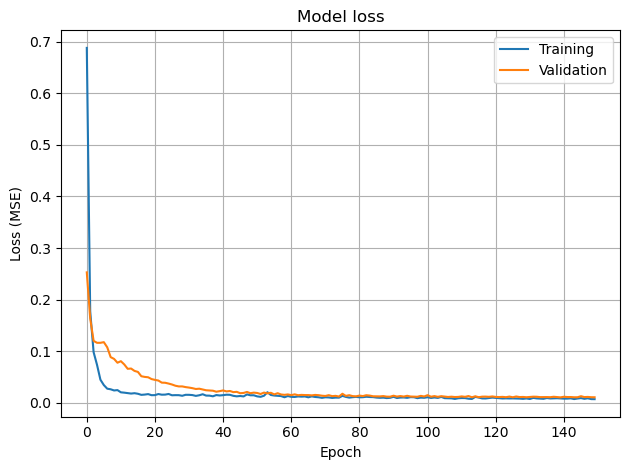

In [46]:

# summarize history for accuracy
# plt.figure()
# plt.grid()
# plt.plot(history.history['accuracy'])
# plt.plot(history.history['val_accuracy'])
# plt.title('model accuracy')
# plt.ylabel('accuracy')
# plt.xlabel('epoch')
# plt.legend(['train', 'test'], loc='upper left')
# plt.tight_layout()
# plt.savefig('autoencoder_learning_curve_accuracy.png', dpi=300)
# plt.show()

# summarize history for loss
plt.figure()
plt.grid()
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss (MSE)')
plt.xlabel('Epoch')
plt.legend(['Training', 'Validation'], loc='upper right')
plt.tight_layout()
plt.savefig('autoencoder_learning_curve_loss.png', dpi=300)
plt.show()

In [47]:
from sklearn.metrics import mean_squared_error

In [48]:
preds = auto_encoder(x_test_scaled.values)
preds = np.asarray(preds)

In [49]:
true_set = x_test_scaled.values

In [50]:
mean_squared_error(true_set, preds)

0.012521620820291523

In [52]:
auto_encoder.encoder.save_weights("data/models/cd_encoder_random")